In [ ]:
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets

from utils import Logger

In [ ]:
def mnist_data():
    compose = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize((0.5,), (0.5,))
        ])
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir, train=True, transform=compose, download=True)
# Load data
data = mnist_data()
# Create loader with data, so that we can iterate over it
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)
# Num batches
num_batches = len(data_loader)

In [ ]:
class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
        
        self.hidden0 = nn.Sequential( 
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
discriminator = DiscriminatorNet()

In [ ]:
def images_to_vectors(images):
    return images.view(images.size(0), 784)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 1, 28, 28)

In [ ]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden1 = nn.Sequential(            
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
generator = GeneratorNet()

In [ ]:
def noise(size):
    '''
    Generates a 1-d vector of gaussian sampled random values
    '''
    n = torch.randn(size, 100)
    return n


In [ ]:
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

In [ ]:
loss = nn.BCELoss()

In [ ]:
def ones_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = Variable(torch.zeros(size, 1))
    return data

In [ ]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N) )
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [ ]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    # Calculate error and backpropagate
    error = loss(prediction, ones_target(N))
    error.backward()
    # Update weights with gradients
    optimizer.step()
    # Return error
    return error

In [ ]:
num_test_samples = 16
test_noise = noise(num_test_samples)

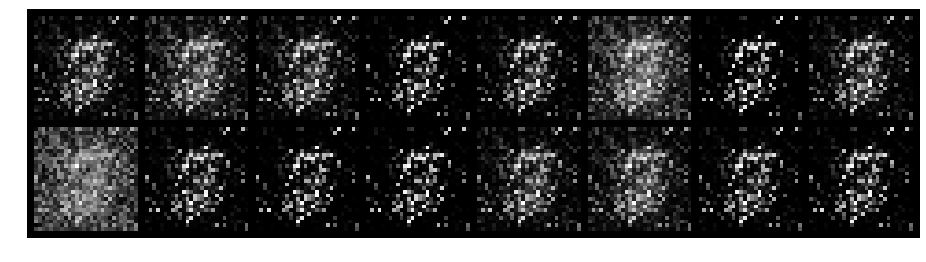

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.2261, Generator Loss: 0.7549
D(x): 0.5768, D(G(z)): 0.4869


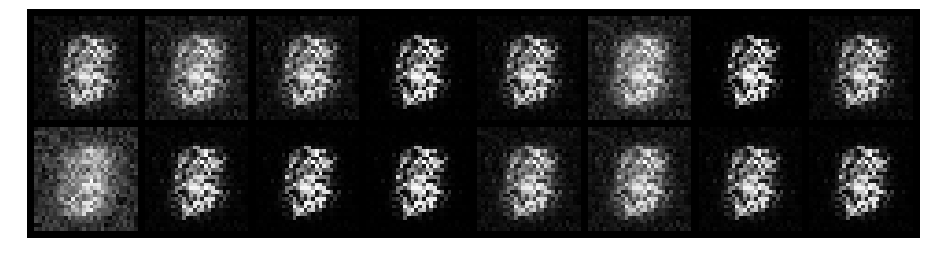

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 0.6303, Generator Loss: 2.6248
D(x): 0.6114, D(G(z)): 0.0978


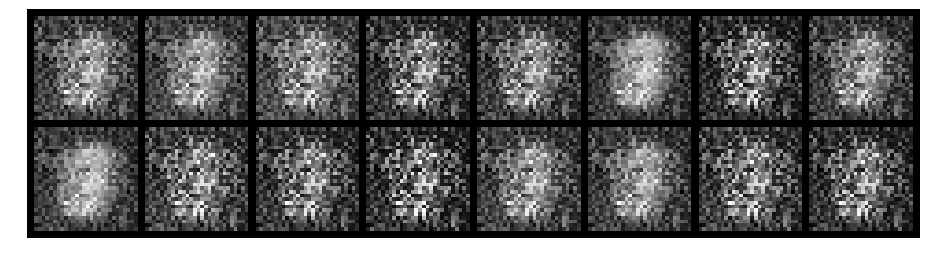

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 1.0812, Generator Loss: 0.9722
D(x): 0.7298, D(G(z)): 0.5118


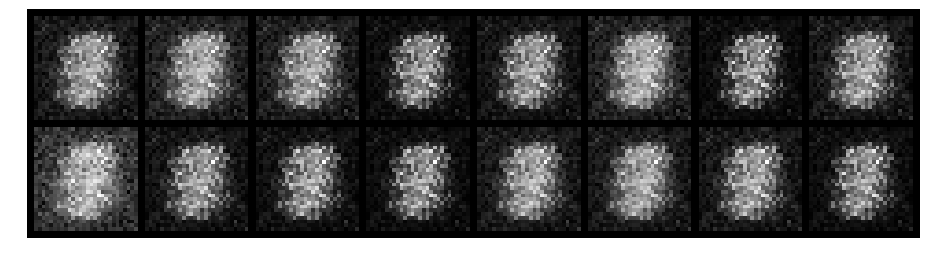

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 1.2702, Generator Loss: 0.7142
D(x): 0.6661, D(G(z)): 0.5449


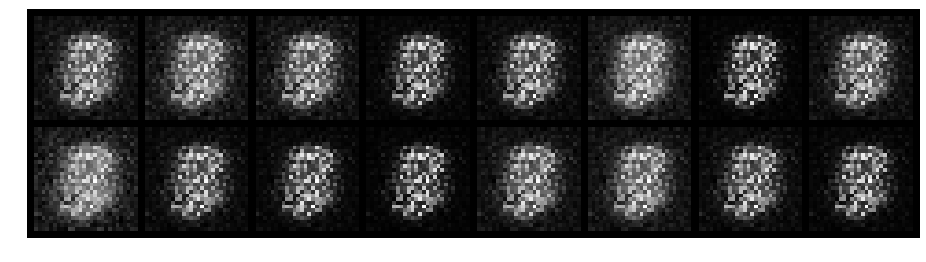

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 0.7279, Generator Loss: 1.7792
D(x): 0.7715, D(G(z)): 0.3387


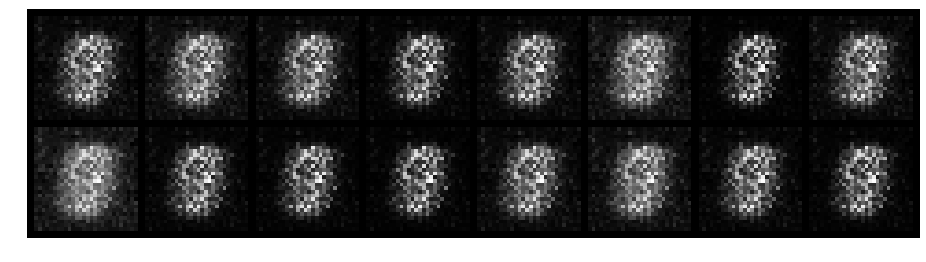

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 2.3890, Generator Loss: 0.3191
D(x): 0.5931, D(G(z)): 0.7875


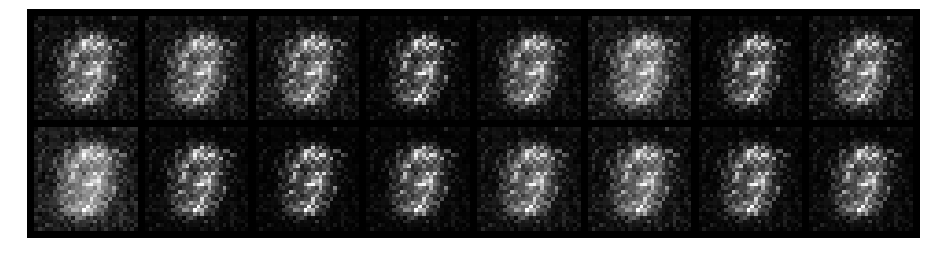

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 1.2448, Generator Loss: 1.0756
D(x): 0.5680, D(G(z)): 0.3983


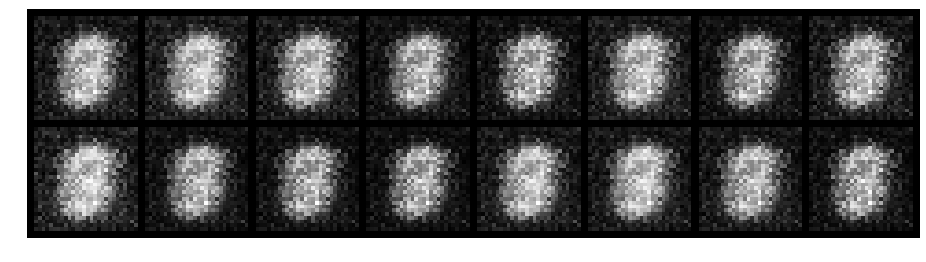

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 1.7437, Generator Loss: 0.6670
D(x): 0.6187, D(G(z)): 0.5934


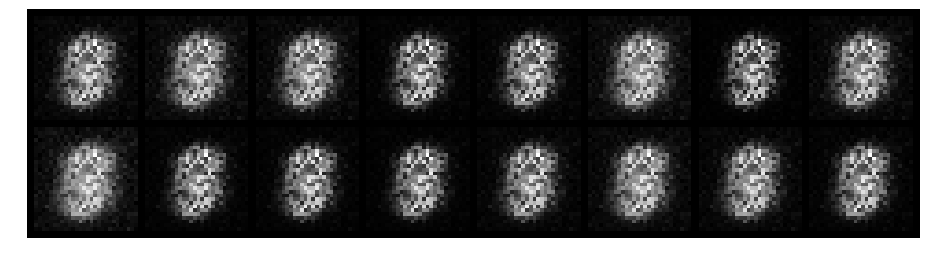

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 1.1561, Generator Loss: 0.8602
D(x): 0.5892, D(G(z)): 0.4368


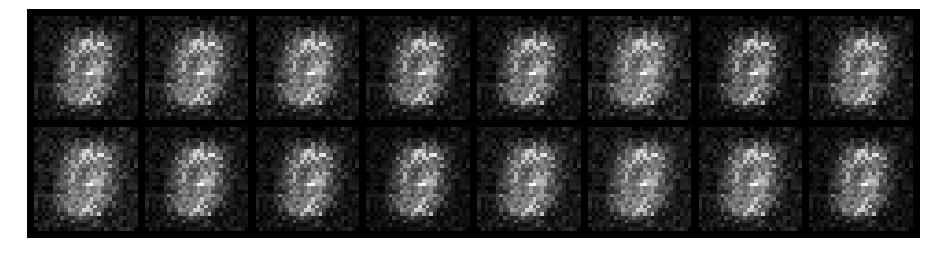

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 0.9079, Generator Loss: 1.0318
D(x): 0.7099, D(G(z)): 0.3999


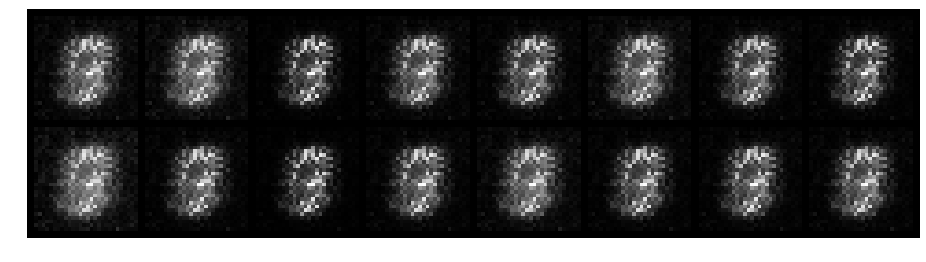

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 0.7304, Generator Loss: 1.7271
D(x): 0.7409, D(G(z)): 0.2540


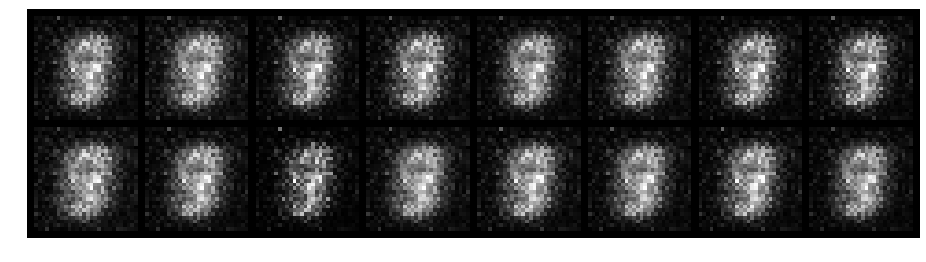

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 1.6119, Generator Loss: 1.8792
D(x): 0.5710, D(G(z)): 0.3790


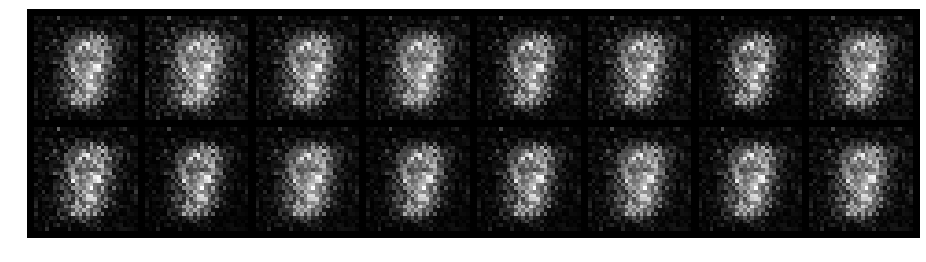

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 0.7840, Generator Loss: 2.0280
D(x): 0.6821, D(G(z)): 0.2459


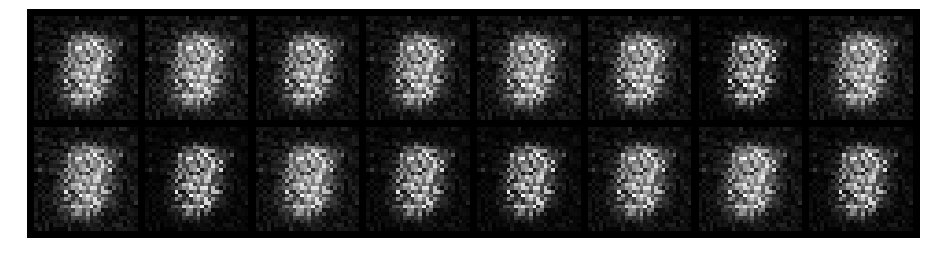

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 0.5414, Generator Loss: 1.8925
D(x): 0.7591, D(G(z)): 0.2088


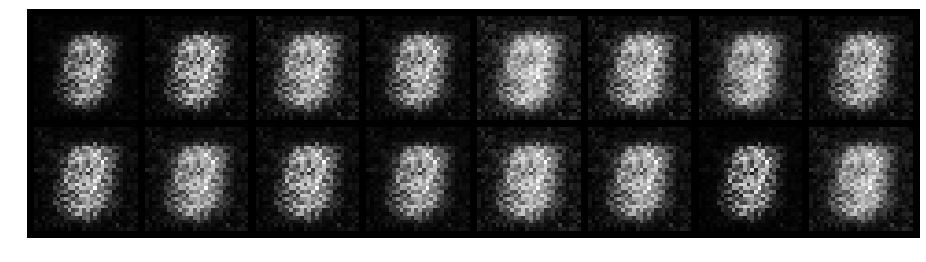

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 1.4793, Generator Loss: 1.5268
D(x): 0.6729, D(G(z)): 0.4754


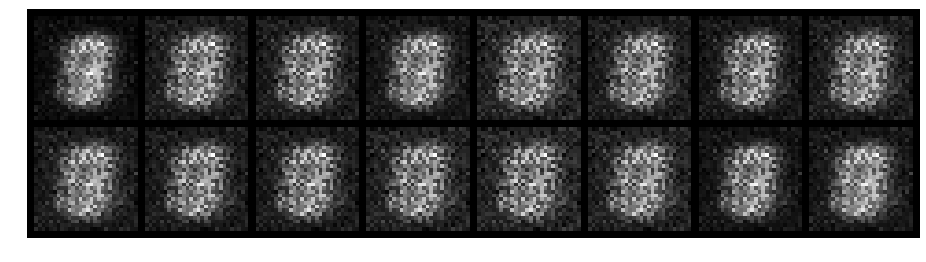

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.9122, Generator Loss: 0.9657
D(x): 0.7876, D(G(z)): 0.4645


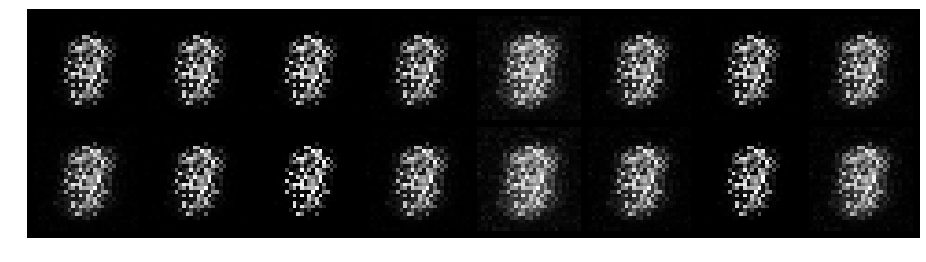

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.3632, Generator Loss: 4.3190
D(x): 0.8267, D(G(z)): 0.0844


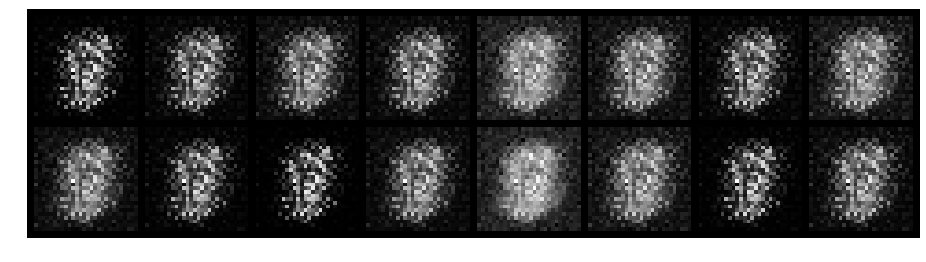

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 1.0757, Generator Loss: 3.2789
D(x): 0.6821, D(G(z)): 0.3087


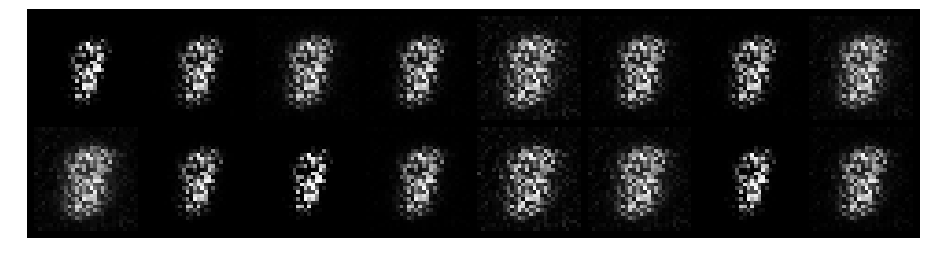

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.4246, Generator Loss: 5.6947
D(x): 0.8354, D(G(z)): 0.1055


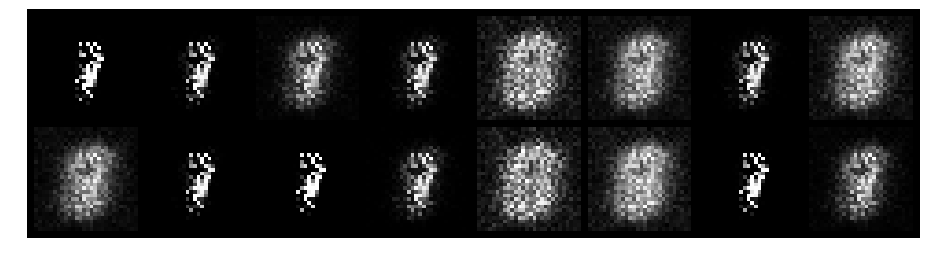

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.5874, Generator Loss: 2.8756
D(x): 0.7528, D(G(z)): 0.1832


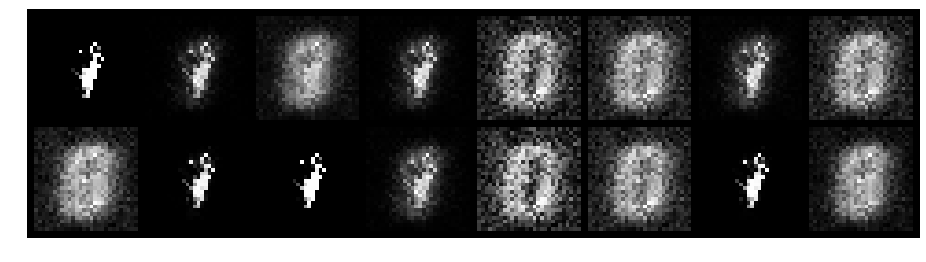

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 1.3278, Generator Loss: 0.5651
D(x): 0.6506, D(G(z)): 0.5247


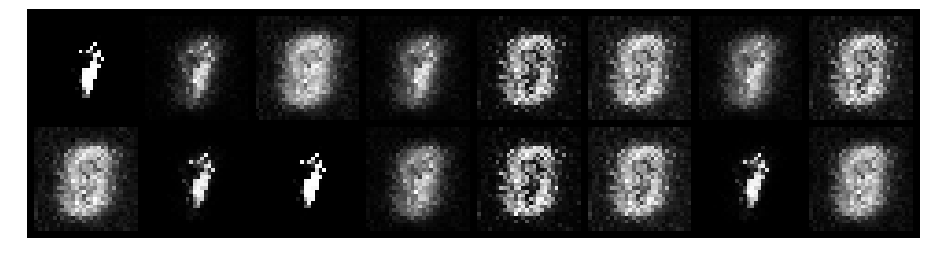

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.8918, Generator Loss: 1.9182
D(x): 0.6692, D(G(z)): 0.2752


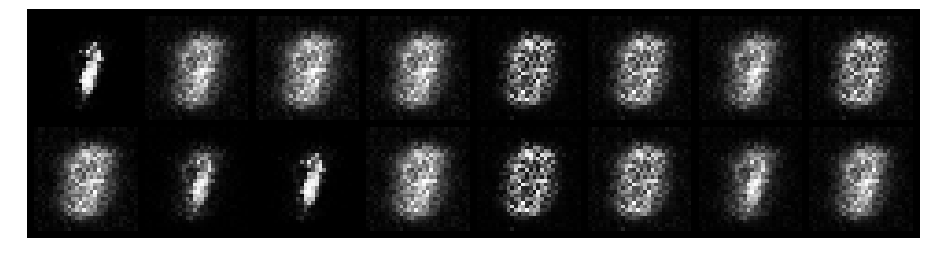

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 1.1013, Generator Loss: 1.3305
D(x): 0.7413, D(G(z)): 0.4047


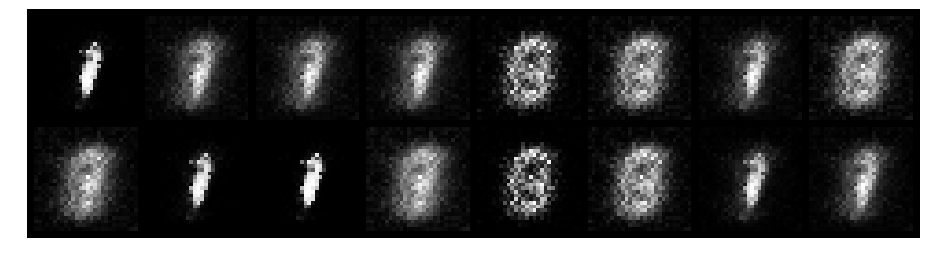

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.5698, Generator Loss: 2.3064
D(x): 0.8195, D(G(z)): 0.1888


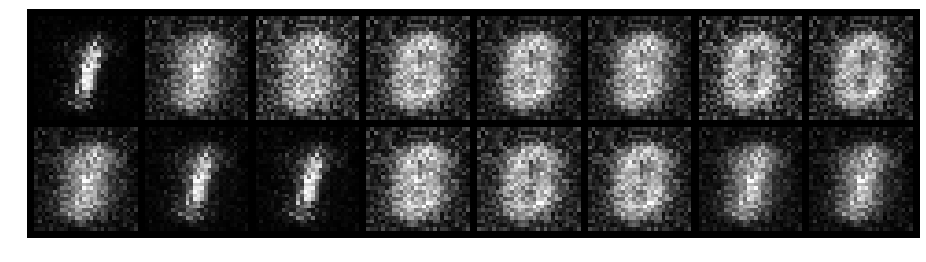

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.2762, Generator Loss: 4.2592
D(x): 0.9124, D(G(z)): 0.1127


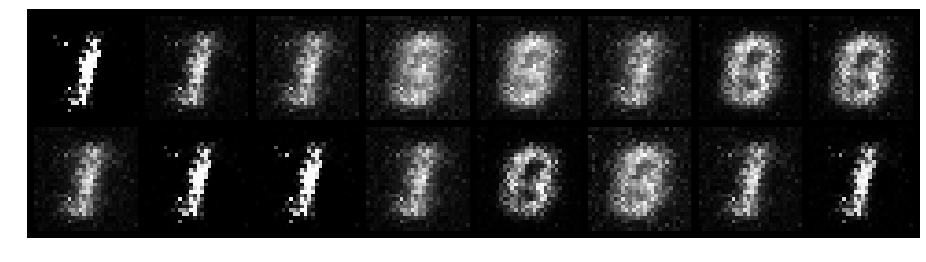

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.5164, Generator Loss: 2.8939
D(x): 0.8542, D(G(z)): 0.1810


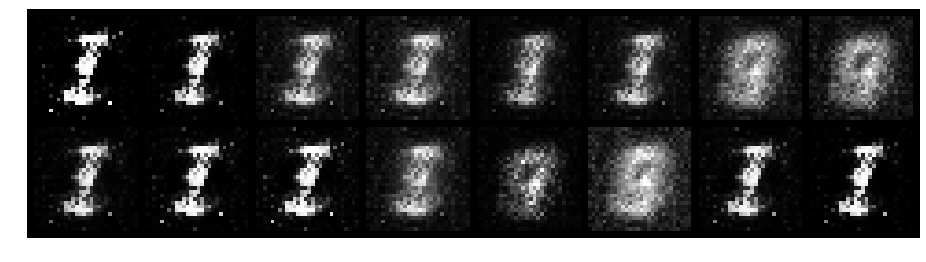

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.6768, Generator Loss: 2.3169
D(x): 0.7779, D(G(z)): 0.2007


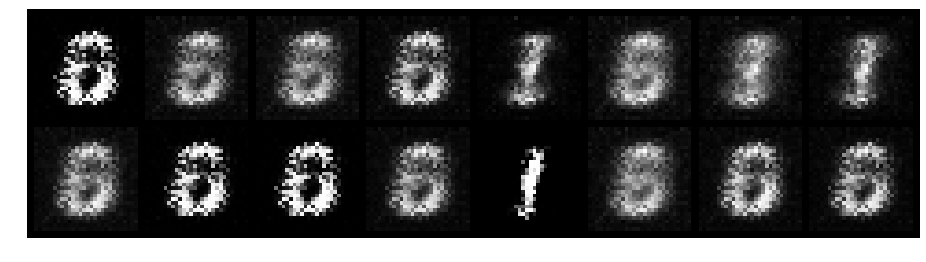

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.5684, Generator Loss: 3.2164
D(x): 0.8022, D(G(z)): 0.1687


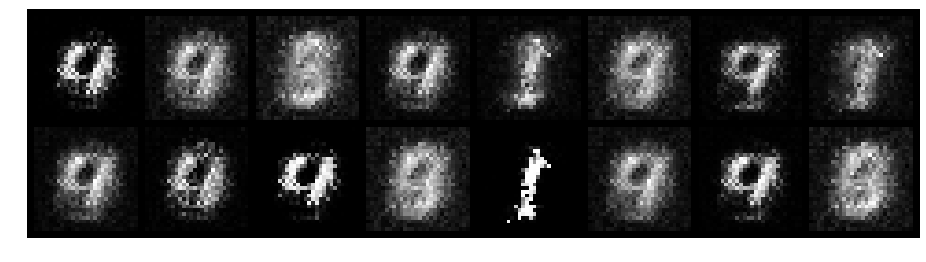

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.4012, Generator Loss: 3.2701
D(x): 0.8466, D(G(z)): 0.1029


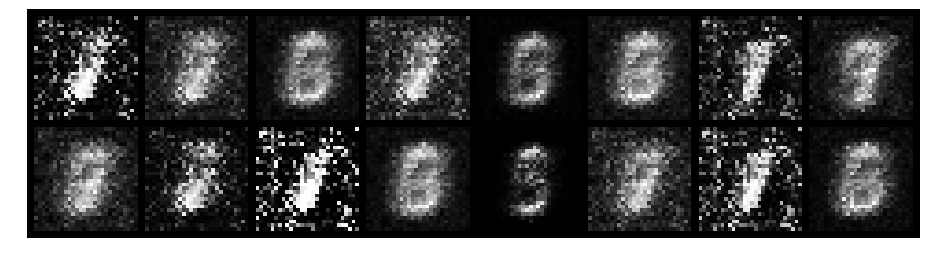

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.7246, Generator Loss: 1.9156
D(x): 0.8277, D(G(z)): 0.2942


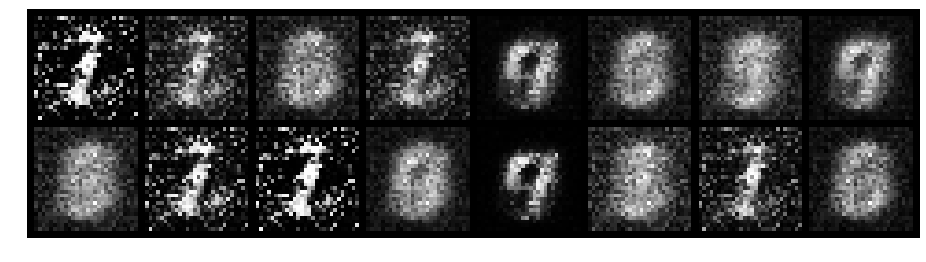

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.5215, Generator Loss: 2.2788
D(x): 0.8501, D(G(z)): 0.2064


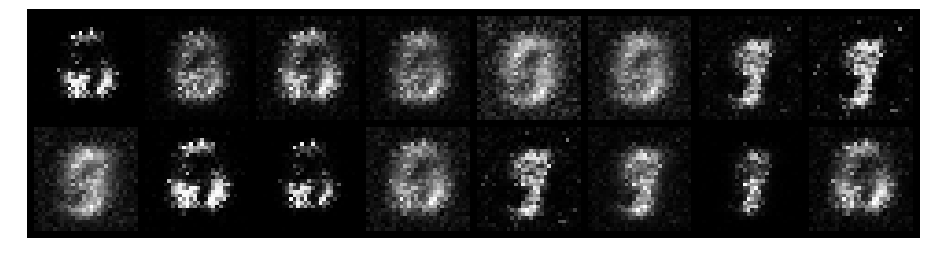

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.9008, Generator Loss: 2.2062
D(x): 0.7867, D(G(z)): 0.2485


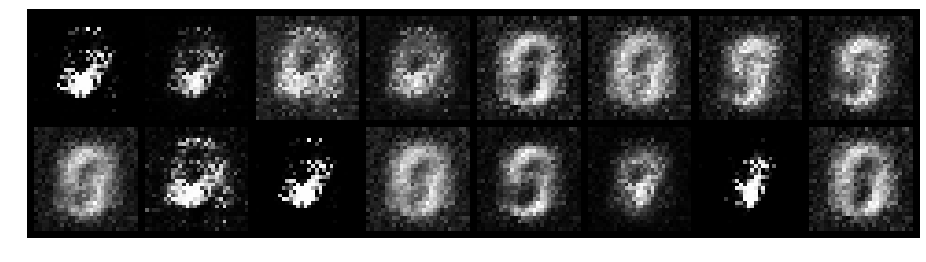

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.6184, Generator Loss: 3.2132
D(x): 0.7450, D(G(z)): 0.1286


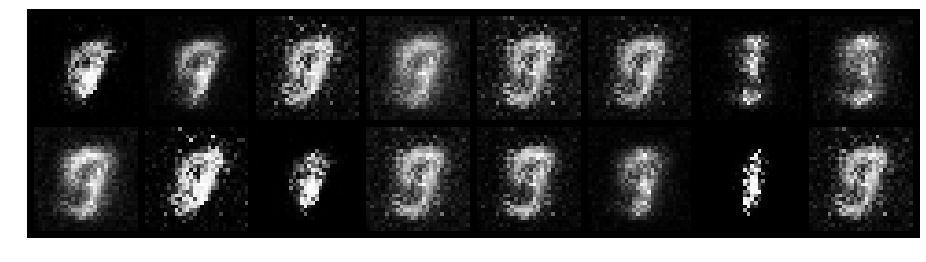

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.6240, Generator Loss: 3.0113
D(x): 0.8139, D(G(z)): 0.2229


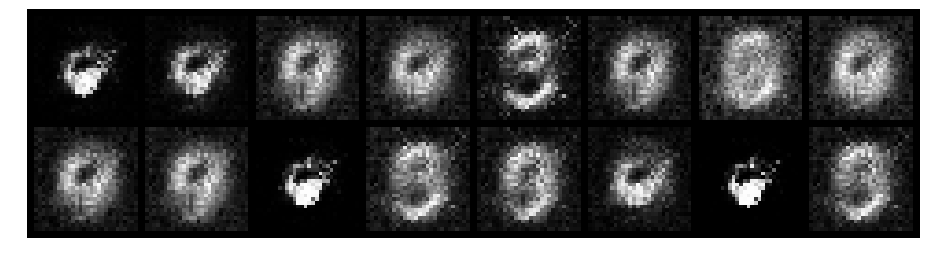

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.8069, Generator Loss: 2.4747
D(x): 0.8093, D(G(z)): 0.1923


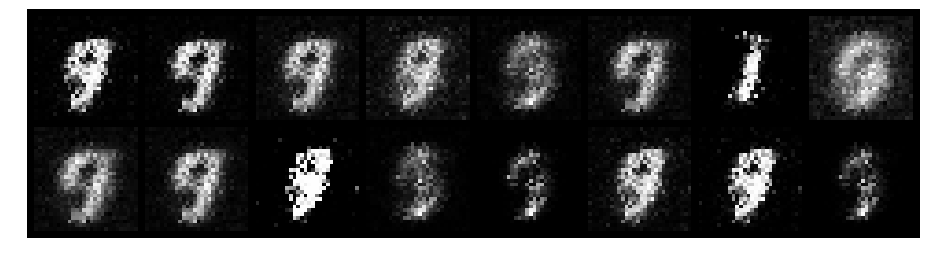

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.4412, Generator Loss: 2.3347
D(x): 0.8502, D(G(z)): 0.1297


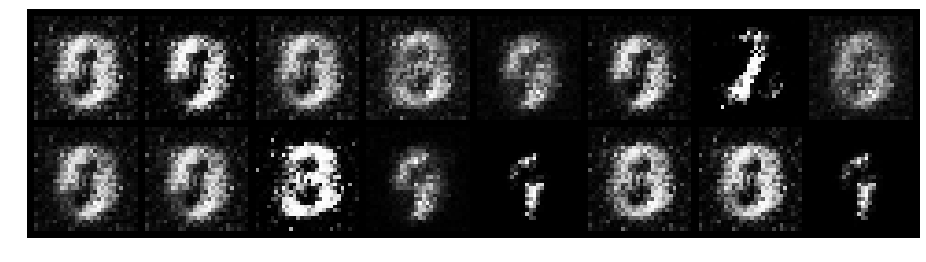

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.4379, Generator Loss: 2.8959
D(x): 0.8393, D(G(z)): 0.1161


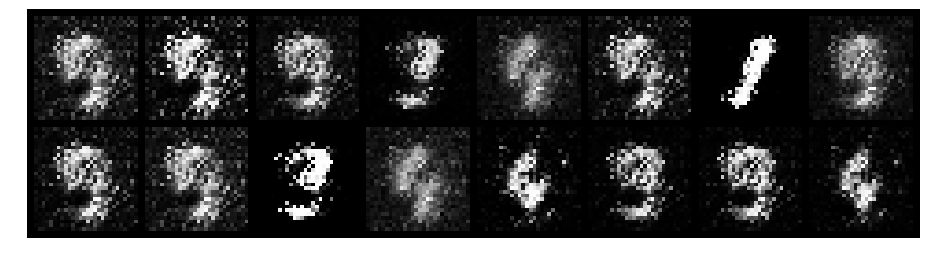

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.9010, Generator Loss: 1.4873
D(x): 0.7789, D(G(z)): 0.3047


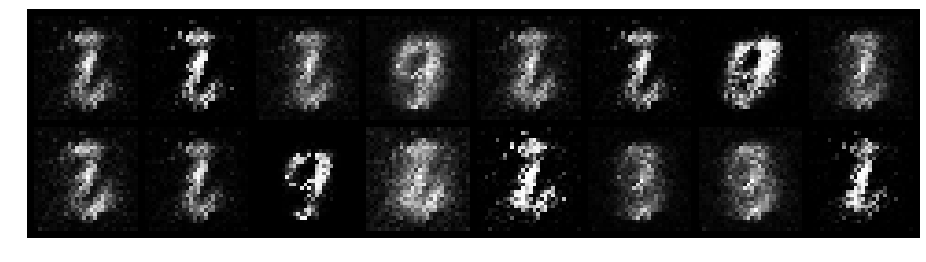

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.7282, Generator Loss: 2.1256
D(x): 0.7894, D(G(z)): 0.2572


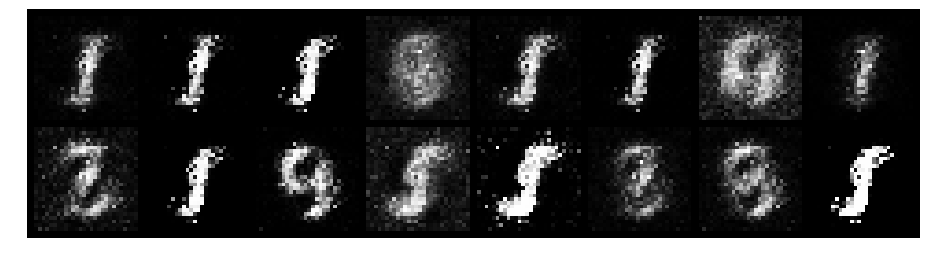

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.5799, Generator Loss: 2.2453
D(x): 0.8173, D(G(z)): 0.1596


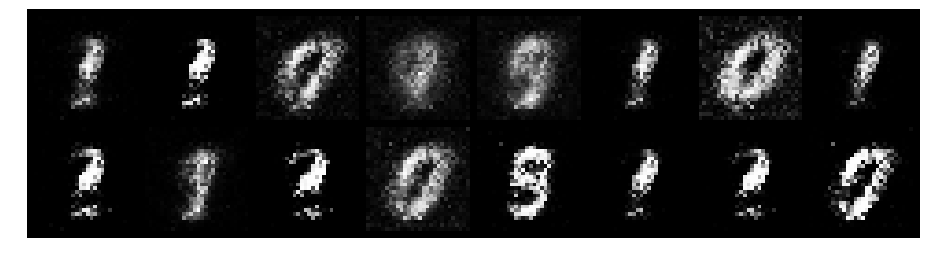

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.5833, Generator Loss: 2.2230
D(x): 0.8444, D(G(z)): 0.2267


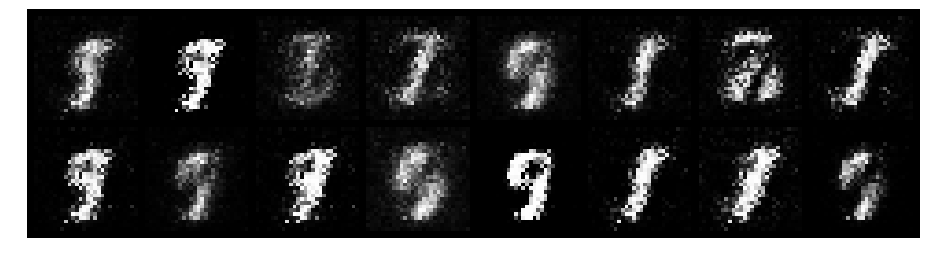

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.5549, Generator Loss: 2.8508
D(x): 0.7954, D(G(z)): 0.1368


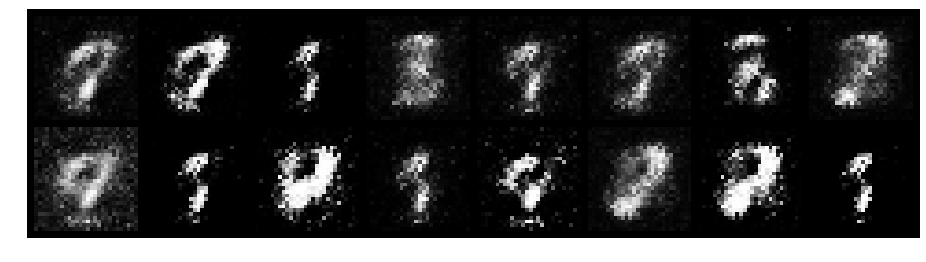

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.6029, Generator Loss: 2.3363
D(x): 0.8176, D(G(z)): 0.1694


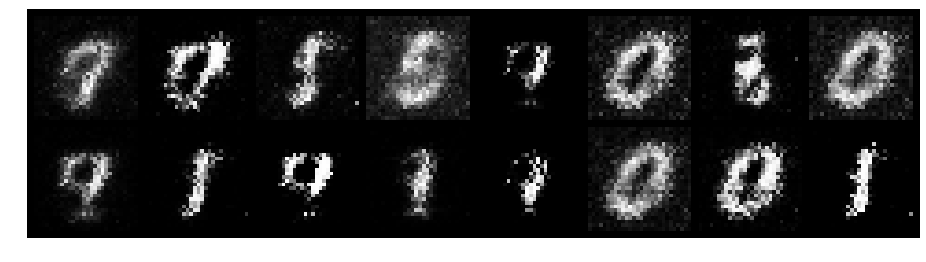

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.4649, Generator Loss: 2.8436
D(x): 0.8405, D(G(z)): 0.1790


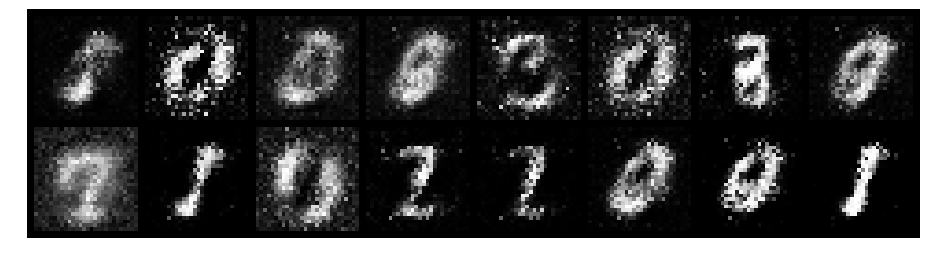

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.7564, Generator Loss: 2.7598
D(x): 0.7395, D(G(z)): 0.1413


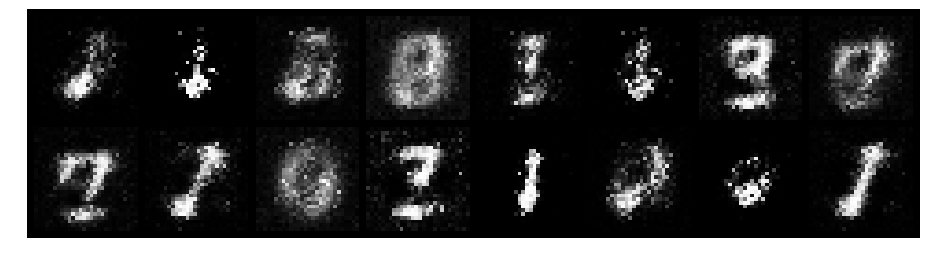

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.7953, Generator Loss: 2.0746
D(x): 0.7212, D(G(z)): 0.1583


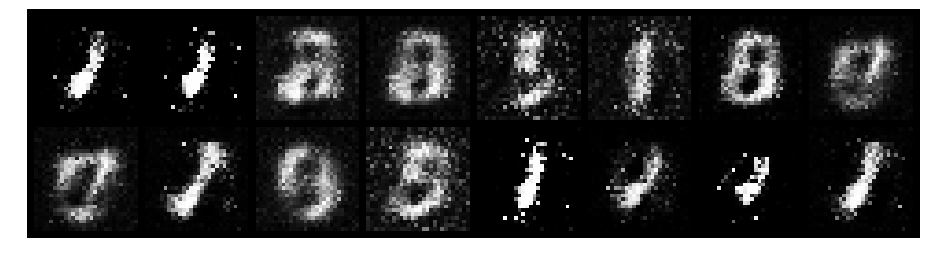

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.9283, Generator Loss: 2.4124
D(x): 0.7037, D(G(z)): 0.2082


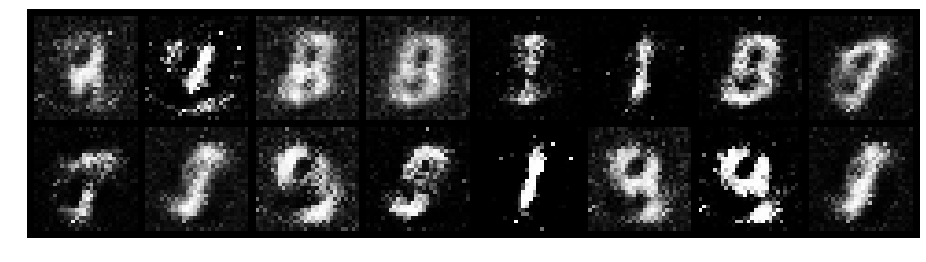

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.6028, Generator Loss: 2.0442
D(x): 0.8382, D(G(z)): 0.2571


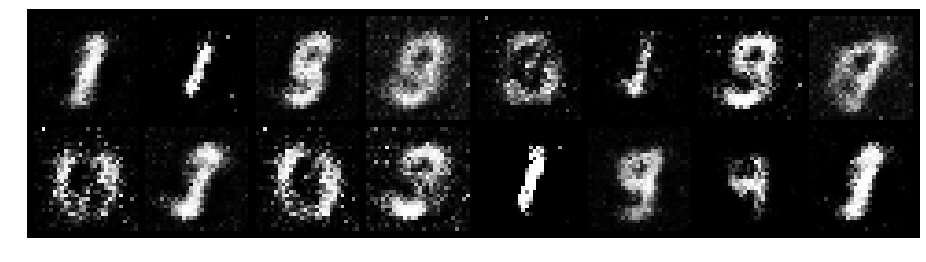

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.6872, Generator Loss: 2.6576
D(x): 0.7636, D(G(z)): 0.1584


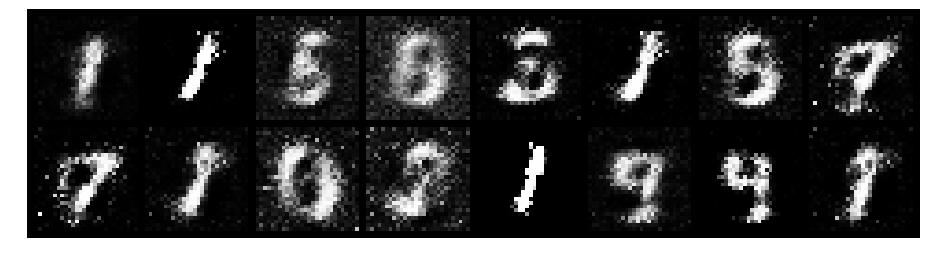

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.5888, Generator Loss: 2.4292
D(x): 0.8832, D(G(z)): 0.2368


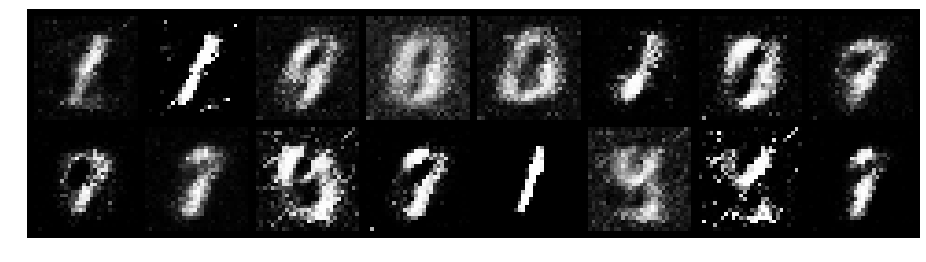

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.6173, Generator Loss: 3.1025
D(x): 0.8015, D(G(z)): 0.1454


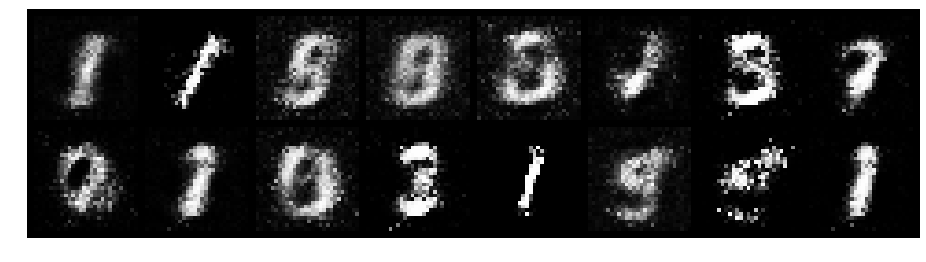

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.6264, Generator Loss: 2.3304
D(x): 0.8454, D(G(z)): 0.2498


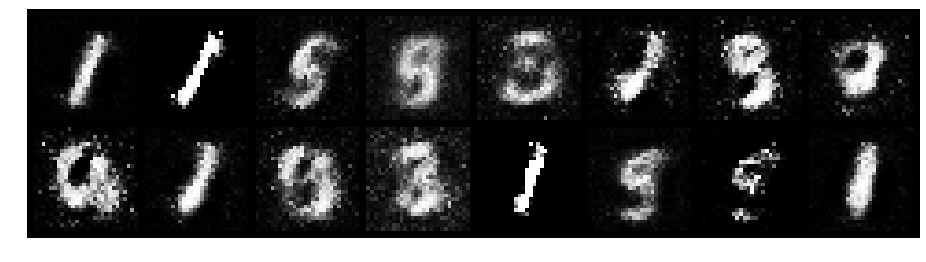

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.9019, Generator Loss: 2.1667
D(x): 0.7855, D(G(z)): 0.2846


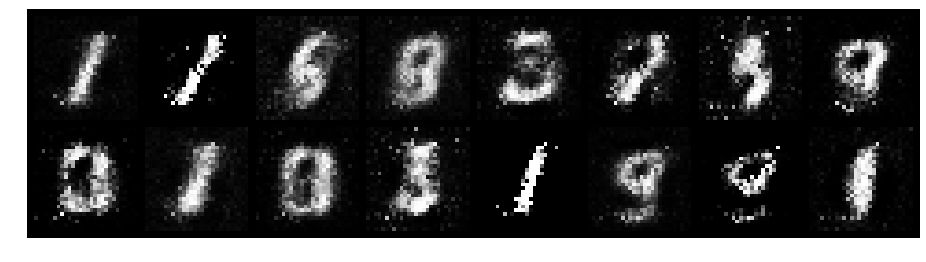

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.5783, Generator Loss: 1.6355
D(x): 0.8655, D(G(z)): 0.2585


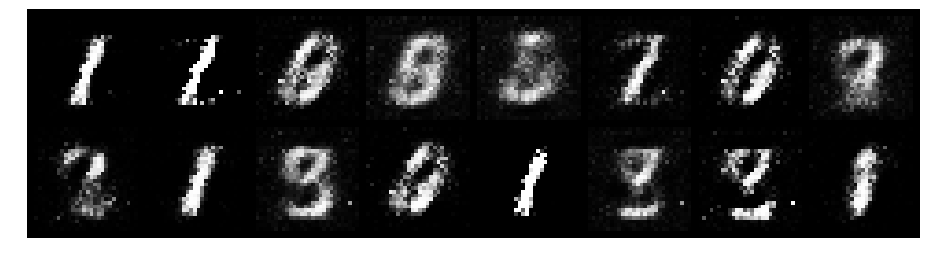

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.5200, Generator Loss: 3.0821
D(x): 0.8386, D(G(z)): 0.1455


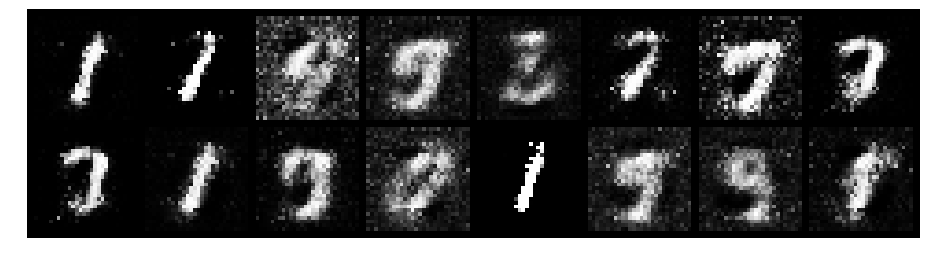

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.6274, Generator Loss: 2.4864
D(x): 0.7697, D(G(z)): 0.1357


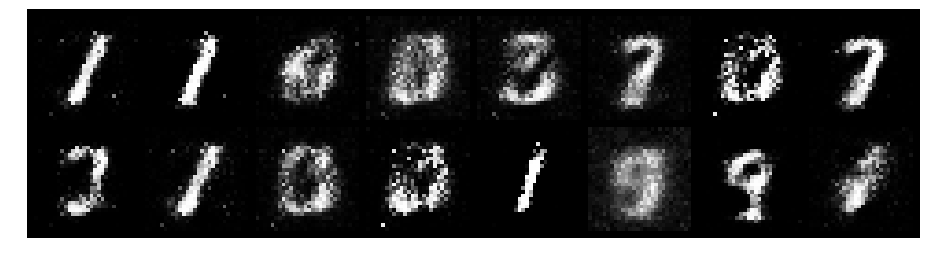

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.7052, Generator Loss: 1.8238
D(x): 0.8245, D(G(z)): 0.2731


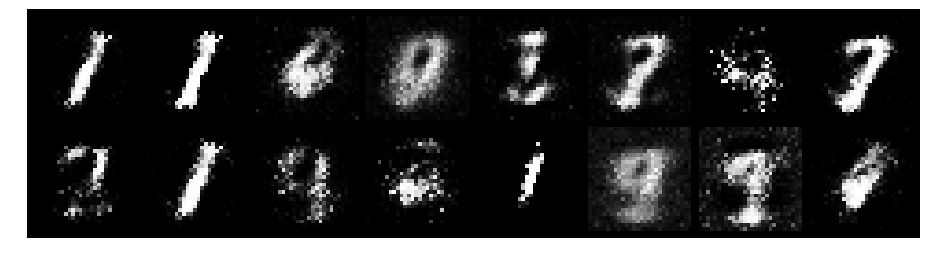

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.6348, Generator Loss: 1.9649
D(x): 0.7909, D(G(z)): 0.2080


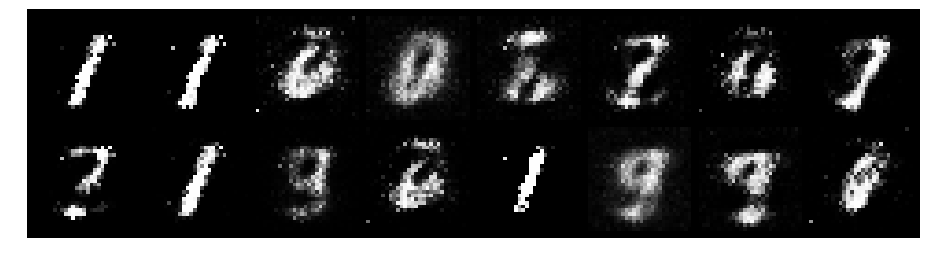

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.3702, Generator Loss: 3.2078
D(x): 0.8979, D(G(z)): 0.1273


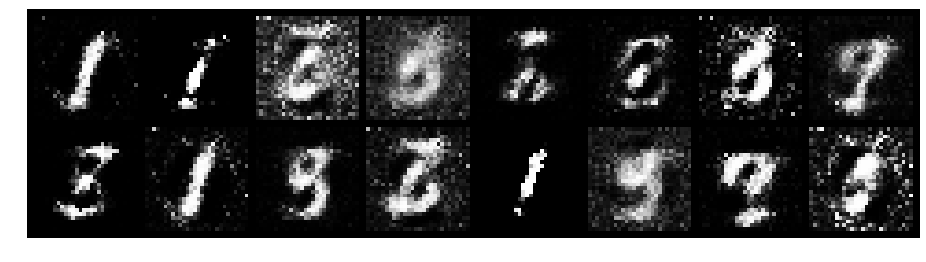

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.6226, Generator Loss: 3.0448
D(x): 0.7826, D(G(z)): 0.1692


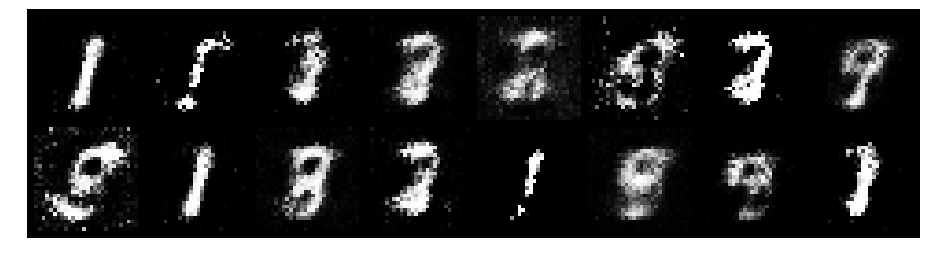

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.5249, Generator Loss: 2.9730
D(x): 0.8088, D(G(z)): 0.1096


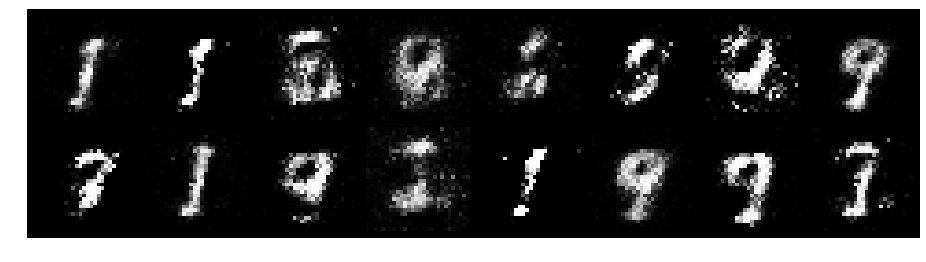

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 1.1128, Generator Loss: 2.7444
D(x): 0.7131, D(G(z)): 0.3200


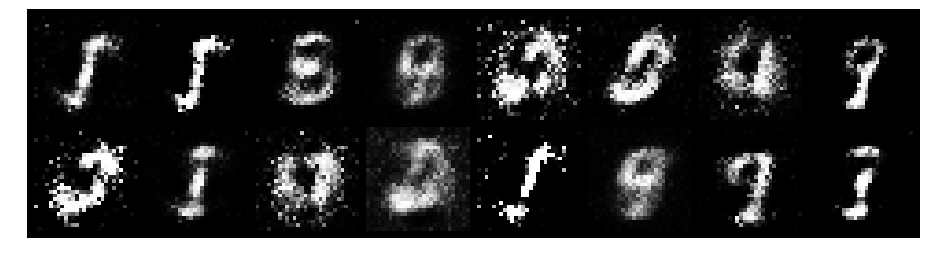

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.6426, Generator Loss: 2.8327
D(x): 0.8099, D(G(z)): 0.1955


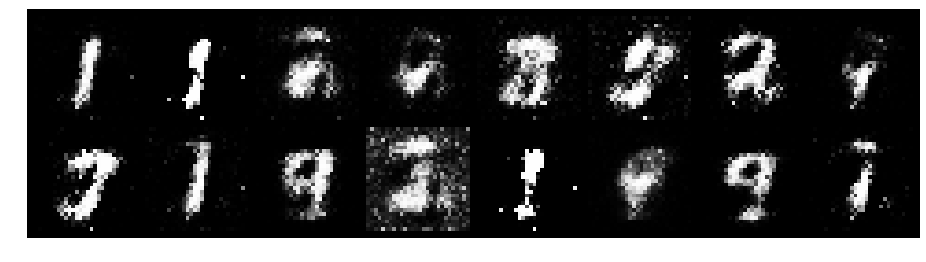

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.6411, Generator Loss: 2.7116
D(x): 0.7643, D(G(z)): 0.1630


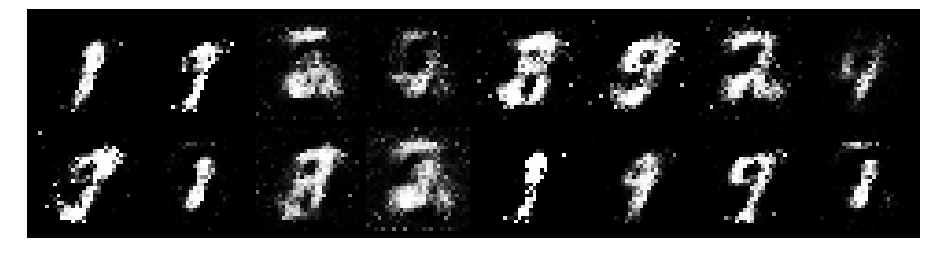

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.8465, Generator Loss: 2.5166
D(x): 0.8751, D(G(z)): 0.3198


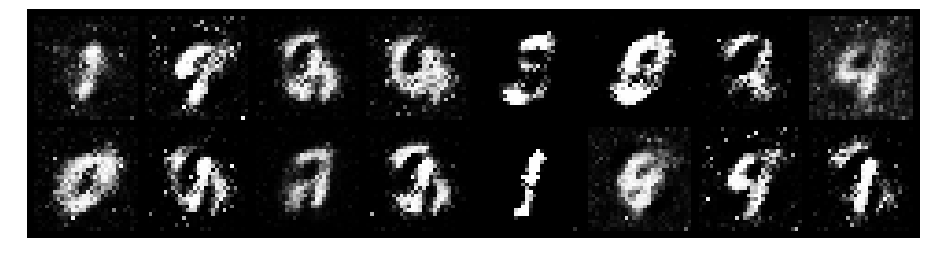

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.6226, Generator Loss: 2.0740
D(x): 0.7784, D(G(z)): 0.1828


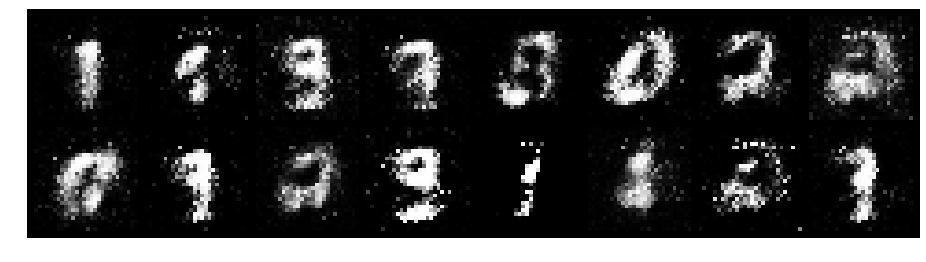

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.5257, Generator Loss: 2.7757
D(x): 0.8154, D(G(z)): 0.1762


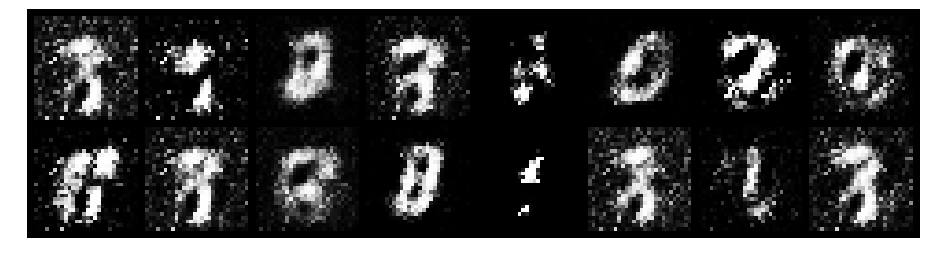

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.9852, Generator Loss: 2.0592
D(x): 0.6880, D(G(z)): 0.2460


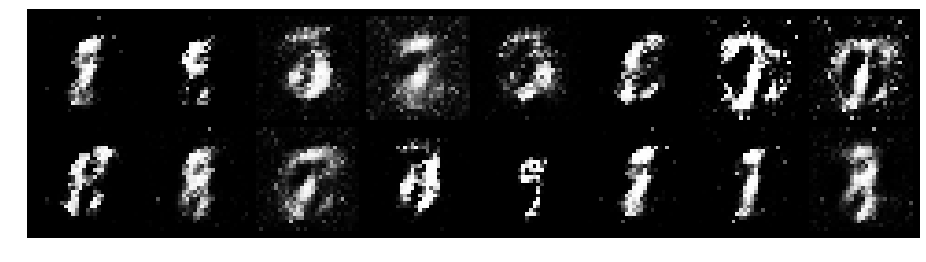

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.8224, Generator Loss: 2.0768
D(x): 0.7145, D(G(z)): 0.2271


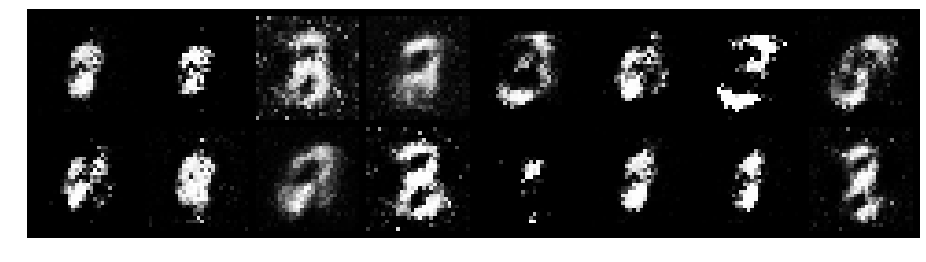

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.5089, Generator Loss: 2.1470
D(x): 0.8479, D(G(z)): 0.1729


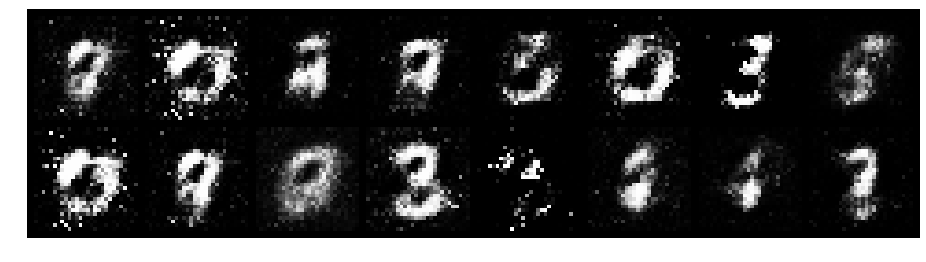

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.9549, Generator Loss: 1.8831
D(x): 0.7425, D(G(z)): 0.2747


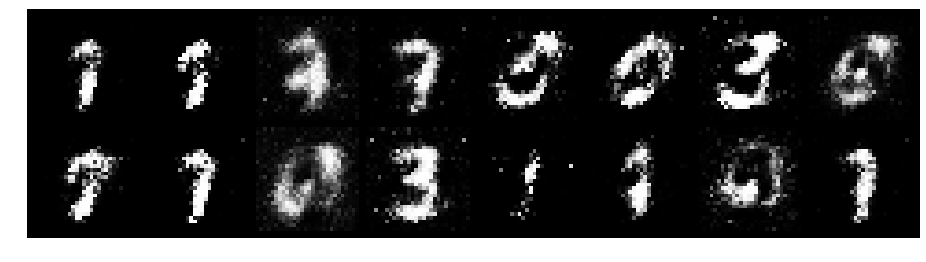

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.5651, Generator Loss: 2.3631
D(x): 0.7729, D(G(z)): 0.1715


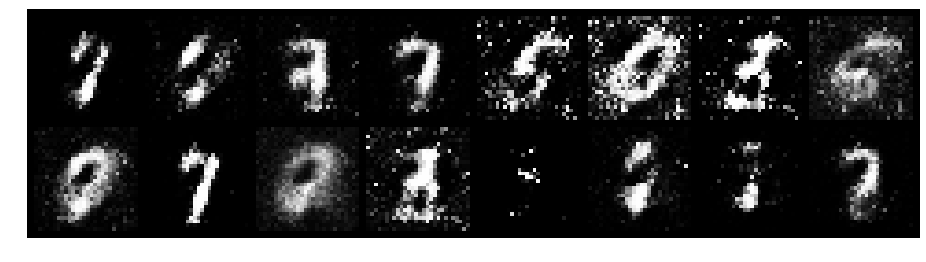

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.9880, Generator Loss: 1.9148
D(x): 0.7559, D(G(z)): 0.3206


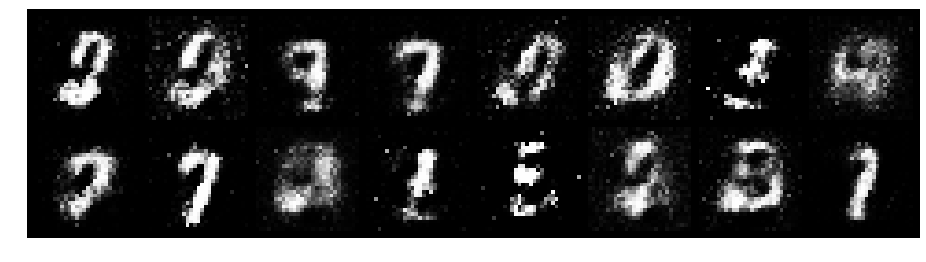

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.8114, Generator Loss: 2.1511
D(x): 0.7059, D(G(z)): 0.1854


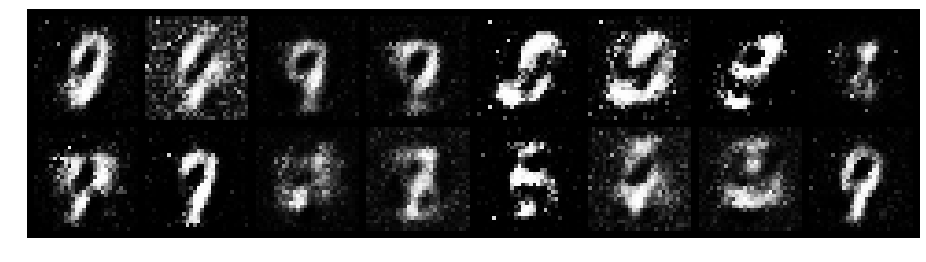

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.9026, Generator Loss: 1.8164
D(x): 0.8019, D(G(z)): 0.3626


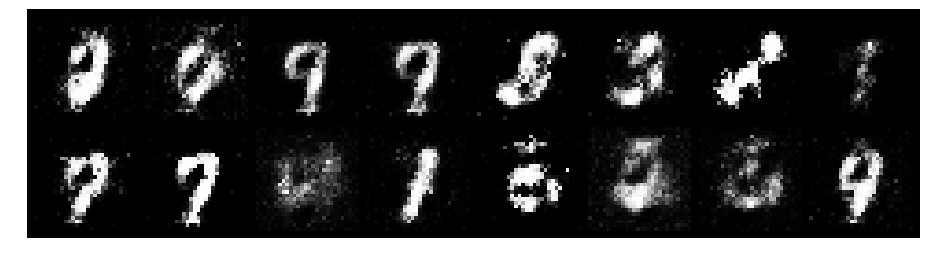

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 1.1647, Generator Loss: 1.8670
D(x): 0.7556, D(G(z)): 0.3429


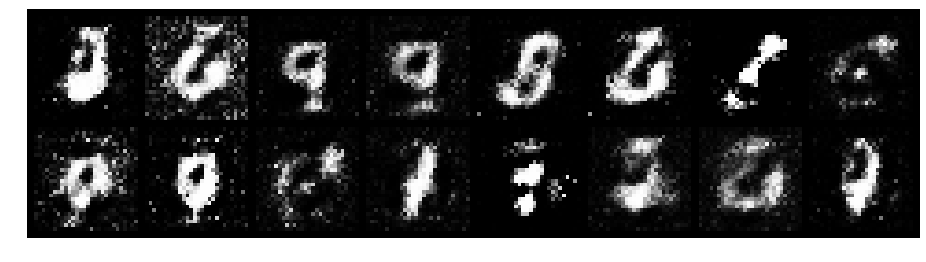

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.7943, Generator Loss: 1.6023
D(x): 0.7813, D(G(z)): 0.2839


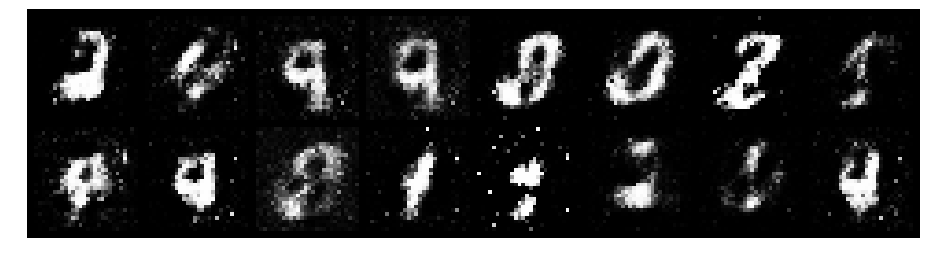

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 1.0000, Generator Loss: 1.6755
D(x): 0.7443, D(G(z)): 0.2921


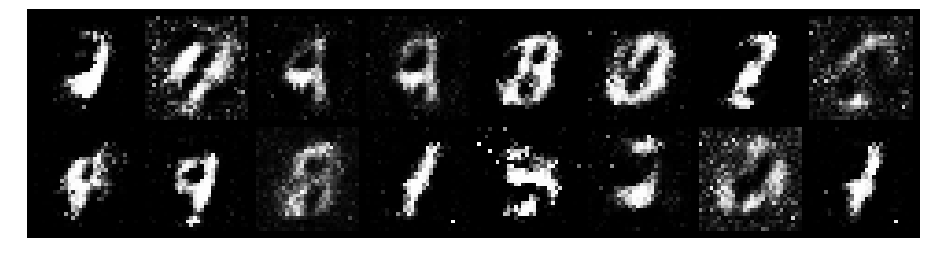

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.5973, Generator Loss: 2.4804
D(x): 0.7793, D(G(z)): 0.1599


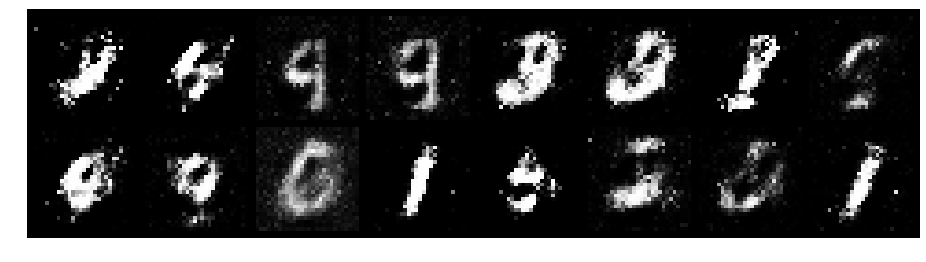

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.9276, Generator Loss: 1.6711
D(x): 0.6925, D(G(z)): 0.2232


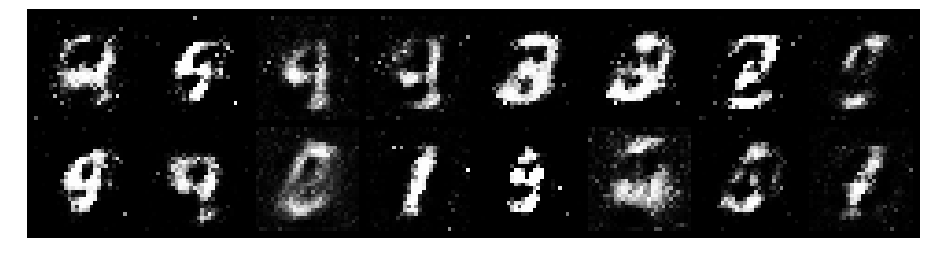

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.7933, Generator Loss: 1.7679
D(x): 0.7023, D(G(z)): 0.2071


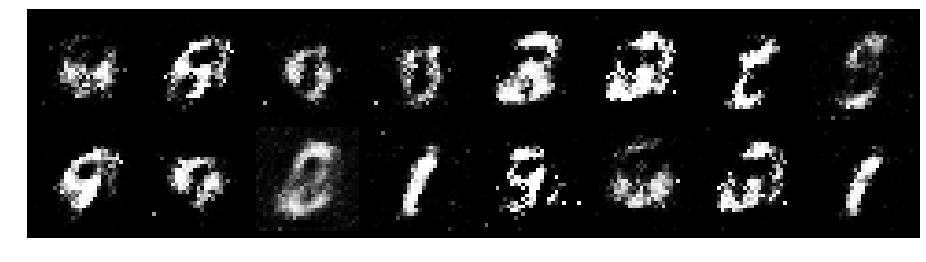

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.8148, Generator Loss: 1.4505
D(x): 0.7859, D(G(z)): 0.3261


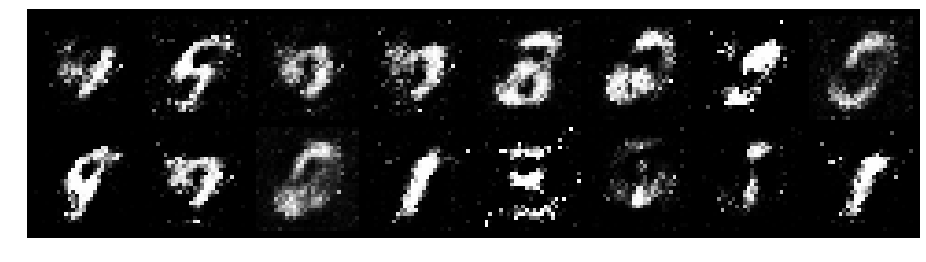

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.5813, Generator Loss: 2.0864
D(x): 0.7644, D(G(z)): 0.1872


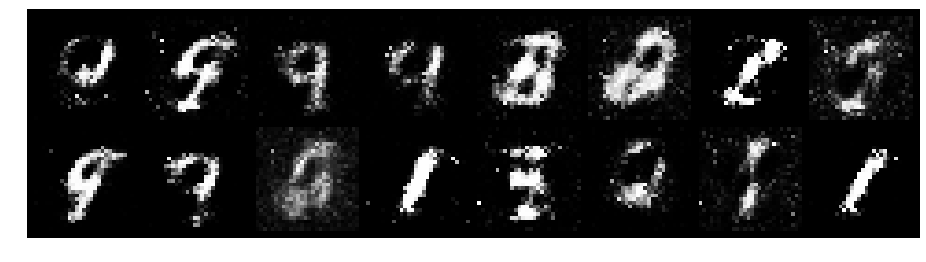

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.7439, Generator Loss: 1.6097
D(x): 0.7718, D(G(z)): 0.2979


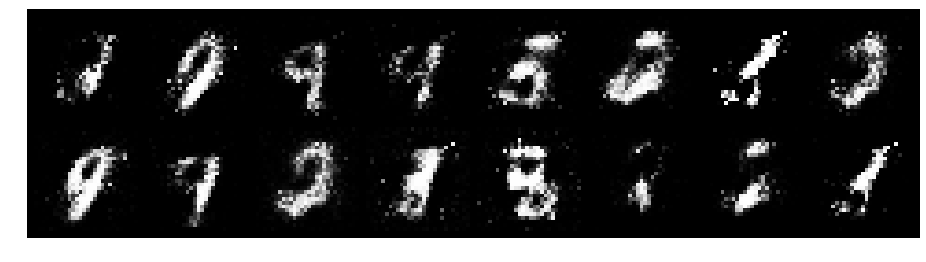

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.7580, Generator Loss: 1.9046
D(x): 0.7899, D(G(z)): 0.2824


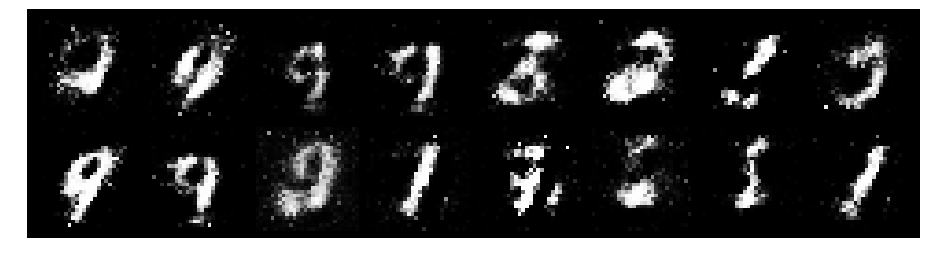

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.6354, Generator Loss: 1.8786
D(x): 0.8061, D(G(z)): 0.2631


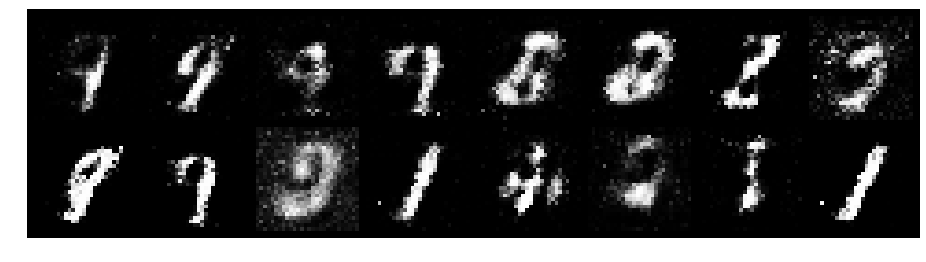

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 0.4893, Generator Loss: 2.2016
D(x): 0.7960, D(G(z)): 0.1529


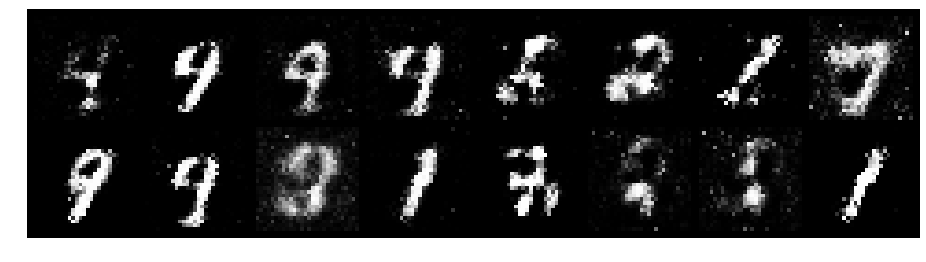

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.6673, Generator Loss: 2.1143
D(x): 0.7278, D(G(z)): 0.1729


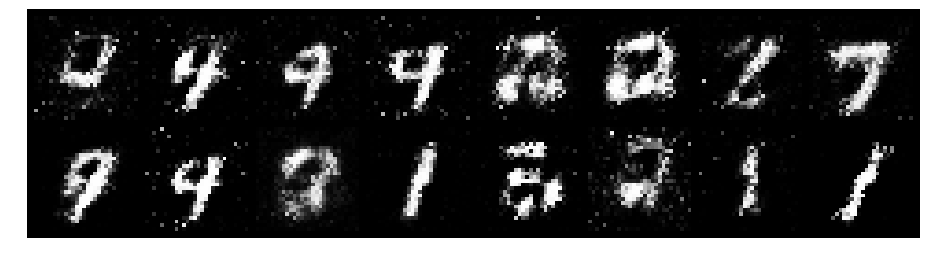

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.7462, Generator Loss: 2.1847
D(x): 0.7986, D(G(z)): 0.2947


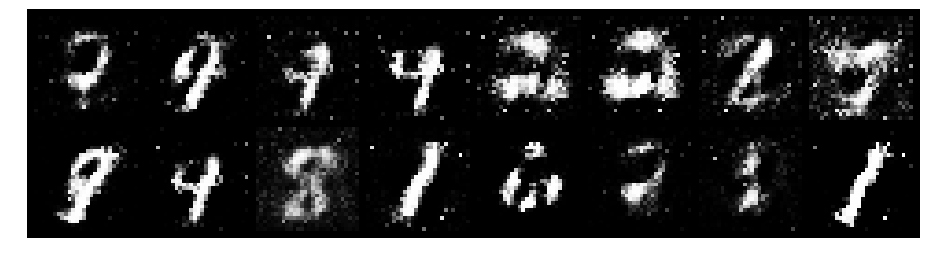

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.8912, Generator Loss: 1.5730
D(x): 0.6766, D(G(z)): 0.2919


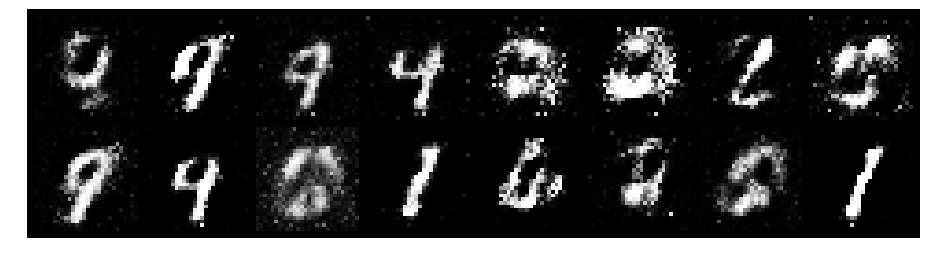

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.7851, Generator Loss: 1.8297
D(x): 0.7692, D(G(z)): 0.3229


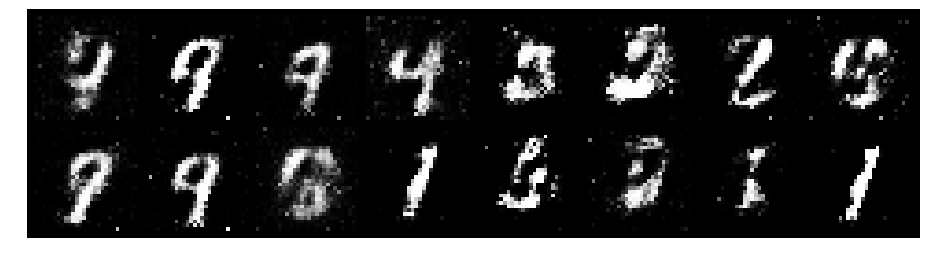

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.8013, Generator Loss: 2.5809
D(x): 0.7831, D(G(z)): 0.3113


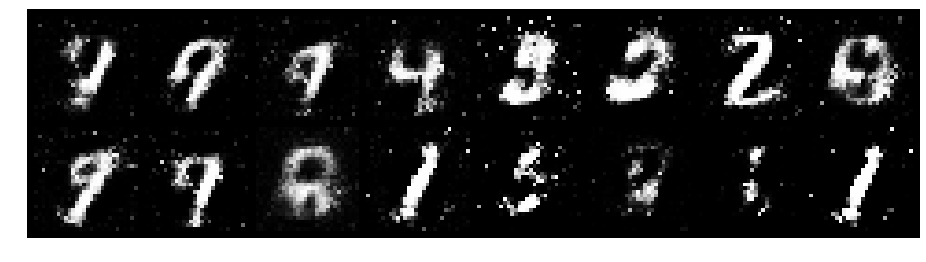

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.9506, Generator Loss: 1.9418
D(x): 0.8318, D(G(z)): 0.4020


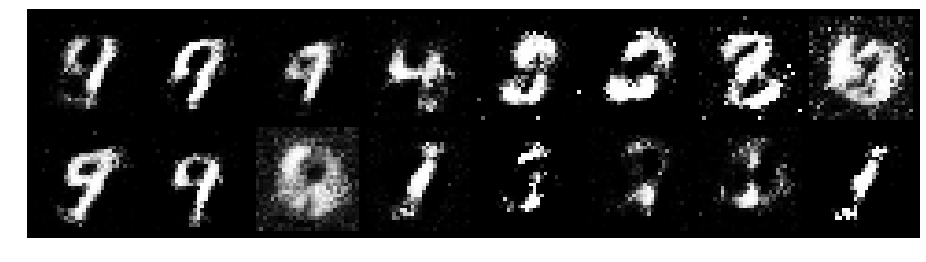

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.7932, Generator Loss: 2.1613
D(x): 0.7010, D(G(z)): 0.2166


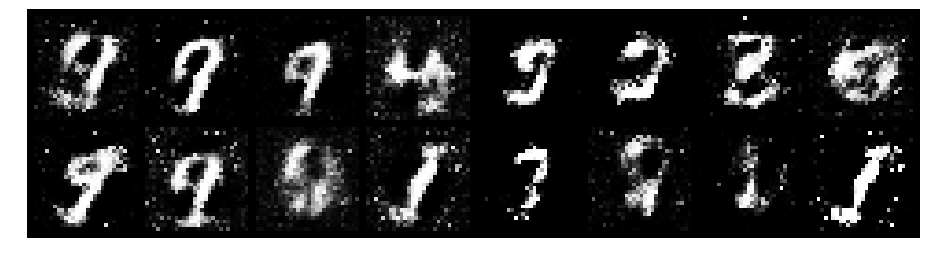

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.7145, Generator Loss: 2.1136
D(x): 0.7652, D(G(z)): 0.2528


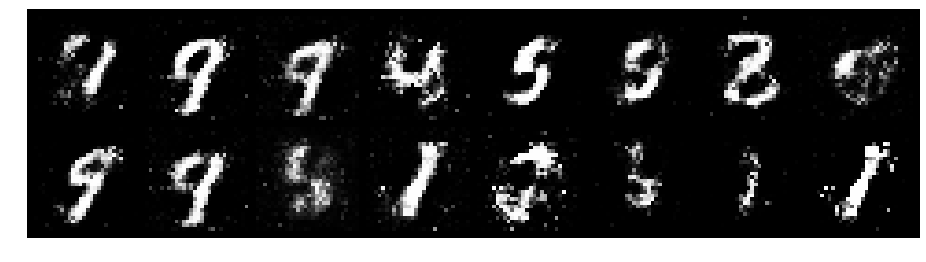

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 1.0746, Generator Loss: 1.2629
D(x): 0.7079, D(G(z)): 0.3706


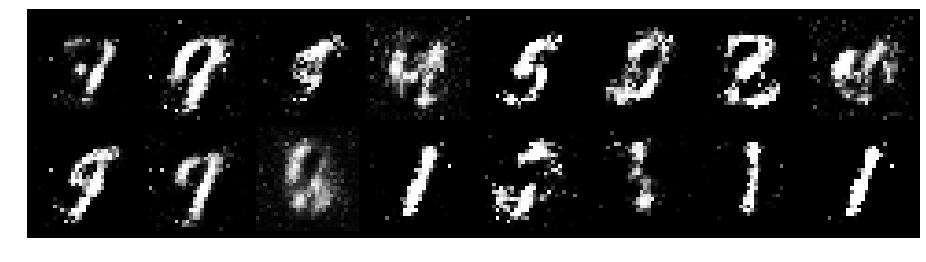

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 1.0232, Generator Loss: 1.4061
D(x): 0.7053, D(G(z)): 0.3337


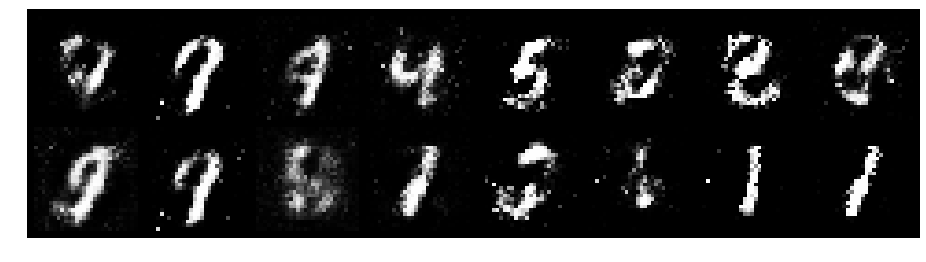

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 1.0761, Generator Loss: 1.1442
D(x): 0.7472, D(G(z)): 0.4188


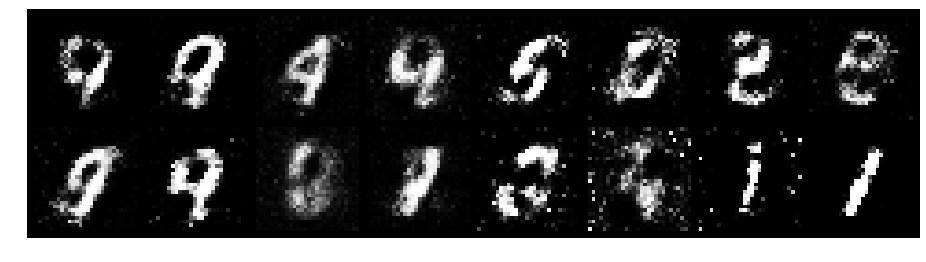

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 1.1768, Generator Loss: 1.3115
D(x): 0.6664, D(G(z)): 0.3546


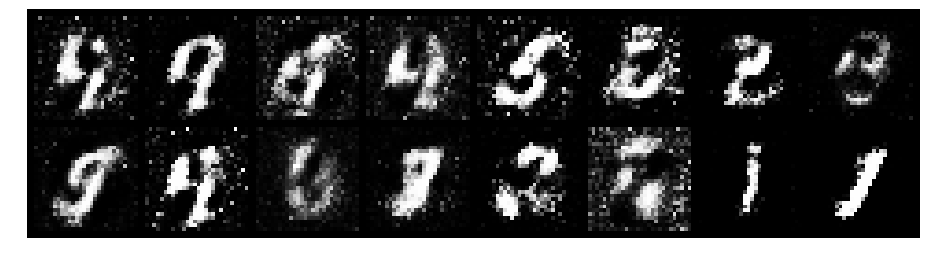

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 1.1276, Generator Loss: 1.6342
D(x): 0.7144, D(G(z)): 0.3674


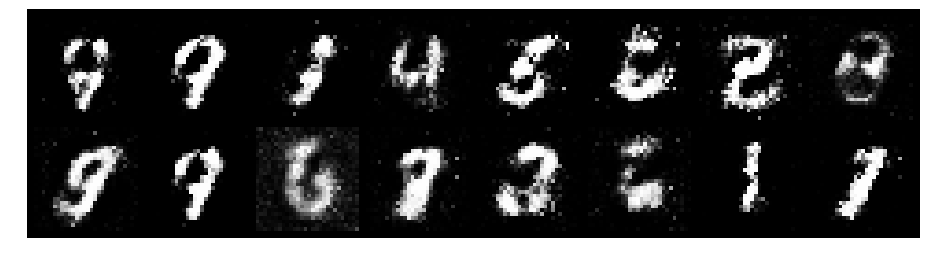

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.6633, Generator Loss: 2.4365
D(x): 0.7697, D(G(z)): 0.1941


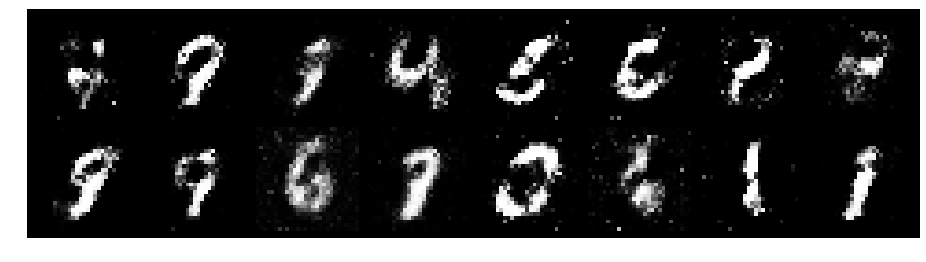

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.6879, Generator Loss: 1.7579
D(x): 0.8136, D(G(z)): 0.2350


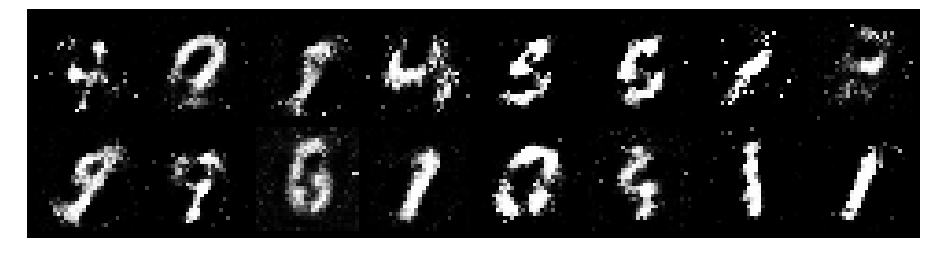

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.5594, Generator Loss: 2.3791
D(x): 0.8368, D(G(z)): 0.2218


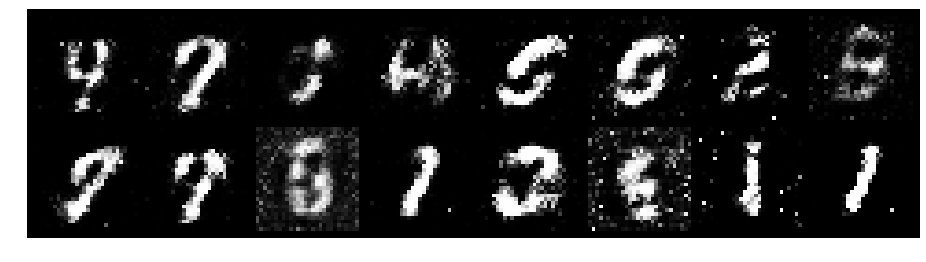

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 0.7256, Generator Loss: 2.0958
D(x): 0.7808, D(G(z)): 0.2592


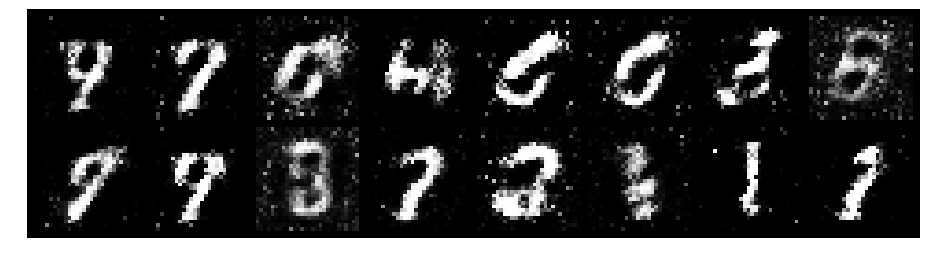

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.5208, Generator Loss: 2.1673
D(x): 0.8429, D(G(z)): 0.2065


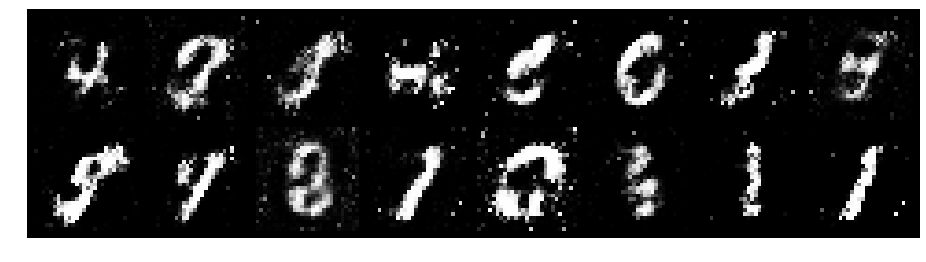

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.6282, Generator Loss: 2.5862
D(x): 0.7575, D(G(z)): 0.1677


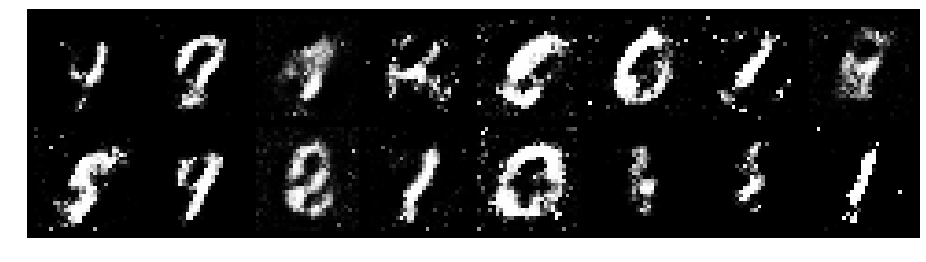

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.6592, Generator Loss: 2.1096
D(x): 0.7333, D(G(z)): 0.1632


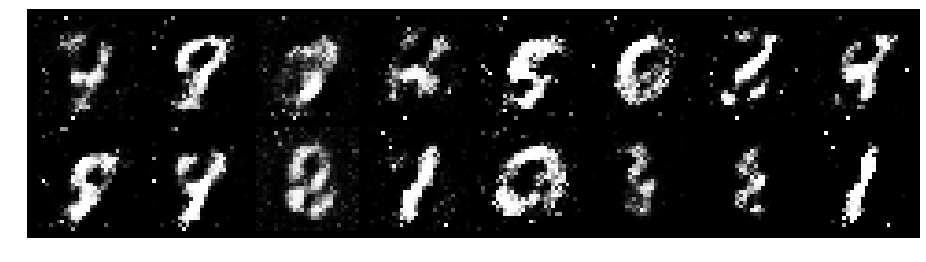

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.6984, Generator Loss: 1.8541
D(x): 0.7473, D(G(z)): 0.2166


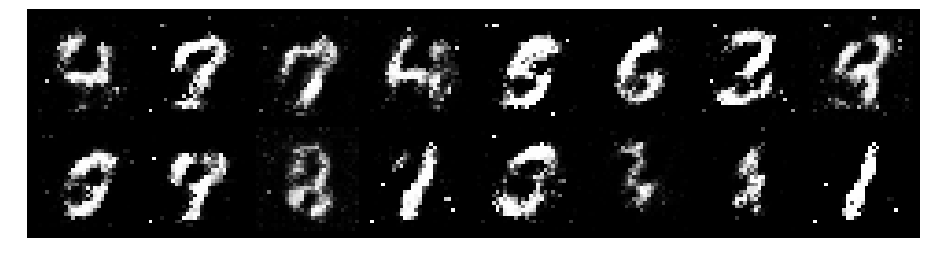

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.6955, Generator Loss: 1.9122
D(x): 0.7488, D(G(z)): 0.2317


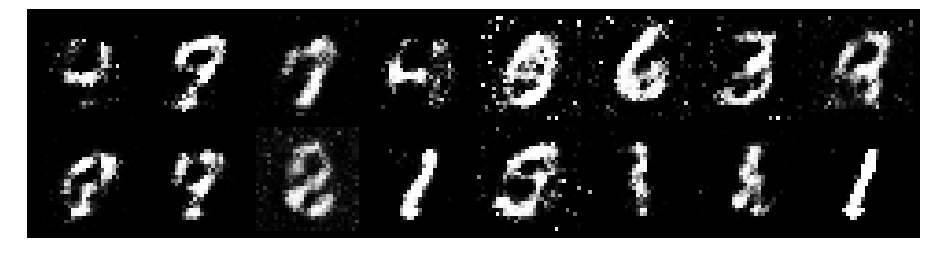

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.9312, Generator Loss: 2.0770
D(x): 0.7387, D(G(z)): 0.2597


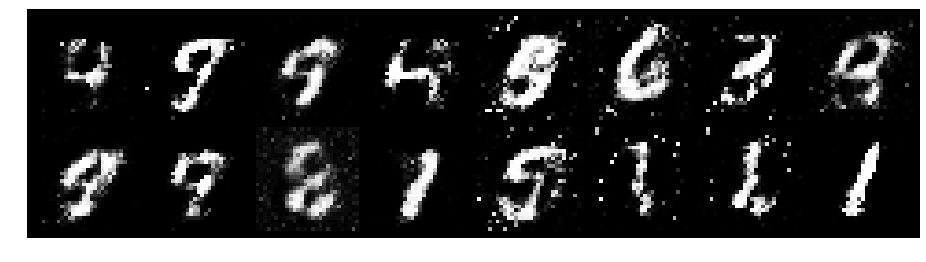

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.6904, Generator Loss: 1.9189
D(x): 0.7652, D(G(z)): 0.2335


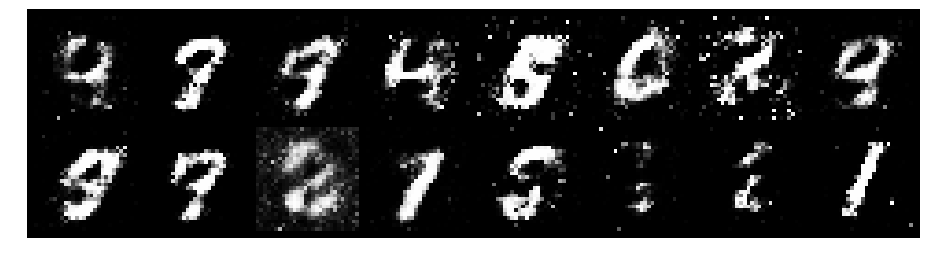

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.8177, Generator Loss: 2.3741
D(x): 0.7335, D(G(z)): 0.2331


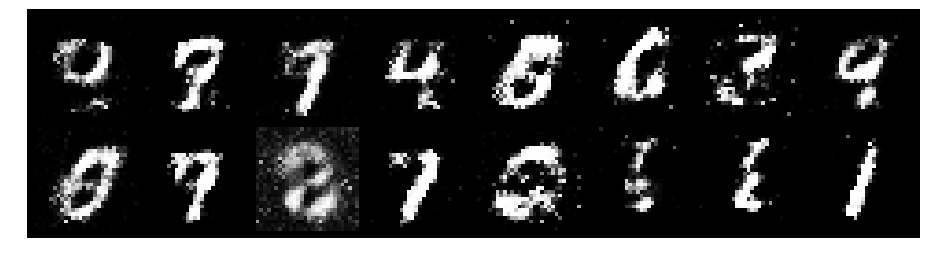

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.7291, Generator Loss: 2.1324
D(x): 0.7731, D(G(z)): 0.2453


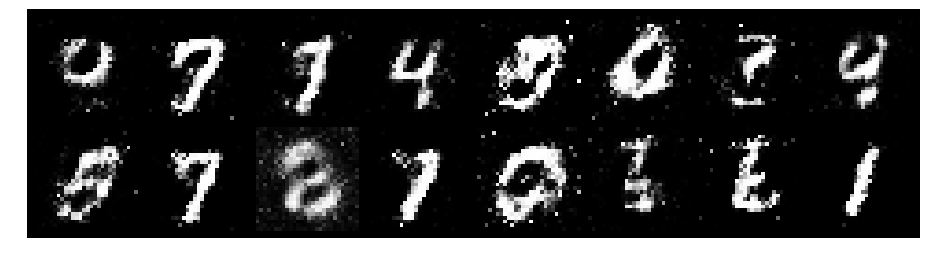

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.8653, Generator Loss: 1.6609
D(x): 0.7746, D(G(z)): 0.3645


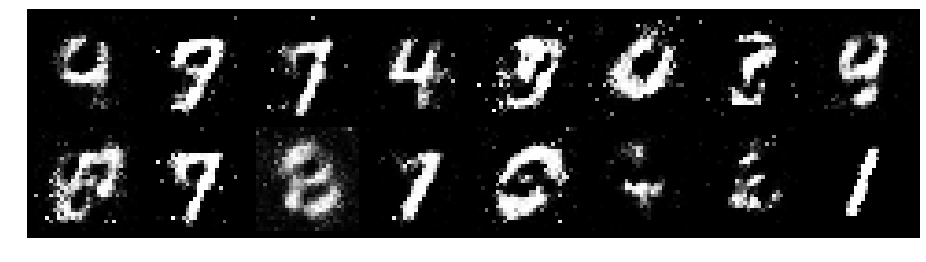

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.9024, Generator Loss: 1.8051
D(x): 0.7629, D(G(z)): 0.3413


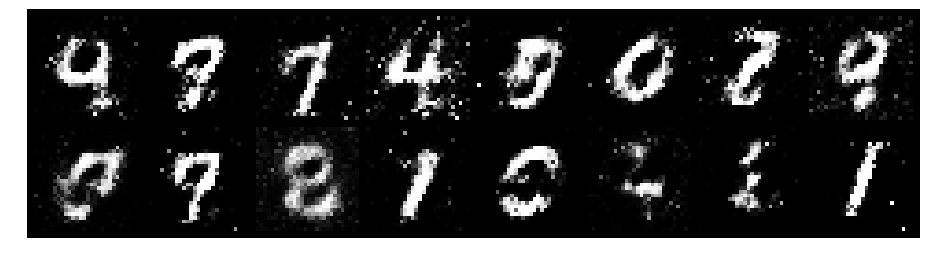

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.6960, Generator Loss: 1.9805
D(x): 0.7446, D(G(z)): 0.2056


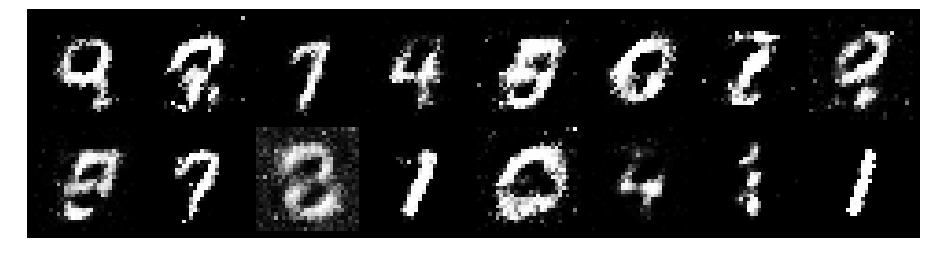

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.7262, Generator Loss: 1.8798
D(x): 0.7820, D(G(z)): 0.2705


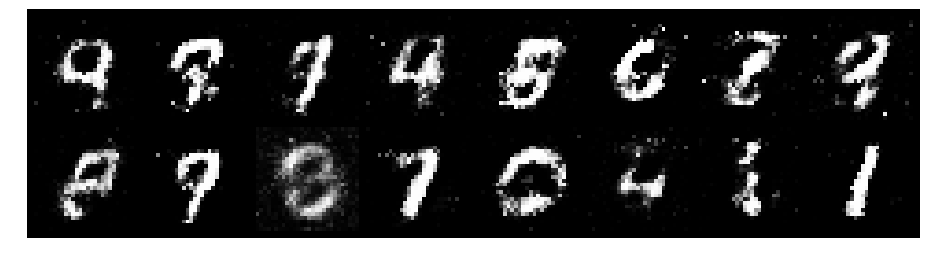

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.5965, Generator Loss: 1.8570
D(x): 0.7942, D(G(z)): 0.2198


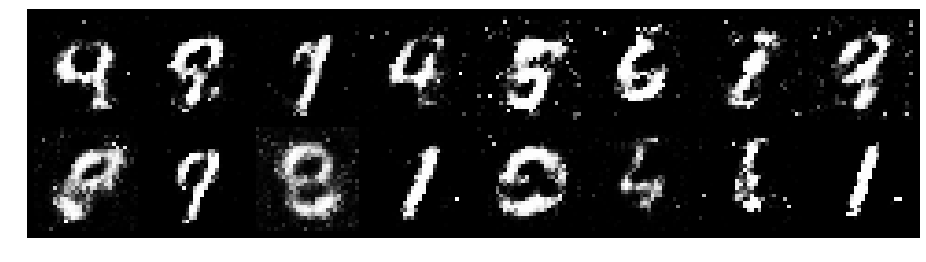

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.8258, Generator Loss: 1.8011
D(x): 0.7118, D(G(z)): 0.2664


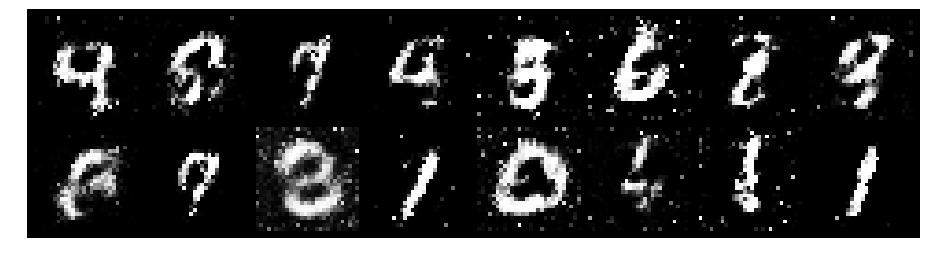

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.7062, Generator Loss: 1.6595
D(x): 0.7371, D(G(z)): 0.2522


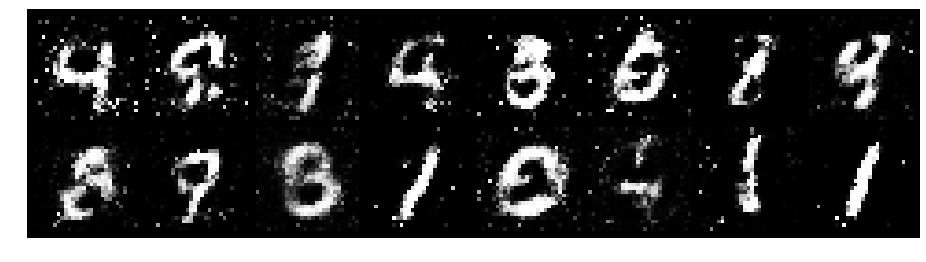

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.8462, Generator Loss: 1.6243
D(x): 0.7056, D(G(z)): 0.3064


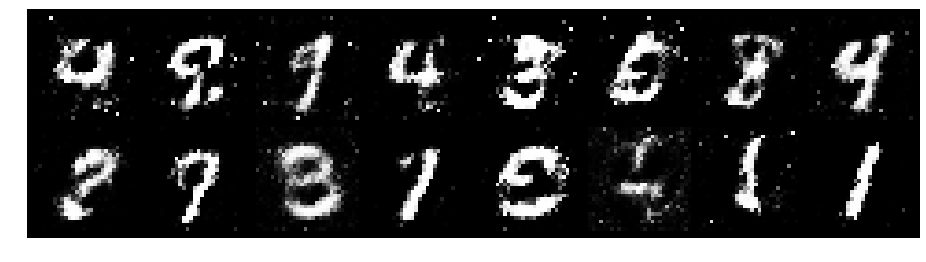

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.9719, Generator Loss: 1.7489
D(x): 0.6473, D(G(z)): 0.2719


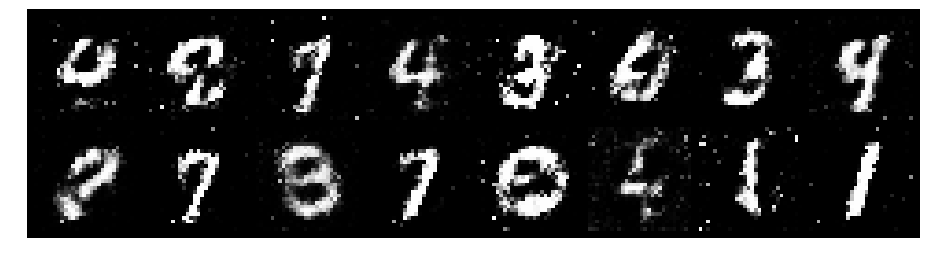

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.8549, Generator Loss: 1.4962
D(x): 0.7301, D(G(z)): 0.3061


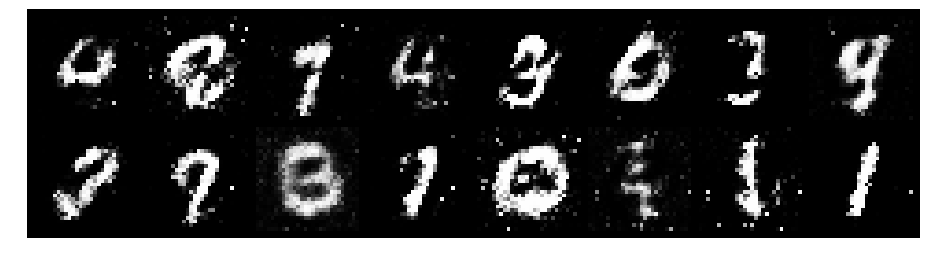

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 0.8695, Generator Loss: 1.8628
D(x): 0.6948, D(G(z)): 0.2748


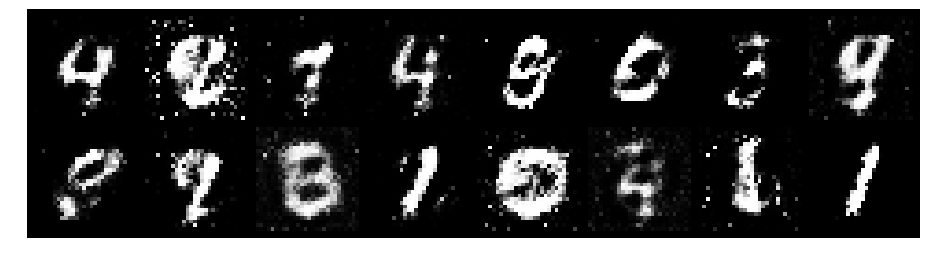

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.9112, Generator Loss: 1.1913
D(x): 0.7459, D(G(z)): 0.3611


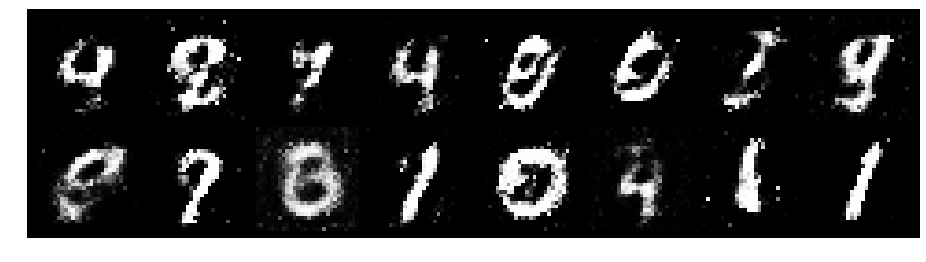

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.9989, Generator Loss: 1.7245
D(x): 0.6370, D(G(z)): 0.2551


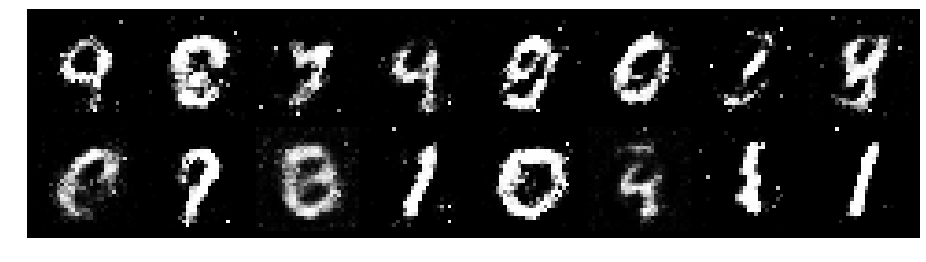

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 1.1566, Generator Loss: 1.3497
D(x): 0.6201, D(G(z)): 0.3425


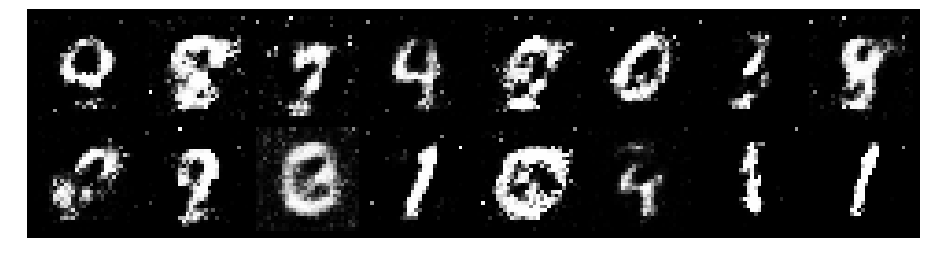

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 1.1148, Generator Loss: 1.4036
D(x): 0.6729, D(G(z)): 0.3425


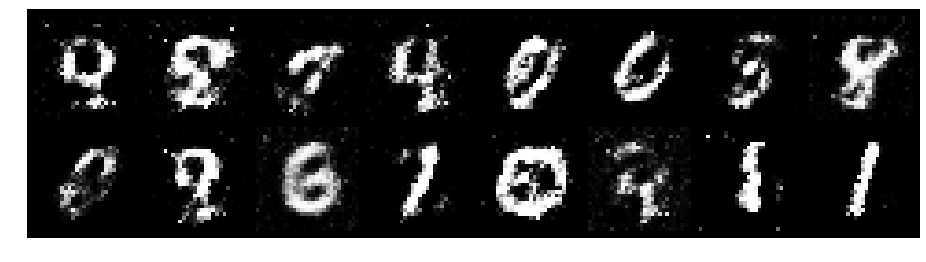

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.9963, Generator Loss: 1.5471
D(x): 0.6853, D(G(z)): 0.3383


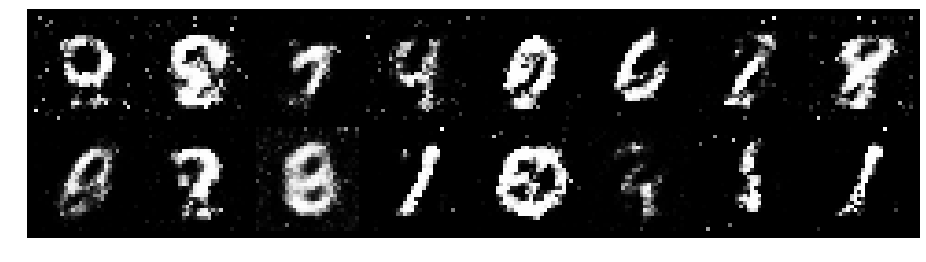

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.9406, Generator Loss: 1.6065
D(x): 0.6575, D(G(z)): 0.3029


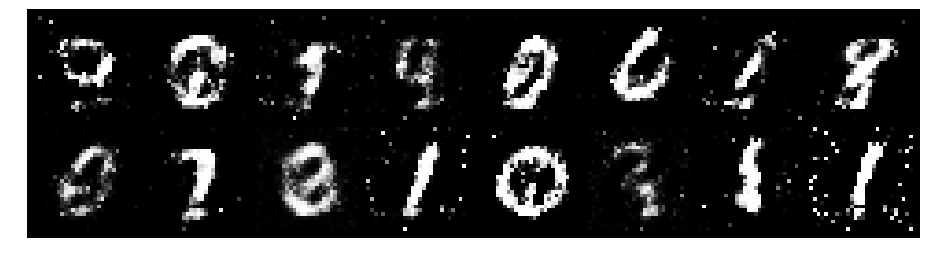

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 1.0594, Generator Loss: 1.4353
D(x): 0.7171, D(G(z)): 0.3963


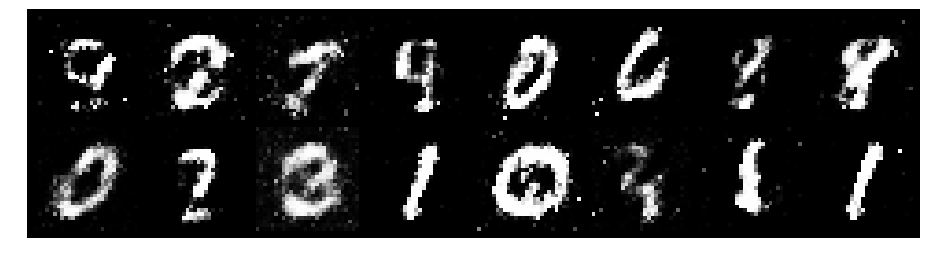

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 1.0266, Generator Loss: 1.4672
D(x): 0.6968, D(G(z)): 0.3470


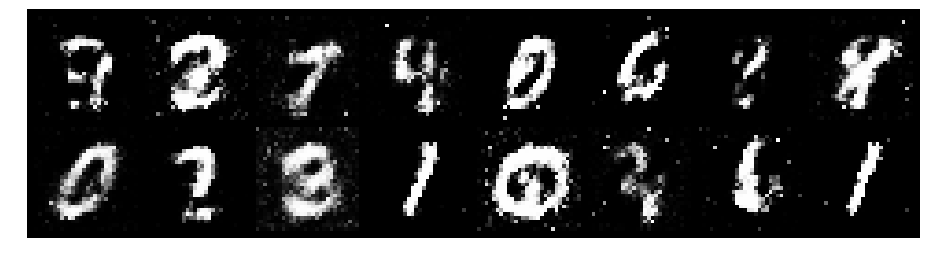

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 0.8875, Generator Loss: 1.4878
D(x): 0.6718, D(G(z)): 0.2642


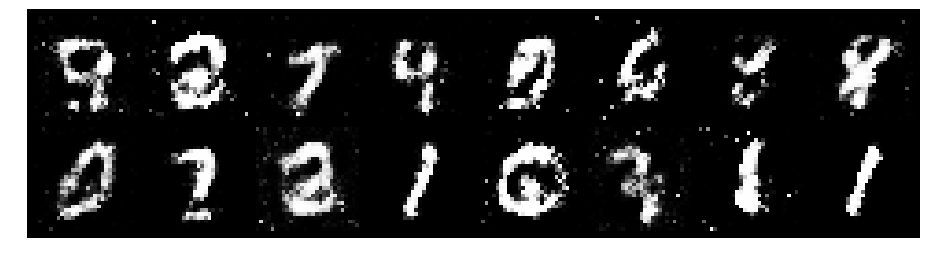

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.9367, Generator Loss: 1.6737
D(x): 0.8030, D(G(z)): 0.3886


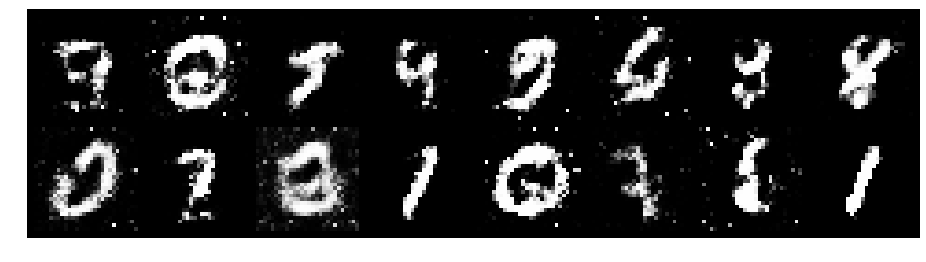

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 0.8501, Generator Loss: 1.2977
D(x): 0.7311, D(G(z)): 0.3028


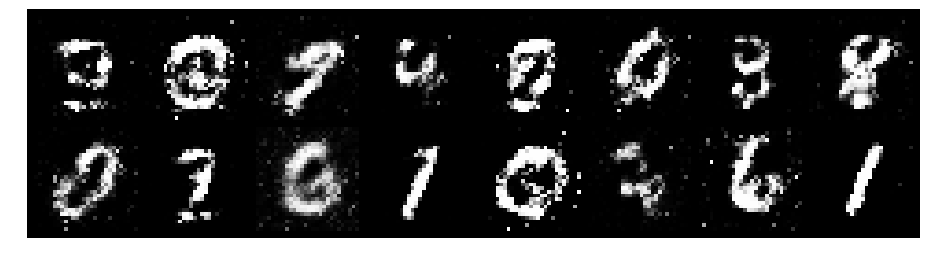

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 0.9037, Generator Loss: 1.3714
D(x): 0.6832, D(G(z)): 0.3123


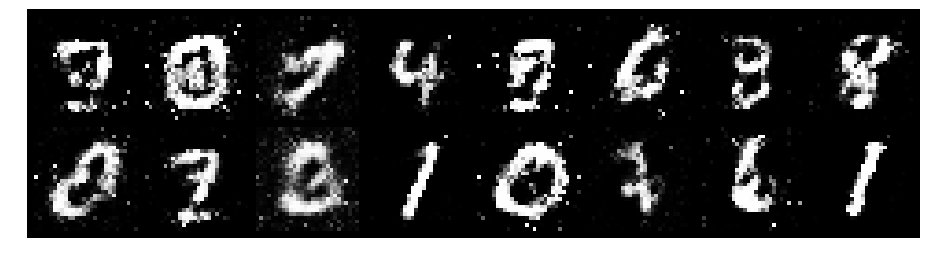

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.9338, Generator Loss: 1.2942
D(x): 0.6750, D(G(z)): 0.3261


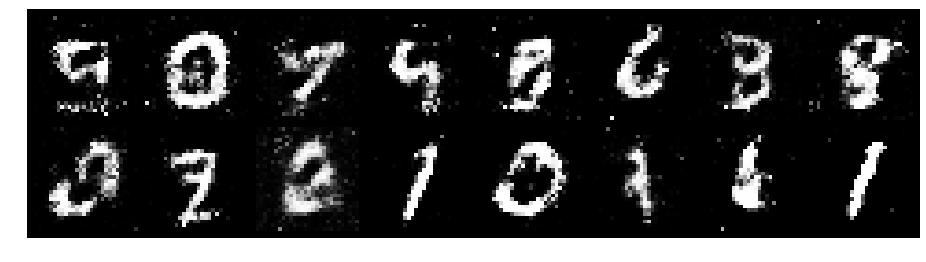

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.7798, Generator Loss: 1.4041
D(x): 0.7625, D(G(z)): 0.3134


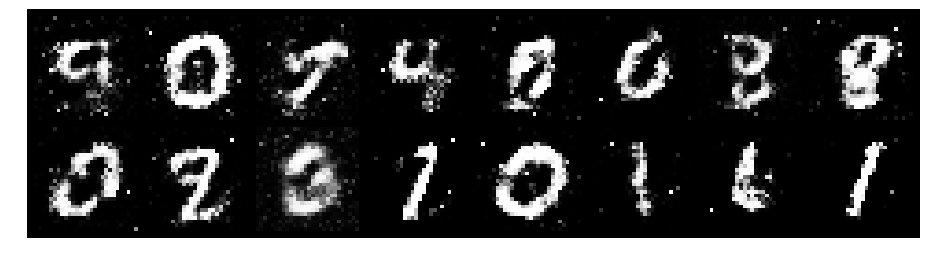

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.9581, Generator Loss: 1.4986
D(x): 0.6598, D(G(z)): 0.2731


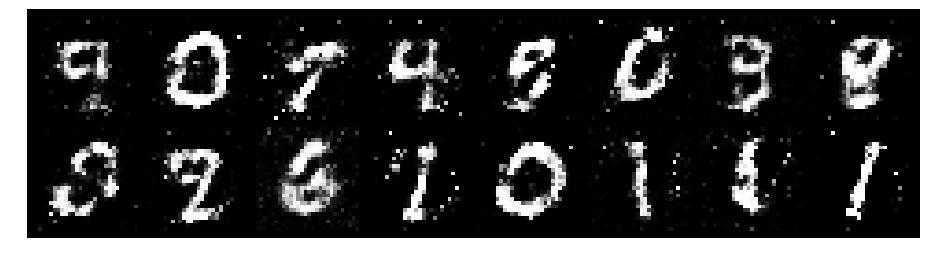

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.9490, Generator Loss: 1.3282
D(x): 0.7156, D(G(z)): 0.3746


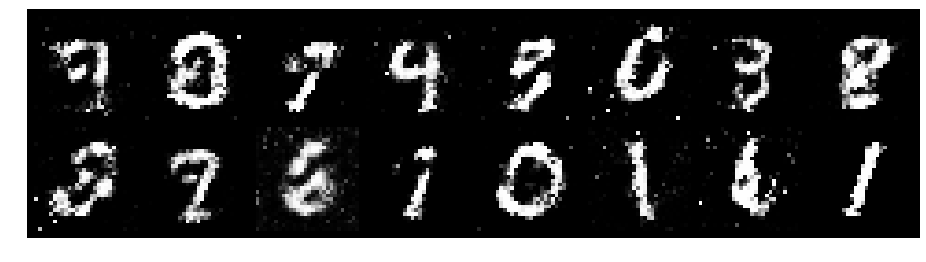

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.8905, Generator Loss: 1.4127
D(x): 0.6808, D(G(z)): 0.3293


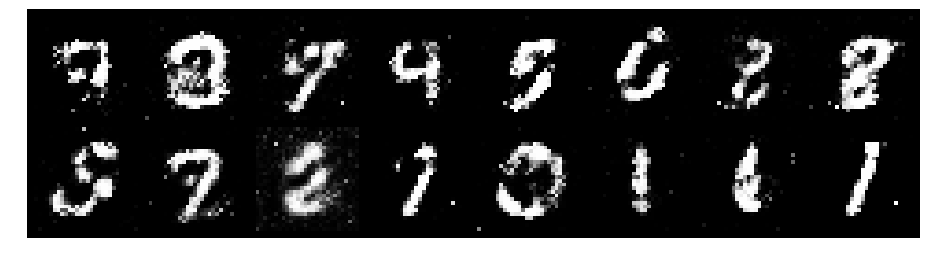

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 0.9208, Generator Loss: 1.3588
D(x): 0.6973, D(G(z)): 0.3020


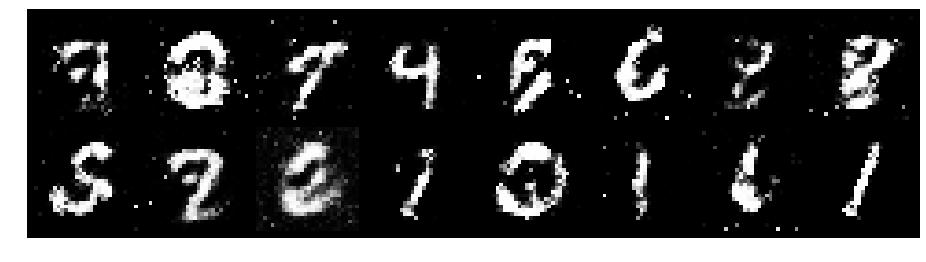

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 0.8910, Generator Loss: 1.2896
D(x): 0.6328, D(G(z)): 0.2540


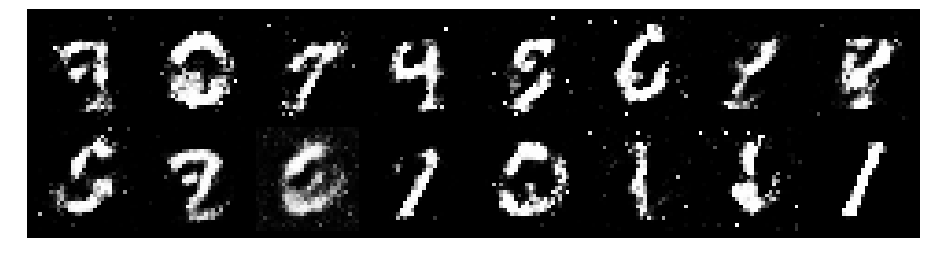

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 0.7484, Generator Loss: 1.5841
D(x): 0.7665, D(G(z)): 0.2933


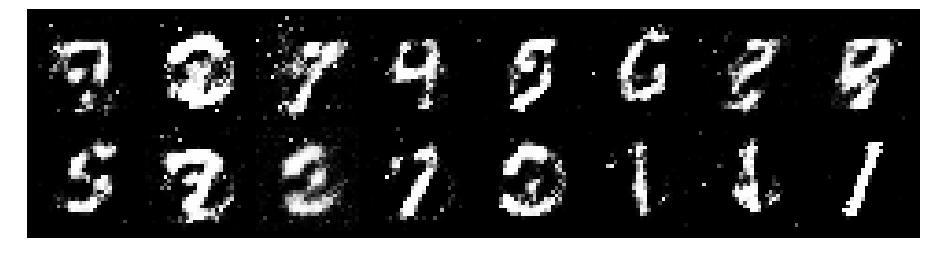

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.9013, Generator Loss: 1.5393
D(x): 0.7457, D(G(z)): 0.3115


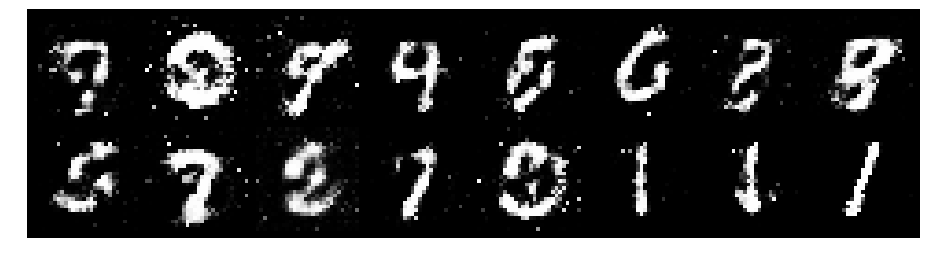

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 1.1101, Generator Loss: 1.3574
D(x): 0.6877, D(G(z)): 0.3993


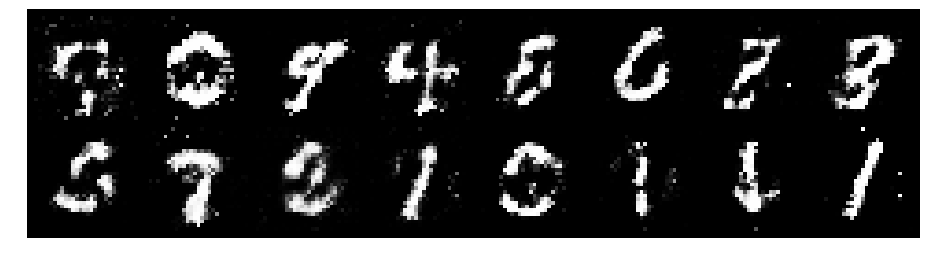

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 1.1804, Generator Loss: 1.2541
D(x): 0.6800, D(G(z)): 0.4055


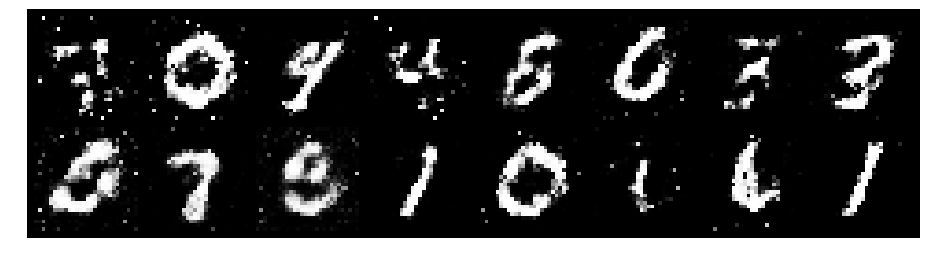

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 0.9220, Generator Loss: 1.5347
D(x): 0.6972, D(G(z)): 0.3207


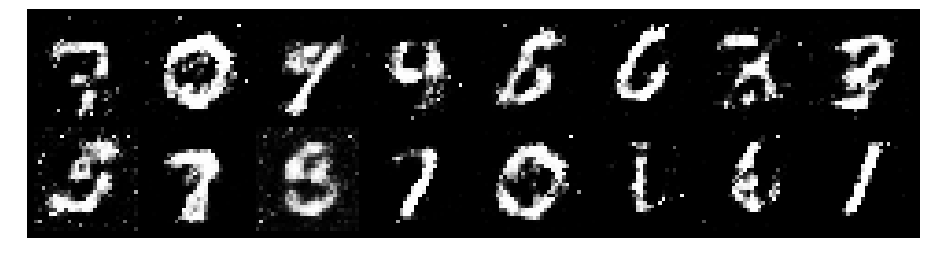

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 0.9580, Generator Loss: 1.2976
D(x): 0.6360, D(G(z)): 0.3199


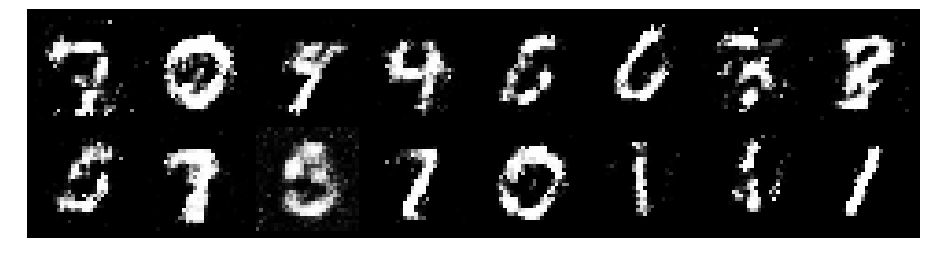

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.8411, Generator Loss: 1.3840
D(x): 0.7376, D(G(z)): 0.3011


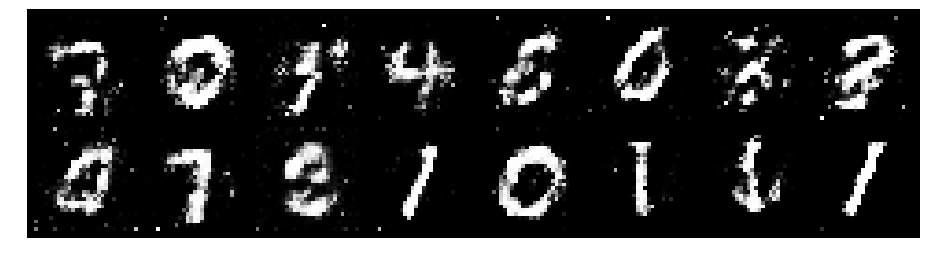

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.9562, Generator Loss: 1.5731
D(x): 0.6823, D(G(z)): 0.3242


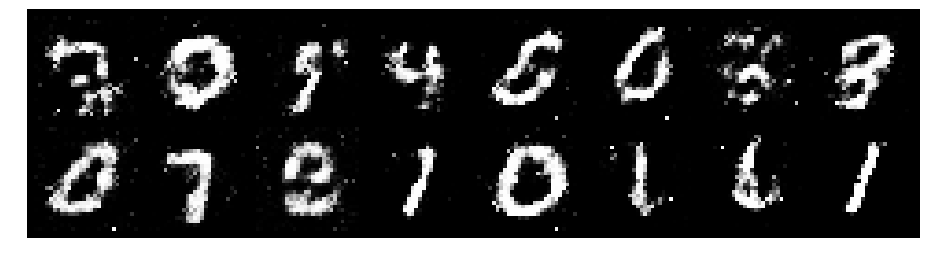

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.9165, Generator Loss: 1.2958
D(x): 0.6604, D(G(z)): 0.3095


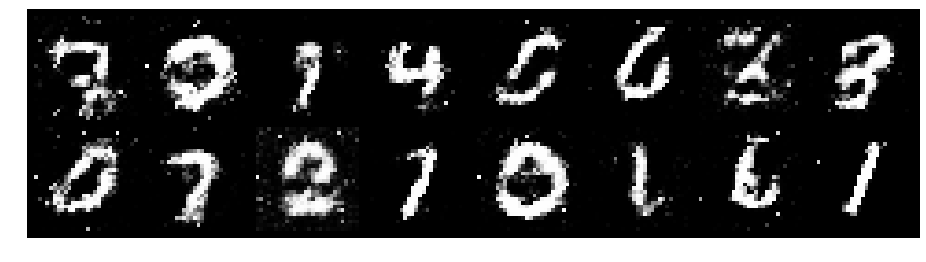

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 1.2811, Generator Loss: 1.1375
D(x): 0.5398, D(G(z)): 0.3729


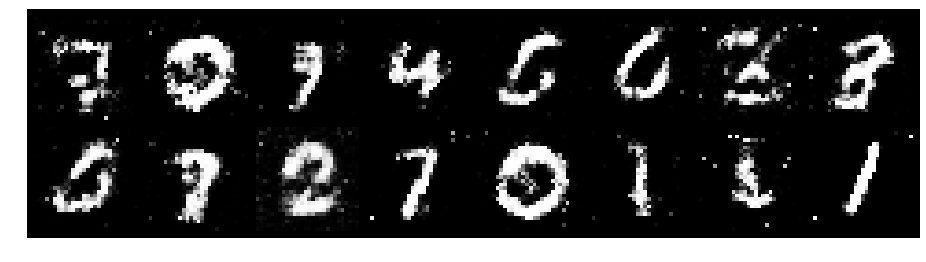

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 1.2129, Generator Loss: 1.1698
D(x): 0.6177, D(G(z)): 0.3987


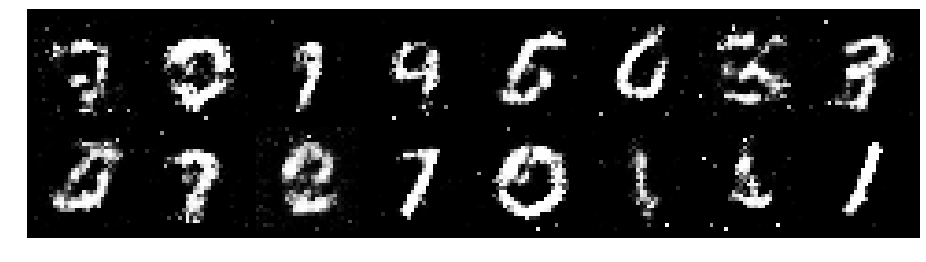

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 1.1864, Generator Loss: 1.1793
D(x): 0.6487, D(G(z)): 0.4055


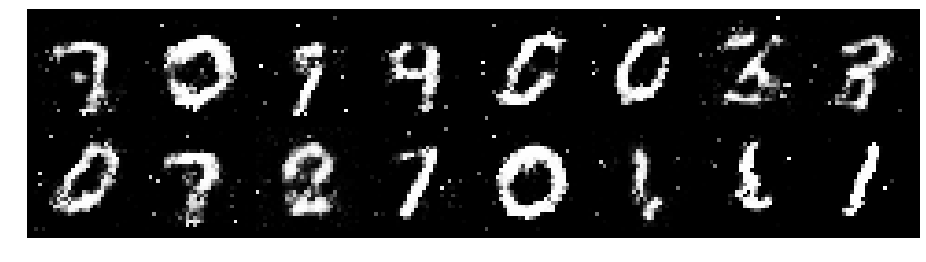

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 0.7718, Generator Loss: 1.5831
D(x): 0.7066, D(G(z)): 0.2555


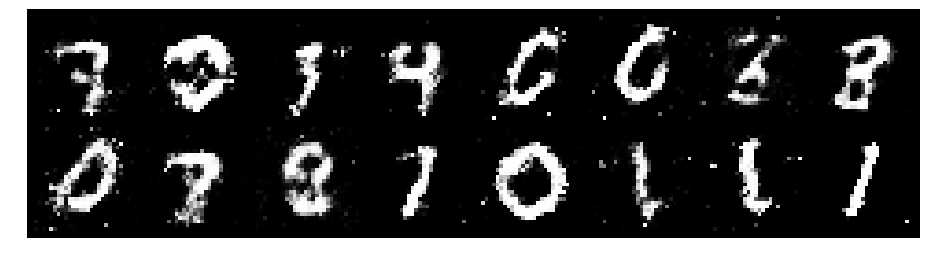

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 1.0468, Generator Loss: 1.3629
D(x): 0.6278, D(G(z)): 0.3454


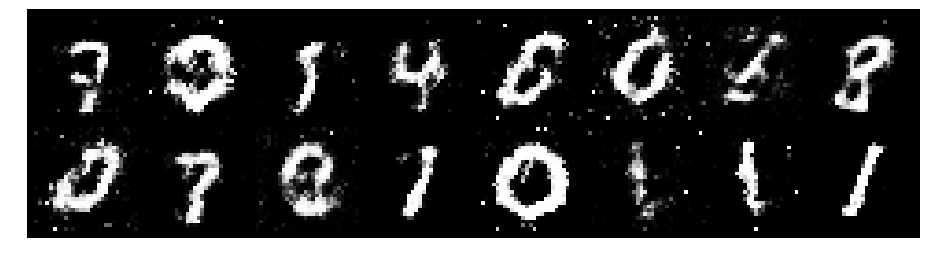

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 0.9943, Generator Loss: 1.2158
D(x): 0.6232, D(G(z)): 0.3008


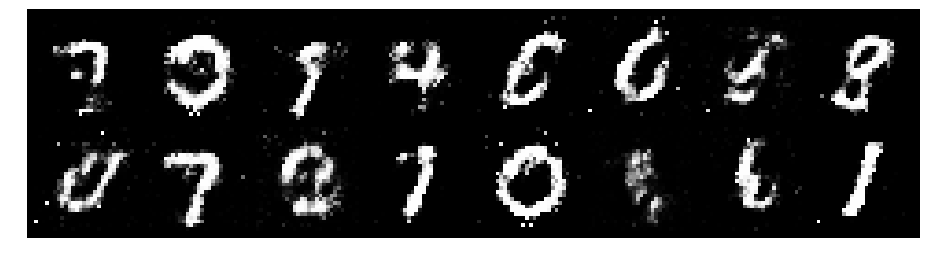

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 1.0452, Generator Loss: 1.2109
D(x): 0.6742, D(G(z)): 0.3718


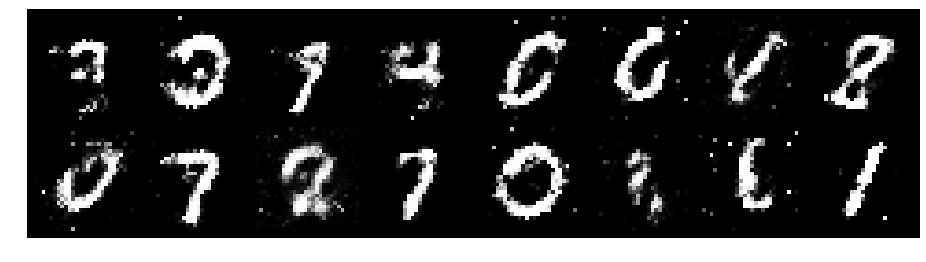

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 0.9673, Generator Loss: 1.3978
D(x): 0.6659, D(G(z)): 0.3047


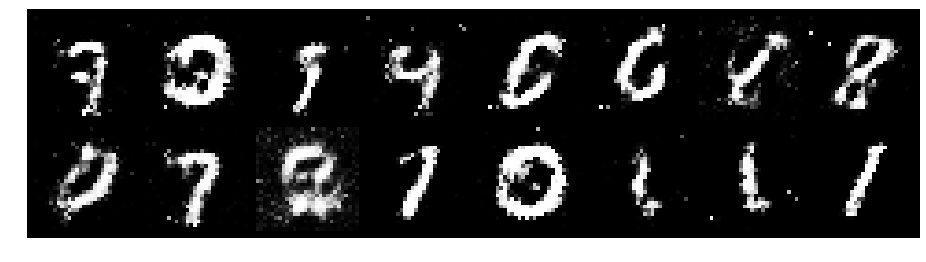

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 0.8174, Generator Loss: 1.5410
D(x): 0.7116, D(G(z)): 0.2524


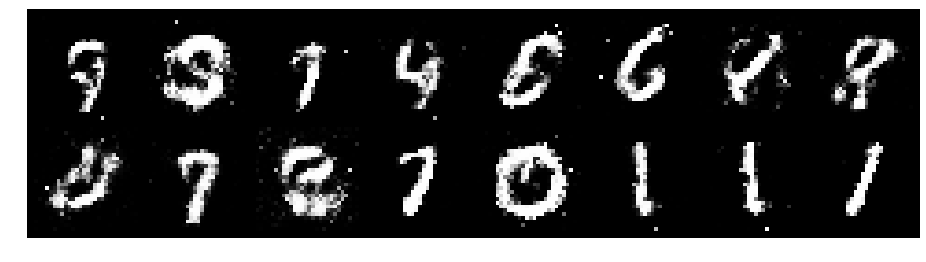

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 0.8125, Generator Loss: 1.2799
D(x): 0.7818, D(G(z)): 0.3570


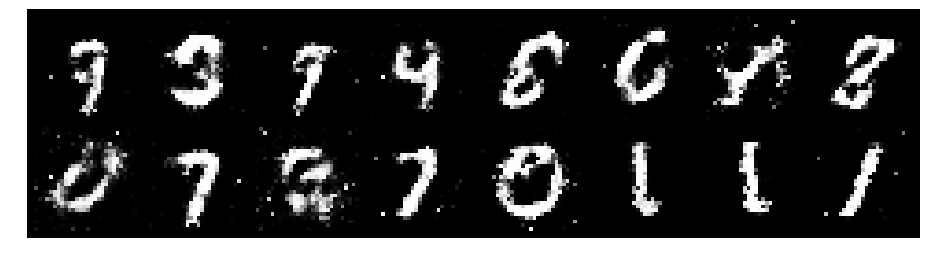

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.8568, Generator Loss: 1.5424
D(x): 0.7253, D(G(z)): 0.3282


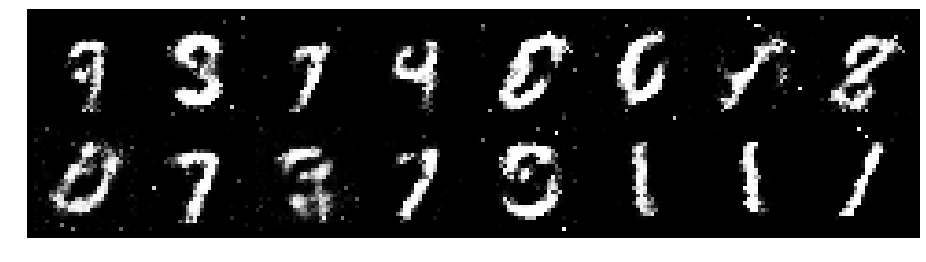

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 1.0797, Generator Loss: 1.7076
D(x): 0.5805, D(G(z)): 0.2875


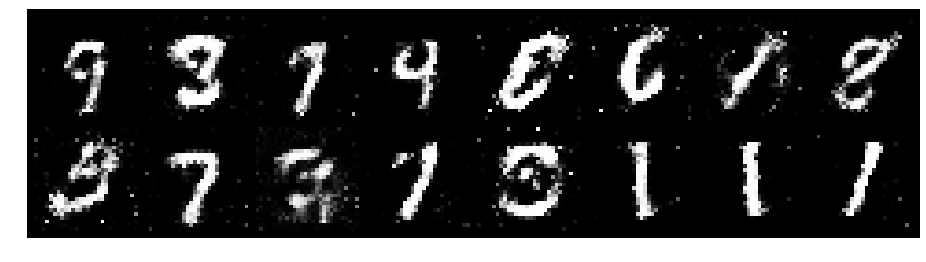

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.8992, Generator Loss: 1.4769
D(x): 0.7182, D(G(z)): 0.3280


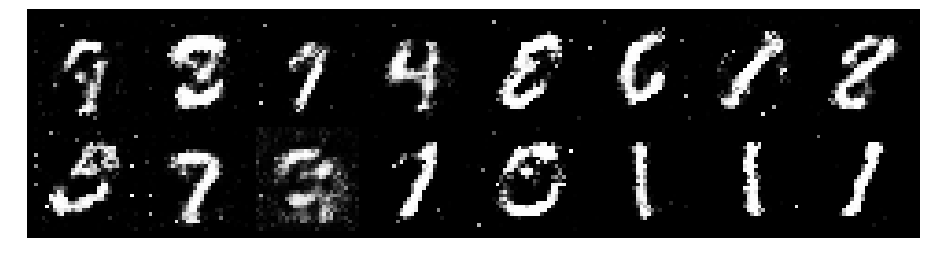

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.8766, Generator Loss: 1.8374
D(x): 0.6554, D(G(z)): 0.2578


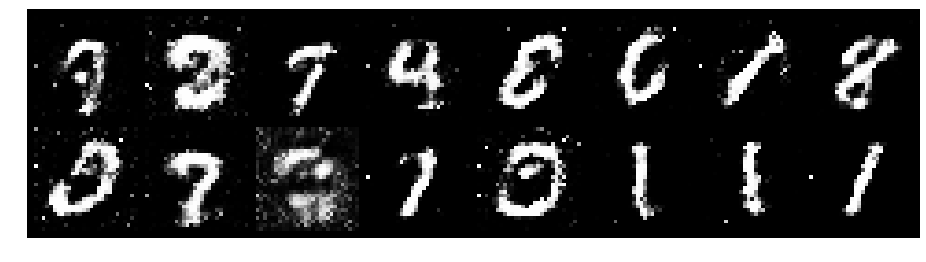

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 0.8078, Generator Loss: 1.5043
D(x): 0.6802, D(G(z)): 0.2251


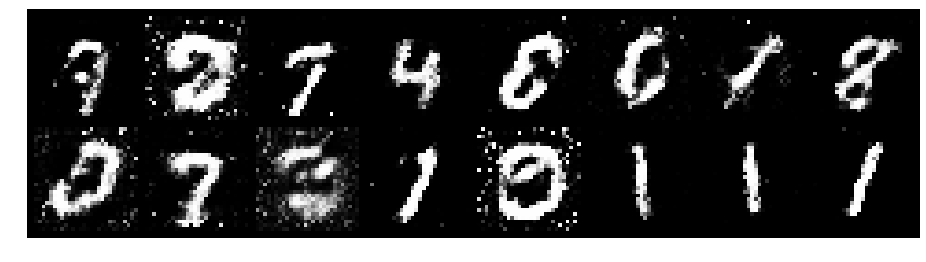

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 0.9638, Generator Loss: 1.2709
D(x): 0.6890, D(G(z)): 0.3667


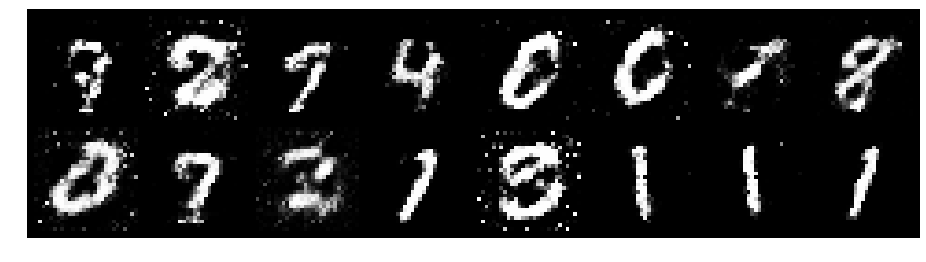

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 1.1008, Generator Loss: 1.6417
D(x): 0.5976, D(G(z)): 0.3281


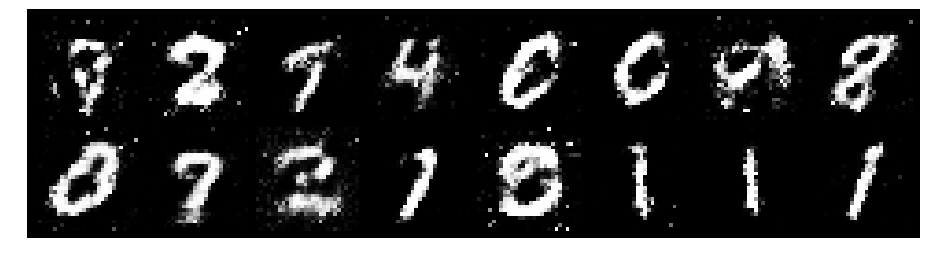

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 0.9987, Generator Loss: 1.1945
D(x): 0.6635, D(G(z)): 0.3497


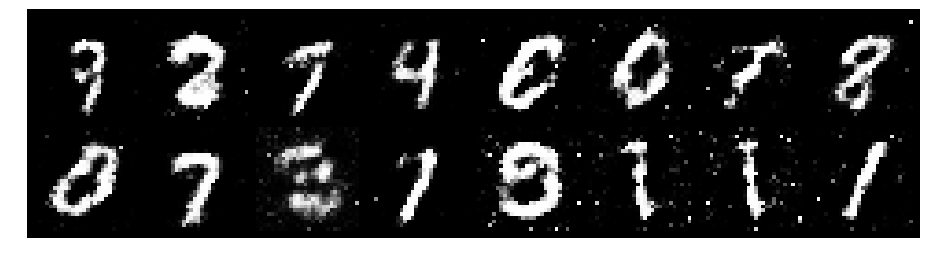

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 1.2515, Generator Loss: 0.9750
D(x): 0.6029, D(G(z)): 0.4266


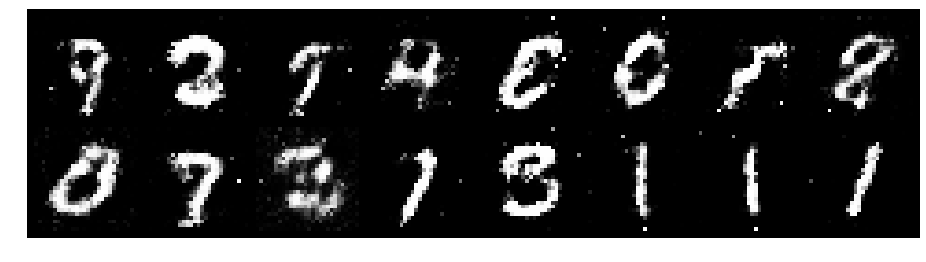

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.9579, Generator Loss: 1.2908
D(x): 0.6750, D(G(z)): 0.3433


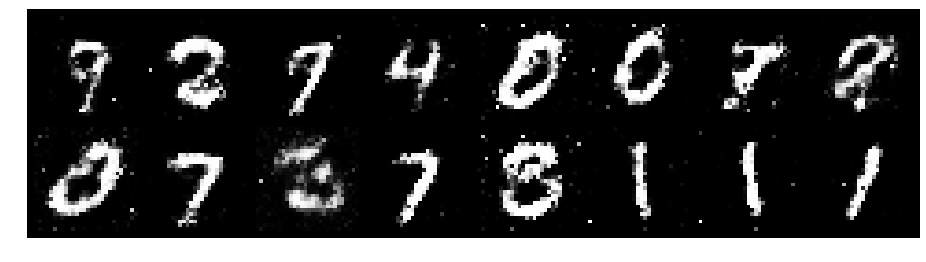

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 1.0946, Generator Loss: 1.5113
D(x): 0.6631, D(G(z)): 0.3378


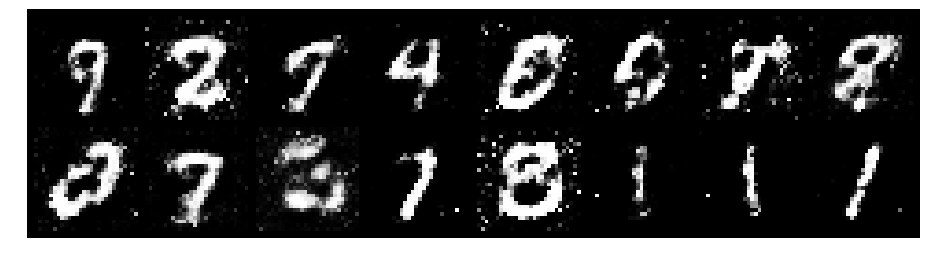

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 1.0839, Generator Loss: 1.2215
D(x): 0.6445, D(G(z)): 0.3349


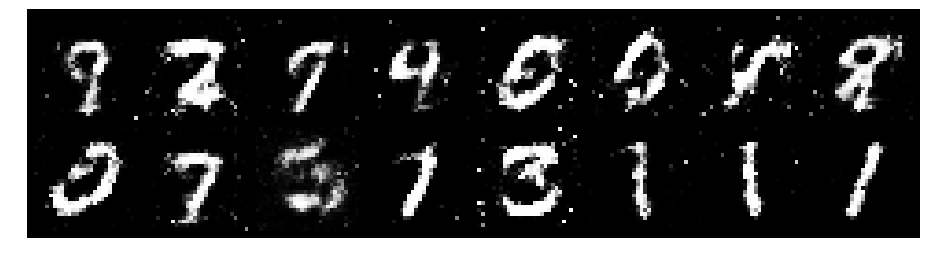

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 1.1453, Generator Loss: 1.4023
D(x): 0.6204, D(G(z)): 0.3819


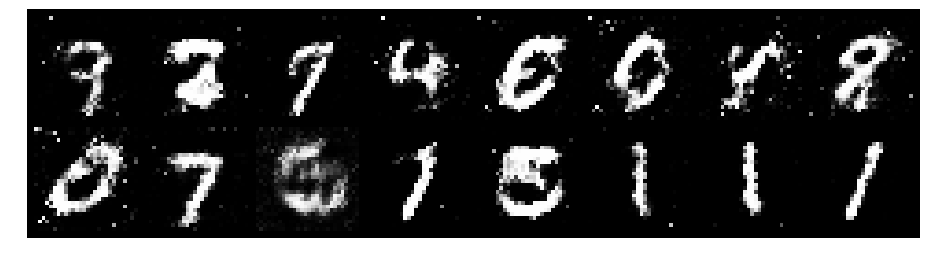

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 0.8571, Generator Loss: 1.3043
D(x): 0.6943, D(G(z)): 0.3125


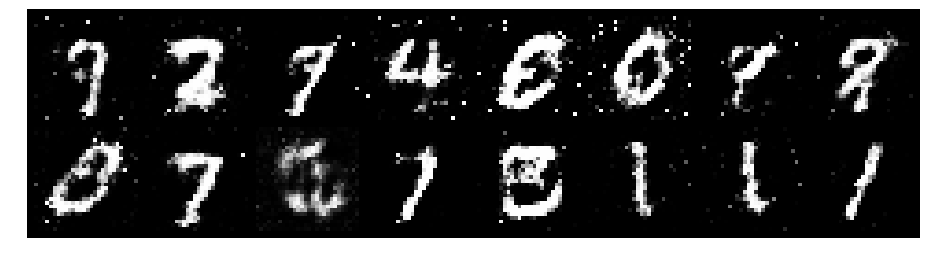

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 1.0344, Generator Loss: 1.2024
D(x): 0.6545, D(G(z)): 0.3888


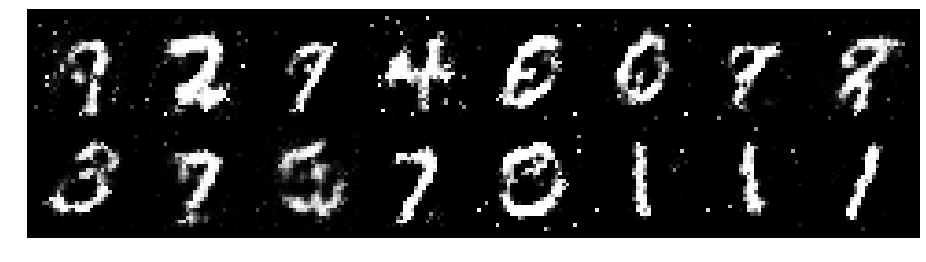

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 1.0418, Generator Loss: 1.4598
D(x): 0.5820, D(G(z)): 0.2996


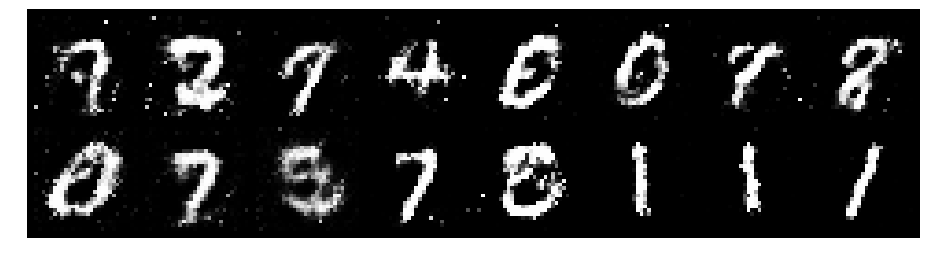

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 1.0464, Generator Loss: 0.9628
D(x): 0.6864, D(G(z)): 0.4124


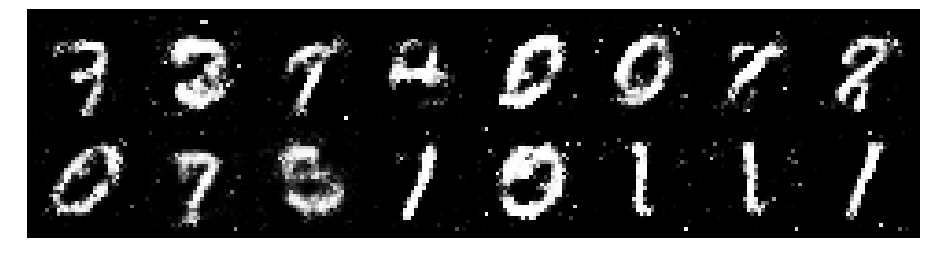

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 0.8336, Generator Loss: 1.5678
D(x): 0.6919, D(G(z)): 0.2758


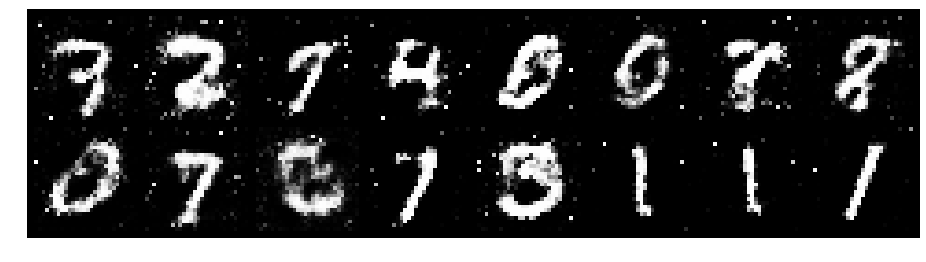

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 0.8214, Generator Loss: 1.3816
D(x): 0.7273, D(G(z)): 0.2881


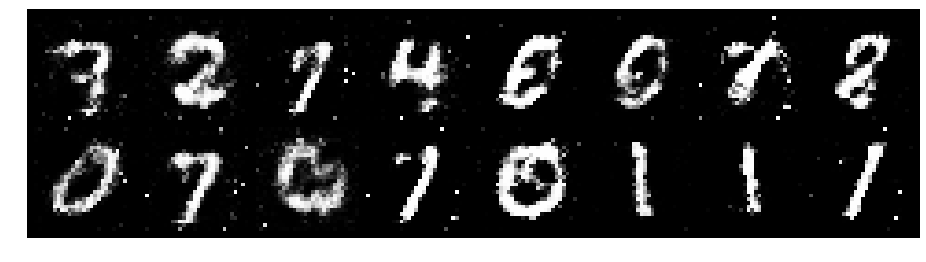

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.8222, Generator Loss: 1.3857
D(x): 0.7537, D(G(z)): 0.3402


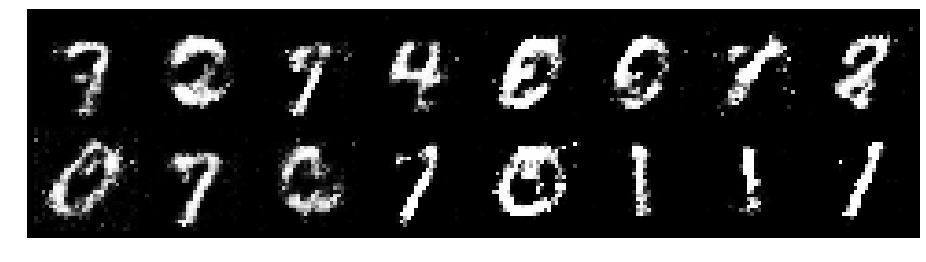

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 0.9659, Generator Loss: 1.2013
D(x): 0.6731, D(G(z)): 0.3569


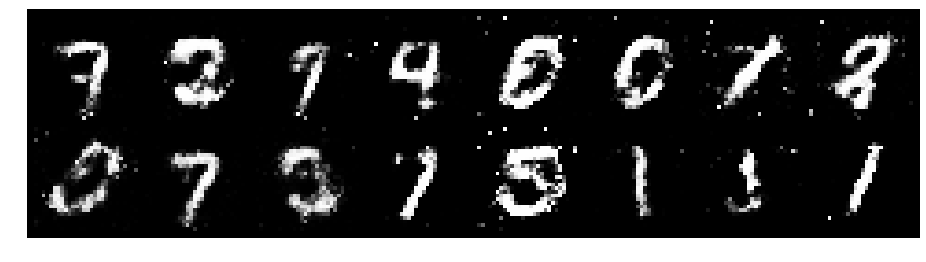

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 0.9413, Generator Loss: 1.2729
D(x): 0.6676, D(G(z)): 0.3370


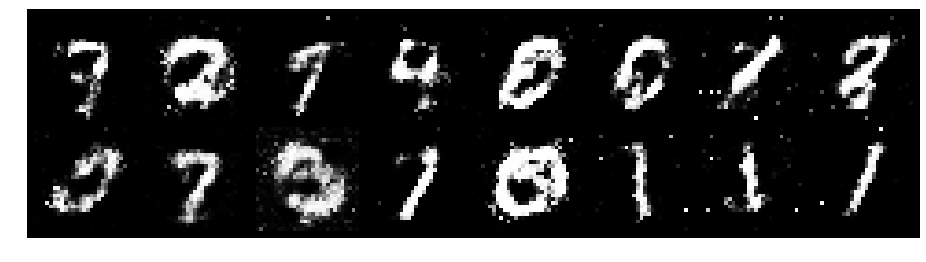

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 0.8682, Generator Loss: 1.2542
D(x): 0.7505, D(G(z)): 0.3640


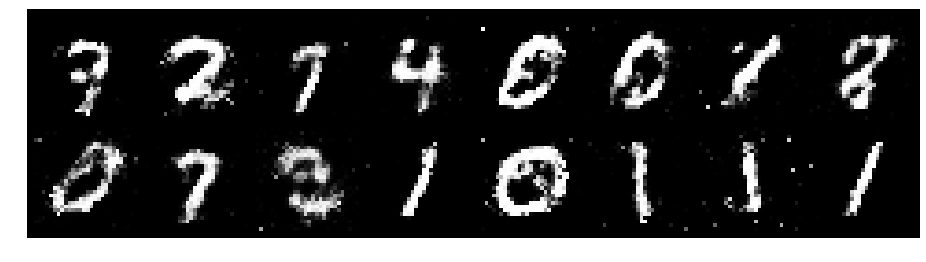

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 0.8889, Generator Loss: 1.5730
D(x): 0.7445, D(G(z)): 0.3316


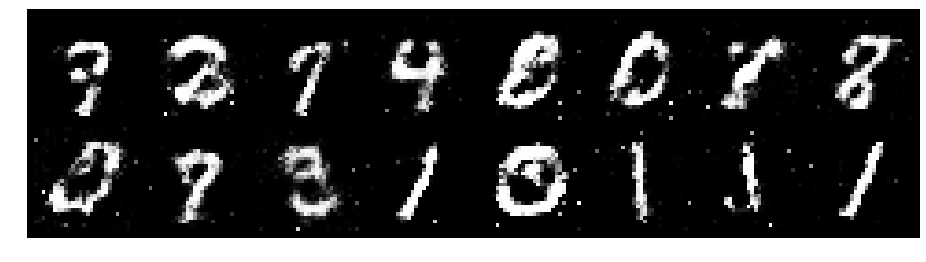

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 1.1080, Generator Loss: 1.1271
D(x): 0.5847, D(G(z)): 0.3256


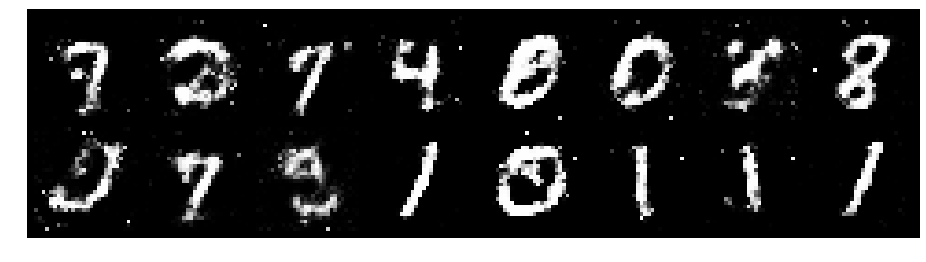

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 0.9293, Generator Loss: 1.5186
D(x): 0.6928, D(G(z)): 0.3207


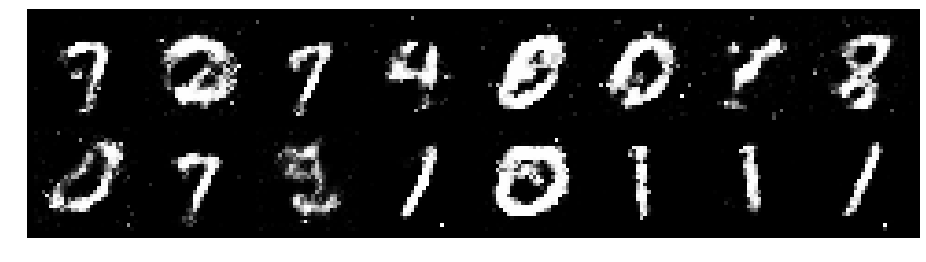

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 1.1134, Generator Loss: 1.6032
D(x): 0.5904, D(G(z)): 0.2808


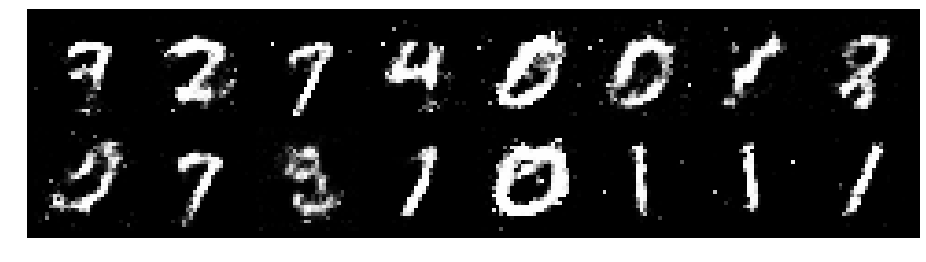

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 1.1833, Generator Loss: 1.3994
D(x): 0.5615, D(G(z)): 0.3456


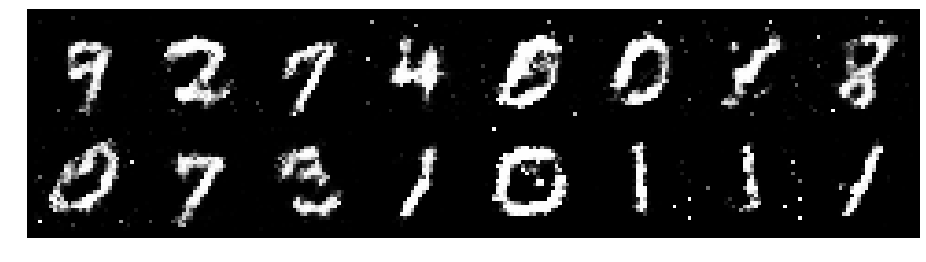

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 0.8557, Generator Loss: 1.6179
D(x): 0.6732, D(G(z)): 0.2860


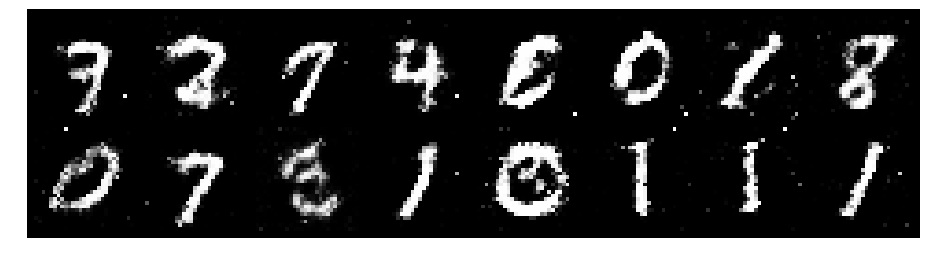

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 0.9324, Generator Loss: 1.4514
D(x): 0.6610, D(G(z)): 0.3057


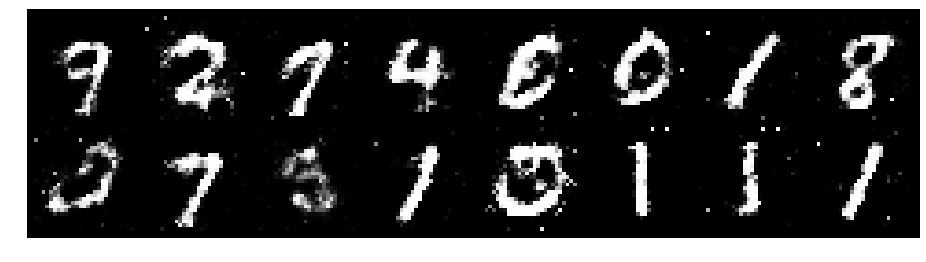

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 0.9418, Generator Loss: 1.3526
D(x): 0.7316, D(G(z)): 0.3480


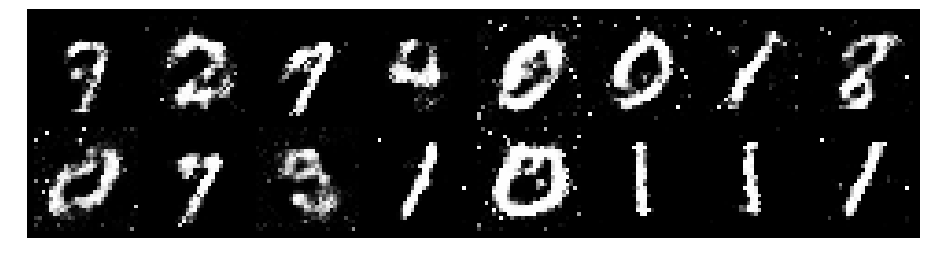

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 0.9672, Generator Loss: 1.6453
D(x): 0.6369, D(G(z)): 0.2954


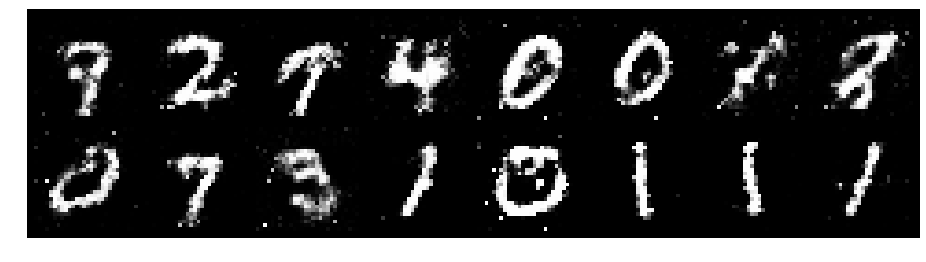

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 0.8722, Generator Loss: 1.3566
D(x): 0.7307, D(G(z)): 0.2992


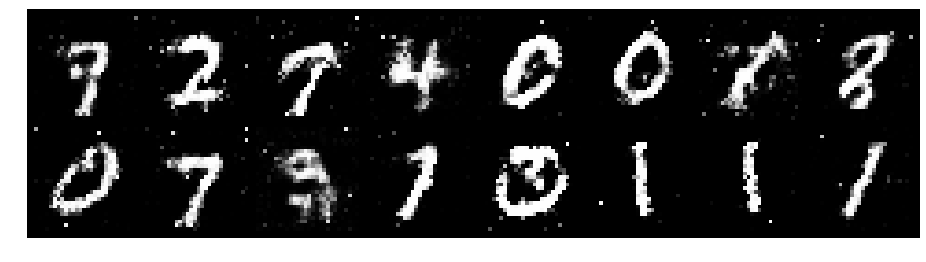

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 0.9020, Generator Loss: 1.4509
D(x): 0.7483, D(G(z)): 0.3276


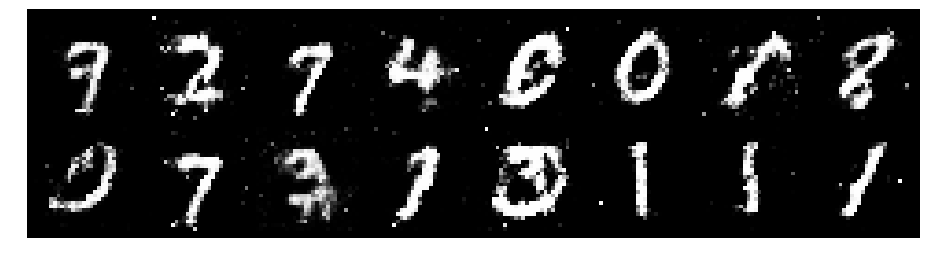

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 0.9740, Generator Loss: 1.4199
D(x): 0.7379, D(G(z)): 0.3906


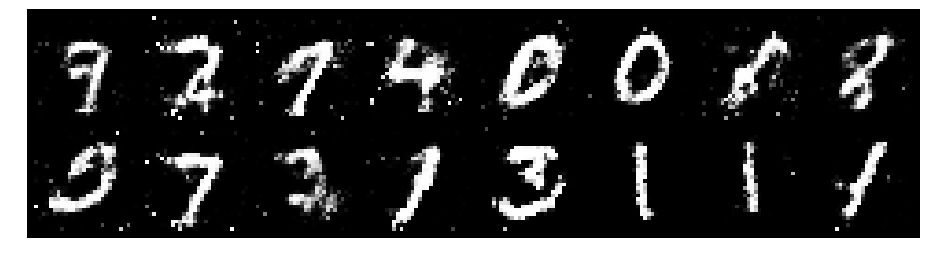

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 0.9520, Generator Loss: 1.2892
D(x): 0.7083, D(G(z)): 0.3668


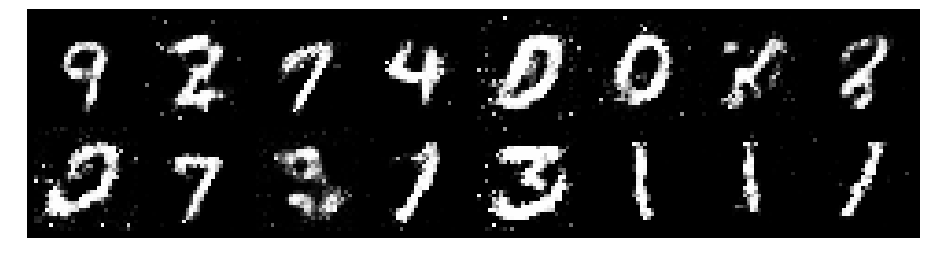

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 0.8909, Generator Loss: 1.3819
D(x): 0.6755, D(G(z)): 0.2844


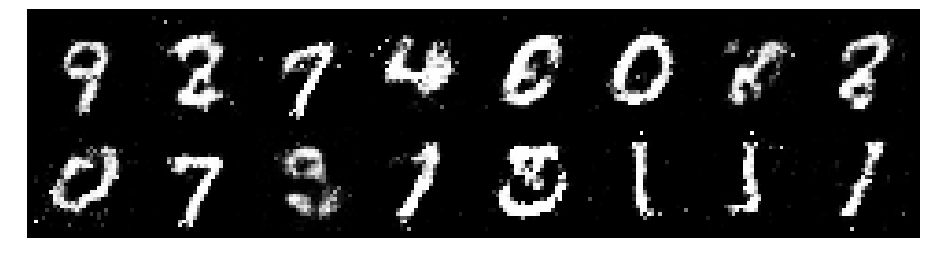

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 0.9393, Generator Loss: 1.6887
D(x): 0.6760, D(G(z)): 0.3032


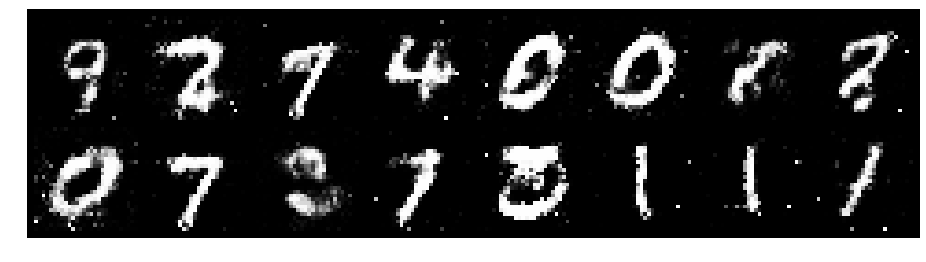

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 0.9423, Generator Loss: 1.4780
D(x): 0.7106, D(G(z)): 0.3598


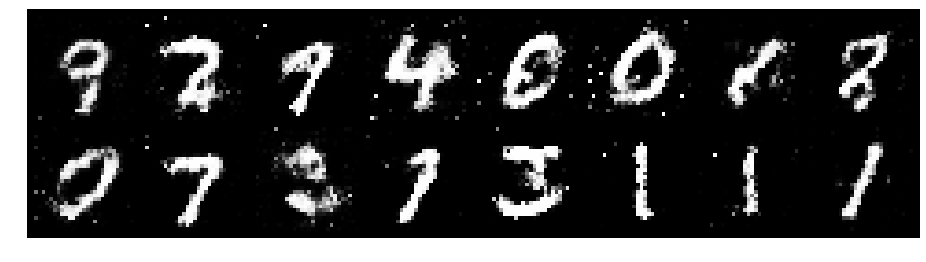

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.1700, Generator Loss: 1.4322
D(x): 0.6143, D(G(z)): 0.3692


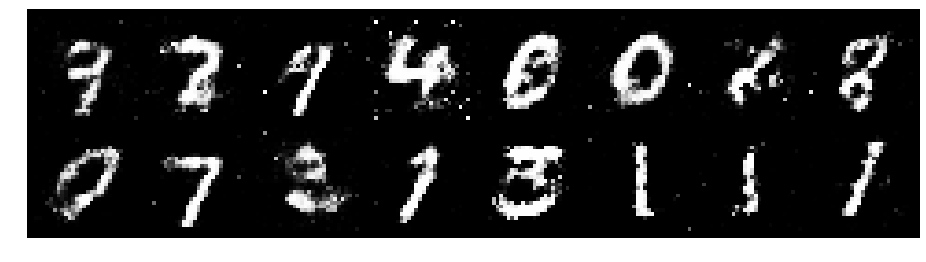

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.0907, Generator Loss: 1.2262
D(x): 0.5911, D(G(z)): 0.3385


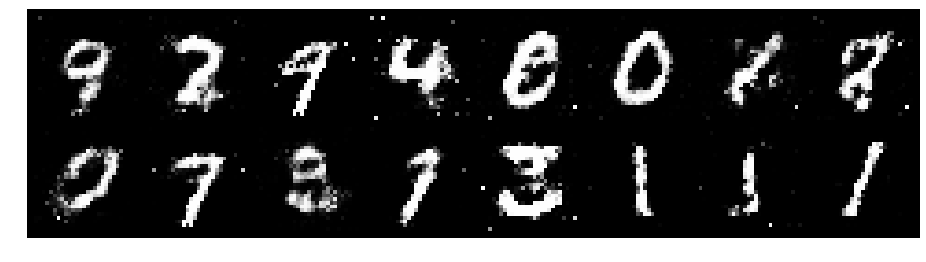

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.1967, Generator Loss: 1.2966
D(x): 0.6538, D(G(z)): 0.4186


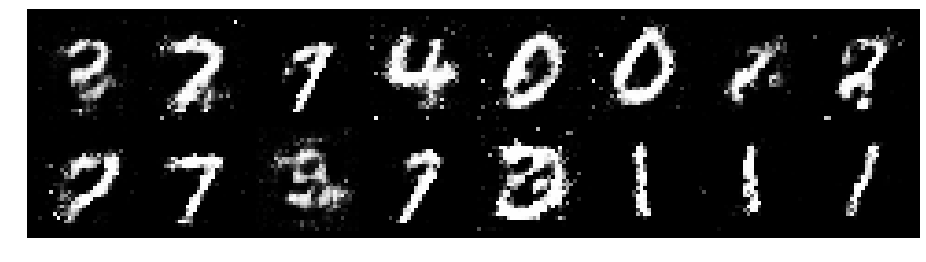

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 1.0814, Generator Loss: 1.1133
D(x): 0.5858, D(G(z)): 0.3462


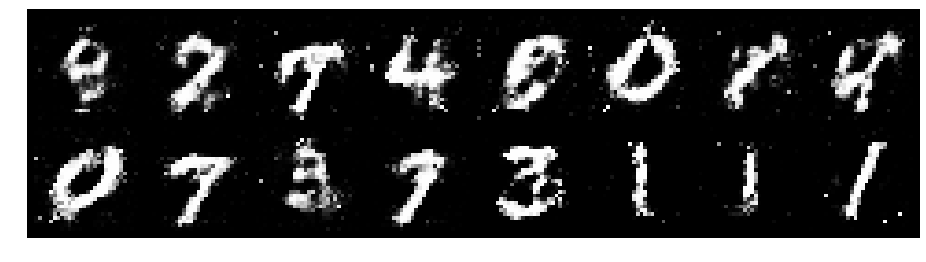

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 0.9358, Generator Loss: 1.7044
D(x): 0.7227, D(G(z)): 0.3586


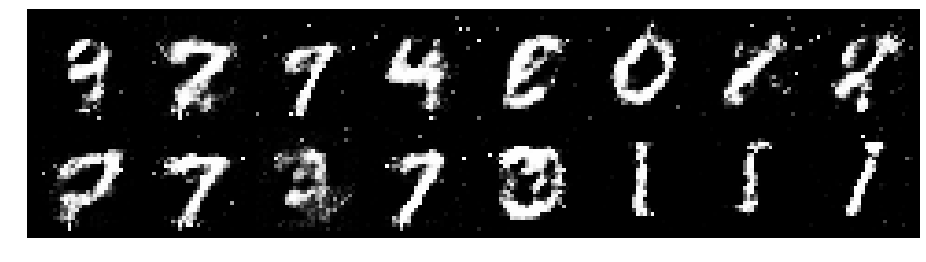

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 1.0099, Generator Loss: 1.1488
D(x): 0.6400, D(G(z)): 0.3338


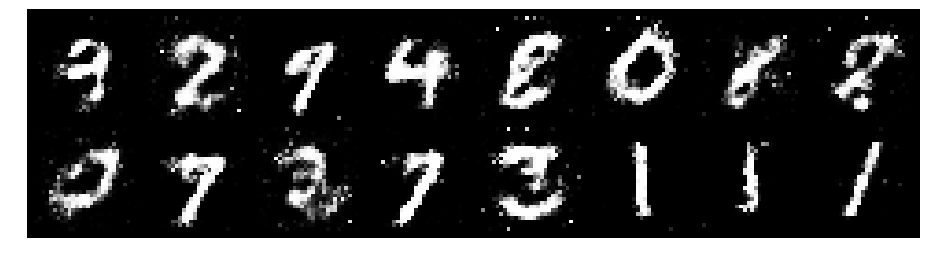

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 0.9879, Generator Loss: 1.3287
D(x): 0.6735, D(G(z)): 0.3570


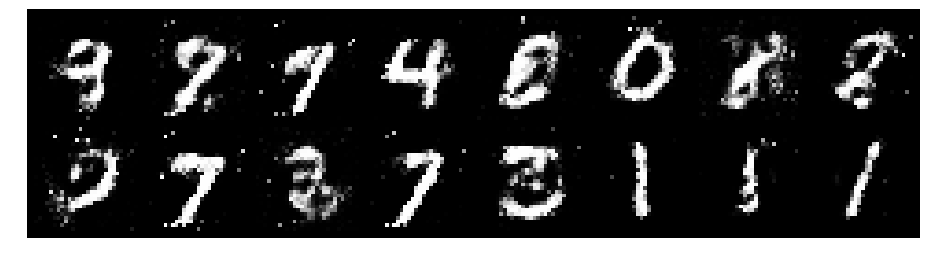

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 0.8241, Generator Loss: 1.3335
D(x): 0.7140, D(G(z)): 0.2818


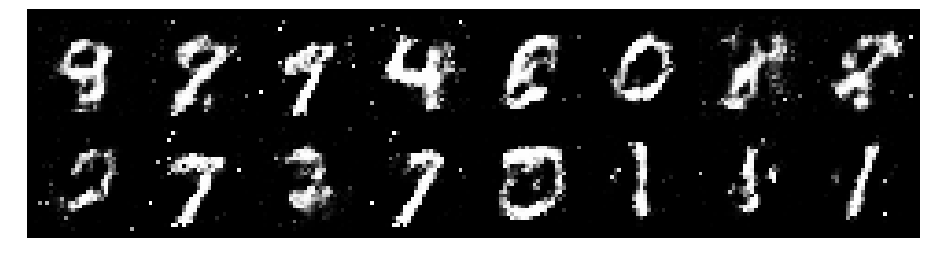

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 1.0205, Generator Loss: 1.2413
D(x): 0.6538, D(G(z)): 0.3588


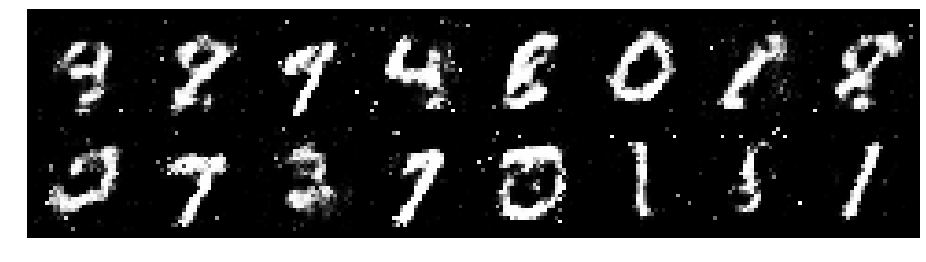

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 1.1037, Generator Loss: 1.1988
D(x): 0.6467, D(G(z)): 0.3782


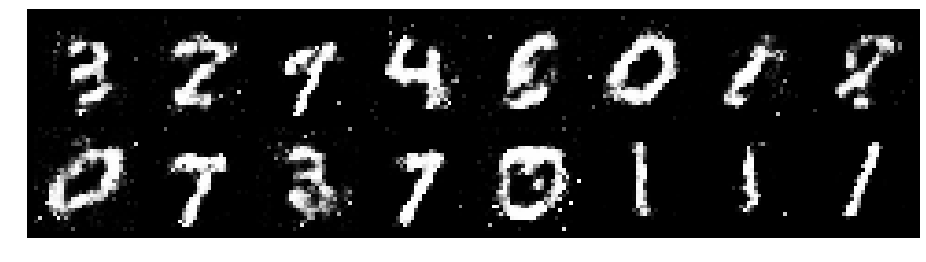

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 1.0713, Generator Loss: 1.2399
D(x): 0.6220, D(G(z)): 0.3351


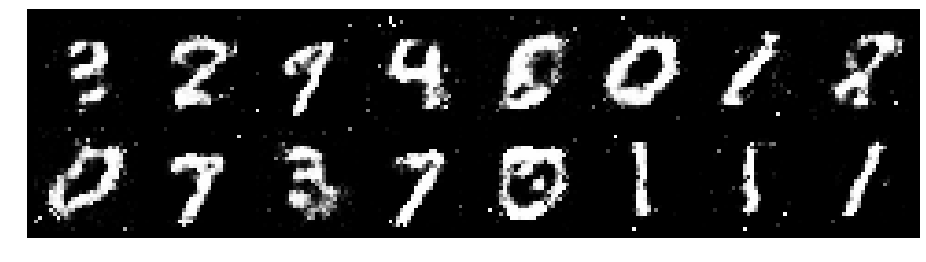

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.0361, Generator Loss: 1.1206
D(x): 0.6414, D(G(z)): 0.3529


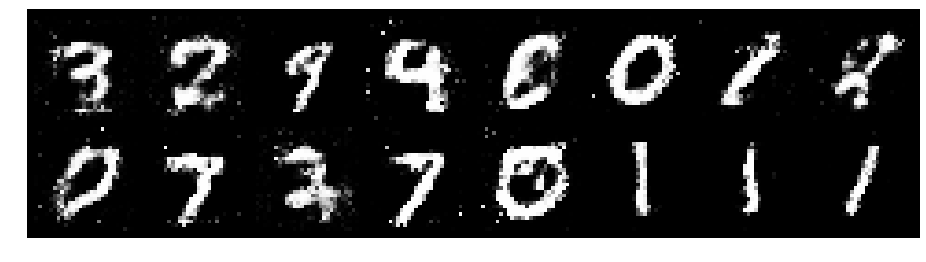

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 1.0391, Generator Loss: 1.2086
D(x): 0.6642, D(G(z)): 0.3771


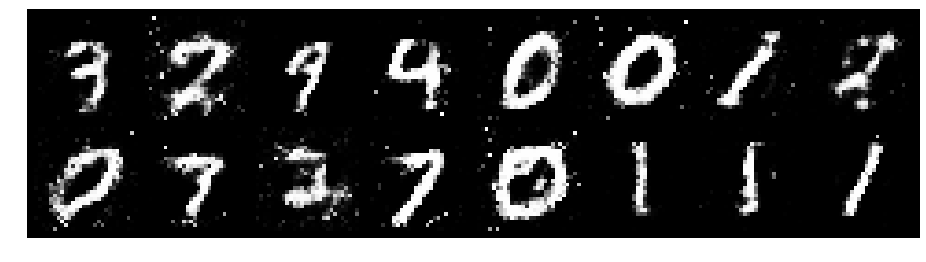

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 1.1264, Generator Loss: 1.0186
D(x): 0.6331, D(G(z)): 0.4117


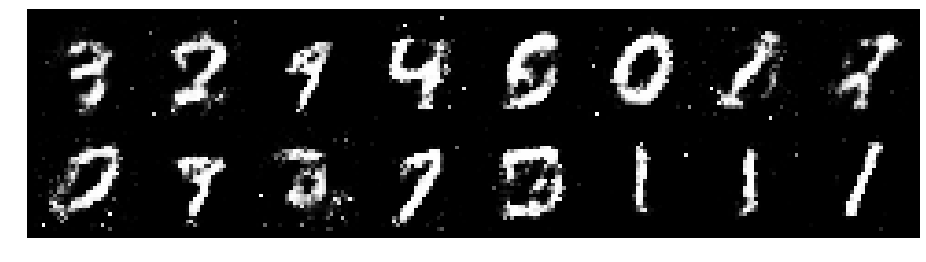

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.0954, Generator Loss: 1.0374
D(x): 0.6213, D(G(z)): 0.3803


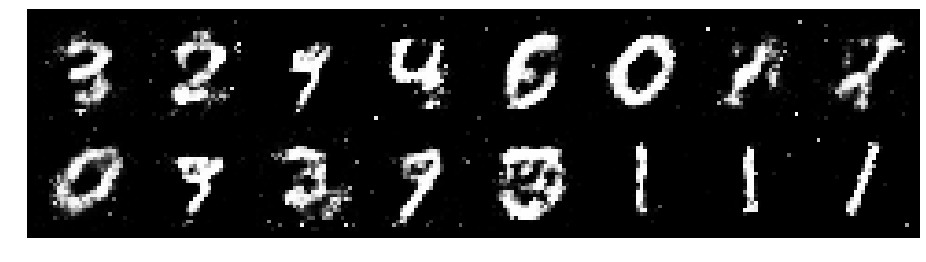

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.1851, Generator Loss: 1.1047
D(x): 0.5813, D(G(z)): 0.3443


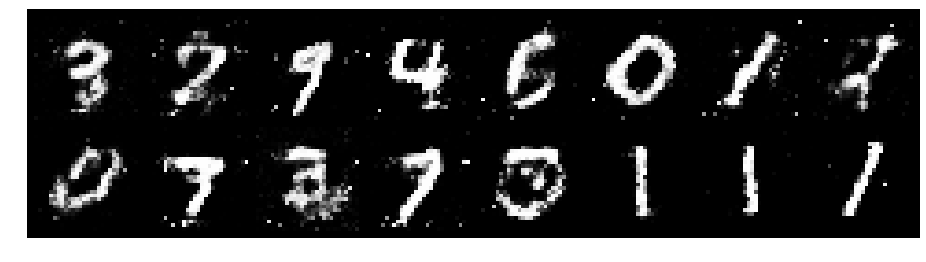

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 0.9579, Generator Loss: 1.6382
D(x): 0.5886, D(G(z)): 0.2345


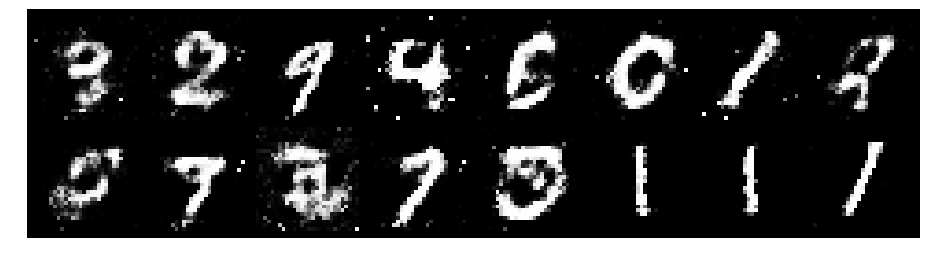

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 1.0251, Generator Loss: 1.2380
D(x): 0.6043, D(G(z)): 0.3134


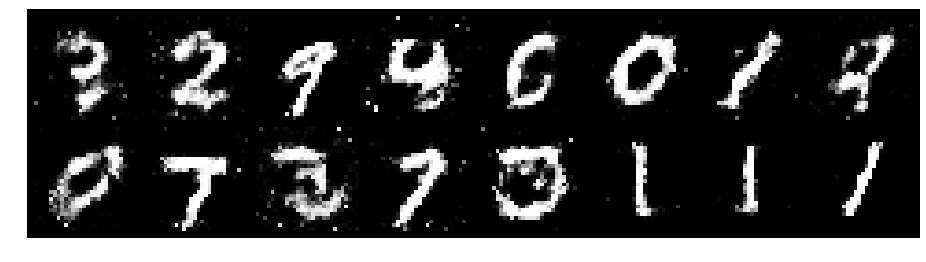

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.0092, Generator Loss: 1.4814
D(x): 0.6694, D(G(z)): 0.3126


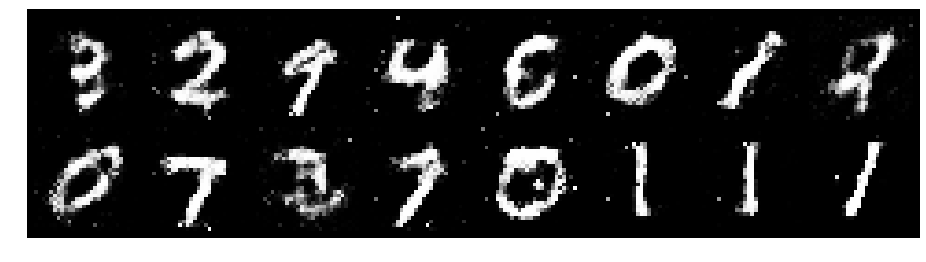

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 0.9165, Generator Loss: 1.4099
D(x): 0.6857, D(G(z)): 0.3133


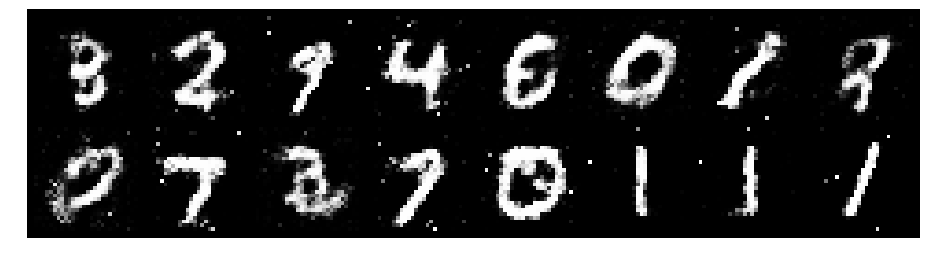

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.2005, Generator Loss: 1.1961
D(x): 0.6437, D(G(z)): 0.3933


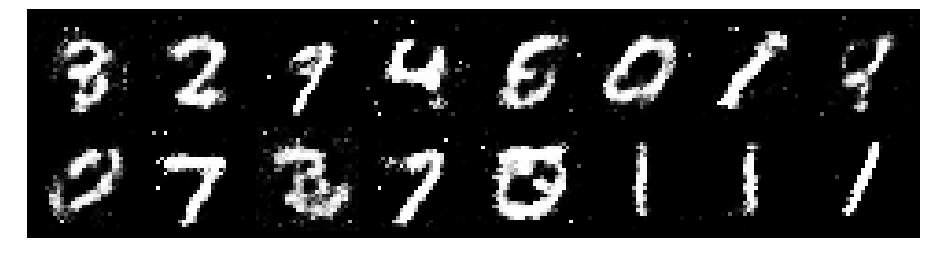

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.0796, Generator Loss: 1.1656
D(x): 0.6672, D(G(z)): 0.3985


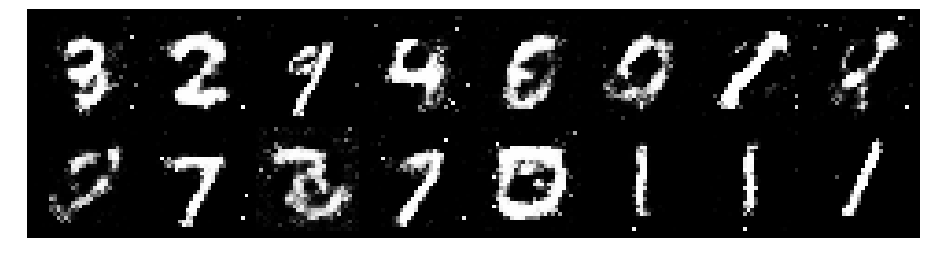

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.1213, Generator Loss: 1.0928
D(x): 0.6377, D(G(z)): 0.4059


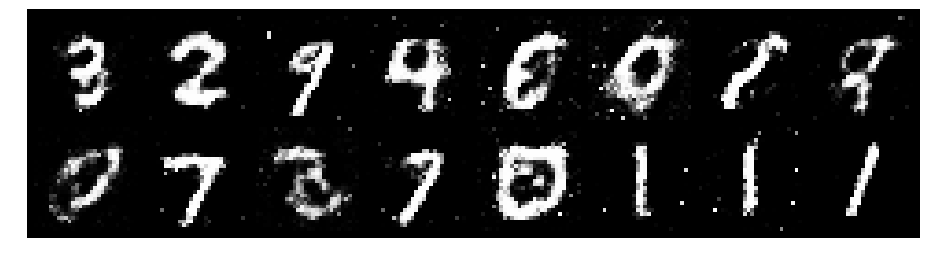

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.0082, Generator Loss: 1.2211
D(x): 0.6245, D(G(z)): 0.3390


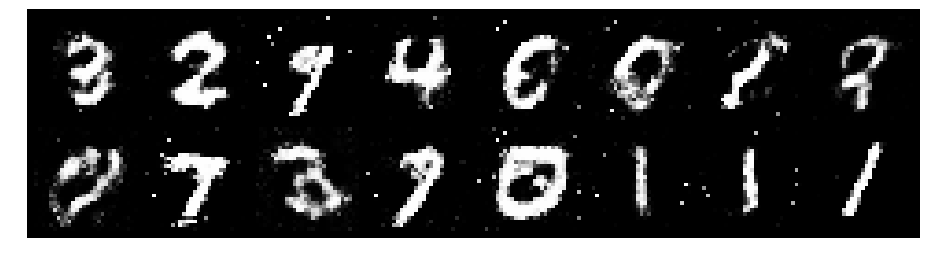

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 0.9990, Generator Loss: 1.3734
D(x): 0.7016, D(G(z)): 0.3860


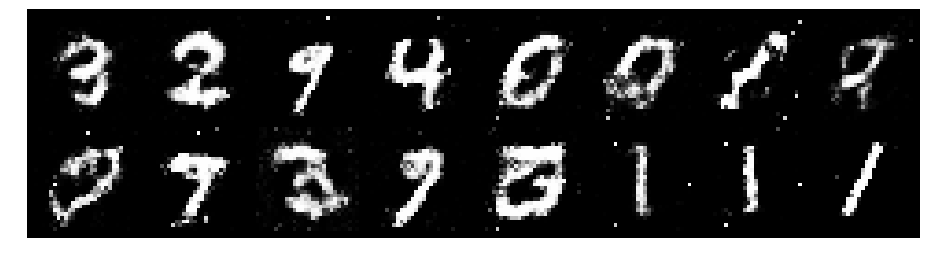

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 1.0161, Generator Loss: 1.1557
D(x): 0.6122, D(G(z)): 0.3093


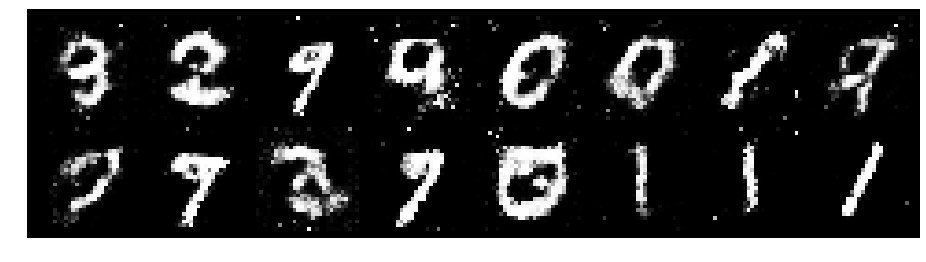

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.0283, Generator Loss: 1.1551
D(x): 0.6367, D(G(z)): 0.3789


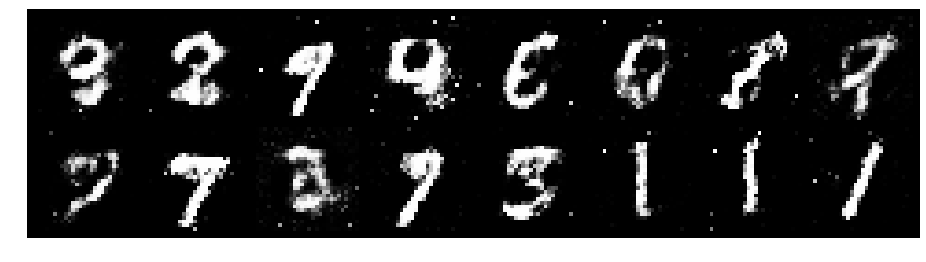

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.1608, Generator Loss: 0.9914
D(x): 0.5751, D(G(z)): 0.3541


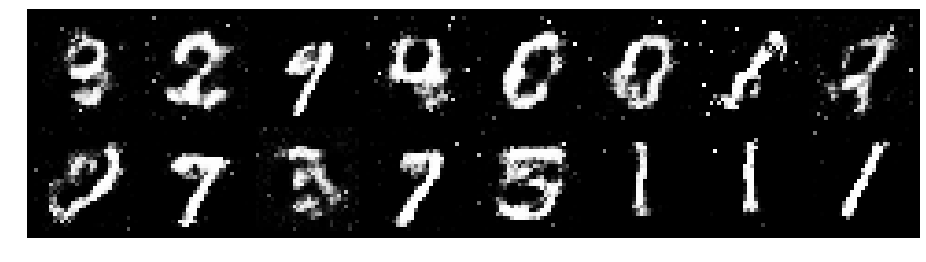

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.1971, Generator Loss: 1.0799
D(x): 0.6234, D(G(z)): 0.4390


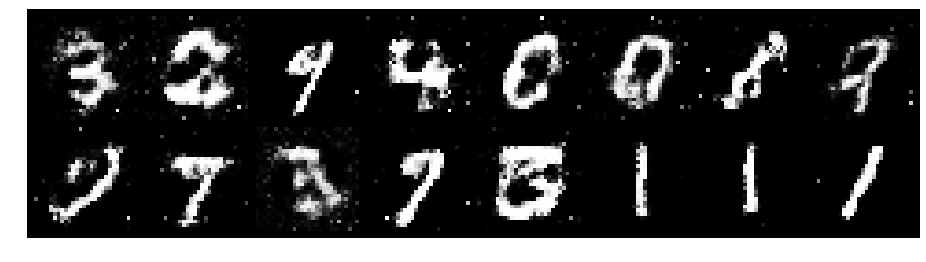

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 1.2061, Generator Loss: 1.0313
D(x): 0.6058, D(G(z)): 0.4319


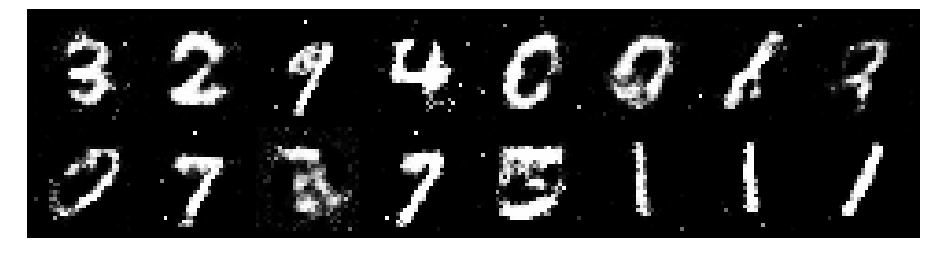

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.0390, Generator Loss: 1.4660
D(x): 0.6164, D(G(z)): 0.3319


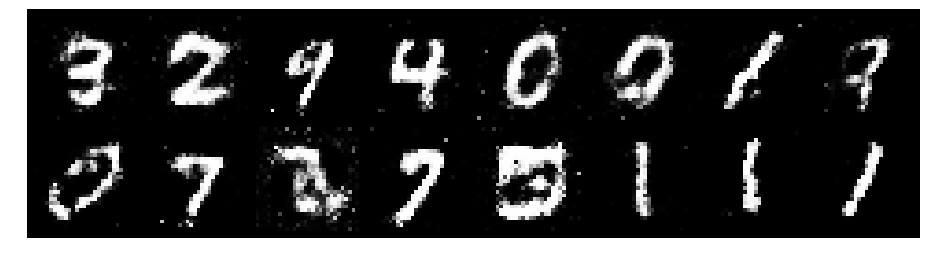

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.1120, Generator Loss: 1.1270
D(x): 0.6034, D(G(z)): 0.3849


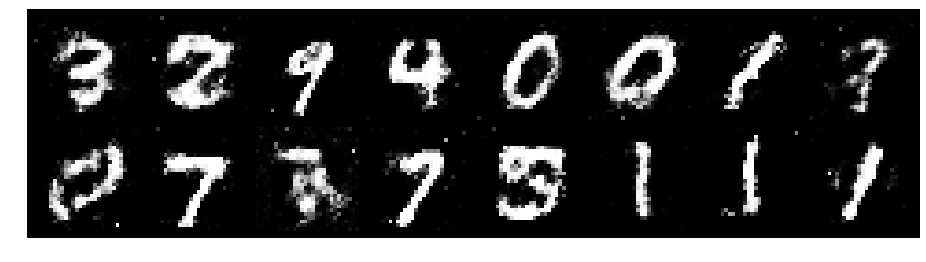

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.2235, Generator Loss: 1.2546
D(x): 0.6504, D(G(z)): 0.4367


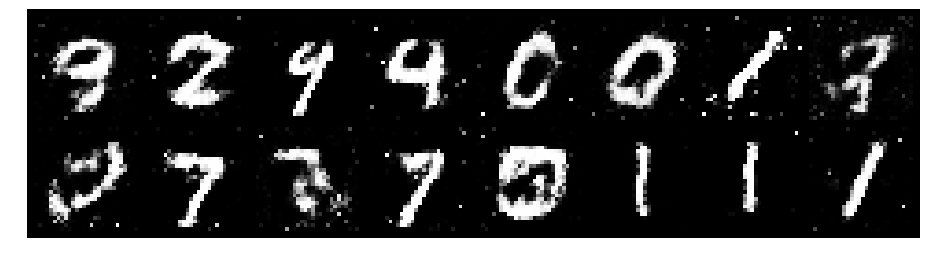

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.2103, Generator Loss: 1.3060
D(x): 0.5495, D(G(z)): 0.3517


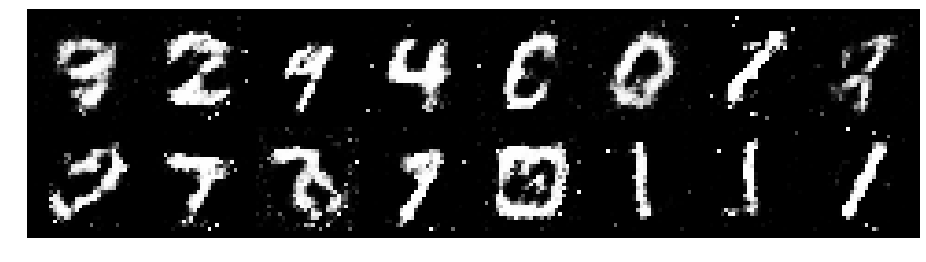

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.1770, Generator Loss: 1.0084
D(x): 0.6260, D(G(z)): 0.4292


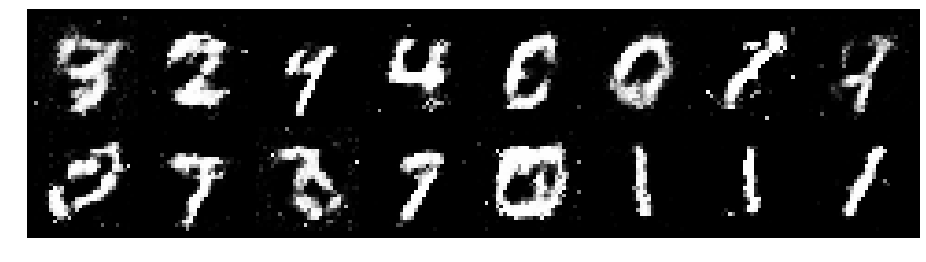

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.1275, Generator Loss: 1.0353
D(x): 0.5856, D(G(z)): 0.3700


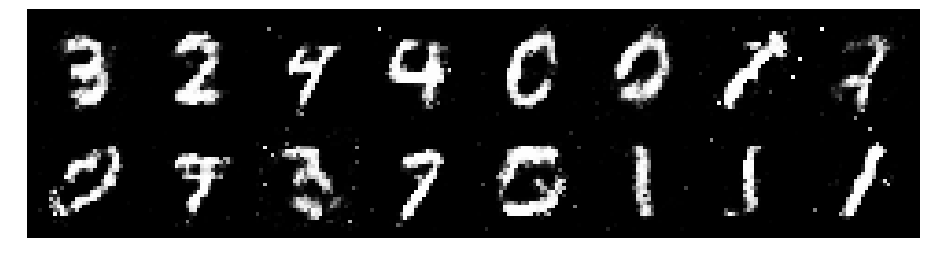

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.1454, Generator Loss: 1.1275
D(x): 0.6175, D(G(z)): 0.3737


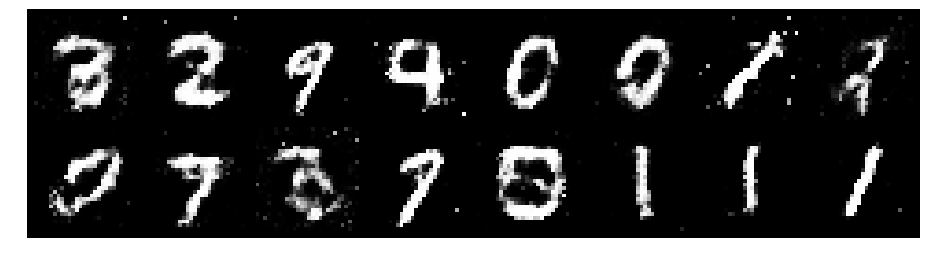

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 1.1264, Generator Loss: 1.1983
D(x): 0.6256, D(G(z)): 0.4114


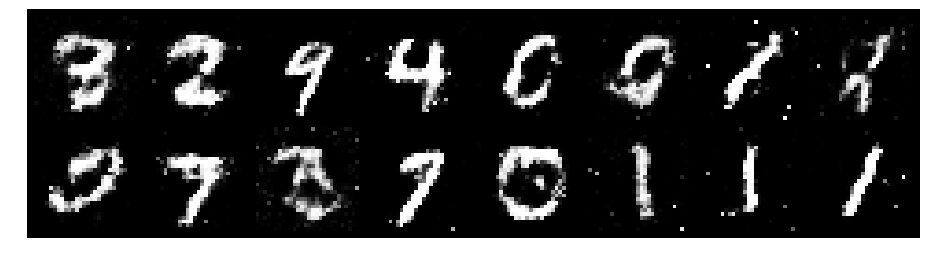

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 1.0725, Generator Loss: 1.1957
D(x): 0.5987, D(G(z)): 0.3484


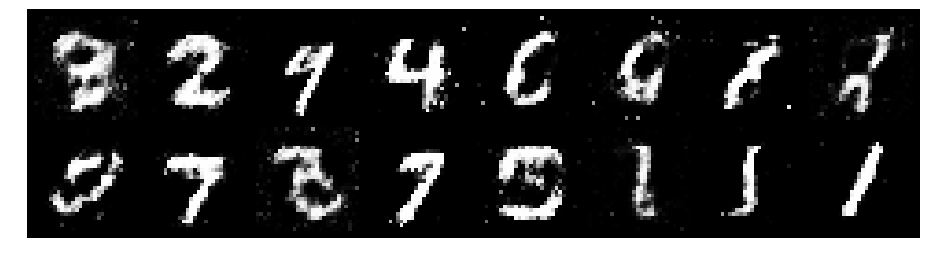

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.3689, Generator Loss: 0.8322
D(x): 0.6006, D(G(z)): 0.4620


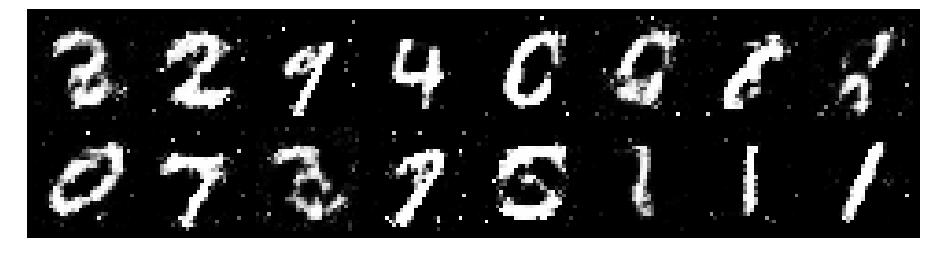

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.1875, Generator Loss: 0.8937
D(x): 0.5662, D(G(z)): 0.3849


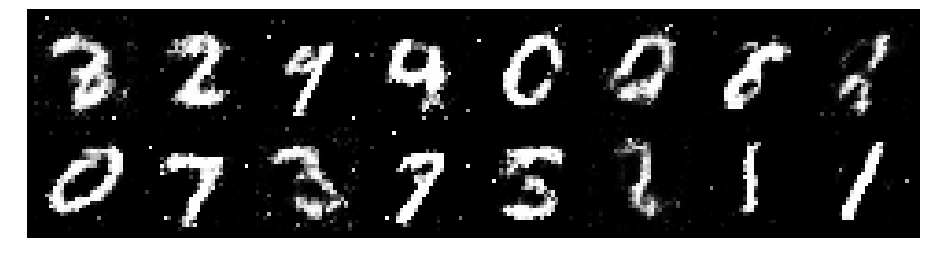

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.2881, Generator Loss: 0.8825
D(x): 0.6038, D(G(z)): 0.4752


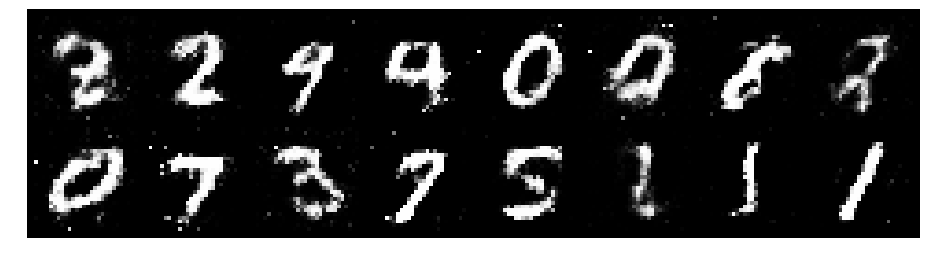

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.1457, Generator Loss: 0.9902
D(x): 0.6199, D(G(z)): 0.4142


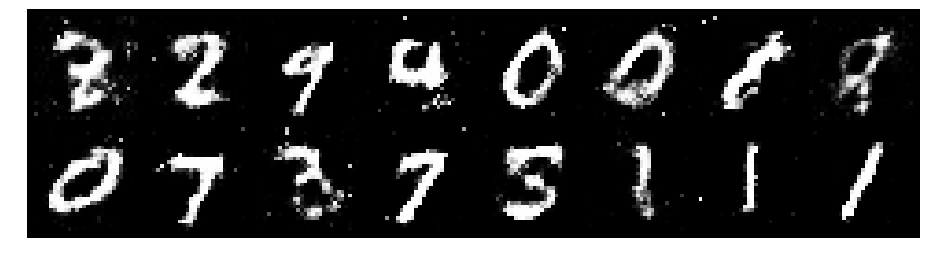

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.2159, Generator Loss: 1.0764
D(x): 0.5835, D(G(z)): 0.4166


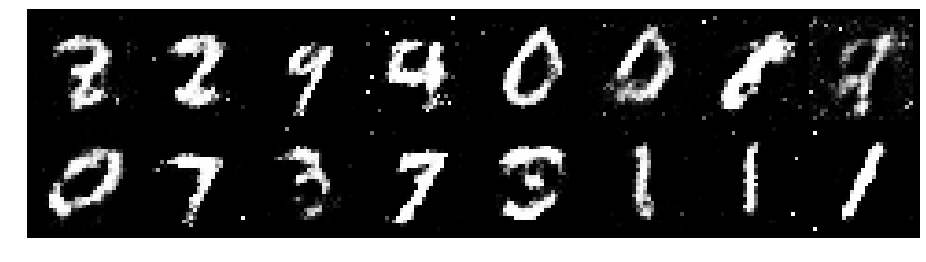

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 1.3558, Generator Loss: 0.9315
D(x): 0.5253, D(G(z)): 0.4458


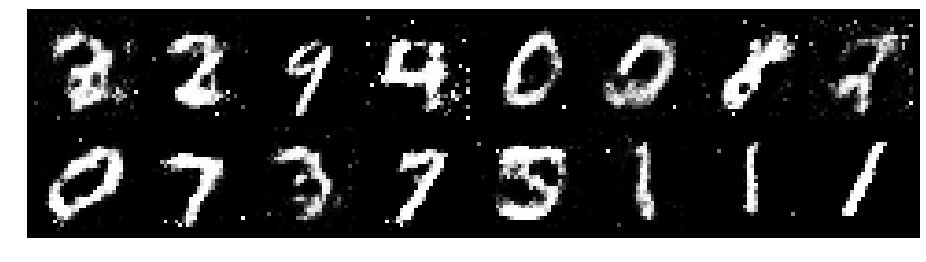

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.1811, Generator Loss: 1.0835
D(x): 0.6427, D(G(z)): 0.4460


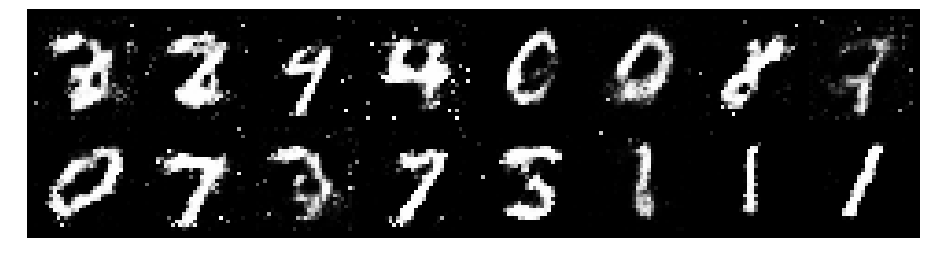

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.1432, Generator Loss: 1.2258
D(x): 0.6143, D(G(z)): 0.4134


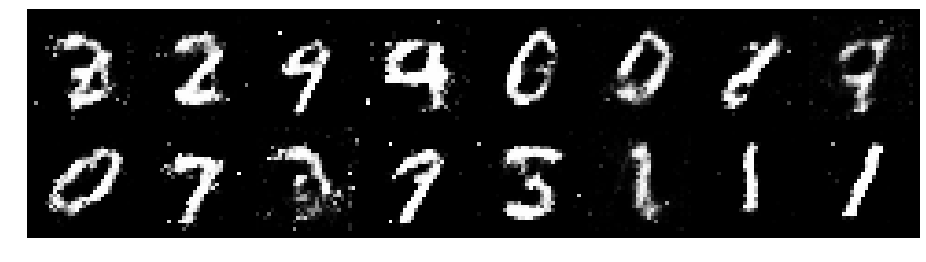

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.0941, Generator Loss: 1.2162
D(x): 0.6451, D(G(z)): 0.4021


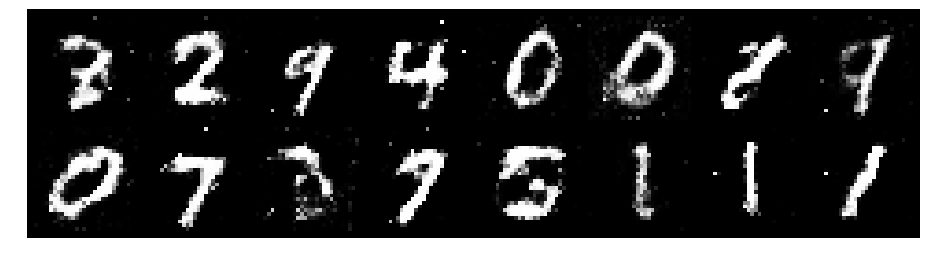

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.0133, Generator Loss: 1.0963
D(x): 0.6014, D(G(z)): 0.3440


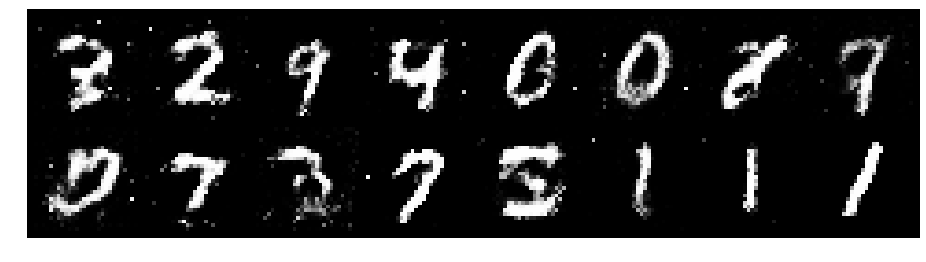

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.0988, Generator Loss: 1.0074
D(x): 0.6258, D(G(z)): 0.4032


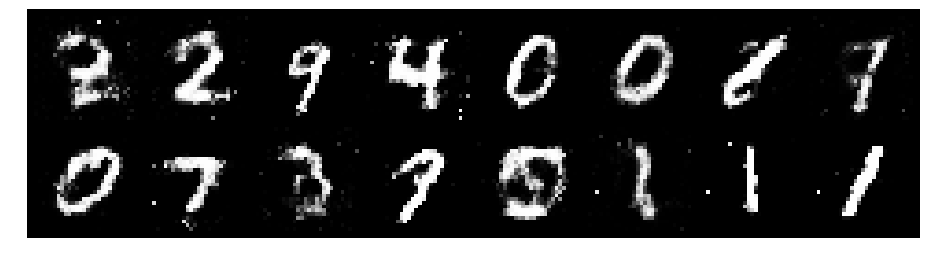

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.1259, Generator Loss: 1.0289
D(x): 0.5949, D(G(z)): 0.3841


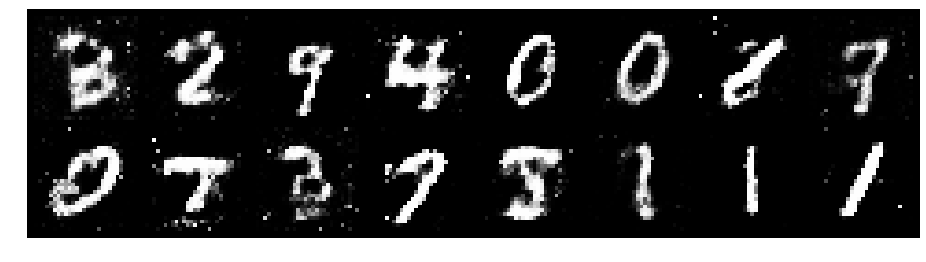

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.0524, Generator Loss: 0.9857
D(x): 0.6341, D(G(z)): 0.3903


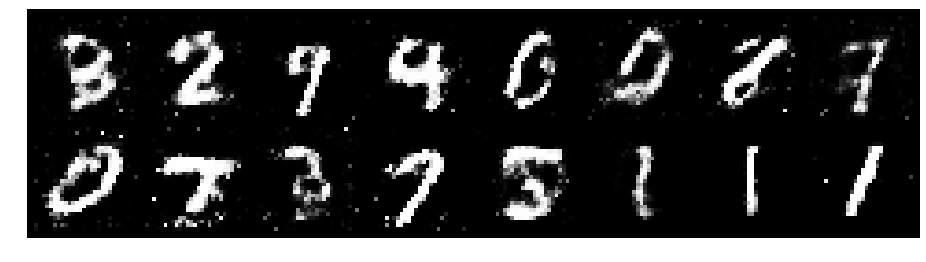

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.1363, Generator Loss: 1.2048
D(x): 0.5823, D(G(z)): 0.3617


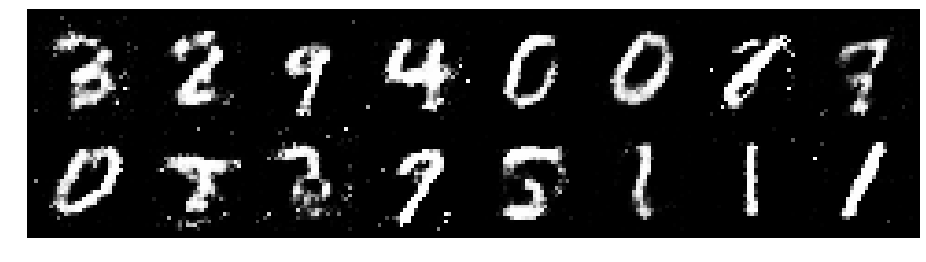

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.3358, Generator Loss: 1.3310
D(x): 0.6310, D(G(z)): 0.4457


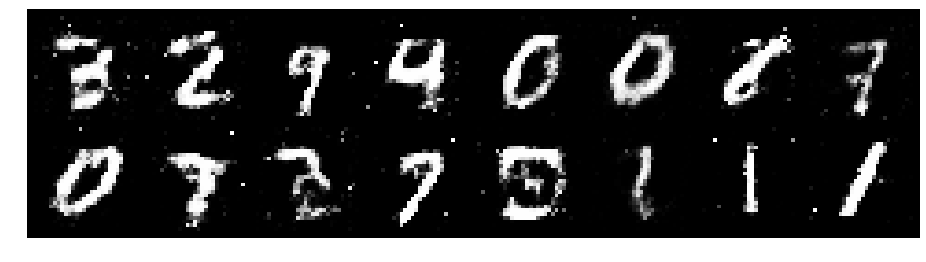

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.2159, Generator Loss: 1.0183
D(x): 0.6090, D(G(z)): 0.4204


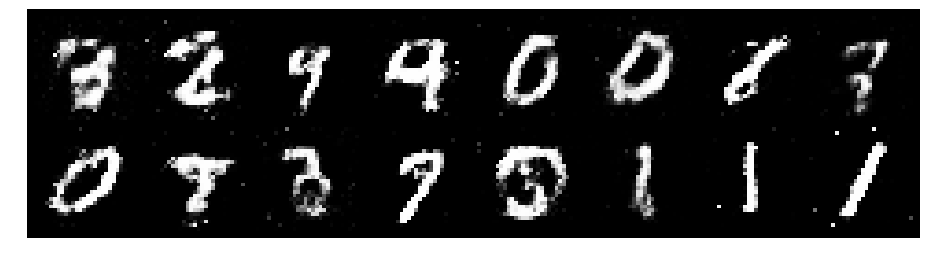

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.1613, Generator Loss: 1.0427
D(x): 0.6511, D(G(z)): 0.4467


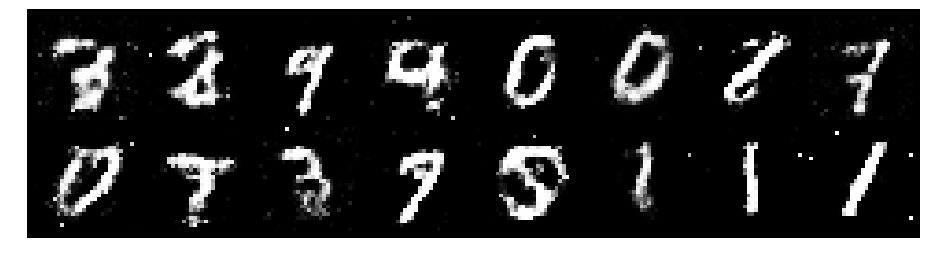

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.0945, Generator Loss: 1.2112
D(x): 0.5925, D(G(z)): 0.3619


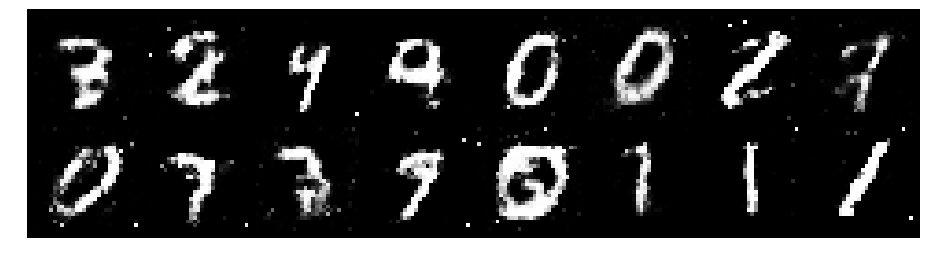

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 0.9966, Generator Loss: 1.1973
D(x): 0.6089, D(G(z)): 0.3167


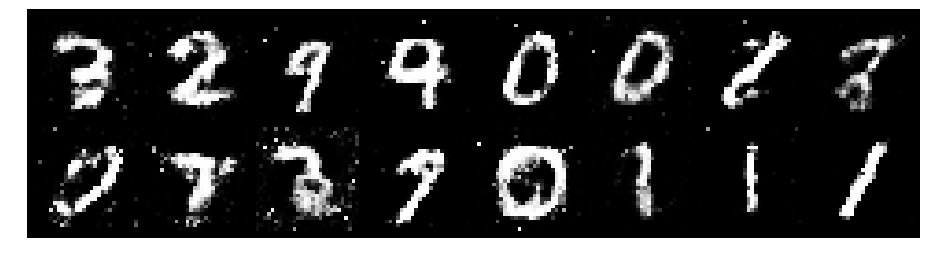

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.0855, Generator Loss: 0.9060
D(x): 0.6239, D(G(z)): 0.4227


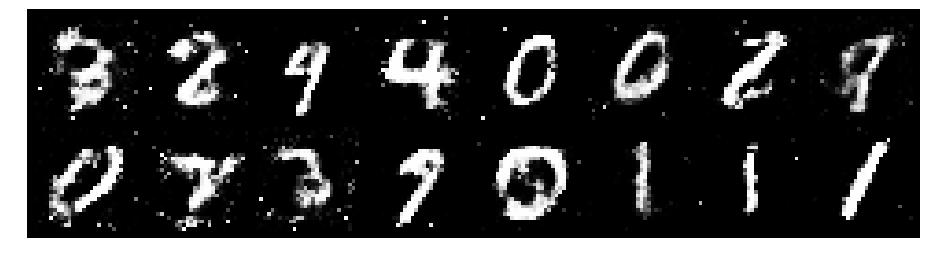

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.2536, Generator Loss: 1.0366
D(x): 0.5044, D(G(z)): 0.3492


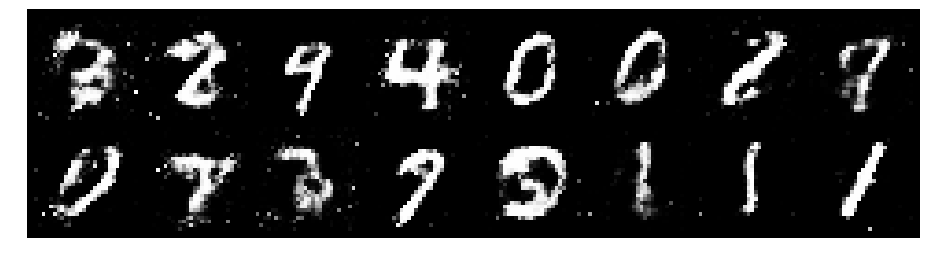

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.2578, Generator Loss: 1.1481
D(x): 0.5636, D(G(z)): 0.4050


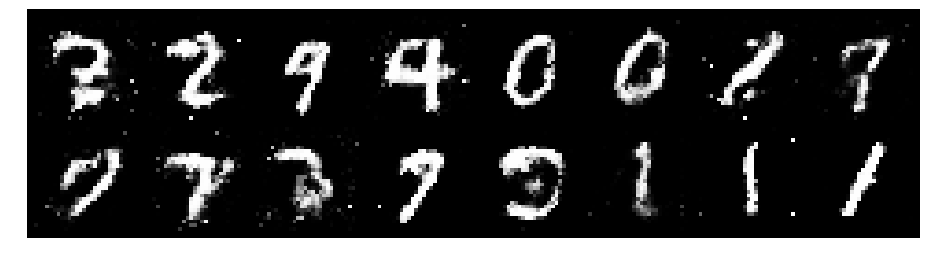

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.3265, Generator Loss: 0.9643
D(x): 0.5448, D(G(z)): 0.4159


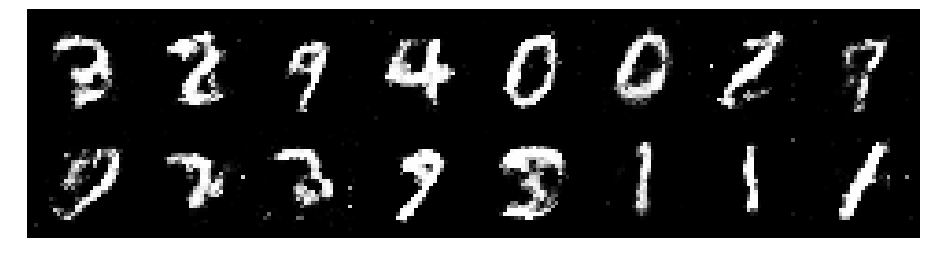

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.1381, Generator Loss: 0.9180
D(x): 0.6280, D(G(z)): 0.4356


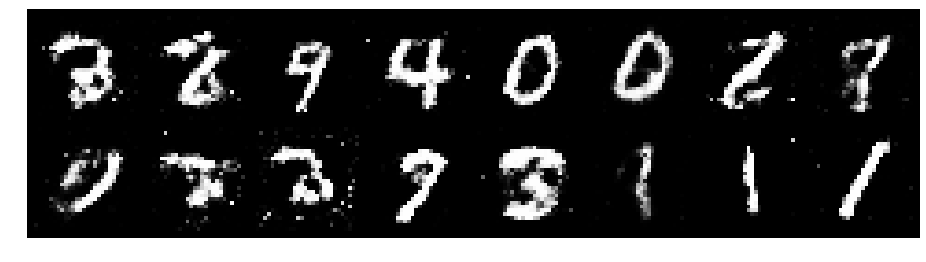

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.1761, Generator Loss: 0.8725
D(x): 0.5632, D(G(z)): 0.4113


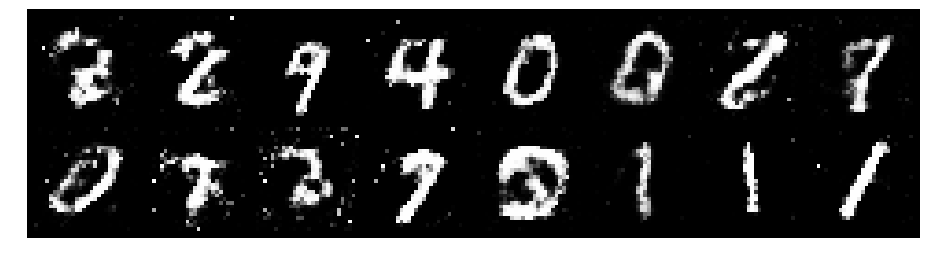

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.3248, Generator Loss: 0.9136
D(x): 0.5422, D(G(z)): 0.4589


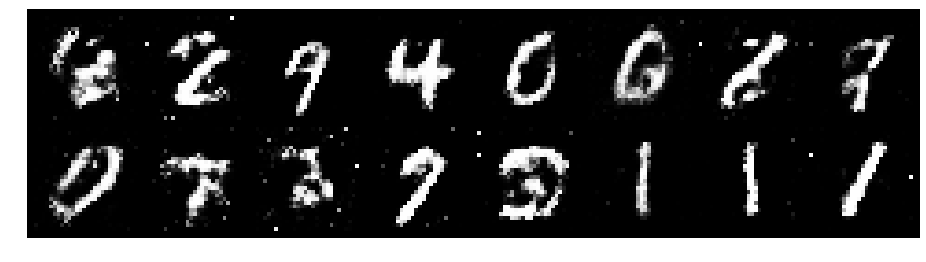

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.3180, Generator Loss: 1.0406
D(x): 0.5946, D(G(z)): 0.4629


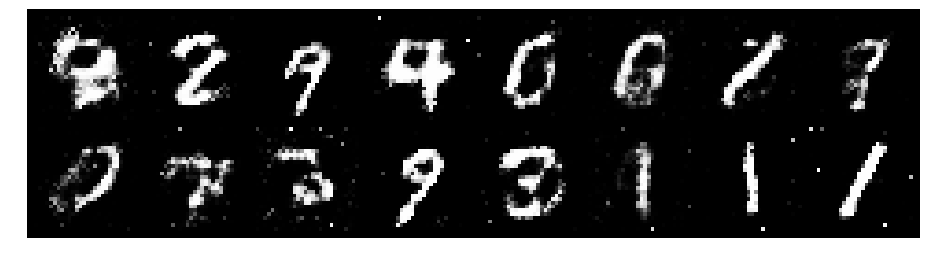

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.1943, Generator Loss: 0.8836
D(x): 0.5693, D(G(z)): 0.3950


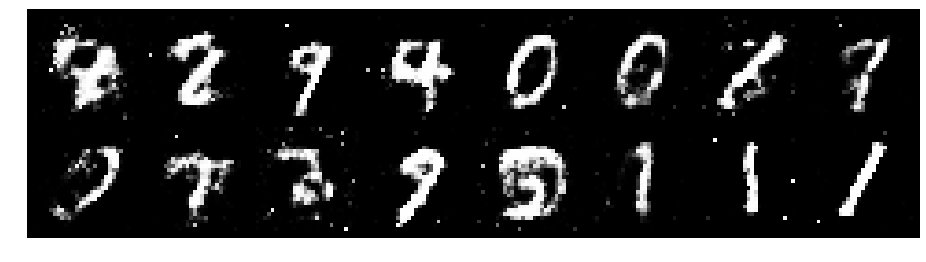

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.1702, Generator Loss: 1.0161
D(x): 0.6100, D(G(z)): 0.3973


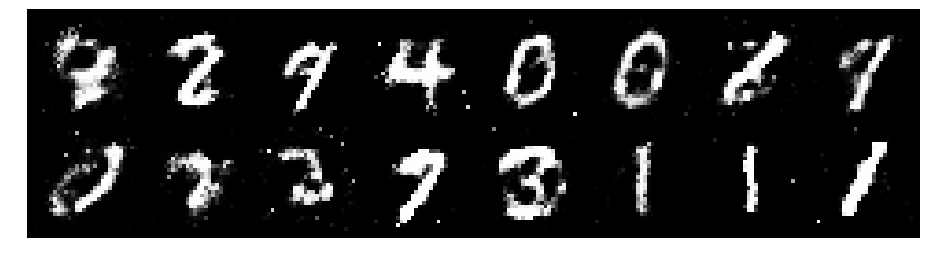

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.2714, Generator Loss: 0.9857
D(x): 0.5659, D(G(z)): 0.4356


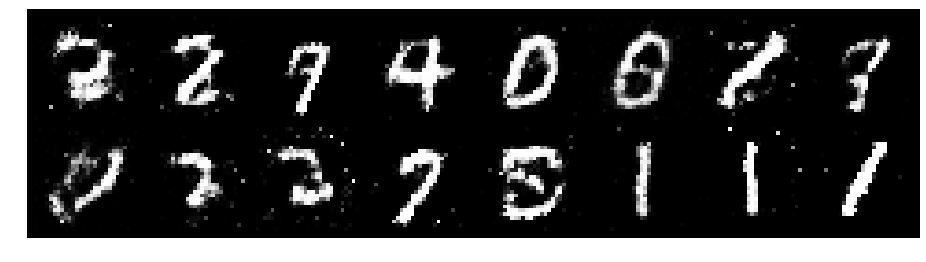

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.1224, Generator Loss: 1.2730
D(x): 0.6102, D(G(z)): 0.3716


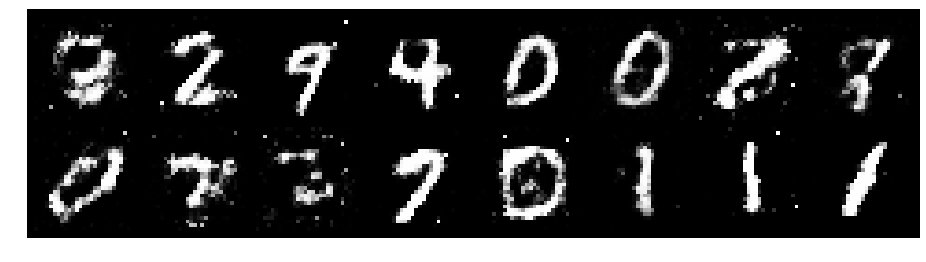

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.0784, Generator Loss: 1.2093
D(x): 0.5890, D(G(z)): 0.3584


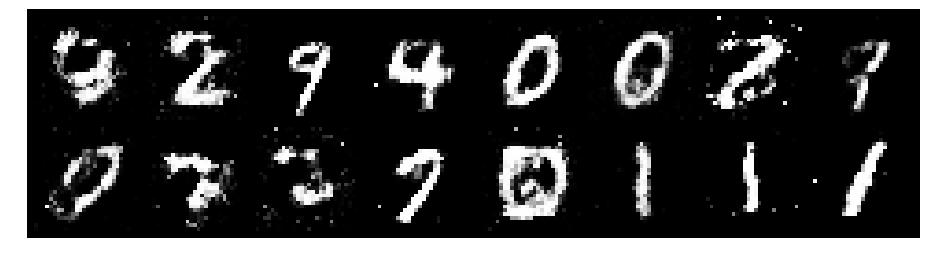

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.0977, Generator Loss: 1.0595
D(x): 0.5581, D(G(z)): 0.3165


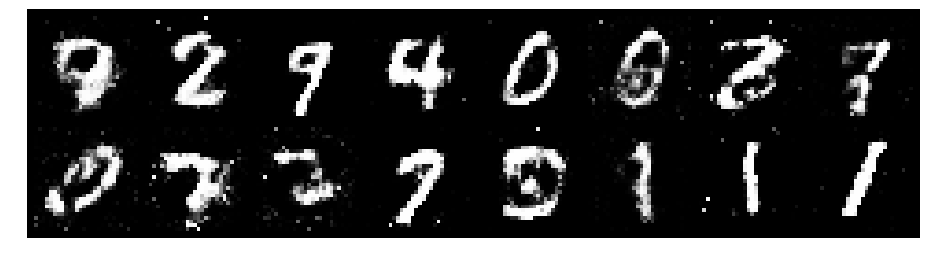

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.0985, Generator Loss: 1.4634
D(x): 0.6602, D(G(z)): 0.3628


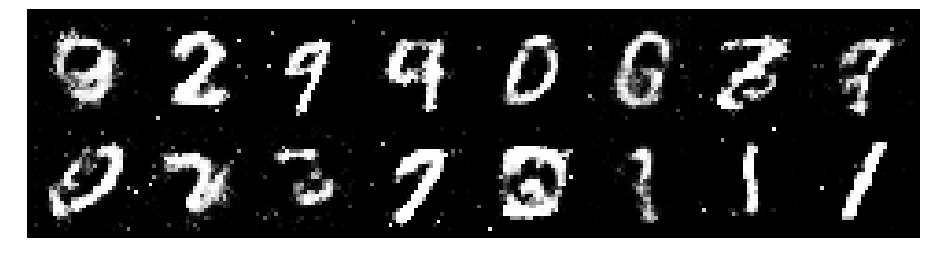

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.1131, Generator Loss: 1.2889
D(x): 0.6358, D(G(z)): 0.3548


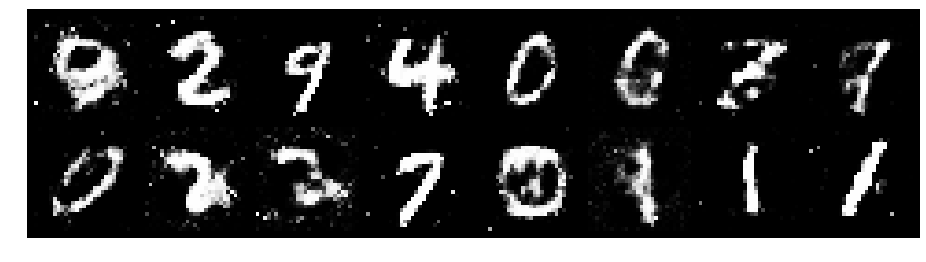

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 0.9742, Generator Loss: 1.0970
D(x): 0.6762, D(G(z)): 0.3614


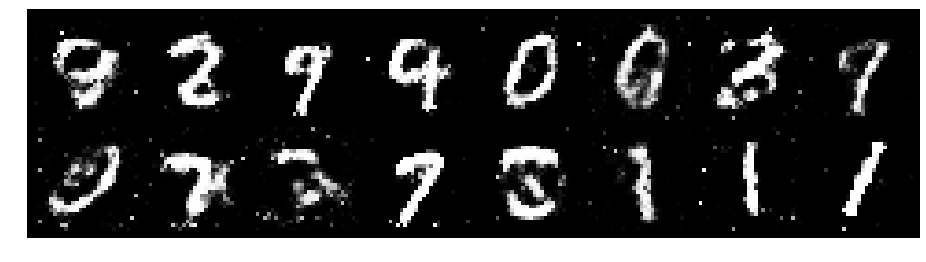

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 0.9150, Generator Loss: 1.3703
D(x): 0.6853, D(G(z)): 0.3287


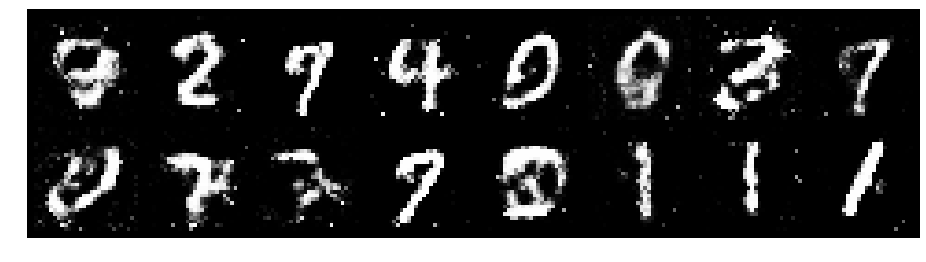

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.0892, Generator Loss: 1.0471
D(x): 0.6343, D(G(z)): 0.4020


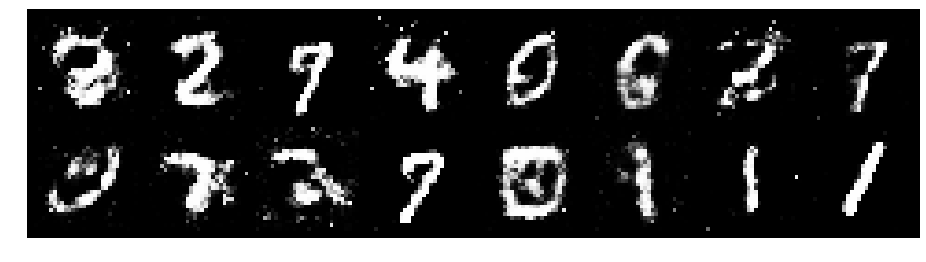

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 0.9741, Generator Loss: 1.2150
D(x): 0.6321, D(G(z)): 0.3186


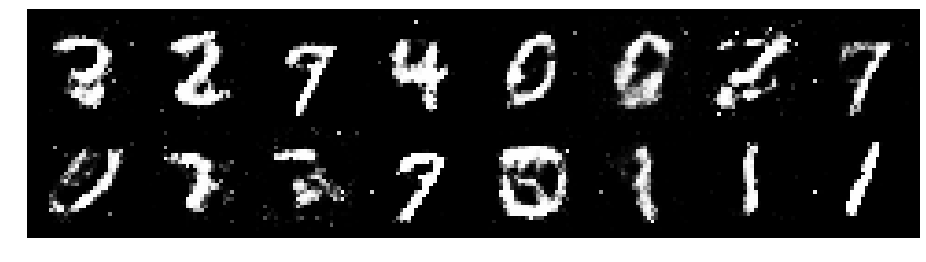

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.1388, Generator Loss: 1.0800
D(x): 0.6338, D(G(z)): 0.4204


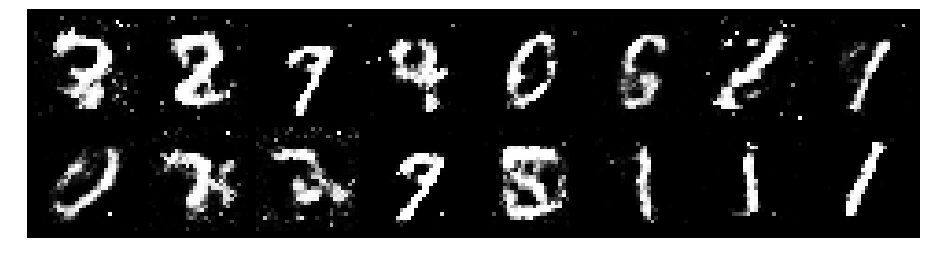

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.0451, Generator Loss: 1.3686
D(x): 0.6444, D(G(z)): 0.3851


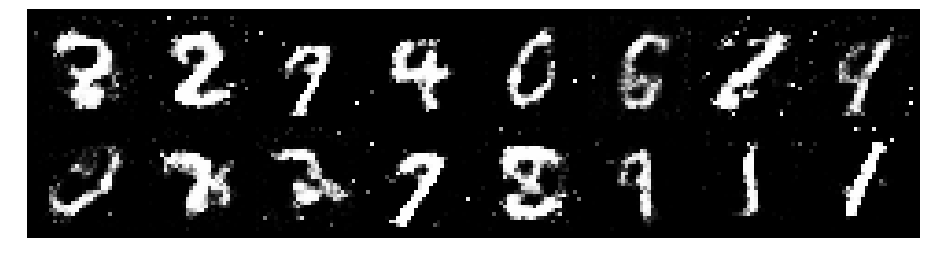

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.1486, Generator Loss: 1.0314
D(x): 0.6006, D(G(z)): 0.3890


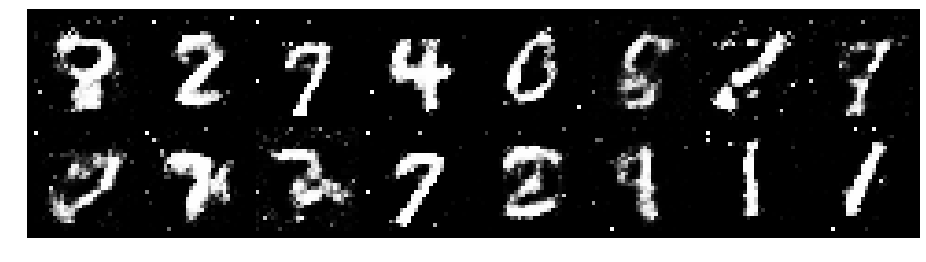

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.1134, Generator Loss: 1.0568
D(x): 0.6071, D(G(z)): 0.3913


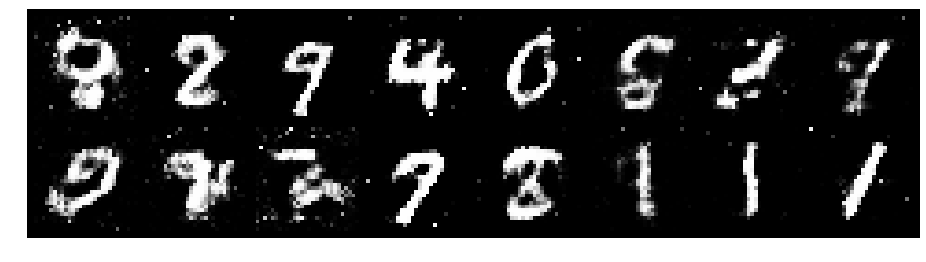

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.0745, Generator Loss: 1.1039
D(x): 0.6141, D(G(z)): 0.3544


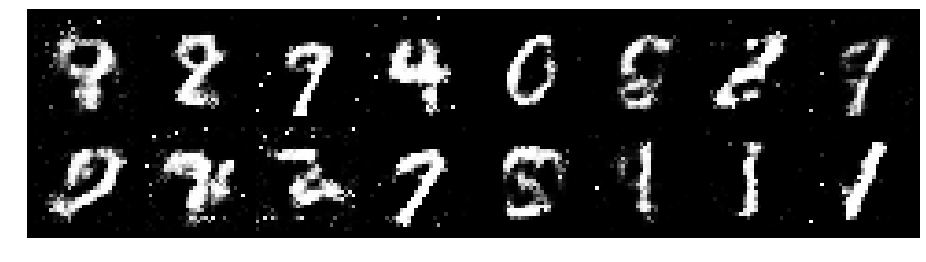

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.0941, Generator Loss: 1.1806
D(x): 0.5579, D(G(z)): 0.3525


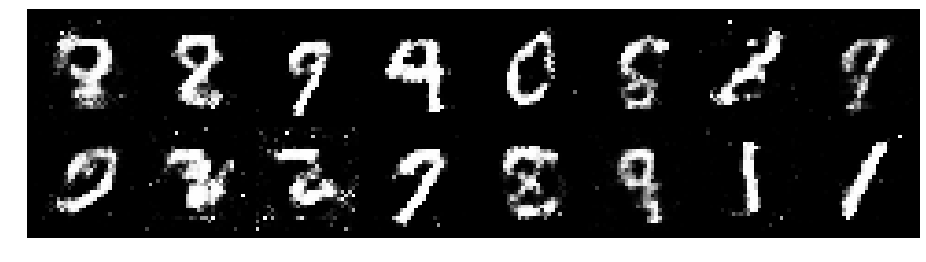

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.1484, Generator Loss: 0.8602
D(x): 0.5879, D(G(z)): 0.4174


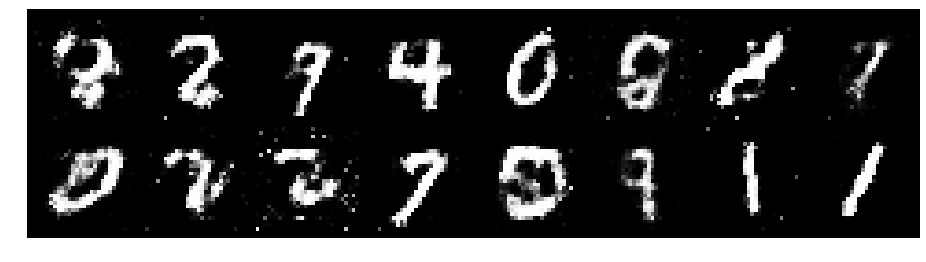

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.1201, Generator Loss: 1.1834
D(x): 0.5818, D(G(z)): 0.3653


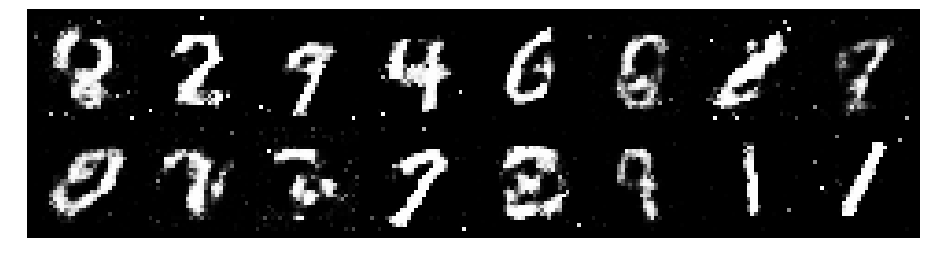

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.1719, Generator Loss: 1.1644
D(x): 0.6069, D(G(z)): 0.4088


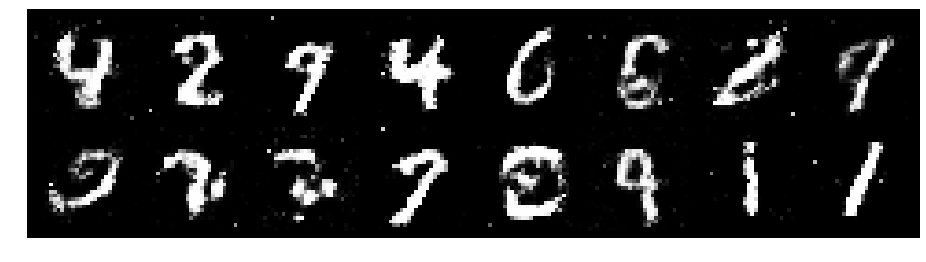

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.3502, Generator Loss: 0.8598
D(x): 0.6084, D(G(z)): 0.4890


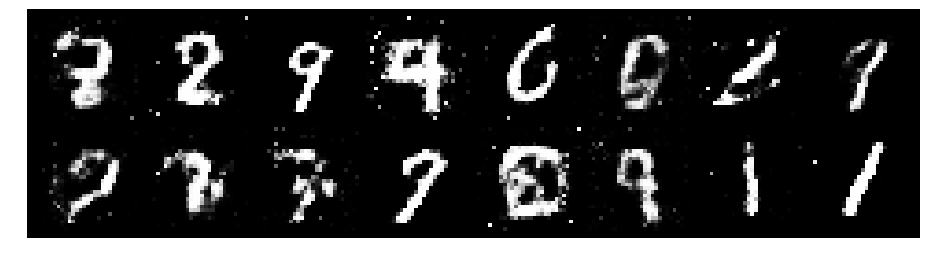

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.3372, Generator Loss: 1.0898
D(x): 0.5880, D(G(z)): 0.4601


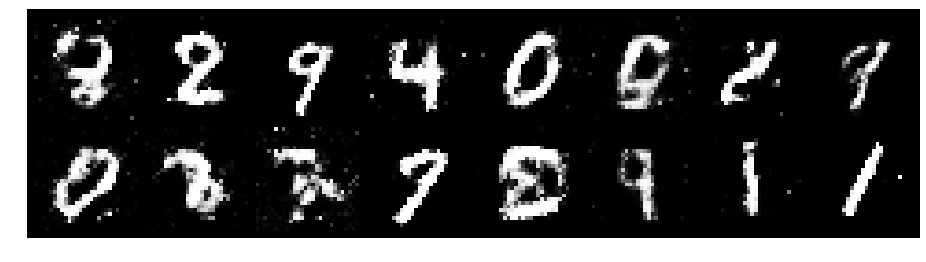

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 0.9877, Generator Loss: 1.1592
D(x): 0.6671, D(G(z)): 0.3547


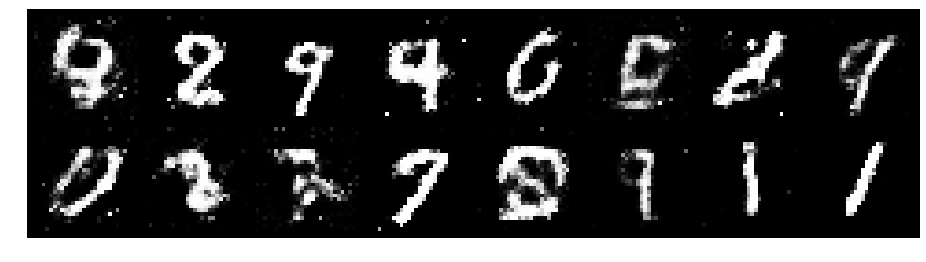

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.0398, Generator Loss: 1.1827
D(x): 0.6422, D(G(z)): 0.3855


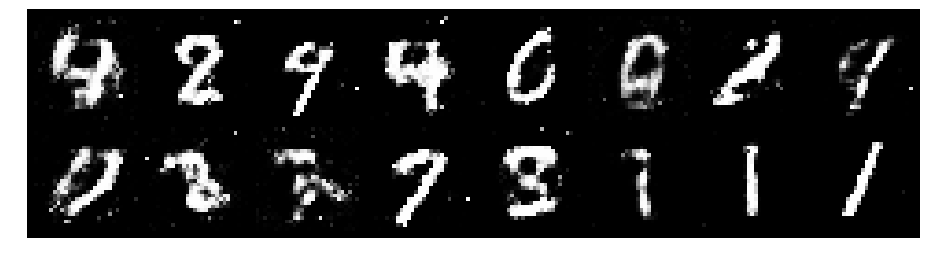

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.0699, Generator Loss: 1.0595
D(x): 0.6317, D(G(z)): 0.3851


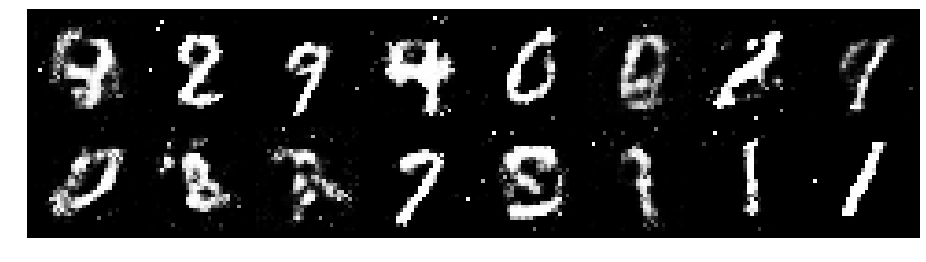

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.1993, Generator Loss: 1.1460
D(x): 0.5993, D(G(z)): 0.3934


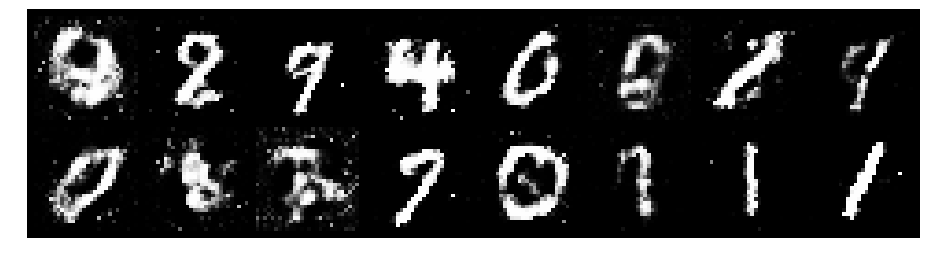

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.1516, Generator Loss: 1.1266
D(x): 0.6012, D(G(z)): 0.3900


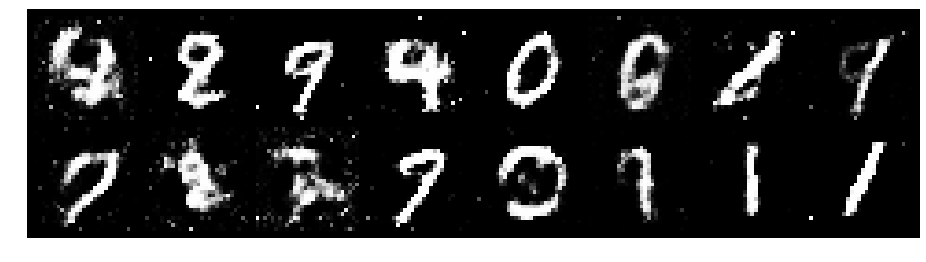

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.0004, Generator Loss: 1.3899
D(x): 0.6163, D(G(z)): 0.2928


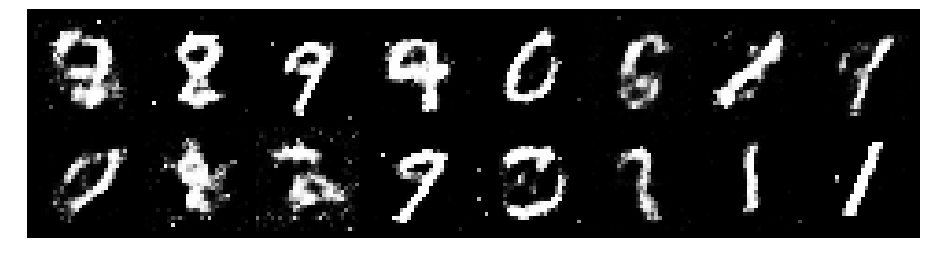

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.0531, Generator Loss: 1.5199
D(x): 0.6169, D(G(z)): 0.3336


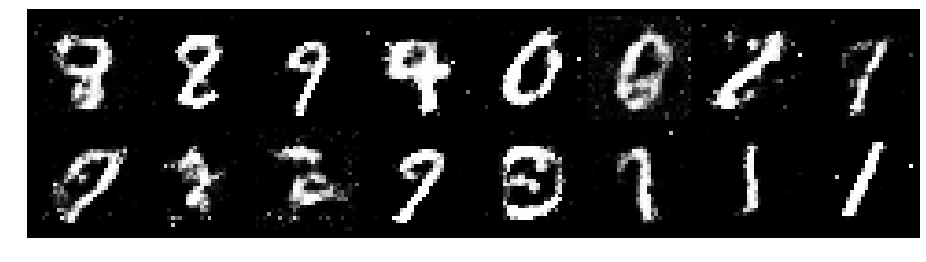

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 0.9660, Generator Loss: 1.3382
D(x): 0.6368, D(G(z)): 0.3070


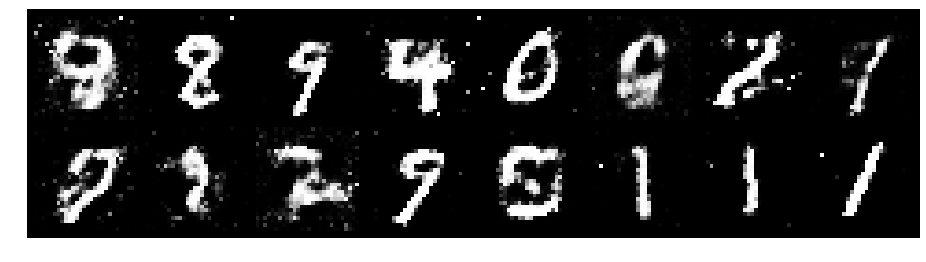

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.0539, Generator Loss: 1.2033
D(x): 0.6259, D(G(z)): 0.3496


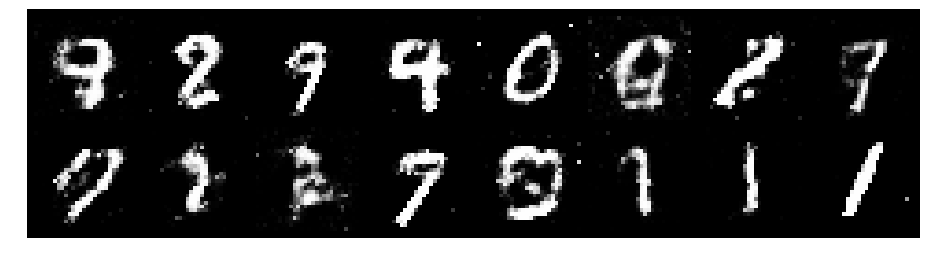

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.1601, Generator Loss: 1.0349
D(x): 0.6140, D(G(z)): 0.4214


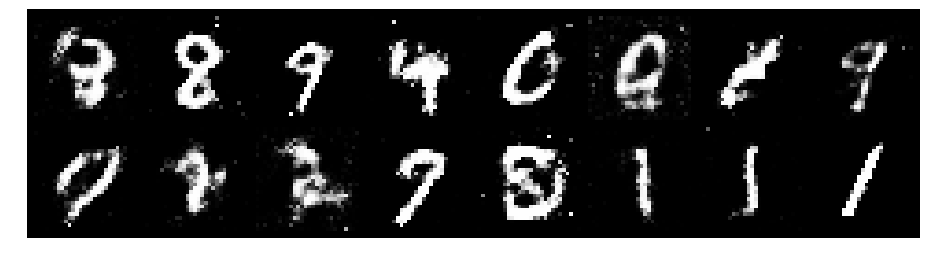

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.2996, Generator Loss: 0.8058
D(x): 0.5919, D(G(z)): 0.4749


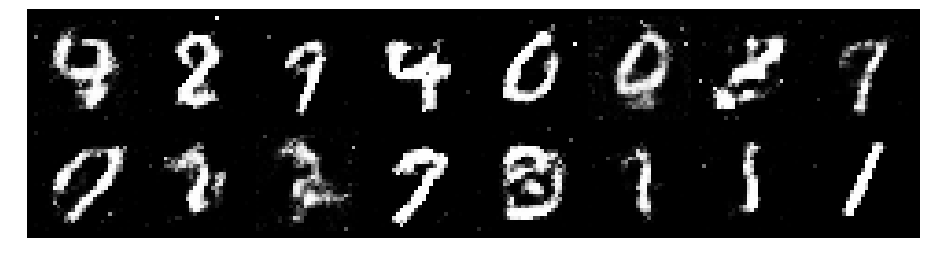

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.3887, Generator Loss: 1.0660
D(x): 0.5476, D(G(z)): 0.4418


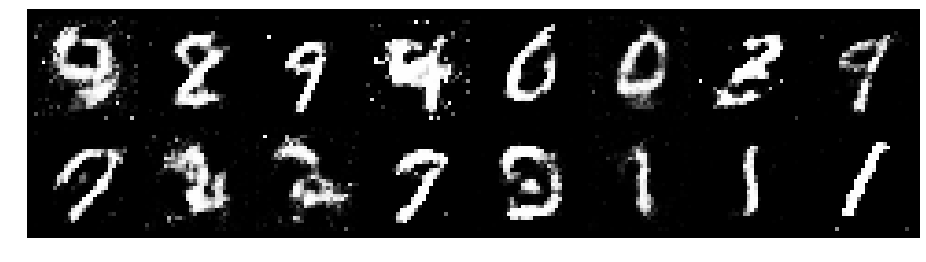

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.1257, Generator Loss: 0.9293
D(x): 0.6242, D(G(z)): 0.4202


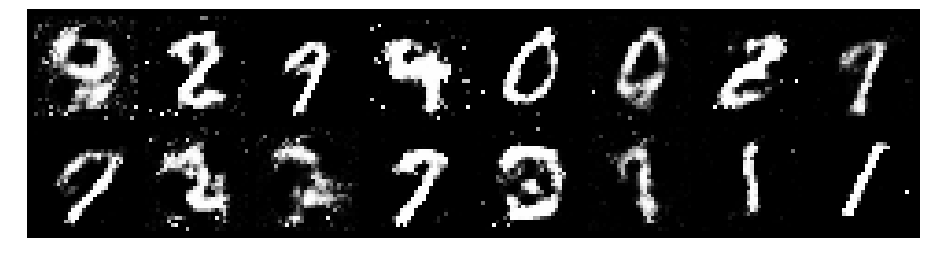

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.2279, Generator Loss: 0.8872
D(x): 0.5988, D(G(z)): 0.4255


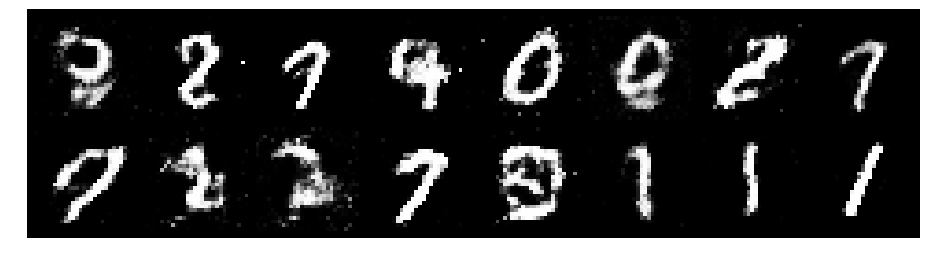

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.2702, Generator Loss: 1.1320
D(x): 0.6286, D(G(z)): 0.4668


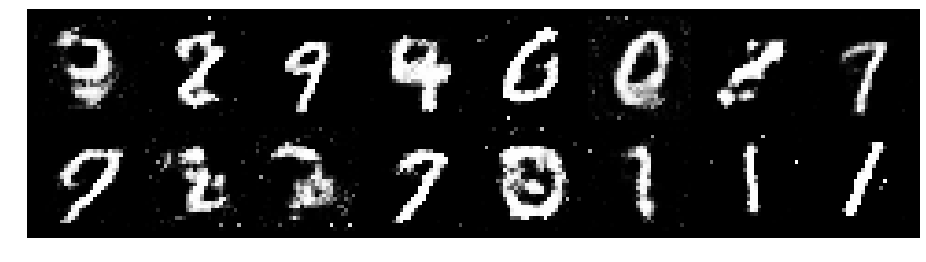

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.1336, Generator Loss: 1.0158
D(x): 0.6494, D(G(z)): 0.4308


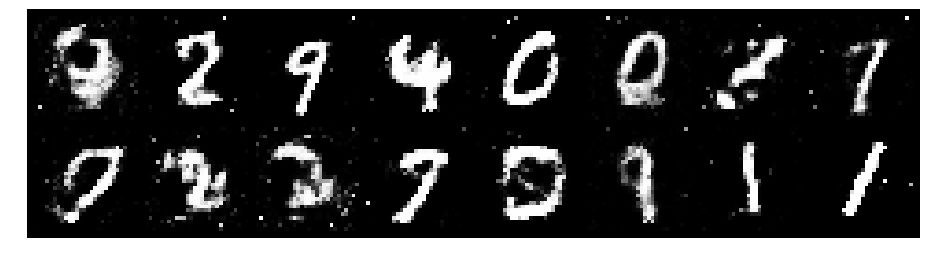

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.1410, Generator Loss: 1.1621
D(x): 0.5986, D(G(z)): 0.3883


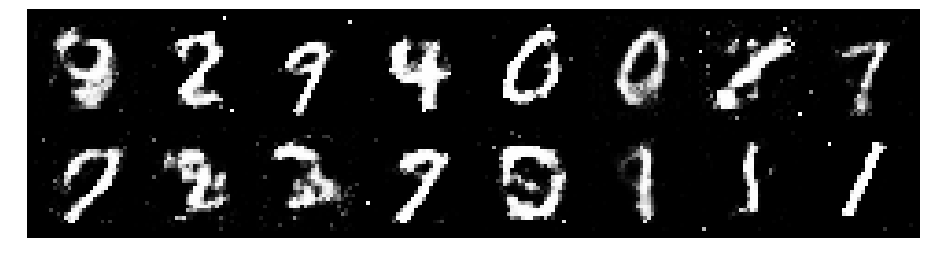

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.1180, Generator Loss: 0.9752
D(x): 0.6125, D(G(z)): 0.4120


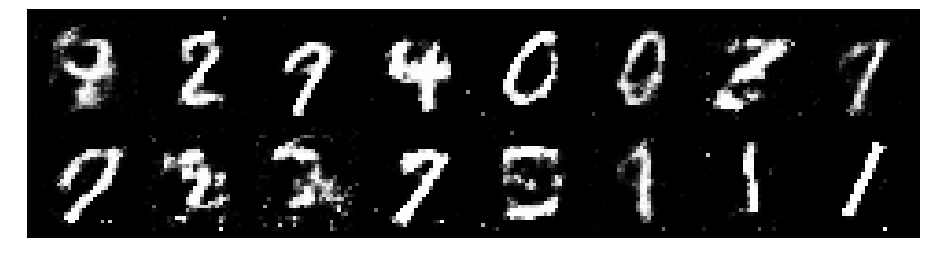

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 0.9803, Generator Loss: 1.3338
D(x): 0.6908, D(G(z)): 0.3508


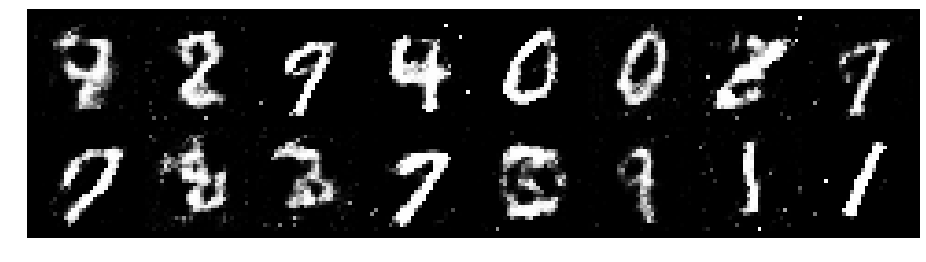

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.1687, Generator Loss: 1.0431
D(x): 0.6057, D(G(z)): 0.3590


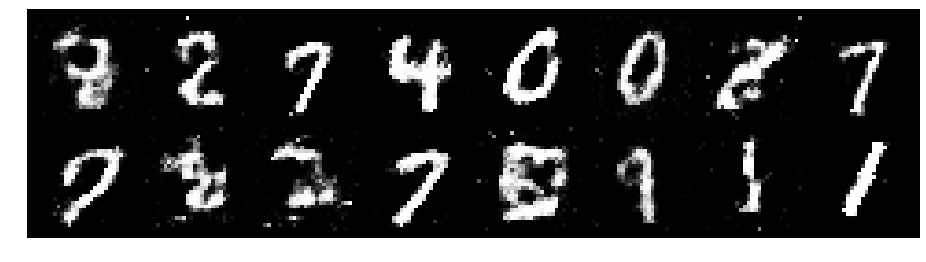

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.1681, Generator Loss: 1.1392
D(x): 0.5668, D(G(z)): 0.3435


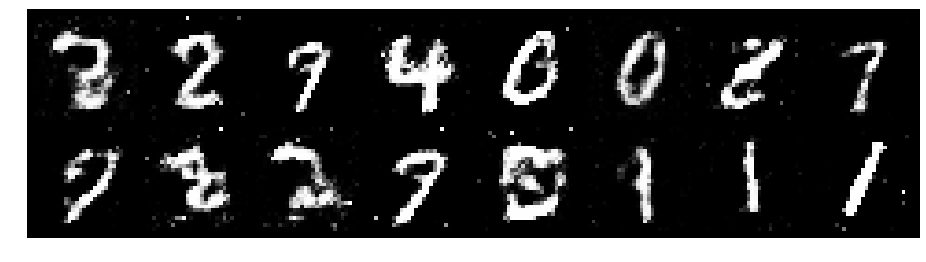

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.1287, Generator Loss: 1.1001
D(x): 0.6333, D(G(z)): 0.4080


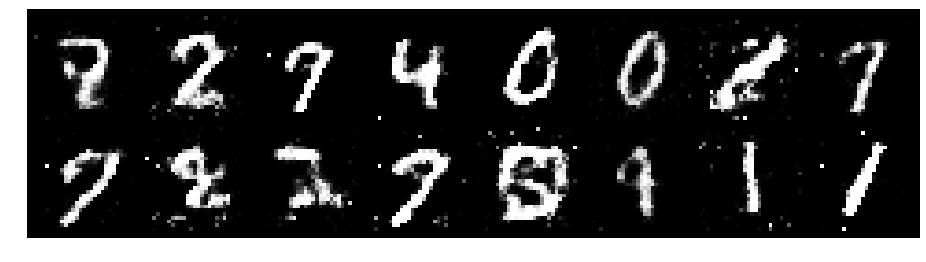

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.3056, Generator Loss: 1.0259
D(x): 0.5285, D(G(z)): 0.4055


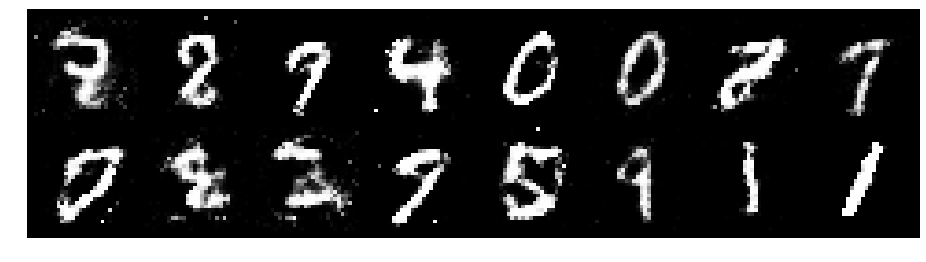

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.3001, Generator Loss: 0.8035
D(x): 0.5402, D(G(z)): 0.3952


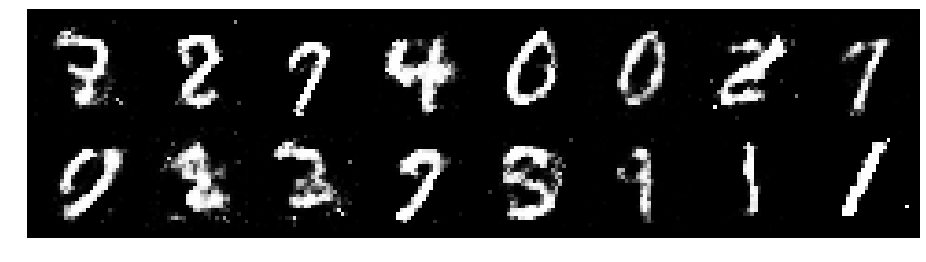

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.2272, Generator Loss: 1.0604
D(x): 0.5590, D(G(z)): 0.3714


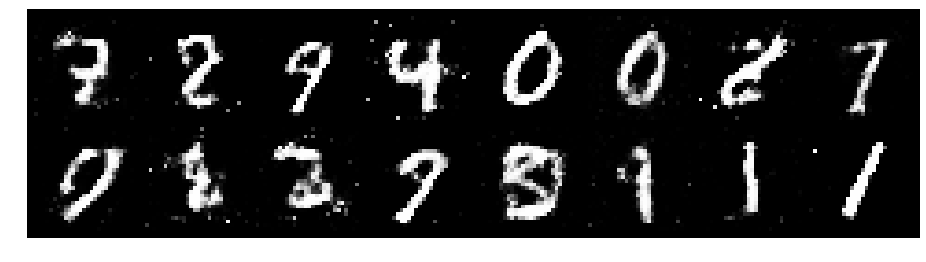

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.2978, Generator Loss: 1.1545
D(x): 0.6733, D(G(z)): 0.4619


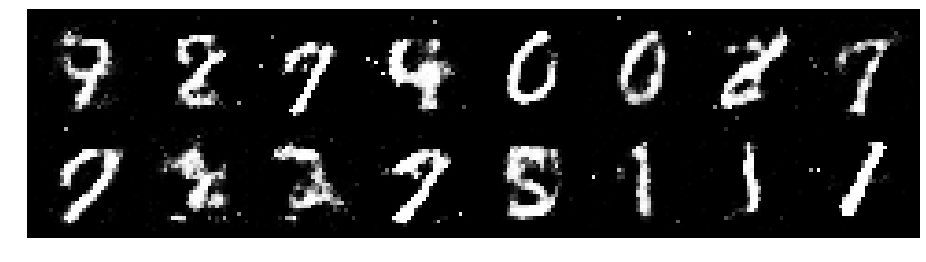

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.1566, Generator Loss: 1.2039
D(x): 0.6619, D(G(z)): 0.4384


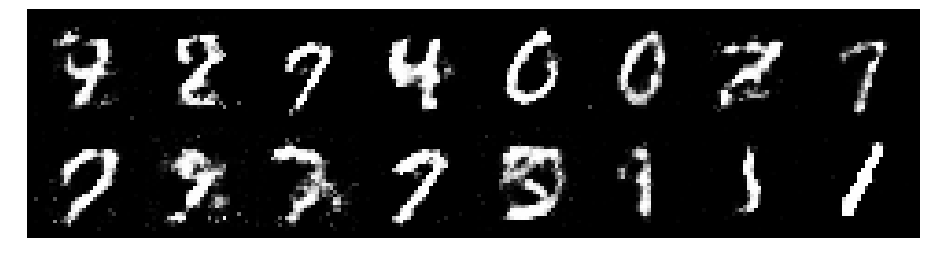

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.1443, Generator Loss: 1.2035
D(x): 0.5633, D(G(z)): 0.3562


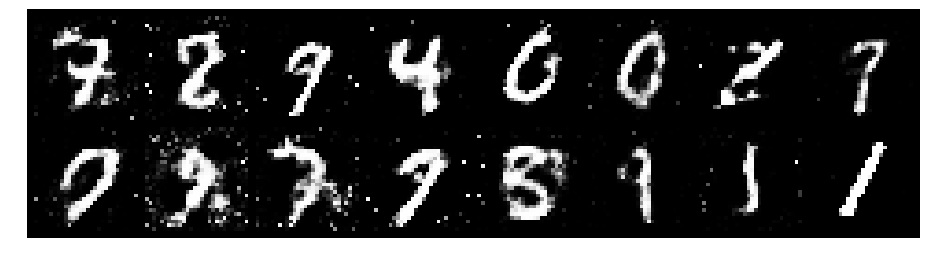

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.2048, Generator Loss: 0.8575
D(x): 0.6303, D(G(z)): 0.4663


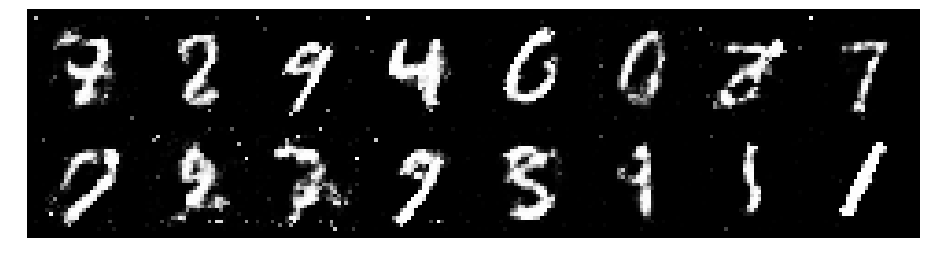

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.2449, Generator Loss: 1.0964
D(x): 0.5879, D(G(z)): 0.4347


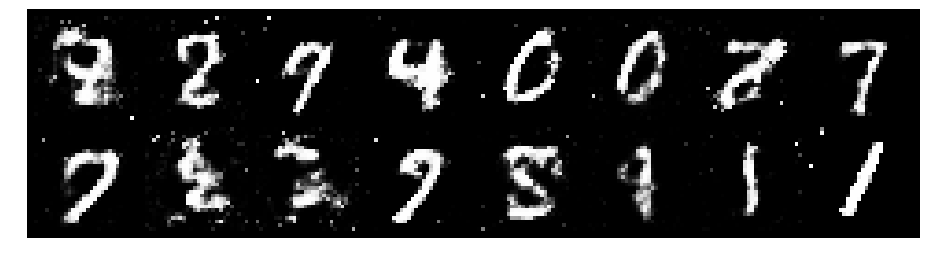

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.0321, Generator Loss: 1.0708
D(x): 0.6589, D(G(z)): 0.3858


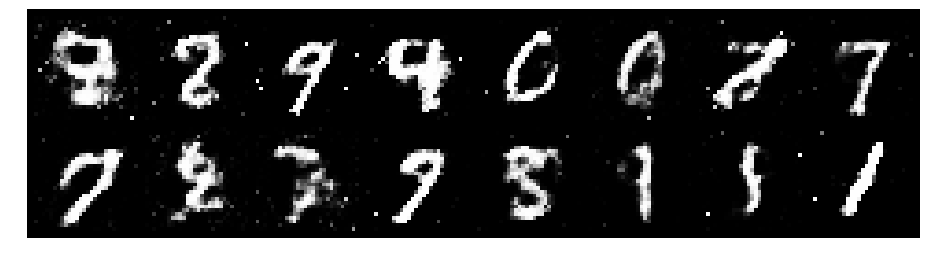

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.1141, Generator Loss: 1.0283
D(x): 0.6721, D(G(z)): 0.4472


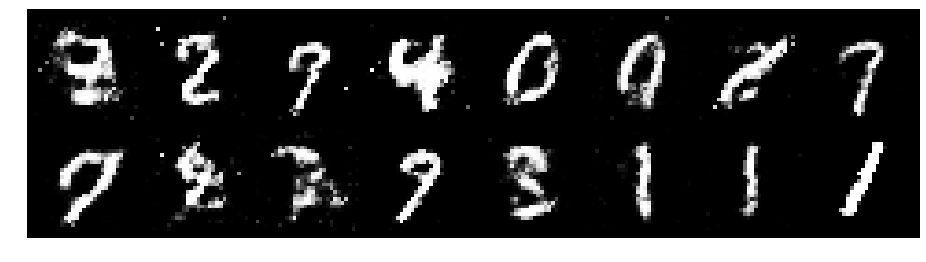

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.2067, Generator Loss: 1.0174
D(x): 0.6270, D(G(z)): 0.4460


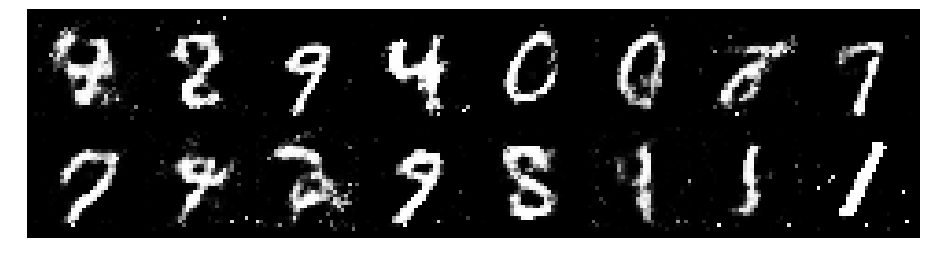

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.1862, Generator Loss: 0.9590
D(x): 0.6673, D(G(z)): 0.4762


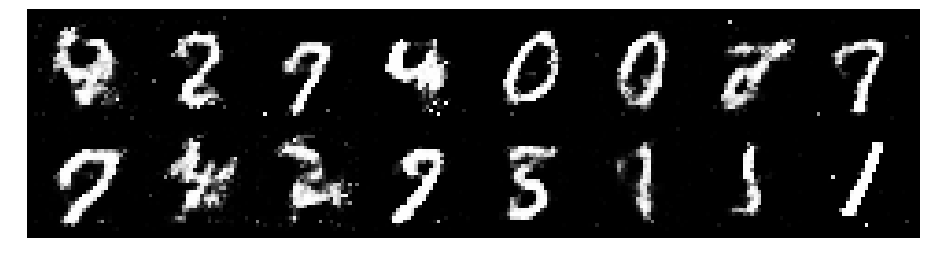

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.1964, Generator Loss: 1.0284
D(x): 0.5683, D(G(z)): 0.3908


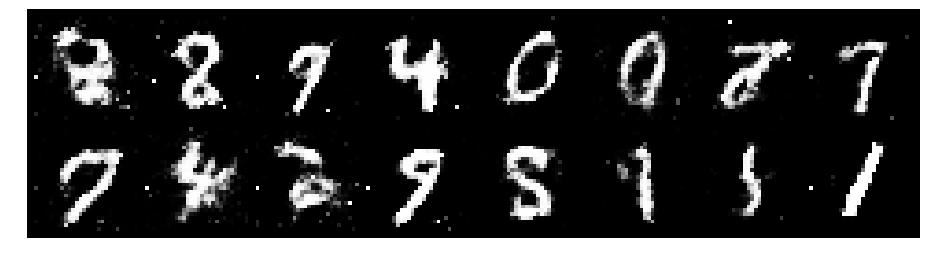

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.2248, Generator Loss: 0.7744
D(x): 0.5841, D(G(z)): 0.4487


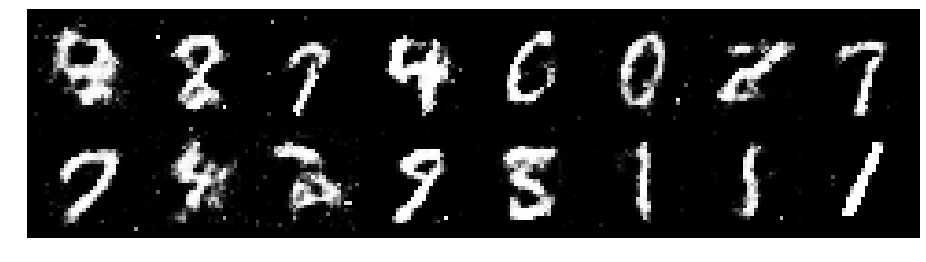

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.2154, Generator Loss: 1.0348
D(x): 0.5519, D(G(z)): 0.3798


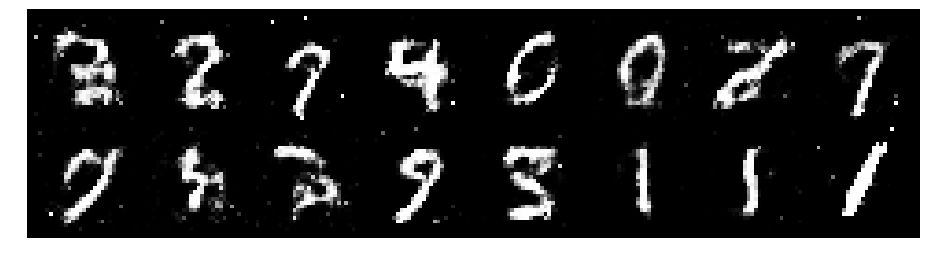

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.1180, Generator Loss: 0.9589
D(x): 0.6095, D(G(z)): 0.3994


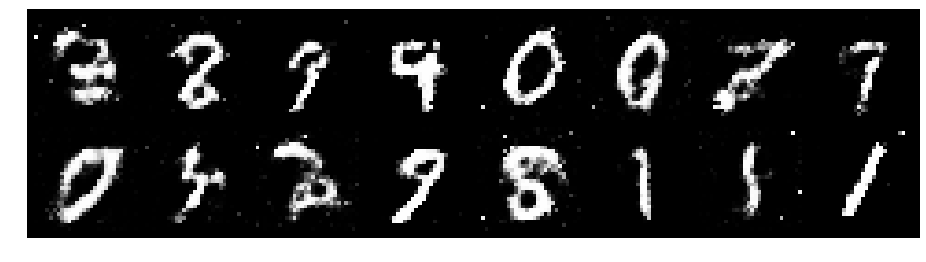

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.2209, Generator Loss: 1.0401
D(x): 0.5493, D(G(z)): 0.3984


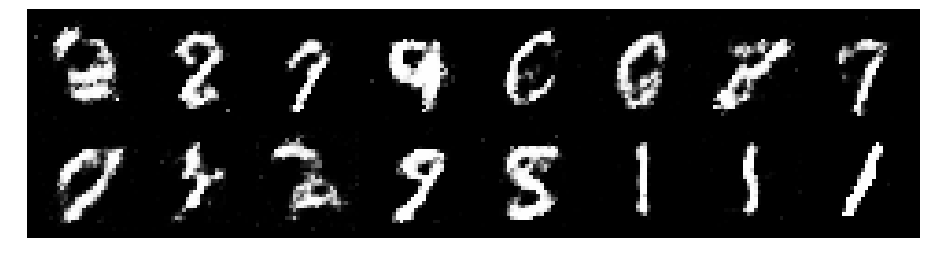

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.2068, Generator Loss: 0.9643
D(x): 0.5515, D(G(z)): 0.3985


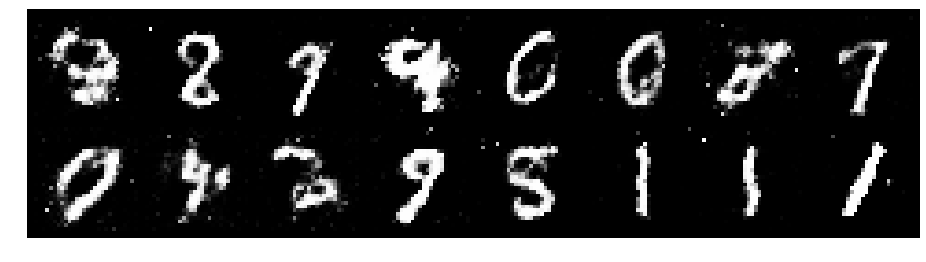

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.2861, Generator Loss: 0.9293
D(x): 0.5328, D(G(z)): 0.4251


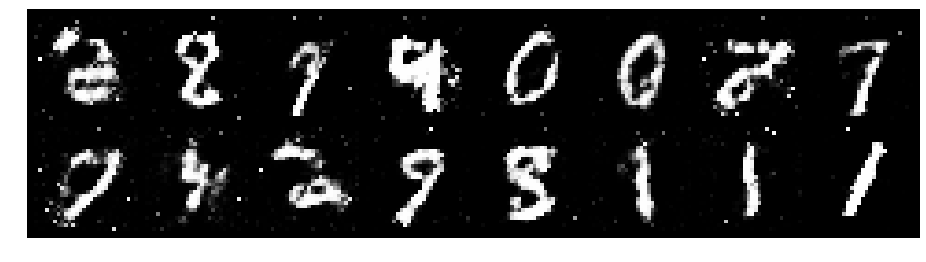

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.2232, Generator Loss: 0.8919
D(x): 0.5780, D(G(z)): 0.4247


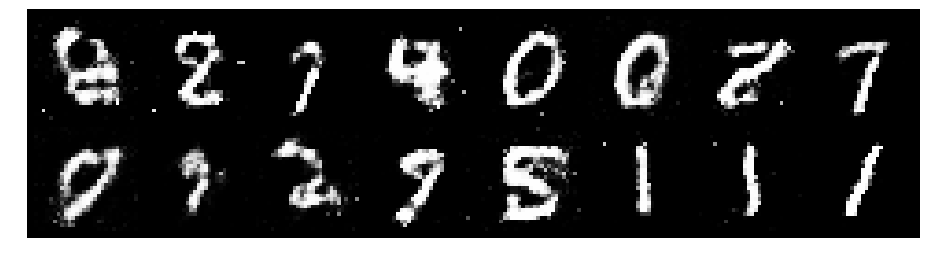

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.2487, Generator Loss: 0.9447
D(x): 0.5634, D(G(z)): 0.4333


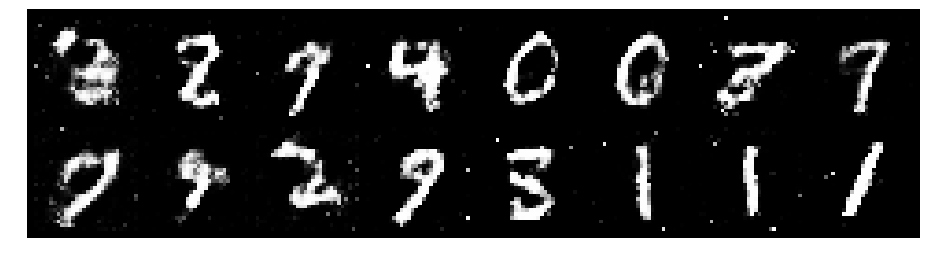

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.1606, Generator Loss: 1.0792
D(x): 0.5514, D(G(z)): 0.3433


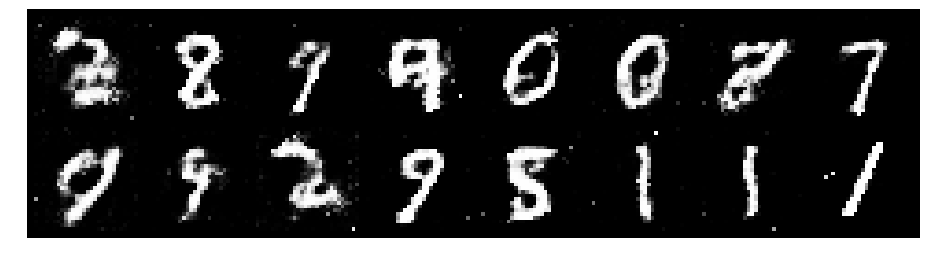

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.2431, Generator Loss: 1.1369
D(x): 0.6066, D(G(z)): 0.4414


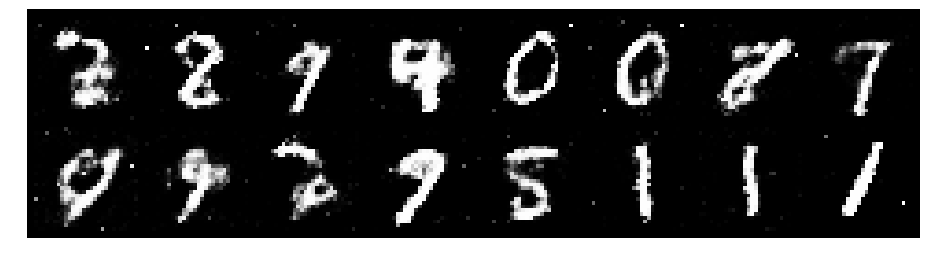

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.3460, Generator Loss: 0.7868
D(x): 0.5598, D(G(z)): 0.4728


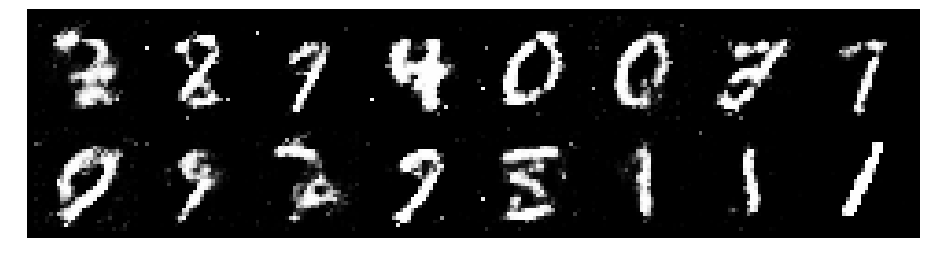

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.3258, Generator Loss: 0.9649
D(x): 0.6028, D(G(z)): 0.4879


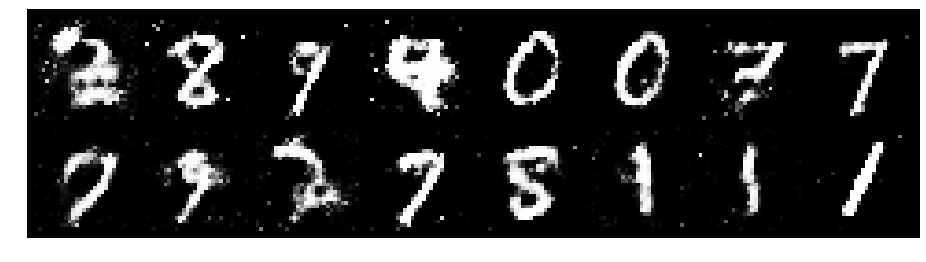

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.3410, Generator Loss: 0.9654
D(x): 0.5811, D(G(z)): 0.4326


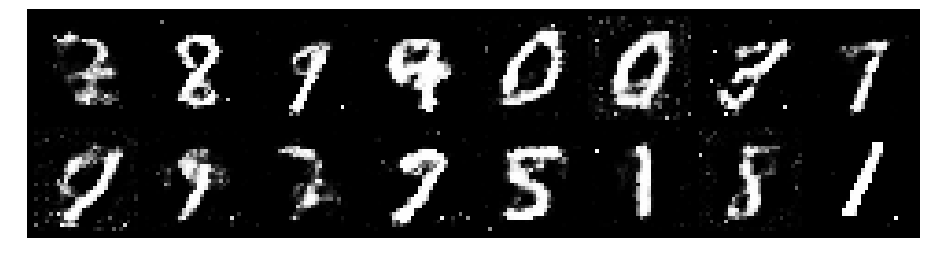

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.1990, Generator Loss: 1.1012
D(x): 0.6289, D(G(z)): 0.4402


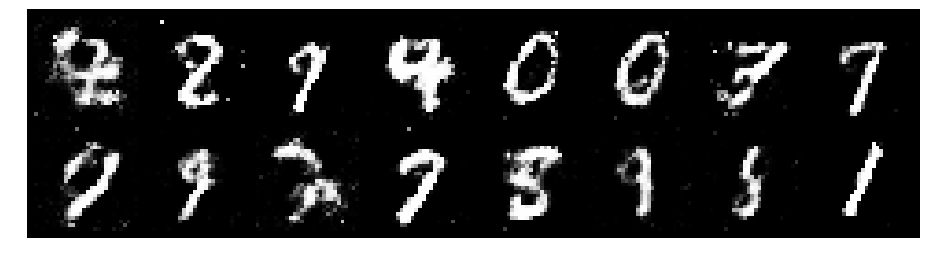

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.0952, Generator Loss: 1.1401
D(x): 0.6353, D(G(z)): 0.3976


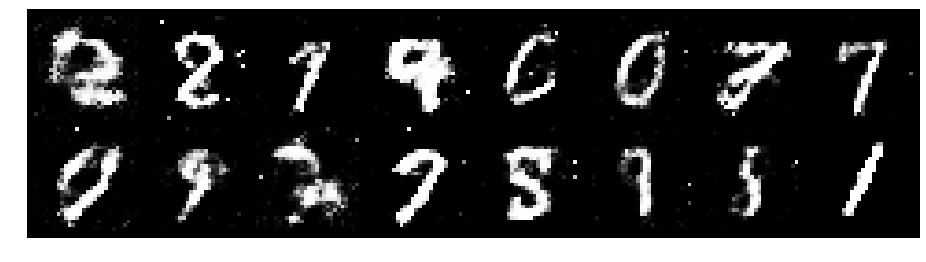

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.1347, Generator Loss: 1.3019
D(x): 0.6281, D(G(z)): 0.3969


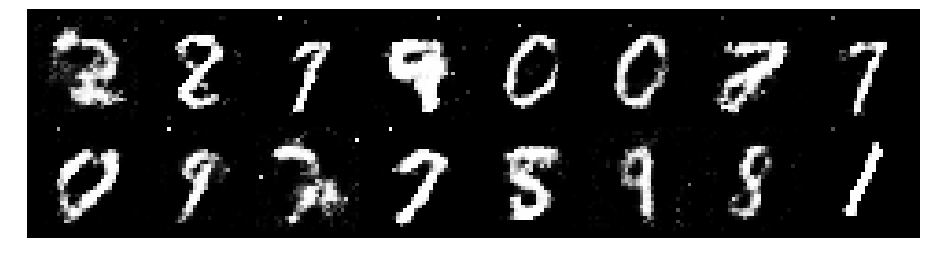

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.1132, Generator Loss: 1.1068
D(x): 0.6066, D(G(z)): 0.3716


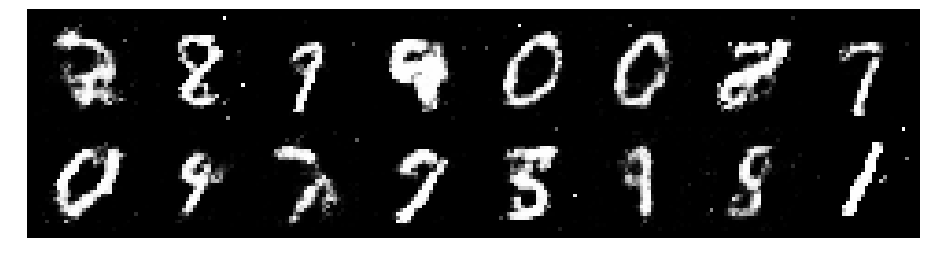

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.0779, Generator Loss: 1.0086
D(x): 0.6234, D(G(z)): 0.3970


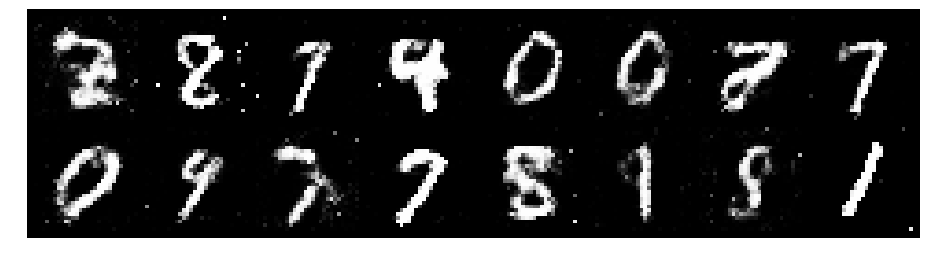

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.0056, Generator Loss: 1.0079
D(x): 0.6685, D(G(z)): 0.3856


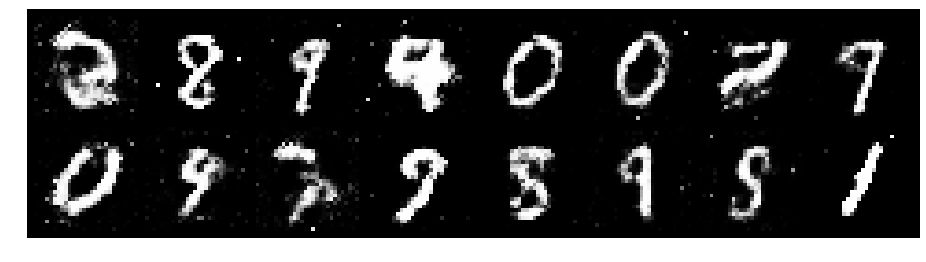

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.1797, Generator Loss: 0.9378
D(x): 0.5878, D(G(z)): 0.4336


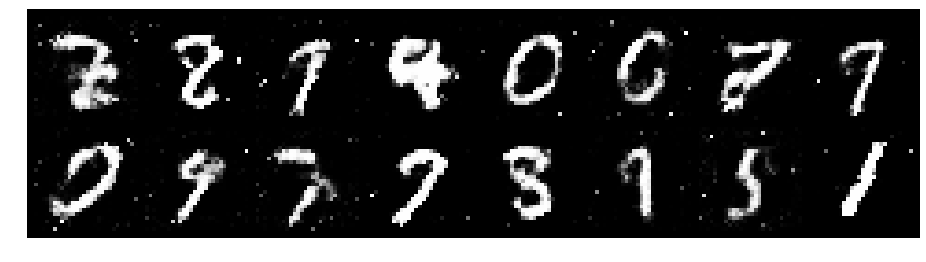

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.1599, Generator Loss: 0.8990
D(x): 0.5713, D(G(z)): 0.4028


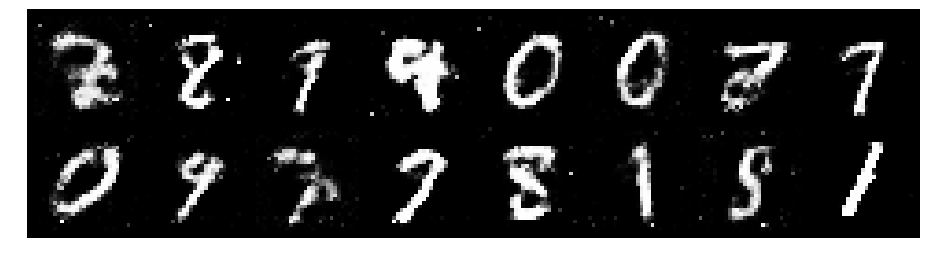

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.0888, Generator Loss: 0.9460
D(x): 0.6149, D(G(z)): 0.3884


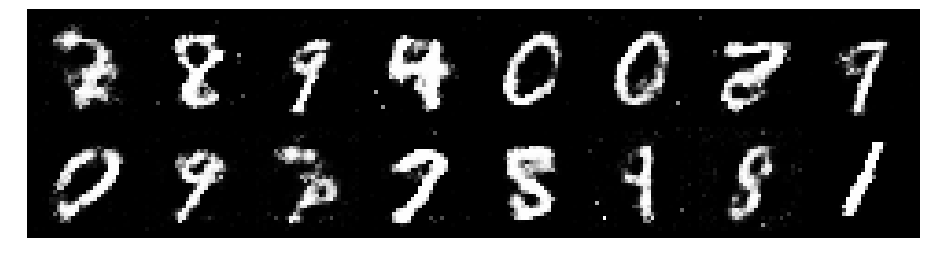

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.0692, Generator Loss: 1.0254
D(x): 0.6409, D(G(z)): 0.4051


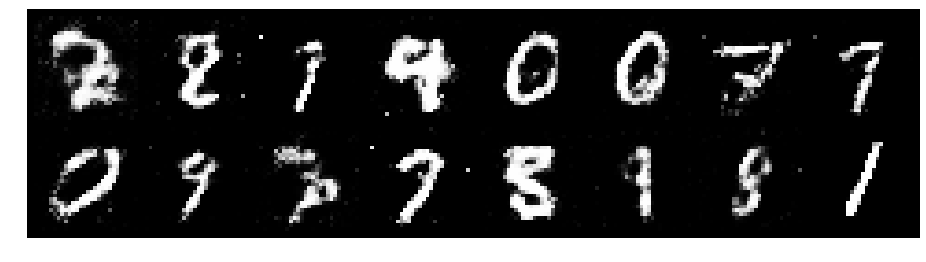

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.0875, Generator Loss: 1.1117
D(x): 0.6378, D(G(z)): 0.3985


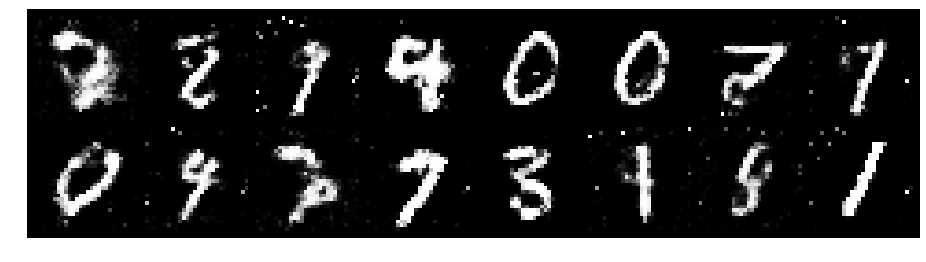

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.1334, Generator Loss: 1.0255
D(x): 0.5818, D(G(z)): 0.3795


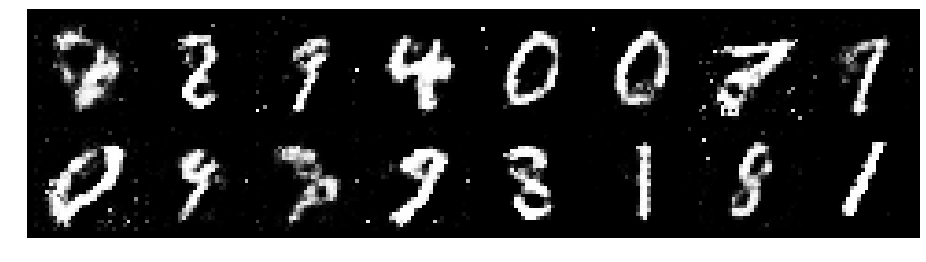

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.1754, Generator Loss: 1.0669
D(x): 0.6401, D(G(z)): 0.4417


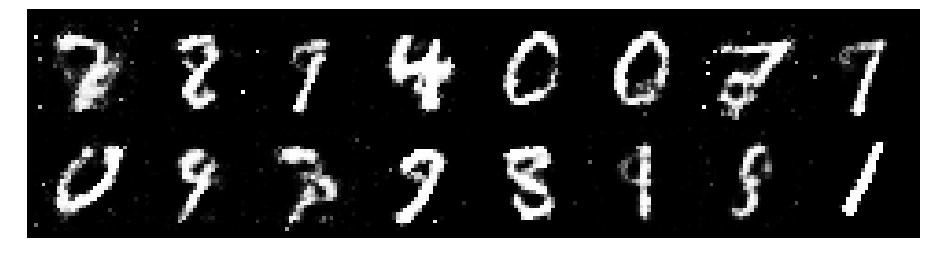

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.0568, Generator Loss: 1.4865
D(x): 0.6787, D(G(z)): 0.3912


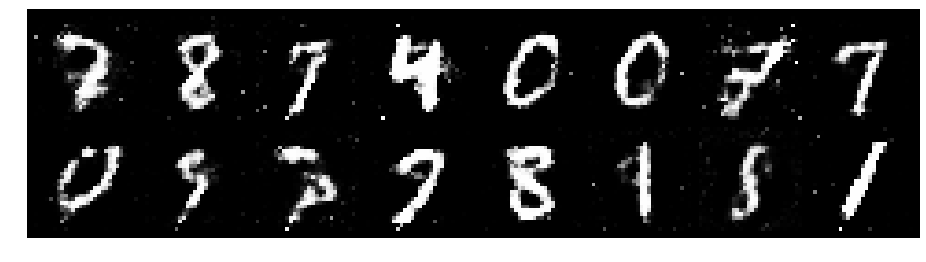

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.0956, Generator Loss: 1.3507
D(x): 0.5904, D(G(z)): 0.3418


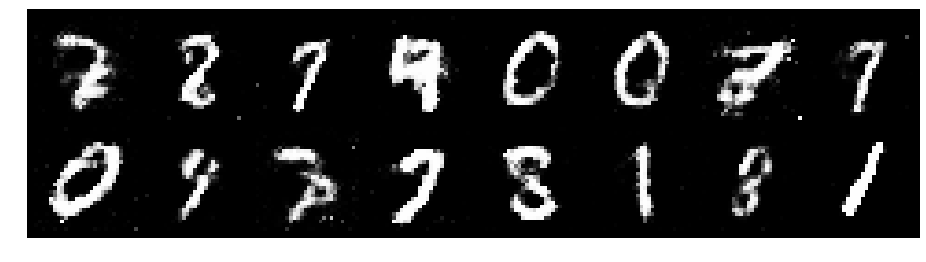

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.3745, Generator Loss: 0.9781
D(x): 0.5442, D(G(z)): 0.4408


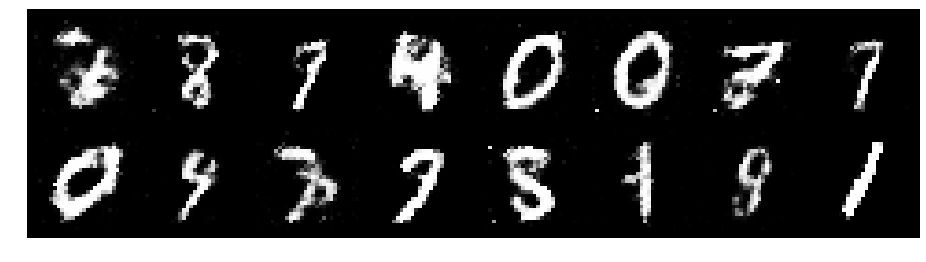

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.1624, Generator Loss: 0.9384
D(x): 0.5759, D(G(z)): 0.4099


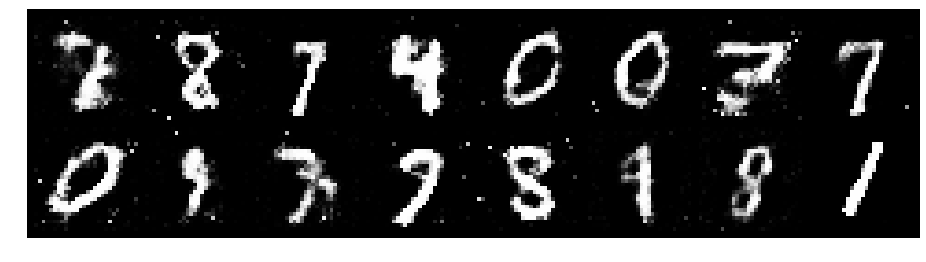

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.3494, Generator Loss: 1.0355
D(x): 0.5363, D(G(z)): 0.4260


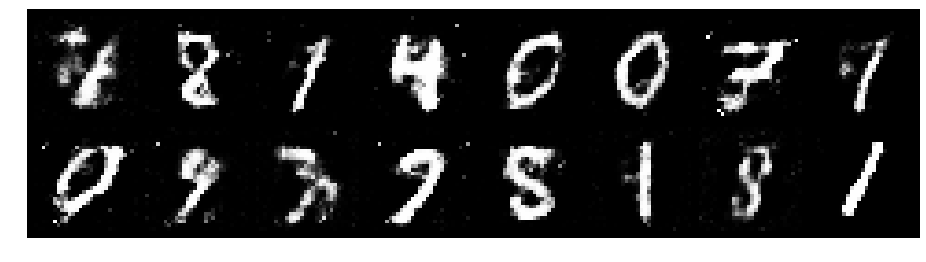

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.4915, Generator Loss: 0.9655
D(x): 0.5050, D(G(z)): 0.4235


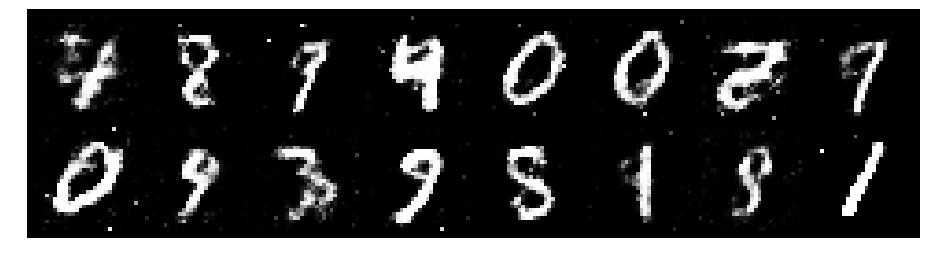

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.3306, Generator Loss: 1.0118
D(x): 0.6236, D(G(z)): 0.4578


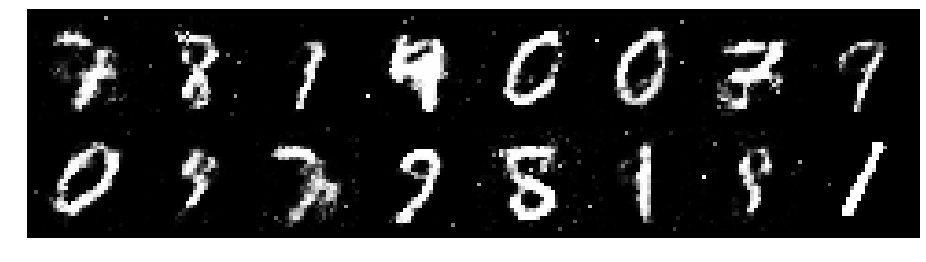

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.2276, Generator Loss: 0.9441
D(x): 0.5797, D(G(z)): 0.4181


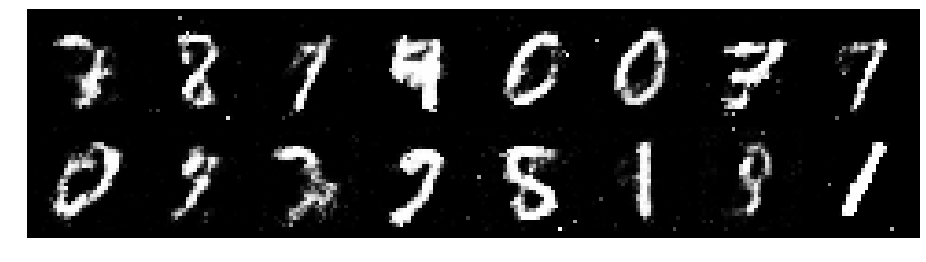

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.1932, Generator Loss: 0.8971
D(x): 0.5821, D(G(z)): 0.4303


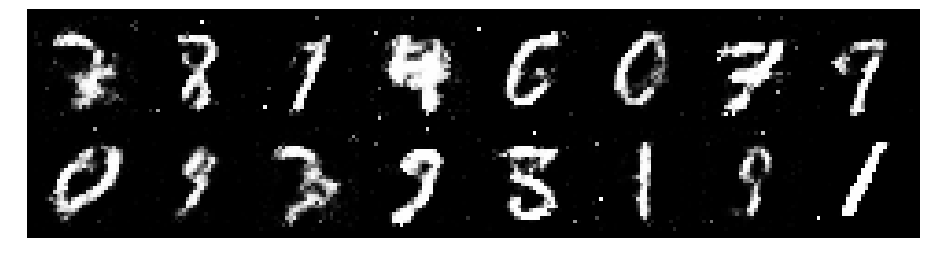

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.2487, Generator Loss: 0.9389
D(x): 0.5888, D(G(z)): 0.4577


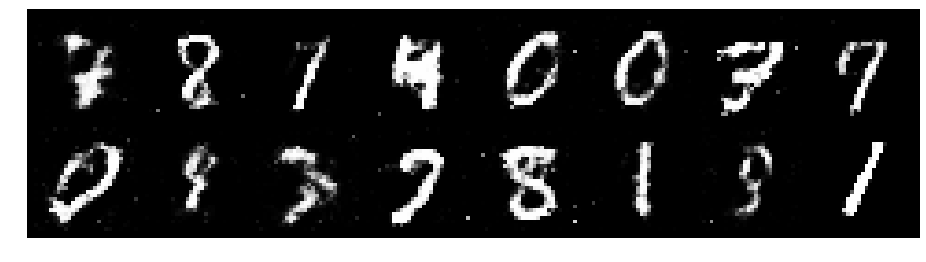

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.1932, Generator Loss: 0.8892
D(x): 0.5591, D(G(z)): 0.4032


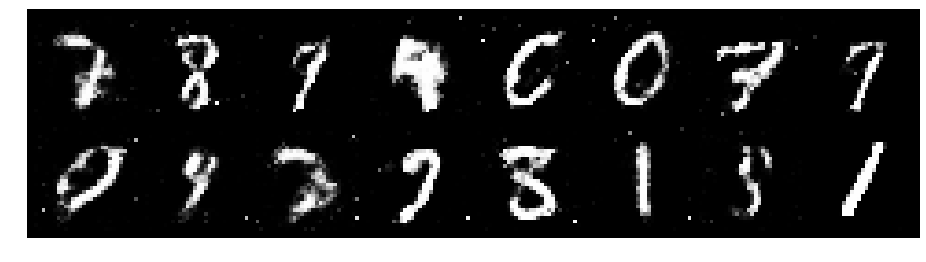

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.3007, Generator Loss: 1.0464
D(x): 0.5442, D(G(z)): 0.4394


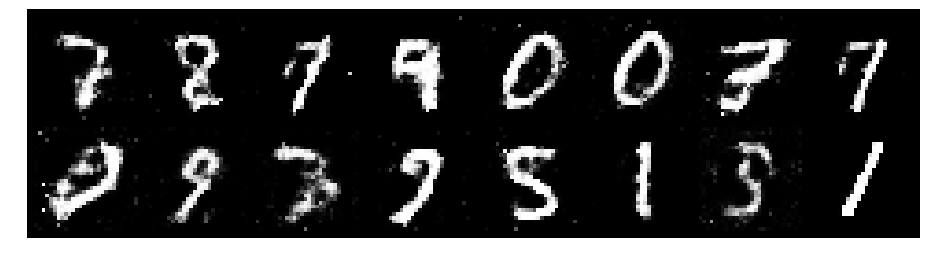

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.1286, Generator Loss: 0.9740
D(x): 0.6035, D(G(z)): 0.4044


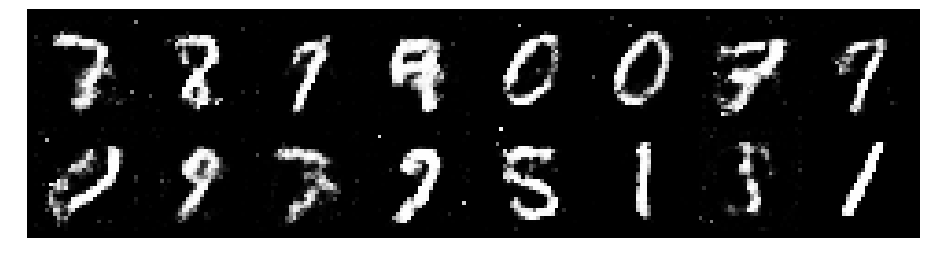

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.2257, Generator Loss: 0.9356
D(x): 0.5876, D(G(z)): 0.4384


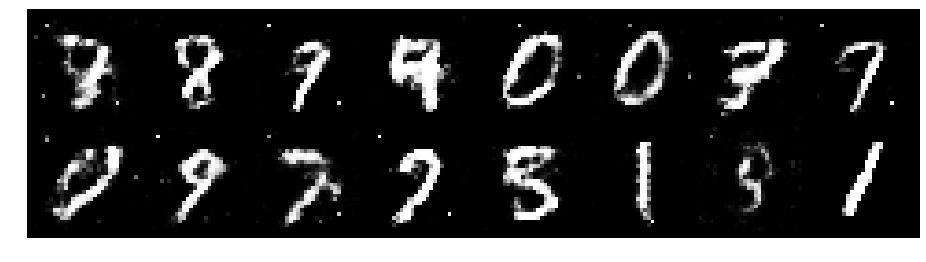

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.1543, Generator Loss: 0.9746
D(x): 0.5765, D(G(z)): 0.4080


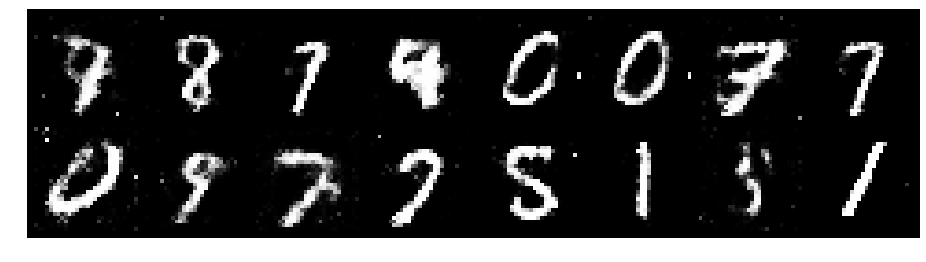

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.1785, Generator Loss: 1.0421
D(x): 0.5951, D(G(z)): 0.4041


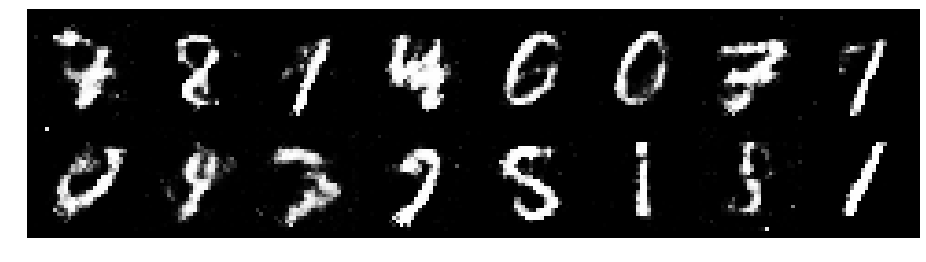

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.1399, Generator Loss: 1.1202
D(x): 0.5739, D(G(z)): 0.3905


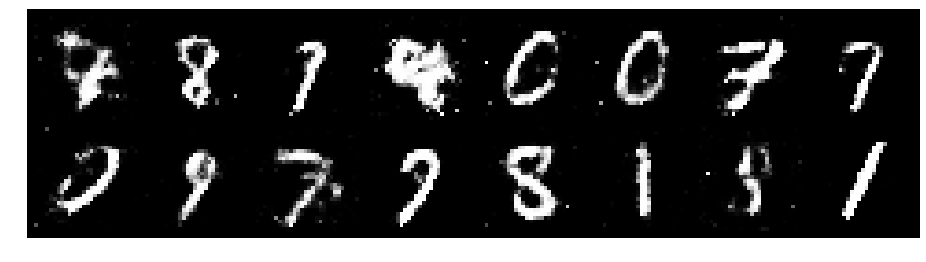

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.2544, Generator Loss: 0.9350
D(x): 0.6226, D(G(z)): 0.4743


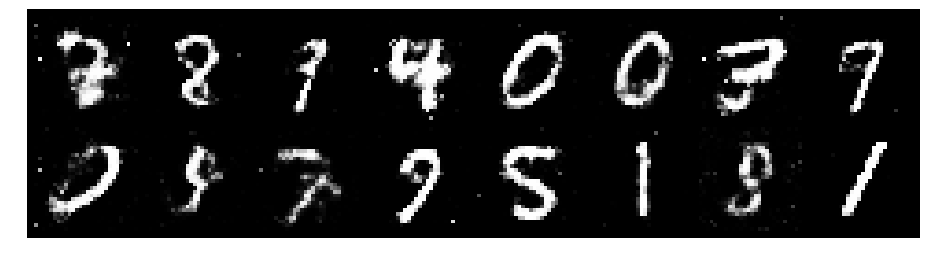

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.2625, Generator Loss: 1.0582
D(x): 0.6108, D(G(z)): 0.4421


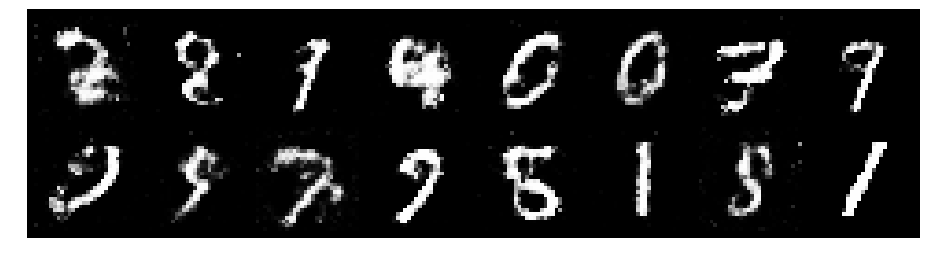

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.2329, Generator Loss: 0.9234
D(x): 0.5569, D(G(z)): 0.4132


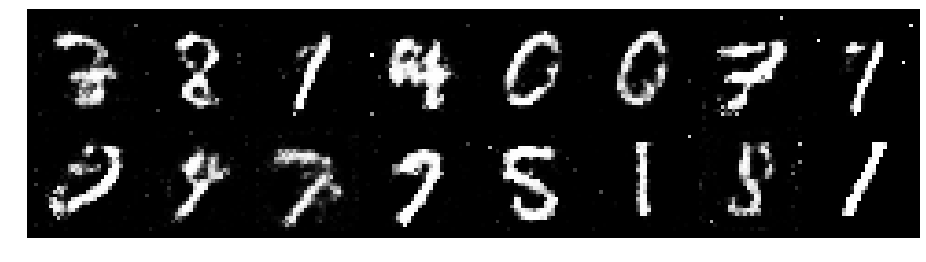

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.3106, Generator Loss: 0.7627
D(x): 0.5956, D(G(z)): 0.4936


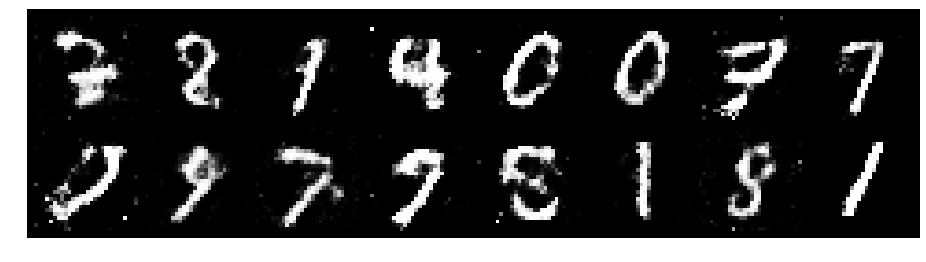

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.2850, Generator Loss: 0.9130
D(x): 0.5673, D(G(z)): 0.4483


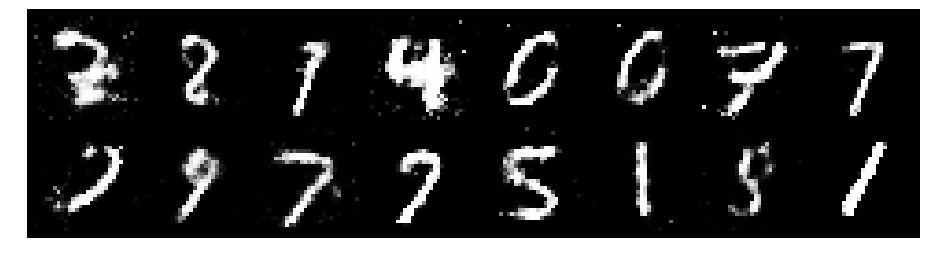

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.1438, Generator Loss: 1.1567
D(x): 0.6278, D(G(z)): 0.3531


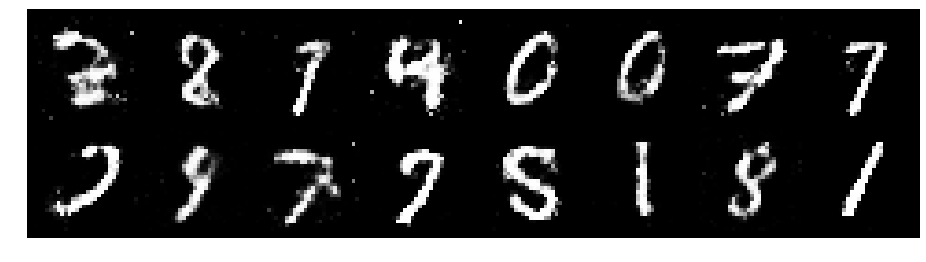

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.1779, Generator Loss: 0.9520
D(x): 0.5488, D(G(z)): 0.3548


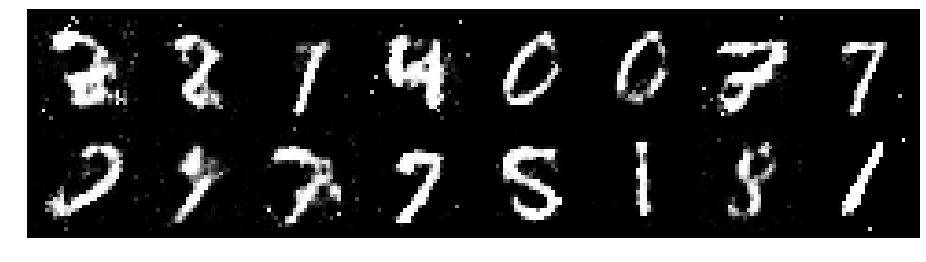

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.2194, Generator Loss: 0.9819
D(x): 0.5843, D(G(z)): 0.4175


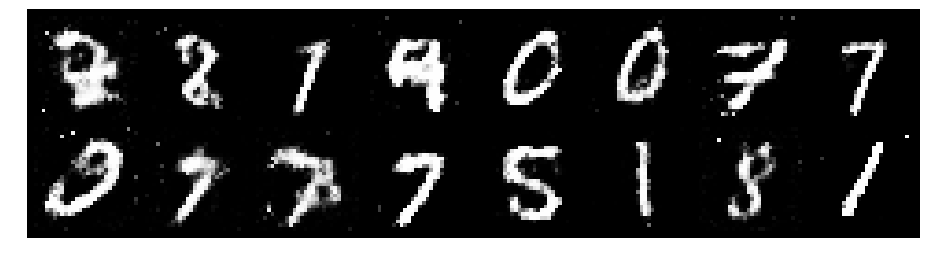

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.0877, Generator Loss: 1.0555
D(x): 0.6671, D(G(z)): 0.4280


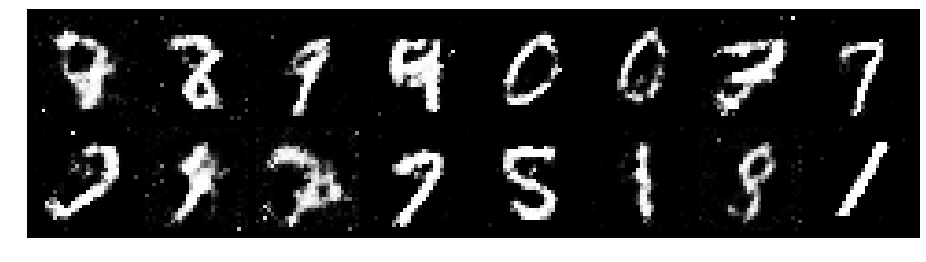

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.0882, Generator Loss: 0.9334
D(x): 0.6218, D(G(z)): 0.4017


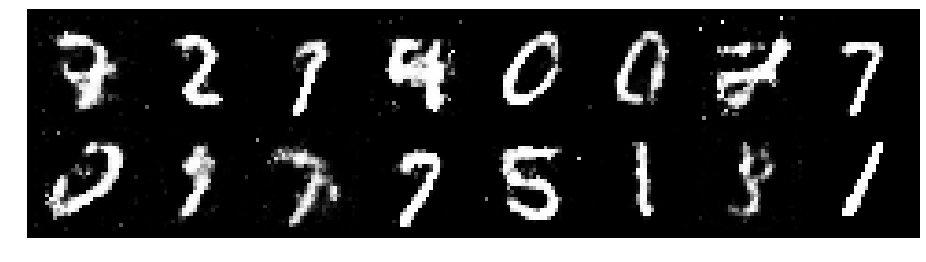

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.2591, Generator Loss: 0.8491
D(x): 0.5650, D(G(z)): 0.4606


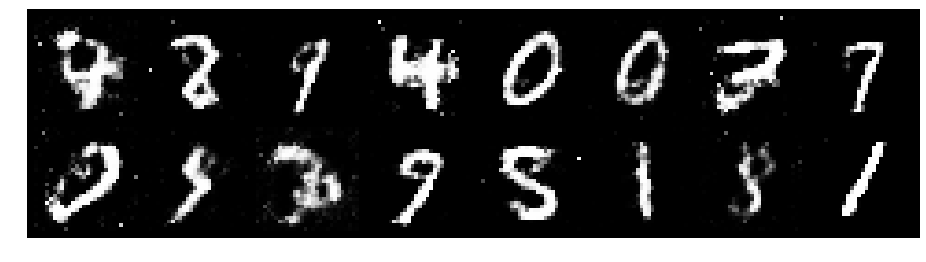

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.2903, Generator Loss: 0.8423
D(x): 0.5803, D(G(z)): 0.4540


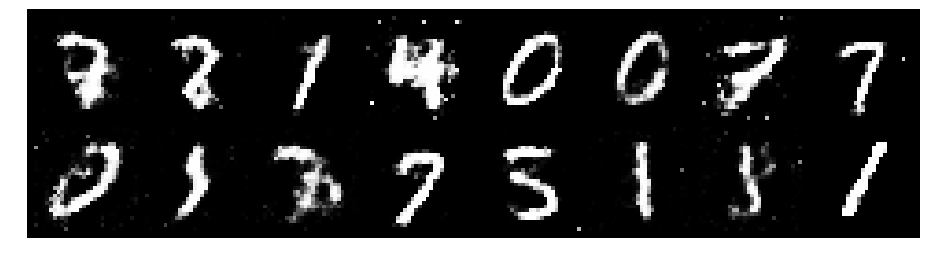

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.2688, Generator Loss: 0.9132
D(x): 0.5731, D(G(z)): 0.4431


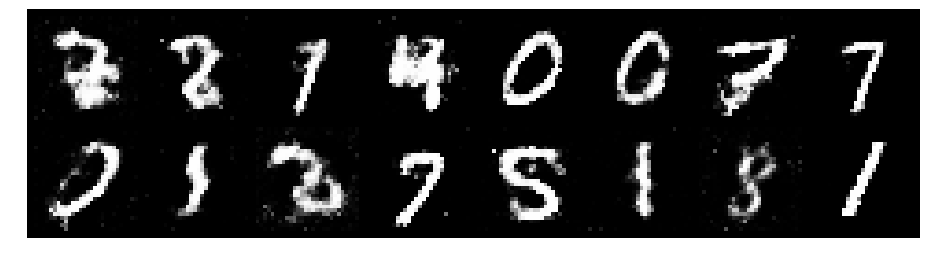

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.2325, Generator Loss: 0.9561
D(x): 0.5443, D(G(z)): 0.4051


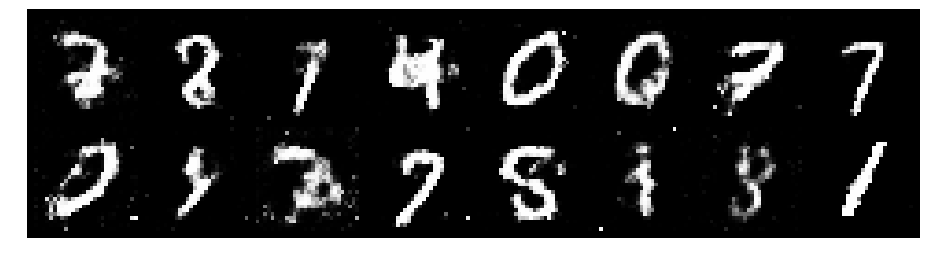

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.1117, Generator Loss: 1.0466
D(x): 0.6333, D(G(z)): 0.4170


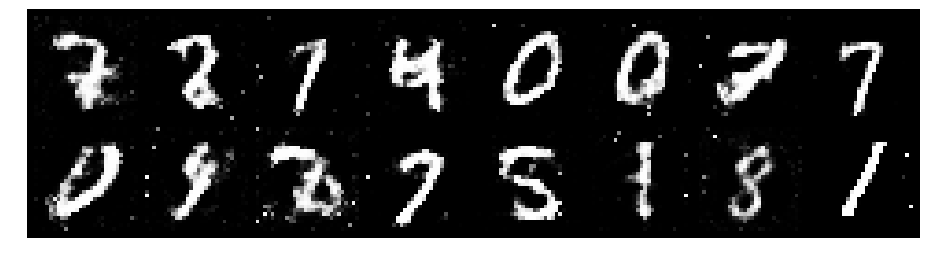

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.2898, Generator Loss: 1.2010
D(x): 0.5669, D(G(z)): 0.4296


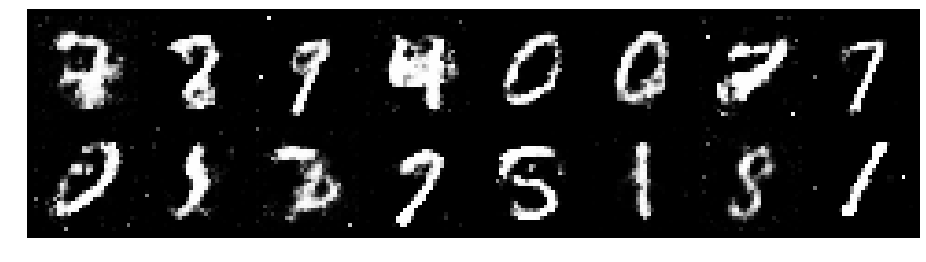

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.0818, Generator Loss: 1.1797
D(x): 0.6336, D(G(z)): 0.3964


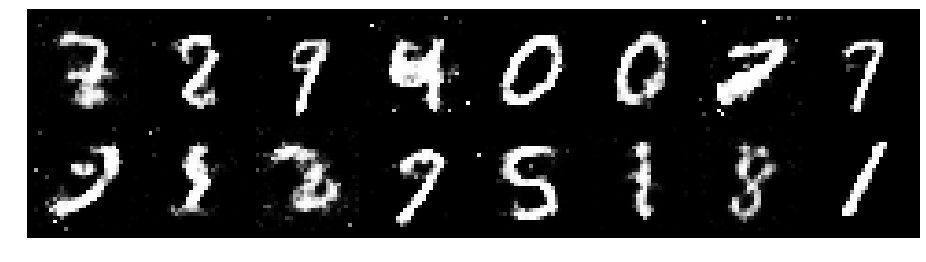

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.1871, Generator Loss: 1.0586
D(x): 0.6014, D(G(z)): 0.4228


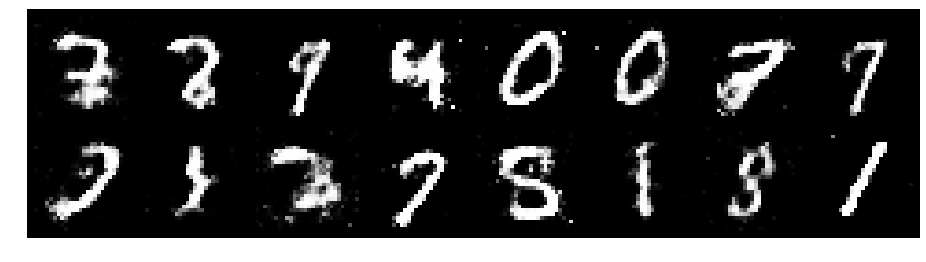

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.1076, Generator Loss: 1.0753
D(x): 0.6219, D(G(z)): 0.4045


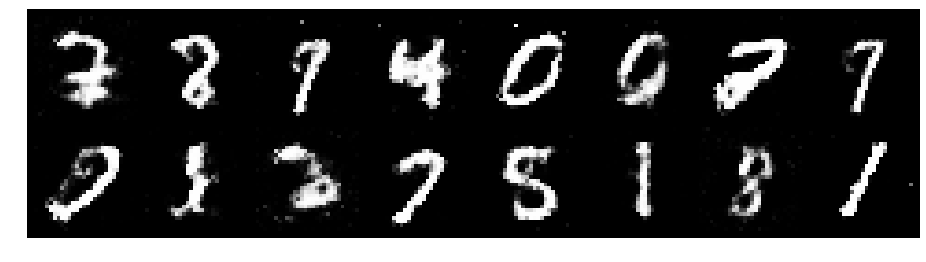

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.3783, Generator Loss: 1.0565
D(x): 0.5197, D(G(z)): 0.3885


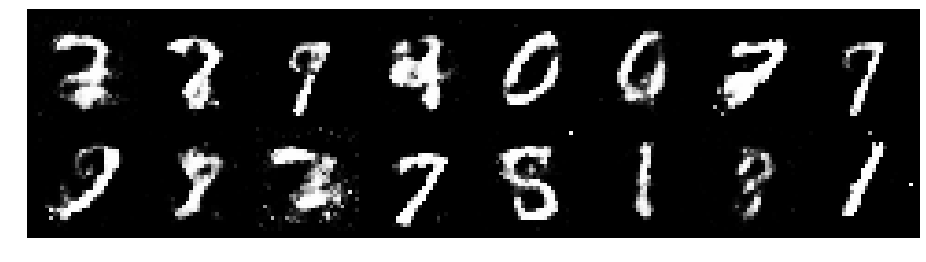

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.3466, Generator Loss: 0.8484
D(x): 0.5619, D(G(z)): 0.4548


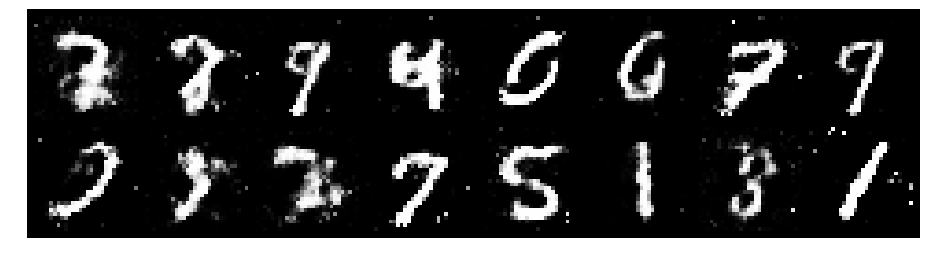

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.1970, Generator Loss: 1.1099
D(x): 0.5756, D(G(z)): 0.3976


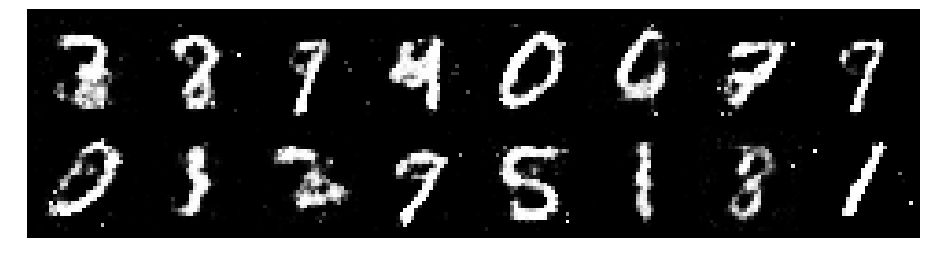

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.2747, Generator Loss: 1.0815
D(x): 0.5642, D(G(z)): 0.4137


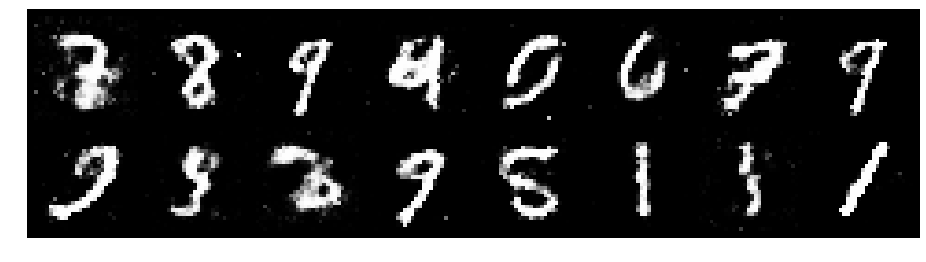

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.1361, Generator Loss: 1.2186
D(x): 0.6346, D(G(z)): 0.4241


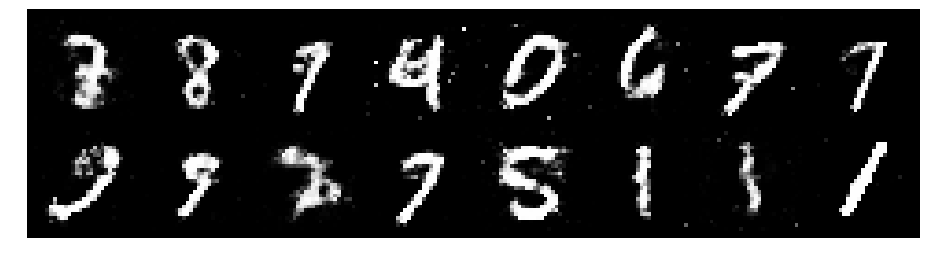

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.2431, Generator Loss: 0.8573
D(x): 0.5908, D(G(z)): 0.4596


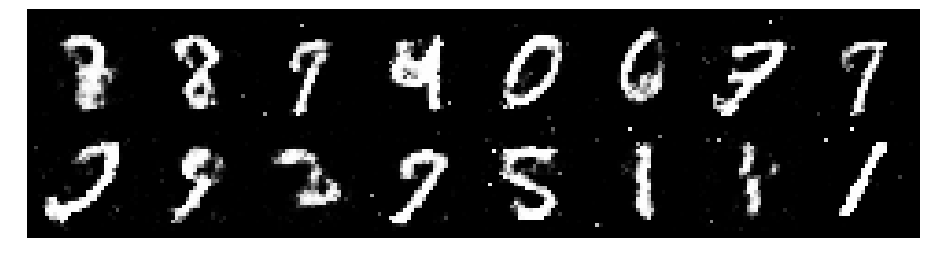

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.2821, Generator Loss: 1.0555
D(x): 0.5244, D(G(z)): 0.3832


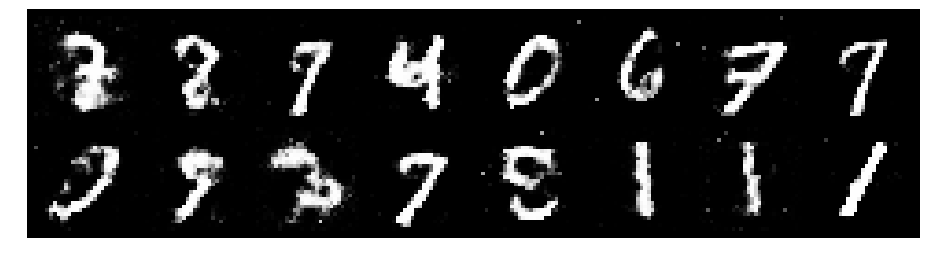

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.2316, Generator Loss: 1.0387
D(x): 0.5964, D(G(z)): 0.4429


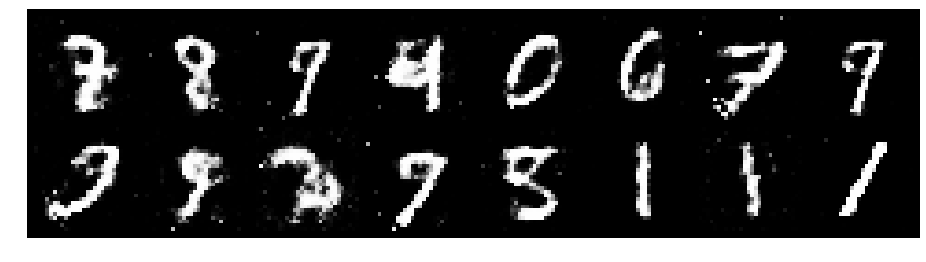

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.0812, Generator Loss: 1.2465
D(x): 0.6661, D(G(z)): 0.4077


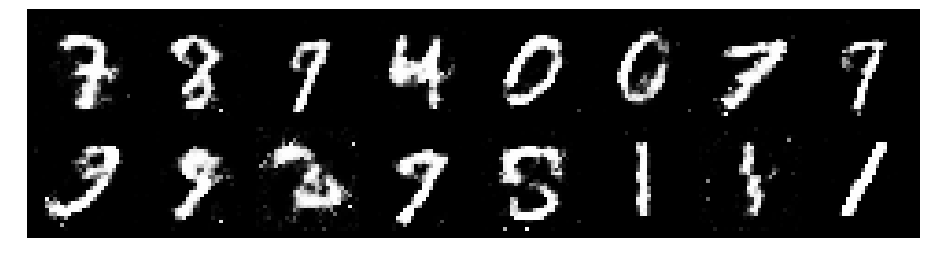

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.2067, Generator Loss: 1.0082
D(x): 0.6098, D(G(z)): 0.4199


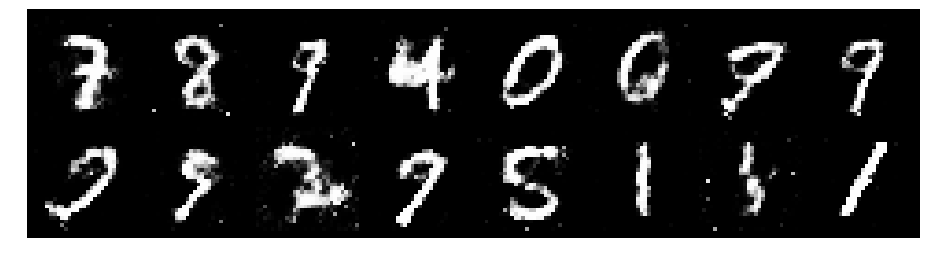

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.2232, Generator Loss: 0.9916
D(x): 0.5371, D(G(z)): 0.3703


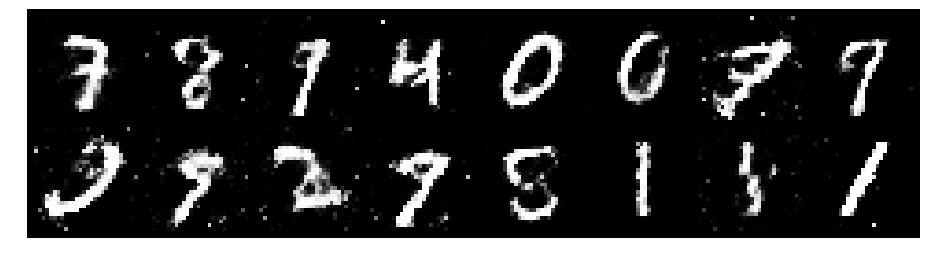

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.2670, Generator Loss: 1.0298
D(x): 0.5105, D(G(z)): 0.3935


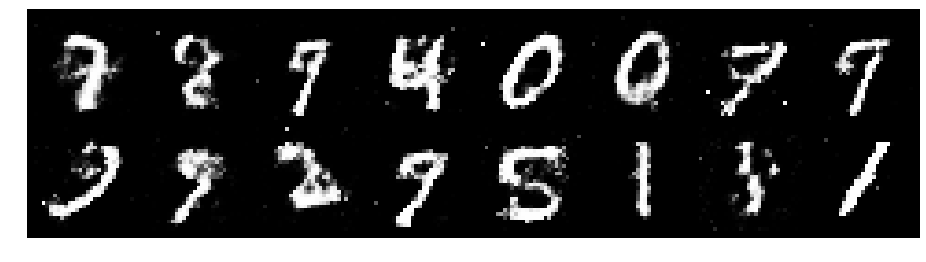

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.3340, Generator Loss: 0.7295
D(x): 0.5684, D(G(z)): 0.4986


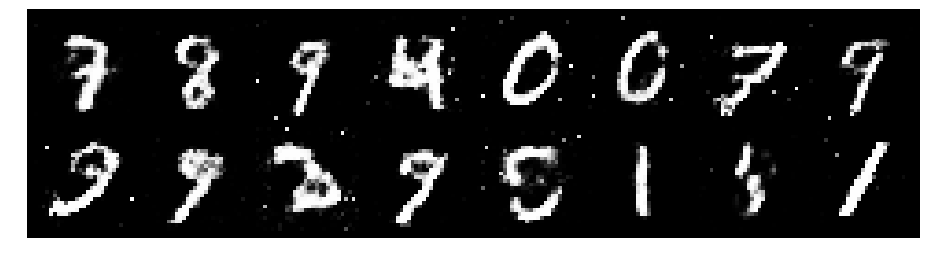

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.3094, Generator Loss: 0.9317
D(x): 0.5674, D(G(z)): 0.4480


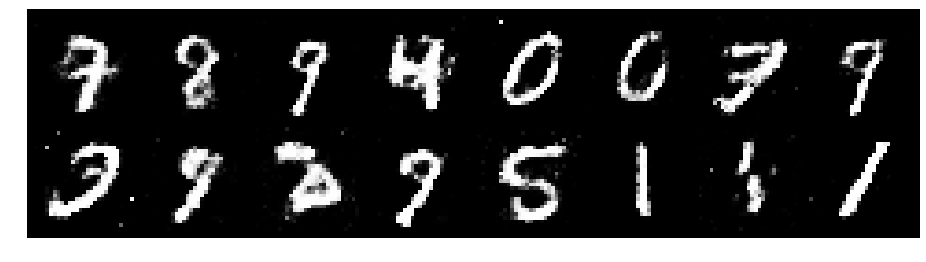

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.3770, Generator Loss: 0.9976
D(x): 0.5932, D(G(z)): 0.4868


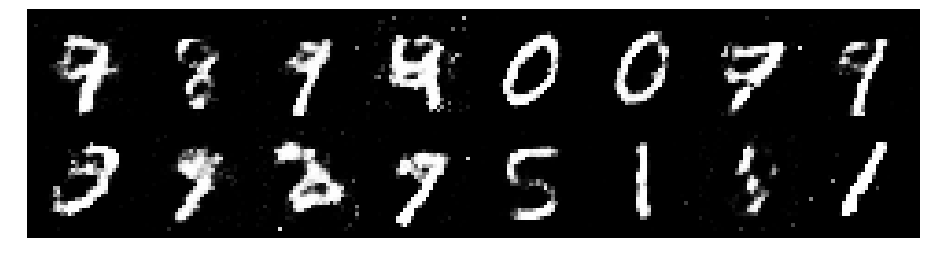

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.2352, Generator Loss: 1.0164
D(x): 0.5873, D(G(z)): 0.4362


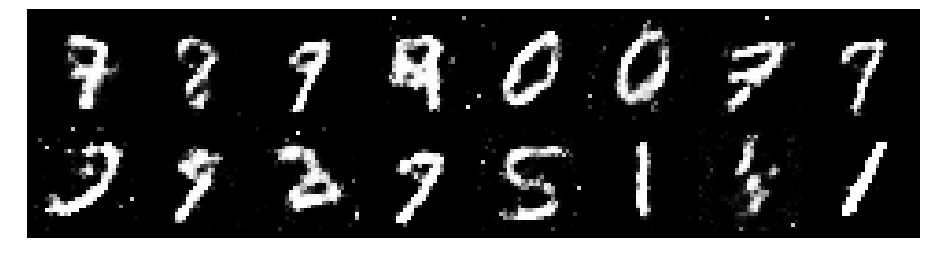

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.0752, Generator Loss: 1.0160
D(x): 0.6156, D(G(z)): 0.3871


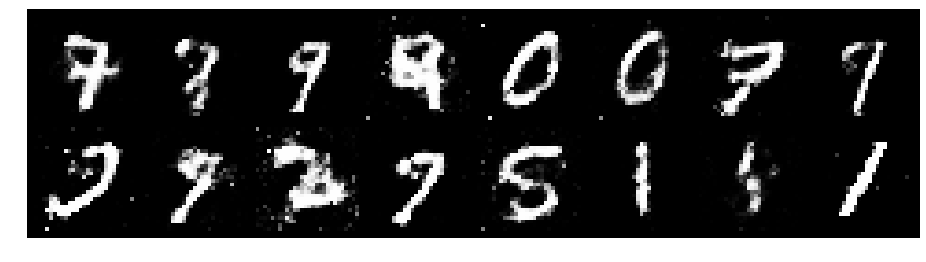

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.1936, Generator Loss: 1.1076
D(x): 0.6177, D(G(z)): 0.4342


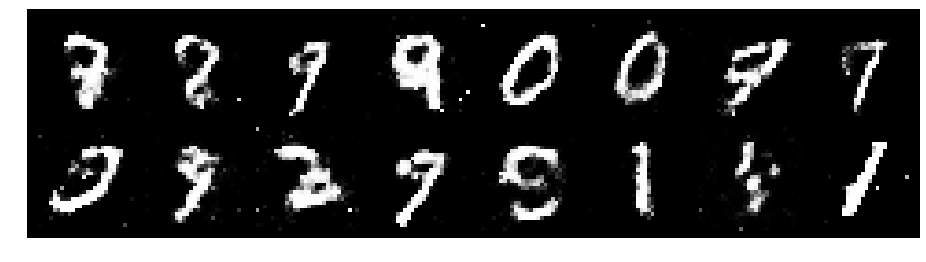

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.1266, Generator Loss: 0.8777
D(x): 0.6070, D(G(z)): 0.4211


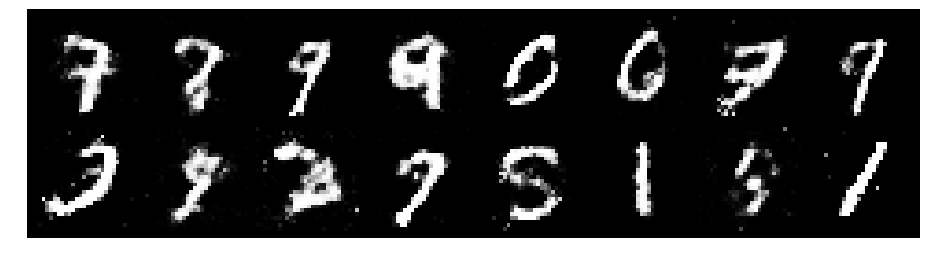

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.0908, Generator Loss: 0.8207
D(x): 0.5919, D(G(z)): 0.3840


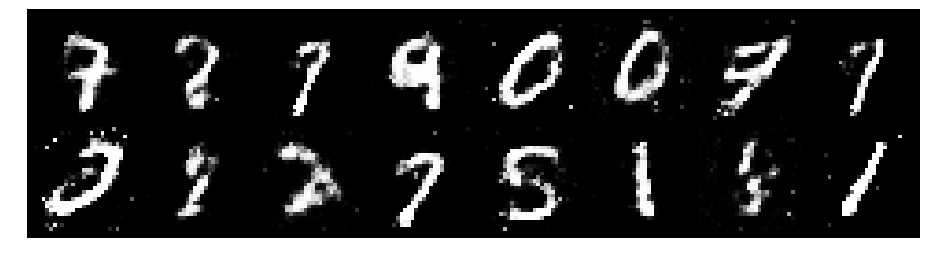

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.1866, Generator Loss: 0.9122
D(x): 0.5624, D(G(z)): 0.4091


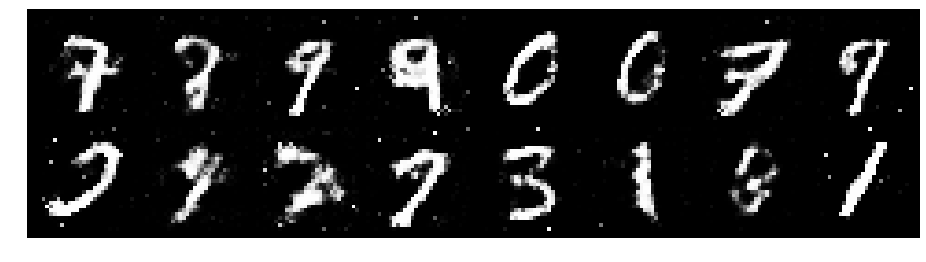

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.2200, Generator Loss: 1.0846
D(x): 0.5488, D(G(z)): 0.4002


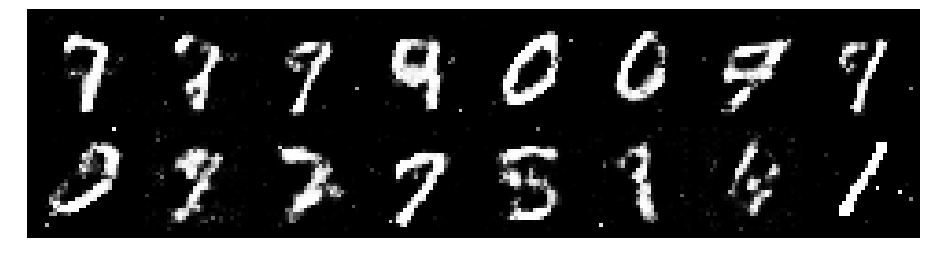

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.2660, Generator Loss: 0.9459
D(x): 0.5742, D(G(z)): 0.4242


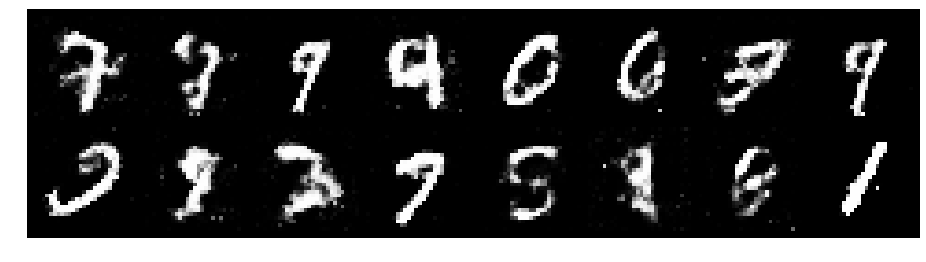

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.2635, Generator Loss: 0.9252
D(x): 0.5782, D(G(z)): 0.4415


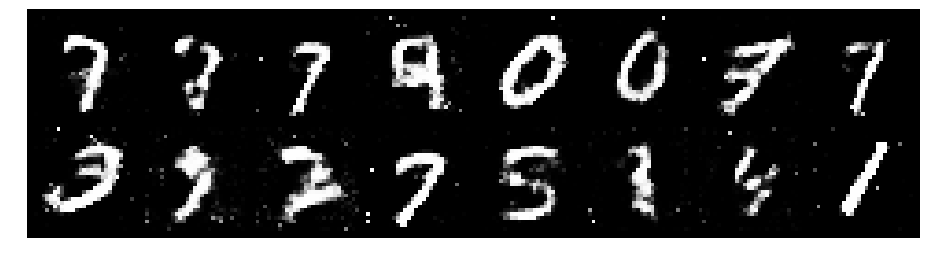

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.2621, Generator Loss: 1.0975
D(x): 0.5903, D(G(z)): 0.4345


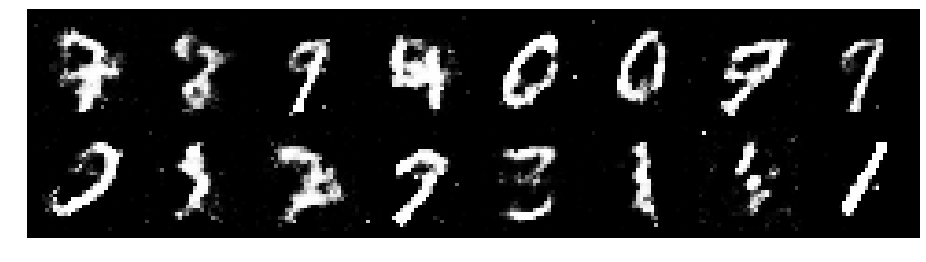

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.2055, Generator Loss: 0.8666
D(x): 0.5675, D(G(z)): 0.4056


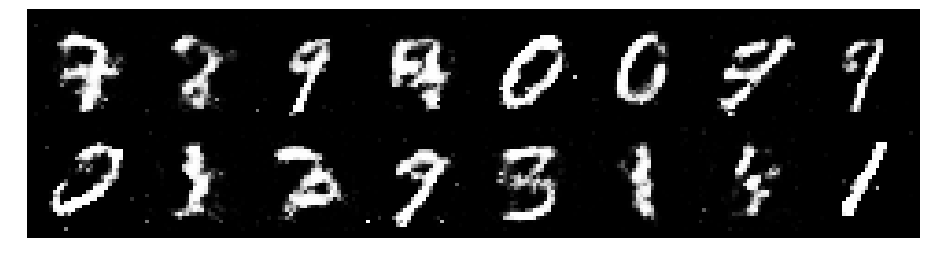

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.3371, Generator Loss: 0.9642
D(x): 0.5573, D(G(z)): 0.4549


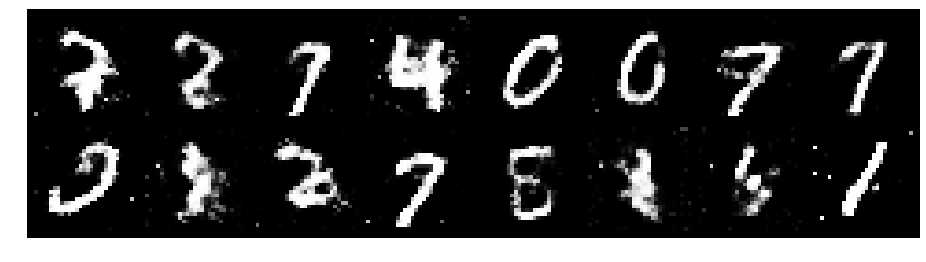

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.3128, Generator Loss: 0.9470
D(x): 0.5740, D(G(z)): 0.4493


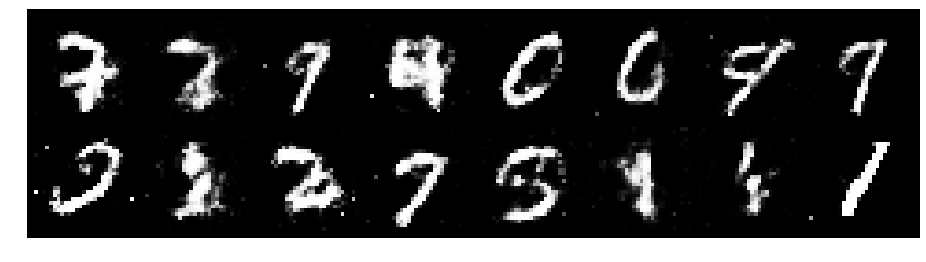

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.2654, Generator Loss: 1.2175
D(x): 0.5793, D(G(z)): 0.4352


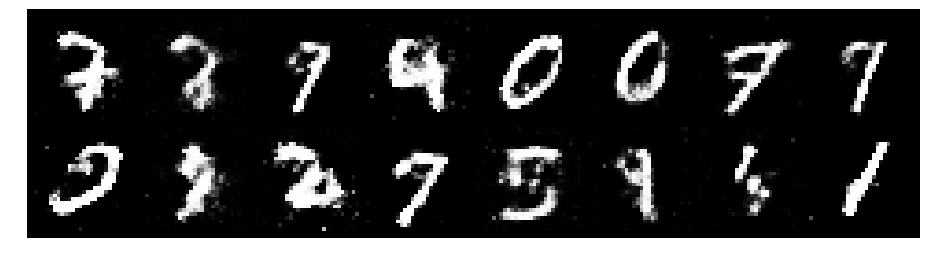

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.2008, Generator Loss: 0.9378
D(x): 0.5763, D(G(z)): 0.4186


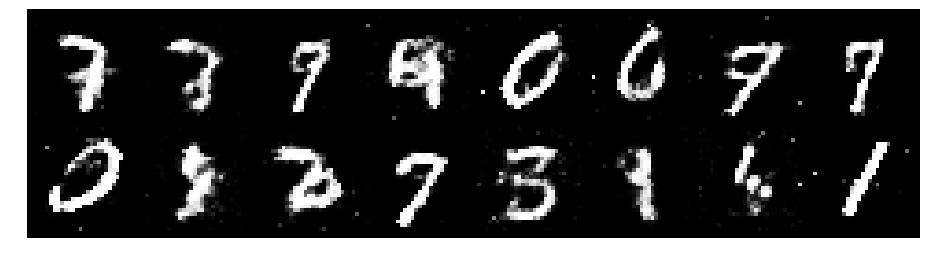

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.1639, Generator Loss: 1.0071
D(x): 0.6103, D(G(z)): 0.3951


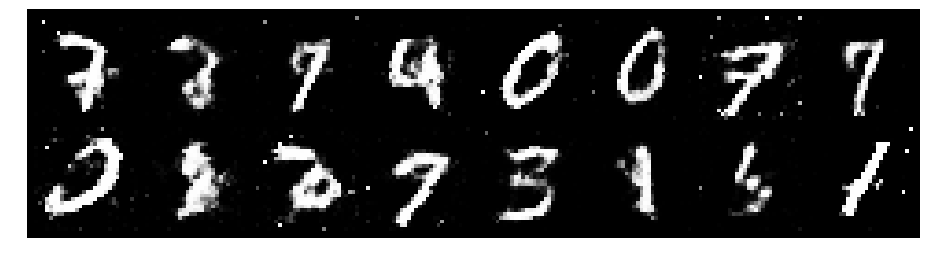

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.1248, Generator Loss: 1.0787
D(x): 0.5874, D(G(z)): 0.3746


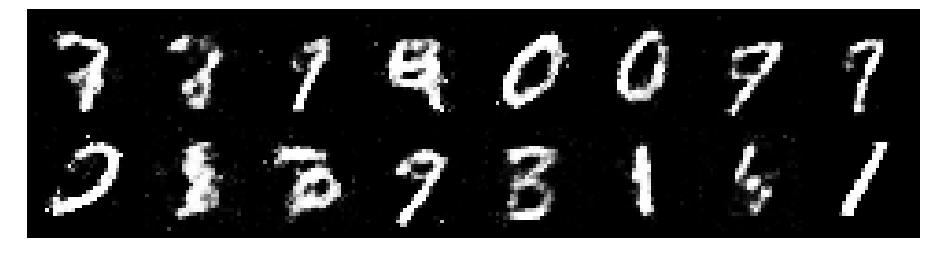

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.0825, Generator Loss: 1.2196
D(x): 0.6164, D(G(z)): 0.3685


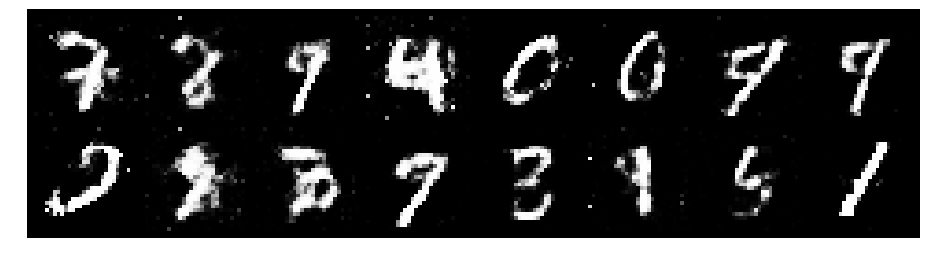

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.1471, Generator Loss: 1.0899
D(x): 0.5790, D(G(z)): 0.3888


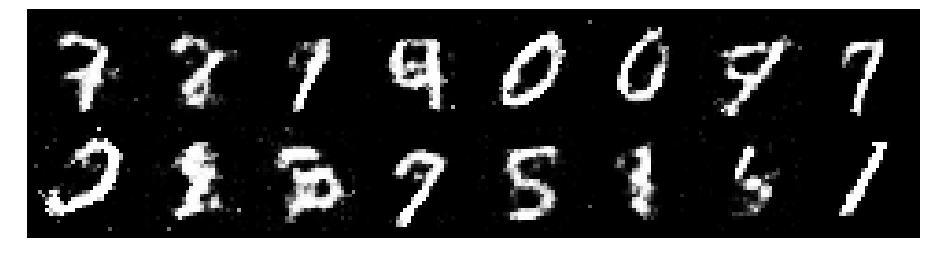

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.2552, Generator Loss: 0.9418
D(x): 0.5538, D(G(z)): 0.4219


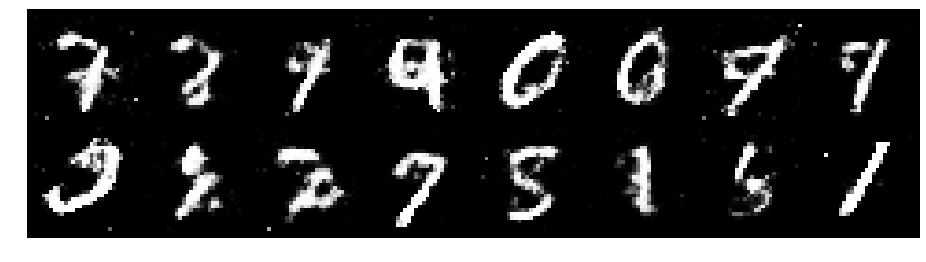

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.2902, Generator Loss: 0.8686
D(x): 0.5873, D(G(z)): 0.4684


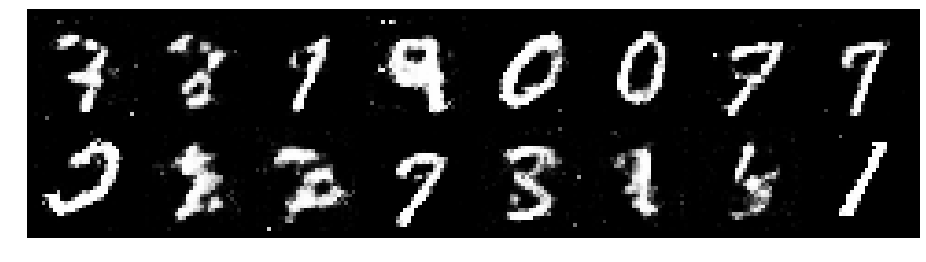

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.3071, Generator Loss: 0.8301
D(x): 0.5749, D(G(z)): 0.4714


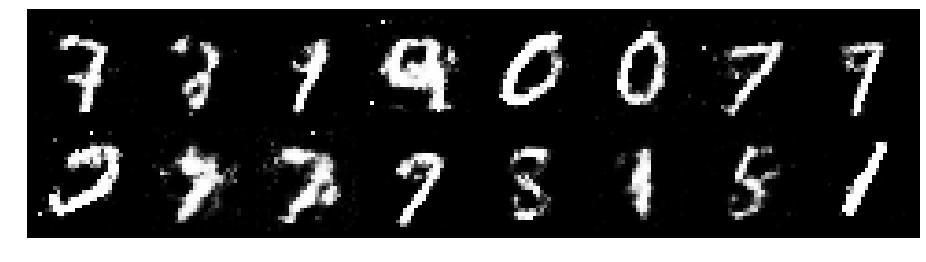

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.3409, Generator Loss: 0.9364
D(x): 0.5365, D(G(z)): 0.4399


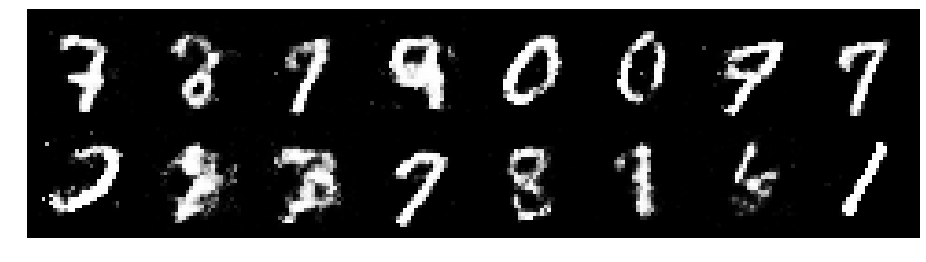

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.1675, Generator Loss: 0.9676
D(x): 0.6032, D(G(z)): 0.4408


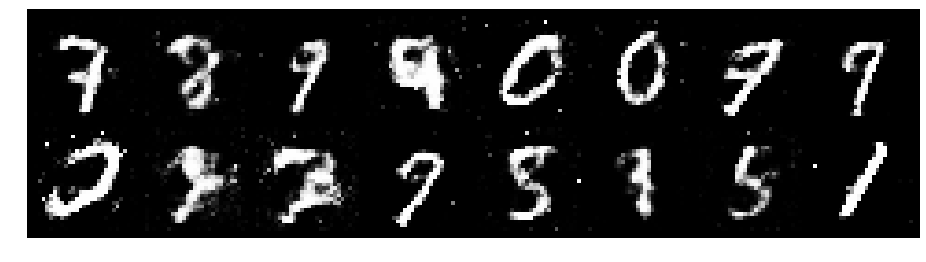

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.1486, Generator Loss: 1.0672
D(x): 0.6183, D(G(z)): 0.4131


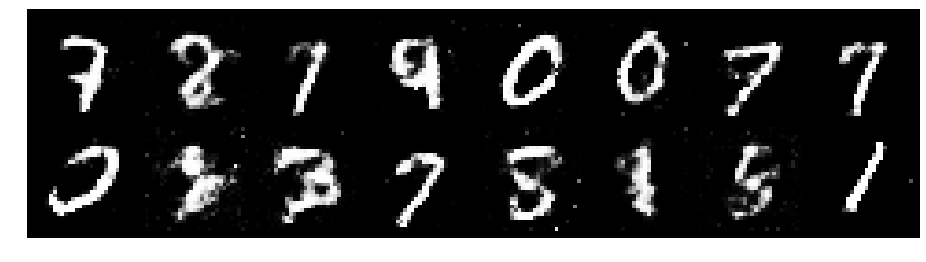

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.2095, Generator Loss: 1.0145
D(x): 0.6054, D(G(z)): 0.4311


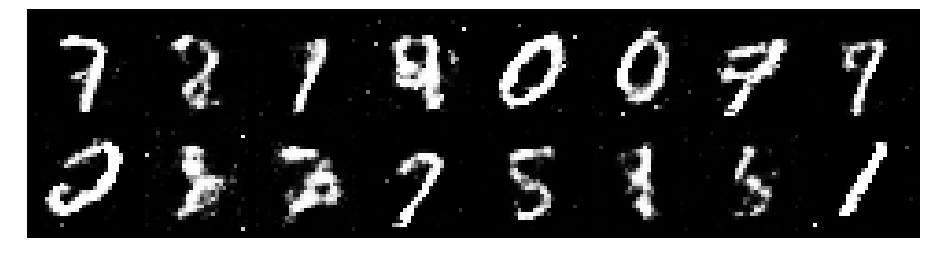

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.1510, Generator Loss: 1.3245
D(x): 0.6216, D(G(z)): 0.4060


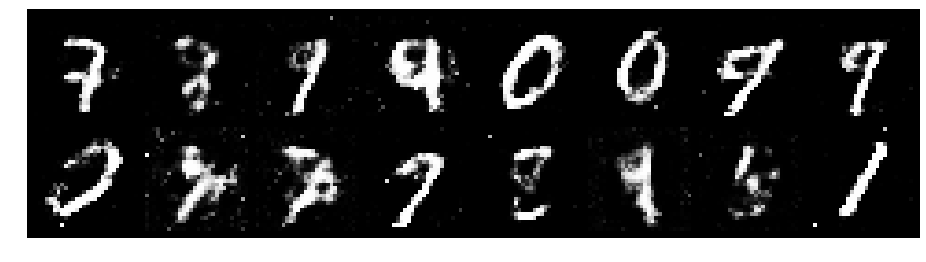

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.1172, Generator Loss: 1.1048
D(x): 0.6269, D(G(z)): 0.3935


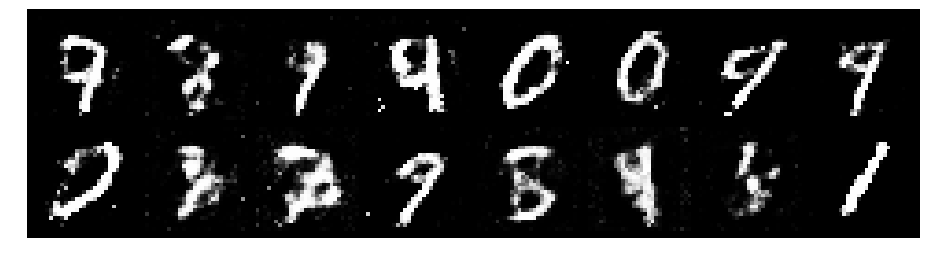

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.2667, Generator Loss: 1.1388
D(x): 0.5331, D(G(z)): 0.3650


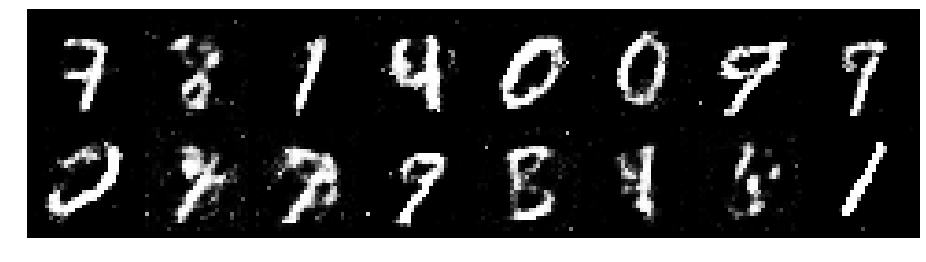

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.3220, Generator Loss: 0.9188
D(x): 0.5386, D(G(z)): 0.4236


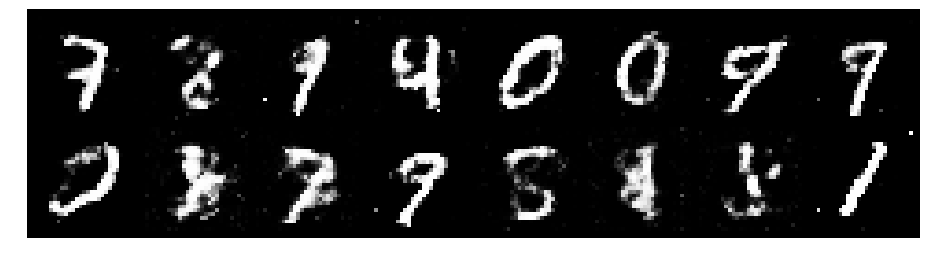

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.2717, Generator Loss: 1.2156
D(x): 0.5768, D(G(z)): 0.4077


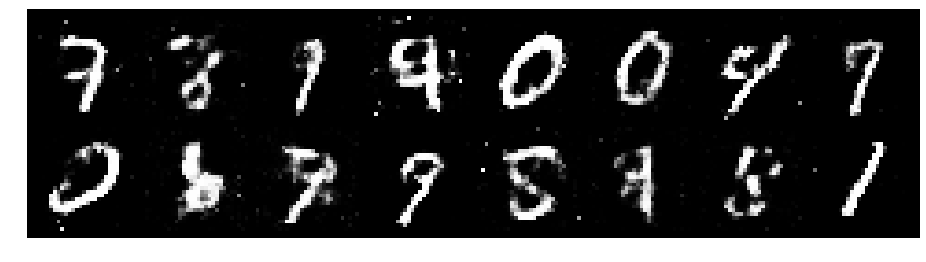

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.1914, Generator Loss: 0.9667
D(x): 0.6188, D(G(z)): 0.4241


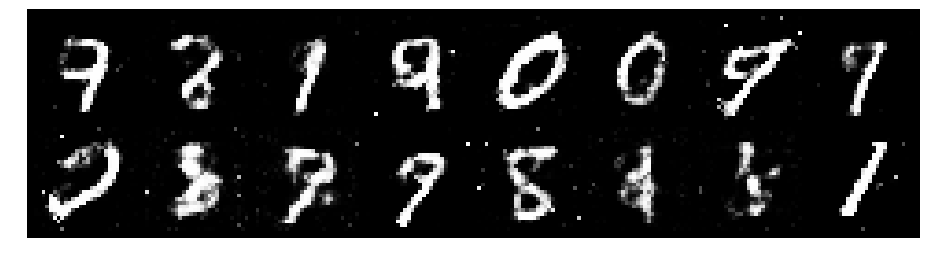

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.0464, Generator Loss: 1.0871
D(x): 0.6181, D(G(z)): 0.3622


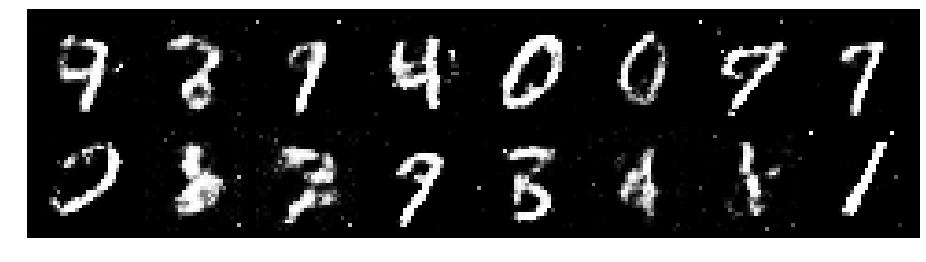

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.0686, Generator Loss: 1.2522
D(x): 0.5677, D(G(z)): 0.3087


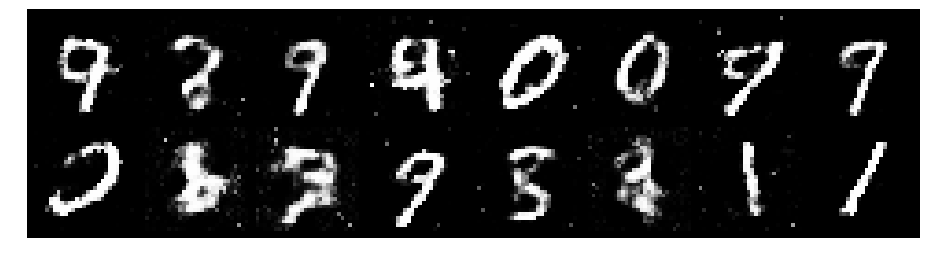

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.2021, Generator Loss: 1.0313
D(x): 0.6269, D(G(z)): 0.4360


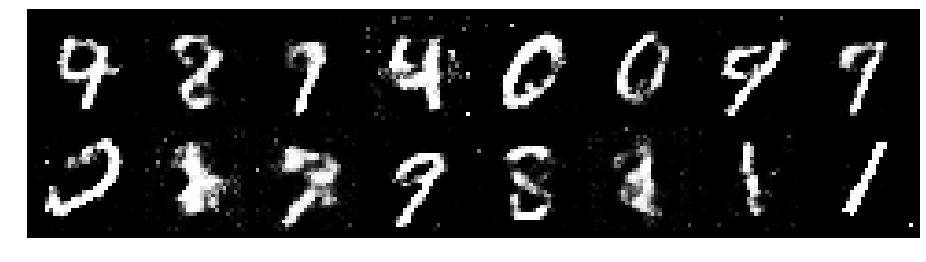

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.1070, Generator Loss: 0.8606
D(x): 0.6530, D(G(z)): 0.4283


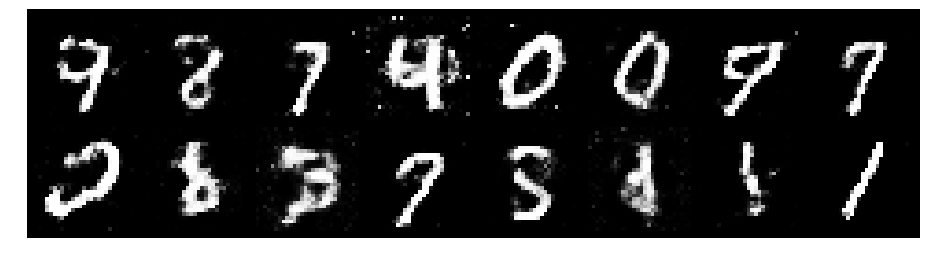

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.2202, Generator Loss: 1.0018
D(x): 0.5904, D(G(z)): 0.4431


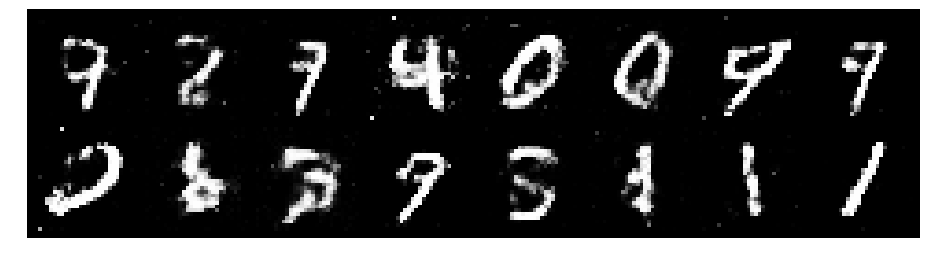

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.1921, Generator Loss: 0.9932
D(x): 0.5804, D(G(z)): 0.4261


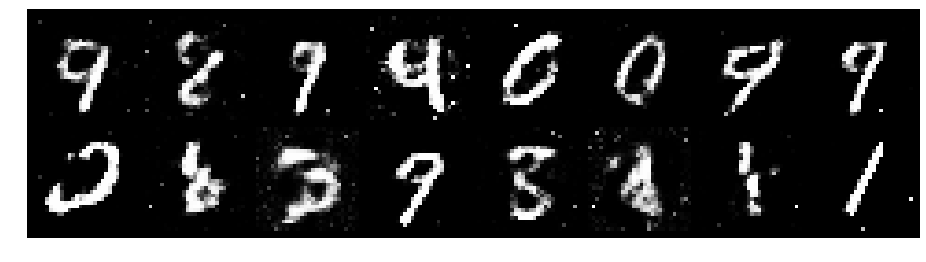

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.2027, Generator Loss: 0.9337
D(x): 0.5681, D(G(z)): 0.4195


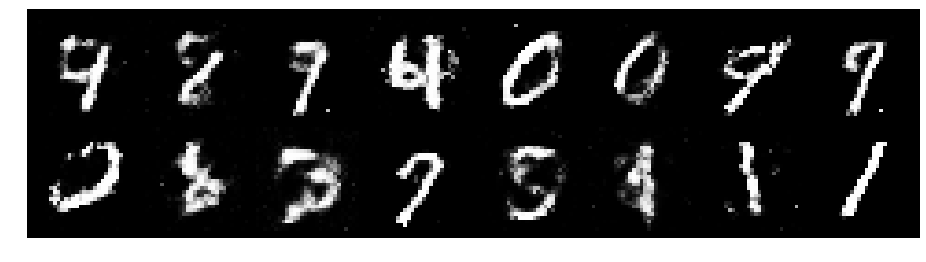

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.3787, Generator Loss: 0.9648
D(x): 0.5569, D(G(z)): 0.4268


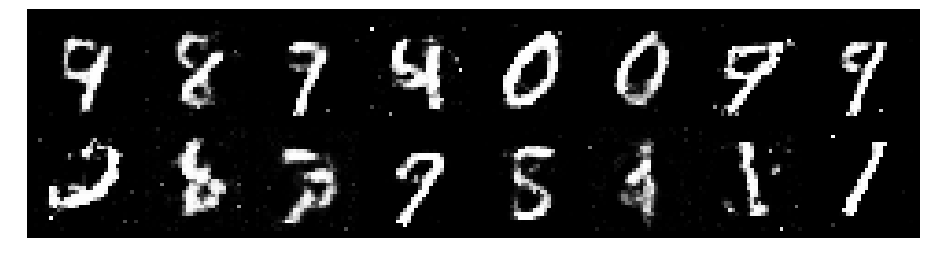

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.1137, Generator Loss: 0.9995
D(x): 0.6373, D(G(z)): 0.3891


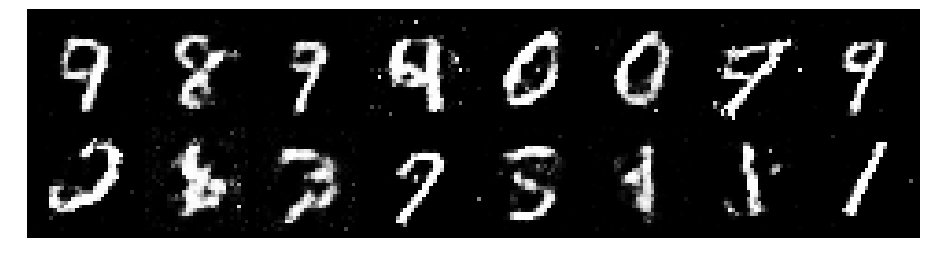

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.1975, Generator Loss: 1.0487
D(x): 0.6235, D(G(z)): 0.4438


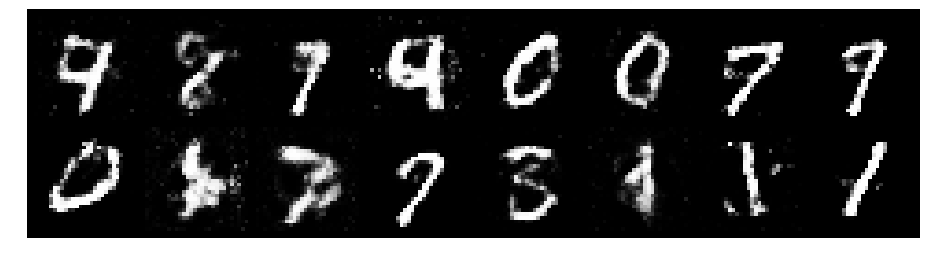

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.2821, Generator Loss: 0.9359
D(x): 0.5315, D(G(z)): 0.4101


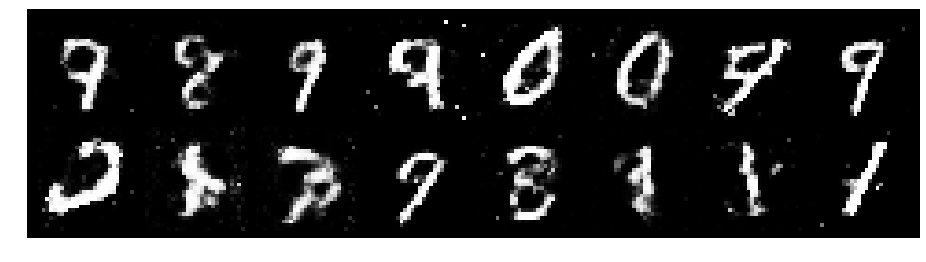

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.2632, Generator Loss: 1.0523
D(x): 0.5498, D(G(z)): 0.4048


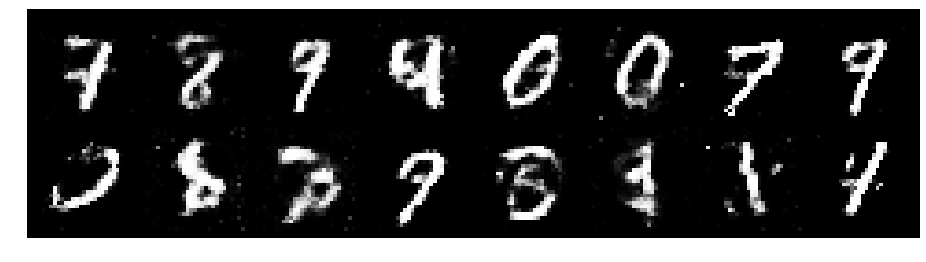

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.2135, Generator Loss: 0.9057
D(x): 0.5576, D(G(z)): 0.4230


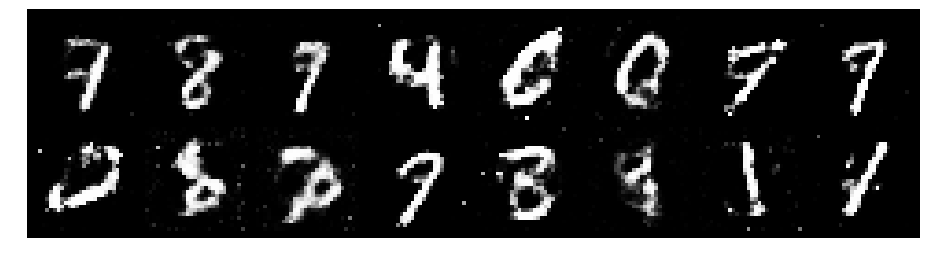

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.2796, Generator Loss: 0.8540
D(x): 0.5851, D(G(z)): 0.4667


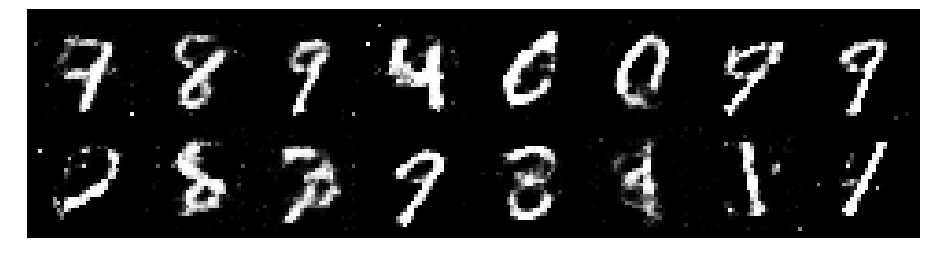

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.3088, Generator Loss: 0.9028
D(x): 0.5342, D(G(z)): 0.4110


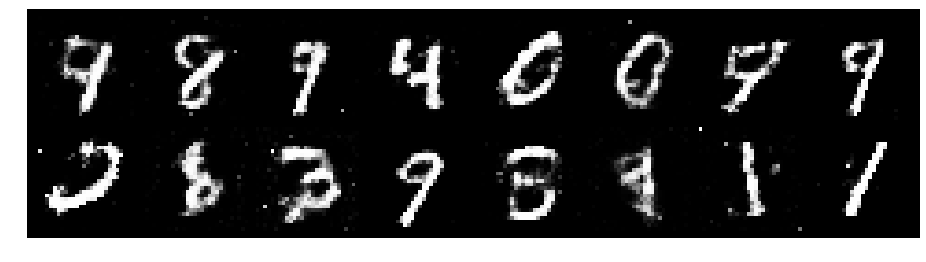

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.2696, Generator Loss: 0.9438
D(x): 0.5592, D(G(z)): 0.4478


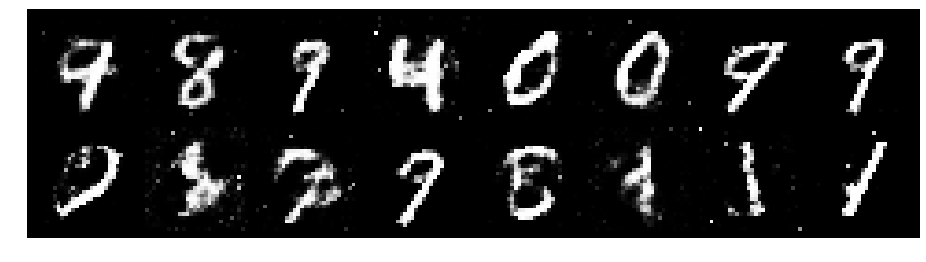

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.1890, Generator Loss: 0.8785
D(x): 0.5851, D(G(z)): 0.4245


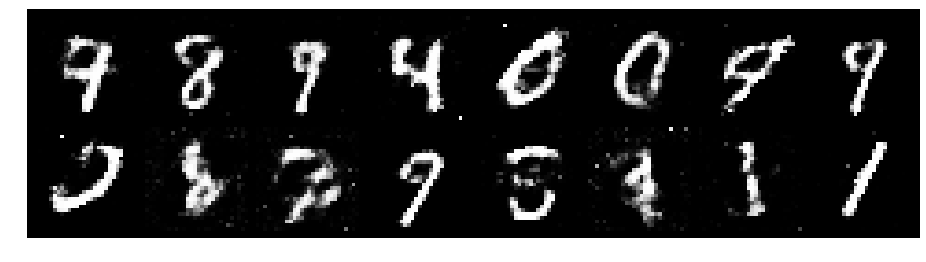

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.2500, Generator Loss: 0.9822
D(x): 0.5505, D(G(z)): 0.4080


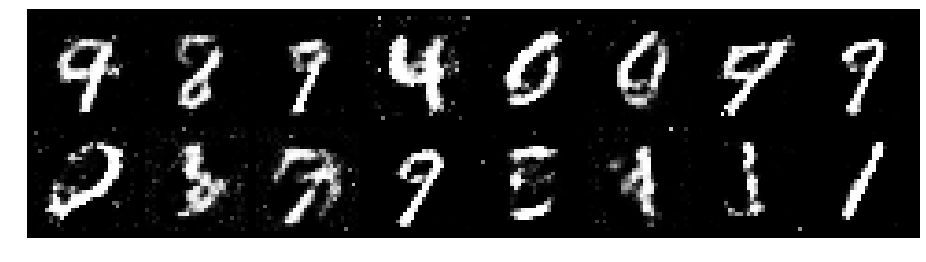

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.2309, Generator Loss: 0.8906
D(x): 0.5747, D(G(z)): 0.4473


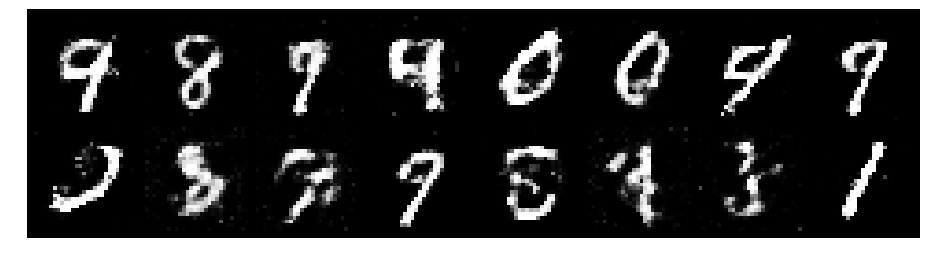

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.1148, Generator Loss: 0.9719
D(x): 0.5792, D(G(z)): 0.3871


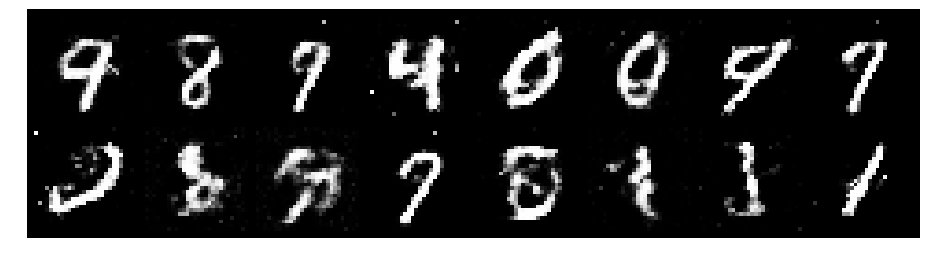

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.2434, Generator Loss: 0.9521
D(x): 0.5723, D(G(z)): 0.4372


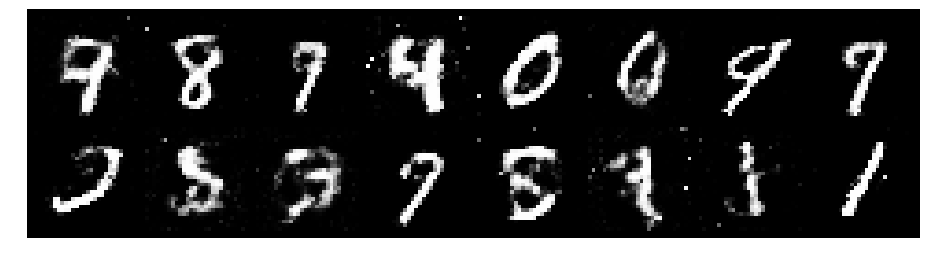

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.2326, Generator Loss: 1.1554
D(x): 0.6184, D(G(z)): 0.4253


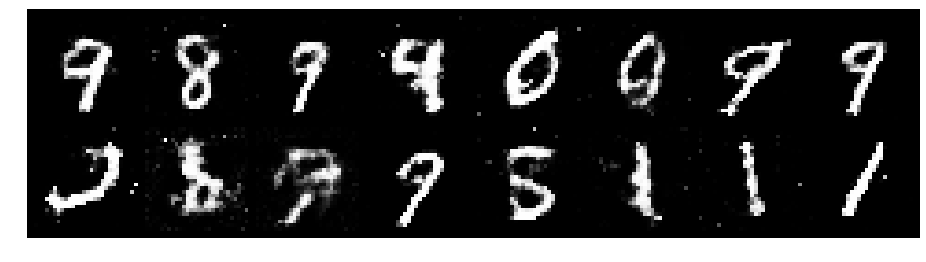

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.1747, Generator Loss: 1.2165
D(x): 0.5572, D(G(z)): 0.3821


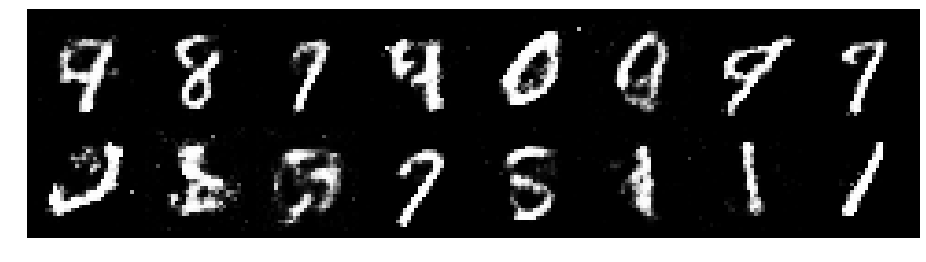

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.1154, Generator Loss: 1.1612
D(x): 0.5925, D(G(z)): 0.3443


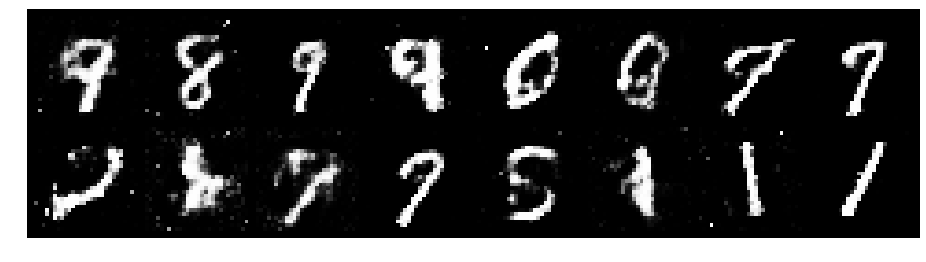

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.0870, Generator Loss: 1.1038
D(x): 0.6193, D(G(z)): 0.3913


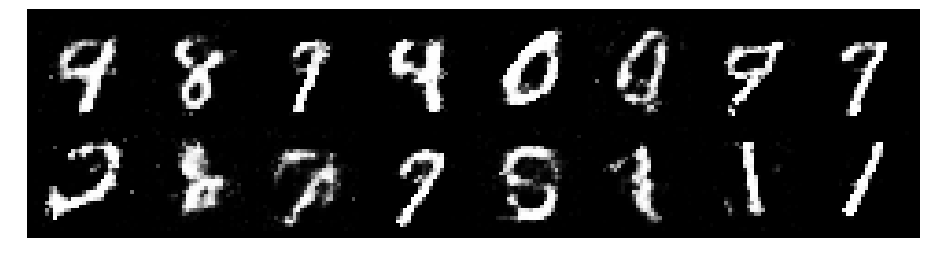

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.3432, Generator Loss: 0.9278
D(x): 0.6043, D(G(z)): 0.4756


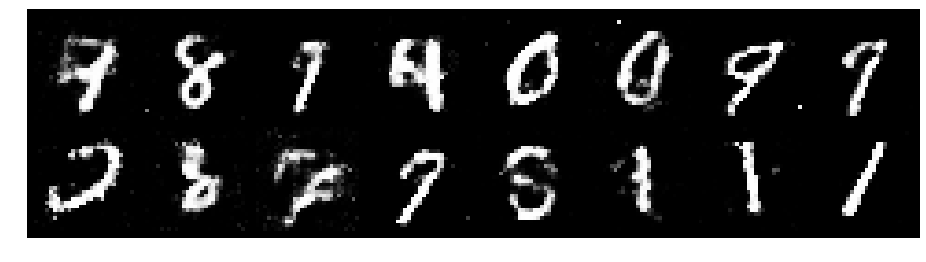

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.1782, Generator Loss: 1.0568
D(x): 0.5733, D(G(z)): 0.4108


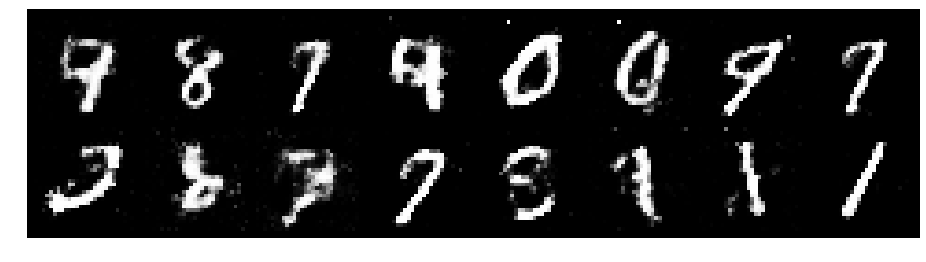

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.0910, Generator Loss: 1.0335
D(x): 0.5957, D(G(z)): 0.3915


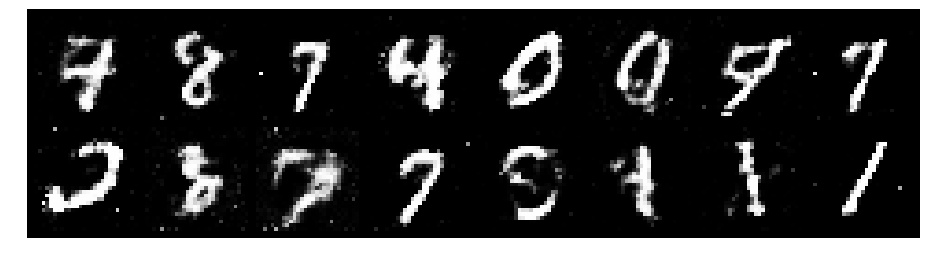

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.1726, Generator Loss: 1.1261
D(x): 0.6141, D(G(z)): 0.4089


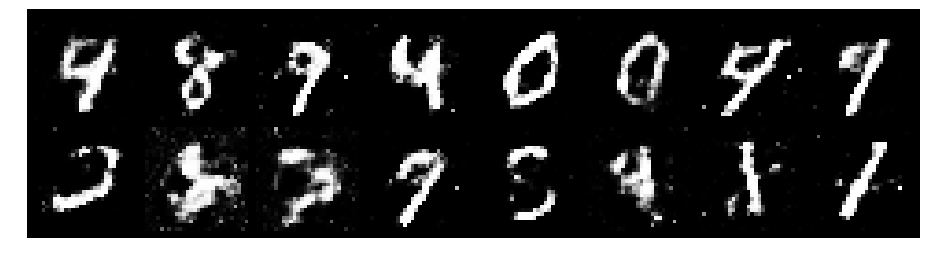

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.2241, Generator Loss: 1.0373
D(x): 0.5253, D(G(z)): 0.3992


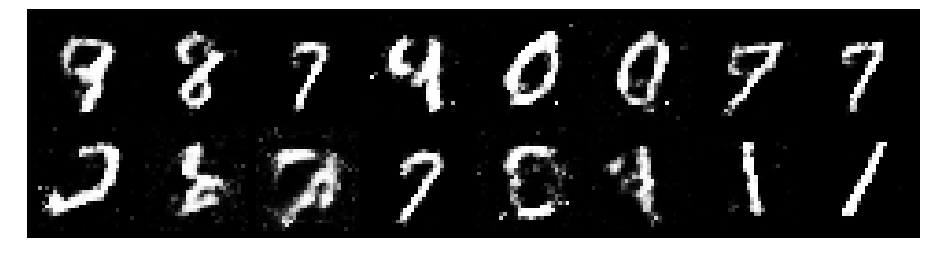

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.2519, Generator Loss: 0.9497
D(x): 0.5777, D(G(z)): 0.4388


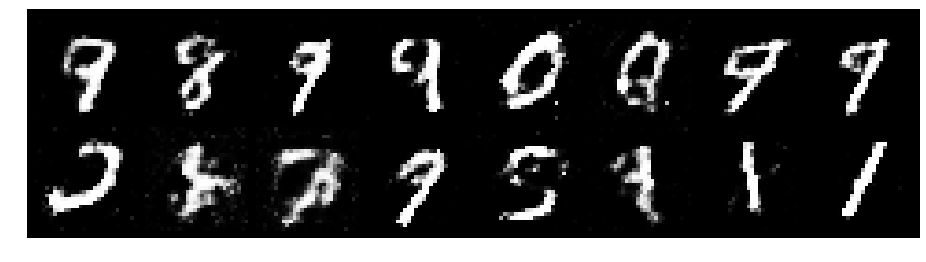

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.3198, Generator Loss: 0.7854
D(x): 0.5537, D(G(z)): 0.4595


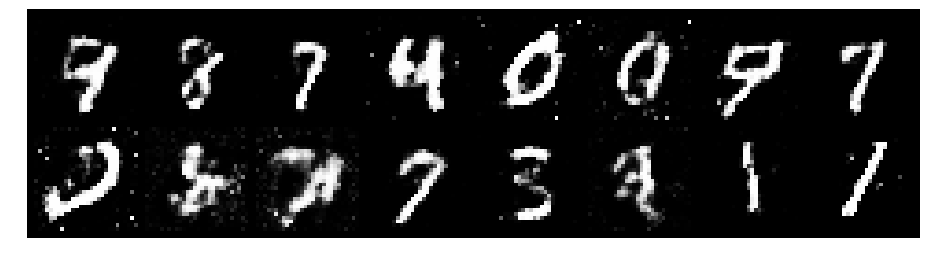

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.3270, Generator Loss: 0.8962
D(x): 0.5658, D(G(z)): 0.4816


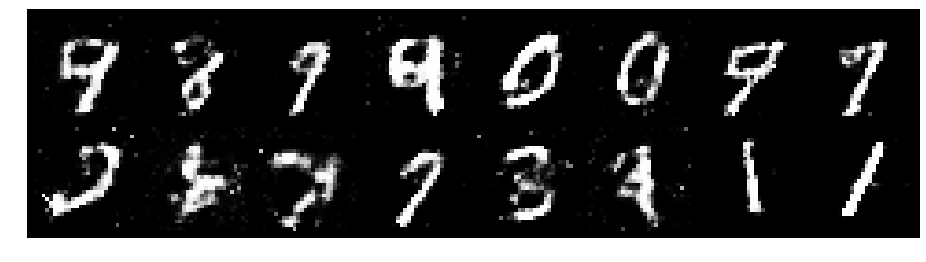

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.1785, Generator Loss: 0.9456
D(x): 0.6043, D(G(z)): 0.4214


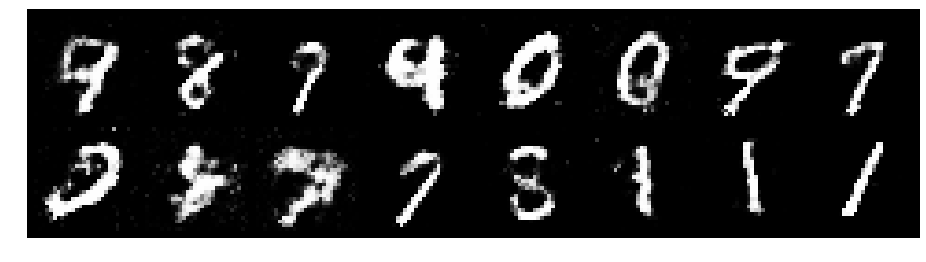

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.2236, Generator Loss: 1.1524
D(x): 0.6178, D(G(z)): 0.4418


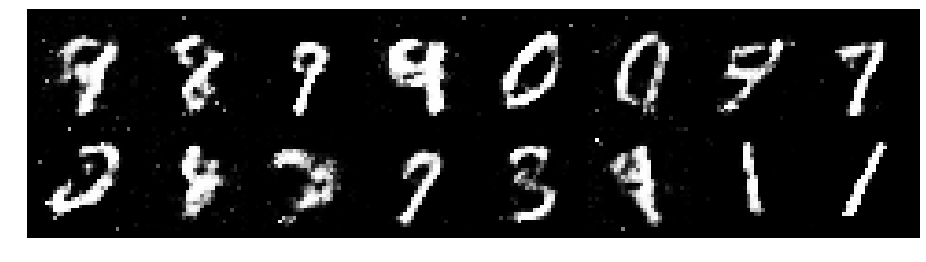

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.2248, Generator Loss: 1.0297
D(x): 0.5758, D(G(z)): 0.4174


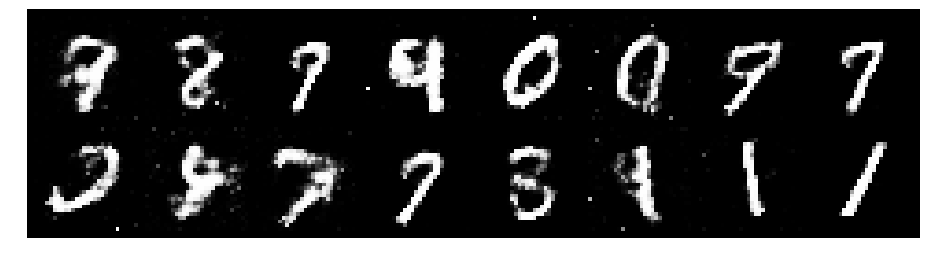

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.2701, Generator Loss: 0.8693
D(x): 0.5476, D(G(z)): 0.4329


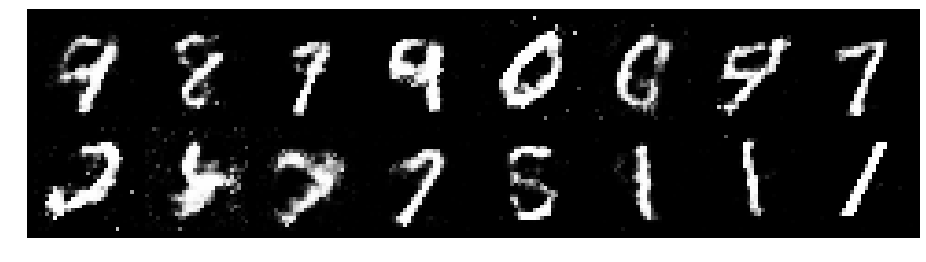

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.3017, Generator Loss: 0.9816
D(x): 0.5837, D(G(z)): 0.4637


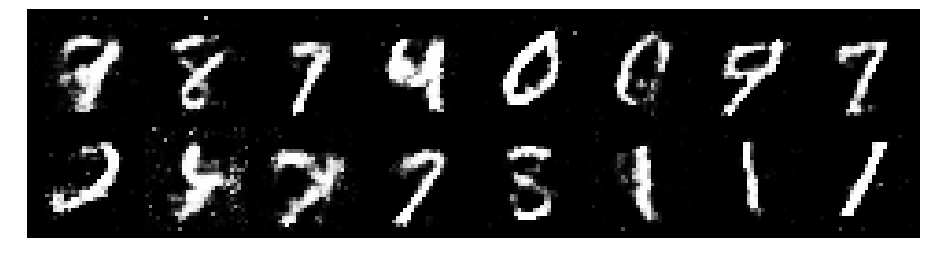

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.3351, Generator Loss: 0.9686
D(x): 0.5432, D(G(z)): 0.4255


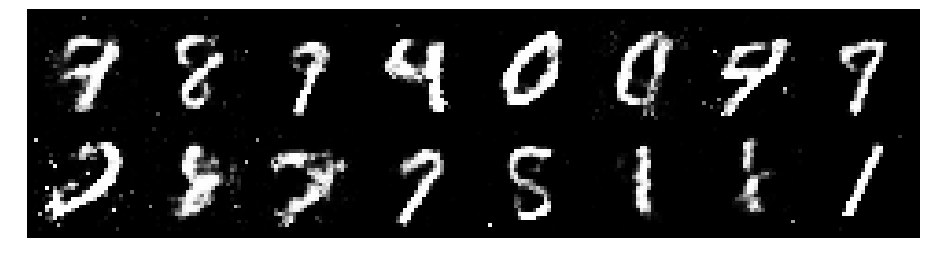

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.3689, Generator Loss: 0.9334
D(x): 0.5287, D(G(z)): 0.4494


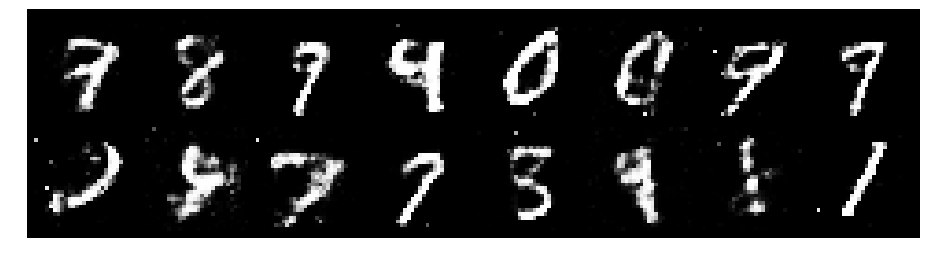

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.2740, Generator Loss: 1.0275
D(x): 0.5565, D(G(z)): 0.4363


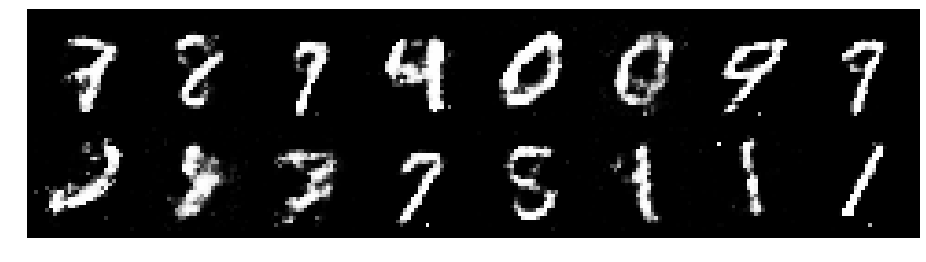

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.2803, Generator Loss: 1.0574
D(x): 0.5521, D(G(z)): 0.4301


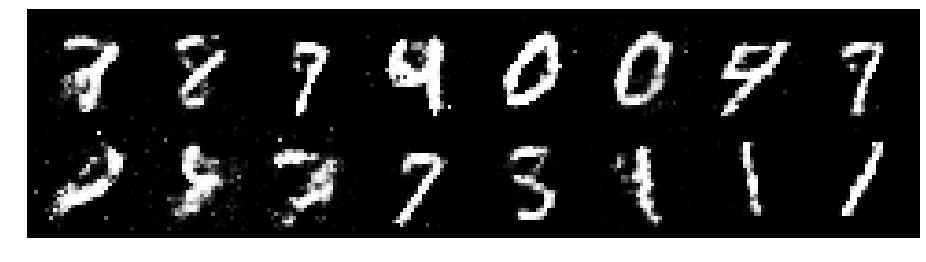

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.2069, Generator Loss: 0.8810
D(x): 0.6304, D(G(z)): 0.4840


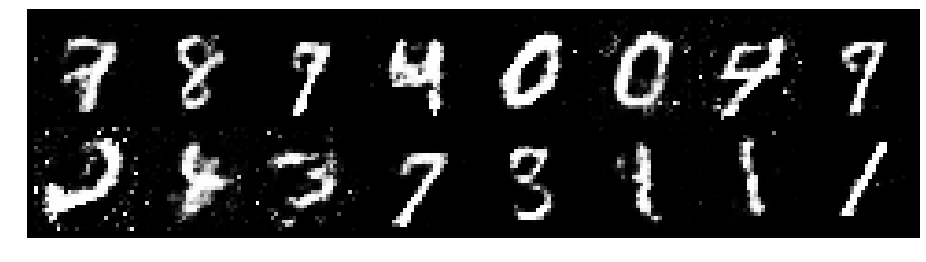

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.3197, Generator Loss: 0.8149
D(x): 0.5269, D(G(z)): 0.4437


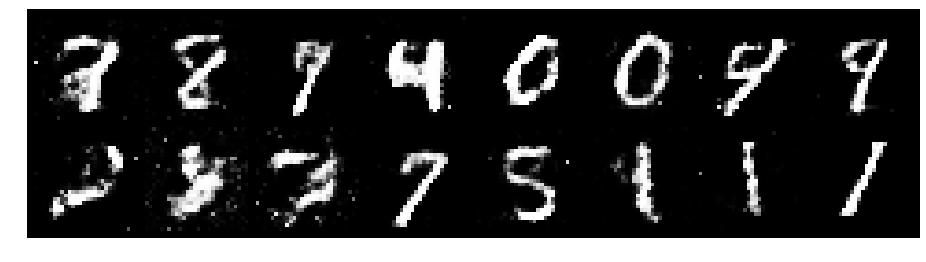

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.2842, Generator Loss: 0.8779
D(x): 0.5274, D(G(z)): 0.4307


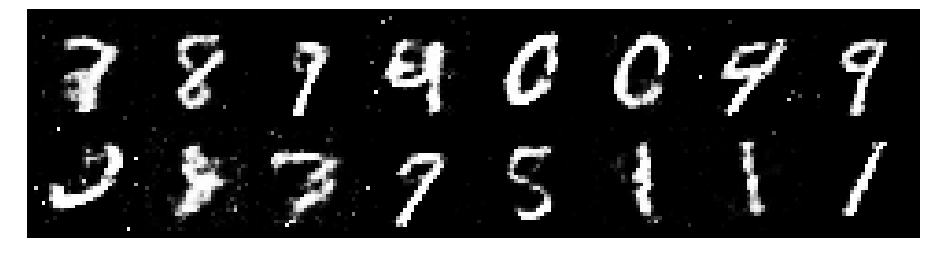

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.2876, Generator Loss: 0.9872
D(x): 0.5228, D(G(z)): 0.4140


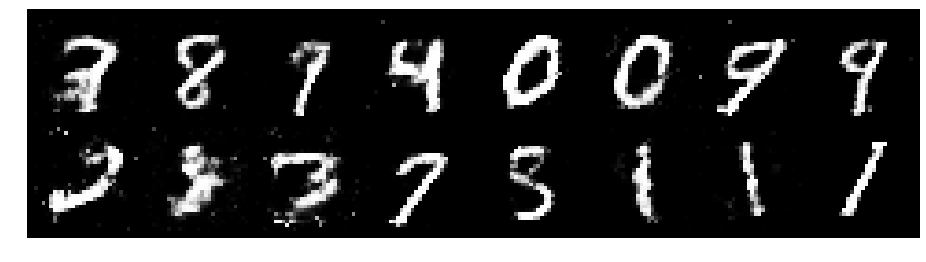

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.2325, Generator Loss: 0.9462
D(x): 0.5448, D(G(z)): 0.4224


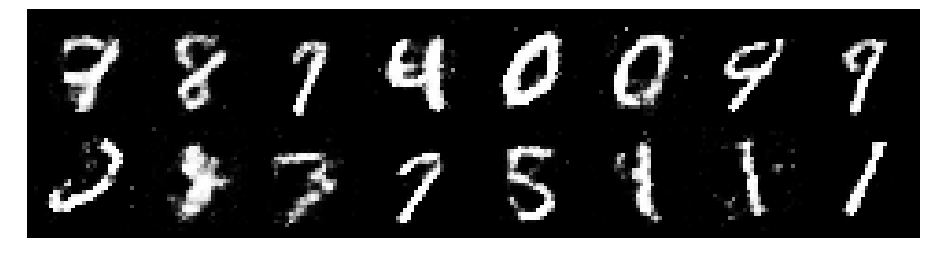

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.3353, Generator Loss: 0.9581
D(x): 0.5358, D(G(z)): 0.4416


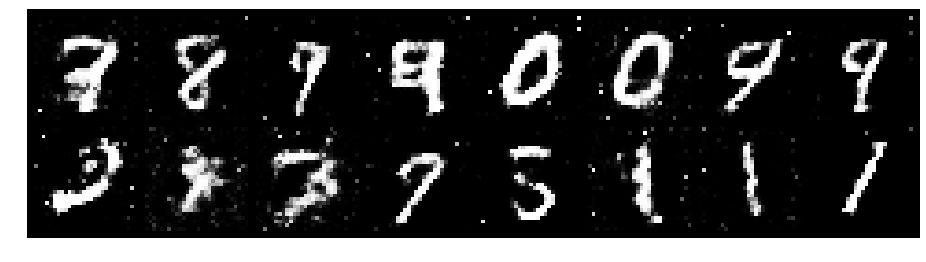

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.2205, Generator Loss: 1.1569
D(x): 0.5807, D(G(z)): 0.4238


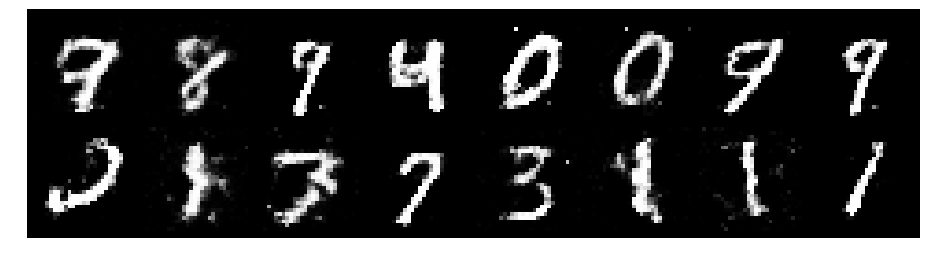

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.2620, Generator Loss: 0.8749
D(x): 0.5591, D(G(z)): 0.4545


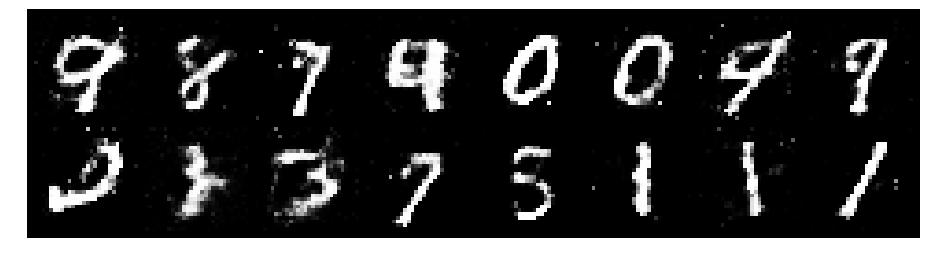

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.4157, Generator Loss: 0.9543
D(x): 0.4933, D(G(z)): 0.4446


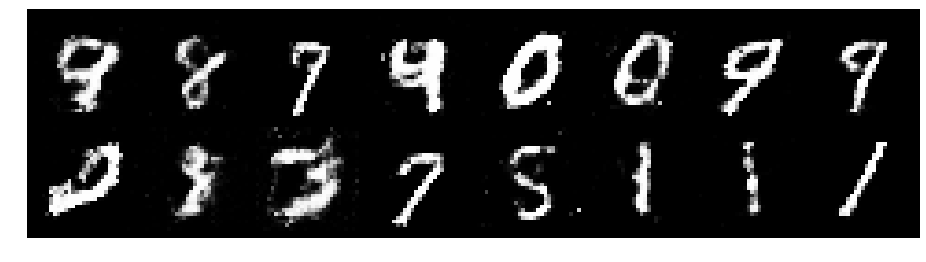

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.2536, Generator Loss: 1.0741
D(x): 0.5724, D(G(z)): 0.4216


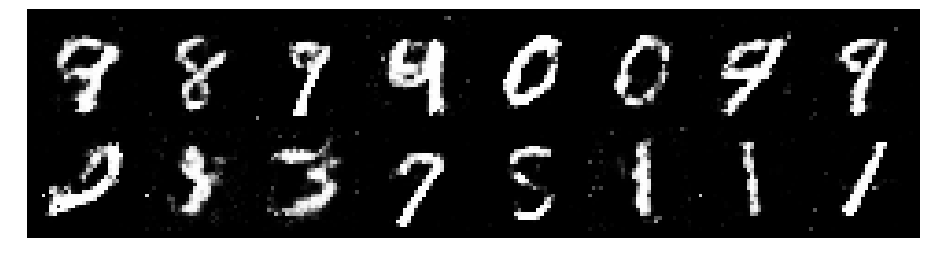

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.1636, Generator Loss: 1.0917
D(x): 0.6395, D(G(z)): 0.4450


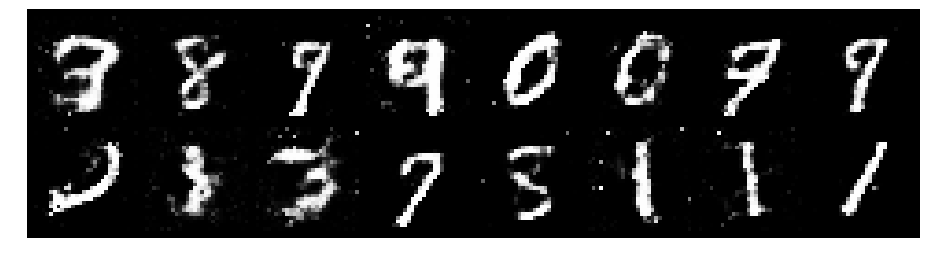

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.2110, Generator Loss: 0.9751
D(x): 0.5698, D(G(z)): 0.4071


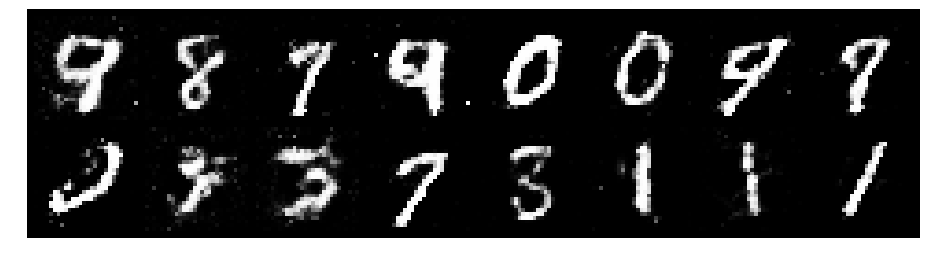

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.1289, Generator Loss: 1.0713
D(x): 0.6029, D(G(z)): 0.3625


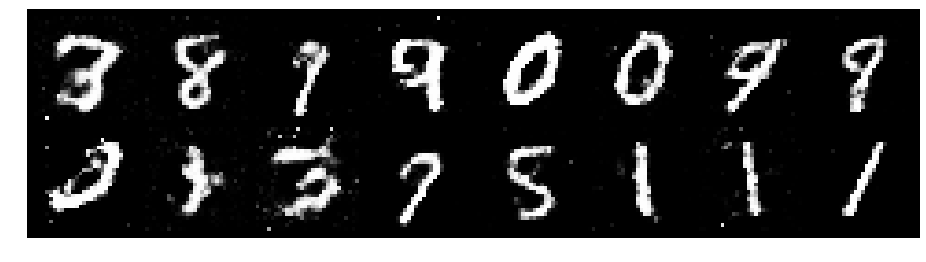

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.0393, Generator Loss: 1.2649
D(x): 0.5939, D(G(z)): 0.3194


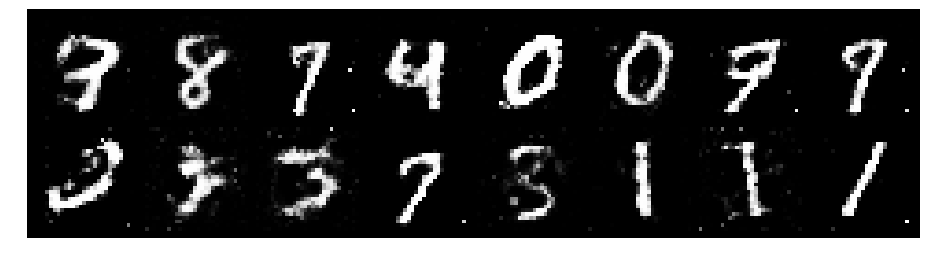

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.1379, Generator Loss: 1.0351
D(x): 0.5889, D(G(z)): 0.4025


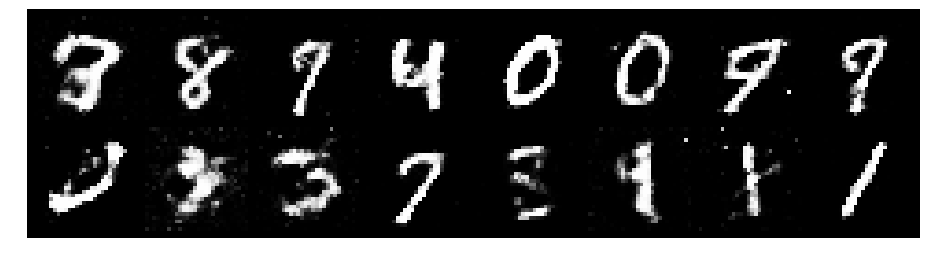

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.0913, Generator Loss: 1.1069
D(x): 0.5533, D(G(z)): 0.3453


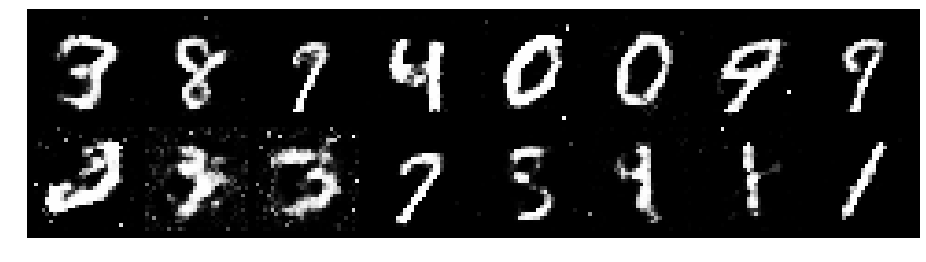

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.3074, Generator Loss: 1.0612
D(x): 0.5566, D(G(z)): 0.4421


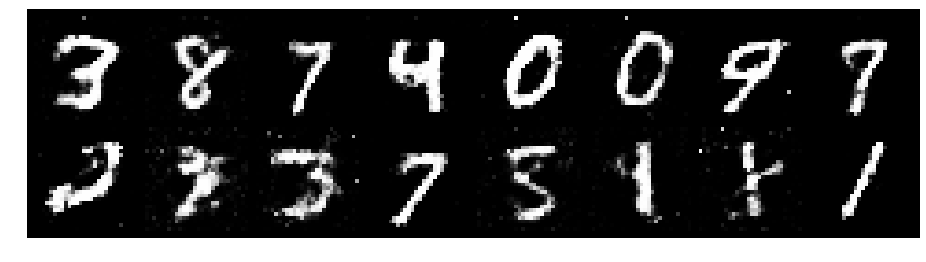

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.2977, Generator Loss: 1.0399
D(x): 0.5505, D(G(z)): 0.4361


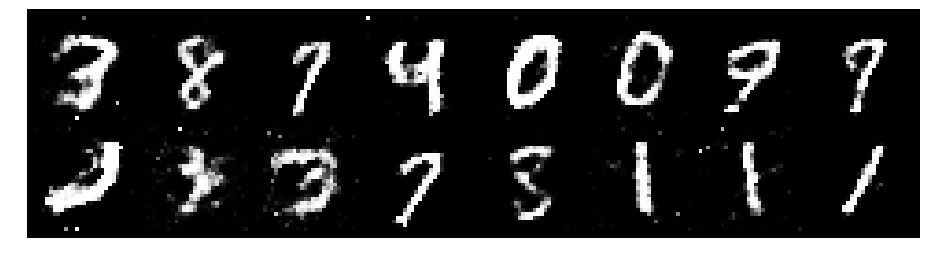

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.0991, Generator Loss: 0.9467
D(x): 0.6068, D(G(z)): 0.3982


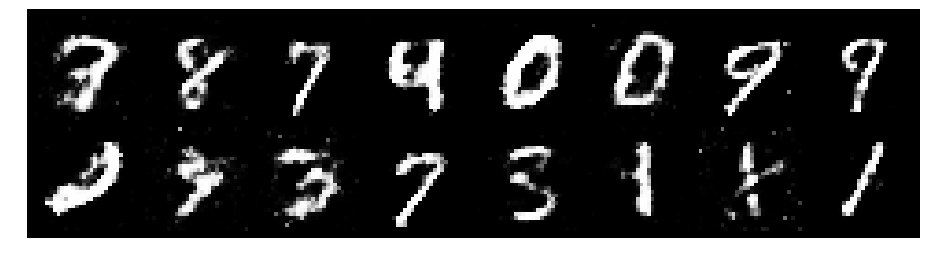

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.2441, Generator Loss: 0.9423
D(x): 0.5619, D(G(z)): 0.4244


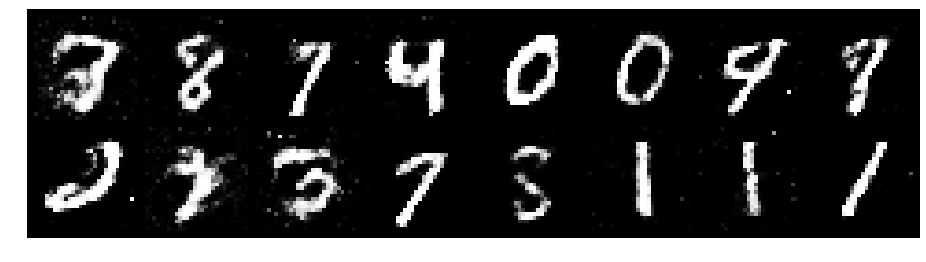

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.2279, Generator Loss: 0.9431
D(x): 0.5510, D(G(z)): 0.4348


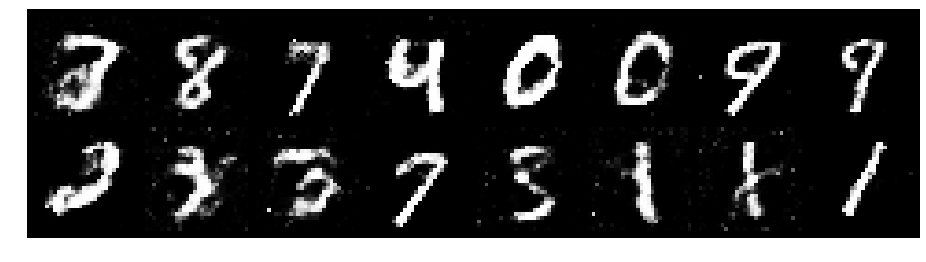

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.2448, Generator Loss: 0.8878
D(x): 0.5871, D(G(z)): 0.4569


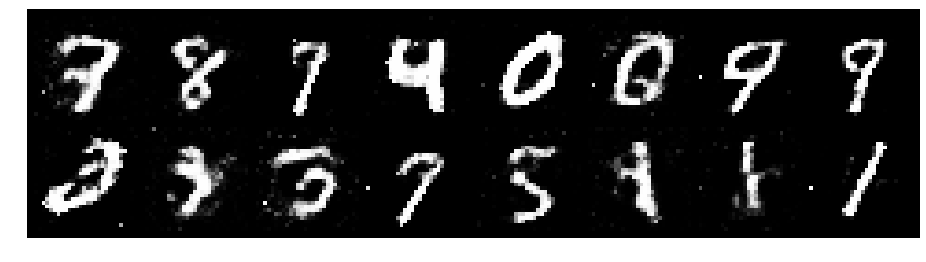

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.1926, Generator Loss: 0.9930
D(x): 0.6165, D(G(z)): 0.4345


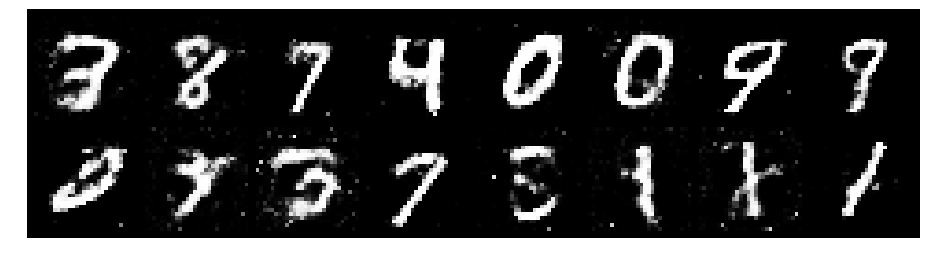

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.1660, Generator Loss: 0.9476
D(x): 0.5989, D(G(z)): 0.4213


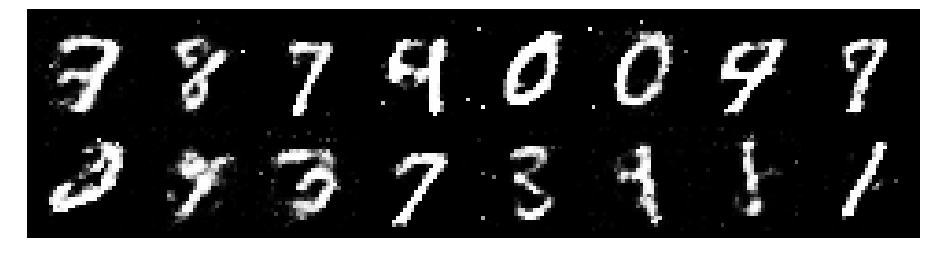

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.1899, Generator Loss: 1.0720
D(x): 0.6852, D(G(z)): 0.4861


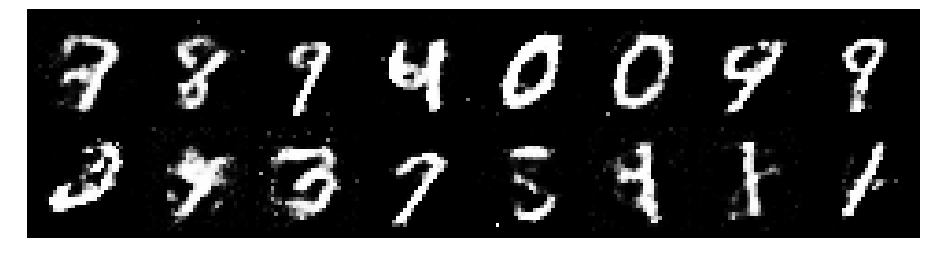

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.2271, Generator Loss: 1.1377
D(x): 0.6584, D(G(z)): 0.4682


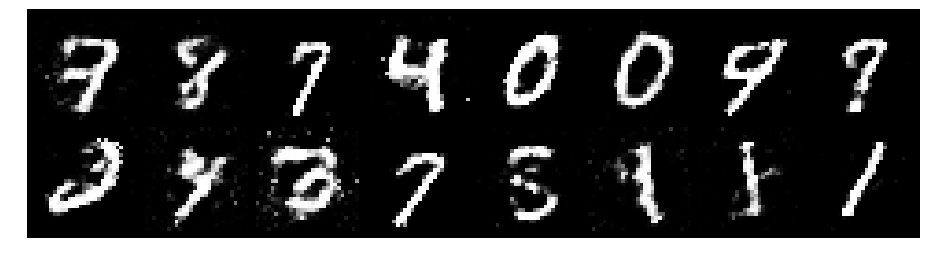

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.2779, Generator Loss: 0.9325
D(x): 0.5713, D(G(z)): 0.4216


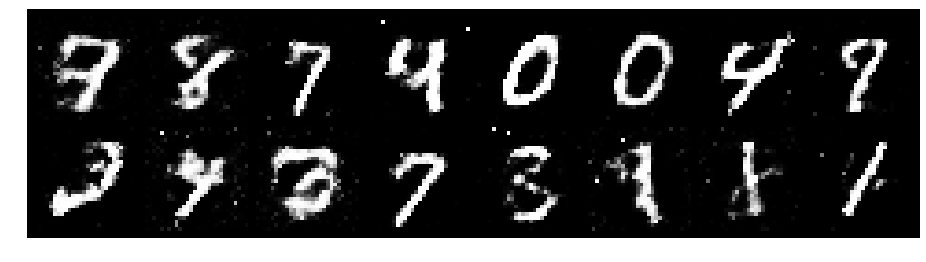

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.1118, Generator Loss: 1.0667
D(x): 0.5766, D(G(z)): 0.3699


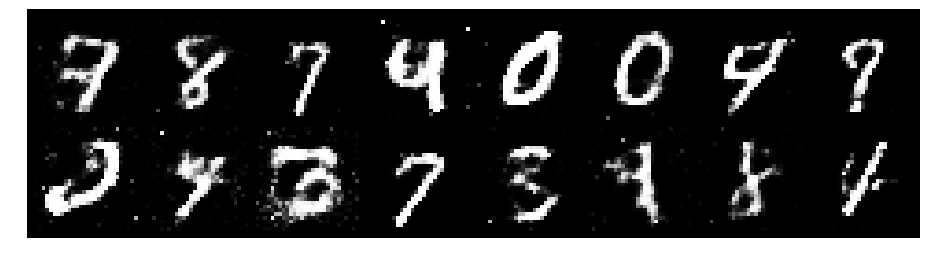

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.2768, Generator Loss: 1.0591
D(x): 0.5749, D(G(z)): 0.4360


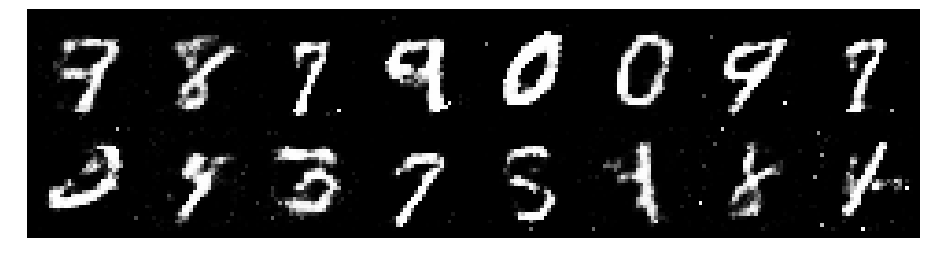

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.2475, Generator Loss: 0.8782
D(x): 0.5450, D(G(z)): 0.4439


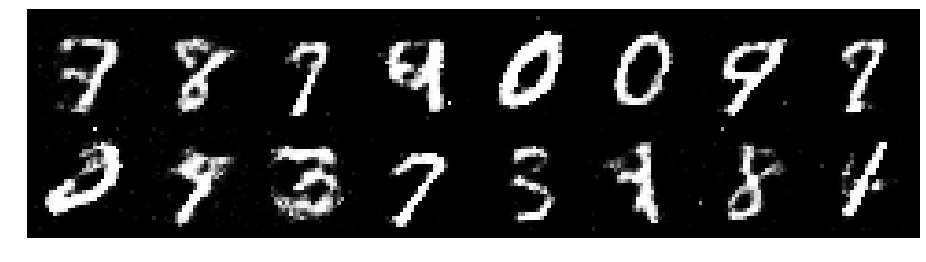

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.3237, Generator Loss: 1.0315
D(x): 0.5551, D(G(z)): 0.4604


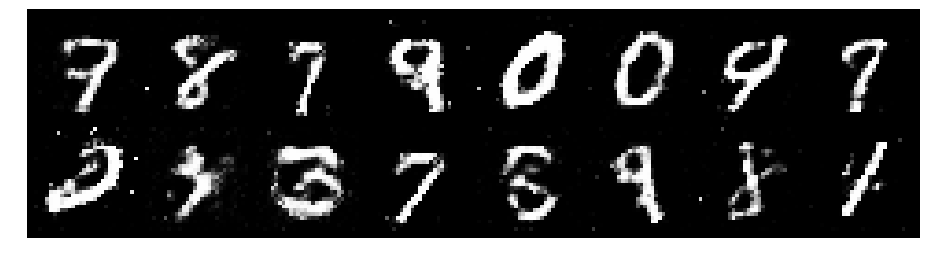

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.1469, Generator Loss: 1.1352
D(x): 0.5687, D(G(z)): 0.3671


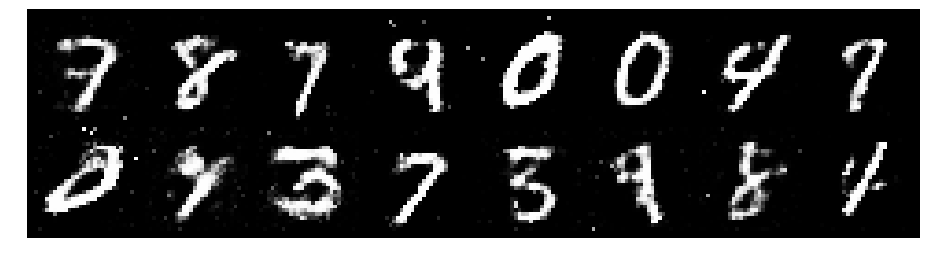

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.2196, Generator Loss: 1.2272
D(x): 0.5963, D(G(z)): 0.3878


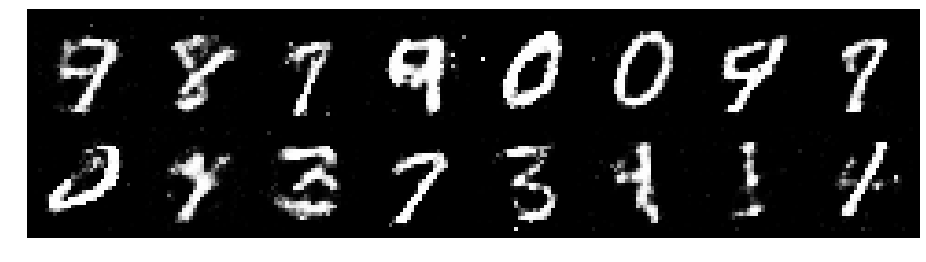

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.2940, Generator Loss: 0.8748
D(x): 0.5333, D(G(z)): 0.4464


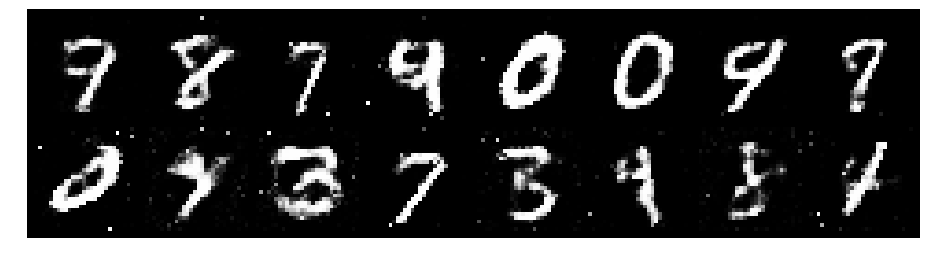

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.1935, Generator Loss: 1.0433
D(x): 0.5599, D(G(z)): 0.4011


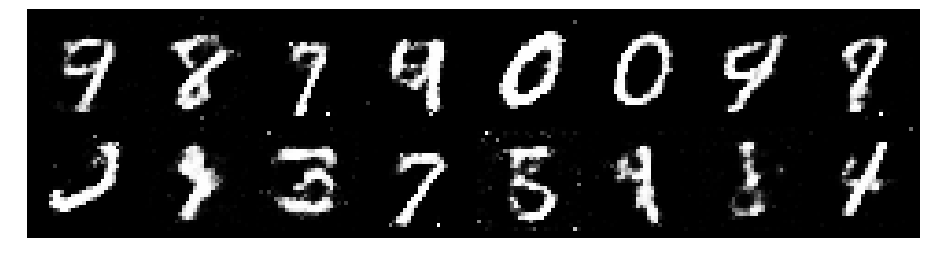

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.2545, Generator Loss: 1.0415
D(x): 0.5661, D(G(z)): 0.4186


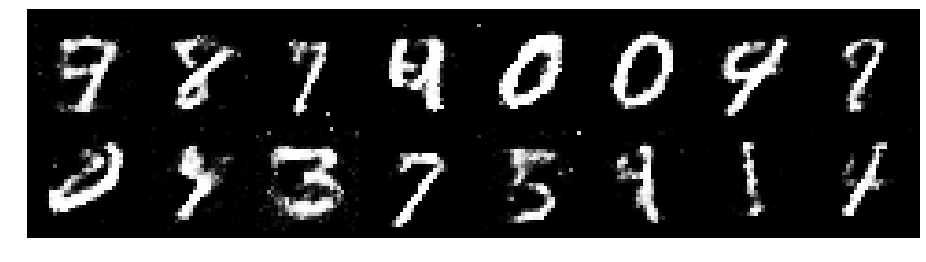

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.2933, Generator Loss: 0.9565
D(x): 0.6207, D(G(z)): 0.4892


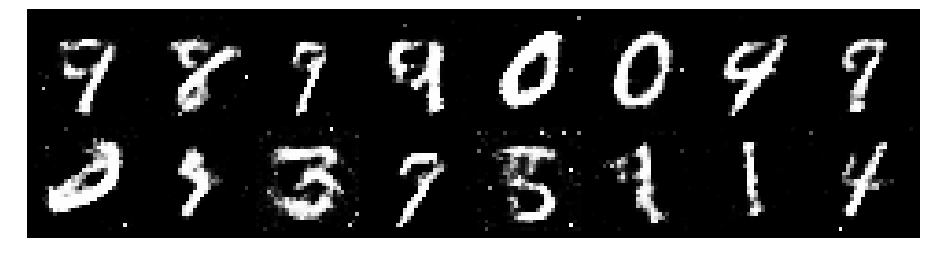

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.2715, Generator Loss: 0.8102
D(x): 0.5898, D(G(z)): 0.4701


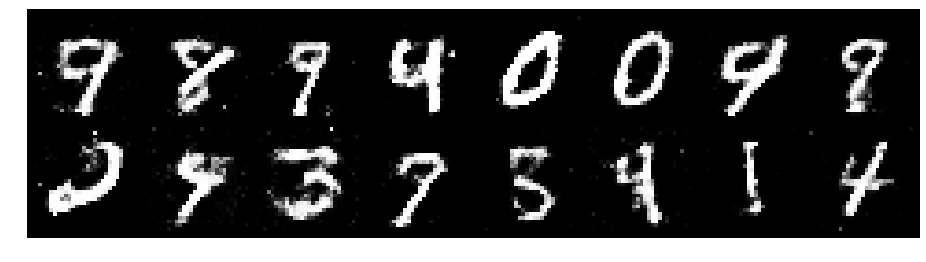

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.3929, Generator Loss: 0.8678
D(x): 0.5979, D(G(z)): 0.5264


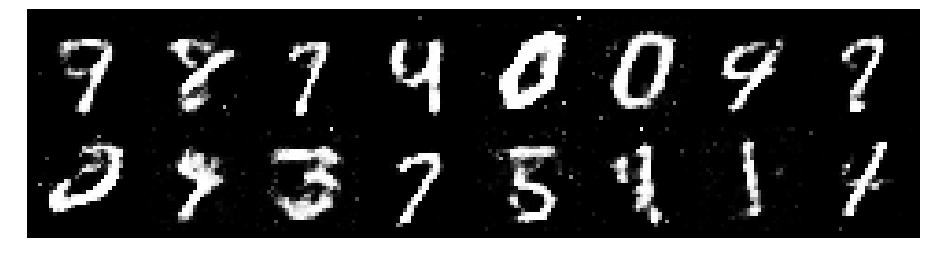

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.3662, Generator Loss: 1.0277
D(x): 0.5274, D(G(z)): 0.4443


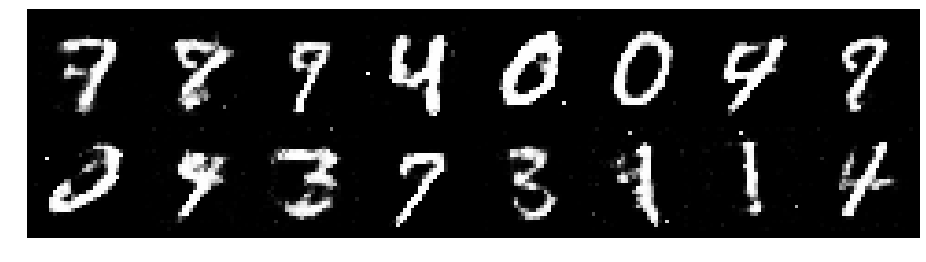

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2519, Generator Loss: 0.8986
D(x): 0.5561, D(G(z)): 0.4266


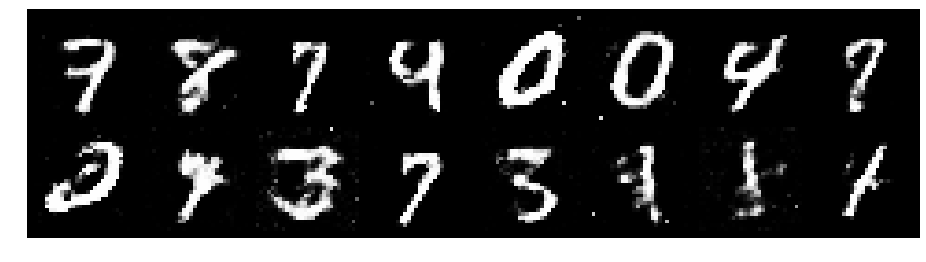

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.2802, Generator Loss: 0.9031
D(x): 0.5361, D(G(z)): 0.4180


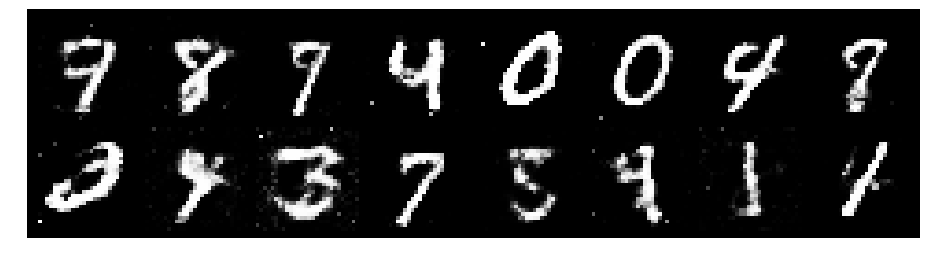

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.2598, Generator Loss: 1.1053
D(x): 0.5666, D(G(z)): 0.4237


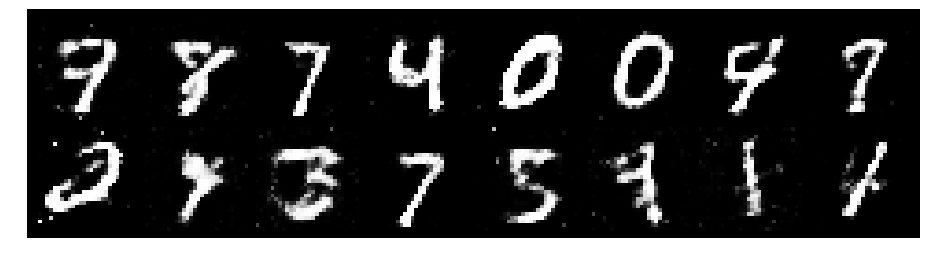

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.2213, Generator Loss: 1.1498
D(x): 0.5646, D(G(z)): 0.3976


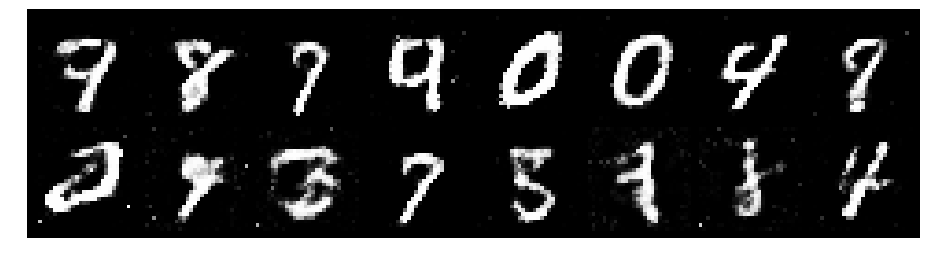

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.1562, Generator Loss: 1.1387
D(x): 0.5651, D(G(z)): 0.3672


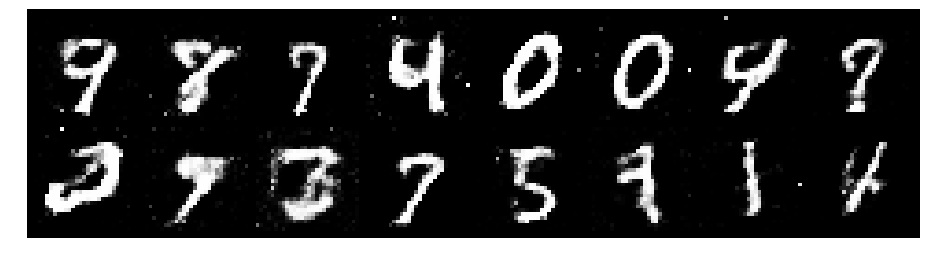

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.2956, Generator Loss: 1.0680
D(x): 0.5290, D(G(z)): 0.3929


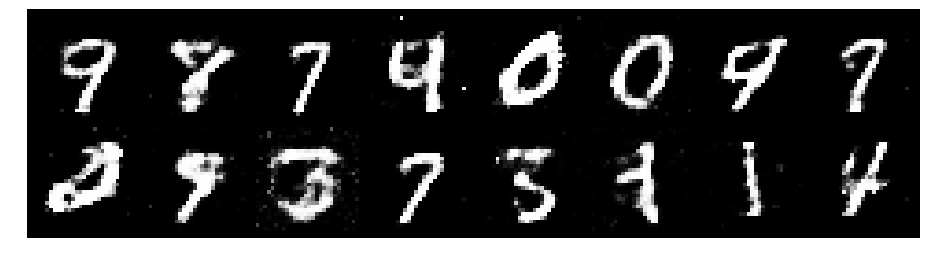

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.2588, Generator Loss: 0.9078
D(x): 0.5359, D(G(z)): 0.4197


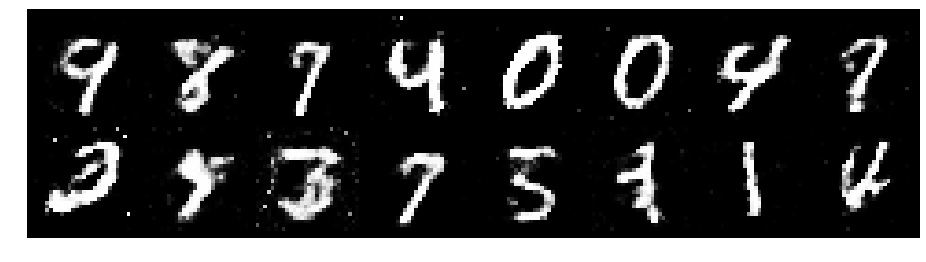

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.1234, Generator Loss: 0.9765
D(x): 0.5677, D(G(z)): 0.3760


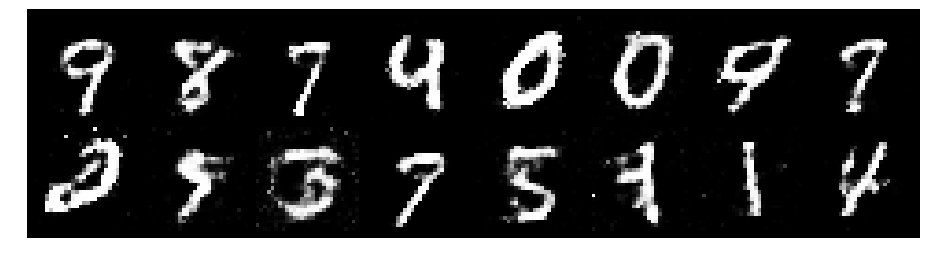

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.3212, Generator Loss: 0.9019
D(x): 0.5968, D(G(z)): 0.4890


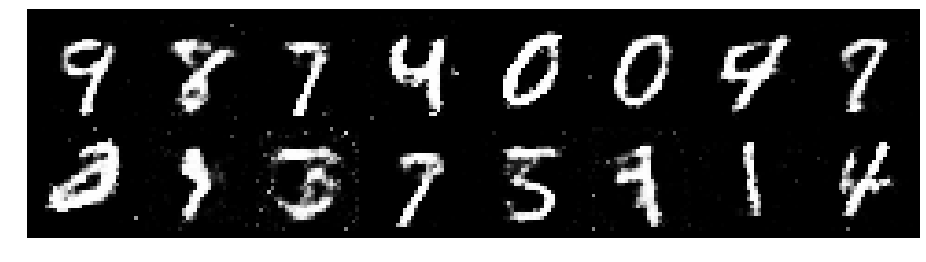

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.2455, Generator Loss: 0.9918
D(x): 0.5504, D(G(z)): 0.4135


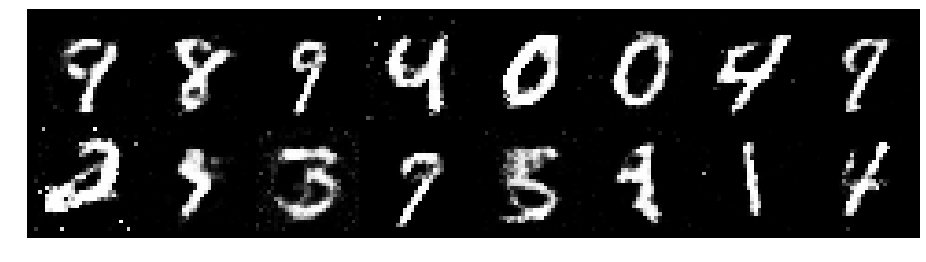

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.2960, Generator Loss: 0.9570
D(x): 0.5778, D(G(z)): 0.4585


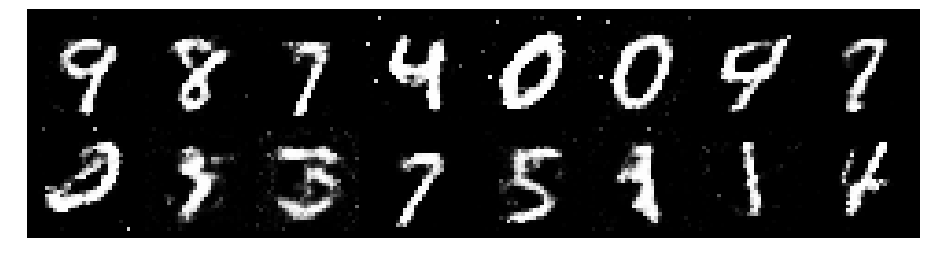

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.2909, Generator Loss: 0.8322
D(x): 0.6269, D(G(z)): 0.5173


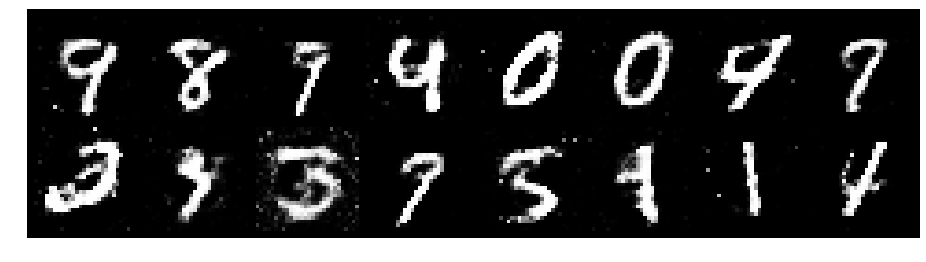

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.3523, Generator Loss: 0.9246
D(x): 0.5094, D(G(z)): 0.4286


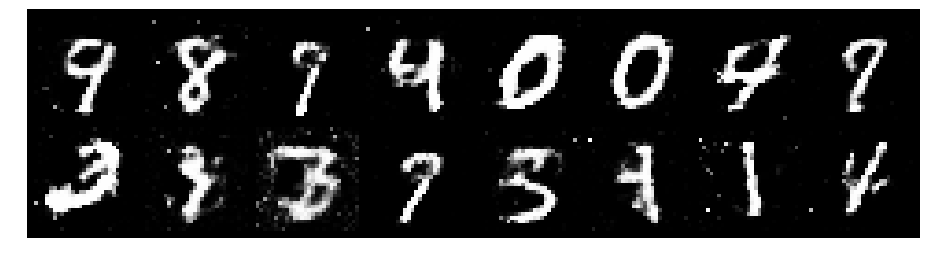

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.3312, Generator Loss: 0.8116
D(x): 0.5614, D(G(z)): 0.4977


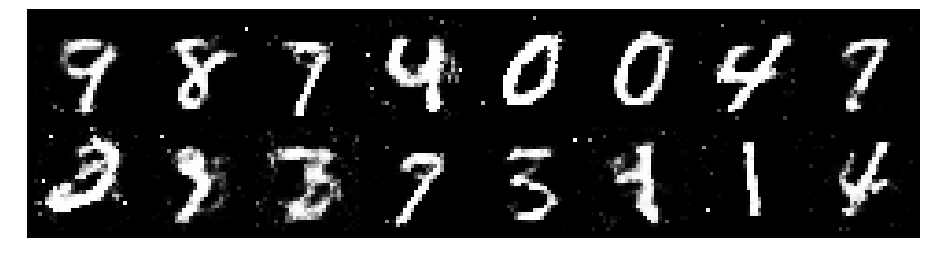

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.2425, Generator Loss: 0.9289
D(x): 0.5413, D(G(z)): 0.4218


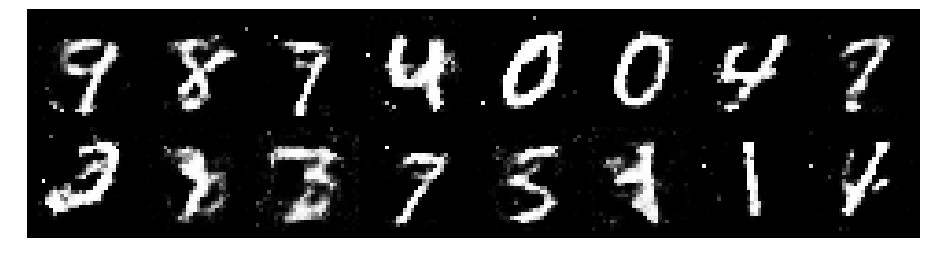

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.2743, Generator Loss: 0.9486
D(x): 0.5622, D(G(z)): 0.4356


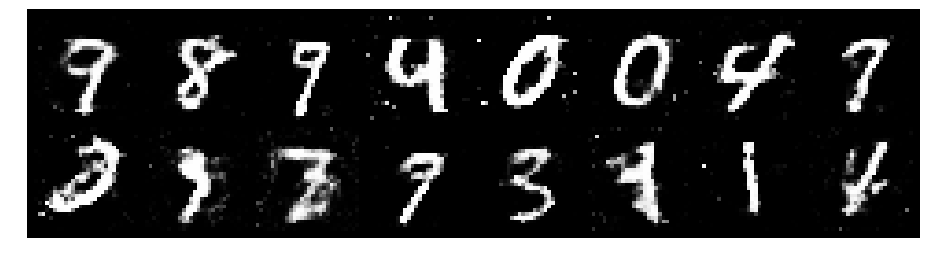

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.2464, Generator Loss: 0.8899
D(x): 0.6093, D(G(z)): 0.4662


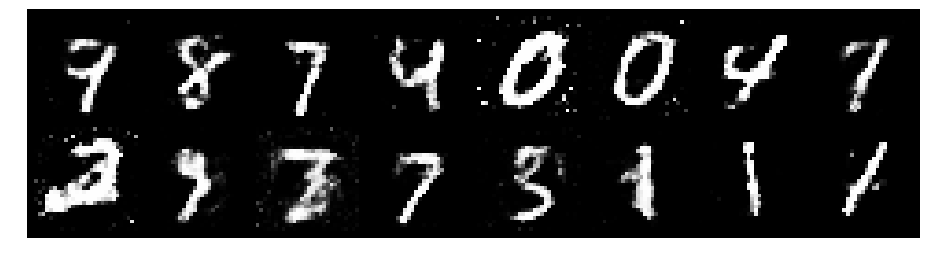

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.3539, Generator Loss: 0.7787
D(x): 0.5562, D(G(z)): 0.4932


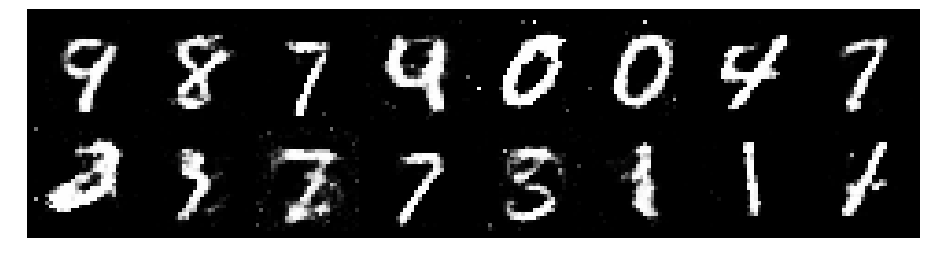

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.3180, Generator Loss: 0.8655
D(x): 0.6081, D(G(z)): 0.4979


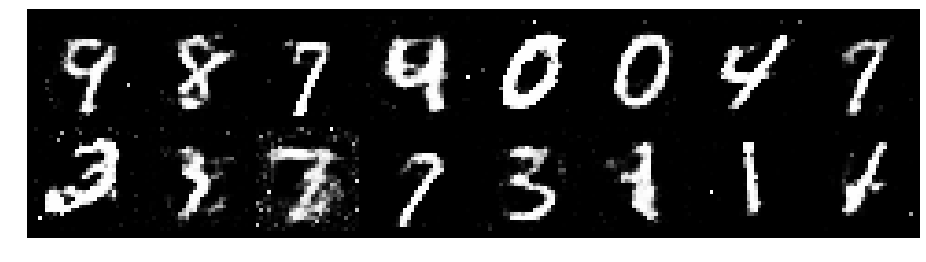

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.1297, Generator Loss: 0.8623
D(x): 0.6232, D(G(z)): 0.4181


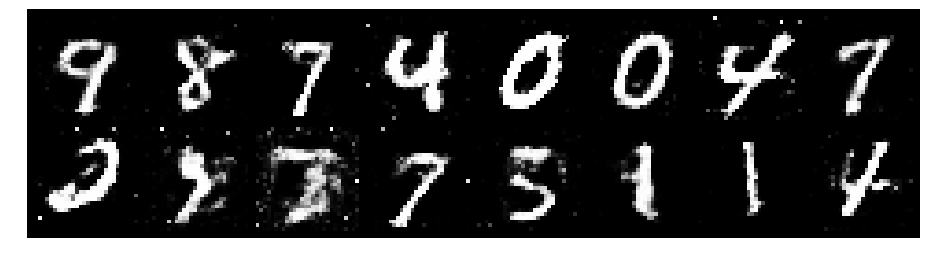

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.1428, Generator Loss: 0.9379
D(x): 0.5976, D(G(z)): 0.4075


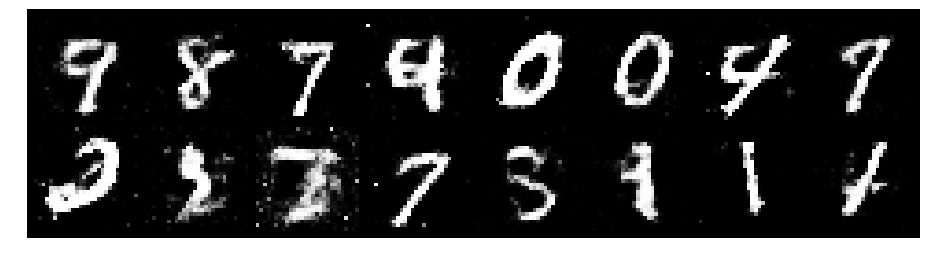

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.2051, Generator Loss: 0.8133
D(x): 0.5853, D(G(z)): 0.4294


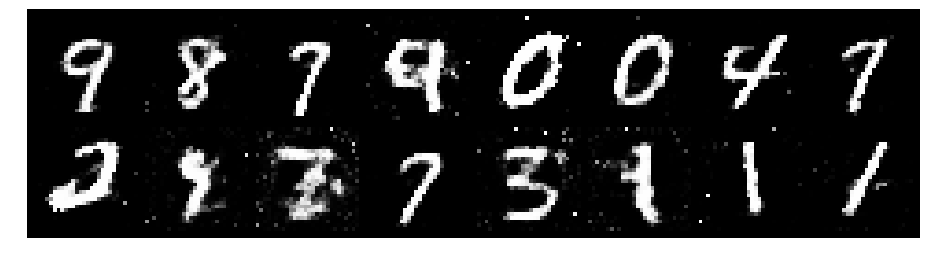

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.2737, Generator Loss: 0.9464
D(x): 0.5502, D(G(z)): 0.4326


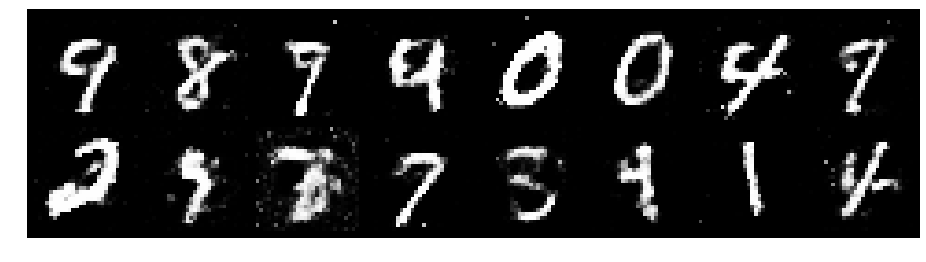

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.3099, Generator Loss: 0.8462
D(x): 0.5978, D(G(z)): 0.5072


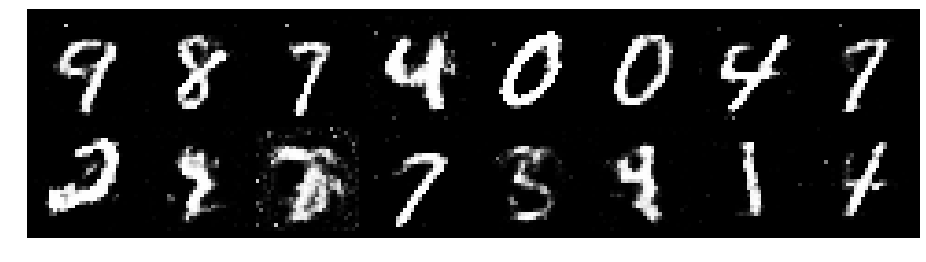

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.3518, Generator Loss: 0.8864
D(x): 0.5440, D(G(z)): 0.4564


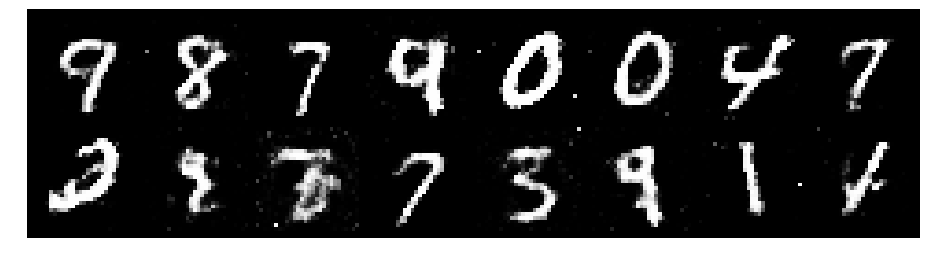

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.2674, Generator Loss: 0.8149
D(x): 0.5641, D(G(z)): 0.4642


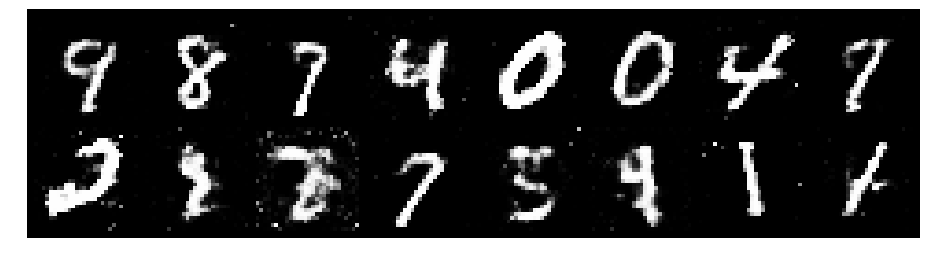

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.3092, Generator Loss: 0.8570
D(x): 0.5435, D(G(z)): 0.4465


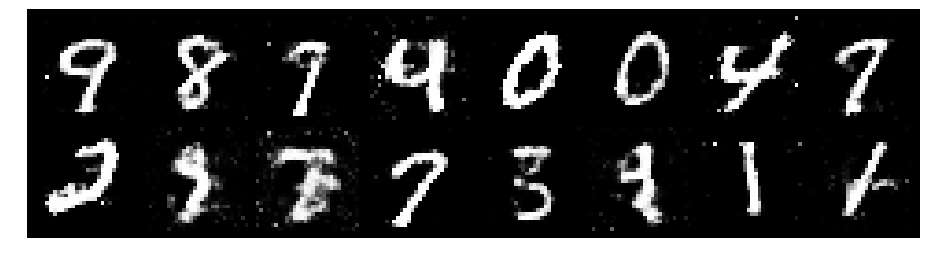

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.2792, Generator Loss: 0.8467
D(x): 0.5578, D(G(z)): 0.4464


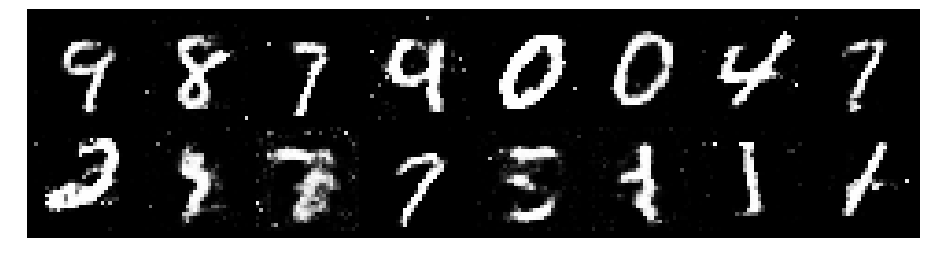

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.0747, Generator Loss: 0.9966
D(x): 0.6240, D(G(z)): 0.3928


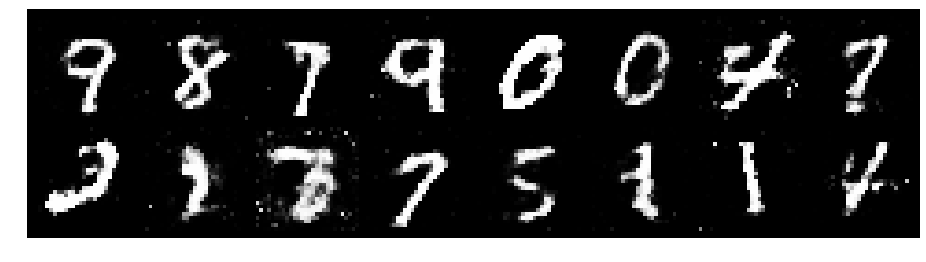

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.2271, Generator Loss: 1.0388
D(x): 0.5258, D(G(z)): 0.3768


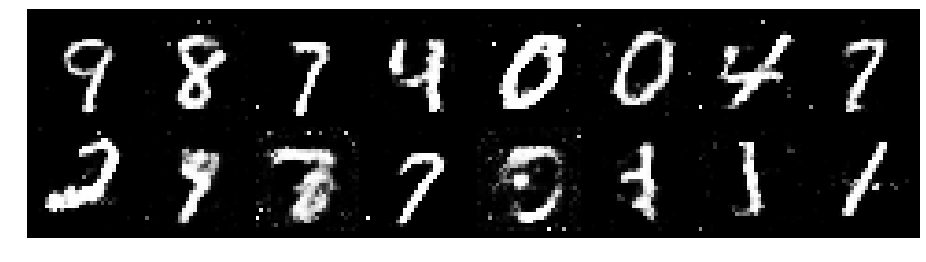

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.1954, Generator Loss: 0.9063
D(x): 0.5654, D(G(z)): 0.4248


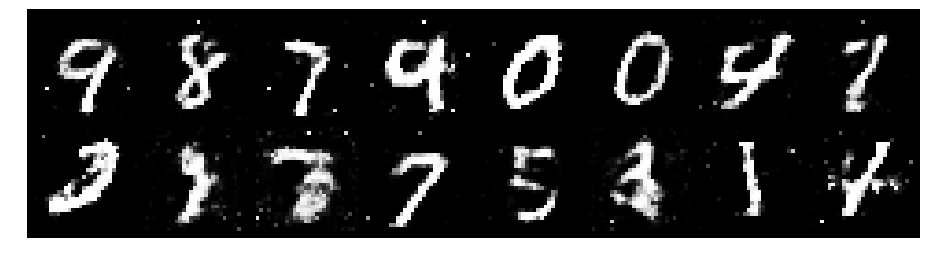

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.0908, Generator Loss: 0.9966
D(x): 0.6380, D(G(z)): 0.4149


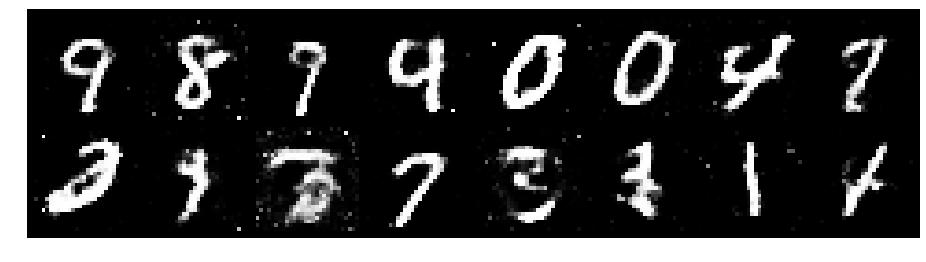

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.2739, Generator Loss: 1.0018
D(x): 0.5685, D(G(z)): 0.4450


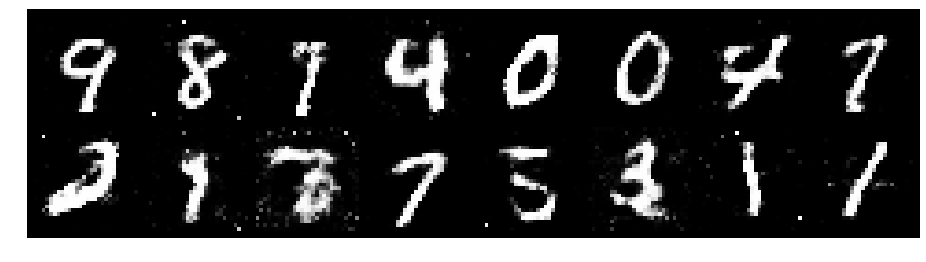

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.1478, Generator Loss: 0.9168
D(x): 0.6079, D(G(z)): 0.4331


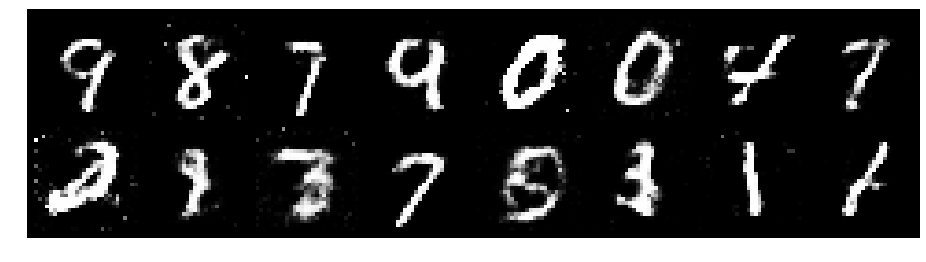

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.0885, Generator Loss: 1.1382
D(x): 0.5933, D(G(z)): 0.3746


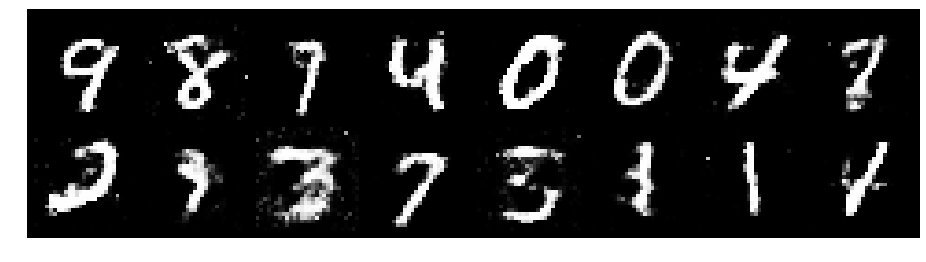

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.1367, Generator Loss: 0.9834
D(x): 0.5802, D(G(z)): 0.4089


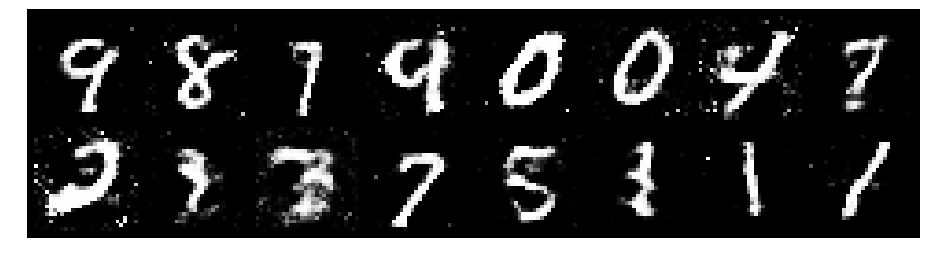

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.1473, Generator Loss: 0.9298
D(x): 0.5655, D(G(z)): 0.4034


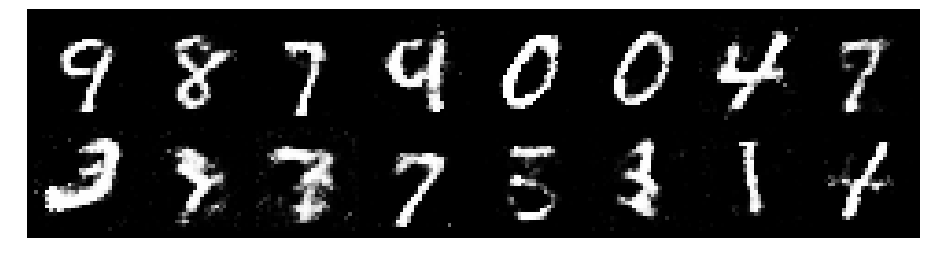

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.2108, Generator Loss: 0.8816
D(x): 0.5794, D(G(z)): 0.4431


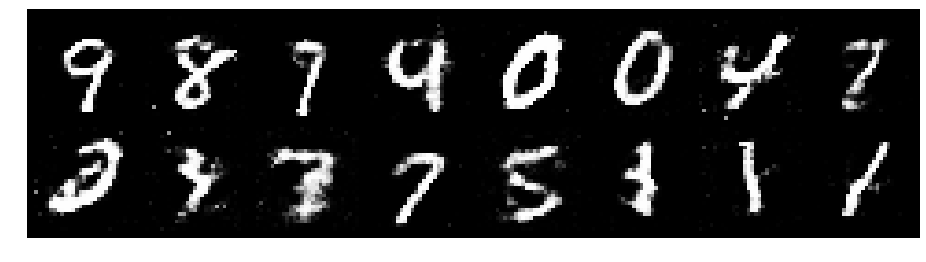

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.1450, Generator Loss: 0.9380
D(x): 0.5776, D(G(z)): 0.3973


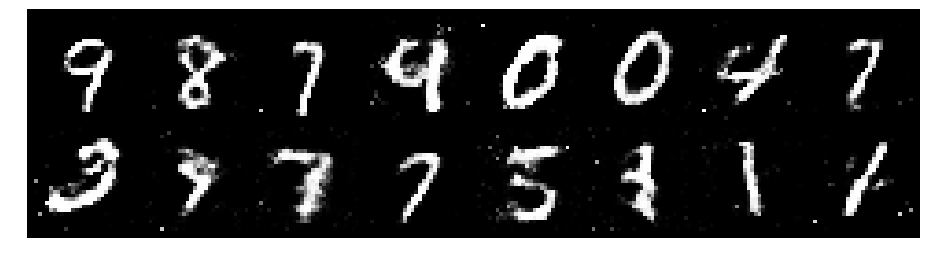

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.1811, Generator Loss: 1.0094
D(x): 0.5685, D(G(z)): 0.4196


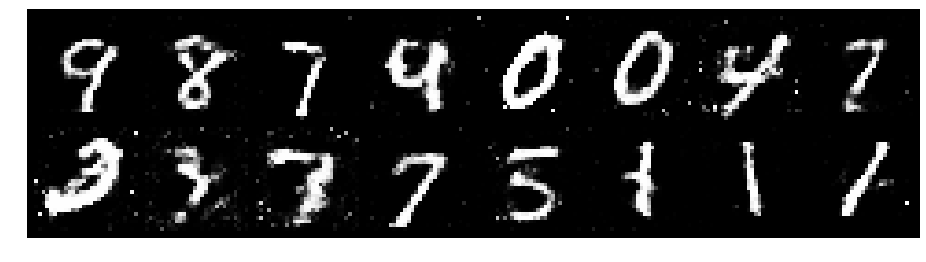

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.1515, Generator Loss: 1.1237
D(x): 0.6131, D(G(z)): 0.4288


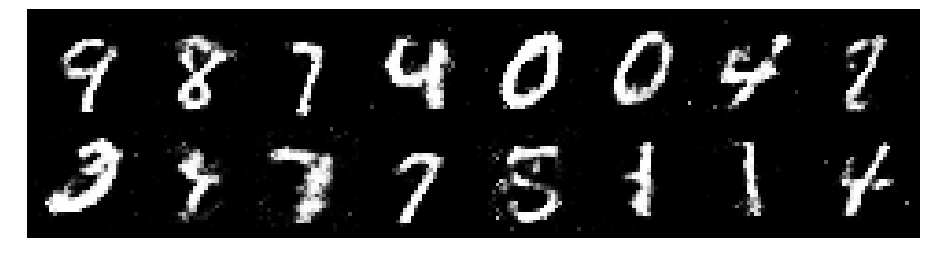

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.1760, Generator Loss: 0.9818
D(x): 0.5339, D(G(z)): 0.3876


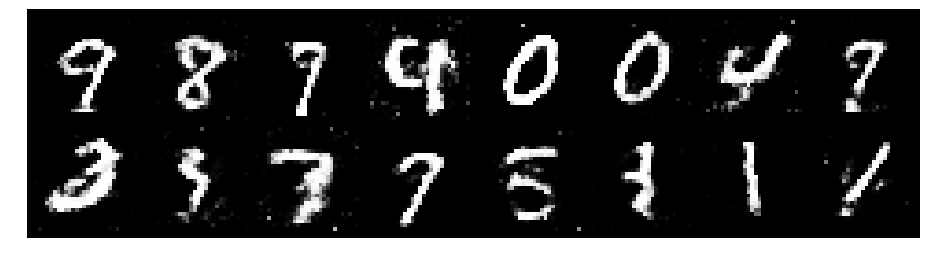

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.2118, Generator Loss: 0.9041
D(x): 0.5662, D(G(z)): 0.4214


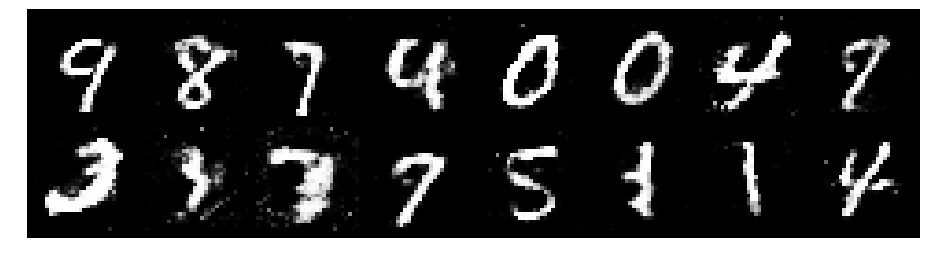

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.2858, Generator Loss: 0.8346
D(x): 0.5528, D(G(z)): 0.4470


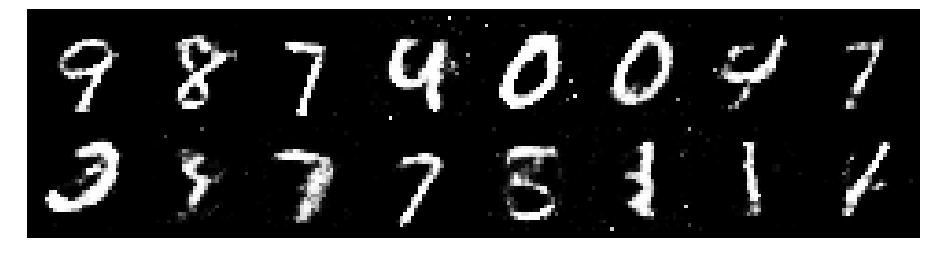

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.2570, Generator Loss: 0.8935
D(x): 0.5614, D(G(z)): 0.4302


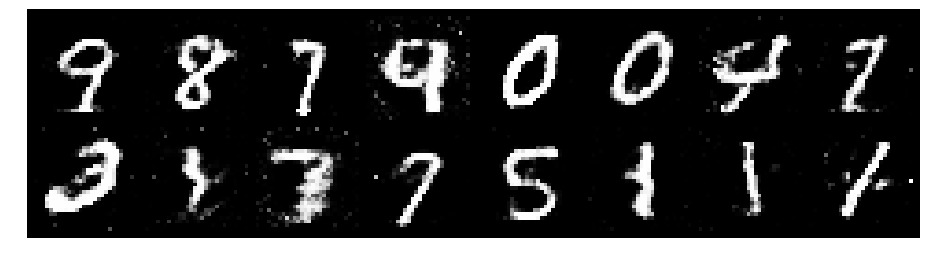

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.2763, Generator Loss: 1.0224
D(x): 0.5736, D(G(z)): 0.4314


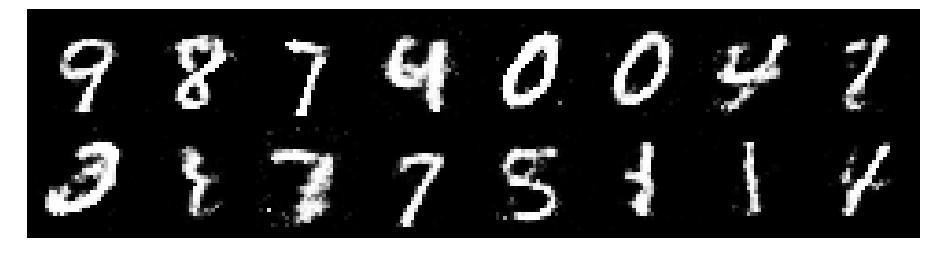

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.2873, Generator Loss: 0.8371
D(x): 0.5444, D(G(z)): 0.4460


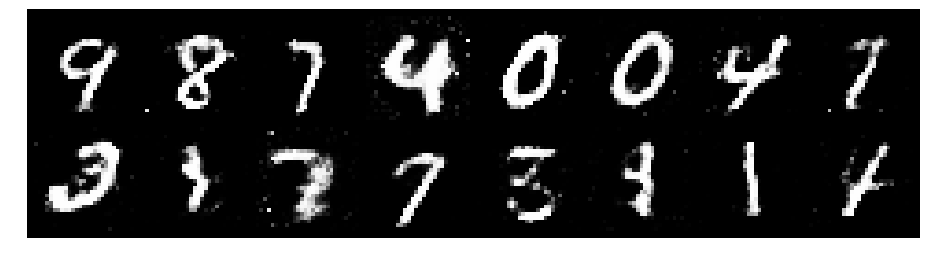

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.2624, Generator Loss: 0.9308
D(x): 0.6081, D(G(z)): 0.4572


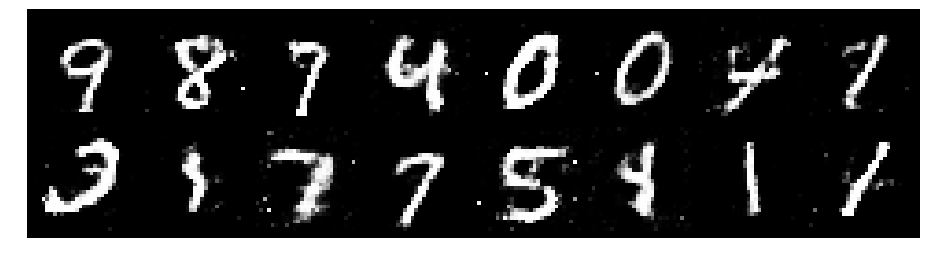

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.3130, Generator Loss: 0.9583
D(x): 0.5796, D(G(z)): 0.4597


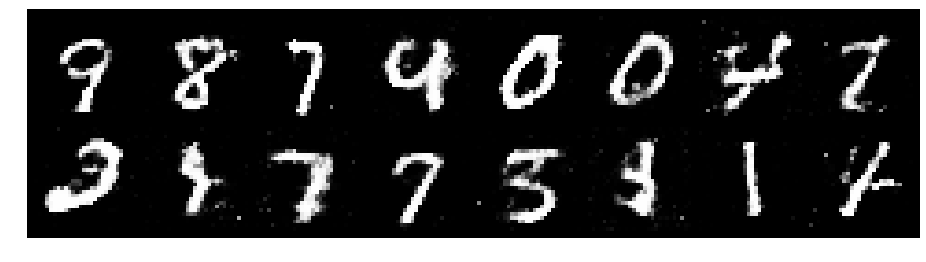

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.2573, Generator Loss: 1.0116
D(x): 0.6048, D(G(z)): 0.4563


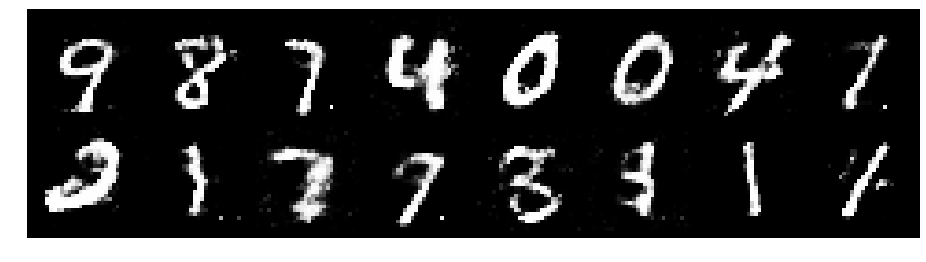

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.3384, Generator Loss: 0.7776
D(x): 0.5349, D(G(z)): 0.4661


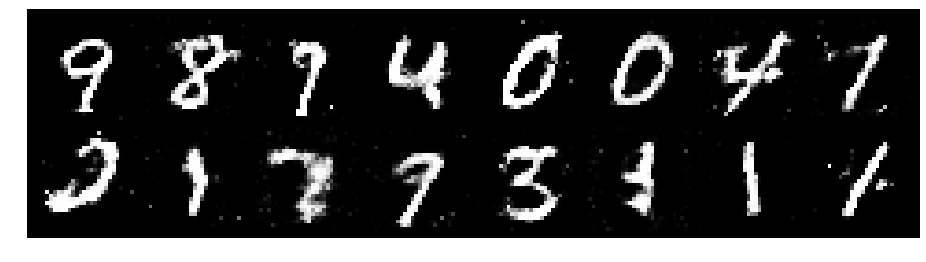

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.3886, Generator Loss: 0.9147
D(x): 0.5539, D(G(z)): 0.4809


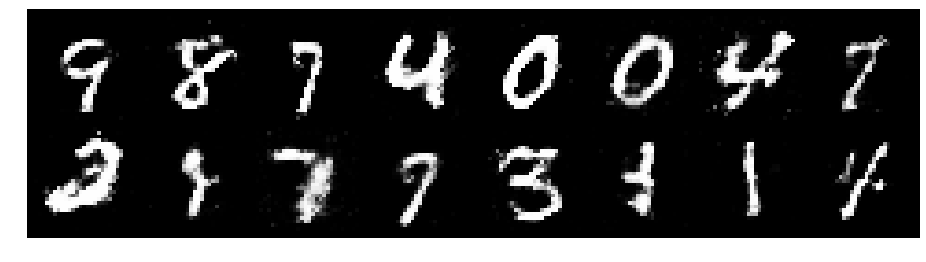

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.4028, Generator Loss: 0.6792
D(x): 0.5751, D(G(z)): 0.5293


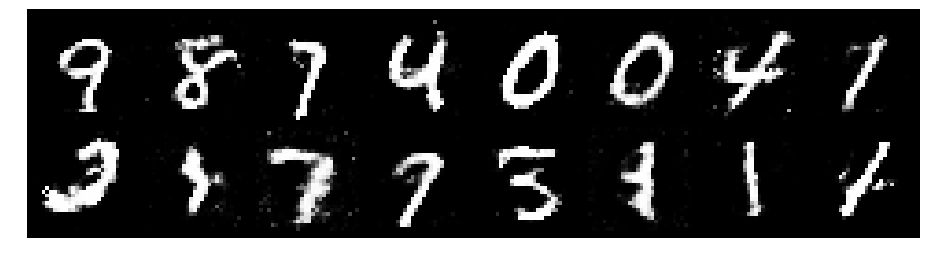

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.3125, Generator Loss: 0.8084
D(x): 0.5850, D(G(z)): 0.4468


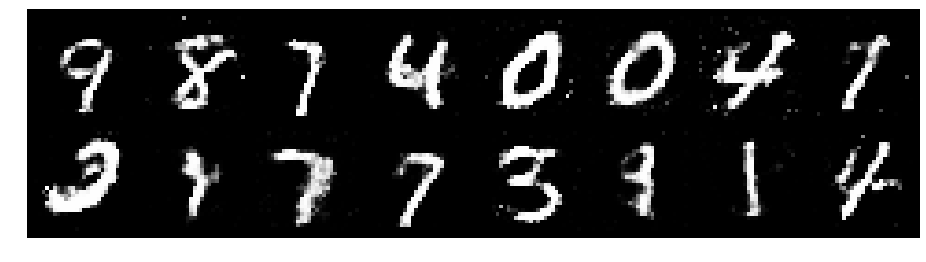

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.3953, Generator Loss: 0.9154
D(x): 0.5678, D(G(z)): 0.4944


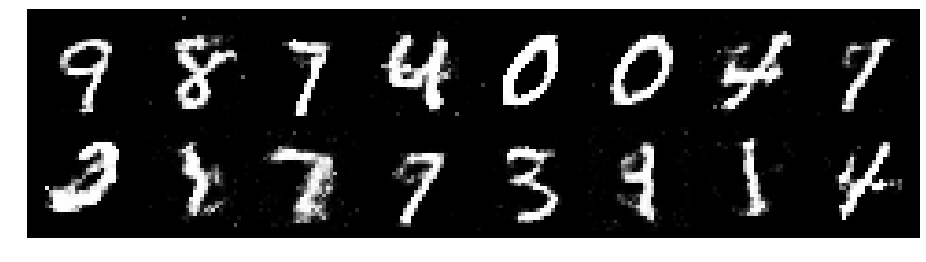

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.3353, Generator Loss: 0.8755
D(x): 0.5880, D(G(z)): 0.4995


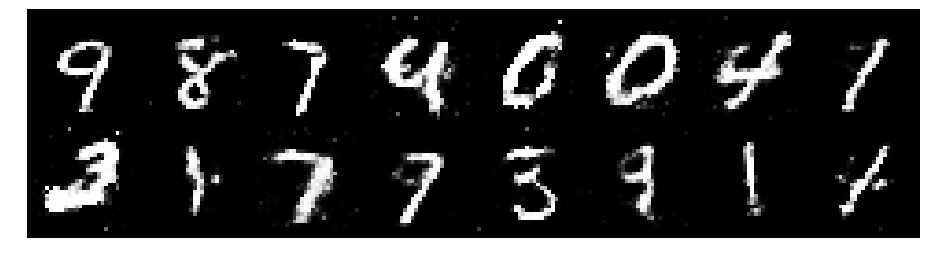

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.3194, Generator Loss: 0.7378
D(x): 0.5785, D(G(z)): 0.4947


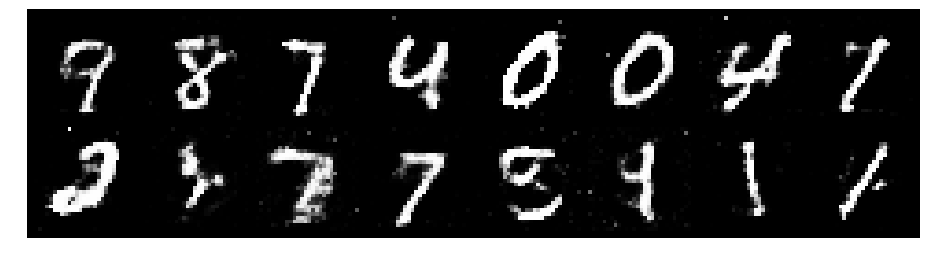

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.3456, Generator Loss: 0.8174
D(x): 0.5471, D(G(z)): 0.4663


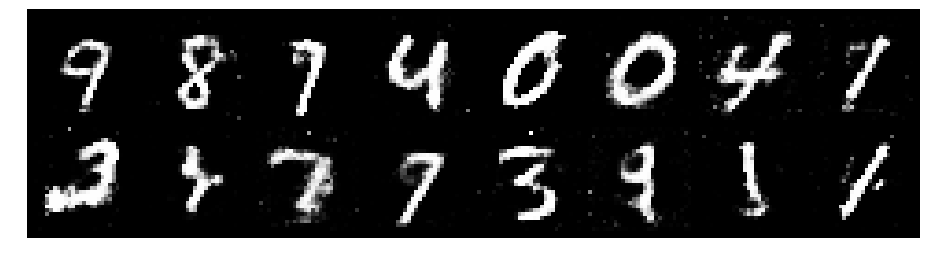

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.1215, Generator Loss: 0.9510
D(x): 0.6193, D(G(z)): 0.4205


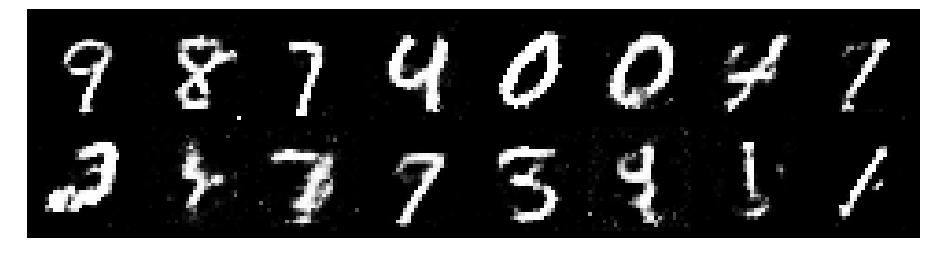

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.2772, Generator Loss: 0.9350
D(x): 0.5926, D(G(z)): 0.4631


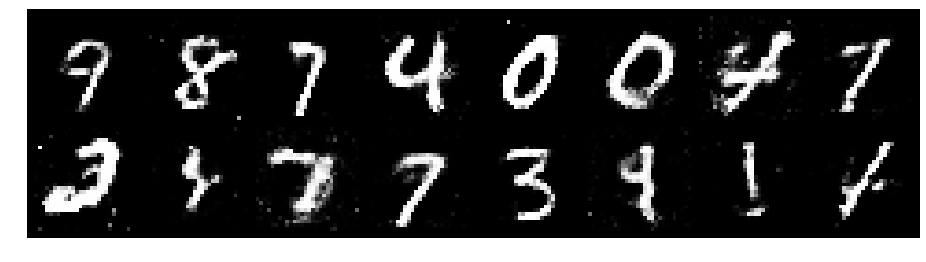

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.3209, Generator Loss: 0.9294
D(x): 0.5904, D(G(z)): 0.4887


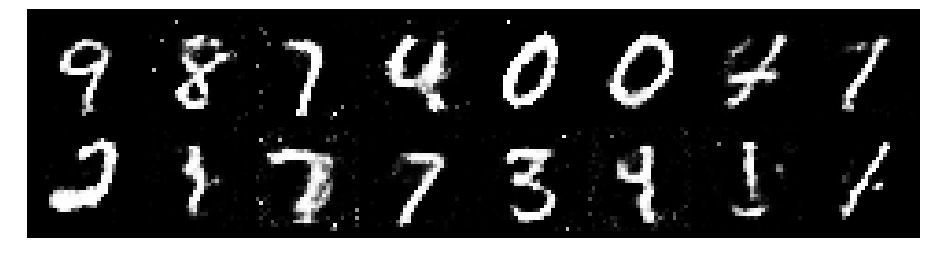

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.2388, Generator Loss: 0.8810
D(x): 0.5564, D(G(z)): 0.4249


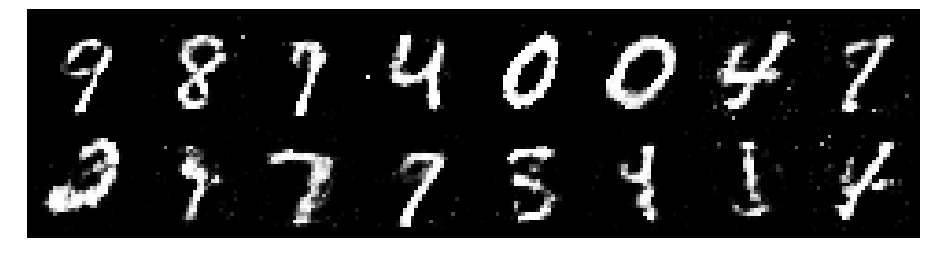

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.2446, Generator Loss: 1.0966
D(x): 0.6037, D(G(z)): 0.4415


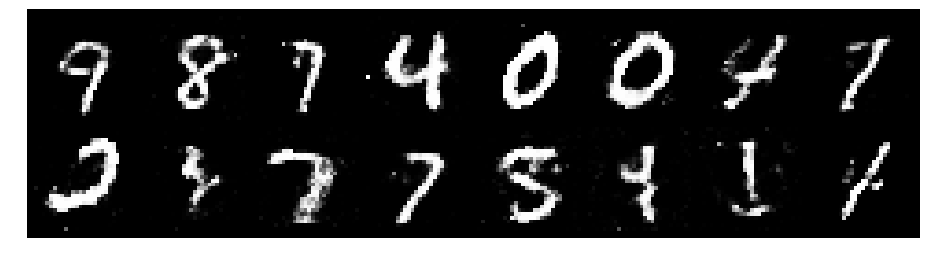

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.2292, Generator Loss: 1.0621
D(x): 0.5464, D(G(z)): 0.3943


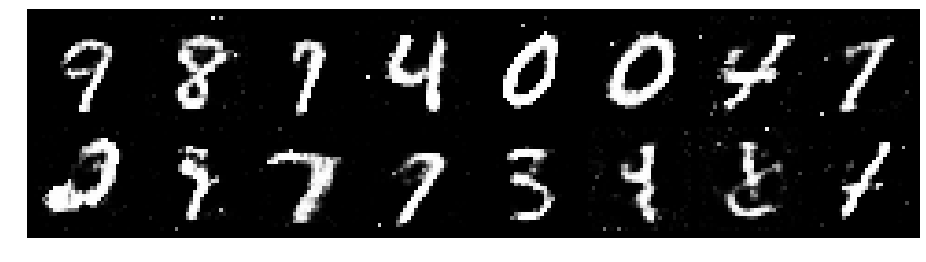

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.2435, Generator Loss: 1.1783
D(x): 0.5571, D(G(z)): 0.4068


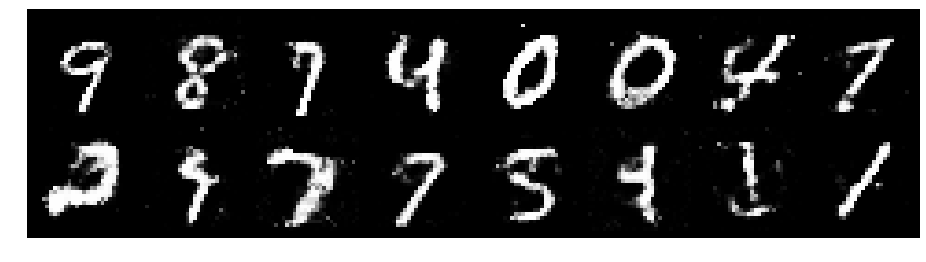

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.3266, Generator Loss: 0.9041
D(x): 0.5502, D(G(z)): 0.4527


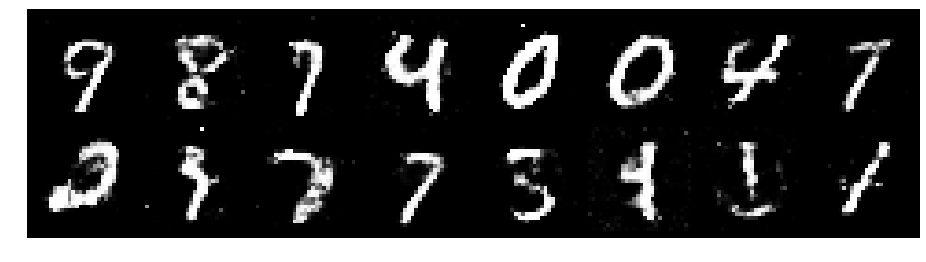

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.2981, Generator Loss: 0.7995
D(x): 0.5777, D(G(z)): 0.4683


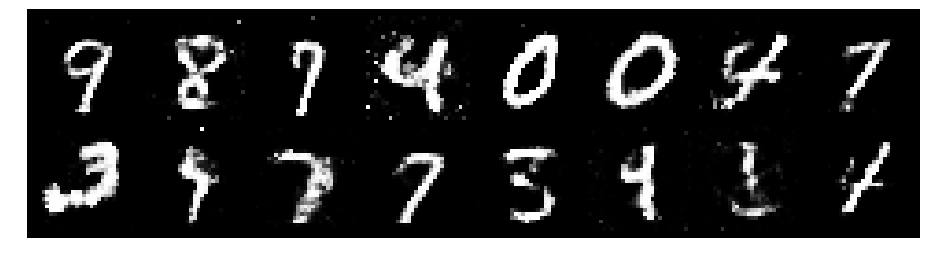

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.3667, Generator Loss: 0.8701
D(x): 0.5561, D(G(z)): 0.4659


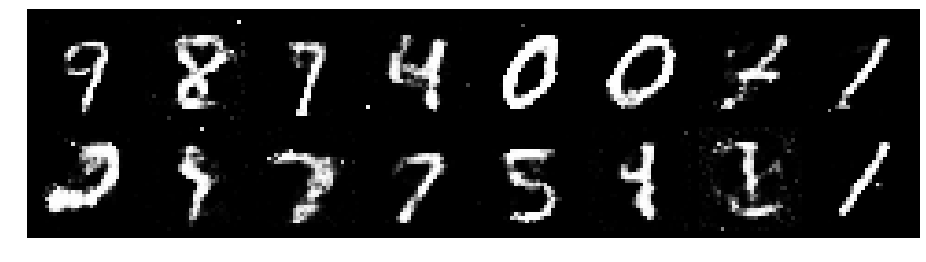

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.2999, Generator Loss: 0.8659
D(x): 0.5889, D(G(z)): 0.4744


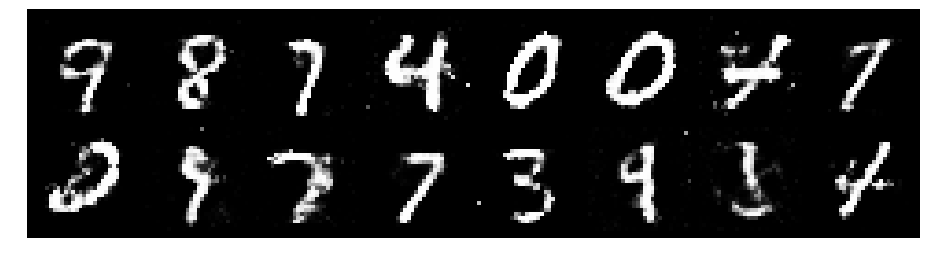

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.2149, Generator Loss: 0.8360
D(x): 0.5899, D(G(z)): 0.4487


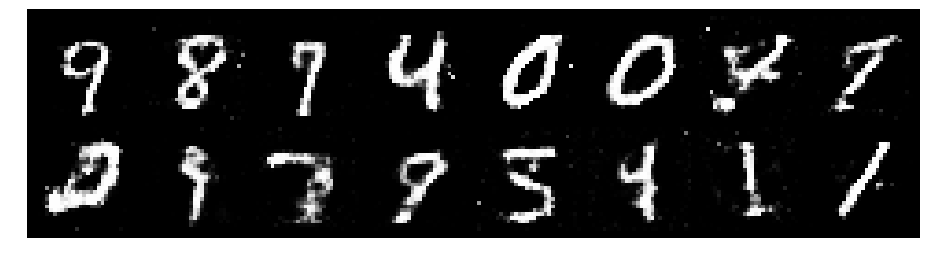

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.2636, Generator Loss: 0.9566
D(x): 0.5468, D(G(z)): 0.4342


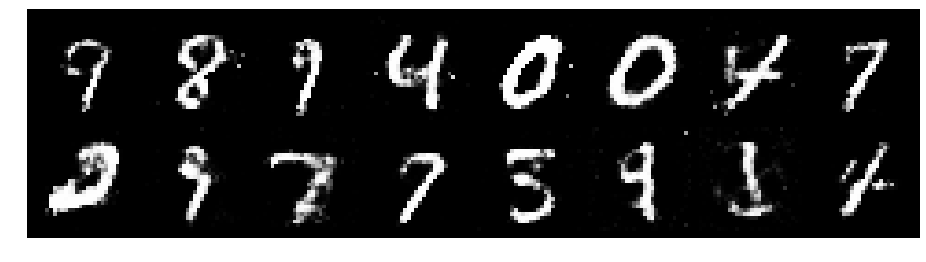

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.4399, Generator Loss: 0.7951
D(x): 0.5052, D(G(z)): 0.4789


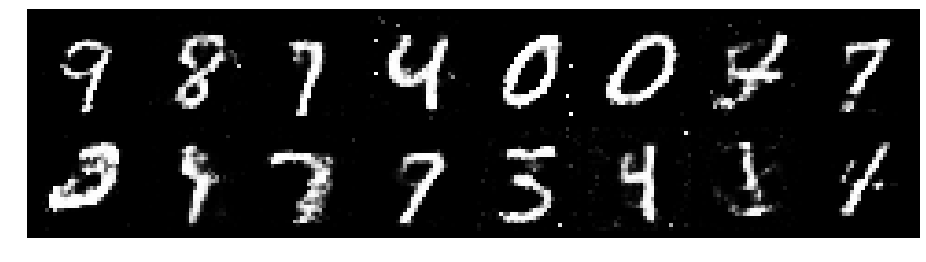

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.3418, Generator Loss: 0.9729
D(x): 0.5439, D(G(z)): 0.4279


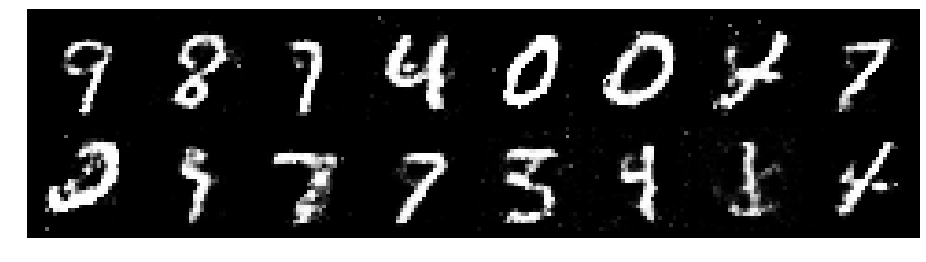

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.3658, Generator Loss: 0.7733
D(x): 0.5274, D(G(z)): 0.4789


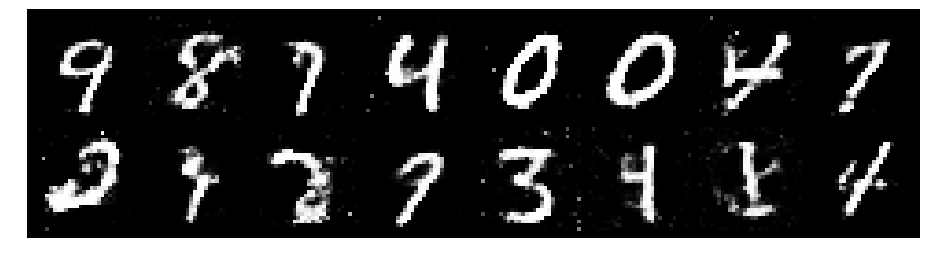

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.2393, Generator Loss: 1.1215
D(x): 0.5380, D(G(z)): 0.3825


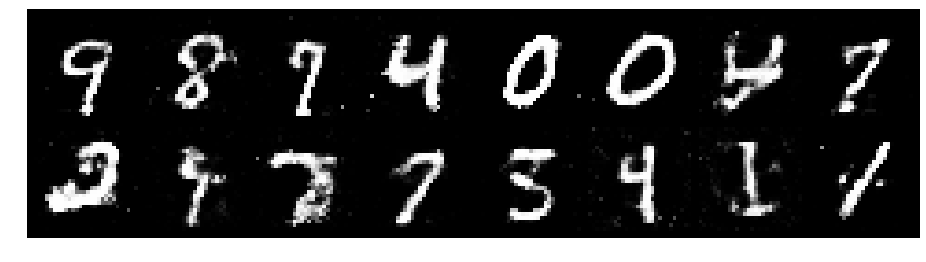

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.3253, Generator Loss: 0.9588
D(x): 0.5452, D(G(z)): 0.4548


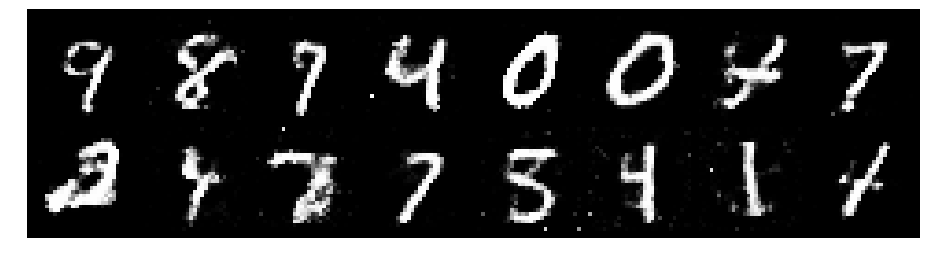

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.3244, Generator Loss: 0.9167
D(x): 0.5820, D(G(z)): 0.4821


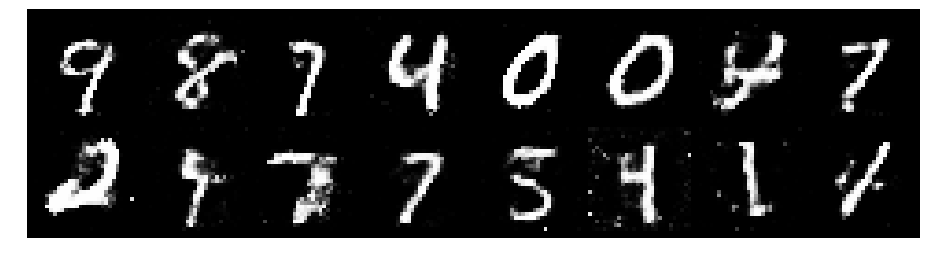

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.2097, Generator Loss: 0.9210
D(x): 0.5940, D(G(z)): 0.4409


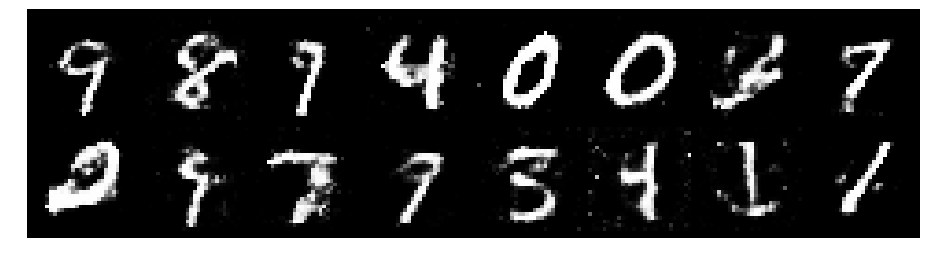

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.3487, Generator Loss: 0.8696
D(x): 0.6096, D(G(z)): 0.4805


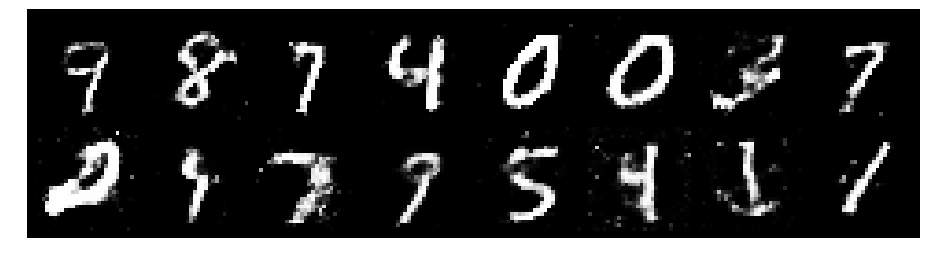

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.3406, Generator Loss: 0.9241
D(x): 0.5497, D(G(z)): 0.4520


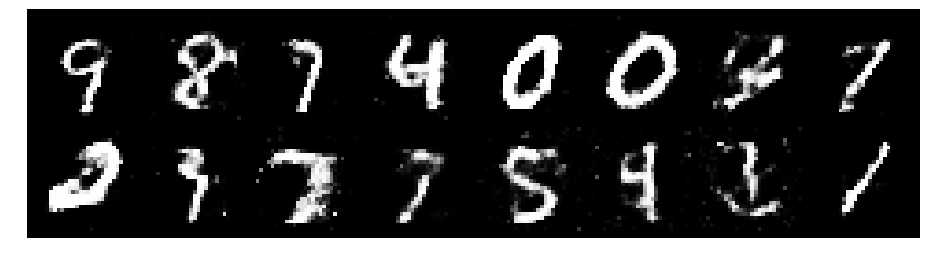

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.2814, Generator Loss: 0.9269
D(x): 0.5264, D(G(z)): 0.4200


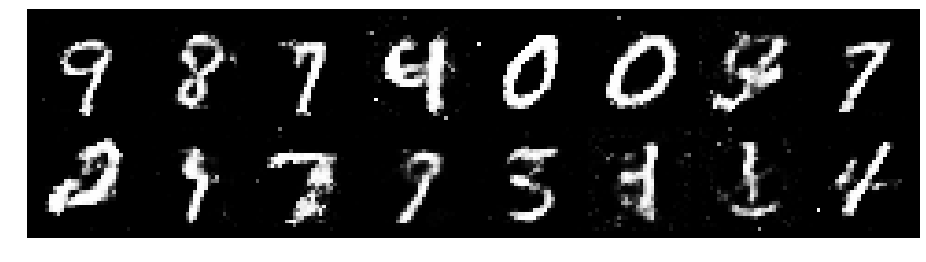

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.3292, Generator Loss: 0.8789
D(x): 0.5248, D(G(z)): 0.4466


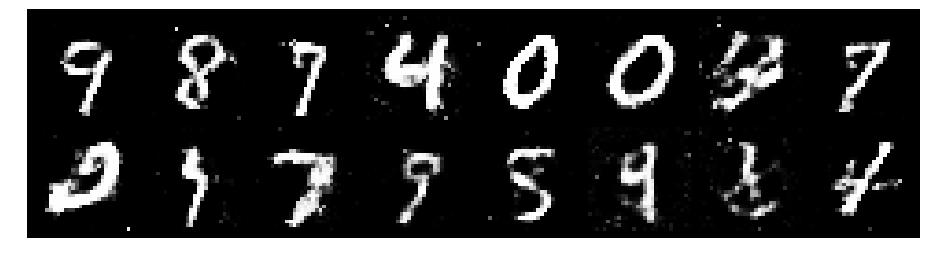

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.2896, Generator Loss: 0.7437
D(x): 0.5963, D(G(z)): 0.4888


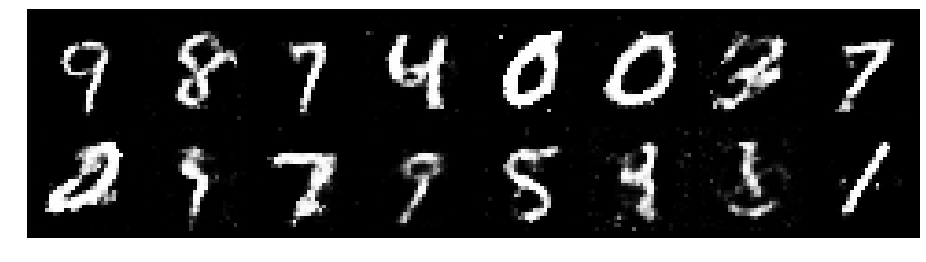

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.3841, Generator Loss: 0.9889
D(x): 0.5355, D(G(z)): 0.4568


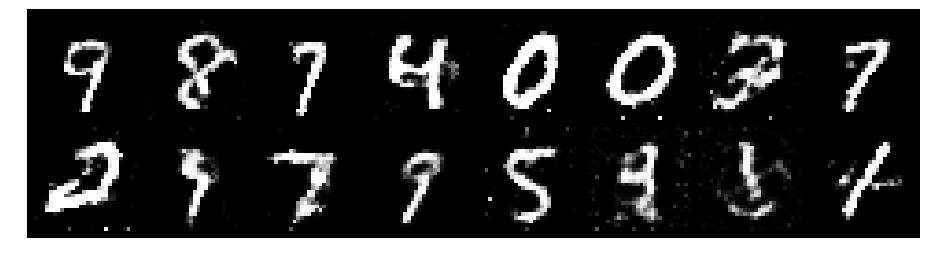

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.2878, Generator Loss: 0.9981
D(x): 0.5363, D(G(z)): 0.3941


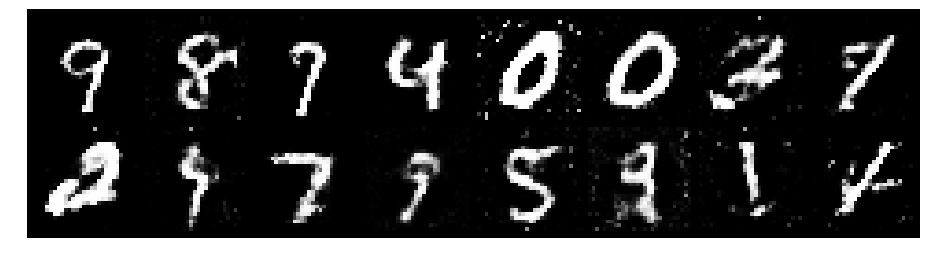

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.3518, Generator Loss: 0.9880
D(x): 0.5543, D(G(z)): 0.4746


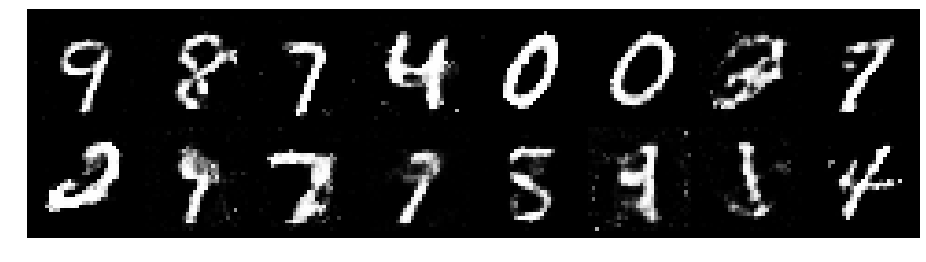

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.2389, Generator Loss: 0.9616
D(x): 0.5625, D(G(z)): 0.4237


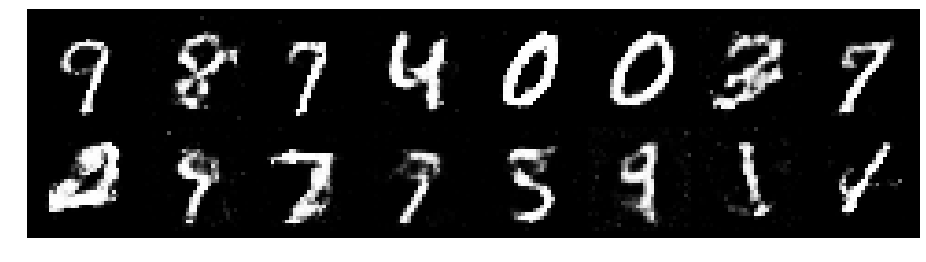

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.1310, Generator Loss: 1.0630
D(x): 0.5877, D(G(z)): 0.3850


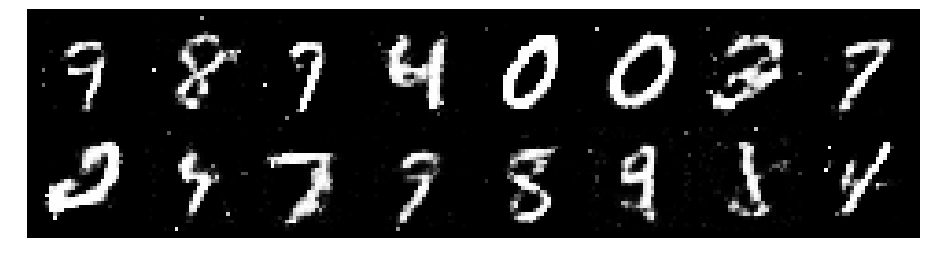

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.2374, Generator Loss: 0.9536
D(x): 0.5649, D(G(z)): 0.4450


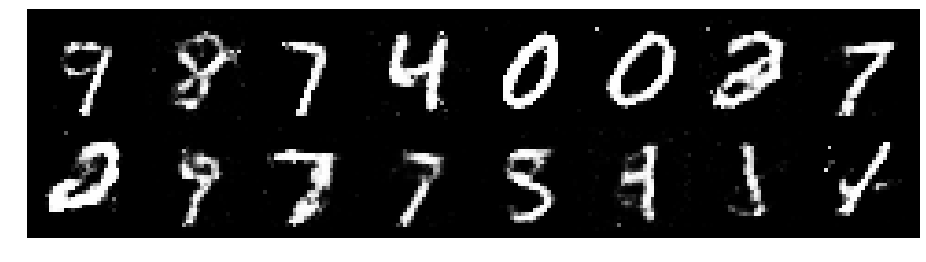

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.2029, Generator Loss: 0.9663
D(x): 0.5759, D(G(z)): 0.4378


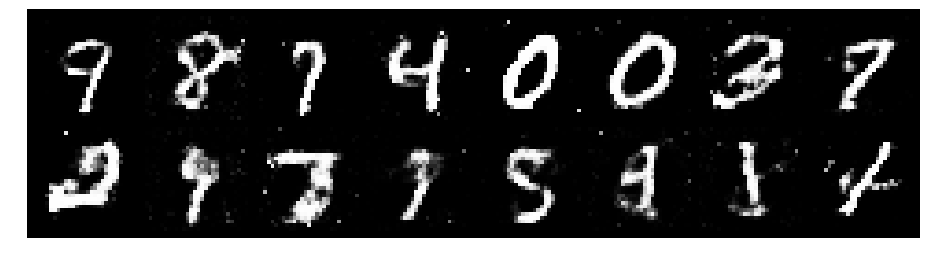

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.1348, Generator Loss: 0.8989
D(x): 0.5797, D(G(z)): 0.3991


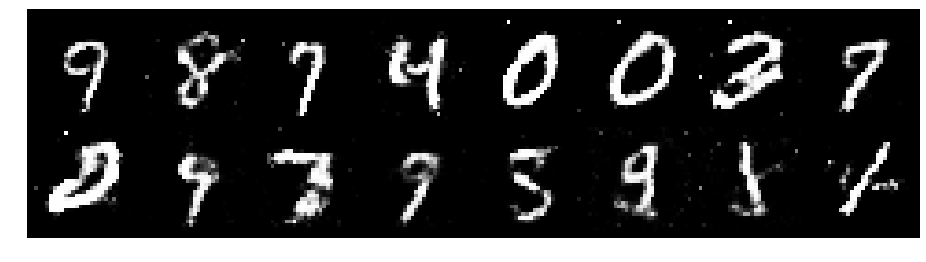

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.2881, Generator Loss: 1.0691
D(x): 0.5531, D(G(z)): 0.4401


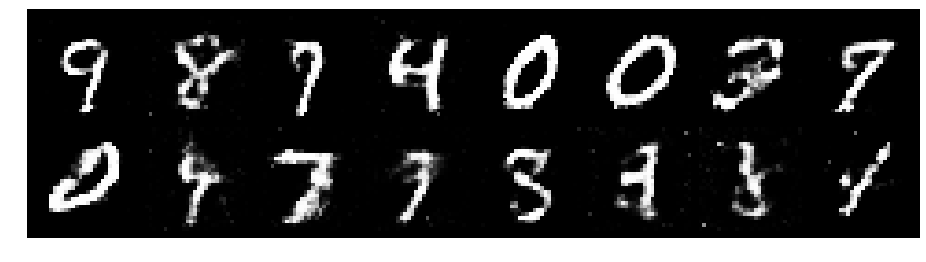

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.2760, Generator Loss: 0.9930
D(x): 0.5761, D(G(z)): 0.4322


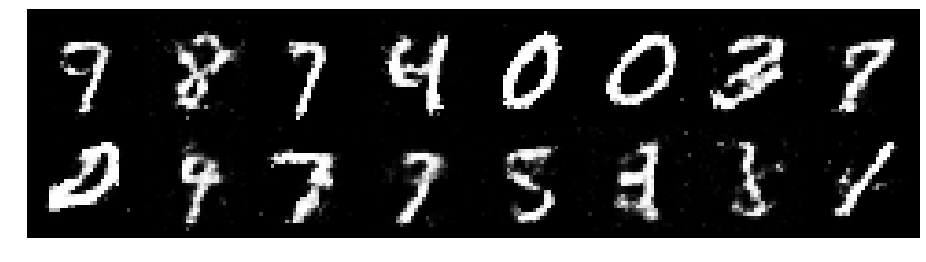

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.2639, Generator Loss: 0.8402
D(x): 0.5685, D(G(z)): 0.4537


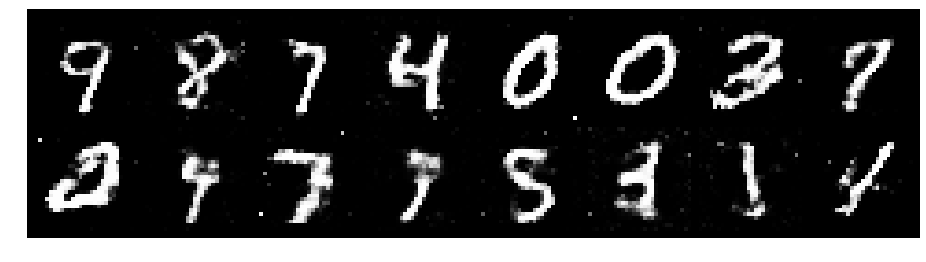

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.4195, Generator Loss: 0.8288
D(x): 0.5036, D(G(z)): 0.4429


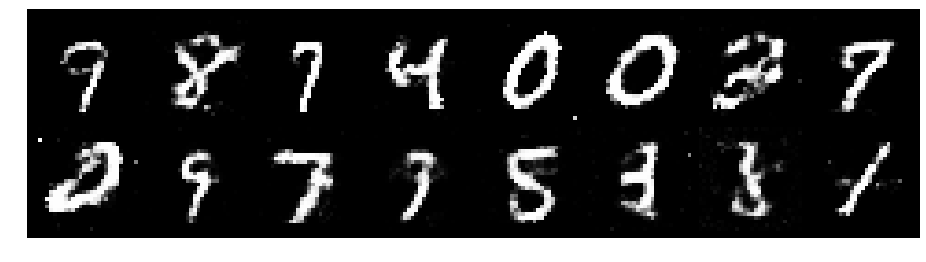

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.2879, Generator Loss: 0.9119
D(x): 0.5486, D(G(z)): 0.4475


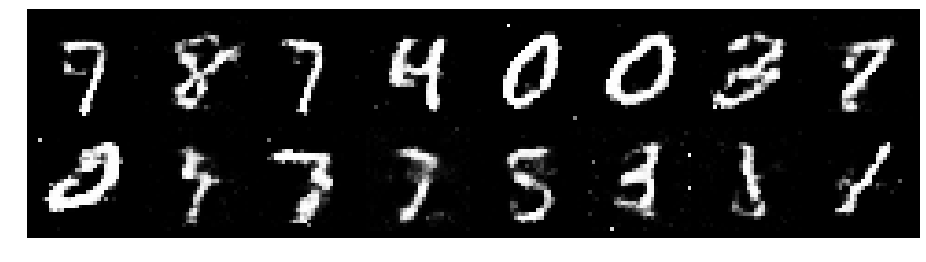

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.2112, Generator Loss: 0.7464
D(x): 0.5863, D(G(z)): 0.4559


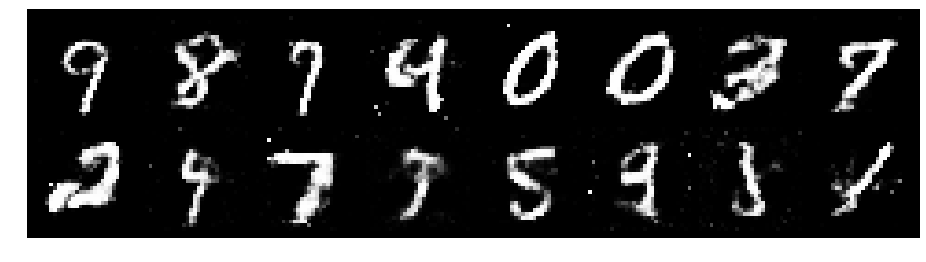

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.2796, Generator Loss: 0.7684
D(x): 0.5524, D(G(z)): 0.4565


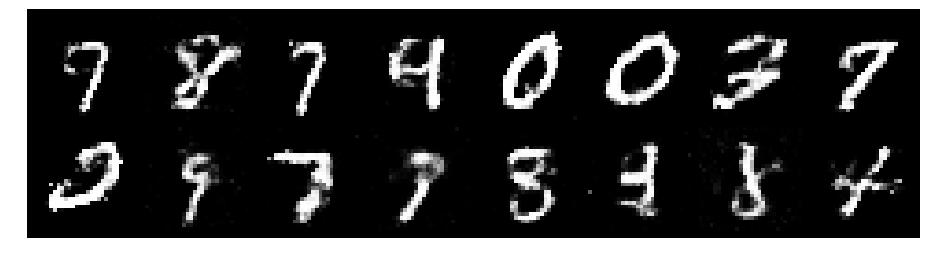

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.2319, Generator Loss: 0.9474
D(x): 0.5804, D(G(z)): 0.4412


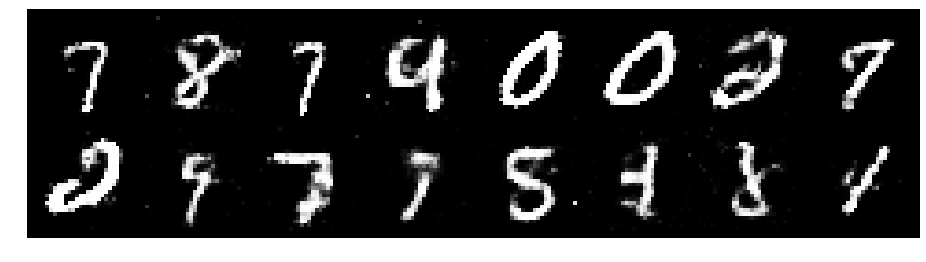

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.1116, Generator Loss: 1.1416
D(x): 0.6043, D(G(z)): 0.3704


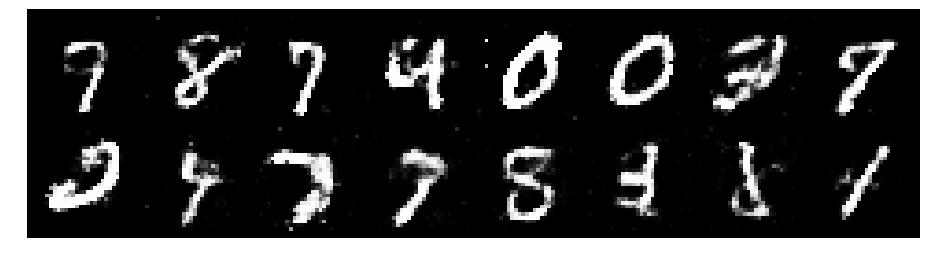

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.2558, Generator Loss: 0.9849
D(x): 0.6096, D(G(z)): 0.4411


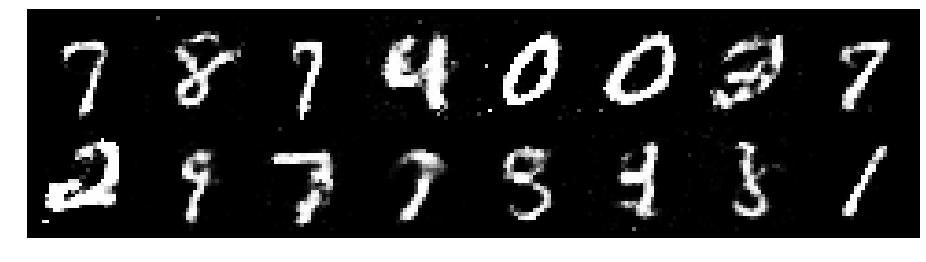

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.2315, Generator Loss: 0.9151
D(x): 0.5711, D(G(z)): 0.4385


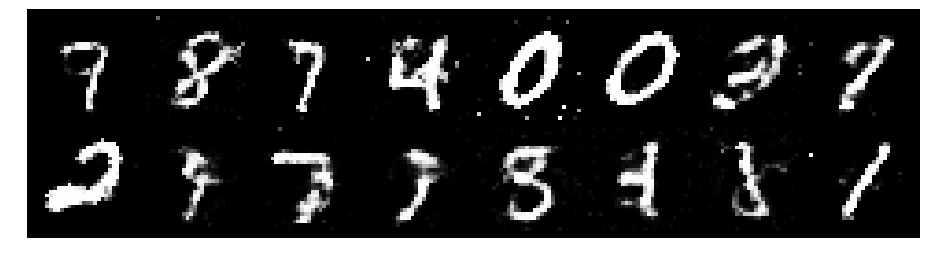

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.1544, Generator Loss: 1.0593
D(x): 0.5543, D(G(z)): 0.3901


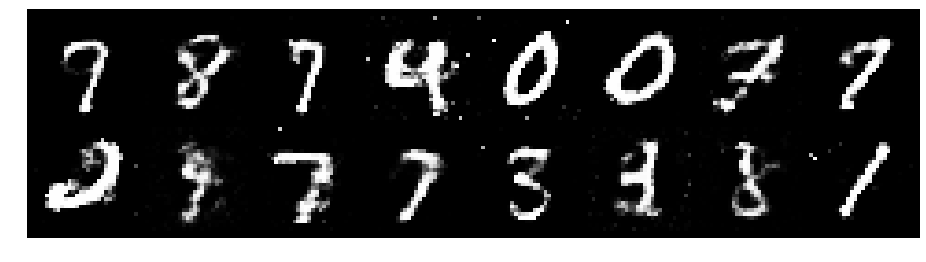

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.2895, Generator Loss: 0.9079
D(x): 0.5165, D(G(z)): 0.4236


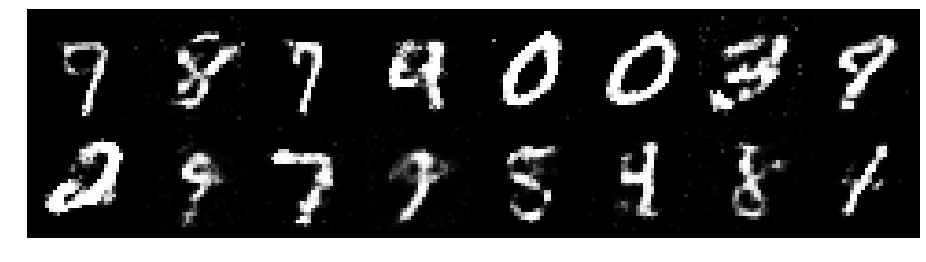

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.2639, Generator Loss: 0.9241
D(x): 0.5528, D(G(z)): 0.4467


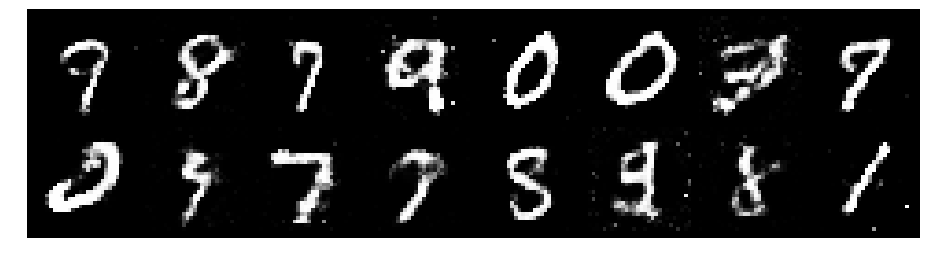

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.2767, Generator Loss: 0.9190
D(x): 0.5373, D(G(z)): 0.4260


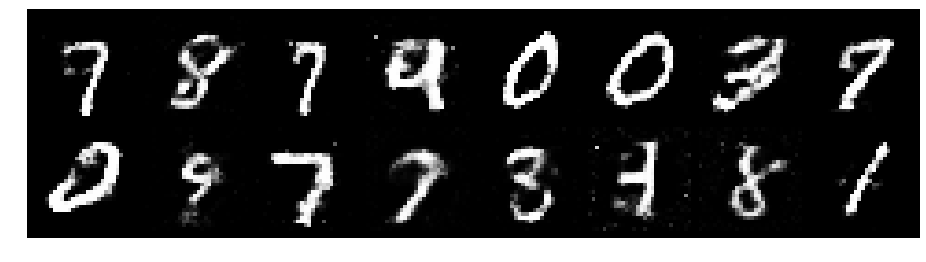

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.3509, Generator Loss: 0.8921
D(x): 0.5176, D(G(z)): 0.4564


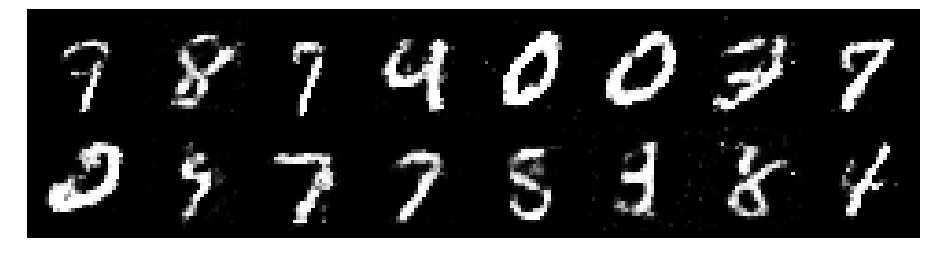

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.2020, Generator Loss: 0.9103
D(x): 0.5875, D(G(z)): 0.4412


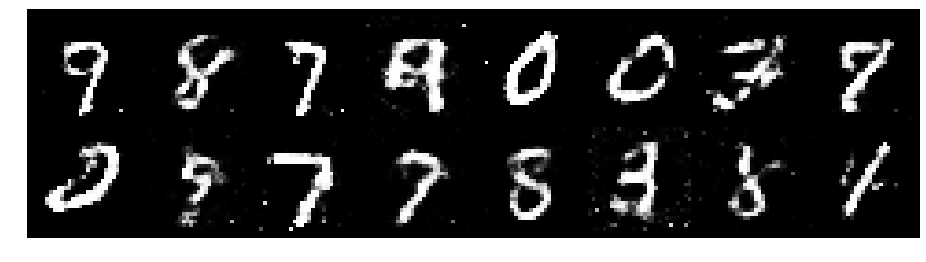

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.2220, Generator Loss: 0.8347
D(x): 0.5692, D(G(z)): 0.4541


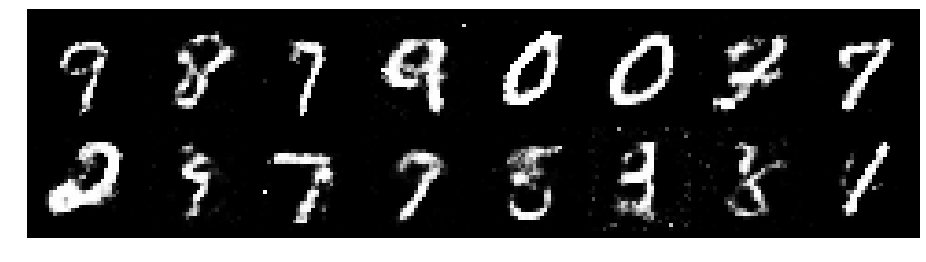

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.1905, Generator Loss: 1.0229
D(x): 0.5457, D(G(z)): 0.3877


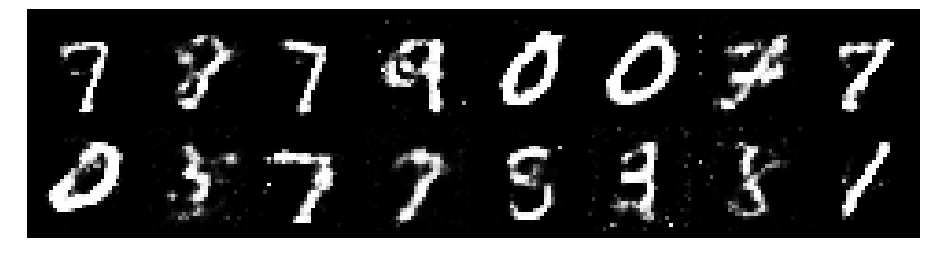

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.2253, Generator Loss: 0.9561
D(x): 0.5450, D(G(z)): 0.4161


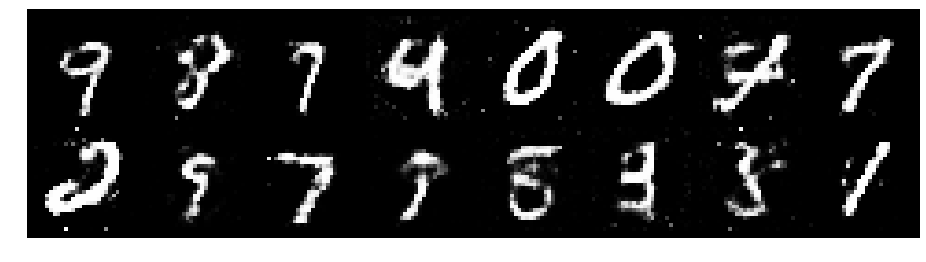

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.2459, Generator Loss: 0.8713
D(x): 0.5467, D(G(z)): 0.4320


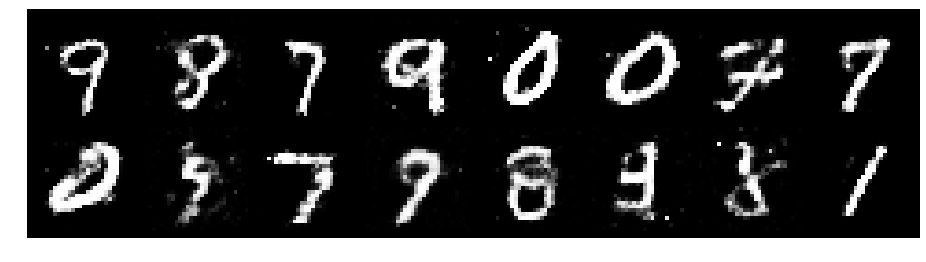

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.2898, Generator Loss: 0.9915
D(x): 0.5275, D(G(z)): 0.4359


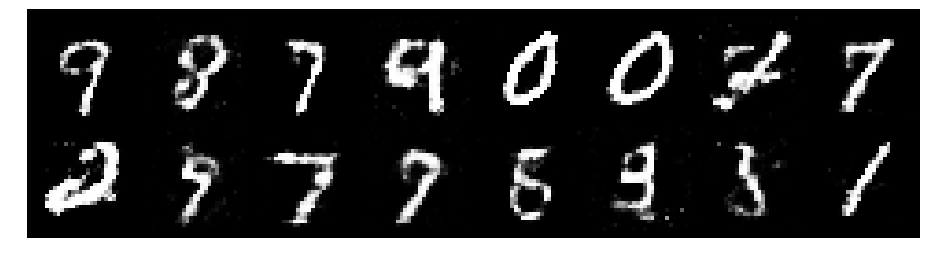

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.1772, Generator Loss: 1.0061
D(x): 0.5341, D(G(z)): 0.3815


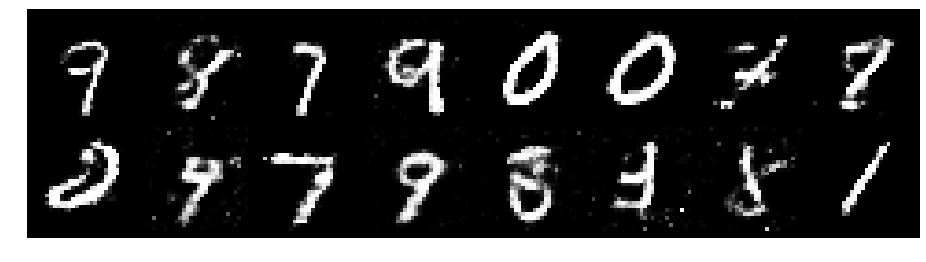

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.3353, Generator Loss: 0.9199
D(x): 0.5432, D(G(z)): 0.4664


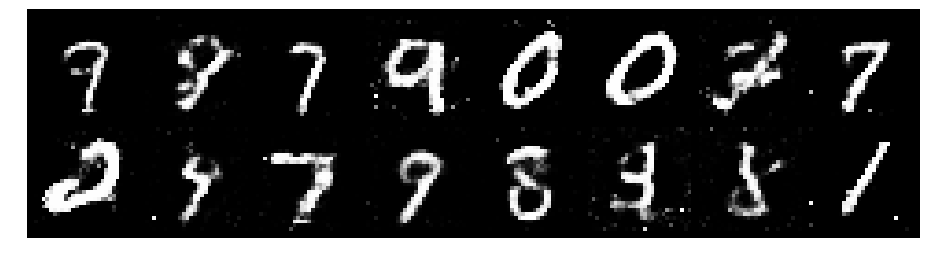

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.1856, Generator Loss: 0.8318
D(x): 0.5597, D(G(z)): 0.4218


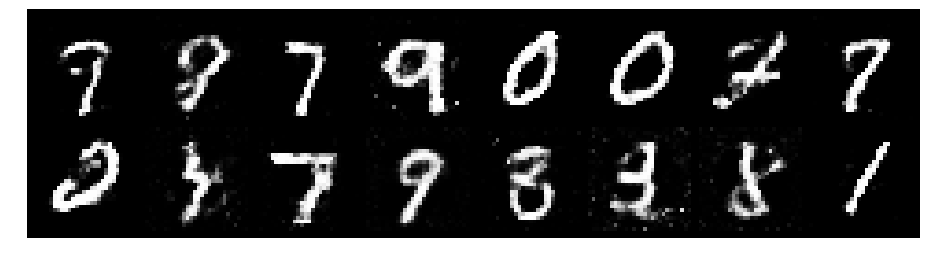

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.1904, Generator Loss: 1.0483
D(x): 0.5387, D(G(z)): 0.3740


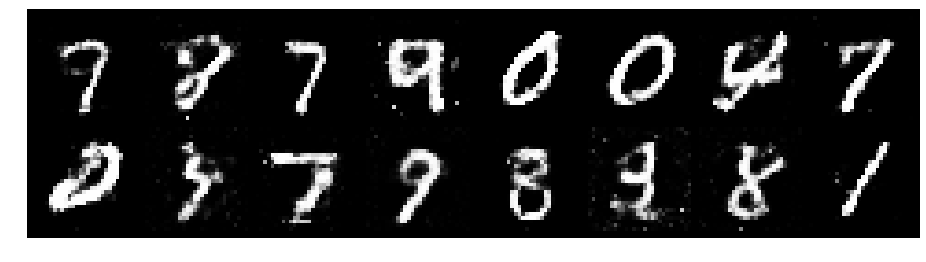

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.2344, Generator Loss: 0.9529
D(x): 0.5670, D(G(z)): 0.4558


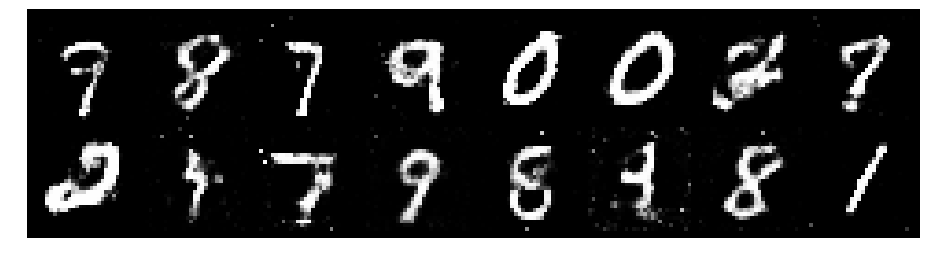

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.2354, Generator Loss: 1.0499
D(x): 0.5877, D(G(z)): 0.4525


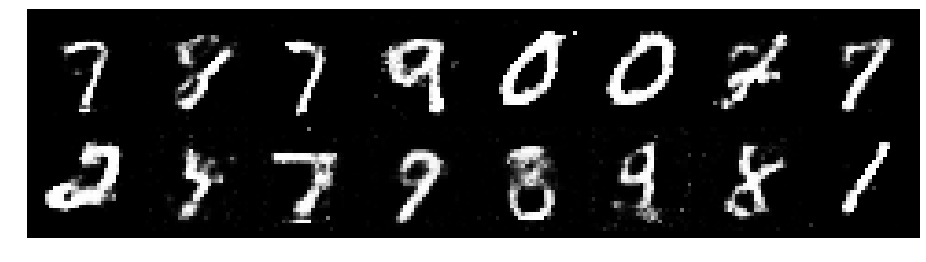

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.2700, Generator Loss: 0.9296
D(x): 0.5427, D(G(z)): 0.4351


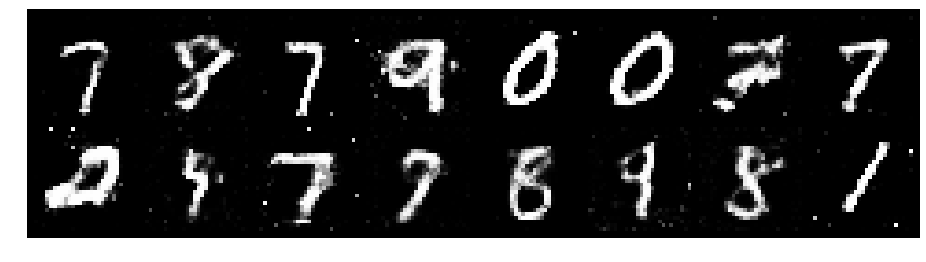

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.3445, Generator Loss: 0.9133
D(x): 0.5158, D(G(z)): 0.4473


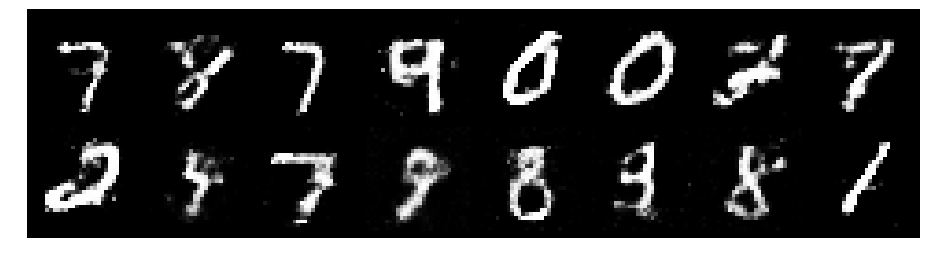

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.2136, Generator Loss: 0.9302
D(x): 0.5384, D(G(z)): 0.4170


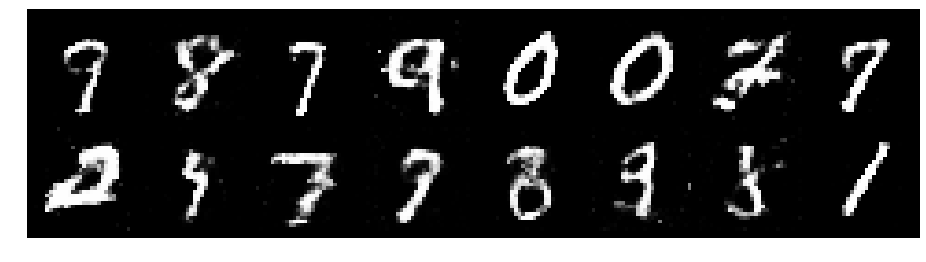

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.2537, Generator Loss: 1.0619
D(x): 0.5176, D(G(z)): 0.3965


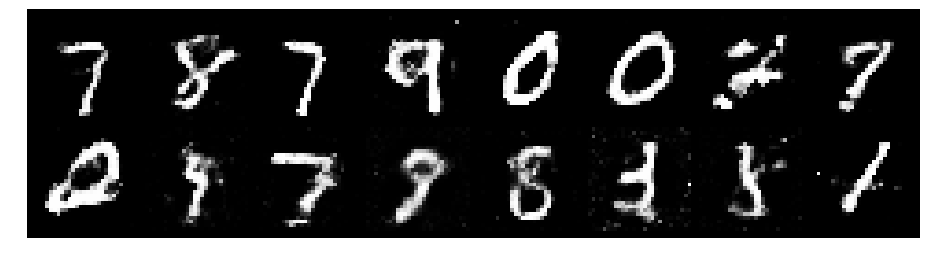

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.2014, Generator Loss: 0.8791
D(x): 0.5578, D(G(z)): 0.4152


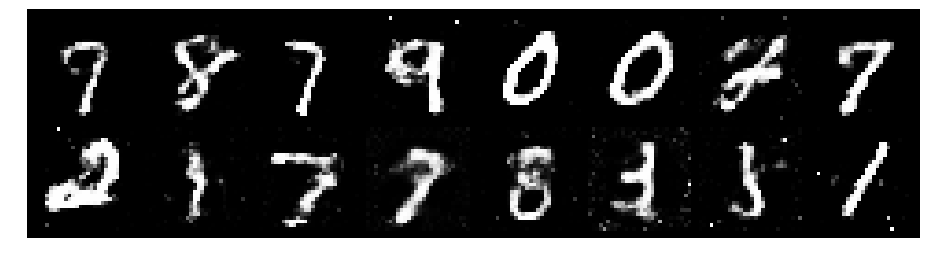

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.2798, Generator Loss: 0.9161
D(x): 0.5533, D(G(z)): 0.4567


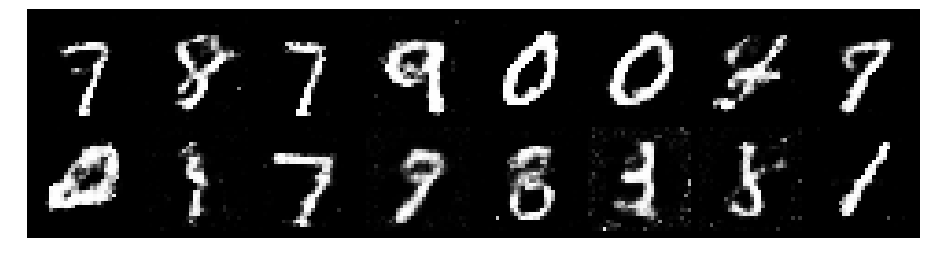

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.3076, Generator Loss: 0.8401
D(x): 0.5234, D(G(z)): 0.4480


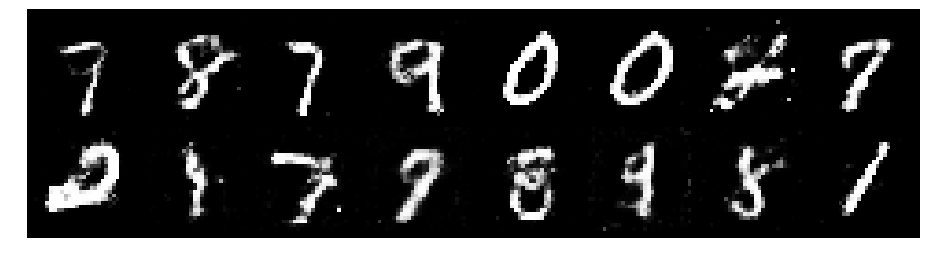

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.1848, Generator Loss: 0.9216
D(x): 0.5723, D(G(z)): 0.4075


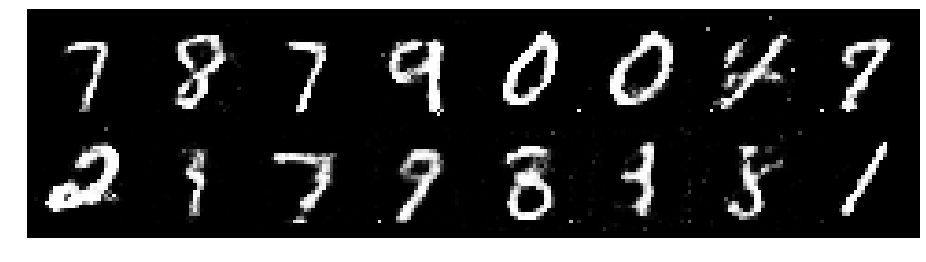

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.2136, Generator Loss: 0.8766
D(x): 0.5545, D(G(z)): 0.4304


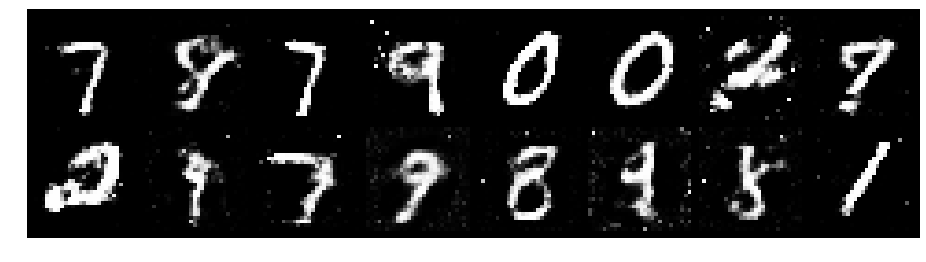

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.2242, Generator Loss: 0.9363
D(x): 0.5861, D(G(z)): 0.4446


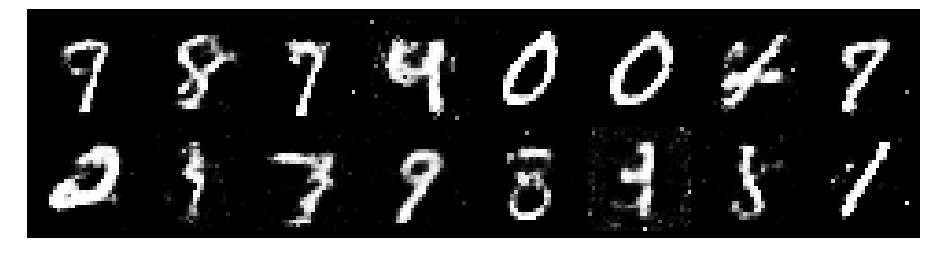

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.2201, Generator Loss: 0.8699
D(x): 0.5625, D(G(z)): 0.4182


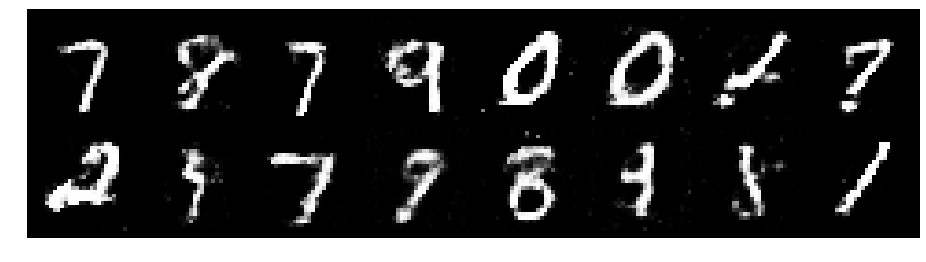

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.3236, Generator Loss: 0.8008
D(x): 0.5361, D(G(z)): 0.4726


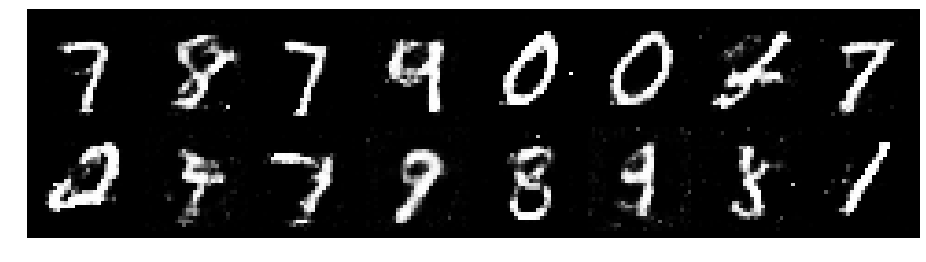

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.2878, Generator Loss: 0.8364
D(x): 0.5403, D(G(z)): 0.4444


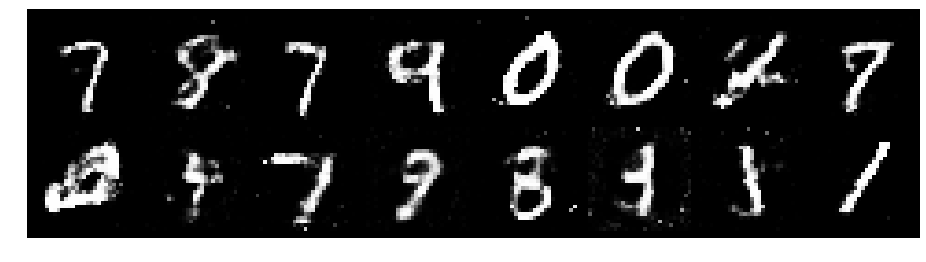

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.3501, Generator Loss: 0.8474
D(x): 0.5263, D(G(z)): 0.4506


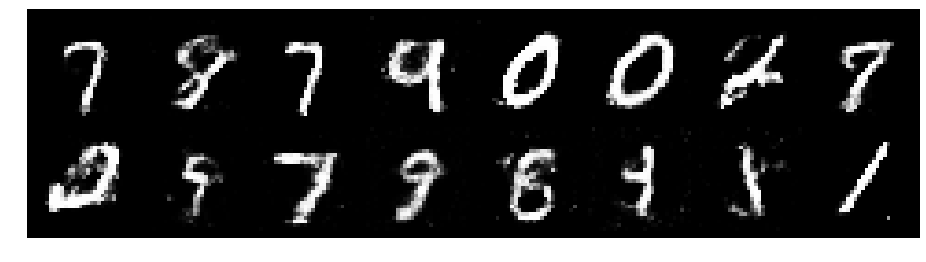

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.3600, Generator Loss: 0.8201
D(x): 0.5699, D(G(z)): 0.5055


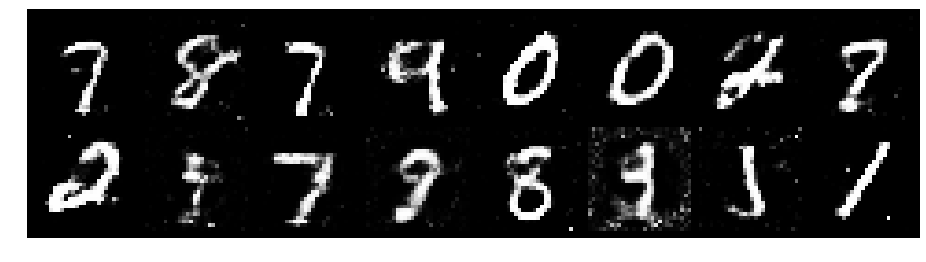

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.3288, Generator Loss: 0.8164
D(x): 0.5545, D(G(z)): 0.4740


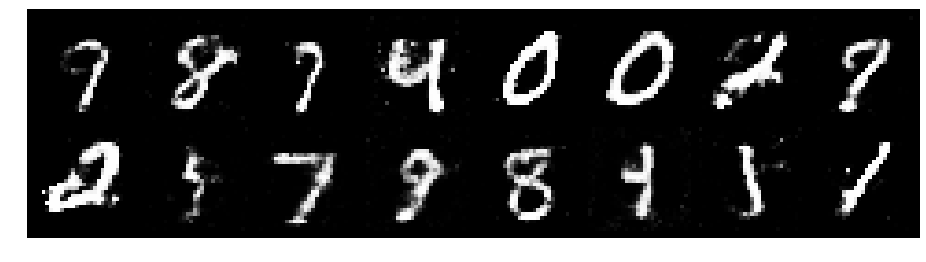

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.2573, Generator Loss: 0.9094
D(x): 0.5504, D(G(z)): 0.4248


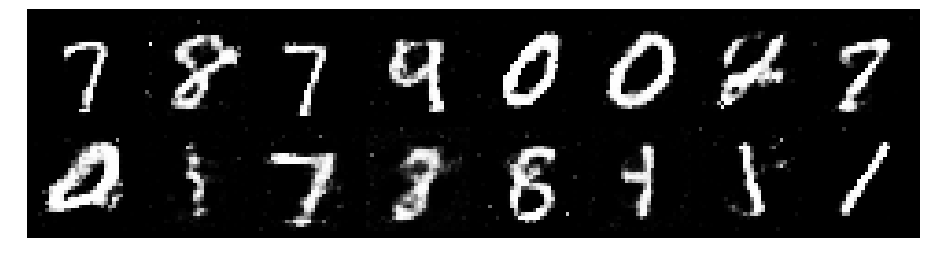

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.5199, Generator Loss: 0.7585
D(x): 0.6068, D(G(z)): 0.5550


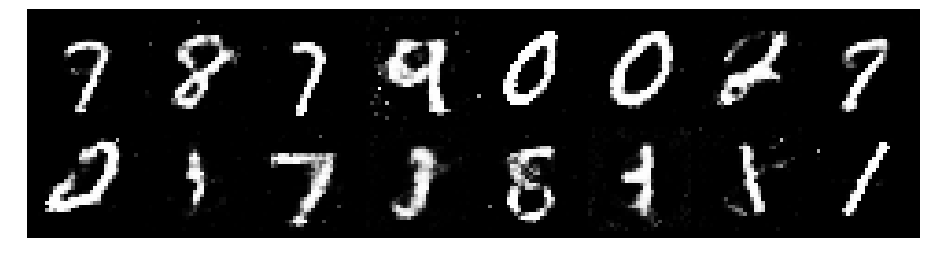

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.3412, Generator Loss: 0.9178
D(x): 0.5374, D(G(z)): 0.4435


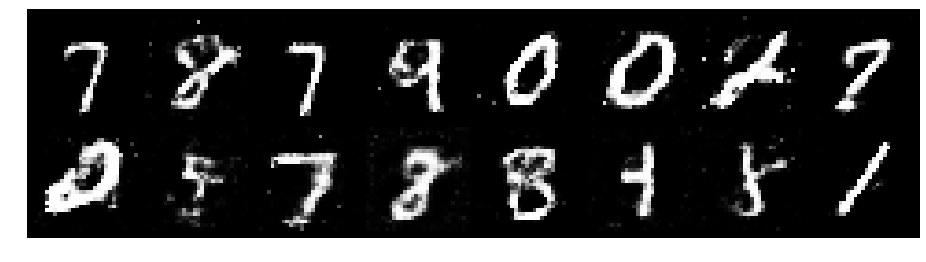

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.2752, Generator Loss: 0.8358
D(x): 0.5898, D(G(z)): 0.4607


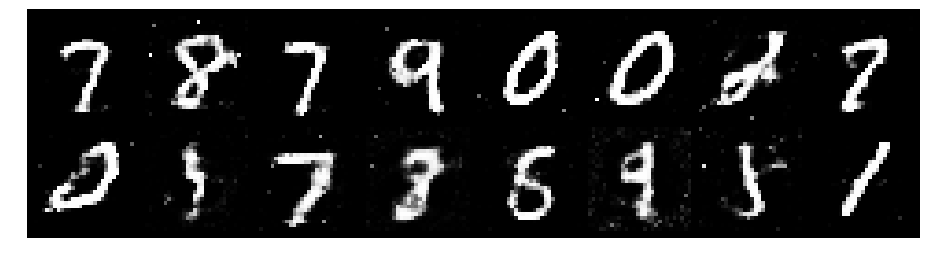

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.3453, Generator Loss: 0.8789
D(x): 0.5860, D(G(z)): 0.4810


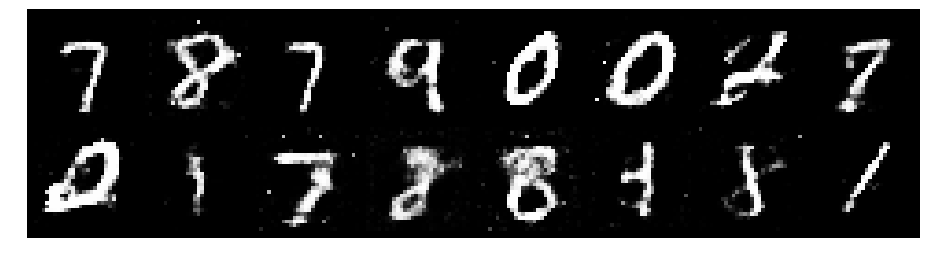

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.1948, Generator Loss: 0.8630
D(x): 0.5867, D(G(z)): 0.4401


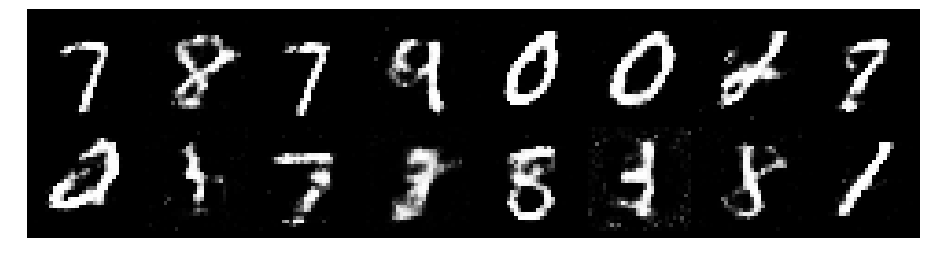

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.3921, Generator Loss: 0.9457
D(x): 0.5265, D(G(z)): 0.4366


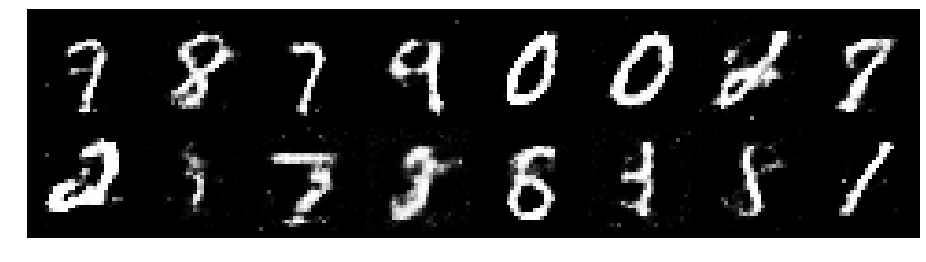

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.1620, Generator Loss: 1.0771
D(x): 0.5931, D(G(z)): 0.4064


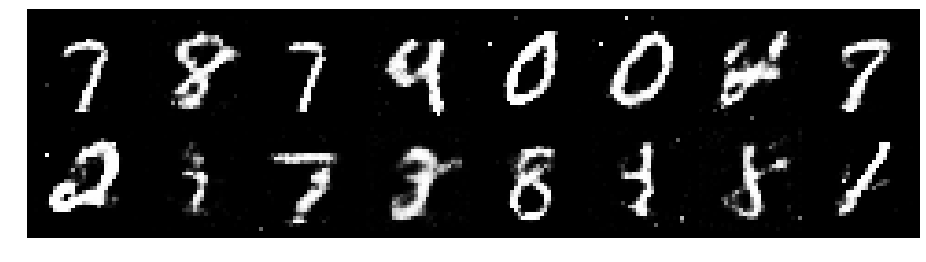

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.2031, Generator Loss: 0.8925
D(x): 0.5787, D(G(z)): 0.4350


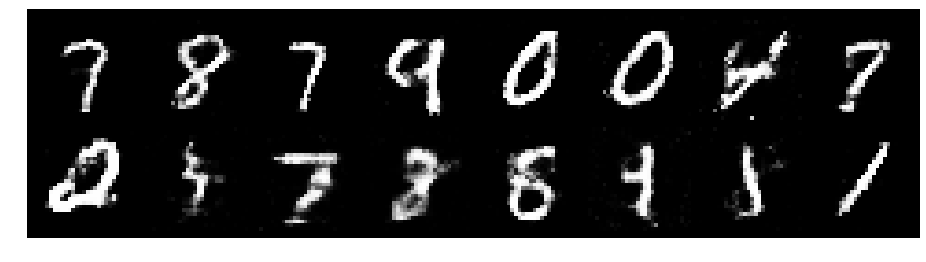

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.1069, Generator Loss: 0.9819
D(x): 0.6082, D(G(z)): 0.3988


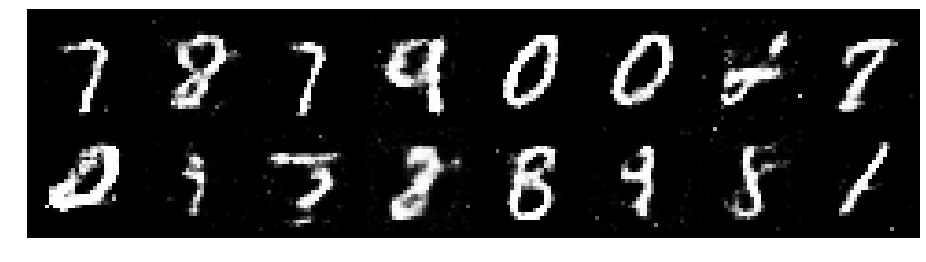

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.1889, Generator Loss: 0.8750
D(x): 0.6150, D(G(z)): 0.4610


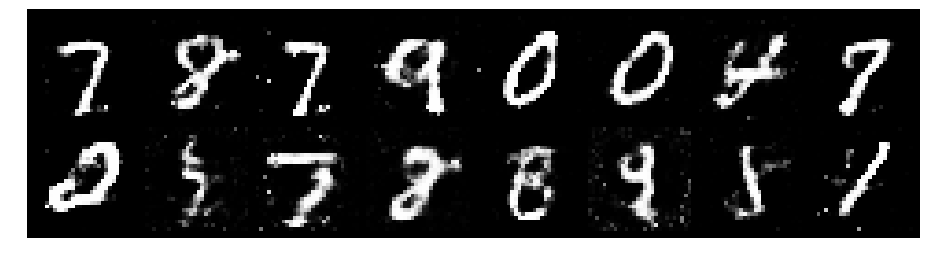

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.2636, Generator Loss: 0.9572
D(x): 0.5537, D(G(z)): 0.4223


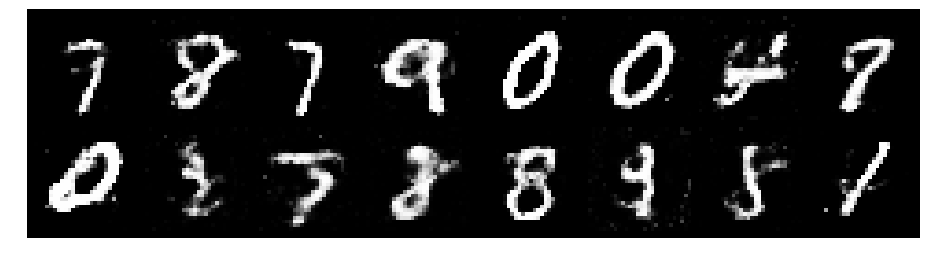

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.2960, Generator Loss: 0.8742
D(x): 0.5572, D(G(z)): 0.4532


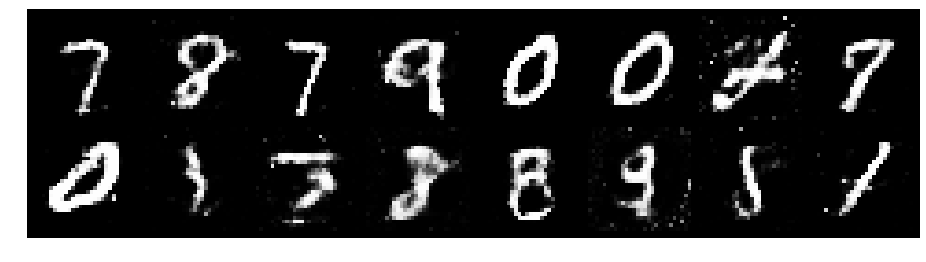

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.1432, Generator Loss: 0.9697
D(x): 0.5848, D(G(z)): 0.4083


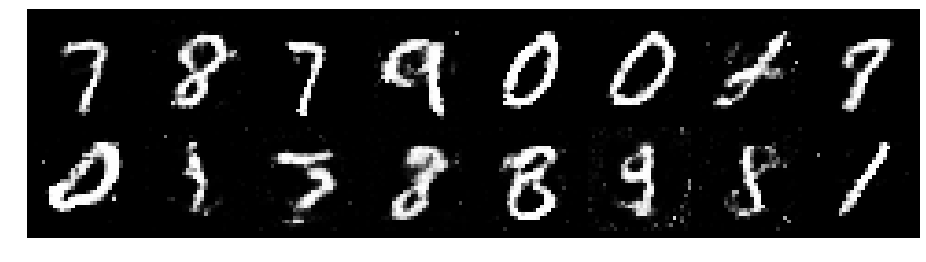

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.3198, Generator Loss: 0.7790
D(x): 0.5268, D(G(z)): 0.4647


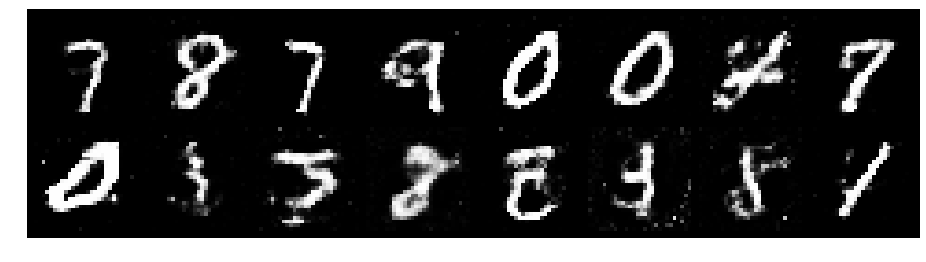

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.2433, Generator Loss: 0.8471
D(x): 0.5558, D(G(z)): 0.4403


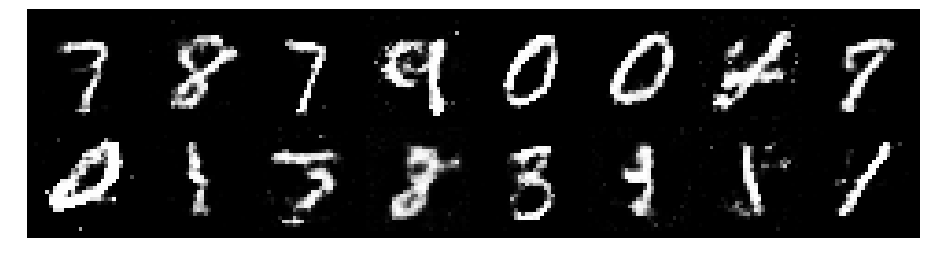

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.1793, Generator Loss: 1.0224
D(x): 0.5528, D(G(z)): 0.3856


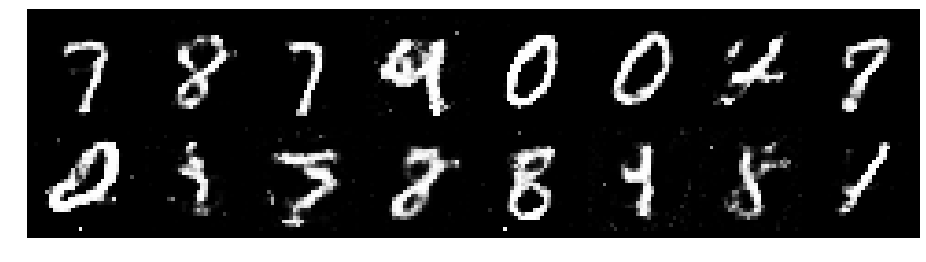

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.2711, Generator Loss: 0.9519
D(x): 0.5272, D(G(z)): 0.4365


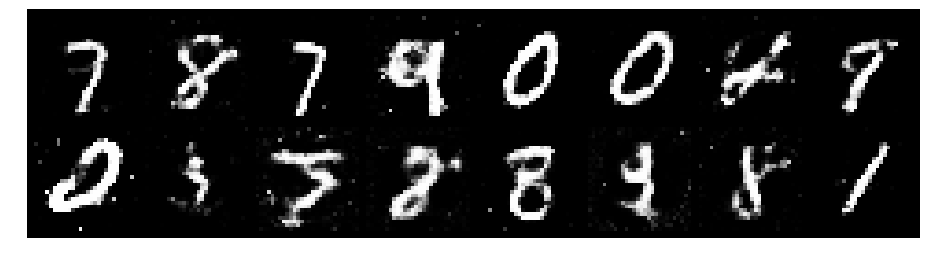

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.2906, Generator Loss: 0.8493
D(x): 0.5358, D(G(z)): 0.4392


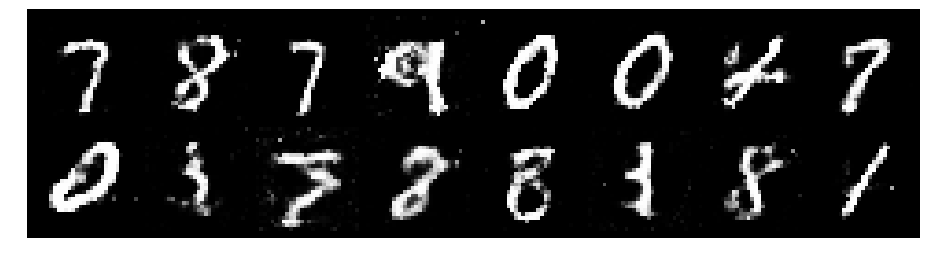

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.2514, Generator Loss: 0.8296
D(x): 0.5348, D(G(z)): 0.4349


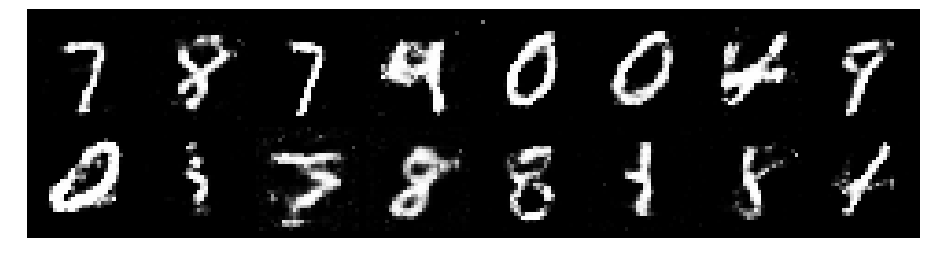

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.2345, Generator Loss: 0.8668
D(x): 0.6014, D(G(z)): 0.4726


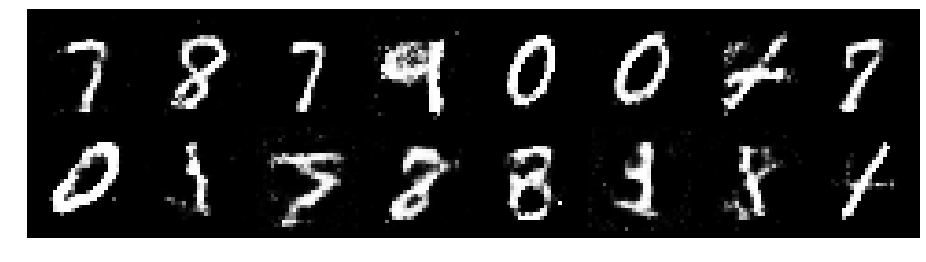

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.2139, Generator Loss: 0.8297
D(x): 0.5658, D(G(z)): 0.4421


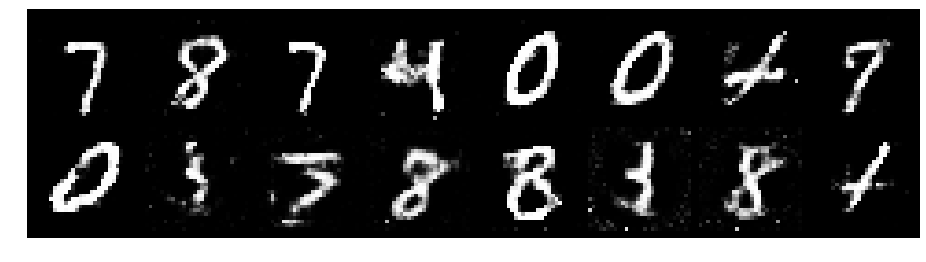

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.2141, Generator Loss: 0.9276
D(x): 0.5492, D(G(z)): 0.4120


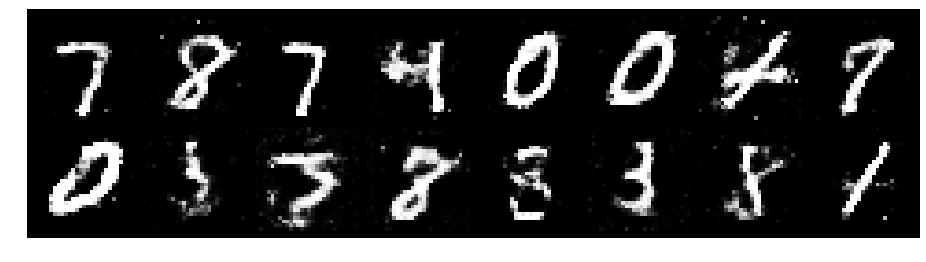

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.2399, Generator Loss: 0.9627
D(x): 0.5349, D(G(z)): 0.4166


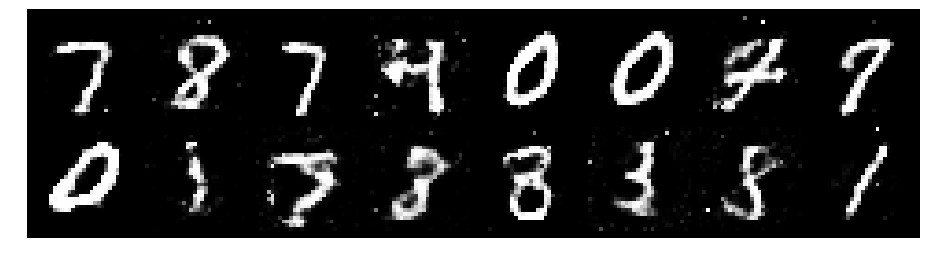

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.2137, Generator Loss: 1.0199
D(x): 0.5846, D(G(z)): 0.4216


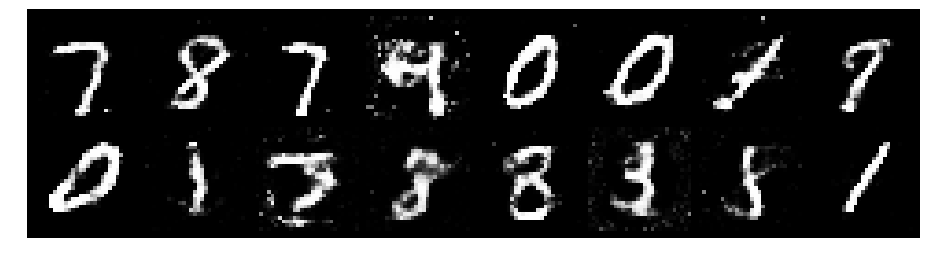

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.3593, Generator Loss: 0.8420
D(x): 0.5414, D(G(z)): 0.4739


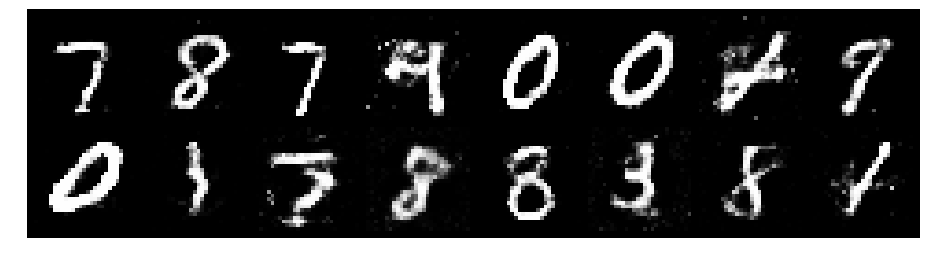

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.2614, Generator Loss: 0.8560
D(x): 0.5994, D(G(z)): 0.4669


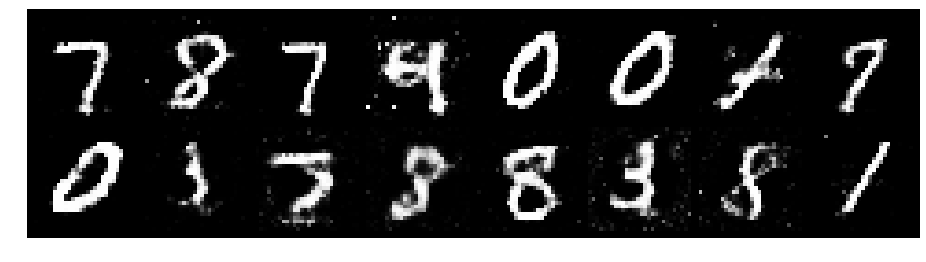

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.3516, Generator Loss: 0.9303
D(x): 0.5697, D(G(z)): 0.4911


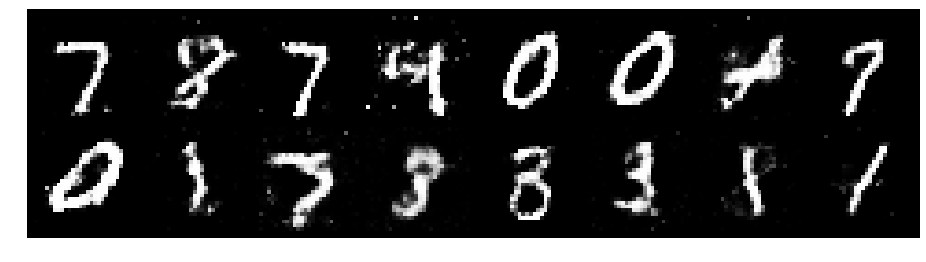

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.1420, Generator Loss: 1.0315
D(x): 0.5652, D(G(z)): 0.3706


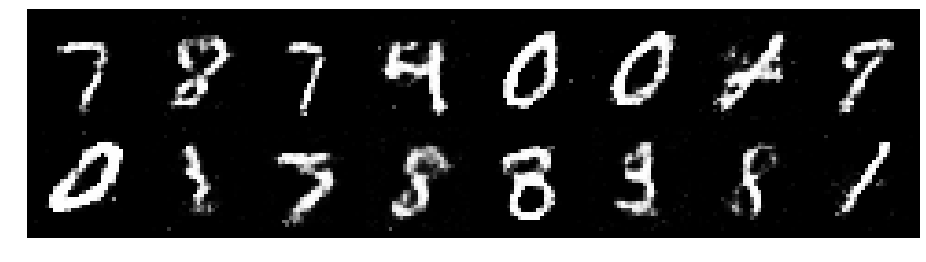

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.1690, Generator Loss: 1.0425
D(x): 0.5534, D(G(z)): 0.4003


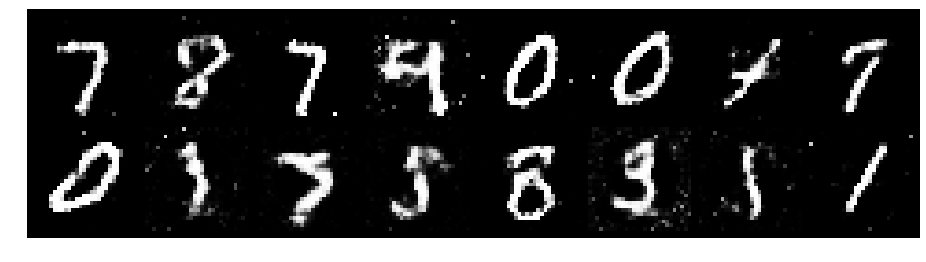

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.2291, Generator Loss: 0.9294
D(x): 0.5524, D(G(z)): 0.4247


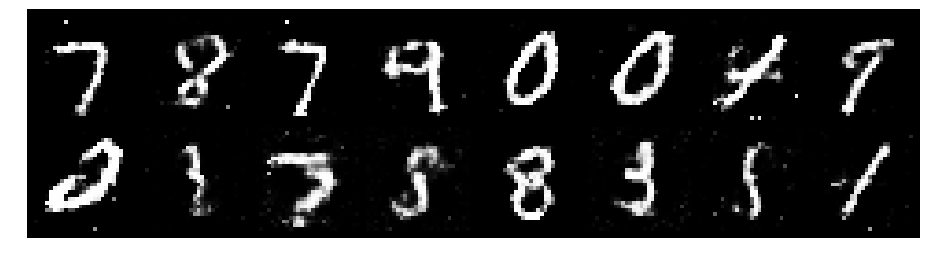

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.2551, Generator Loss: 0.8777
D(x): 0.5526, D(G(z)): 0.4293


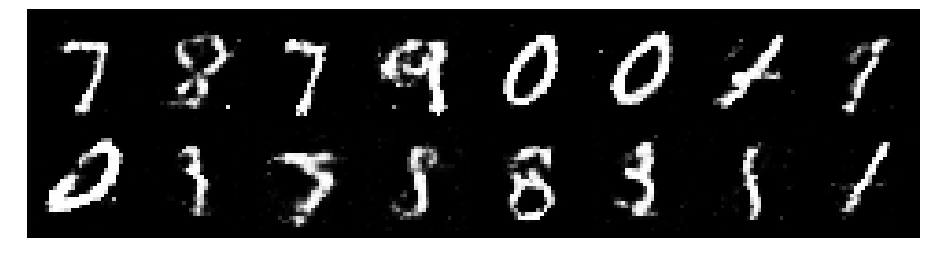

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.2178, Generator Loss: 0.8707
D(x): 0.5592, D(G(z)): 0.4304


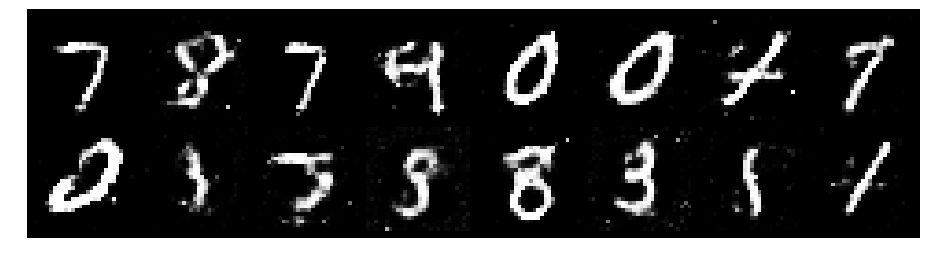

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.1833, Generator Loss: 0.8896
D(x): 0.5591, D(G(z)): 0.4133


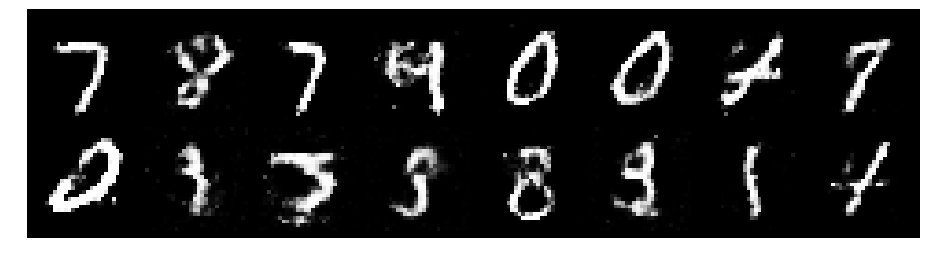

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.3304, Generator Loss: 0.8162
D(x): 0.5281, D(G(z)): 0.4654


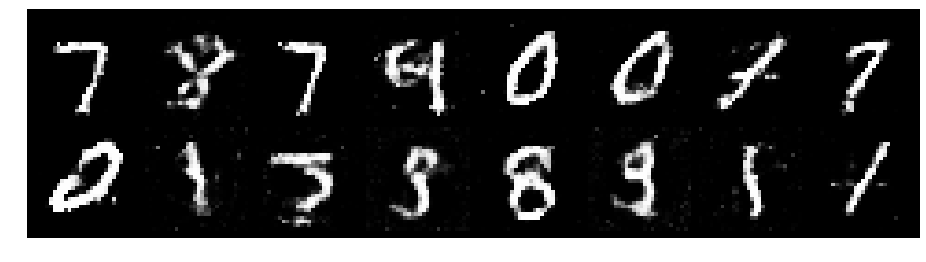

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.2788, Generator Loss: 0.8709
D(x): 0.5650, D(G(z)): 0.4574


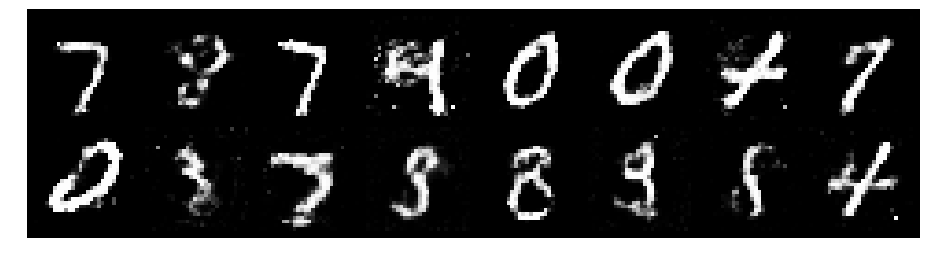

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.2909, Generator Loss: 0.8258
D(x): 0.5498, D(G(z)): 0.4574


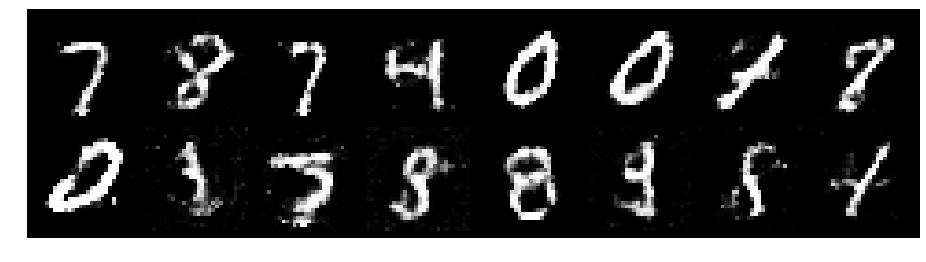

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.2368, Generator Loss: 0.8133
D(x): 0.5725, D(G(z)): 0.4551


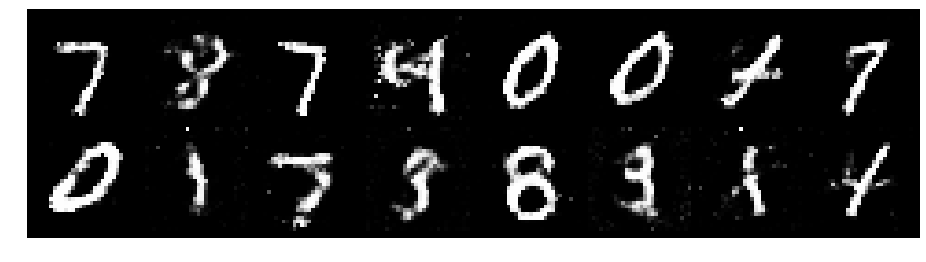

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.3205, Generator Loss: 0.9199
D(x): 0.5129, D(G(z)): 0.4491


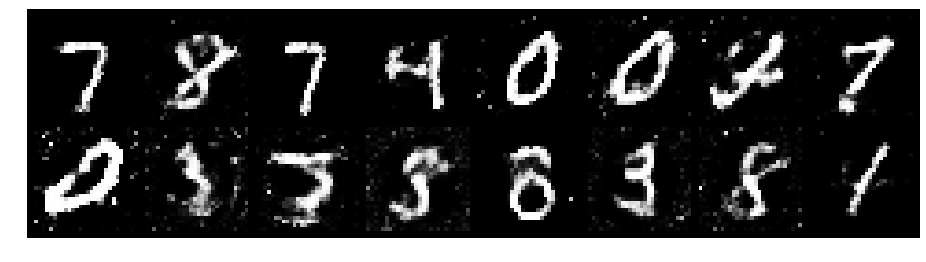

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.3478, Generator Loss: 0.8806
D(x): 0.5310, D(G(z)): 0.4740


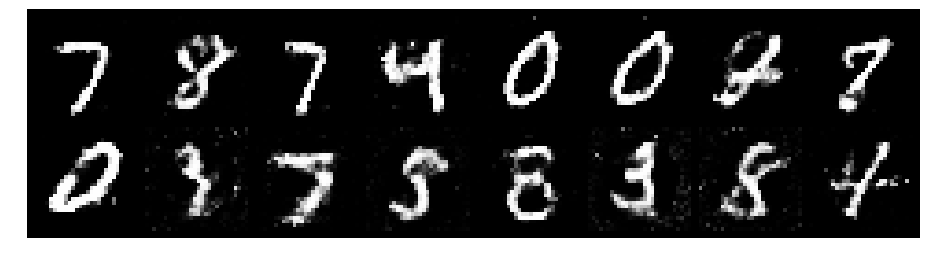

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.3521, Generator Loss: 0.8475
D(x): 0.5645, D(G(z)): 0.4927


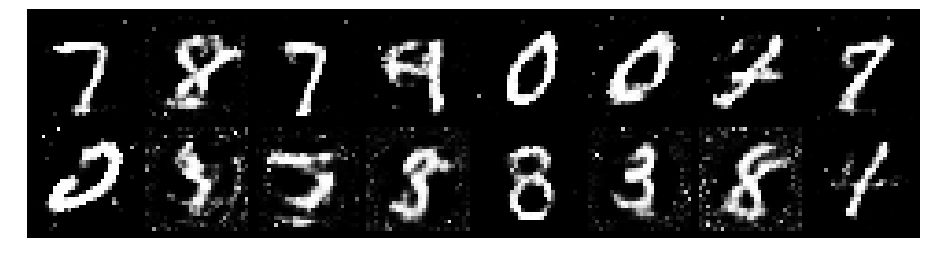

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.2229, Generator Loss: 0.9668
D(x): 0.5533, D(G(z)): 0.4288


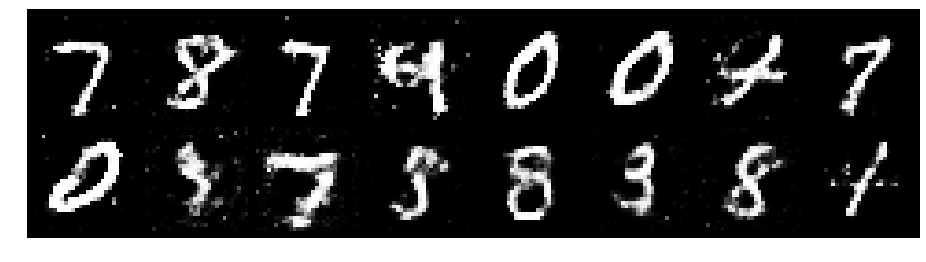

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.3189, Generator Loss: 0.7963
D(x): 0.5385, D(G(z)): 0.4325


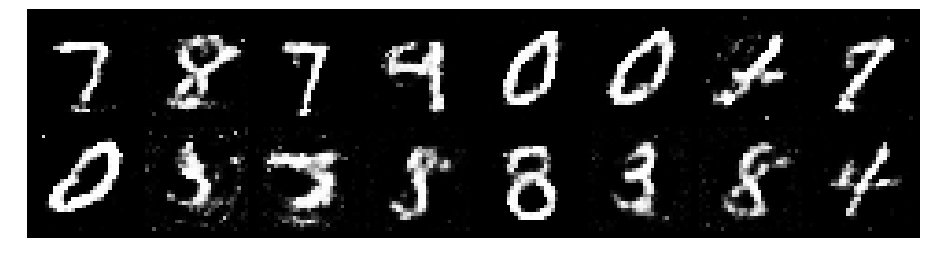

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.2722, Generator Loss: 0.9128
D(x): 0.5288, D(G(z)): 0.4159


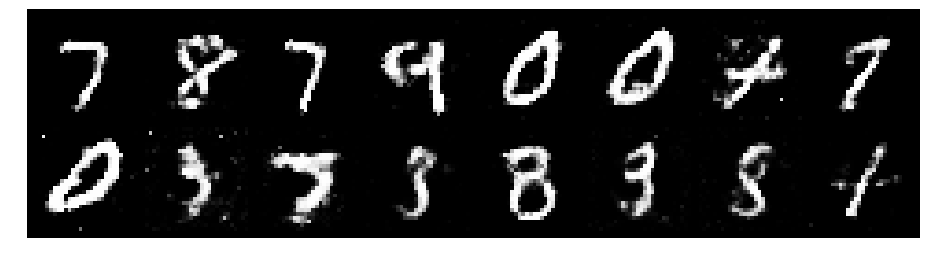

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.3201, Generator Loss: 0.8124
D(x): 0.5585, D(G(z)): 0.4918


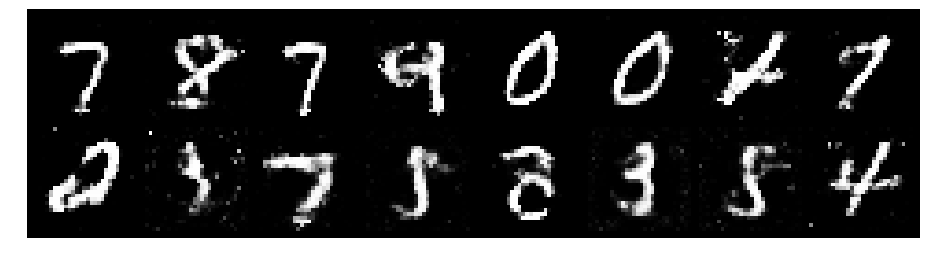

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.3701, Generator Loss: 0.8138
D(x): 0.5221, D(G(z)): 0.4517


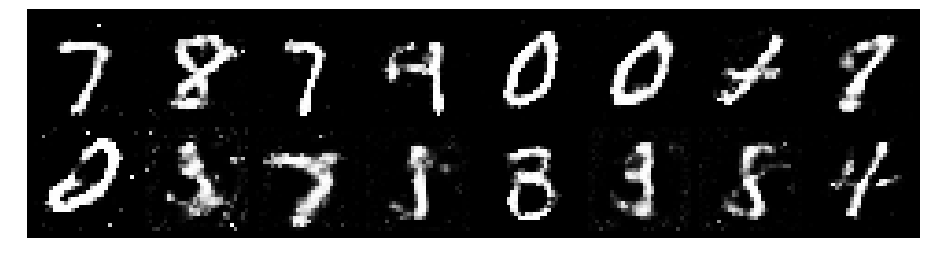

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.3454, Generator Loss: 0.7864
D(x): 0.5577, D(G(z)): 0.4731


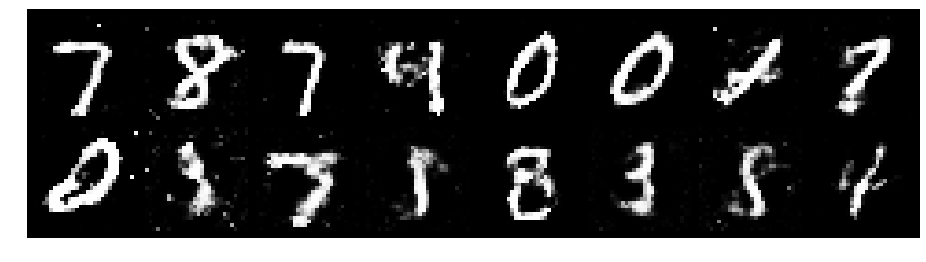

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.3102, Generator Loss: 0.9120
D(x): 0.5487, D(G(z)): 0.4643


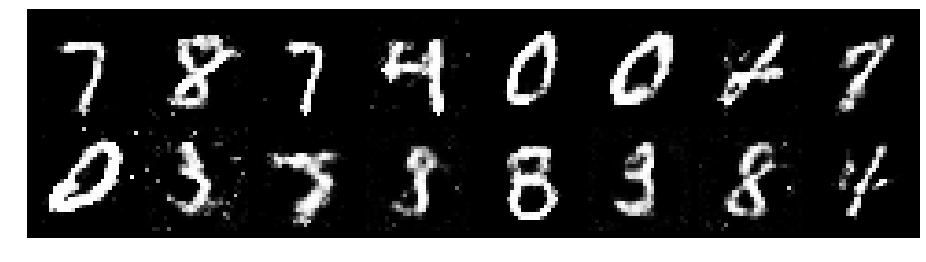

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.3385, Generator Loss: 0.8650
D(x): 0.5224, D(G(z)): 0.4585


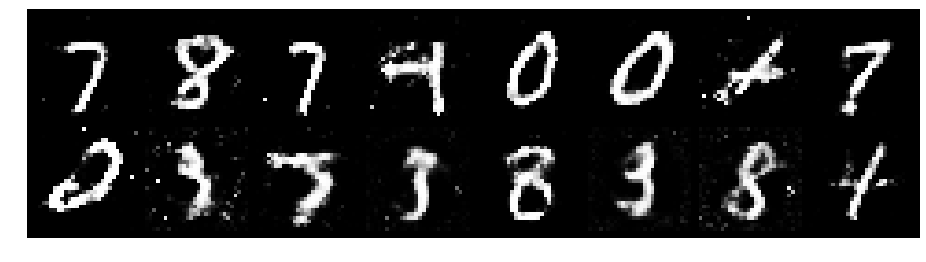

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.3478, Generator Loss: 0.9343
D(x): 0.5461, D(G(z)): 0.4902


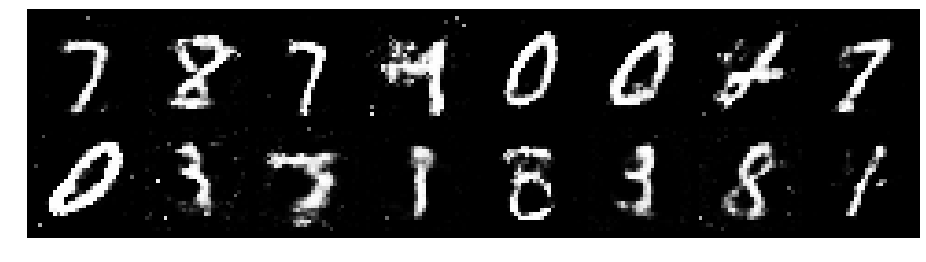

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.2444, Generator Loss: 0.8174
D(x): 0.5706, D(G(z)): 0.4588


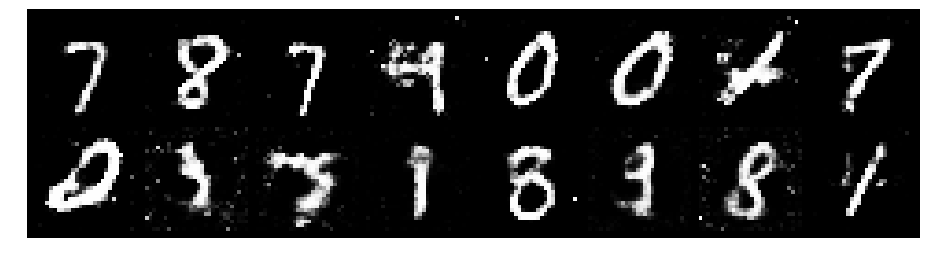

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.2647, Generator Loss: 0.8578
D(x): 0.5639, D(G(z)): 0.4559


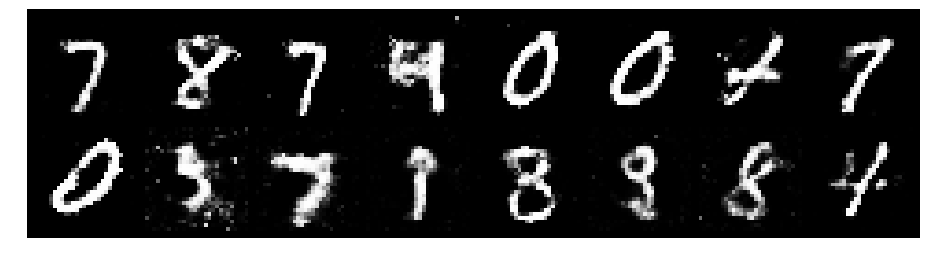

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.2550, Generator Loss: 0.8551
D(x): 0.5317, D(G(z)): 0.4215


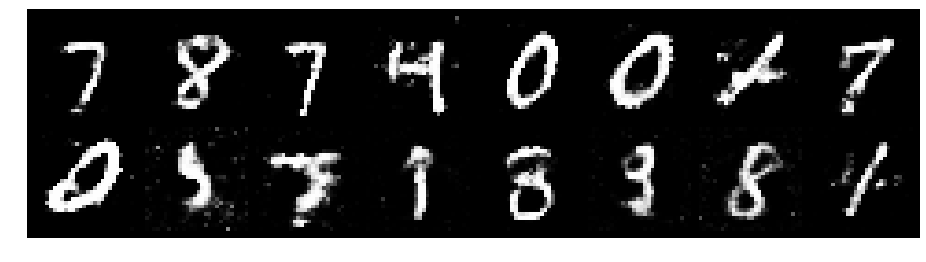

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.2719, Generator Loss: 0.8796
D(x): 0.5308, D(G(z)): 0.4322


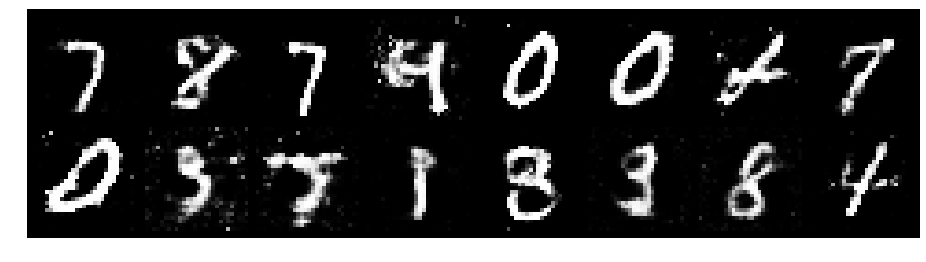

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.2868, Generator Loss: 0.9871
D(x): 0.5621, D(G(z)): 0.4513


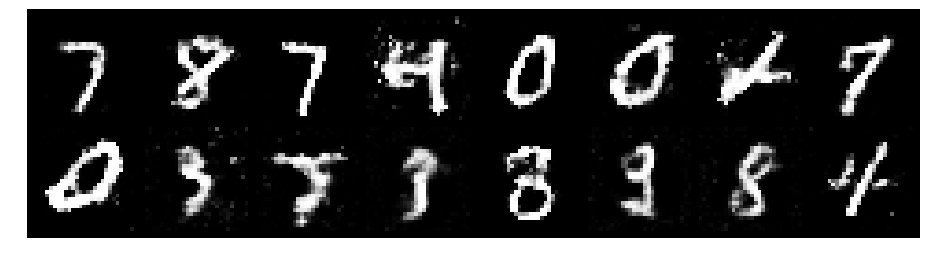

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.2722, Generator Loss: 0.9632
D(x): 0.5262, D(G(z)): 0.4216


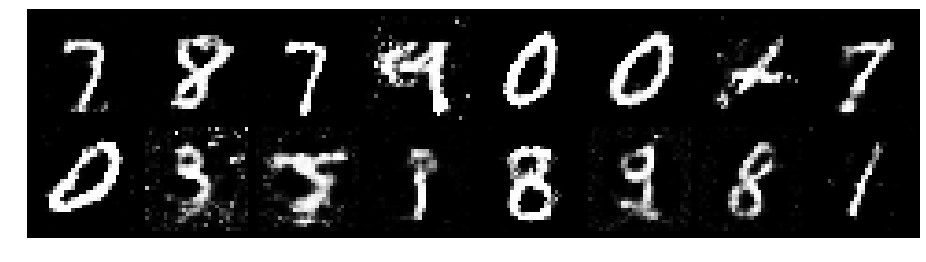

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.2700, Generator Loss: 0.9994
D(x): 0.5504, D(G(z)): 0.4384


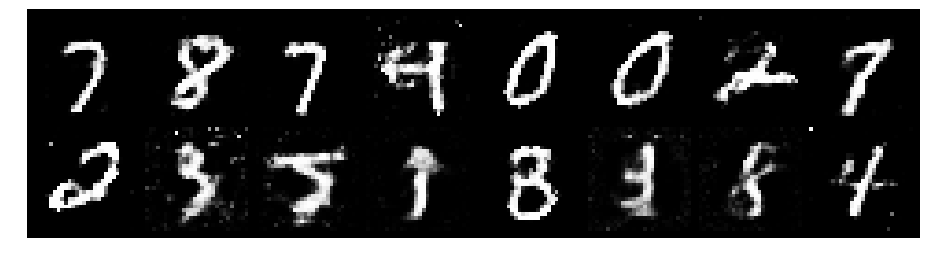

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.3878, Generator Loss: 0.8964
D(x): 0.5573, D(G(z)): 0.4822


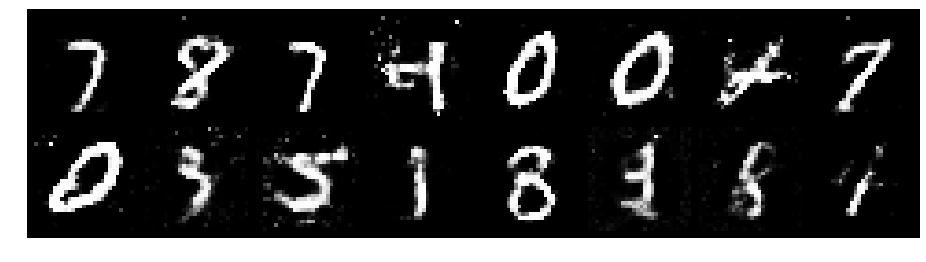

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.2893, Generator Loss: 0.8052
D(x): 0.5476, D(G(z)): 0.4469


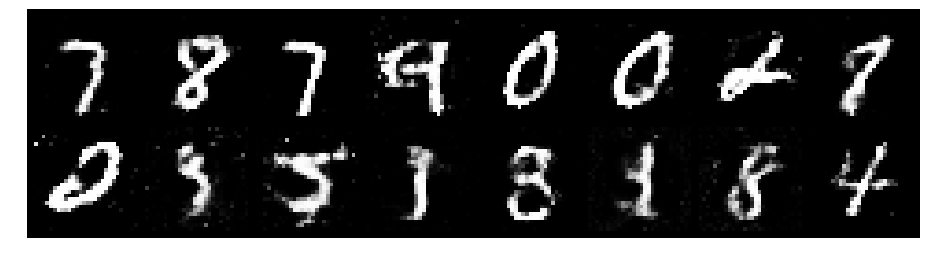

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.2701, Generator Loss: 0.8851
D(x): 0.5456, D(G(z)): 0.4374


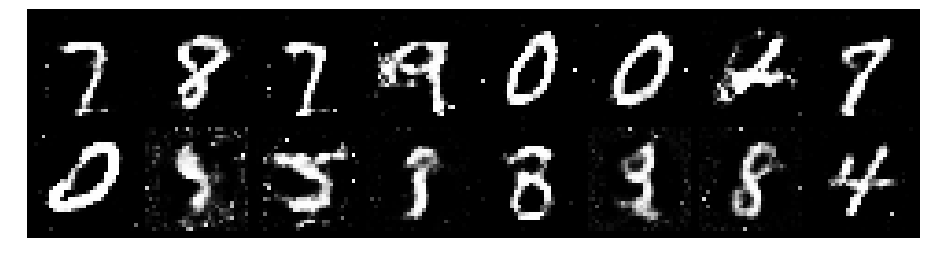

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.2447, Generator Loss: 0.9129
D(x): 0.5454, D(G(z)): 0.4093


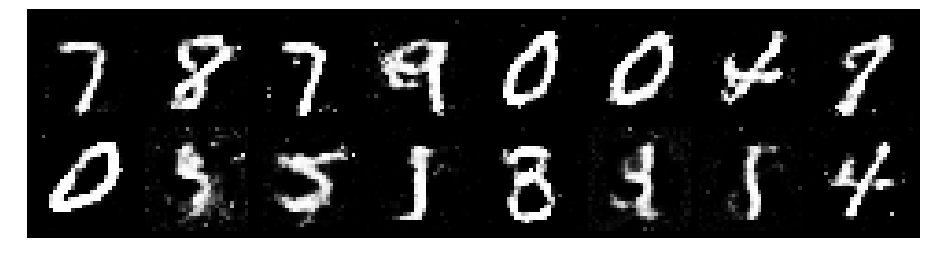

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.4053, Generator Loss: 0.7789
D(x): 0.6056, D(G(z)): 0.5302


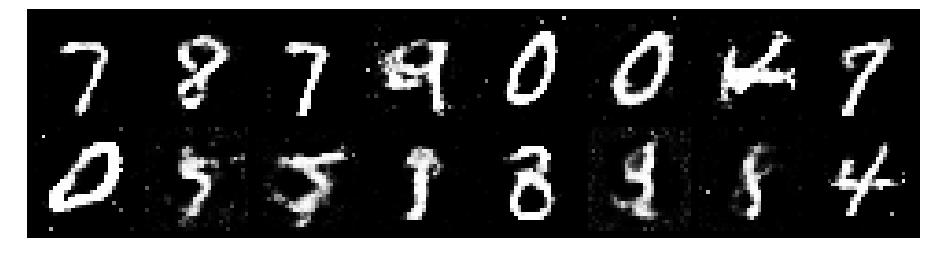

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.3222, Generator Loss: 0.8036
D(x): 0.5583, D(G(z)): 0.4820


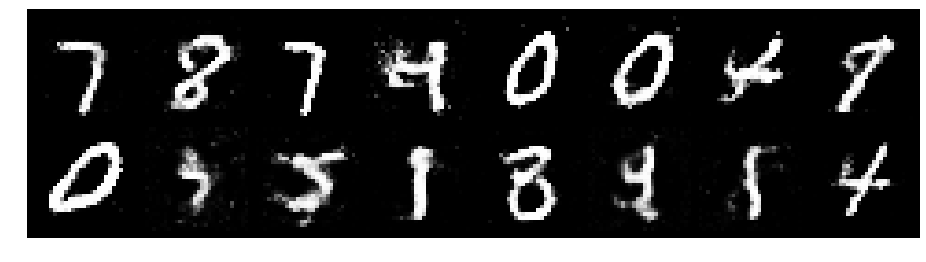

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.3538, Generator Loss: 0.8747
D(x): 0.5955, D(G(z)): 0.5131


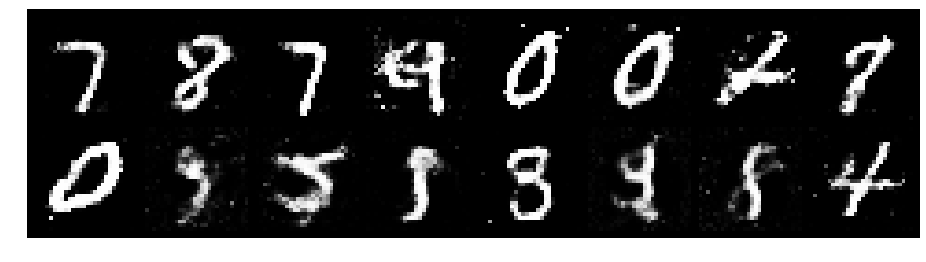

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.3115, Generator Loss: 0.8640
D(x): 0.5449, D(G(z)): 0.4636


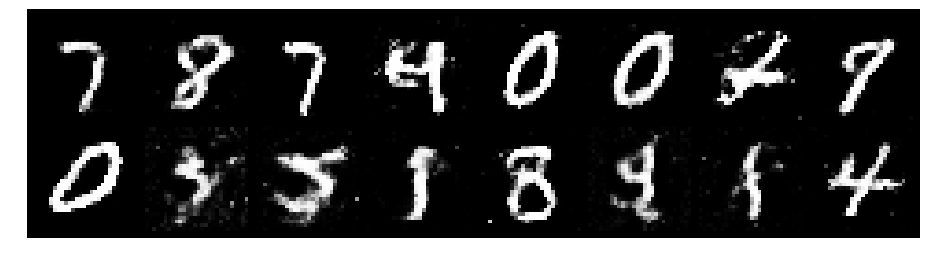

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.2559, Generator Loss: 0.8091
D(x): 0.5575, D(G(z)): 0.4497


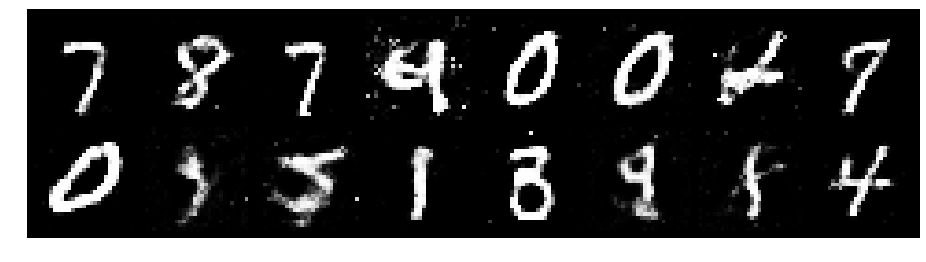

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.2745, Generator Loss: 0.8928
D(x): 0.5734, D(G(z)): 0.4483


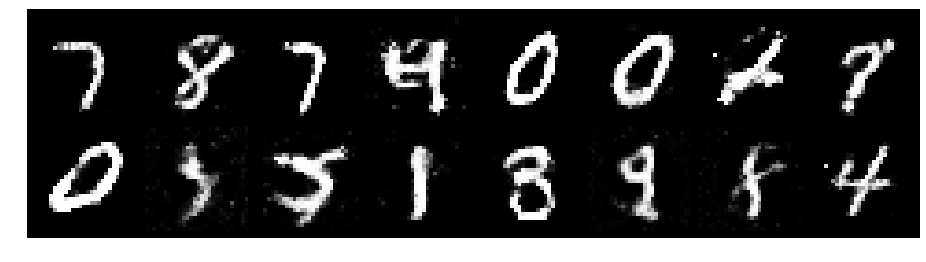

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.3281, Generator Loss: 0.8126
D(x): 0.5294, D(G(z)): 0.4565


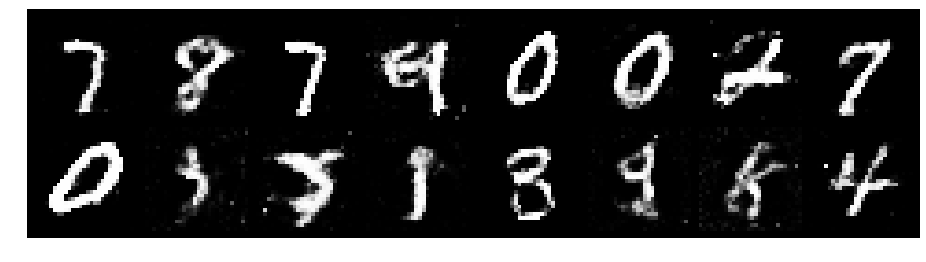

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.3622, Generator Loss: 0.7952
D(x): 0.5083, D(G(z)): 0.4420


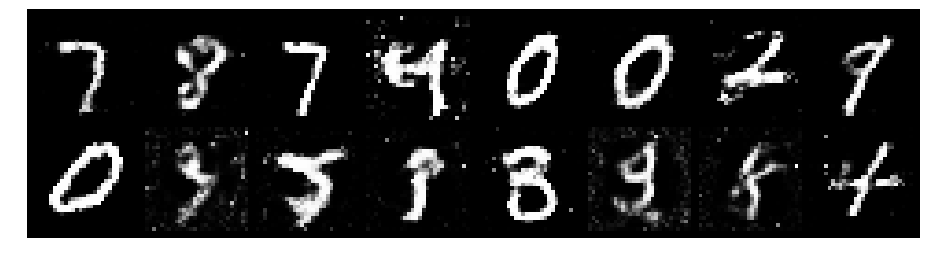

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.2294, Generator Loss: 0.8612
D(x): 0.5684, D(G(z)): 0.4564


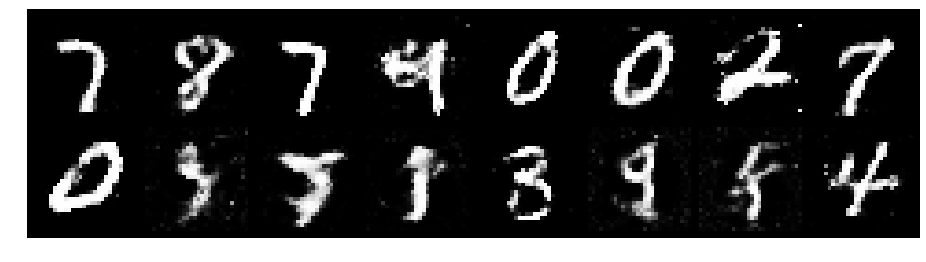

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.2917, Generator Loss: 0.8302
D(x): 0.5577, D(G(z)): 0.4540


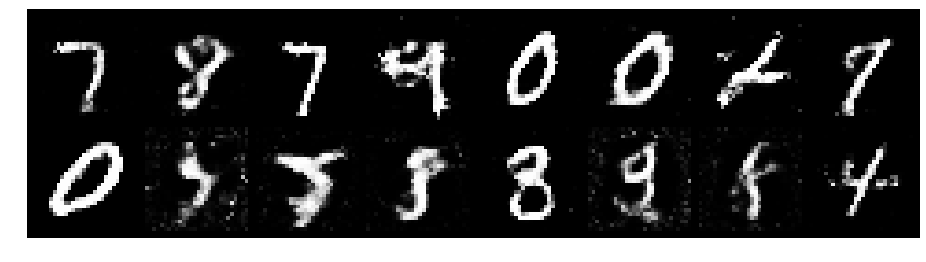

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.2522, Generator Loss: 0.8516
D(x): 0.5521, D(G(z)): 0.4503


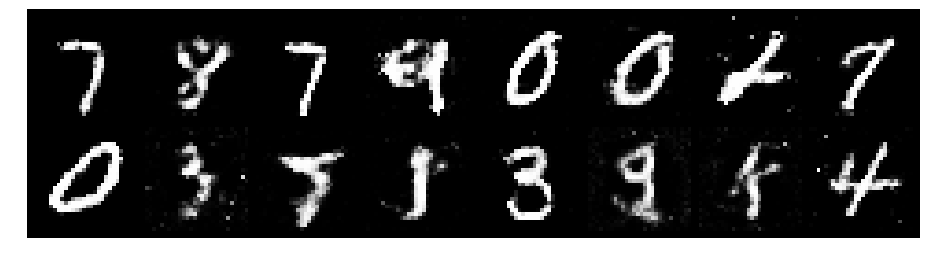

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.2552, Generator Loss: 0.9071
D(x): 0.5687, D(G(z)): 0.4395


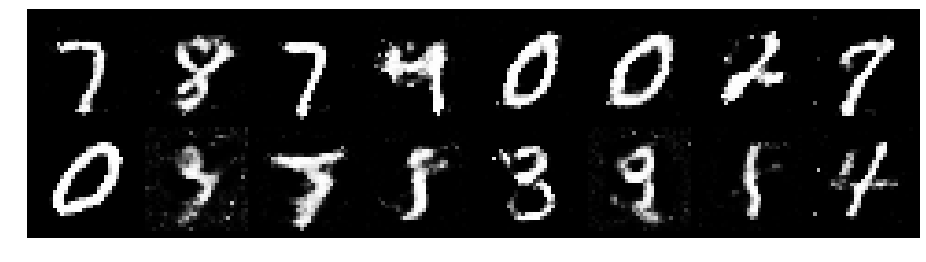

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.2139, Generator Loss: 0.9014
D(x): 0.5750, D(G(z)): 0.4335


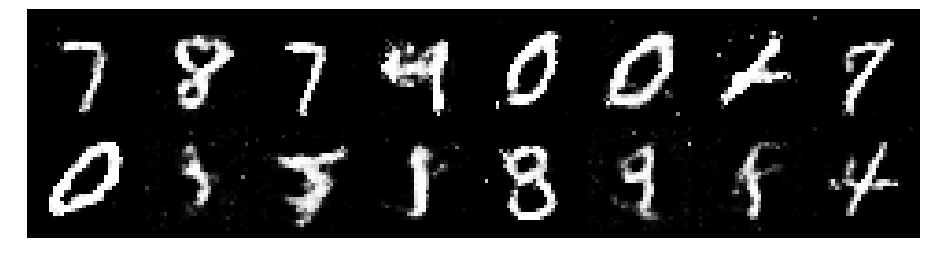

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.2588, Generator Loss: 0.8653
D(x): 0.5757, D(G(z)): 0.4572


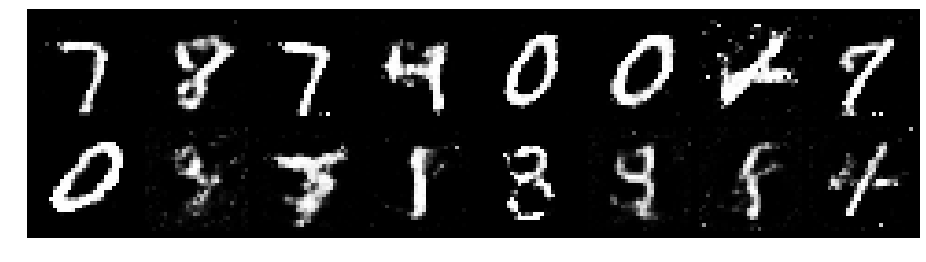

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.2160, Generator Loss: 0.9639
D(x): 0.5696, D(G(z)): 0.4311


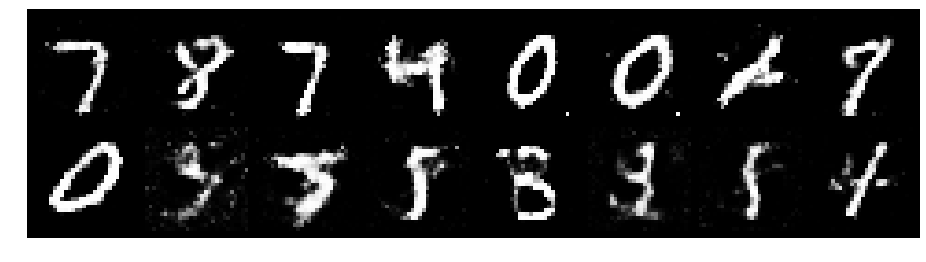

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.3157, Generator Loss: 0.7814
D(x): 0.5143, D(G(z)): 0.4433


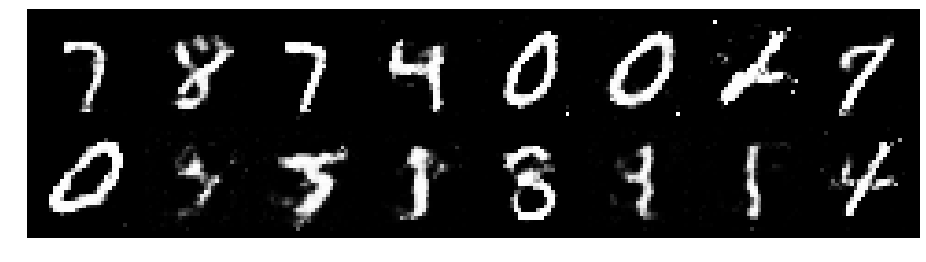

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.2681, Generator Loss: 0.9865
D(x): 0.5314, D(G(z)): 0.4073


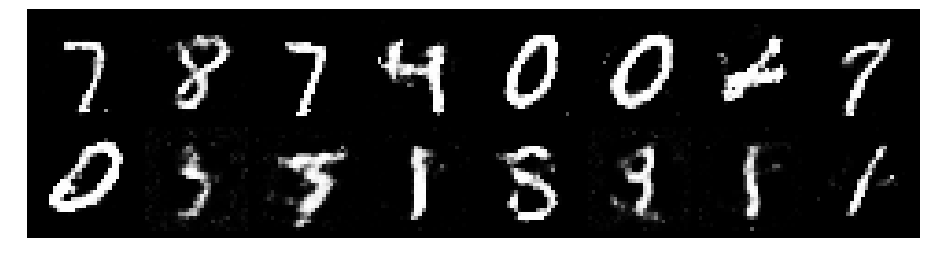

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.2001, Generator Loss: 0.9875
D(x): 0.5652, D(G(z)): 0.4113


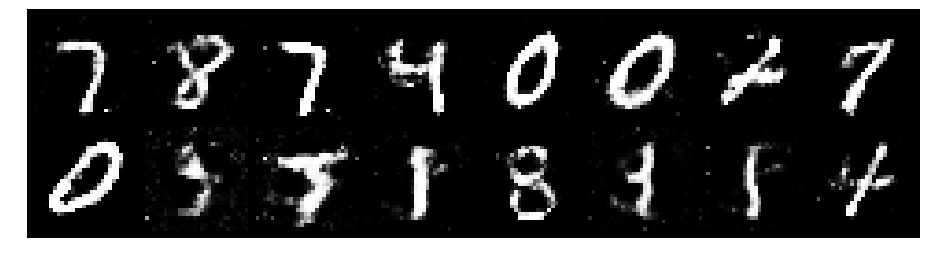

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.2465, Generator Loss: 0.9965
D(x): 0.5848, D(G(z)): 0.4297


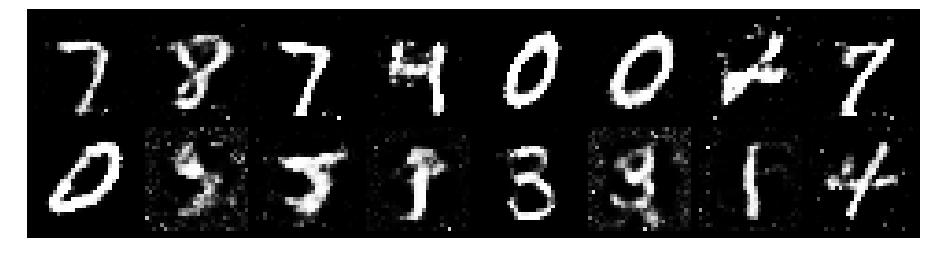

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.2188, Generator Loss: 1.0852
D(x): 0.5445, D(G(z)): 0.4011


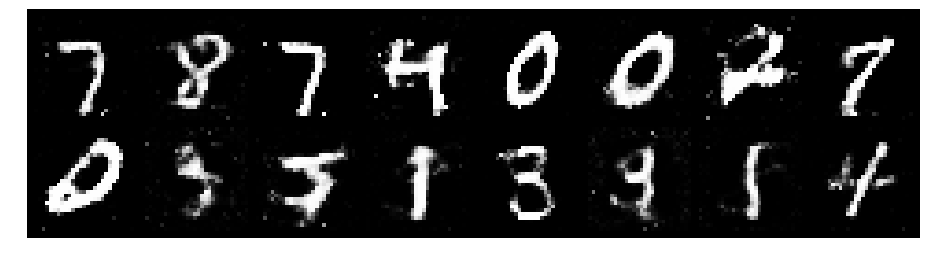

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.2663, Generator Loss: 0.8447
D(x): 0.5898, D(G(z)): 0.4771


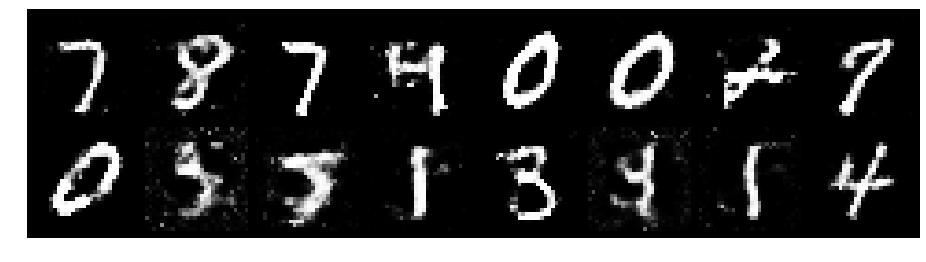

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.2842, Generator Loss: 1.0001
D(x): 0.5281, D(G(z)): 0.4180


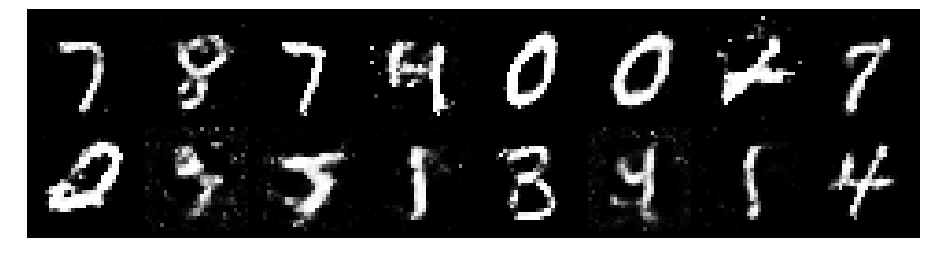

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.4673, Generator Loss: 0.9377
D(x): 0.5163, D(G(z)): 0.4865


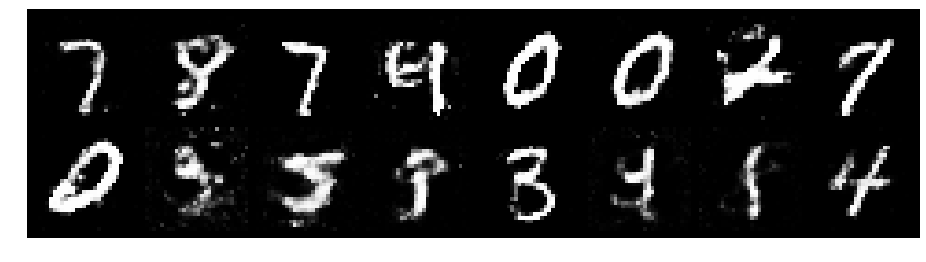

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.3420, Generator Loss: 0.9689
D(x): 0.5813, D(G(z)): 0.4689


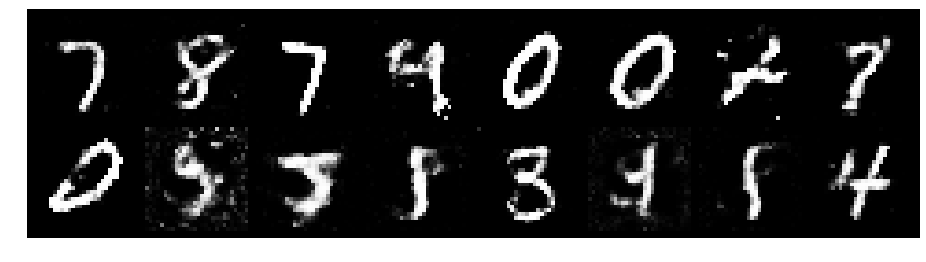

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.3280, Generator Loss: 0.9710
D(x): 0.5373, D(G(z)): 0.4405


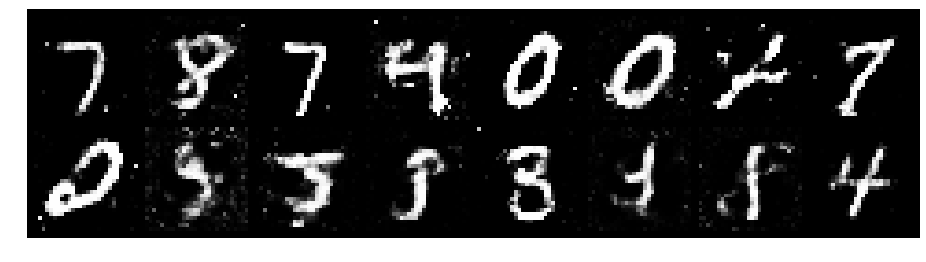

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.1810, Generator Loss: 0.8751
D(x): 0.5818, D(G(z)): 0.4309


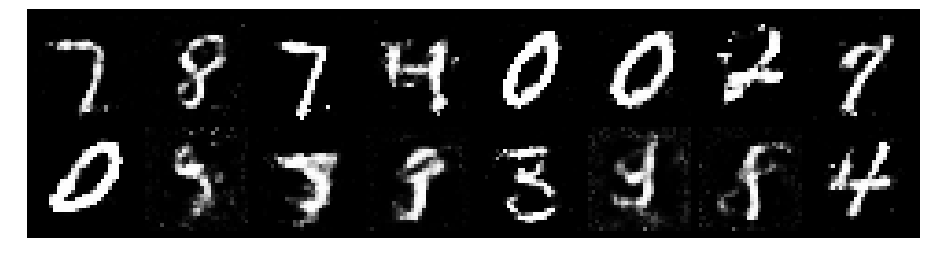

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.2868, Generator Loss: 0.9257
D(x): 0.5780, D(G(z)): 0.4665


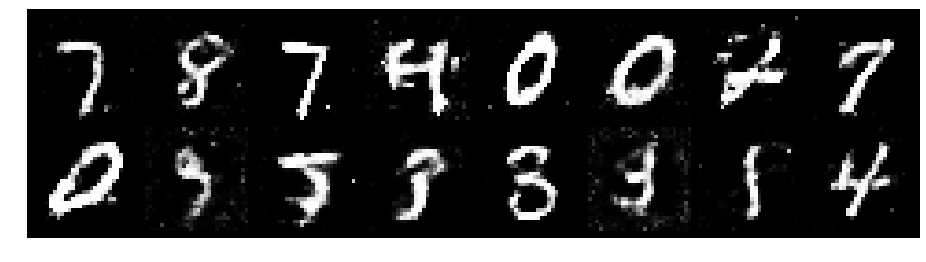

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.2461, Generator Loss: 0.9611
D(x): 0.5751, D(G(z)): 0.4495


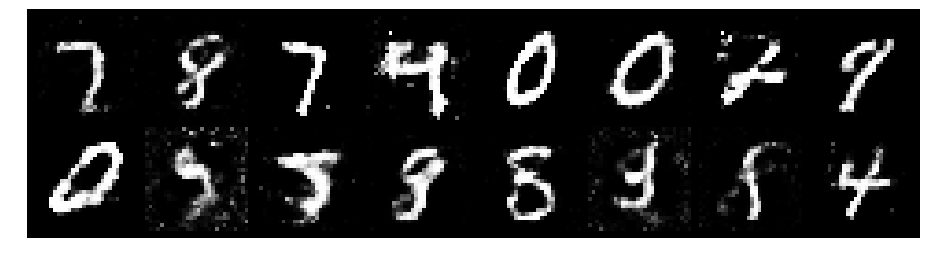

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.1861, Generator Loss: 0.9197
D(x): 0.5813, D(G(z)): 0.4275


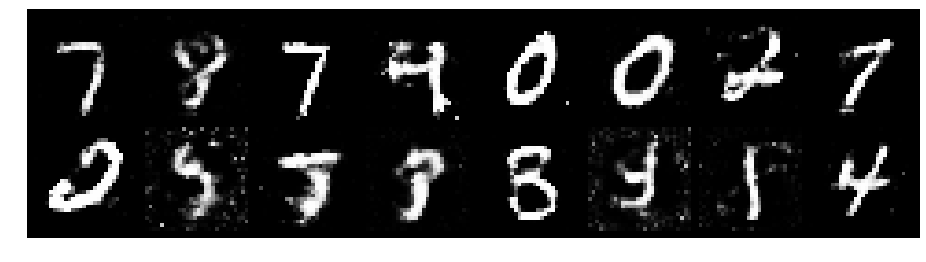

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.2457, Generator Loss: 1.1052
D(x): 0.5774, D(G(z)): 0.4458


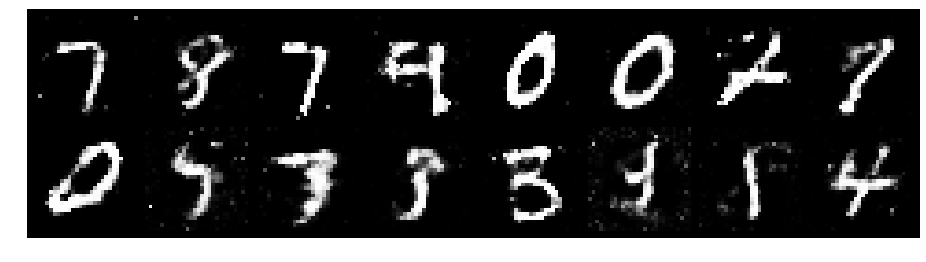

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.1802, Generator Loss: 0.8913
D(x): 0.5692, D(G(z)): 0.4097


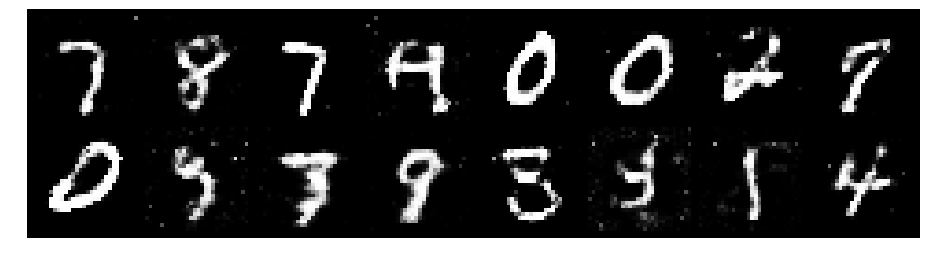

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.2063, Generator Loss: 0.8726
D(x): 0.5849, D(G(z)): 0.4410


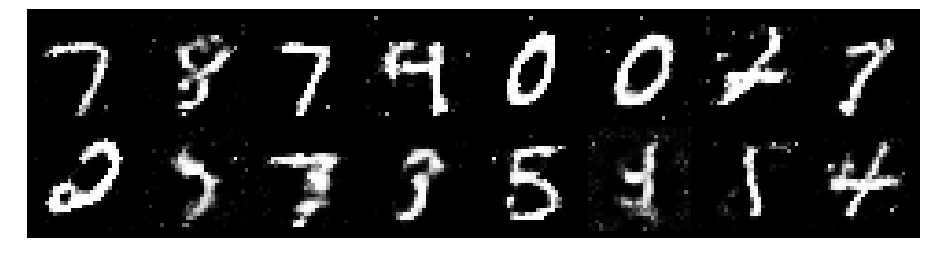

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.2494, Generator Loss: 0.8205
D(x): 0.5806, D(G(z)): 0.4580


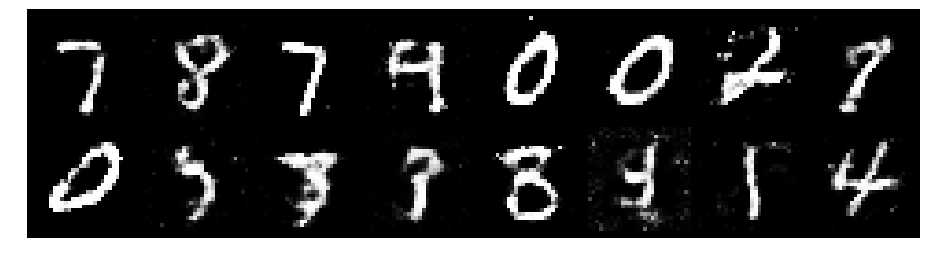

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.3064, Generator Loss: 0.8761
D(x): 0.5322, D(G(z)): 0.4318


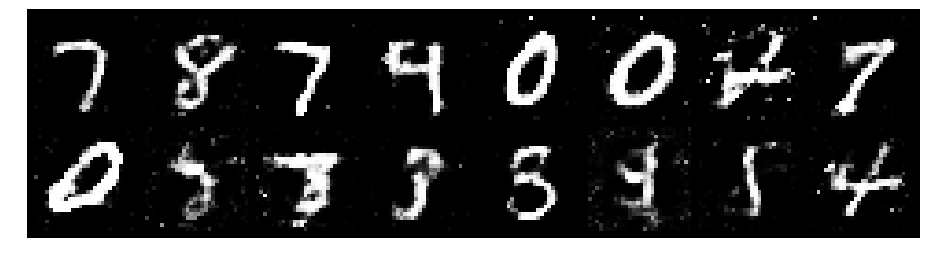

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.2642, Generator Loss: 0.9372
D(x): 0.5578, D(G(z)): 0.4211


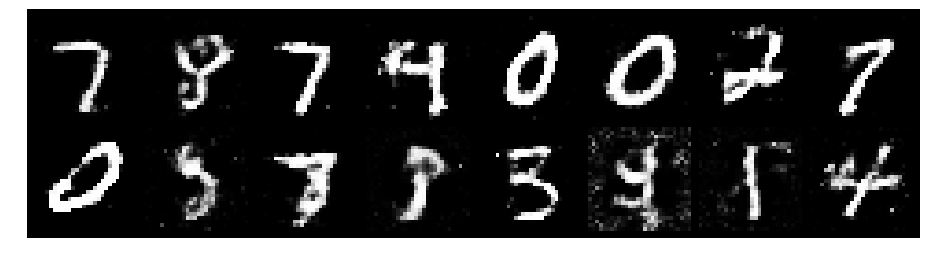

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.2288, Generator Loss: 0.9870
D(x): 0.5591, D(G(z)): 0.3955


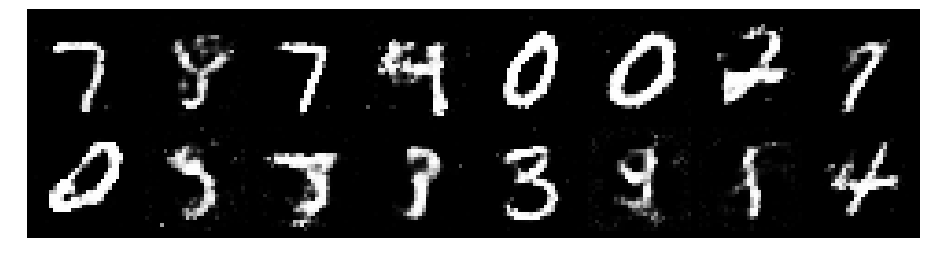

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.2289, Generator Loss: 0.9269
D(x): 0.5559, D(G(z)): 0.4015


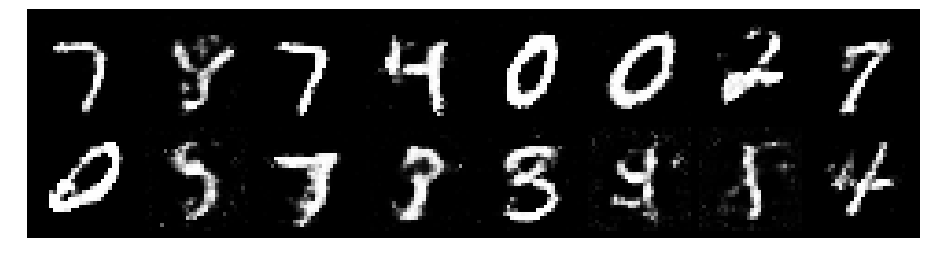

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.2636, Generator Loss: 1.0064
D(x): 0.5736, D(G(z)): 0.4400


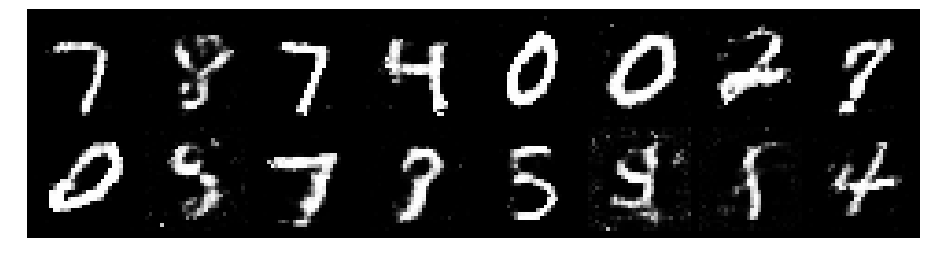

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.2389, Generator Loss: 0.8200
D(x): 0.5822, D(G(z)): 0.4565


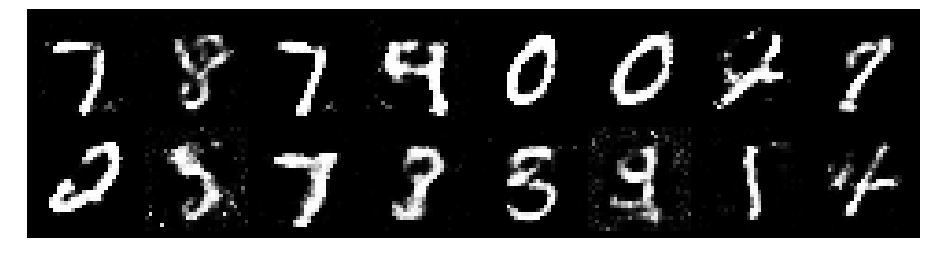

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.2423, Generator Loss: 0.8058
D(x): 0.5456, D(G(z)): 0.4457


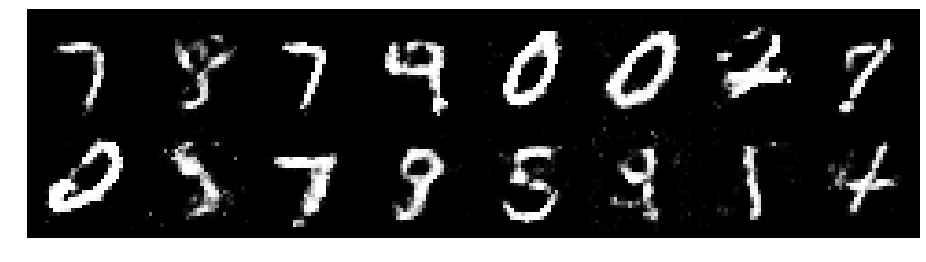

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.3325, Generator Loss: 0.9129
D(x): 0.5311, D(G(z)): 0.4597


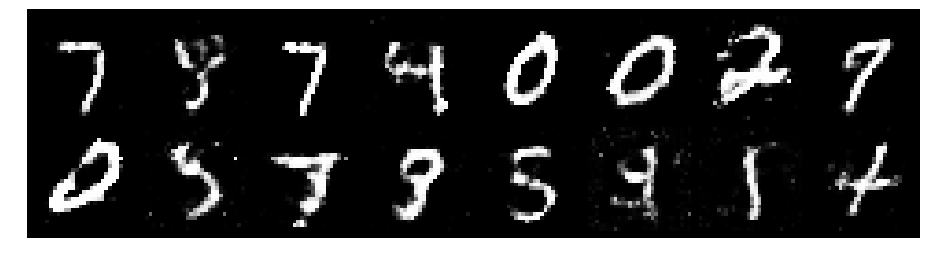

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.2679, Generator Loss: 0.7697
D(x): 0.5493, D(G(z)): 0.4664


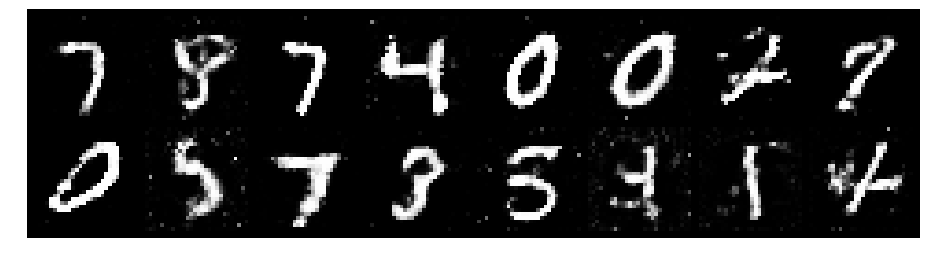

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.2462, Generator Loss: 0.9321
D(x): 0.5270, D(G(z)): 0.4177


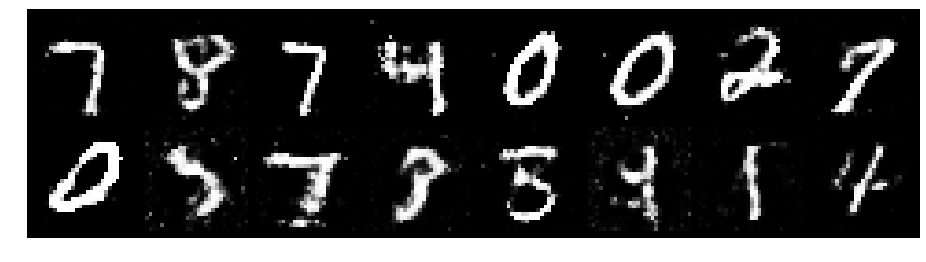

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.2552, Generator Loss: 0.9099
D(x): 0.5212, D(G(z)): 0.4007


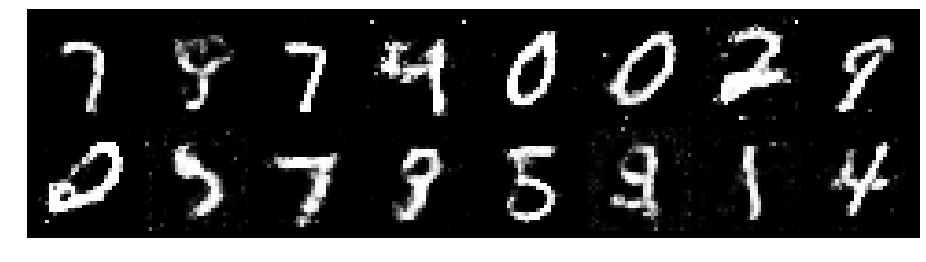

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.2651, Generator Loss: 0.8445
D(x): 0.5598, D(G(z)): 0.4134


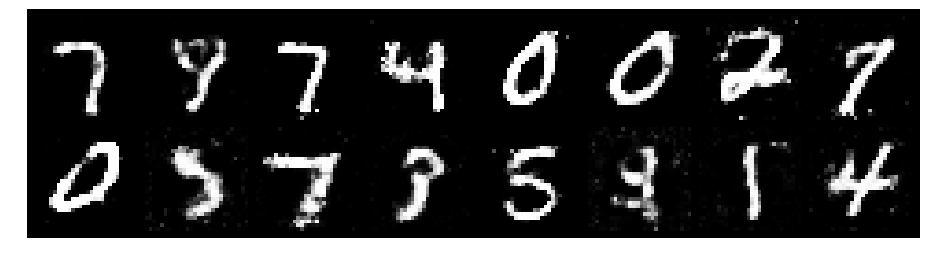

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.3888, Generator Loss: 0.8148
D(x): 0.5942, D(G(z)): 0.5047


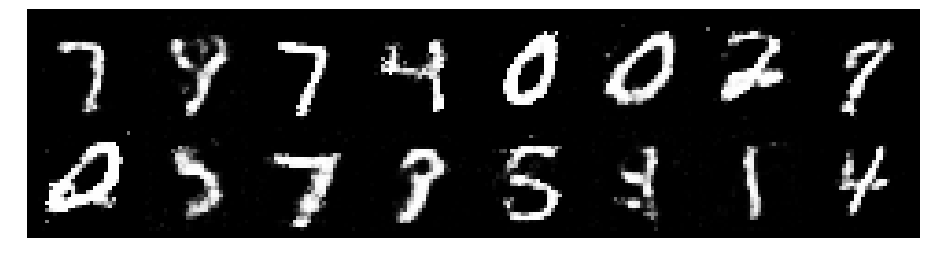

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.3850, Generator Loss: 0.8320
D(x): 0.5962, D(G(z)): 0.5090


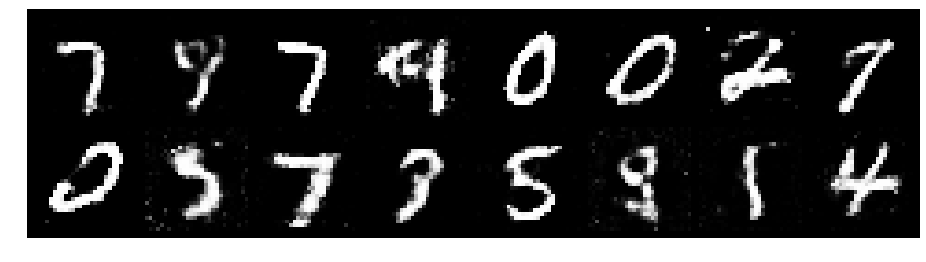

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.3385, Generator Loss: 0.8502
D(x): 0.5689, D(G(z)): 0.4824


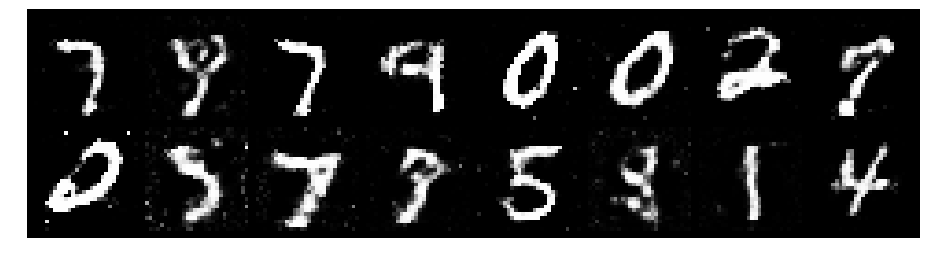

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.3454, Generator Loss: 0.6893
D(x): 0.5777, D(G(z)): 0.4727


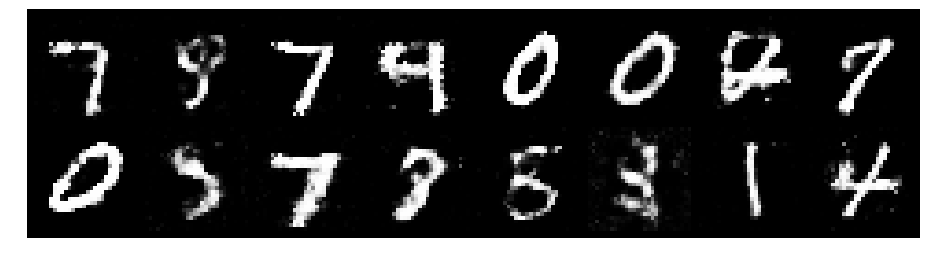

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.2918, Generator Loss: 0.9813
D(x): 0.5869, D(G(z)): 0.4643


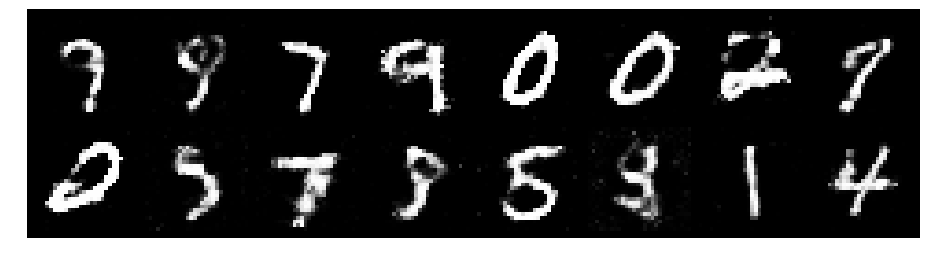

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.3359, Generator Loss: 0.8157
D(x): 0.5719, D(G(z)): 0.4916


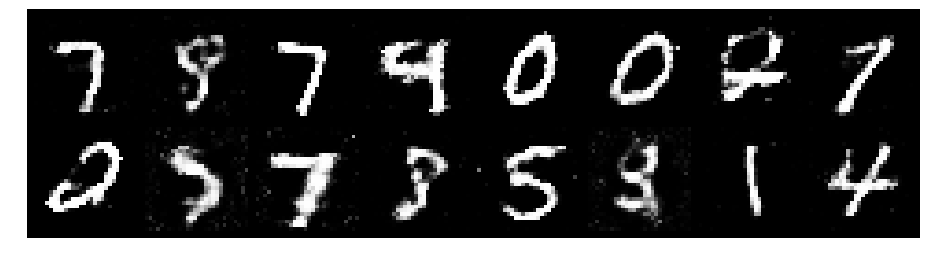

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.2984, Generator Loss: 0.7359
D(x): 0.5641, D(G(z)): 0.4783


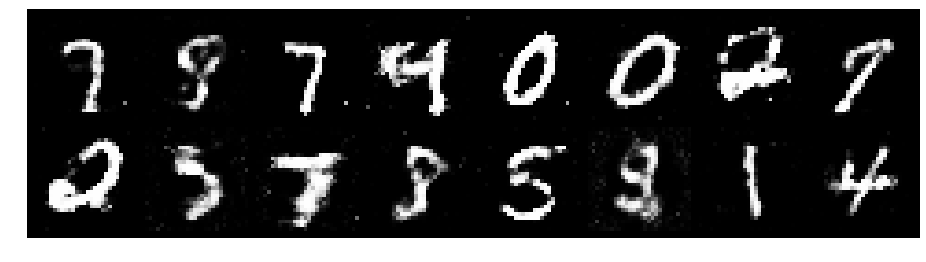

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.2936, Generator Loss: 0.9086
D(x): 0.5482, D(G(z)): 0.4562


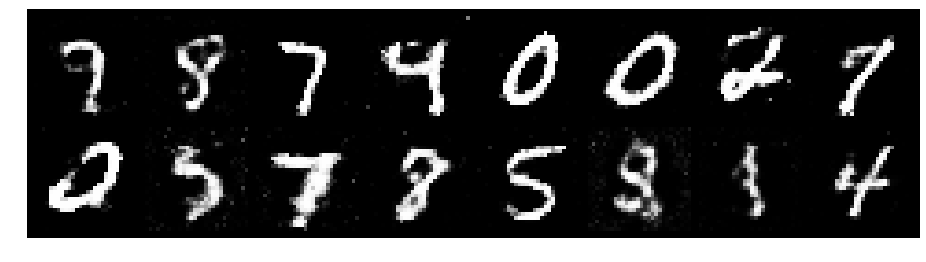

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.3623, Generator Loss: 0.9004
D(x): 0.5350, D(G(z)): 0.4574


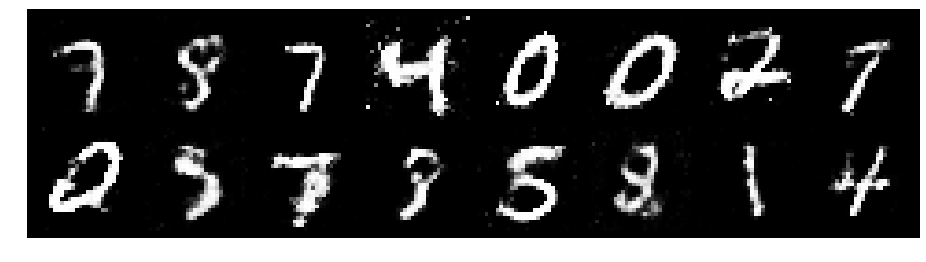

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.2916, Generator Loss: 0.9296
D(x): 0.5567, D(G(z)): 0.4589


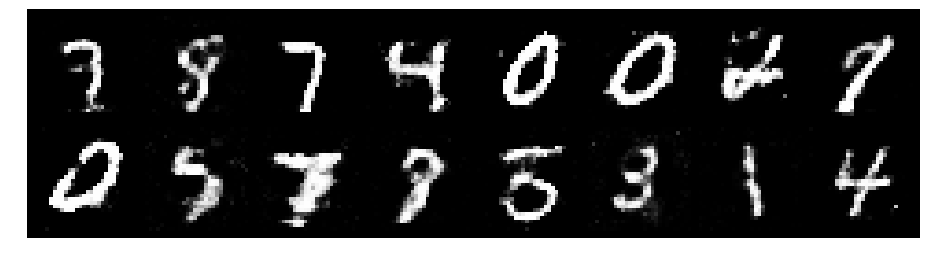

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.3365, Generator Loss: 0.8272
D(x): 0.5213, D(G(z)): 0.4729


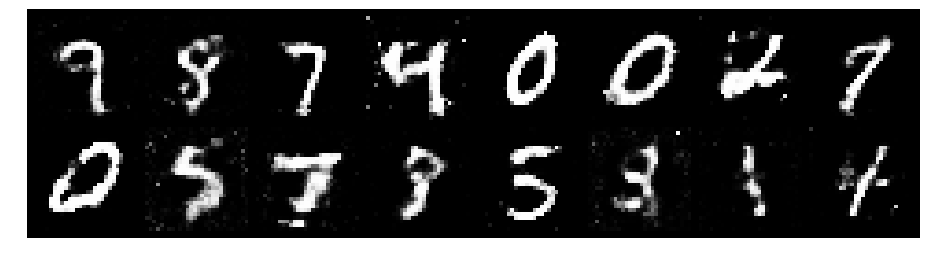

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.3049, Generator Loss: 0.8608
D(x): 0.5650, D(G(z)): 0.4685


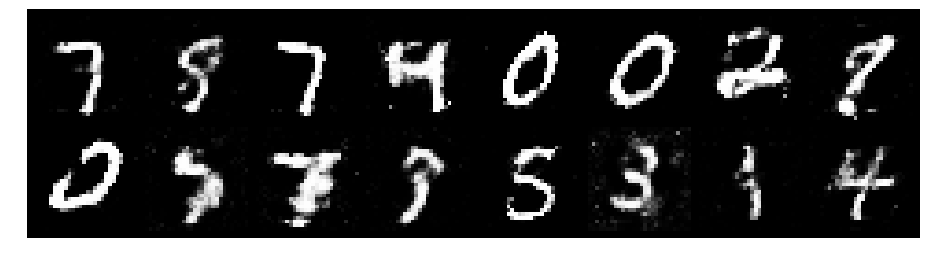

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.2506, Generator Loss: 0.8337
D(x): 0.5440, D(G(z)): 0.4441


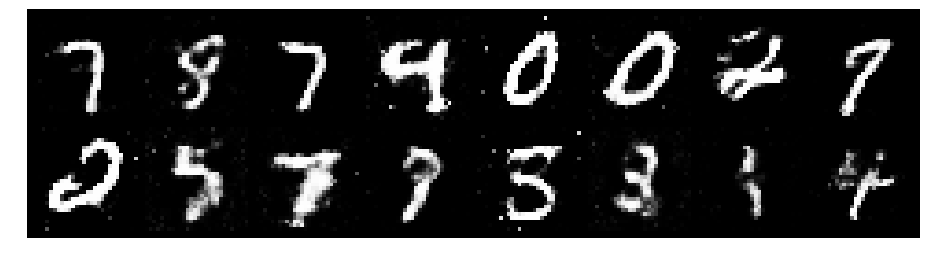

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.2972, Generator Loss: 0.9132
D(x): 0.4963, D(G(z)): 0.4015


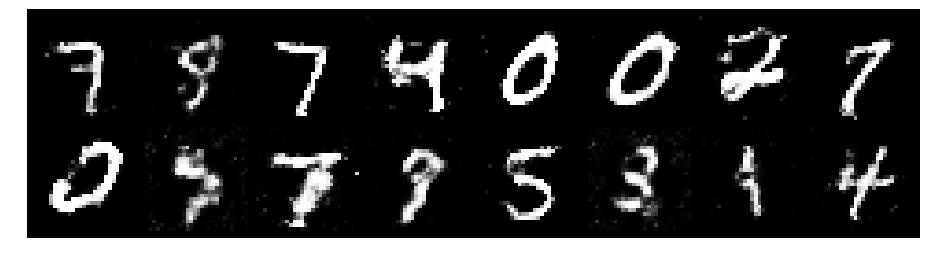

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.3919, Generator Loss: 0.9359
D(x): 0.5190, D(G(z)): 0.4511


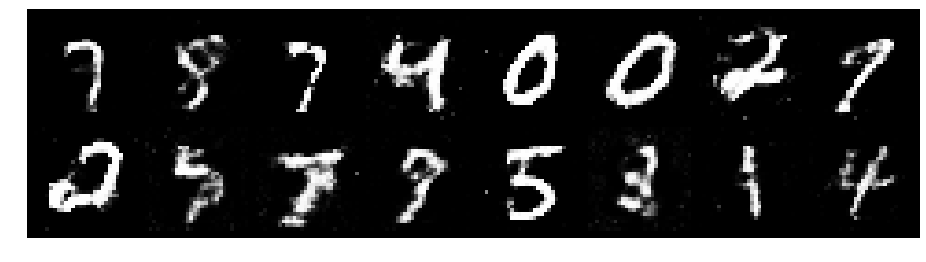

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.2336, Generator Loss: 0.8956
D(x): 0.5375, D(G(z)): 0.4202


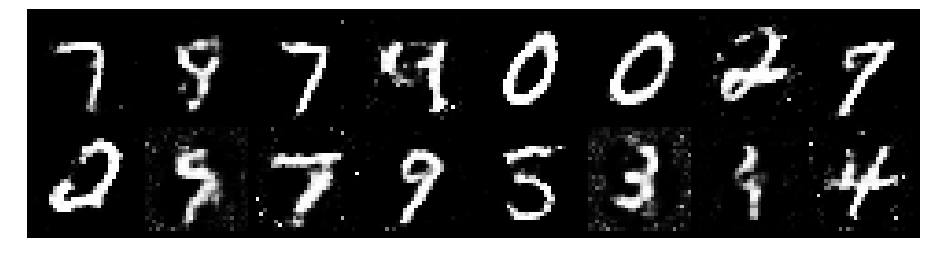

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.3207, Generator Loss: 0.9123
D(x): 0.5488, D(G(z)): 0.4757


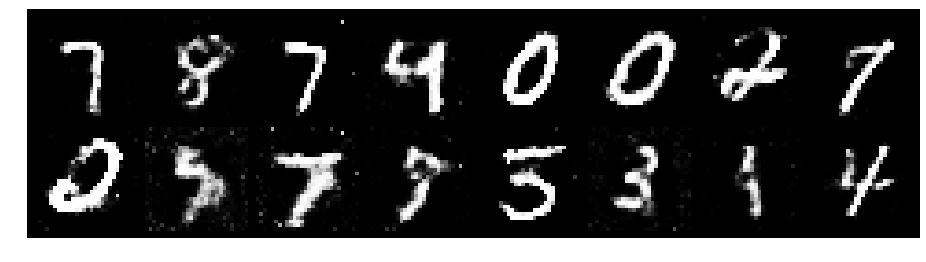

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.3304, Generator Loss: 0.8653
D(x): 0.5523, D(G(z)): 0.4788


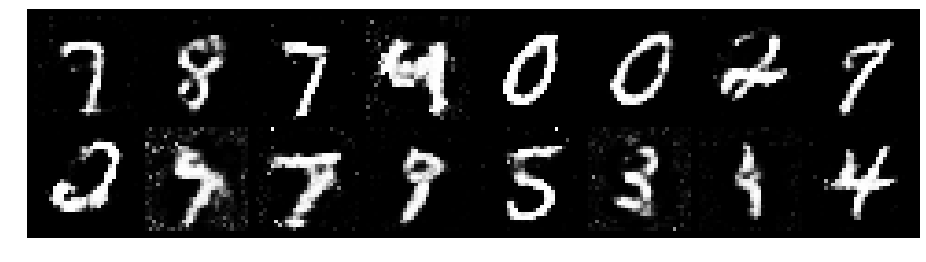

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.3501, Generator Loss: 1.0420
D(x): 0.4927, D(G(z)): 0.3983


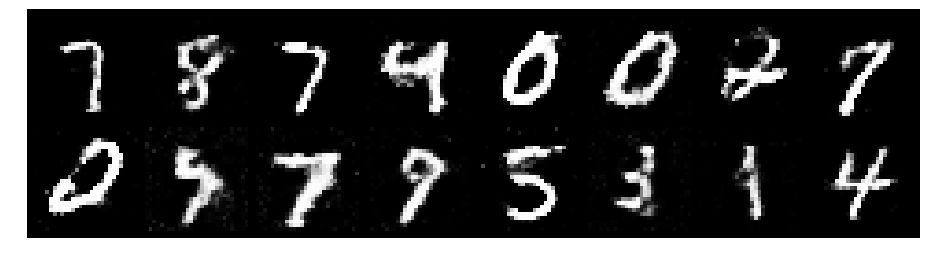

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.3037, Generator Loss: 0.7815
D(x): 0.5487, D(G(z)): 0.4539


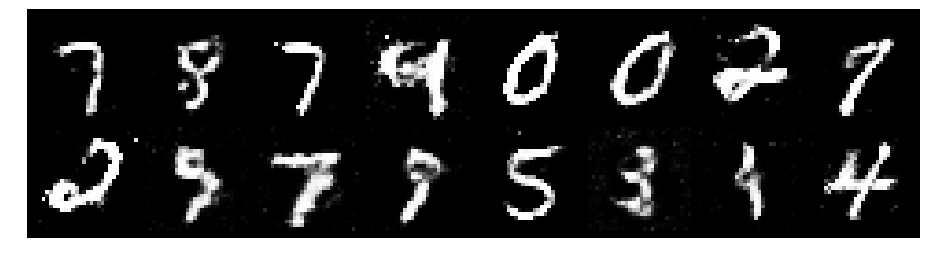

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.2982, Generator Loss: 1.0186
D(x): 0.5331, D(G(z)): 0.4199


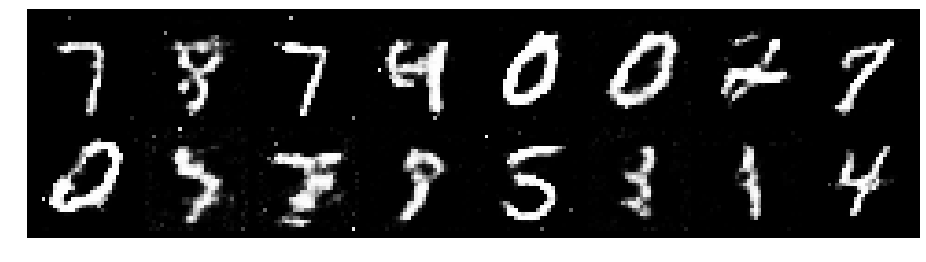

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.2693, Generator Loss: 0.9141
D(x): 0.5795, D(G(z)): 0.4501


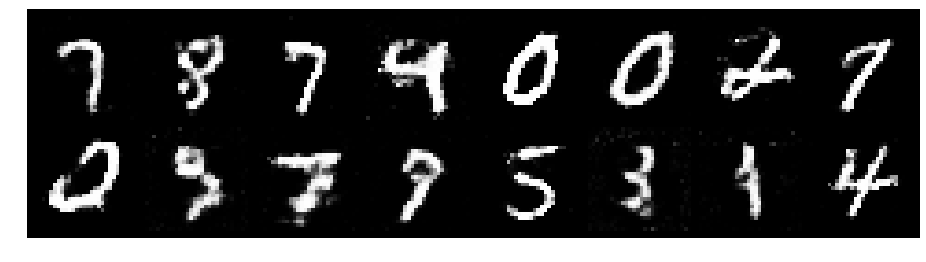

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.2364, Generator Loss: 0.9399
D(x): 0.5670, D(G(z)): 0.4356


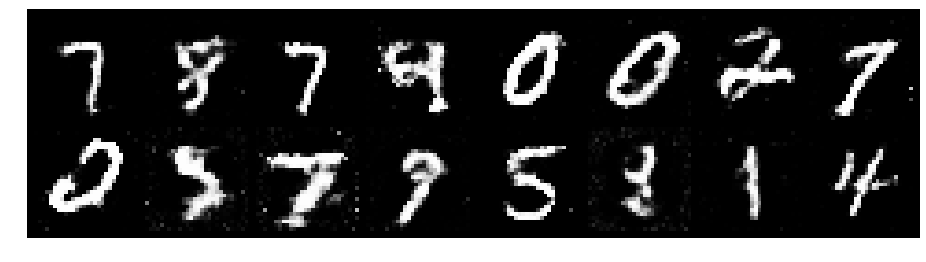

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.2251, Generator Loss: 0.9210
D(x): 0.5914, D(G(z)): 0.4487


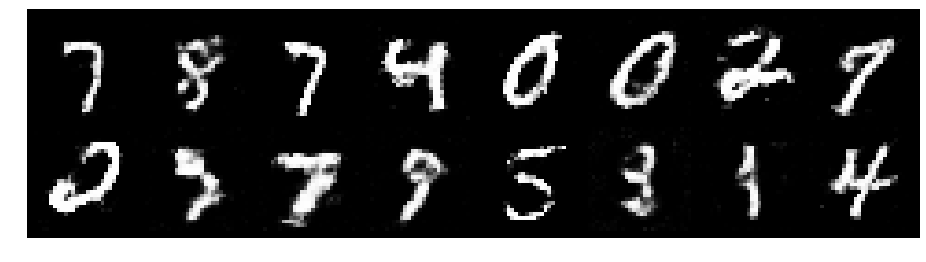

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.3309, Generator Loss: 0.8581
D(x): 0.5158, D(G(z)): 0.4513


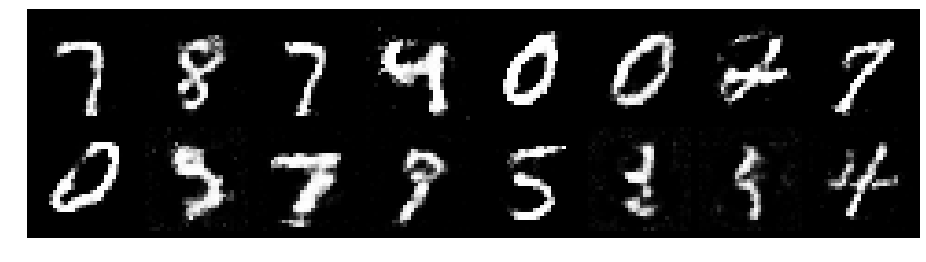

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.2400, Generator Loss: 0.9312
D(x): 0.5451, D(G(z)): 0.4336


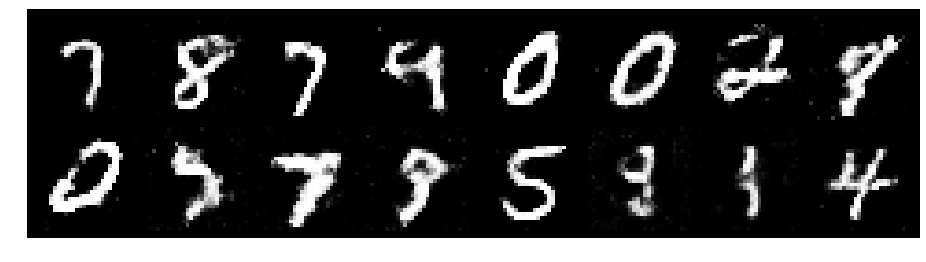

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.2209, Generator Loss: 0.8689
D(x): 0.5562, D(G(z)): 0.4248


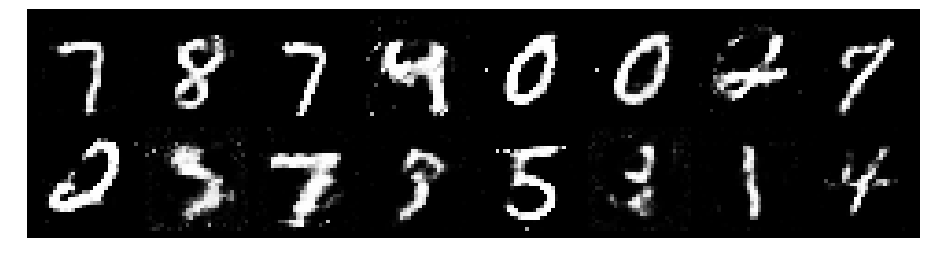

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.2166, Generator Loss: 0.9079
D(x): 0.5857, D(G(z)): 0.4381


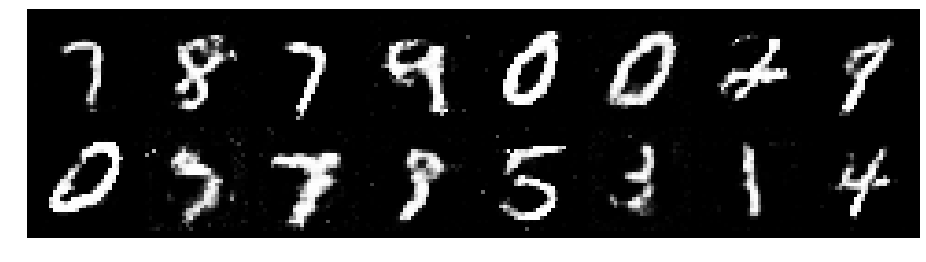

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.2465, Generator Loss: 0.9212
D(x): 0.5422, D(G(z)): 0.4126


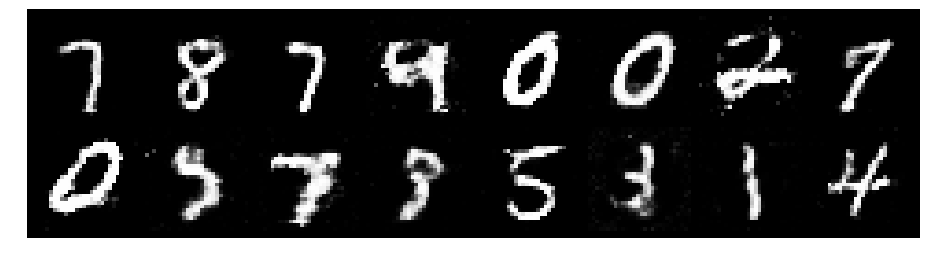

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.2968, Generator Loss: 0.8831
D(x): 0.5699, D(G(z)): 0.4701


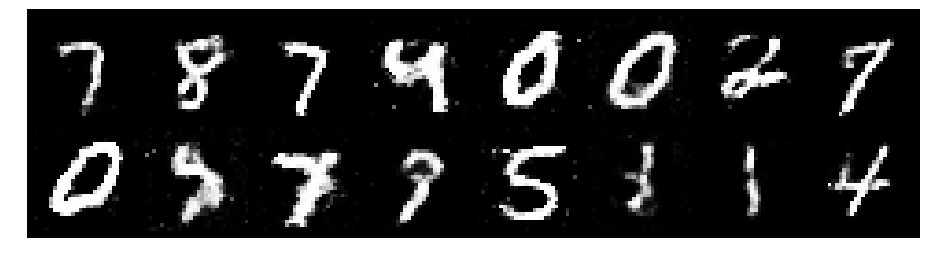

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.2704, Generator Loss: 0.9764
D(x): 0.6242, D(G(z)): 0.4963


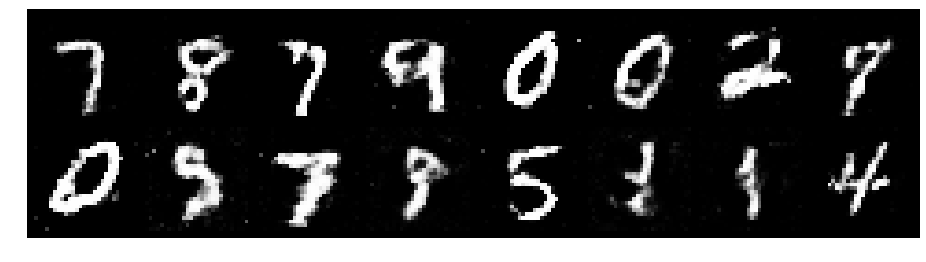

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.2228, Generator Loss: 0.8860
D(x): 0.5477, D(G(z)): 0.4128


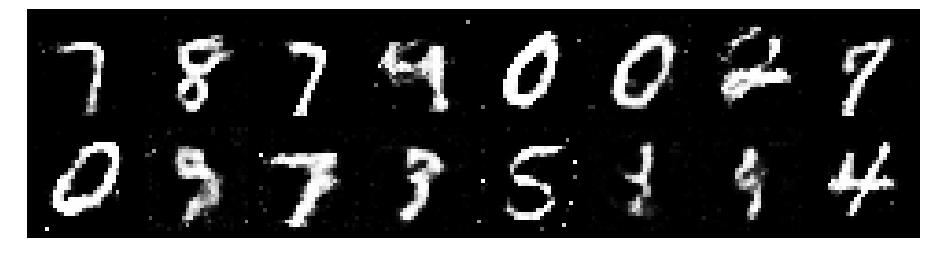

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.2948, Generator Loss: 0.8596
D(x): 0.5484, D(G(z)): 0.4452


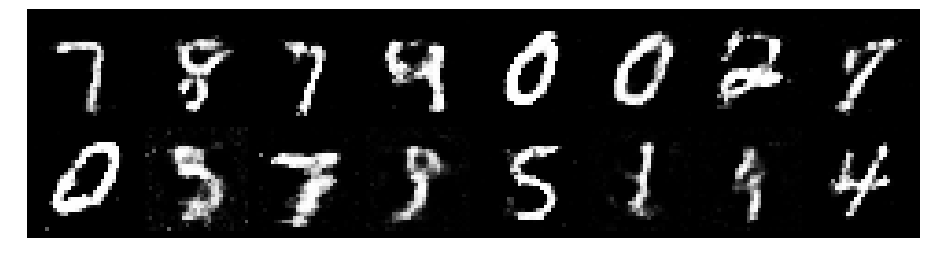

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.2538, Generator Loss: 0.9822
D(x): 0.5389, D(G(z)): 0.4138


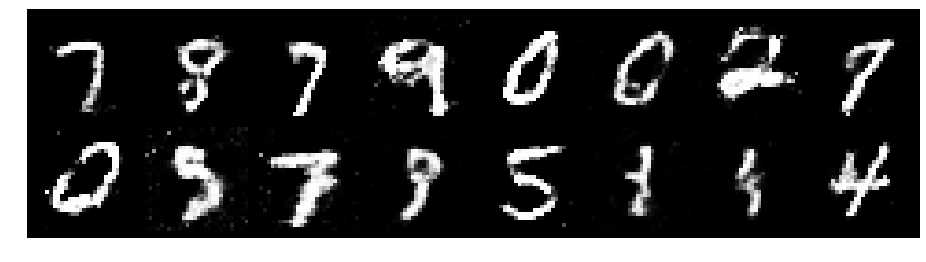

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.3513, Generator Loss: 0.8250
D(x): 0.4906, D(G(z)): 0.4404


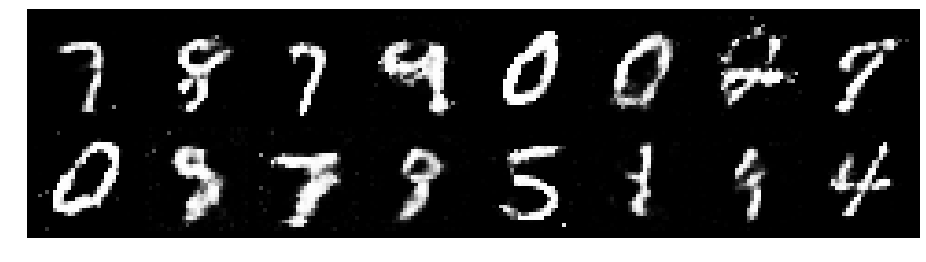

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.2994, Generator Loss: 0.9017
D(x): 0.5157, D(G(z)): 0.4267


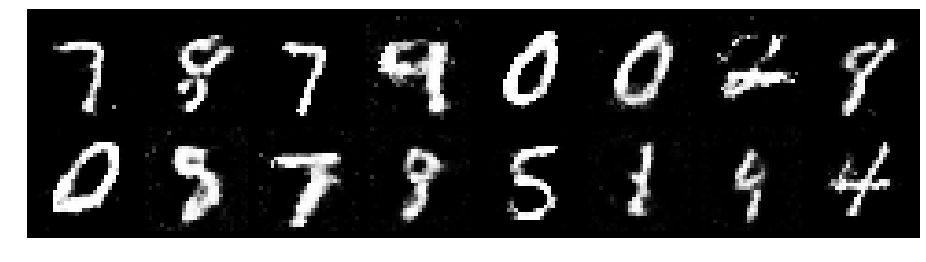

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.2615, Generator Loss: 0.8833
D(x): 0.5588, D(G(z)): 0.4290


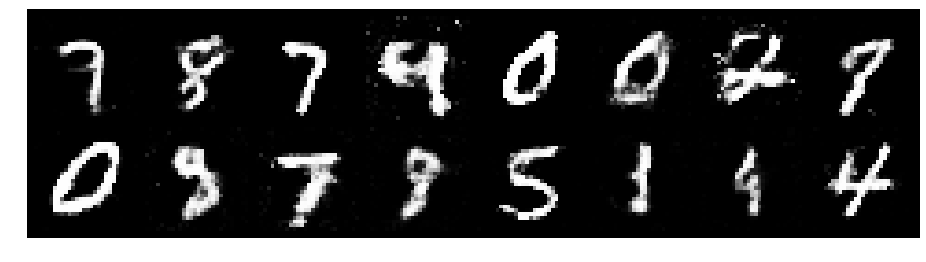

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.2581, Generator Loss: 0.8824
D(x): 0.5741, D(G(z)): 0.4606


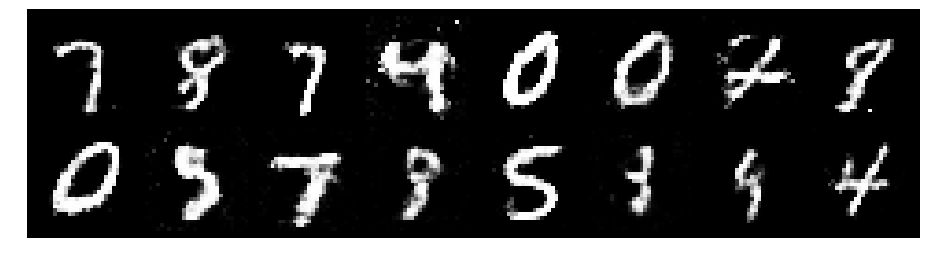

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.2549, Generator Loss: 0.7815
D(x): 0.5629, D(G(z)): 0.4762


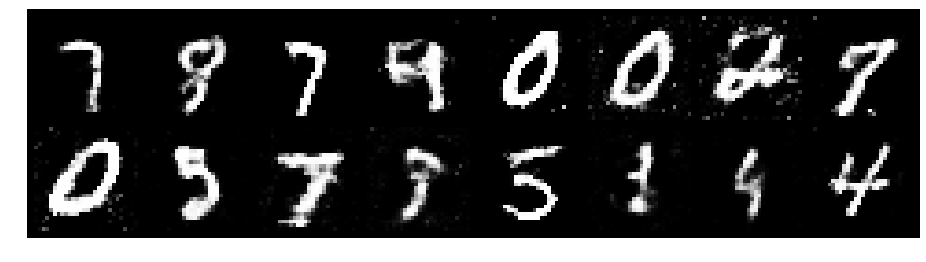

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.2129, Generator Loss: 0.8318
D(x): 0.5689, D(G(z)): 0.4328


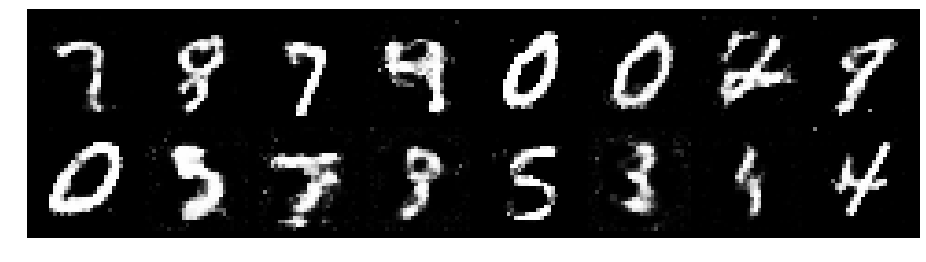

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.1646, Generator Loss: 1.0848
D(x): 0.5641, D(G(z)): 0.3806


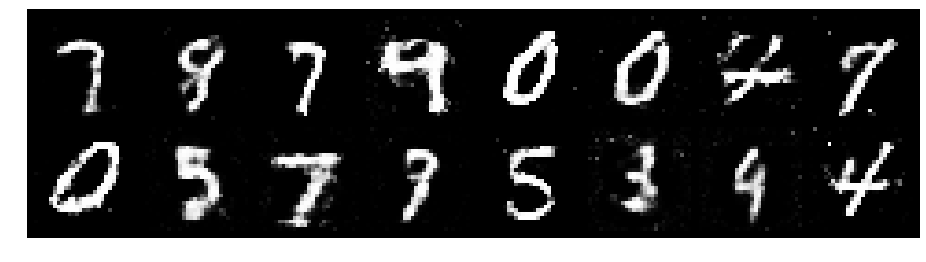

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.3146, Generator Loss: 0.9157
D(x): 0.5473, D(G(z)): 0.4478


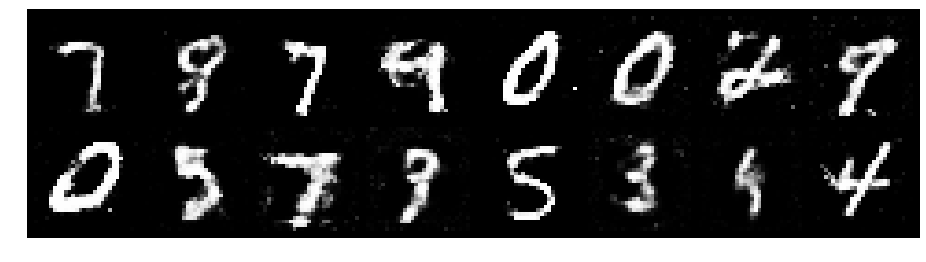

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.2053, Generator Loss: 1.0097
D(x): 0.5942, D(G(z)): 0.4425


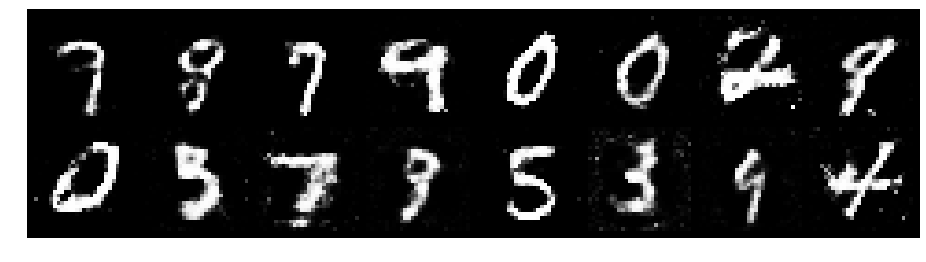

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.1716, Generator Loss: 0.9179
D(x): 0.5770, D(G(z)): 0.4108


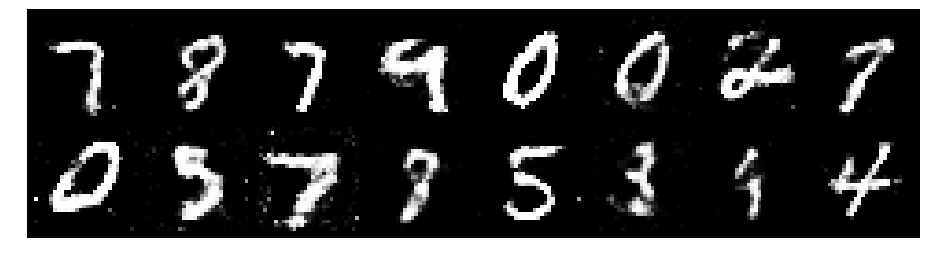

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.2266, Generator Loss: 1.0323
D(x): 0.6084, D(G(z)): 0.4559


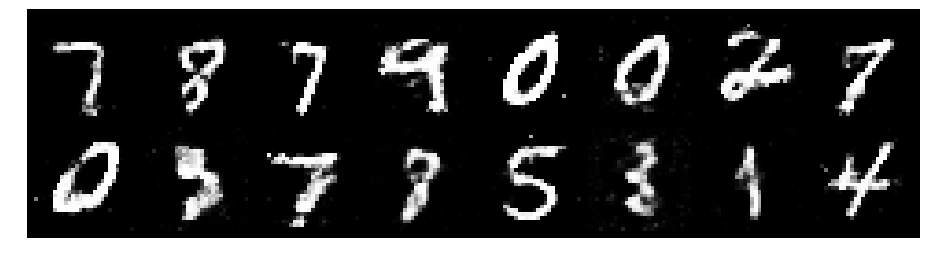

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.2198, Generator Loss: 0.8852
D(x): 0.5932, D(G(z)): 0.4530


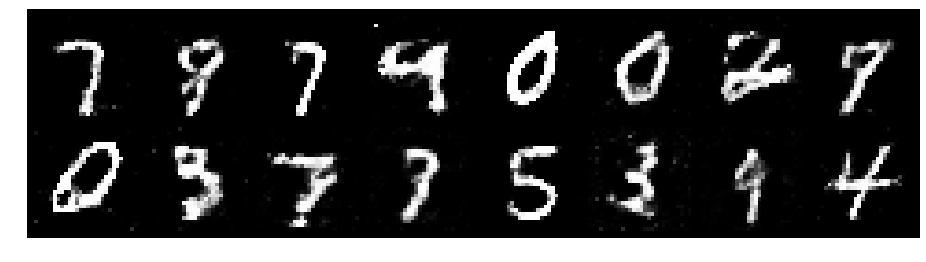

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.2274, Generator Loss: 0.8836
D(x): 0.5447, D(G(z)): 0.4079


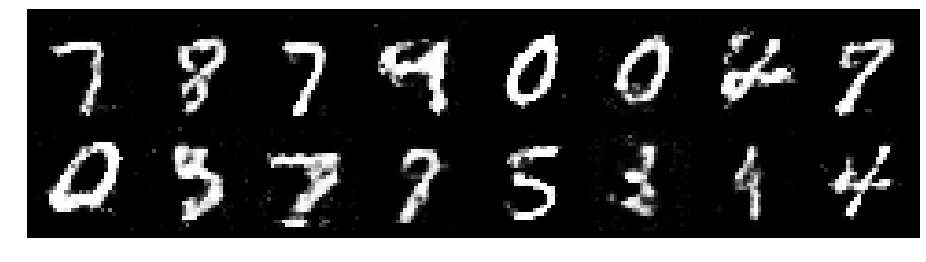

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.3253, Generator Loss: 0.8880
D(x): 0.5172, D(G(z)): 0.4476


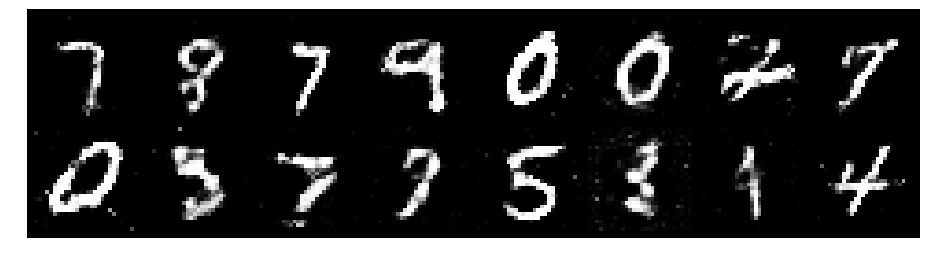

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.2975, Generator Loss: 0.7932
D(x): 0.5200, D(G(z)): 0.4507


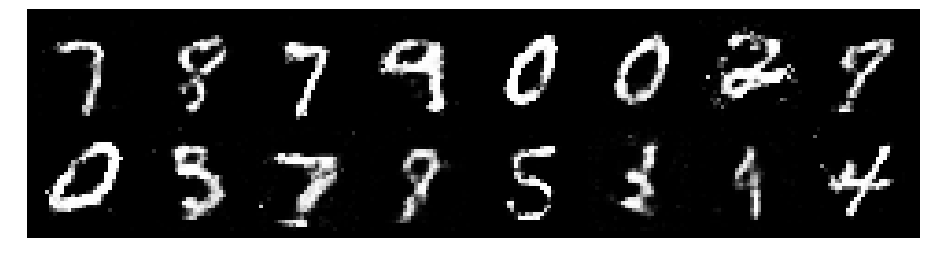

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.2259, Generator Loss: 0.7887
D(x): 0.5568, D(G(z)): 0.4470


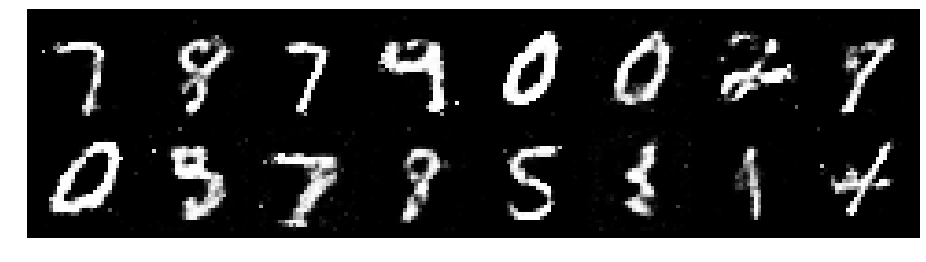

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.3155, Generator Loss: 0.9406
D(x): 0.5667, D(G(z)): 0.4579


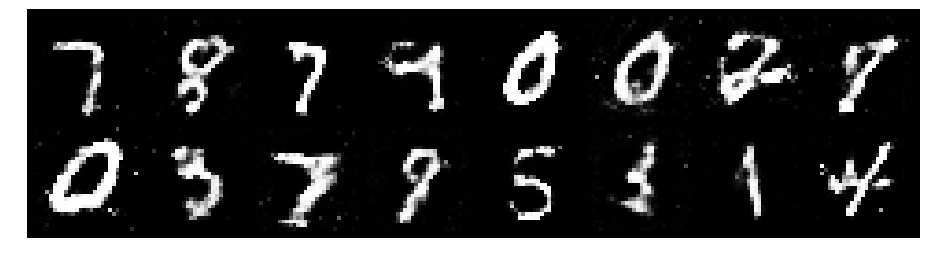

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.2610, Generator Loss: 0.9558
D(x): 0.5304, D(G(z)): 0.4240


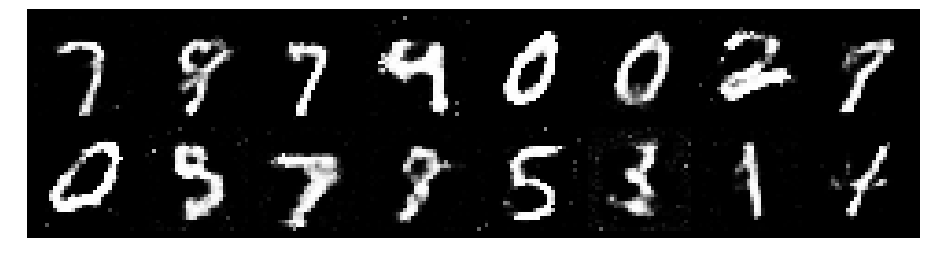

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.1997, Generator Loss: 1.0654
D(x): 0.5997, D(G(z)): 0.4247


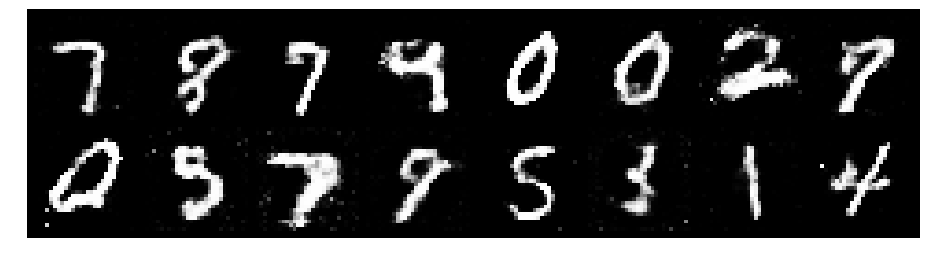

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.2305, Generator Loss: 0.8098
D(x): 0.5727, D(G(z)): 0.4466


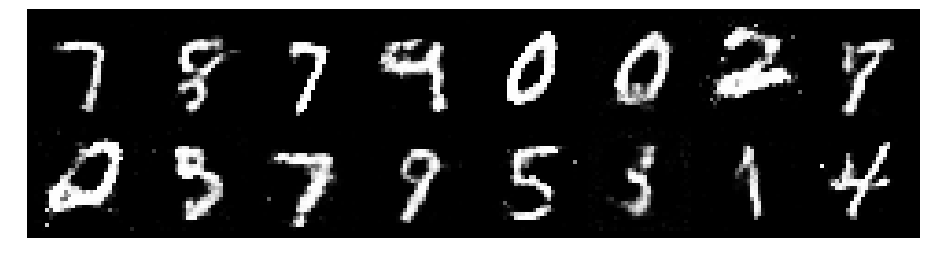

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.3055, Generator Loss: 0.8081
D(x): 0.6087, D(G(z)): 0.4919


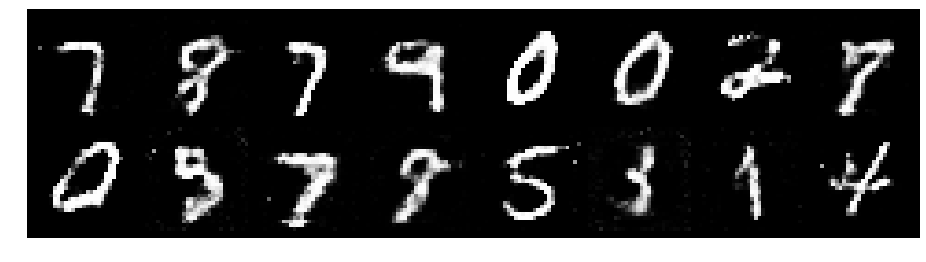

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.2399, Generator Loss: 0.8995
D(x): 0.5347, D(G(z)): 0.4258


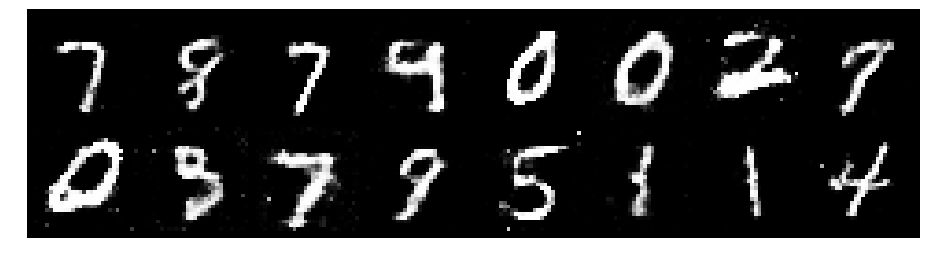

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.2874, Generator Loss: 0.9438
D(x): 0.5584, D(G(z)): 0.4563


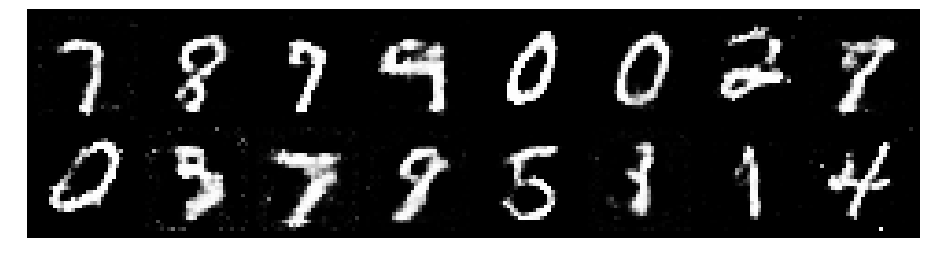

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.2479, Generator Loss: 1.0026
D(x): 0.5771, D(G(z)): 0.4426


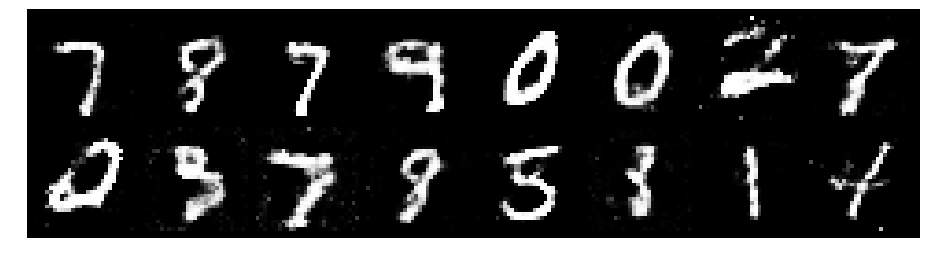

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.3009, Generator Loss: 0.9900
D(x): 0.5305, D(G(z)): 0.4269


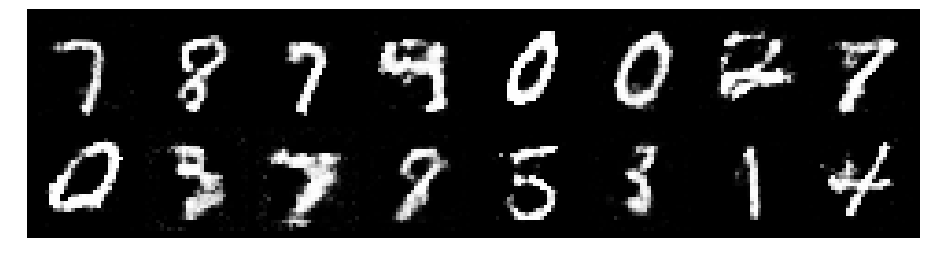

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.2023, Generator Loss: 0.8841
D(x): 0.5900, D(G(z)): 0.4308


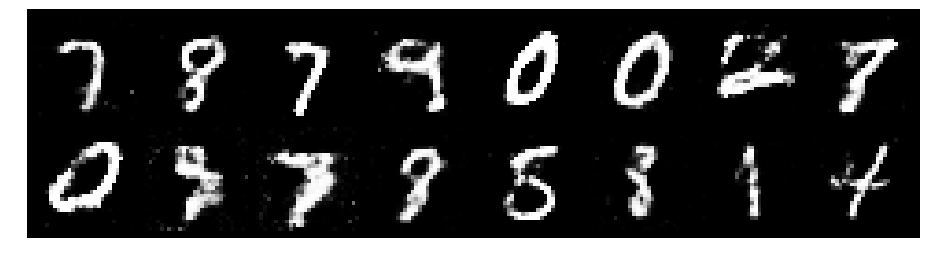

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.2722, Generator Loss: 0.9005
D(x): 0.5751, D(G(z)): 0.4483


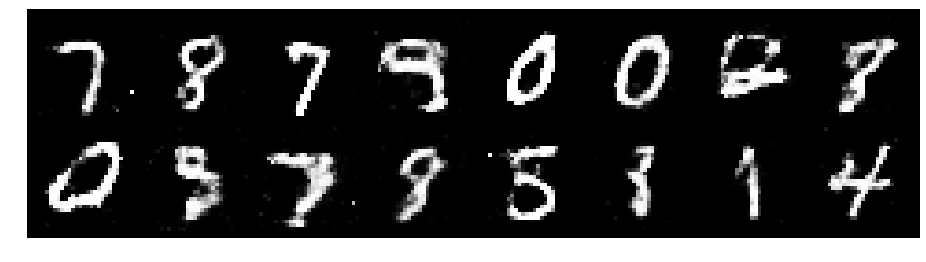

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.2176, Generator Loss: 0.8965
D(x): 0.5677, D(G(z)): 0.4381


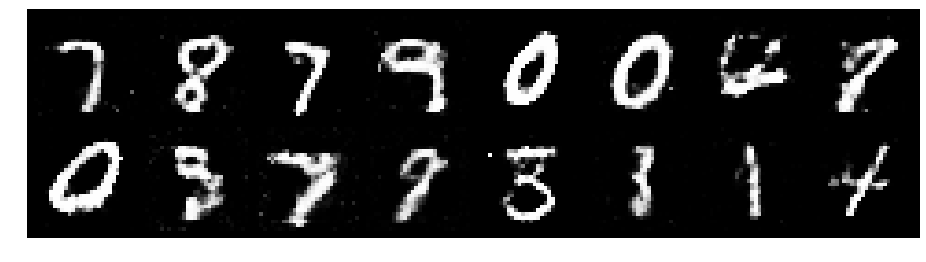

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.3198, Generator Loss: 0.9515
D(x): 0.5788, D(G(z)): 0.4818


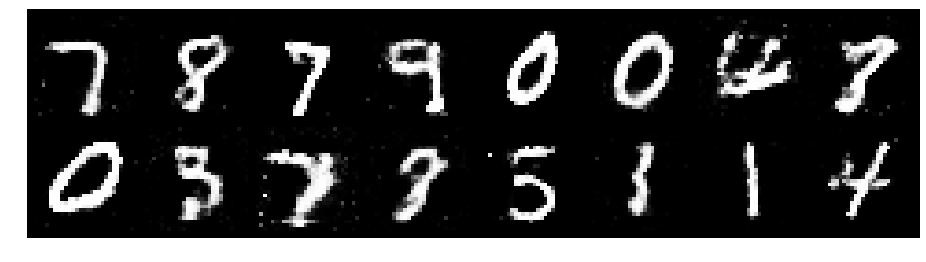

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.2848, Generator Loss: 0.7291
D(x): 0.5796, D(G(z)): 0.4655


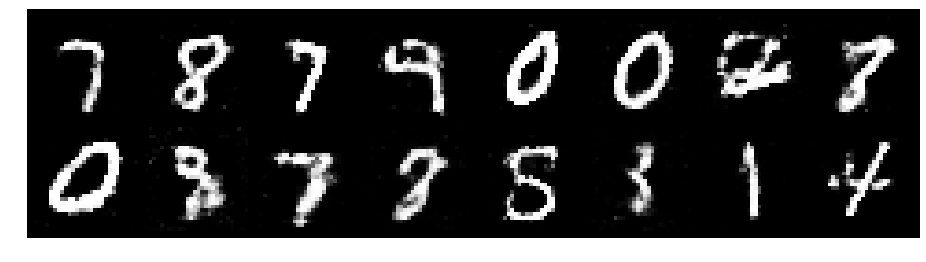

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.2012, Generator Loss: 0.8744
D(x): 0.5439, D(G(z)): 0.4130


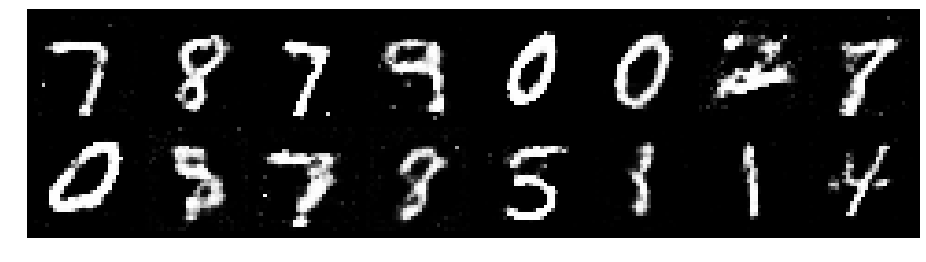

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.2386, Generator Loss: 0.9782
D(x): 0.5330, D(G(z)): 0.4115


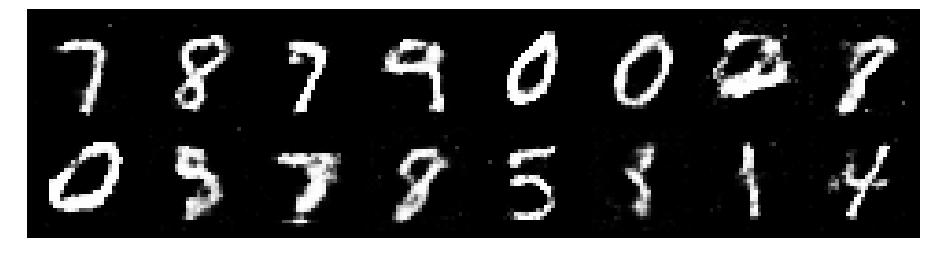

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.1869, Generator Loss: 0.9616
D(x): 0.5765, D(G(z)): 0.4259


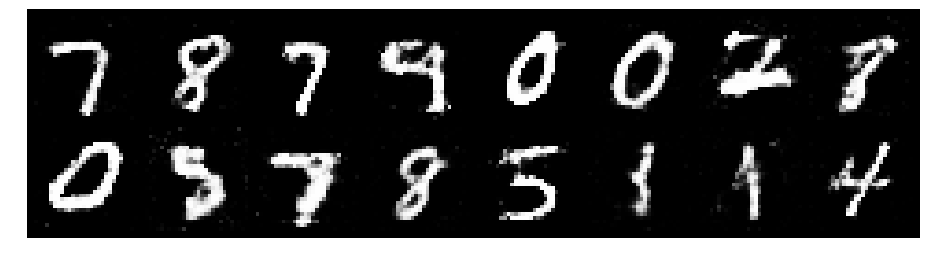

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.2941, Generator Loss: 0.9167
D(x): 0.5496, D(G(z)): 0.4624


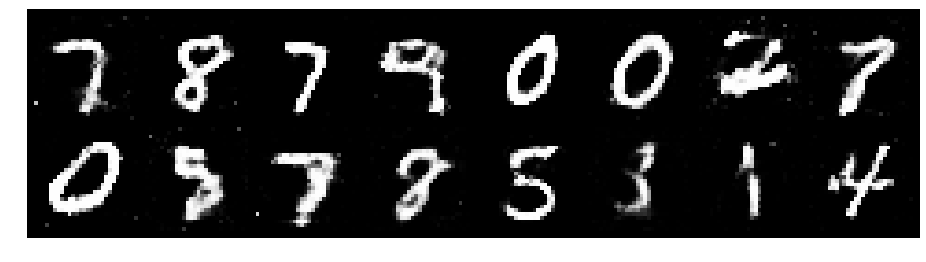

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.2838, Generator Loss: 0.9331
D(x): 0.6129, D(G(z)): 0.4866


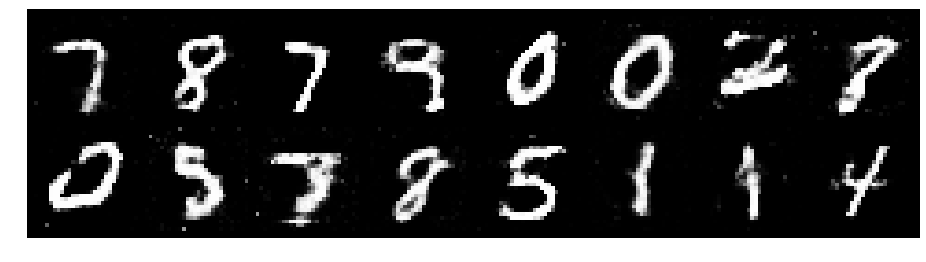

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.3950, Generator Loss: 0.8901
D(x): 0.5269, D(G(z)): 0.4580


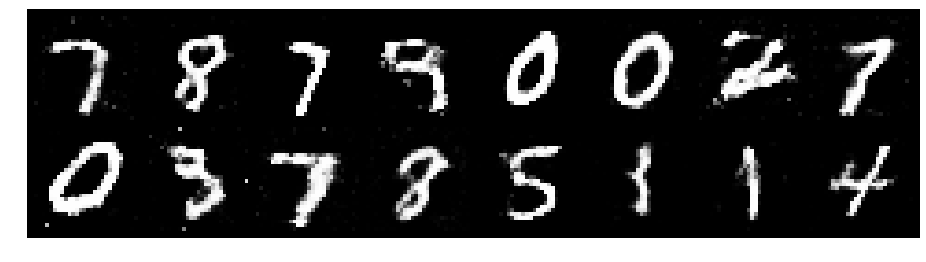

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.3511, Generator Loss: 0.8080
D(x): 0.5034, D(G(z)): 0.4405


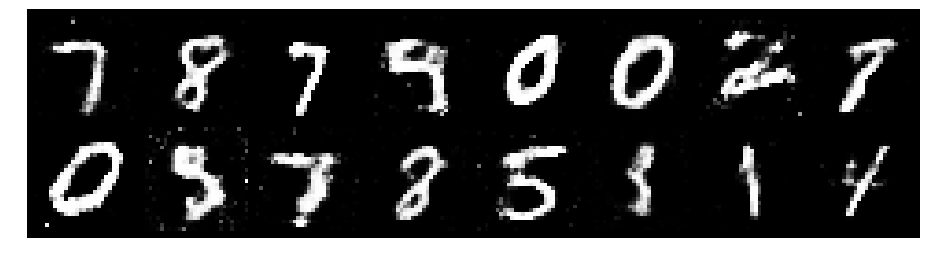

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.3132, Generator Loss: 0.8271
D(x): 0.5474, D(G(z)): 0.4571


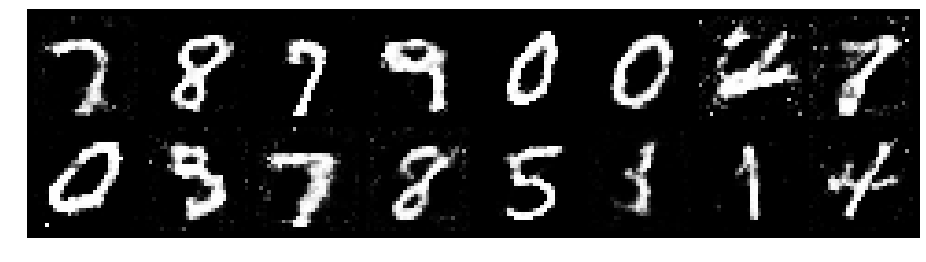

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.2565, Generator Loss: 0.9185
D(x): 0.5450, D(G(z)): 0.4394


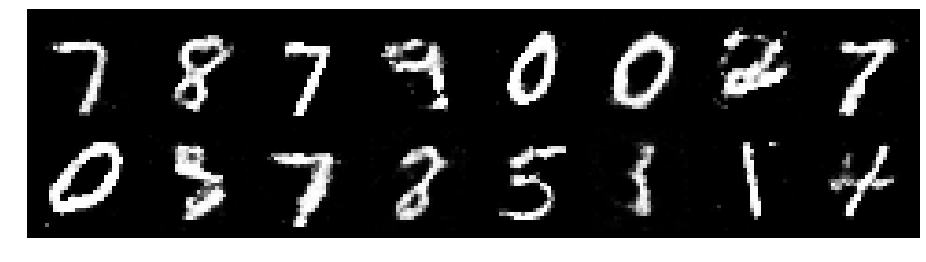

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.1536, Generator Loss: 0.9276
D(x): 0.5569, D(G(z)): 0.3922


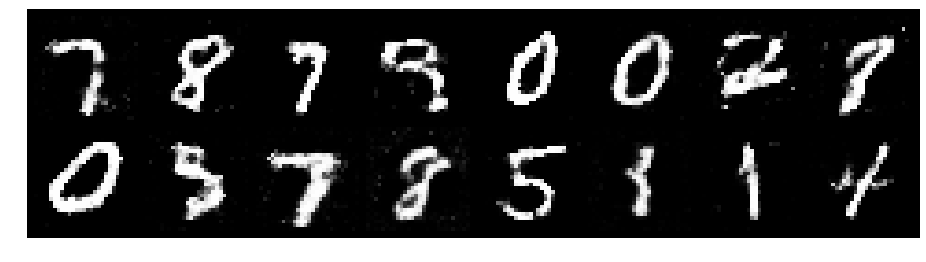

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.2230, Generator Loss: 0.8454
D(x): 0.5374, D(G(z)): 0.4269


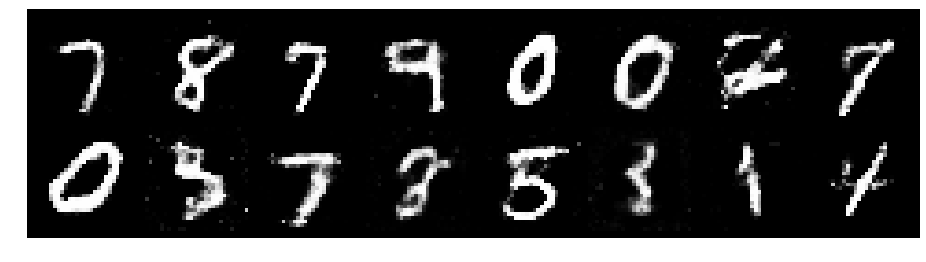

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.1928, Generator Loss: 0.9758
D(x): 0.5560, D(G(z)): 0.4232


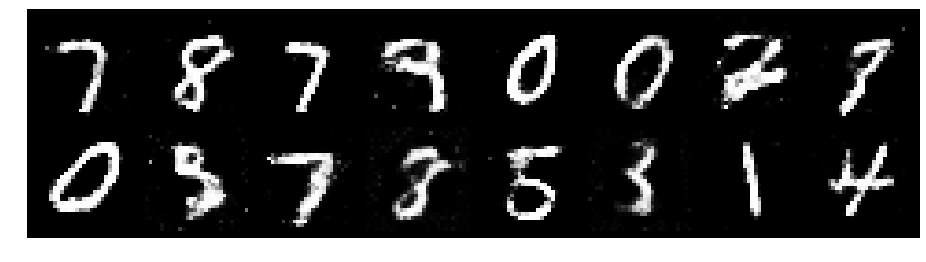

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.2065, Generator Loss: 0.7733
D(x): 0.6050, D(G(z)): 0.4680


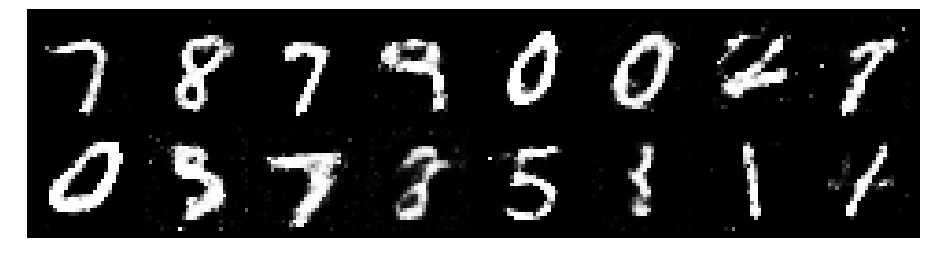

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.3712, Generator Loss: 0.9031
D(x): 0.5146, D(G(z)): 0.4535


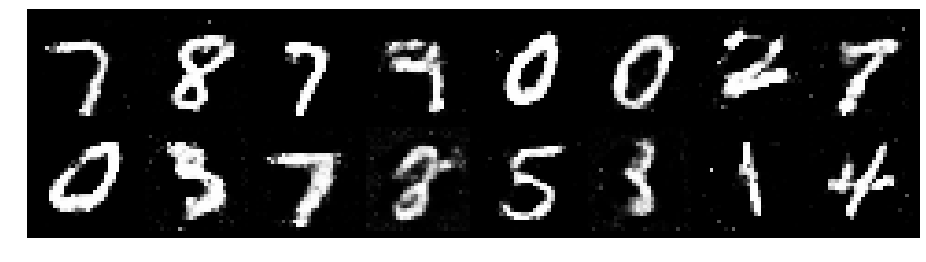

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.1807, Generator Loss: 0.8426
D(x): 0.5985, D(G(z)): 0.4296


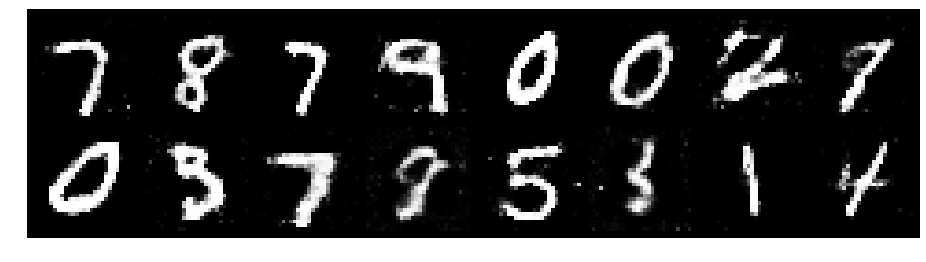

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.3288, Generator Loss: 0.8665
D(x): 0.5481, D(G(z)): 0.4754


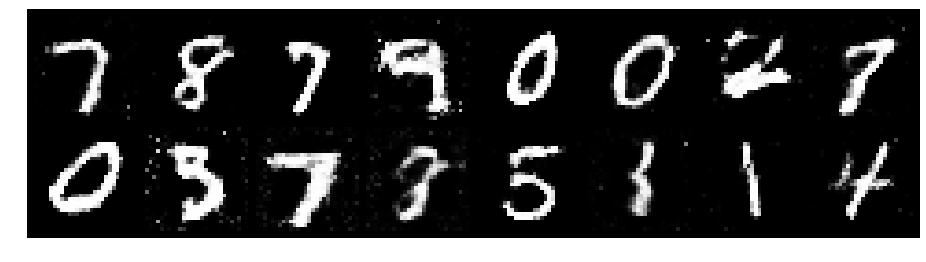

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.3629, Generator Loss: 0.8061
D(x): 0.5536, D(G(z)): 0.4505


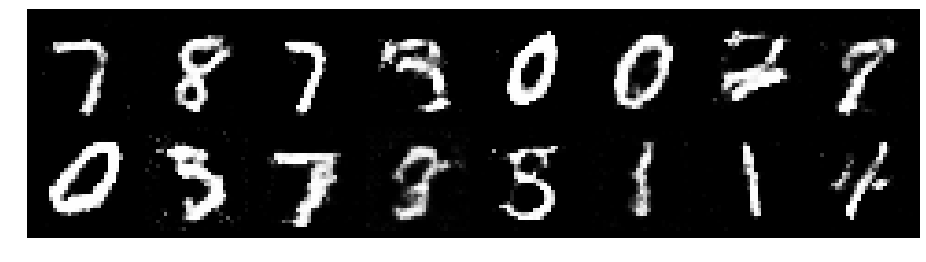

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.3398, Generator Loss: 0.8150
D(x): 0.5425, D(G(z)): 0.4696


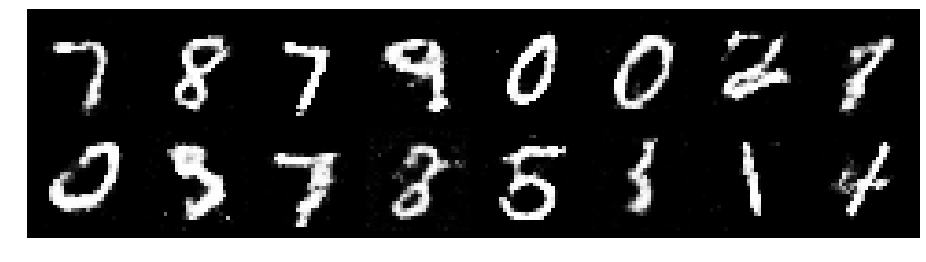

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.2649, Generator Loss: 0.8525
D(x): 0.5400, D(G(z)): 0.4440


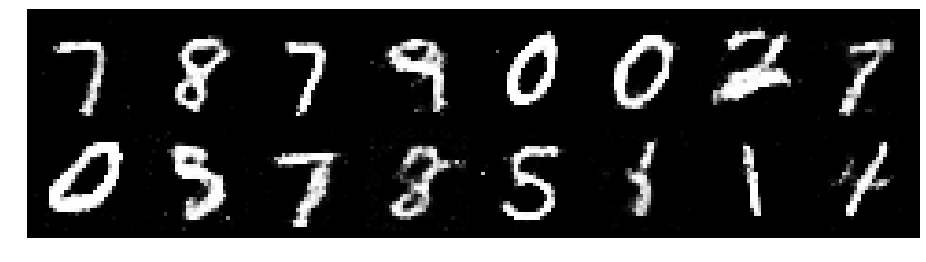

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.3919, Generator Loss: 0.7686
D(x): 0.5583, D(G(z)): 0.5099


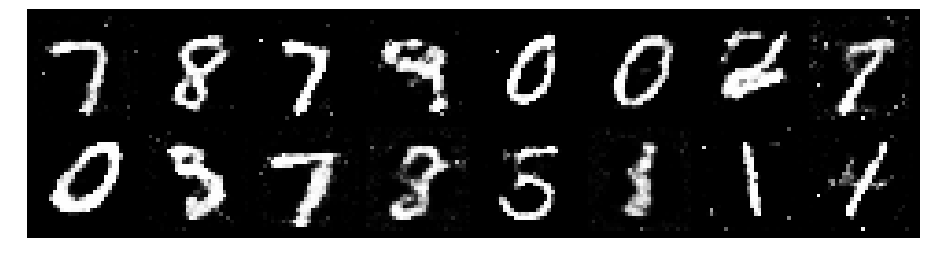

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.2335, Generator Loss: 0.8873
D(x): 0.5386, D(G(z)): 0.4251


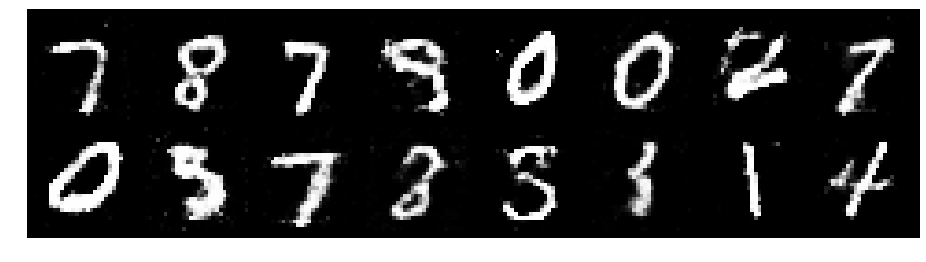

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.2740, Generator Loss: 0.8894
D(x): 0.5517, D(G(z)): 0.4481


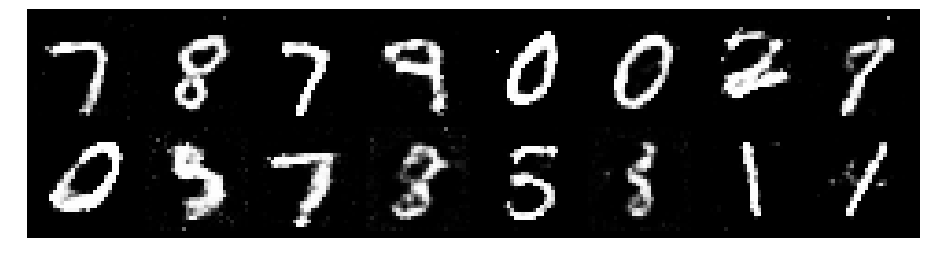

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.2747, Generator Loss: 0.7895
D(x): 0.5548, D(G(z)): 0.4561


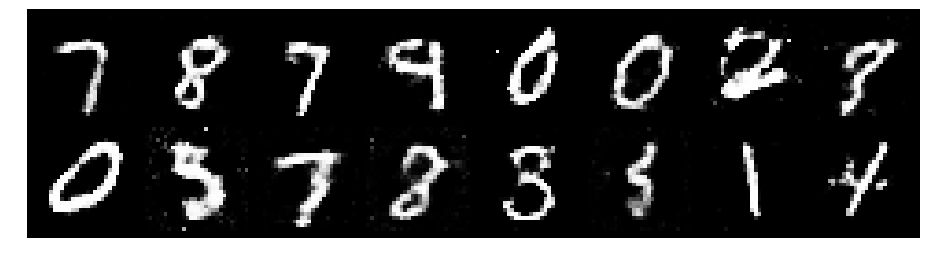

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.3455, Generator Loss: 0.7949
D(x): 0.5269, D(G(z)): 0.4726


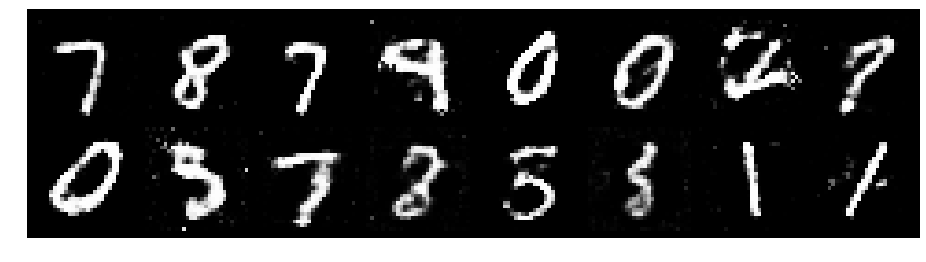

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.3667, Generator Loss: 0.8346
D(x): 0.5077, D(G(z)): 0.4550


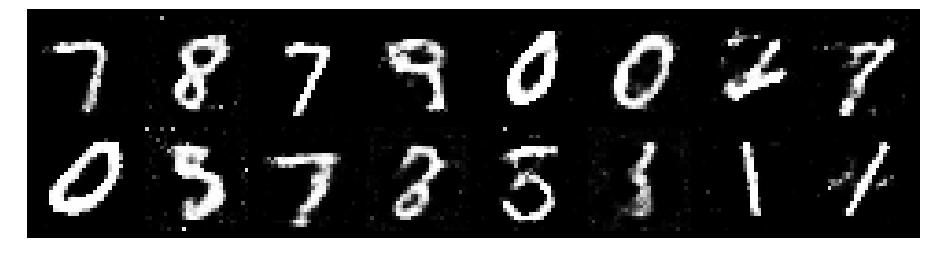

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.3642, Generator Loss: 0.8077
D(x): 0.5427, D(G(z)): 0.4821


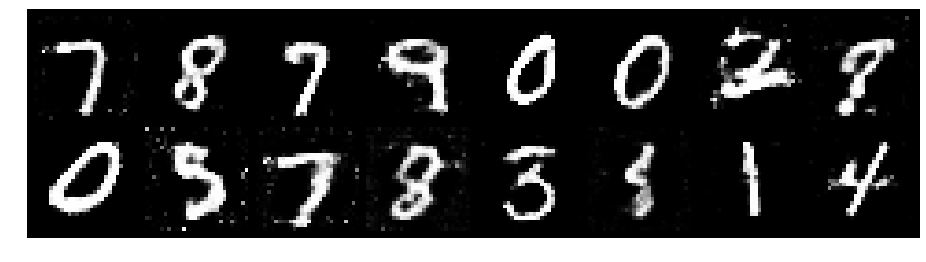

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.3442, Generator Loss: 0.8910
D(x): 0.5526, D(G(z)): 0.4755


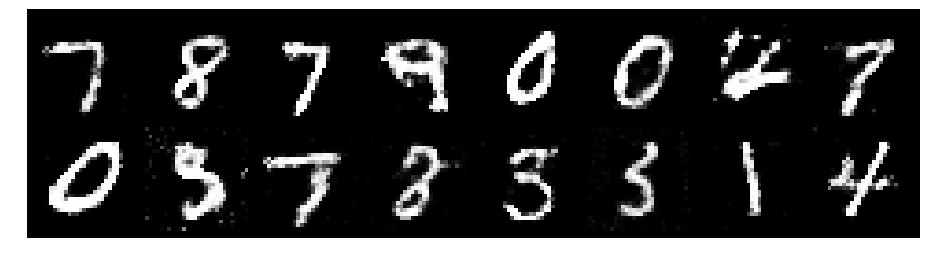

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.2365, Generator Loss: 0.8272
D(x): 0.5556, D(G(z)): 0.4369


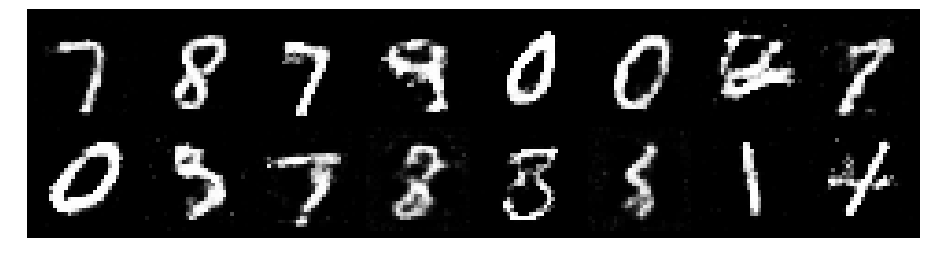

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.4101, Generator Loss: 0.7599
D(x): 0.5705, D(G(z)): 0.5211


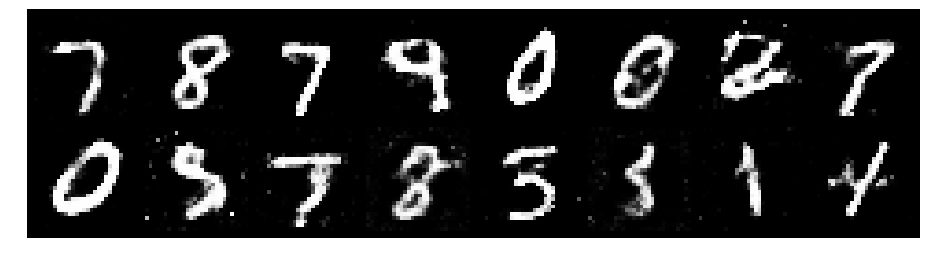

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.2929, Generator Loss: 0.8097
D(x): 0.5384, D(G(z)): 0.4475


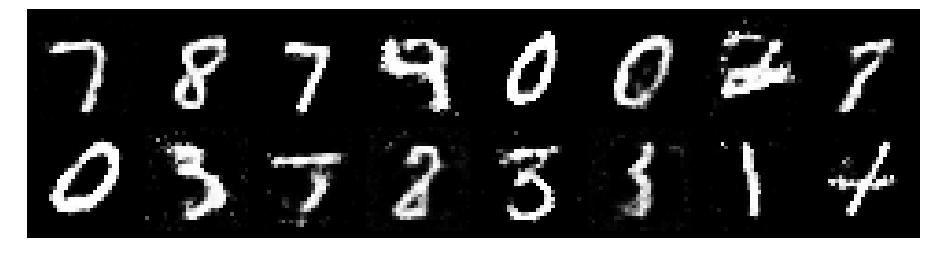

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.2428, Generator Loss: 0.9647
D(x): 0.5532, D(G(z)): 0.4348


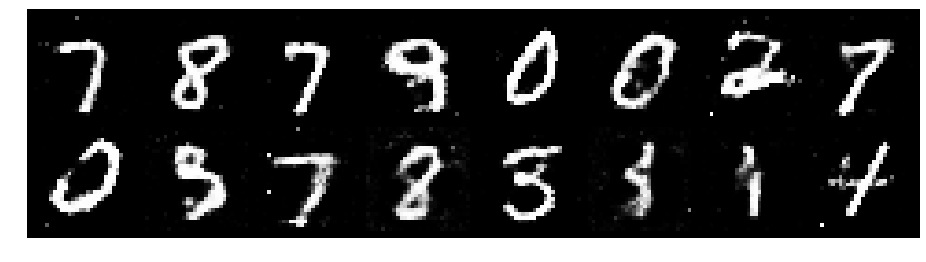

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.2127, Generator Loss: 0.8953
D(x): 0.5554, D(G(z)): 0.4276


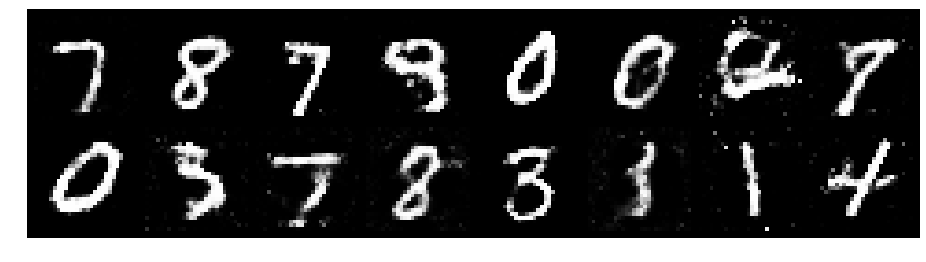

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.2336, Generator Loss: 0.9224
D(x): 0.5606, D(G(z)): 0.4325


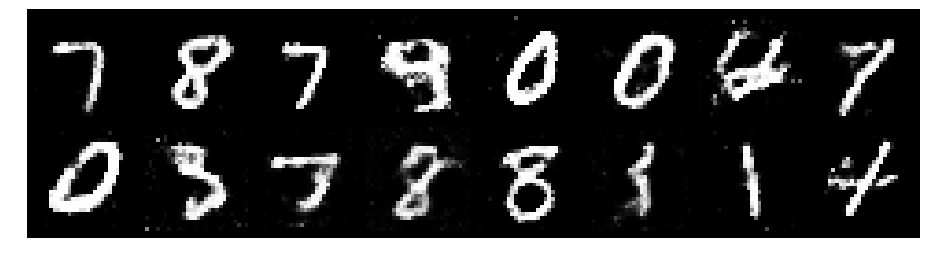

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.2024, Generator Loss: 0.9553
D(x): 0.5661, D(G(z)): 0.4160


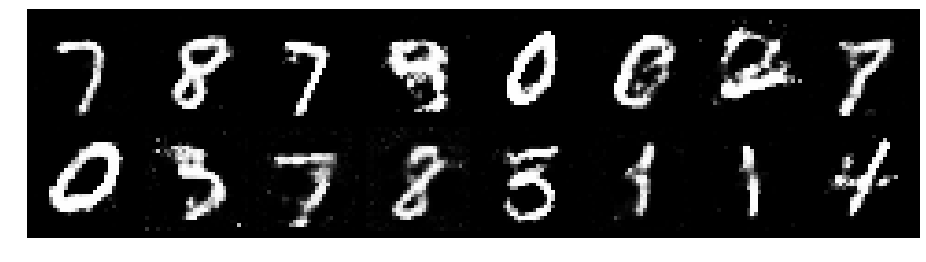

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.1396, Generator Loss: 1.0786
D(x): 0.5830, D(G(z)): 0.4015


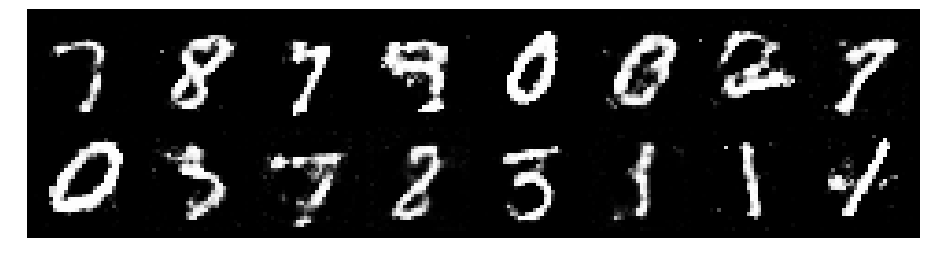

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.2568, Generator Loss: 0.9092
D(x): 0.5503, D(G(z)): 0.4210


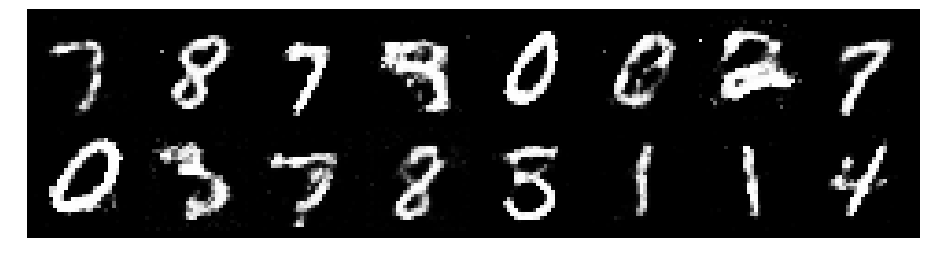

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.1878, Generator Loss: 0.8464
D(x): 0.5994, D(G(z)): 0.4500


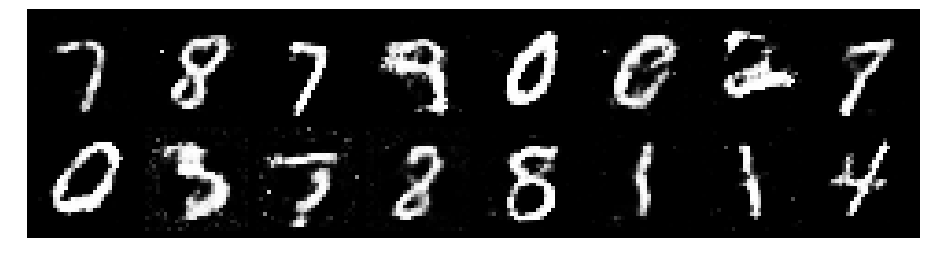

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.3183, Generator Loss: 0.8193
D(x): 0.5676, D(G(z)): 0.4717


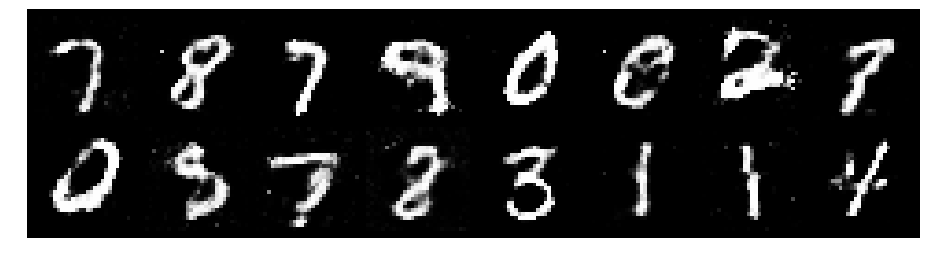

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.3010, Generator Loss: 0.8701
D(x): 0.5257, D(G(z)): 0.4341


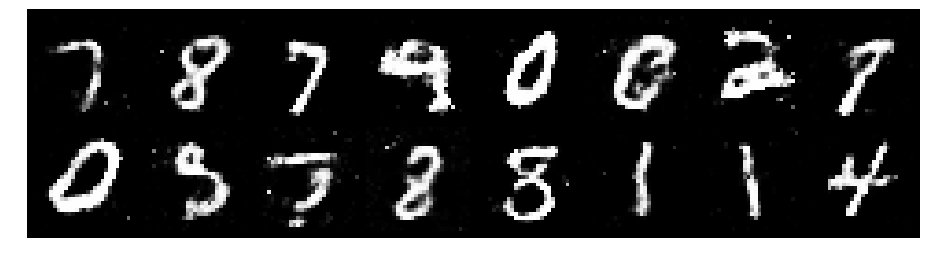

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.1810, Generator Loss: 0.9083
D(x): 0.6176, D(G(z)): 0.4597


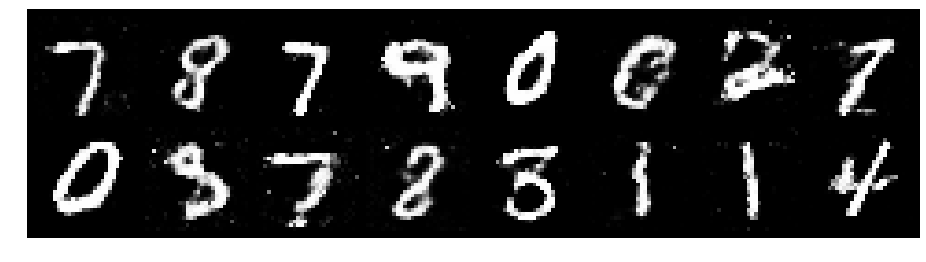

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.2010, Generator Loss: 0.9366
D(x): 0.6135, D(G(z)): 0.4442


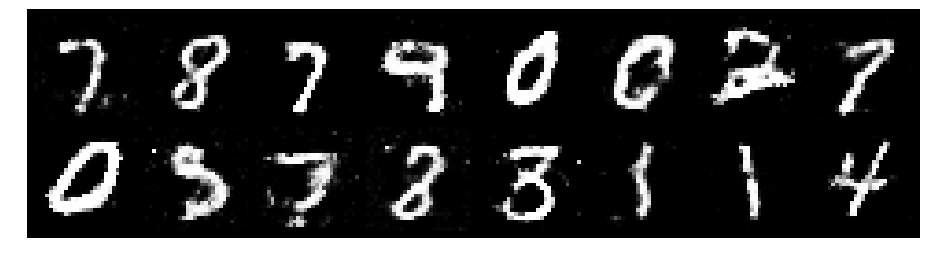

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.2800, Generator Loss: 0.8465
D(x): 0.5575, D(G(z)): 0.4666


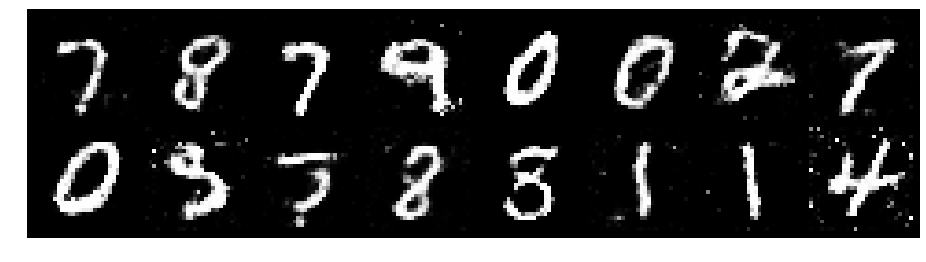

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.3331, Generator Loss: 0.9210
D(x): 0.5315, D(G(z)): 0.4512


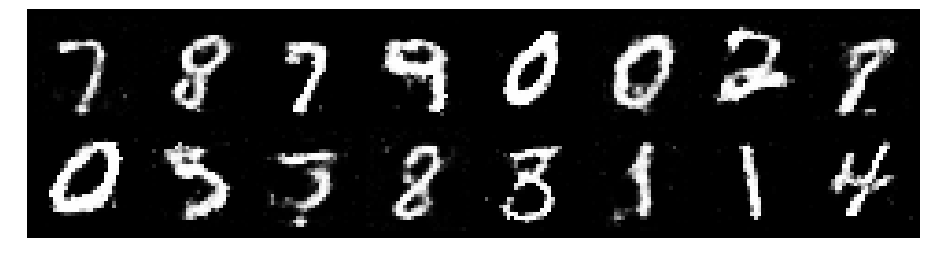

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.2343, Generator Loss: 0.7914
D(x): 0.5818, D(G(z)): 0.4750


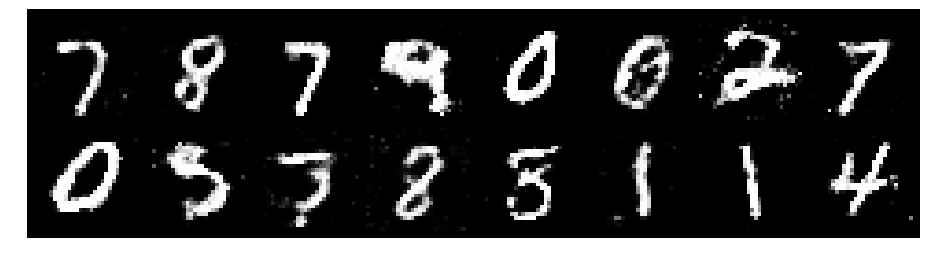

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.3452, Generator Loss: 0.8673
D(x): 0.5268, D(G(z)): 0.4748


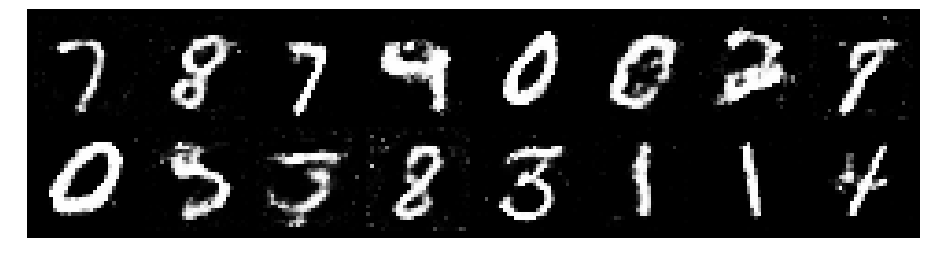

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.4934, Generator Loss: 0.8046
D(x): 0.4739, D(G(z)): 0.4288


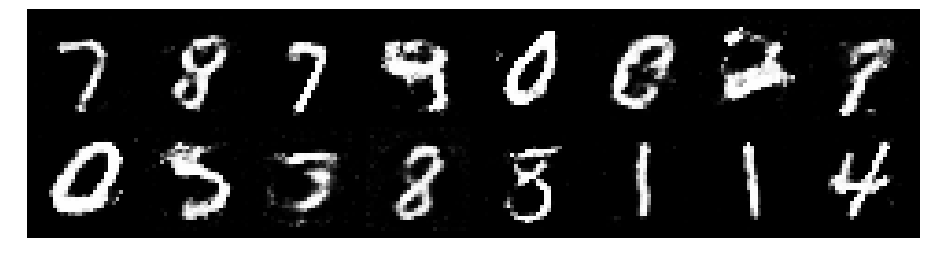

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.2796, Generator Loss: 0.8401
D(x): 0.5501, D(G(z)): 0.4599


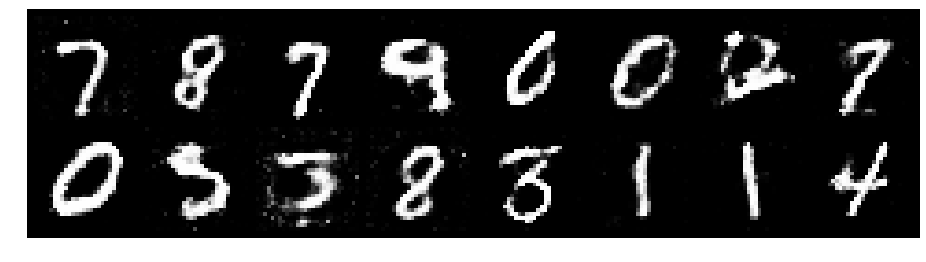

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.3311, Generator Loss: 0.7870
D(x): 0.5726, D(G(z)): 0.5088


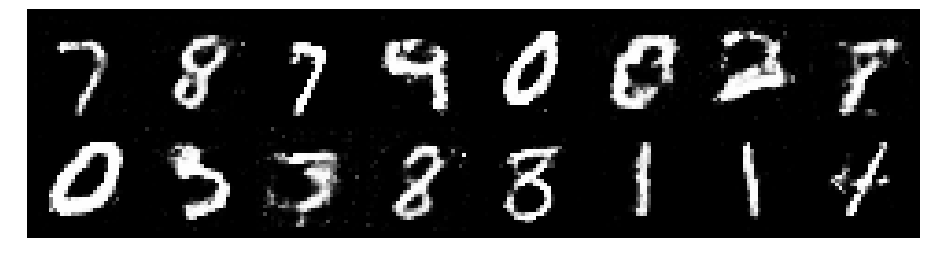

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.4458, Generator Loss: 0.9093
D(x): 0.5549, D(G(z)): 0.5003


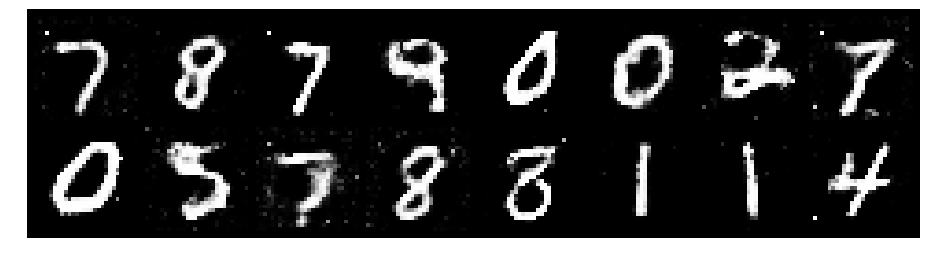

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.2594, Generator Loss: 0.9720
D(x): 0.5495, D(G(z)): 0.4154


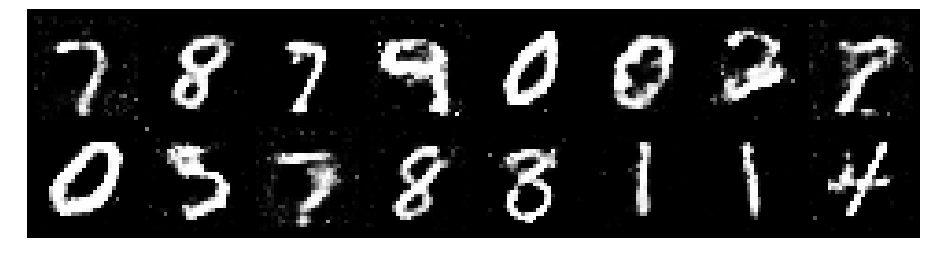

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.3209, Generator Loss: 0.9076
D(x): 0.5272, D(G(z)): 0.4243


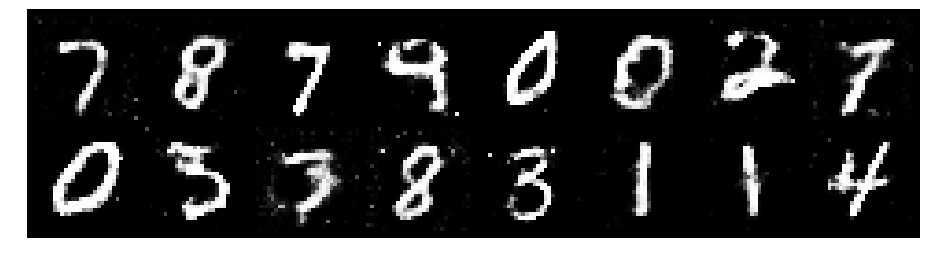

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.1879, Generator Loss: 0.9085
D(x): 0.5643, D(G(z)): 0.4177


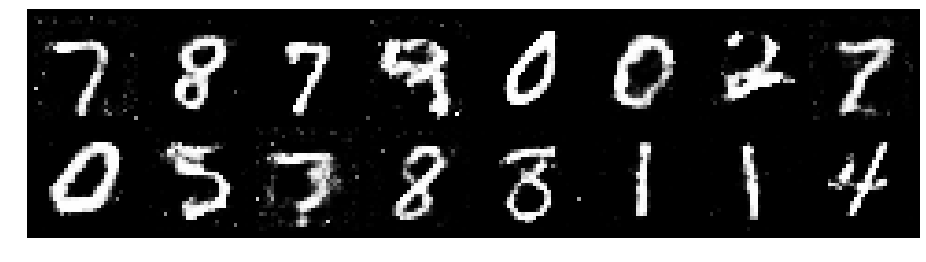

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.2793, Generator Loss: 0.7739
D(x): 0.5415, D(G(z)): 0.4578


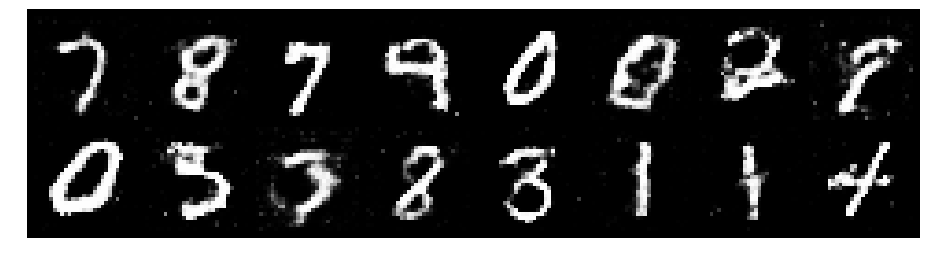

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.2924, Generator Loss: 0.8111
D(x): 0.5372, D(G(z)): 0.4470


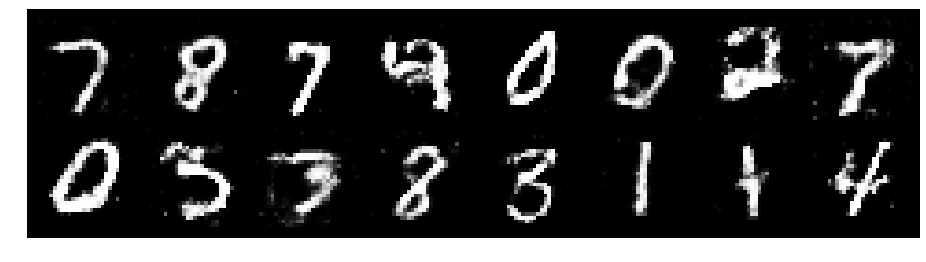

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.2185, Generator Loss: 0.8833
D(x): 0.5556, D(G(z)): 0.4232


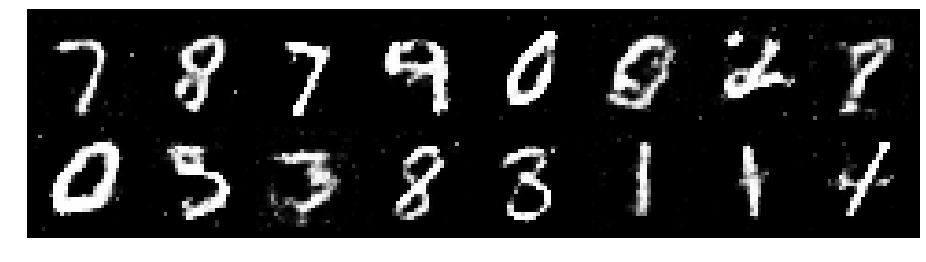

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.3276, Generator Loss: 0.8600
D(x): 0.5523, D(G(z)): 0.4818


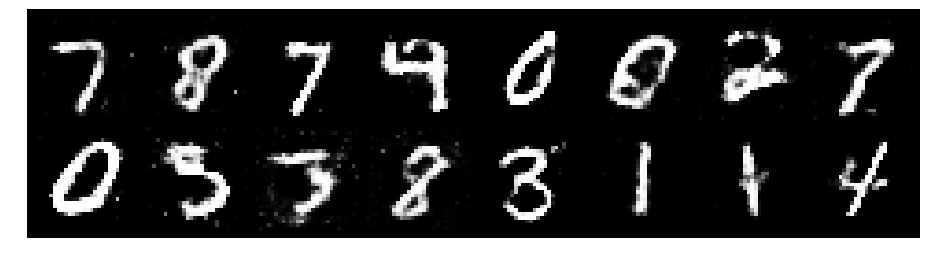

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.2357, Generator Loss: 0.8846
D(x): 0.5796, D(G(z)): 0.4498


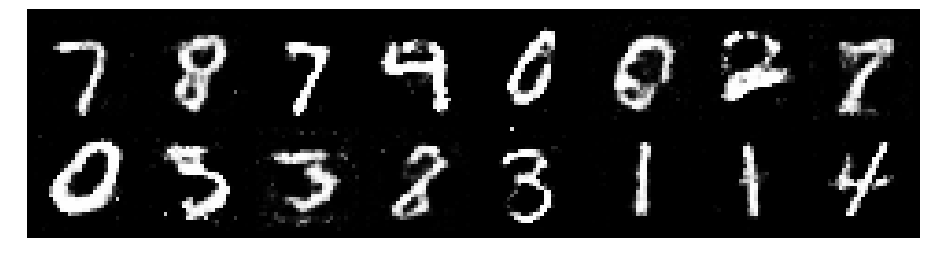

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.2386, Generator Loss: 0.8937
D(x): 0.5828, D(G(z)): 0.4590


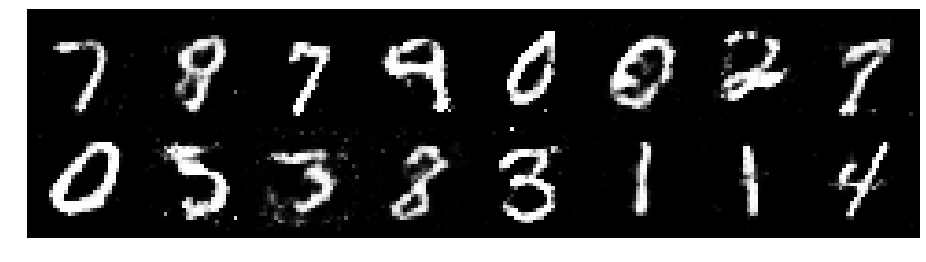

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.2897, Generator Loss: 0.8354
D(x): 0.5915, D(G(z)): 0.4842


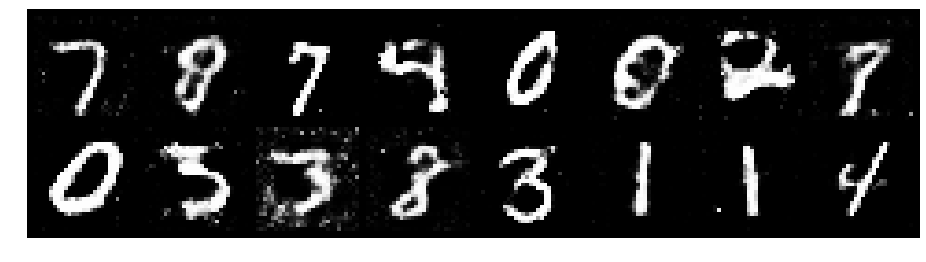

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.3867, Generator Loss: 0.8479
D(x): 0.5140, D(G(z)): 0.4667


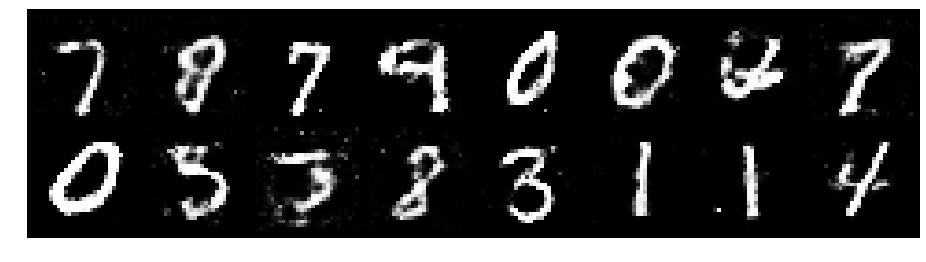

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.3086, Generator Loss: 0.8994
D(x): 0.5557, D(G(z)): 0.4670


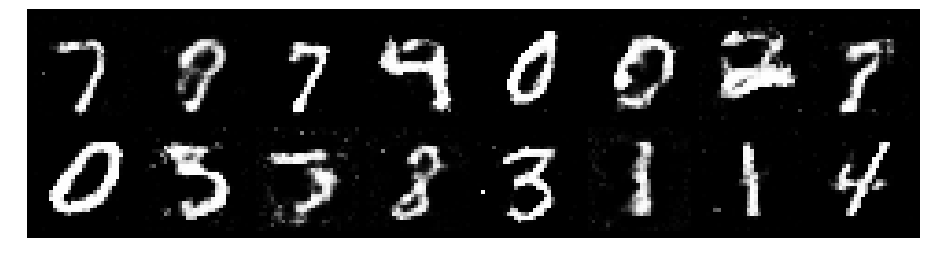

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.3369, Generator Loss: 0.8585
D(x): 0.5609, D(G(z)): 0.4718


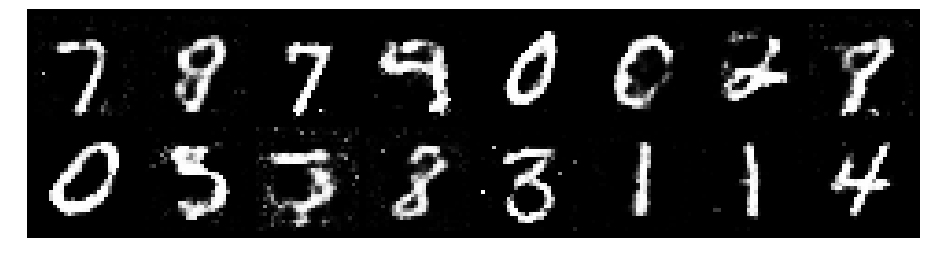

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.2515, Generator Loss: 0.8462
D(x): 0.5747, D(G(z)): 0.4589


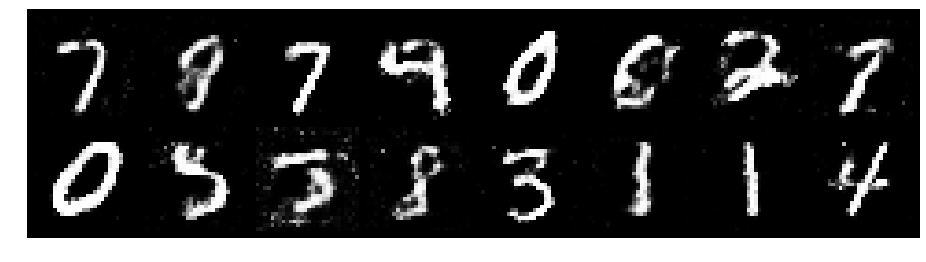

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.2781, Generator Loss: 0.8430
D(x): 0.5891, D(G(z)): 0.4819


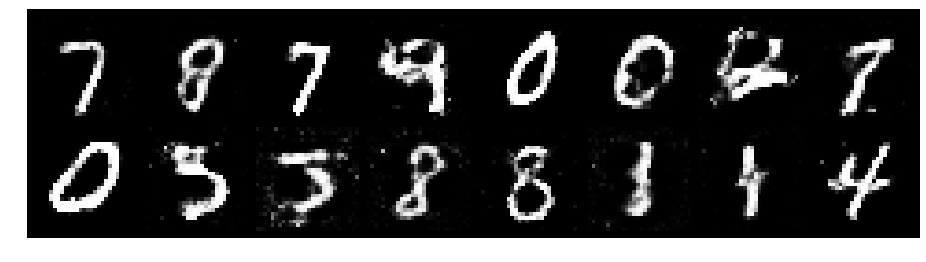

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.2702, Generator Loss: 0.8844
D(x): 0.5564, D(G(z)): 0.4576


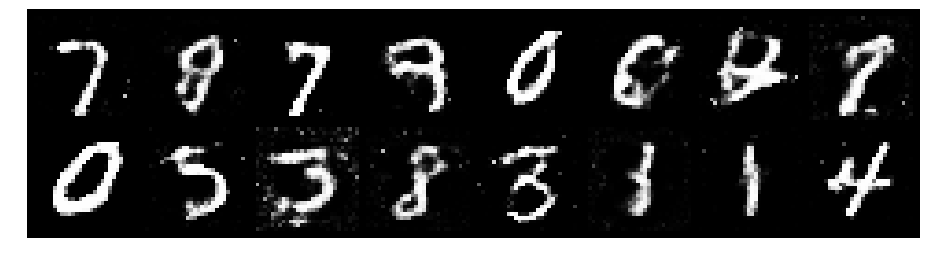

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.2794, Generator Loss: 0.8133
D(x): 0.5379, D(G(z)): 0.4554


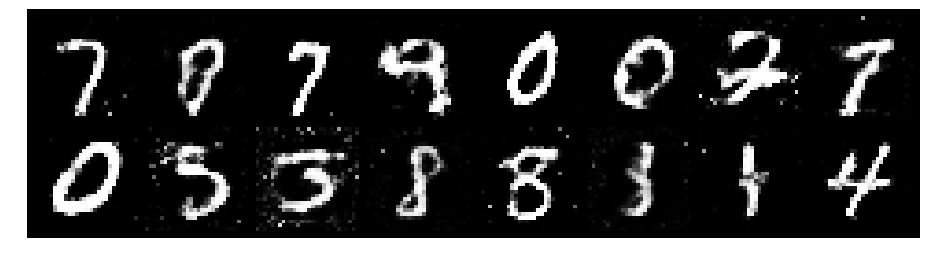

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.3036, Generator Loss: 1.0762
D(x): 0.5263, D(G(z)): 0.4066


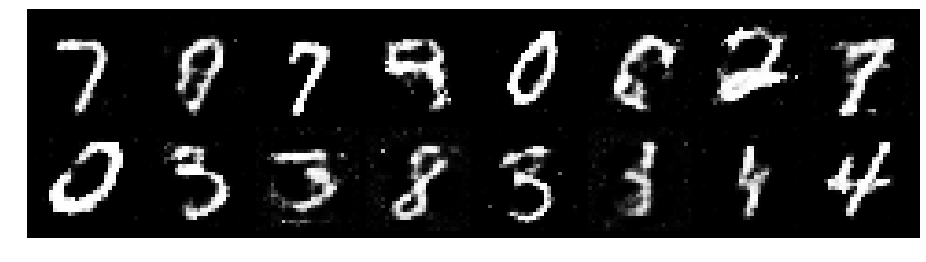

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.3329, Generator Loss: 0.8721
D(x): 0.5580, D(G(z)): 0.4576


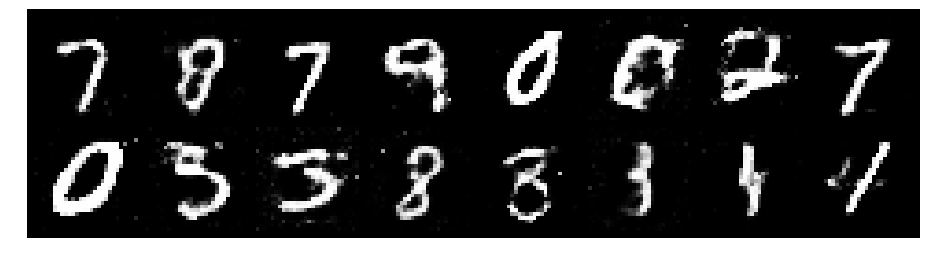

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.2451, Generator Loss: 0.9096
D(x): 0.6012, D(G(z)): 0.4595


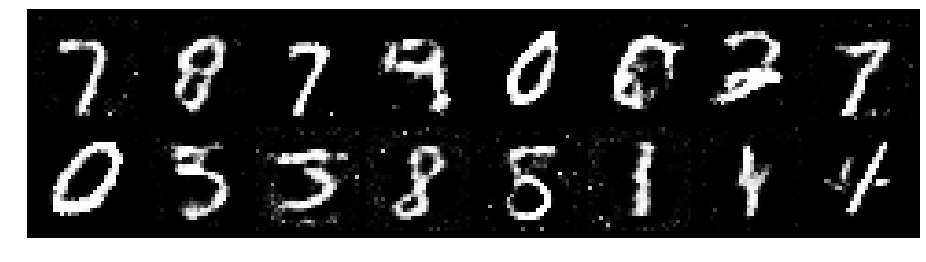

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.2937, Generator Loss: 0.8625
D(x): 0.5546, D(G(z)): 0.4593


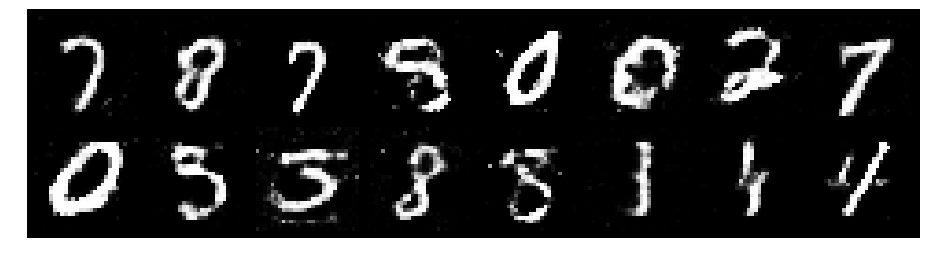

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.2414, Generator Loss: 0.9861
D(x): 0.5367, D(G(z)): 0.4078


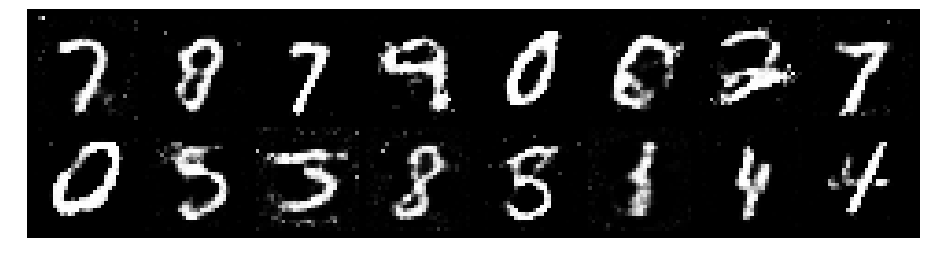

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.2730, Generator Loss: 0.8834
D(x): 0.5631, D(G(z)): 0.4603


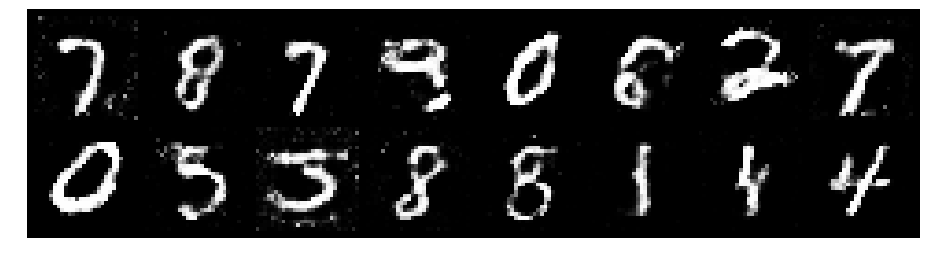

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.2187, Generator Loss: 0.8796
D(x): 0.5633, D(G(z)): 0.4291


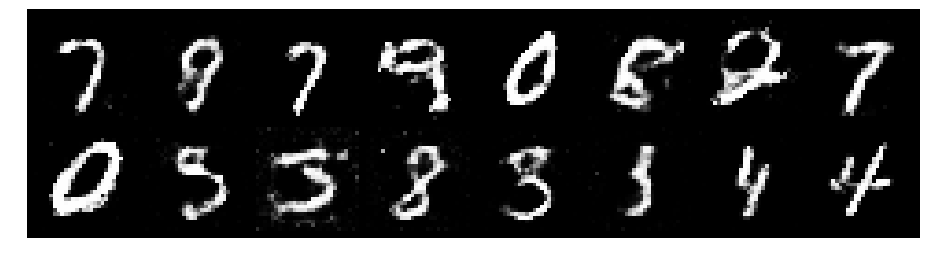

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.3353, Generator Loss: 0.9333
D(x): 0.5268, D(G(z)): 0.4482


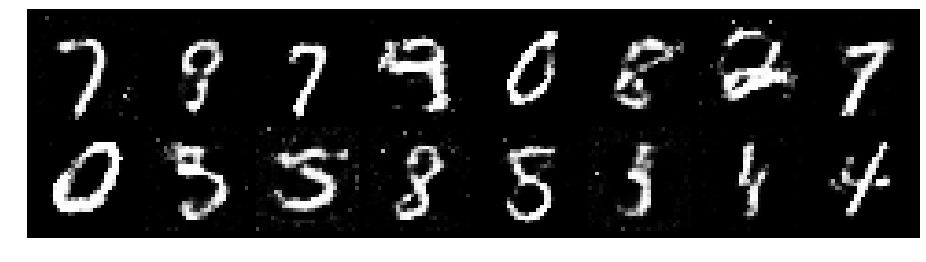

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.2245, Generator Loss: 0.8199
D(x): 0.5897, D(G(z)): 0.4442


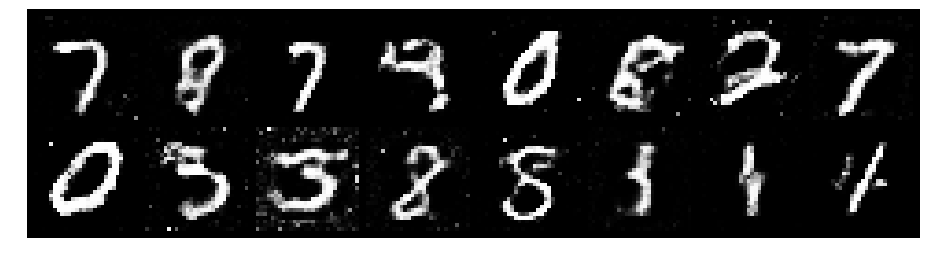

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.1826, Generator Loss: 0.8614
D(x): 0.5948, D(G(z)): 0.4486


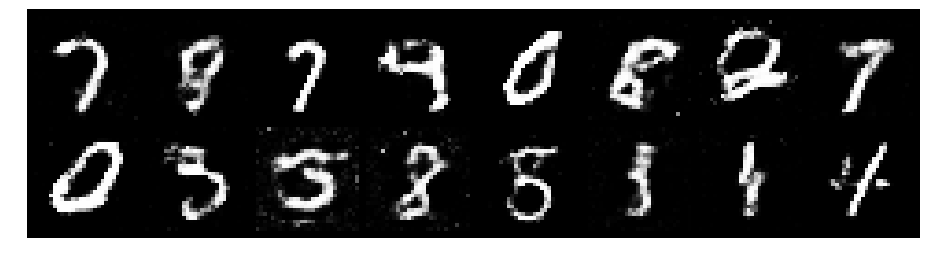

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.3433, Generator Loss: 0.9358
D(x): 0.5050, D(G(z)): 0.4378


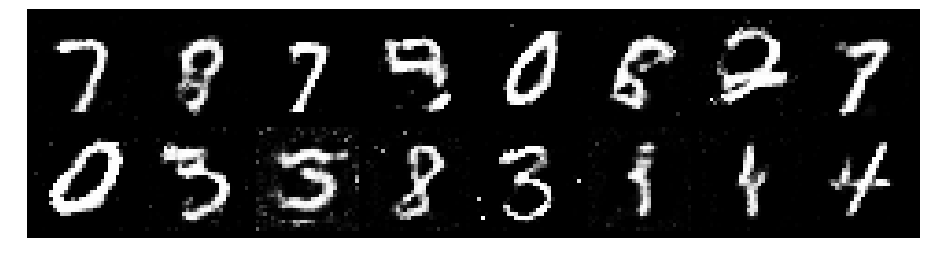

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.2809, Generator Loss: 0.8644
D(x): 0.5703, D(G(z)): 0.4653


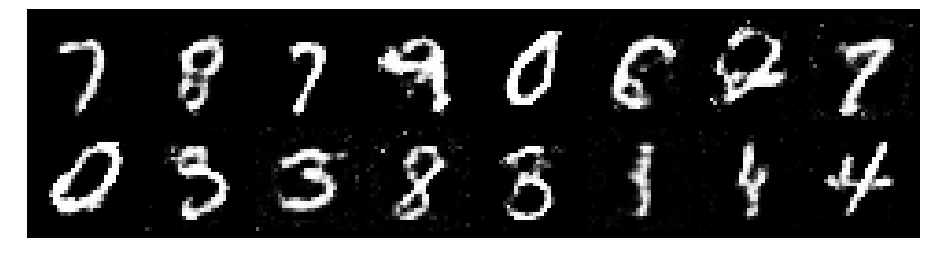

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.2517, Generator Loss: 0.9202
D(x): 0.5375, D(G(z)): 0.4219


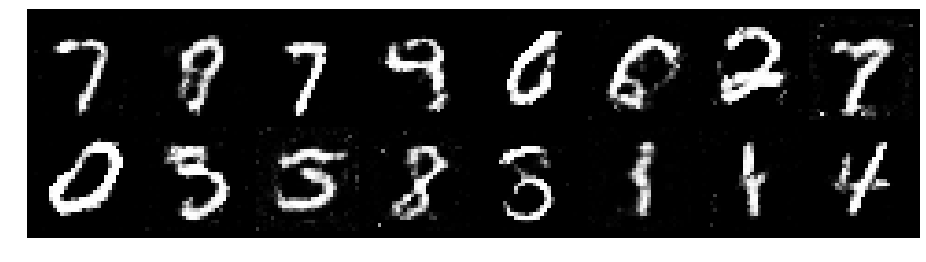

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.2925, Generator Loss: 0.8824
D(x): 0.5426, D(G(z)): 0.4601


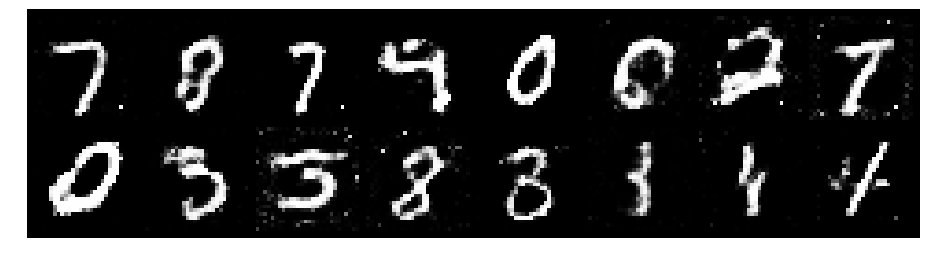

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.3335, Generator Loss: 1.0130
D(x): 0.5632, D(G(z)): 0.4651


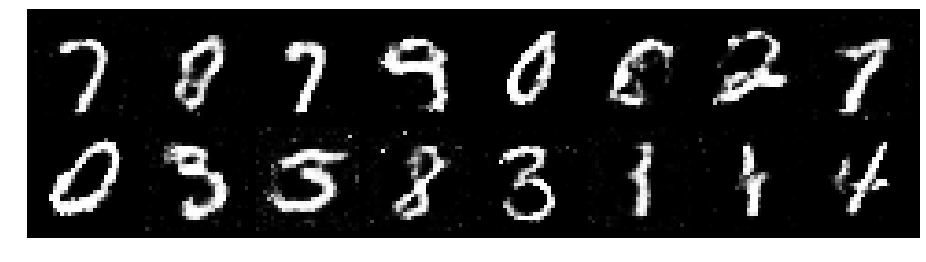

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.2853, Generator Loss: 0.8306
D(x): 0.5775, D(G(z)): 0.4755


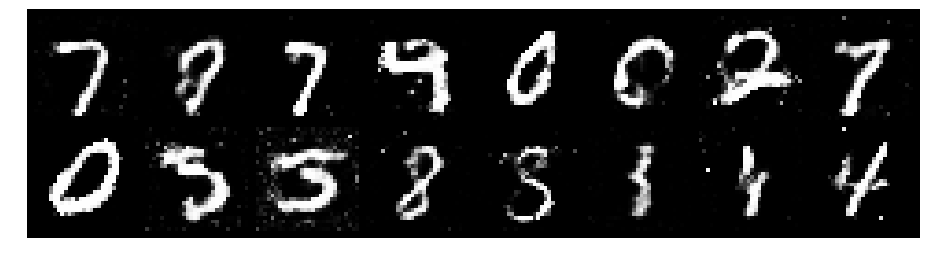

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.3404, Generator Loss: 0.9214
D(x): 0.5233, D(G(z)): 0.4507


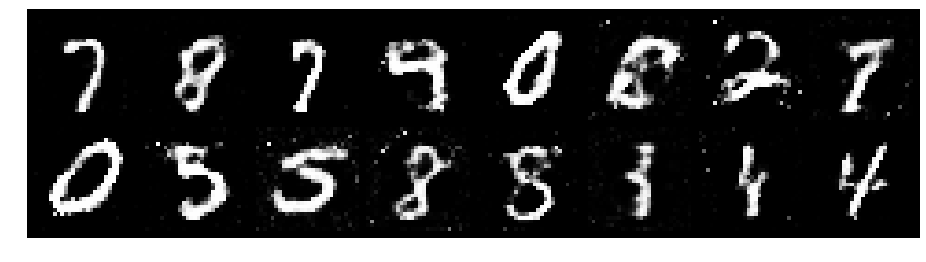

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.1904, Generator Loss: 0.8509
D(x): 0.5667, D(G(z)): 0.4211


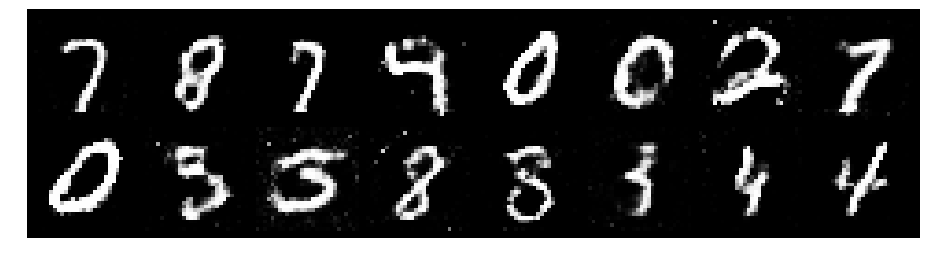

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.2529, Generator Loss: 0.9127
D(x): 0.5392, D(G(z)): 0.4222


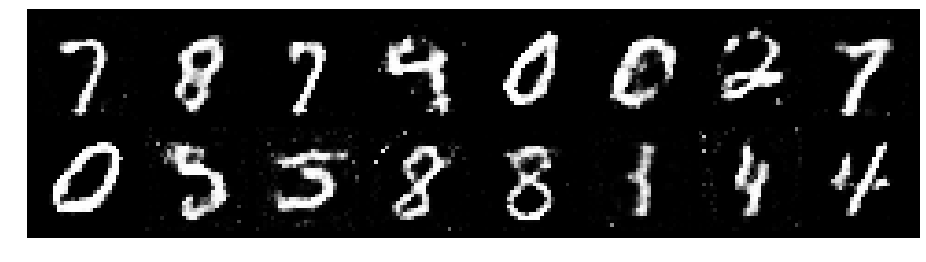

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.2057, Generator Loss: 0.8516
D(x): 0.5772, D(G(z)): 0.4186


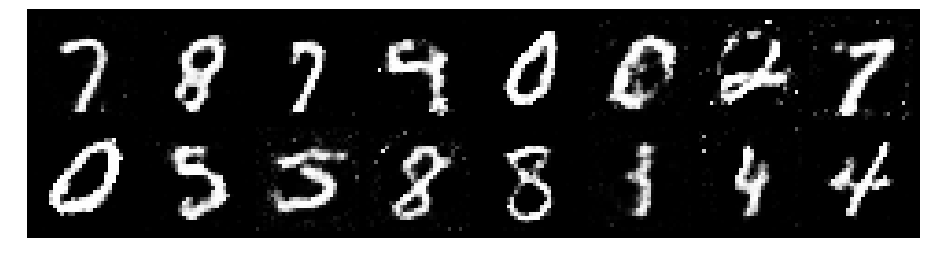

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.2675, Generator Loss: 0.8284
D(x): 0.5435, D(G(z)): 0.4358


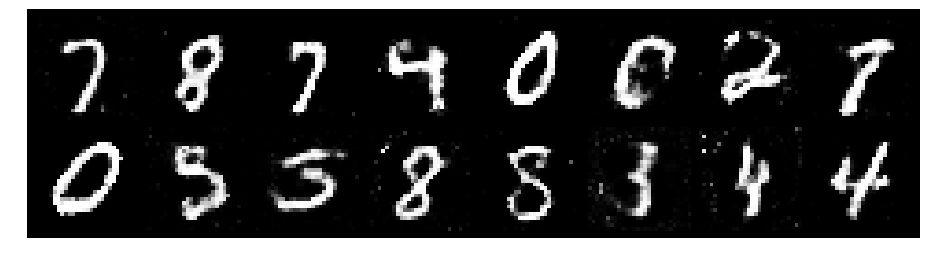

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.3391, Generator Loss: 0.9264
D(x): 0.5412, D(G(z)): 0.4456


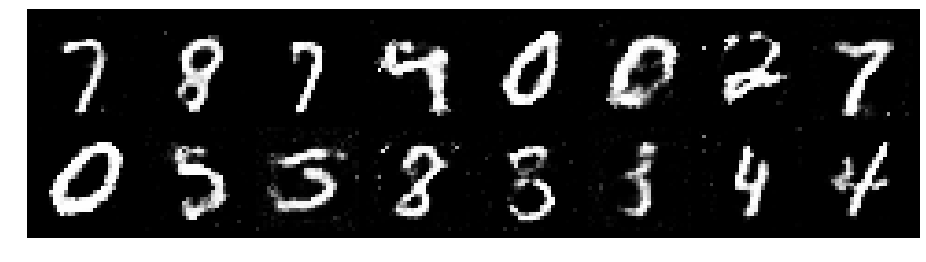

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.2520, Generator Loss: 0.8951
D(x): 0.5561, D(G(z)): 0.4212


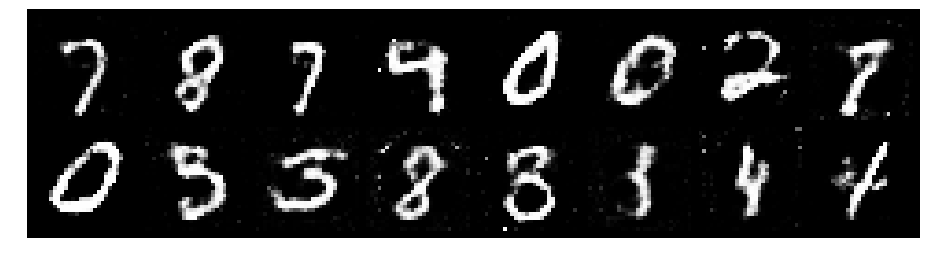

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.4686, Generator Loss: 0.8665
D(x): 0.5257, D(G(z)): 0.4859


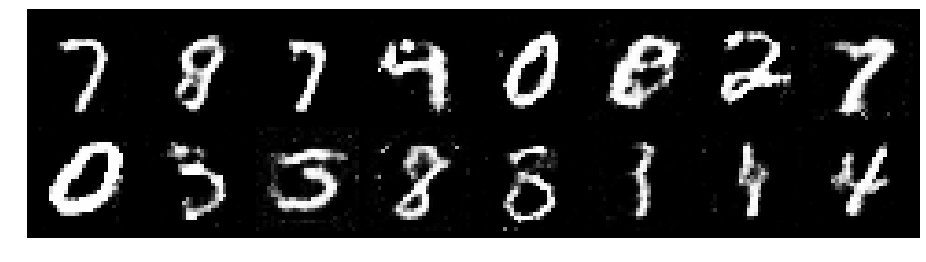

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.3061, Generator Loss: 0.7397
D(x): 0.5416, D(G(z)): 0.4729


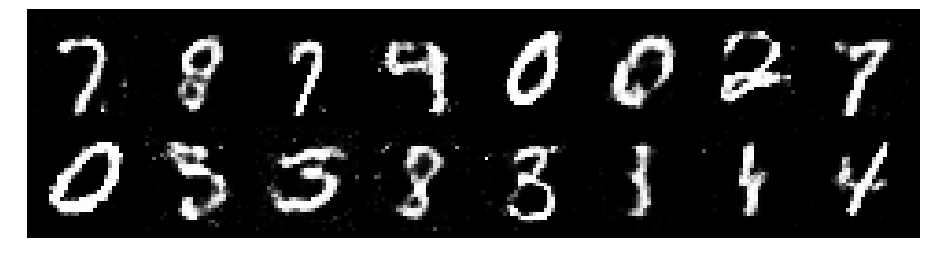

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.2331, Generator Loss: 0.8543
D(x): 0.5487, D(G(z)): 0.4105


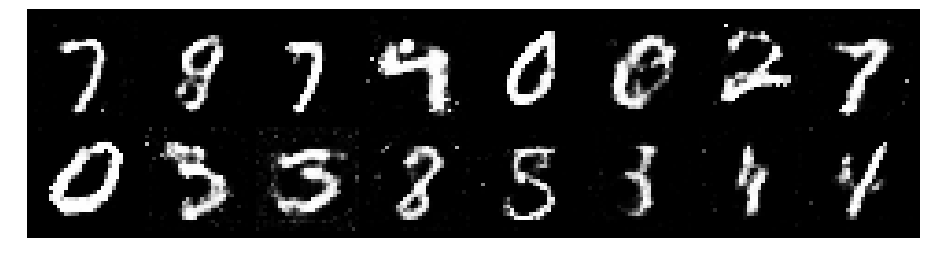

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.3178, Generator Loss: 0.8409
D(x): 0.5346, D(G(z)): 0.4636


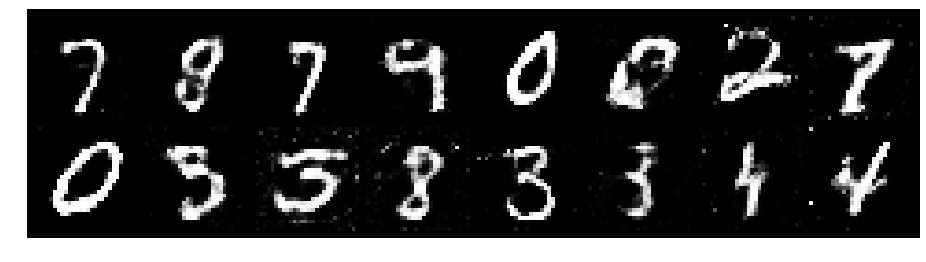

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.2464, Generator Loss: 1.0521
D(x): 0.5565, D(G(z)): 0.4271


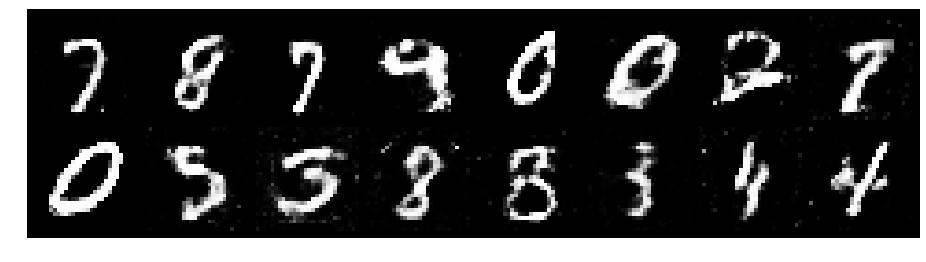

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.2134, Generator Loss: 1.0701
D(x): 0.5404, D(G(z)): 0.3889


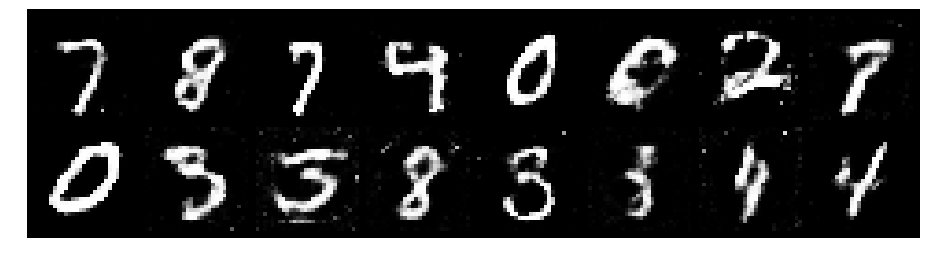

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.3725, Generator Loss: 0.7864
D(x): 0.5459, D(G(z)): 0.4752


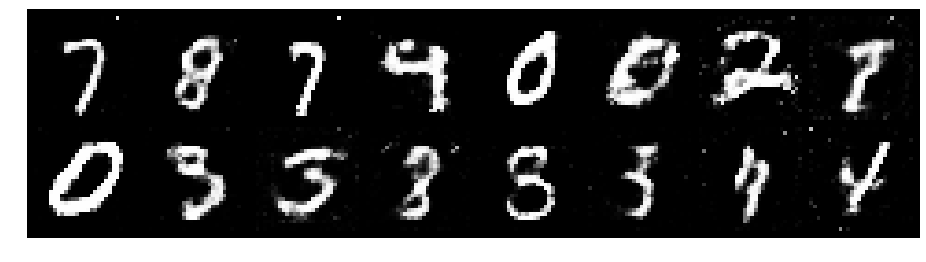

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.4312, Generator Loss: 0.7140
D(x): 0.5448, D(G(z)): 0.5160


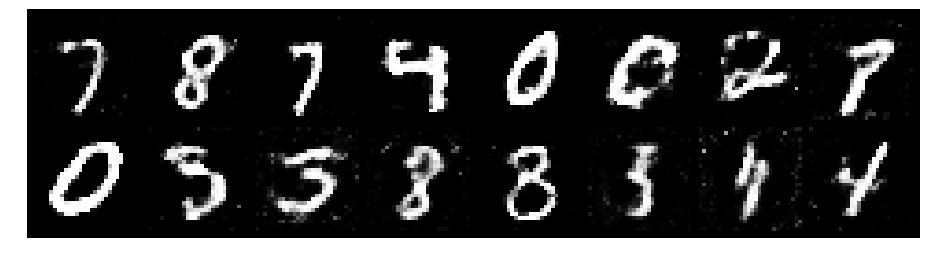

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.3985, Generator Loss: 0.8687
D(x): 0.5102, D(G(z)): 0.4678


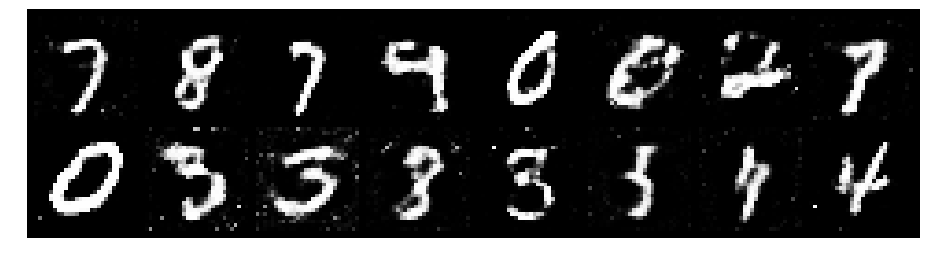

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.4249, Generator Loss: 0.7681
D(x): 0.5360, D(G(z)): 0.5159


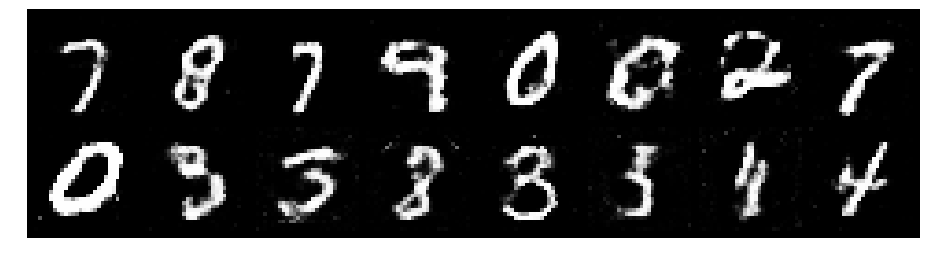

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.2809, Generator Loss: 0.7617
D(x): 0.5822, D(G(z)): 0.4947


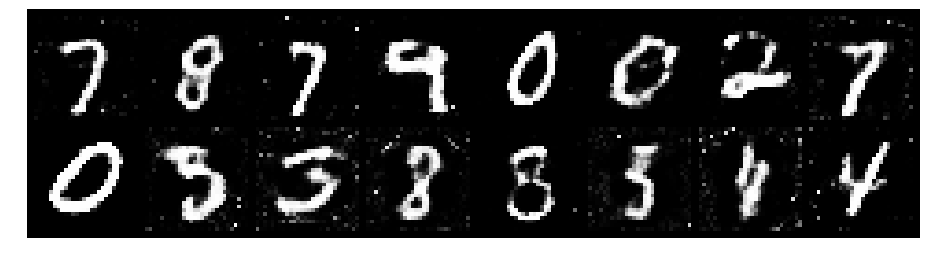

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.3418, Generator Loss: 0.8098
D(x): 0.5438, D(G(z)): 0.4838


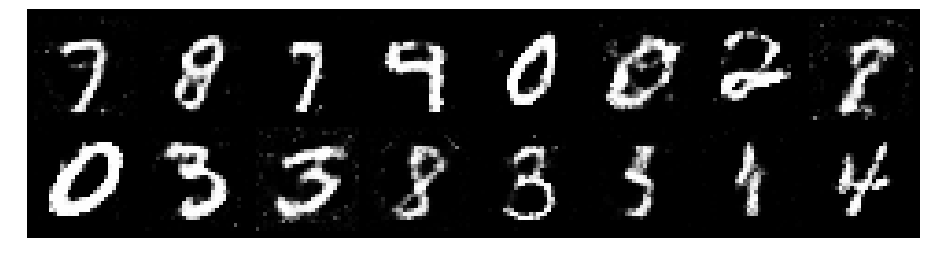

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.2538, Generator Loss: 0.8677
D(x): 0.5741, D(G(z)): 0.4618


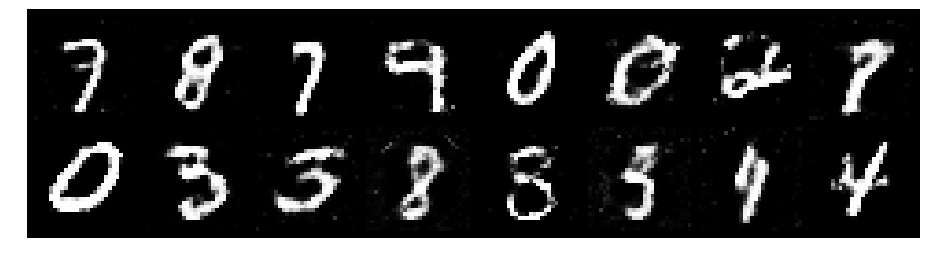

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.2911, Generator Loss: 0.7291
D(x): 0.5896, D(G(z)): 0.4971


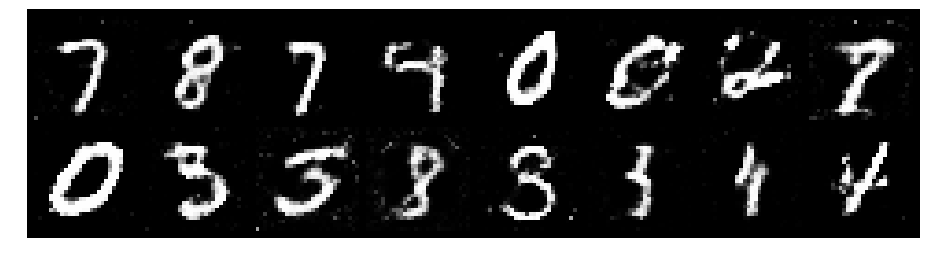

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.2736, Generator Loss: 1.0565
D(x): 0.5780, D(G(z)): 0.4484


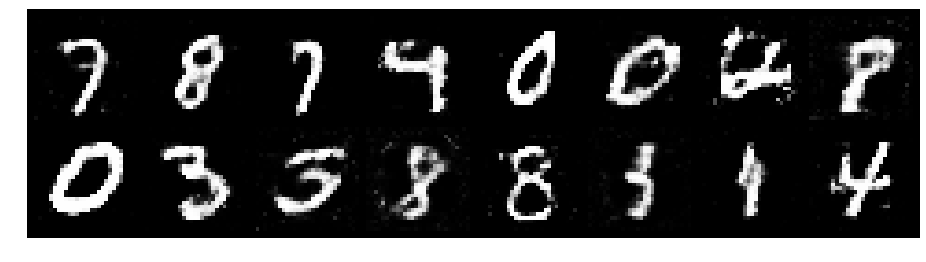

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.3178, Generator Loss: 0.8660
D(x): 0.5488, D(G(z)): 0.4657


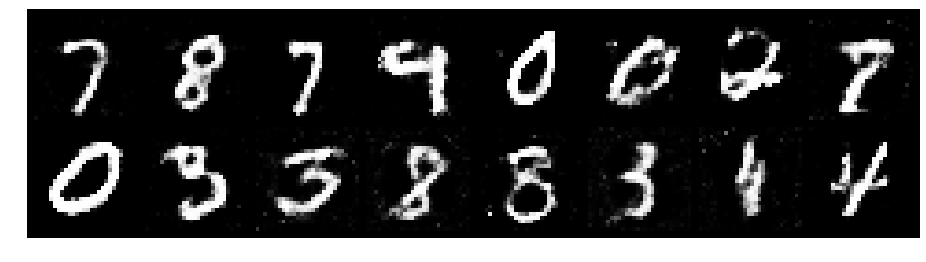

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.3474, Generator Loss: 0.8304
D(x): 0.5534, D(G(z)): 0.4820


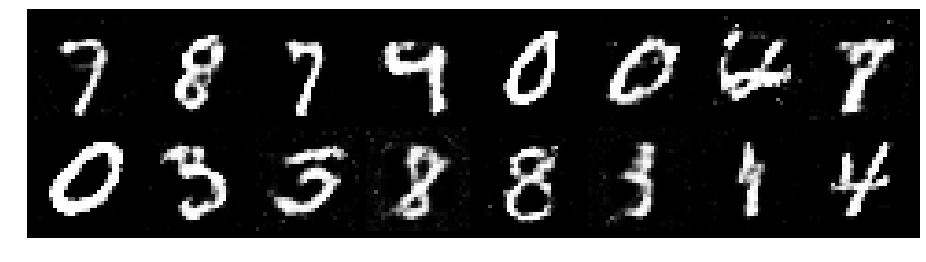

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.2774, Generator Loss: 0.7770
D(x): 0.6036, D(G(z)): 0.4812


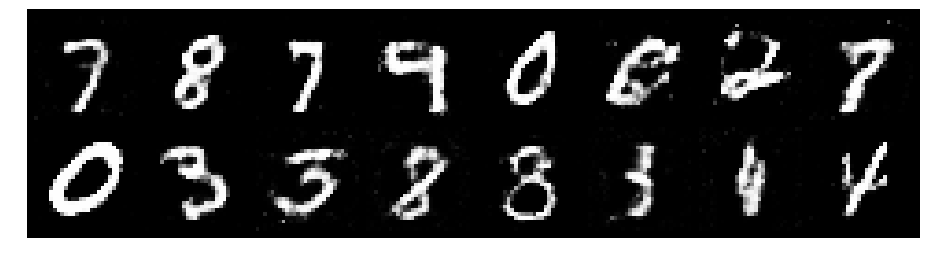

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.3179, Generator Loss: 0.8669
D(x): 0.5315, D(G(z)): 0.4481


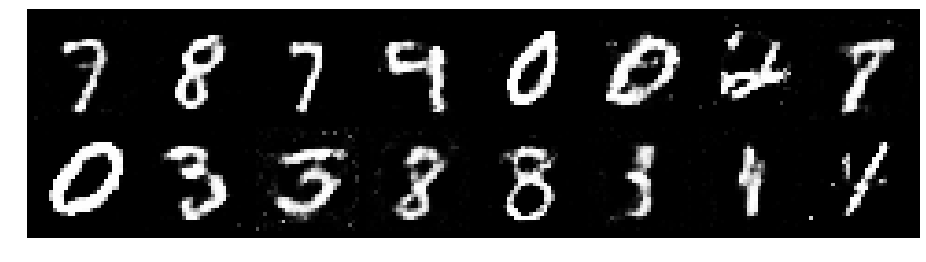

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.3024, Generator Loss: 0.9376
D(x): 0.4875, D(G(z)): 0.3848


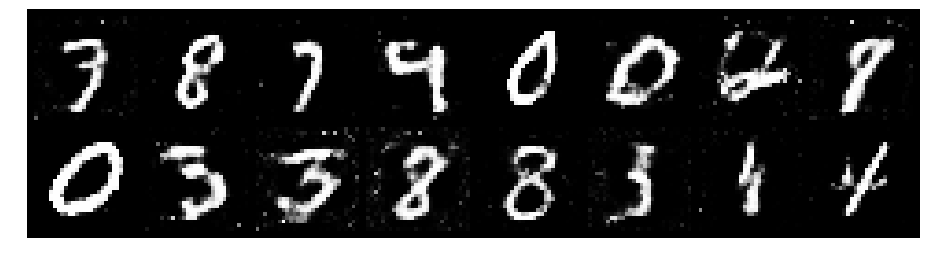

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.3579, Generator Loss: 0.7616
D(x): 0.5548, D(G(z)): 0.4921


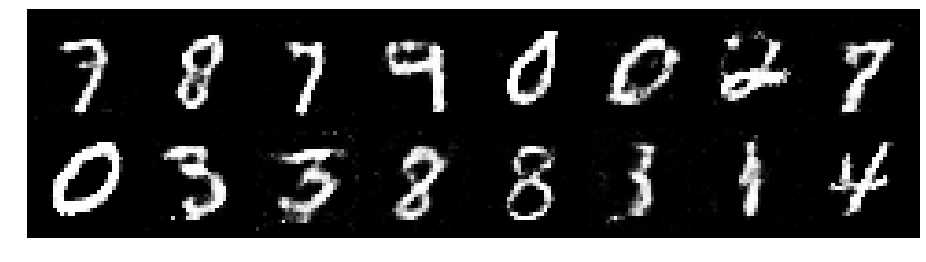

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.2849, Generator Loss: 0.8365
D(x): 0.5747, D(G(z)): 0.4575


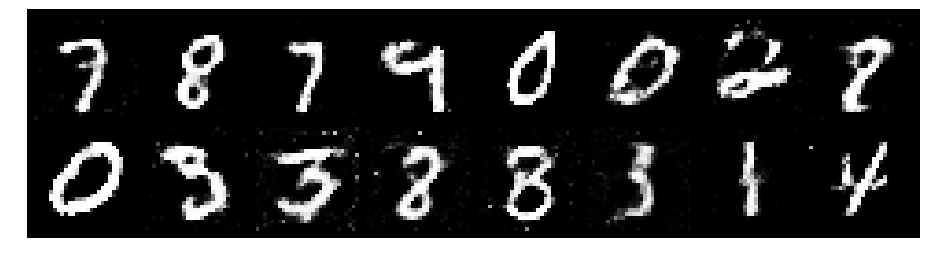

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.2928, Generator Loss: 0.7915
D(x): 0.5680, D(G(z)): 0.4762


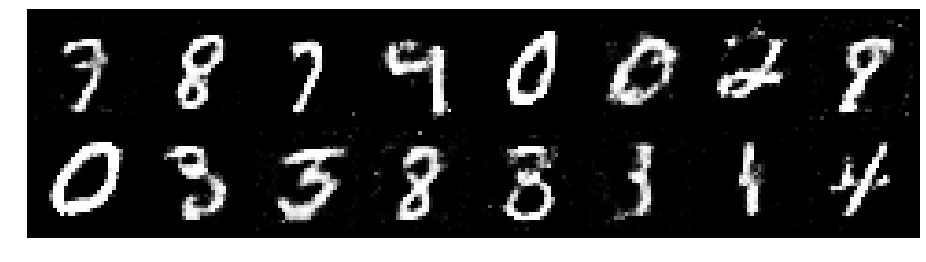

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.1730, Generator Loss: 0.8881
D(x): 0.5946, D(G(z)): 0.4298


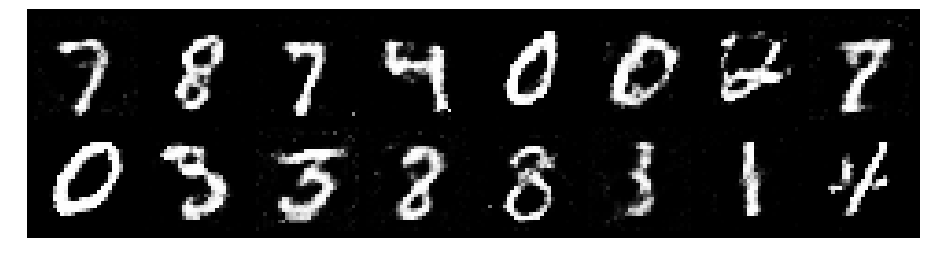

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.3744, Generator Loss: 0.9358
D(x): 0.4983, D(G(z)): 0.4489


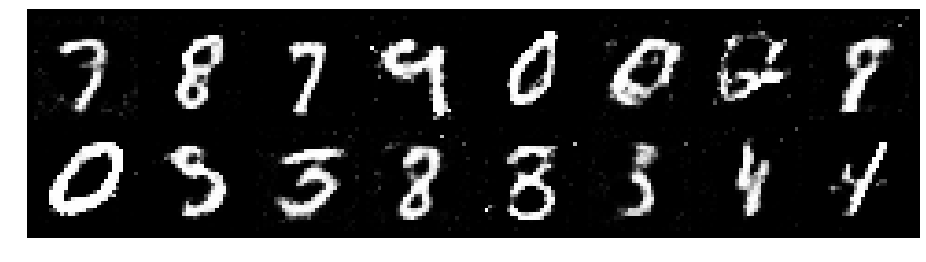

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.1220, Generator Loss: 0.9177
D(x): 0.6124, D(G(z)): 0.4146


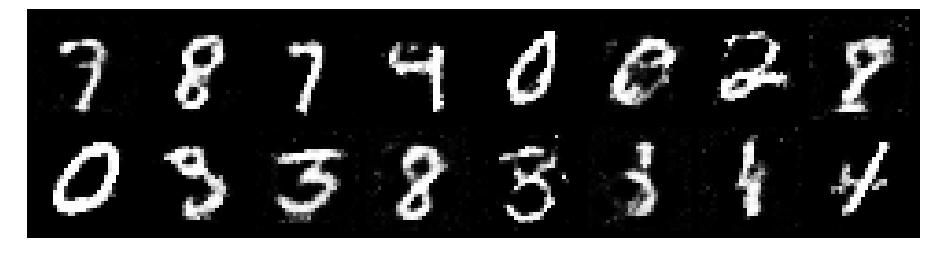

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.3235, Generator Loss: 0.9490
D(x): 0.5664, D(G(z)): 0.4897


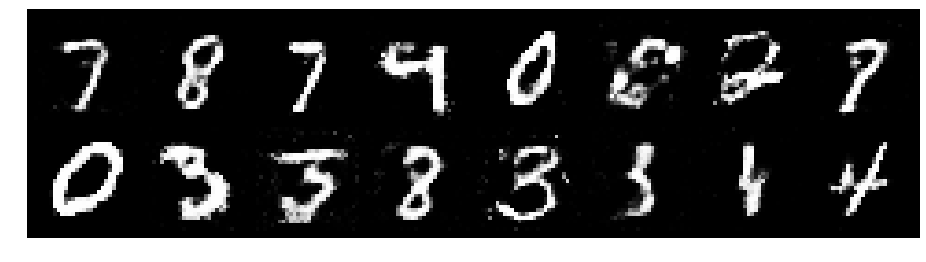

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.2950, Generator Loss: 1.0290
D(x): 0.5786, D(G(z)): 0.4601


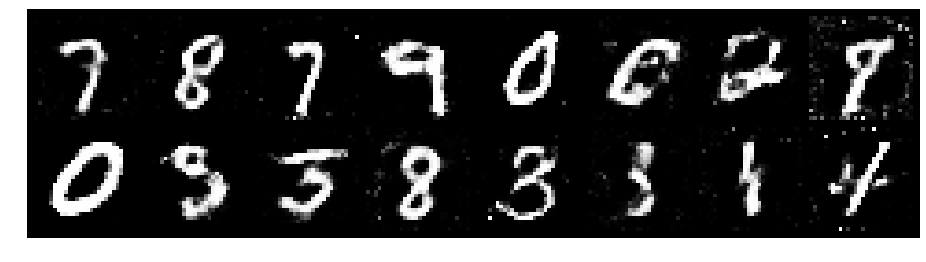

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.2754, Generator Loss: 0.8320
D(x): 0.5396, D(G(z)): 0.4457


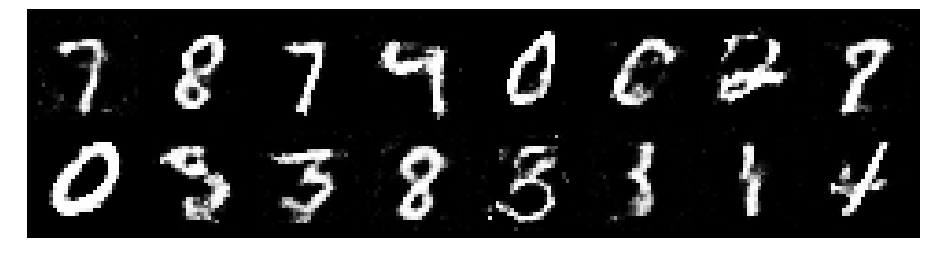

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.2621, Generator Loss: 0.7439
D(x): 0.5641, D(G(z)): 0.4520


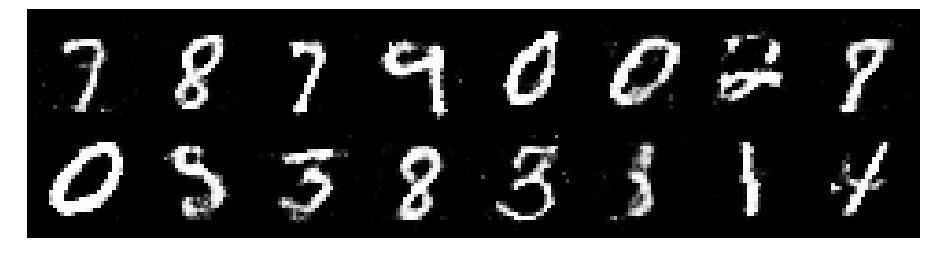

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.4270, Generator Loss: 0.8432
D(x): 0.4869, D(G(z)): 0.4490


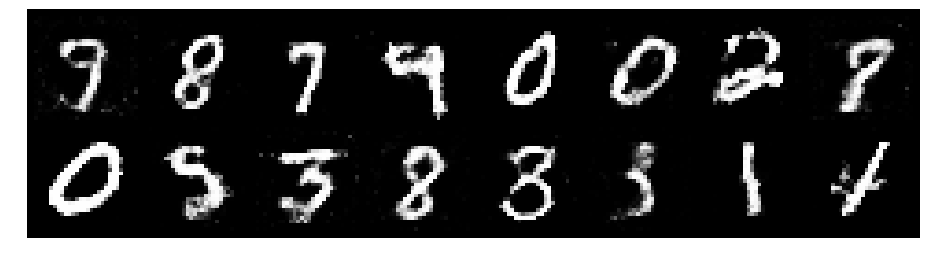

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.3412, Generator Loss: 0.8358
D(x): 0.4941, D(G(z)): 0.4385


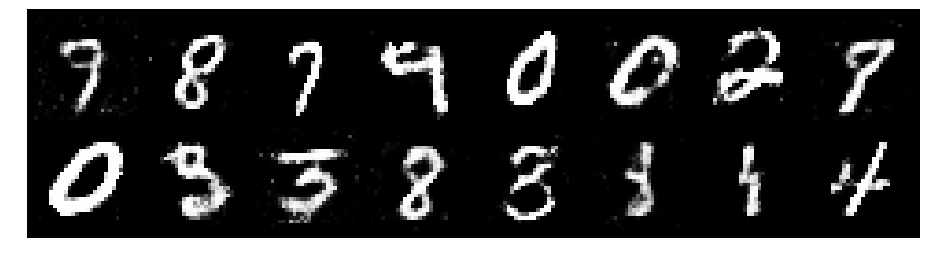

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.3766, Generator Loss: 0.9119
D(x): 0.5303, D(G(z)): 0.4555


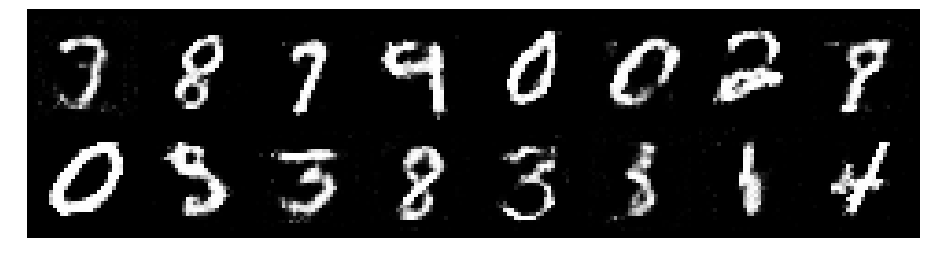

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.3454, Generator Loss: 0.9162
D(x): 0.5175, D(G(z)): 0.4467


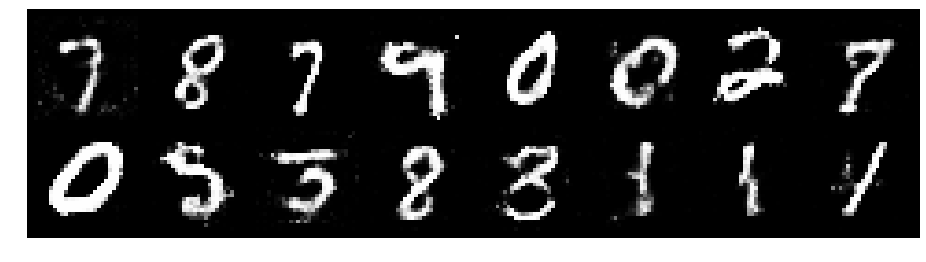

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.3053, Generator Loss: 0.9543
D(x): 0.5213, D(G(z)): 0.4212


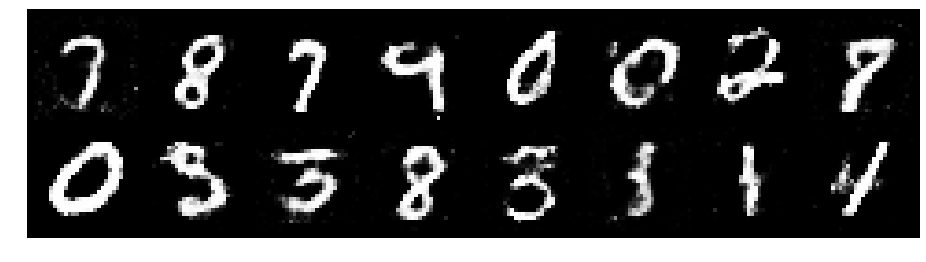

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.2488, Generator Loss: 0.9655
D(x): 0.5636, D(G(z)): 0.4074


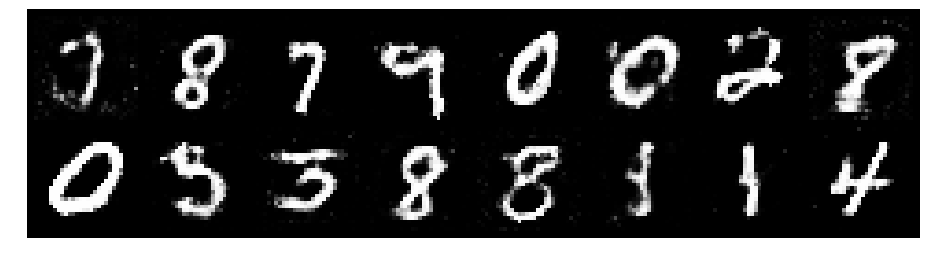

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.3726, Generator Loss: 0.8757
D(x): 0.5455, D(G(z)): 0.4647


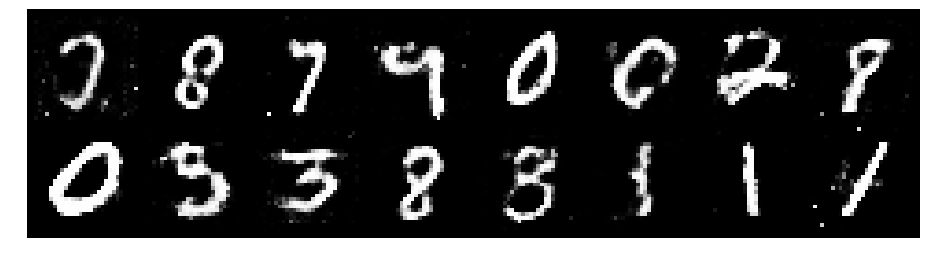

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.2406, Generator Loss: 0.9461
D(x): 0.6043, D(G(z)): 0.4500


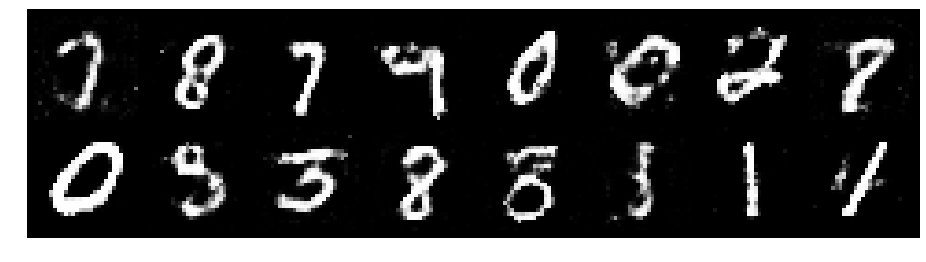

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.2273, Generator Loss: 0.9411
D(x): 0.5703, D(G(z)): 0.4300


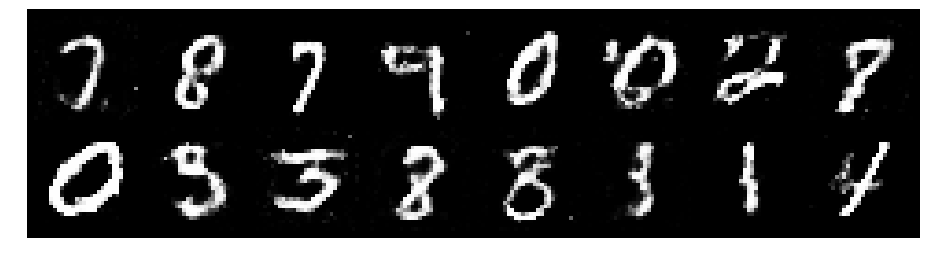

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.2245, Generator Loss: 0.9562
D(x): 0.5671, D(G(z)): 0.4271


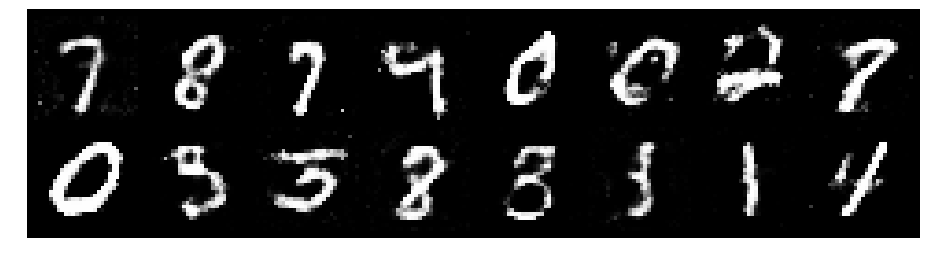

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.2281, Generator Loss: 1.0010
D(x): 0.5495, D(G(z)): 0.3840


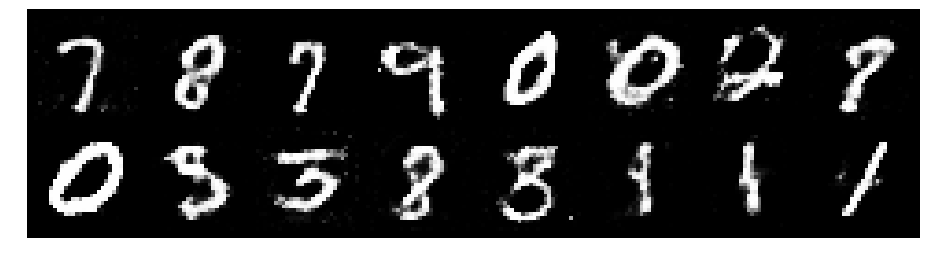

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.1792, Generator Loss: 1.0014
D(x): 0.5595, D(G(z)): 0.3964


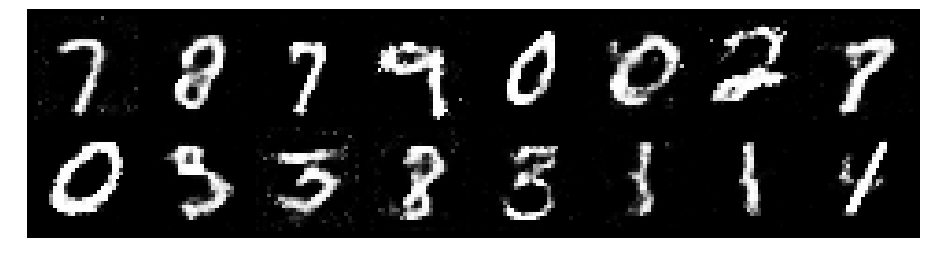

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.2769, Generator Loss: 0.9238
D(x): 0.5610, D(G(z)): 0.4556


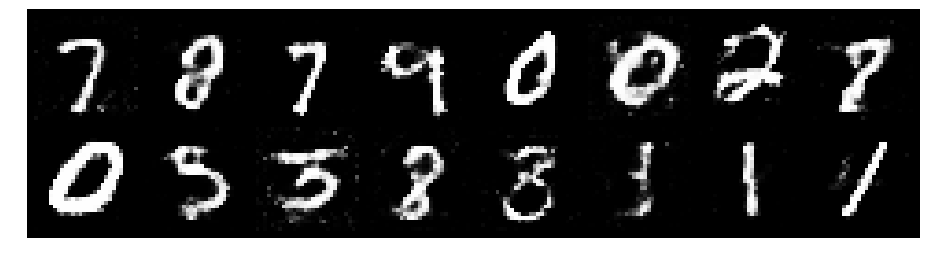

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.2195, Generator Loss: 1.0281
D(x): 0.5428, D(G(z)): 0.4113


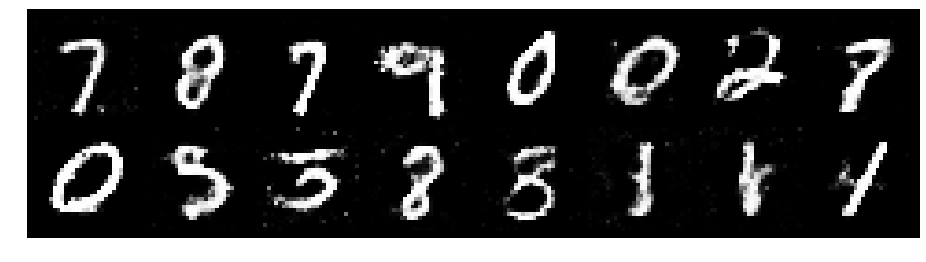

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.1859, Generator Loss: 1.0789
D(x): 0.5534, D(G(z)): 0.3861


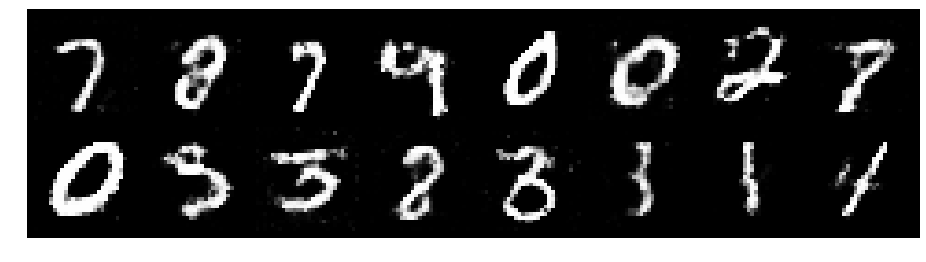

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.2623, Generator Loss: 0.8573
D(x): 0.5399, D(G(z)): 0.4222


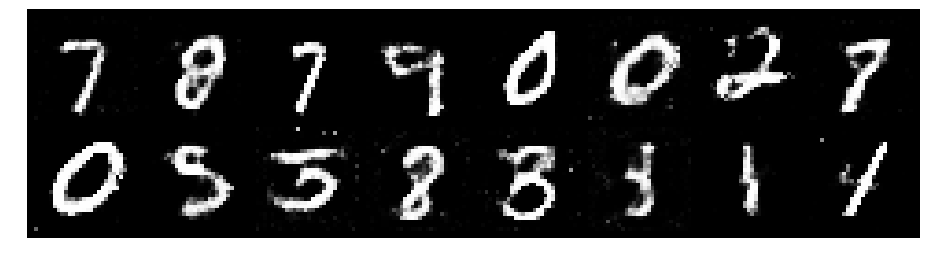

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.2839, Generator Loss: 0.8495
D(x): 0.5440, D(G(z)): 0.4632


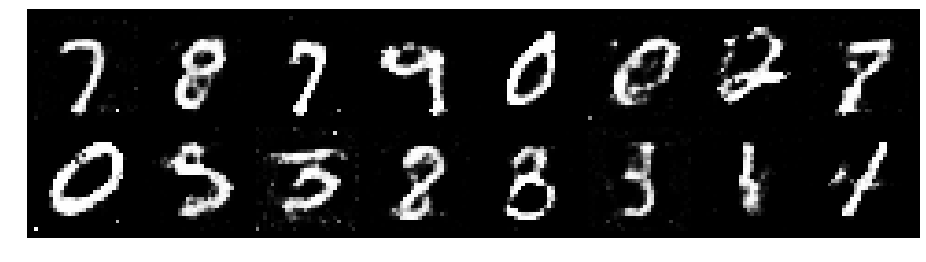

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.2199, Generator Loss: 0.7809
D(x): 0.5685, D(G(z)): 0.4523


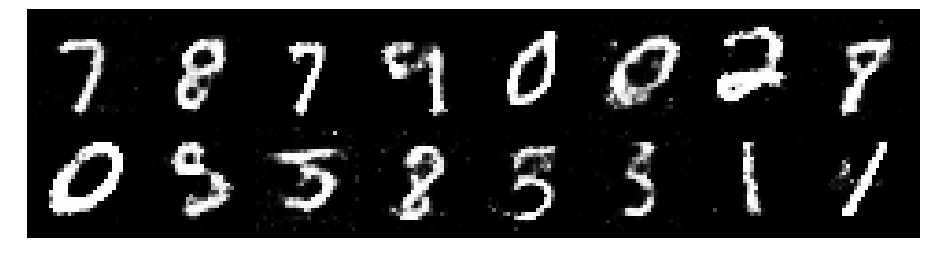

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.2494, Generator Loss: 0.8724
D(x): 0.5507, D(G(z)): 0.4338


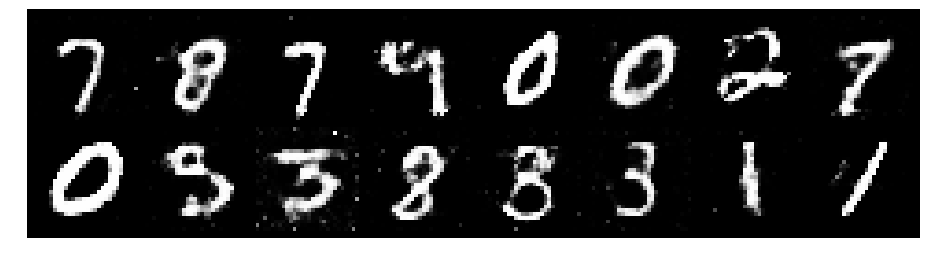

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.2578, Generator Loss: 0.7126
D(x): 0.5693, D(G(z)): 0.4696


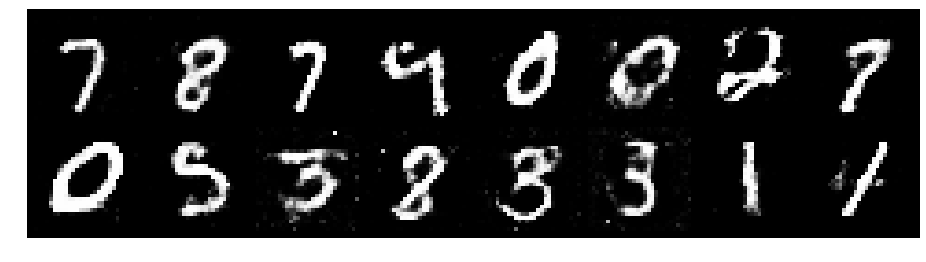

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.2393, Generator Loss: 0.9300
D(x): 0.5657, D(G(z)): 0.4396


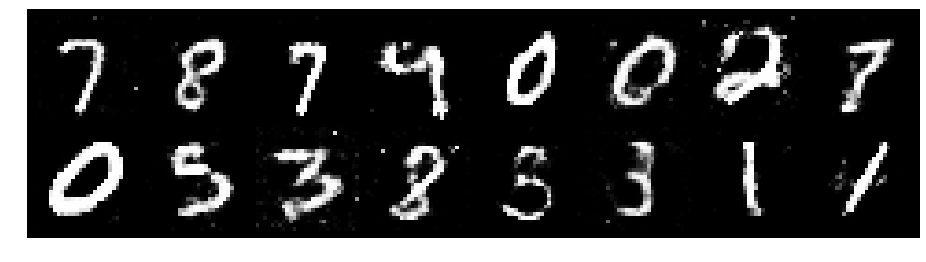

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.2439, Generator Loss: 0.9272
D(x): 0.5284, D(G(z)): 0.4194


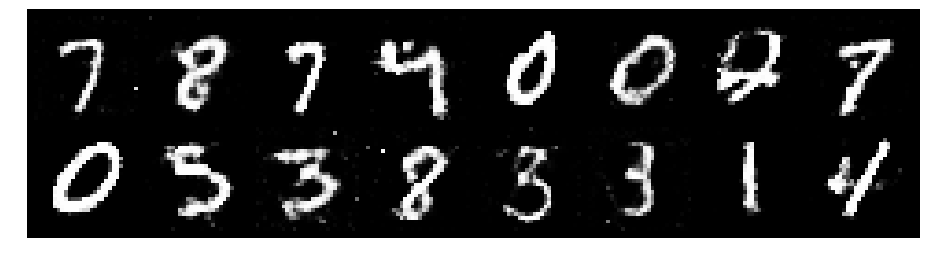

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.2158, Generator Loss: 0.9459
D(x): 0.5822, D(G(z)): 0.4461


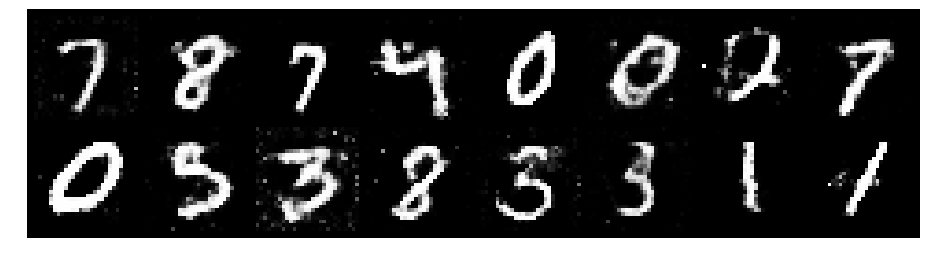

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.2400, Generator Loss: 0.8350
D(x): 0.5814, D(G(z)): 0.4644


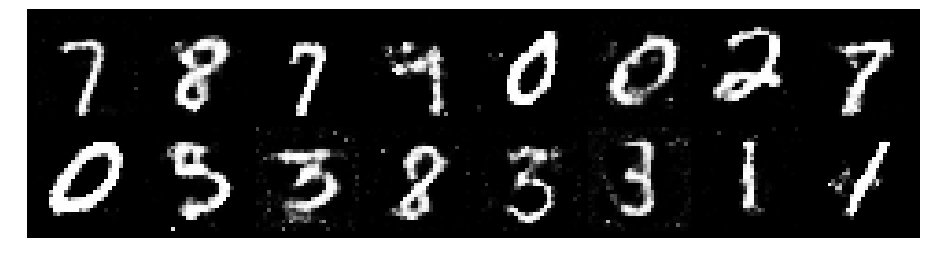

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.2996, Generator Loss: 0.8829
D(x): 0.5559, D(G(z)): 0.4597


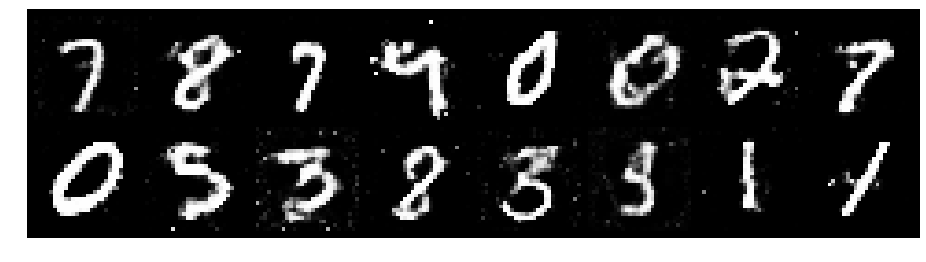

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.3223, Generator Loss: 0.8902
D(x): 0.5963, D(G(z)): 0.4776


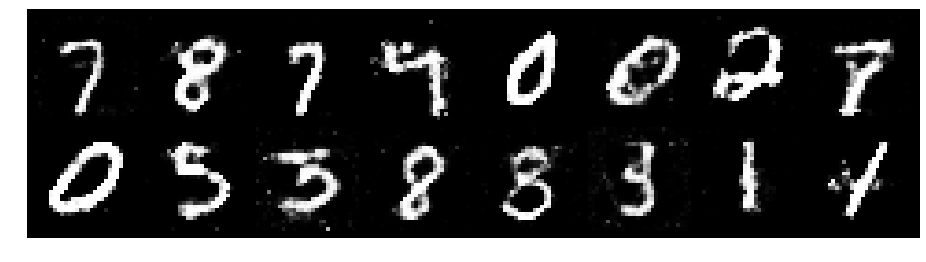

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.1110, Generator Loss: 0.9972
D(x): 0.5632, D(G(z)): 0.3640


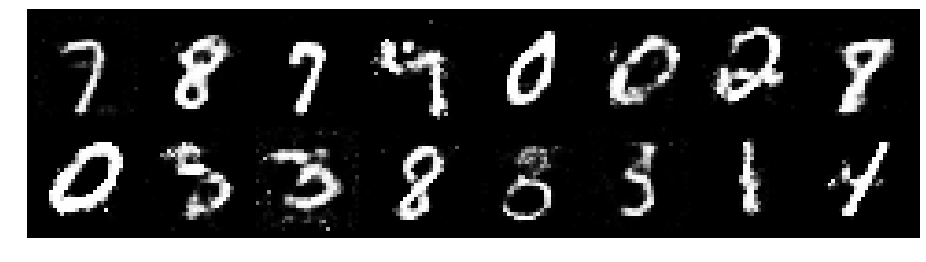

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.2818, Generator Loss: 0.9212
D(x): 0.5477, D(G(z)): 0.4486


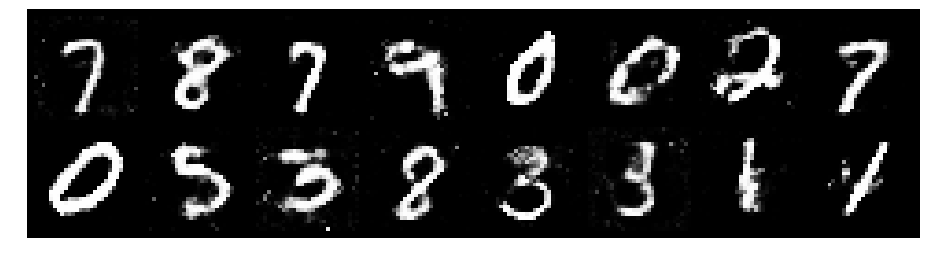

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.2648, Generator Loss: 0.8638
D(x): 0.5475, D(G(z)): 0.4342


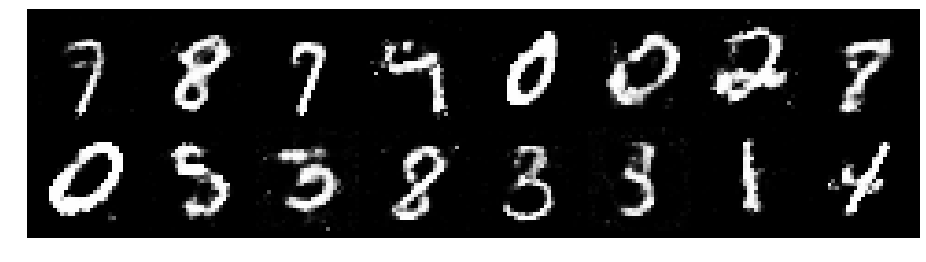

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.3539, Generator Loss: 0.7941
D(x): 0.5277, D(G(z)): 0.4640


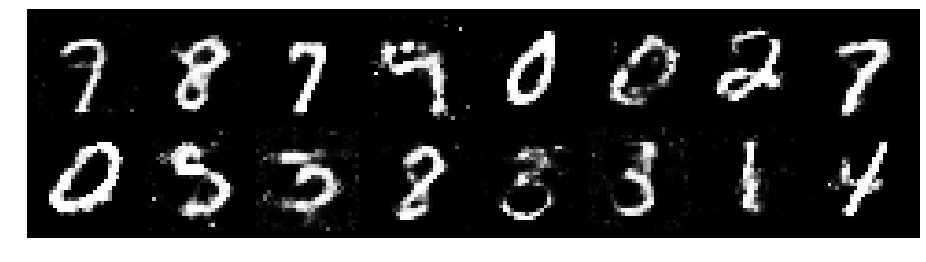

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.2902, Generator Loss: 0.8065
D(x): 0.5415, D(G(z)): 0.4666


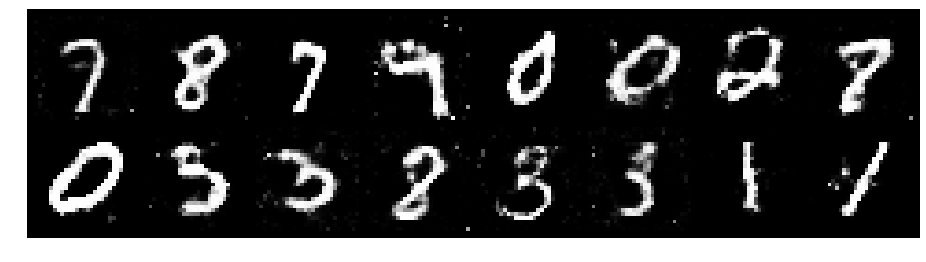

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.3328, Generator Loss: 0.9134
D(x): 0.5502, D(G(z)): 0.4651


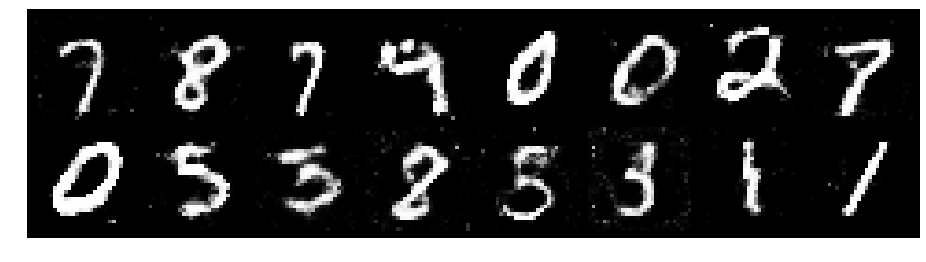

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.2607, Generator Loss: 1.0575
D(x): 0.5318, D(G(z)): 0.4130


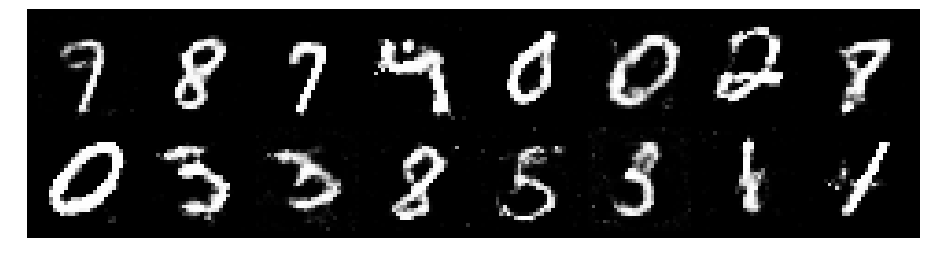

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.2157, Generator Loss: 0.8802
D(x): 0.6171, D(G(z)): 0.4688


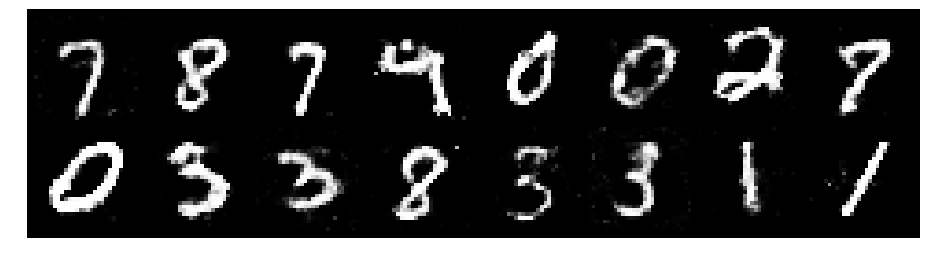

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.3361, Generator Loss: 0.8664
D(x): 0.5342, D(G(z)): 0.4678


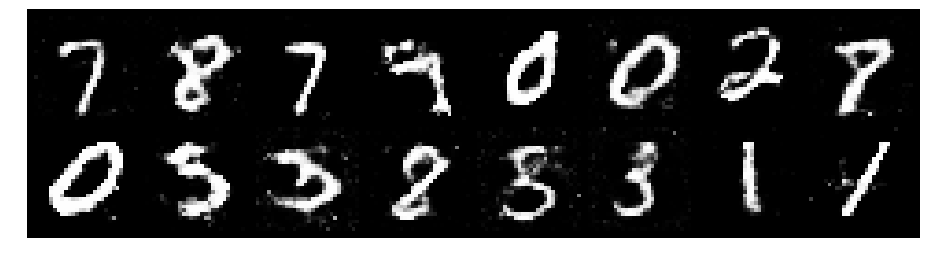

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.4064, Generator Loss: 0.7966
D(x): 0.5005, D(G(z)): 0.4746


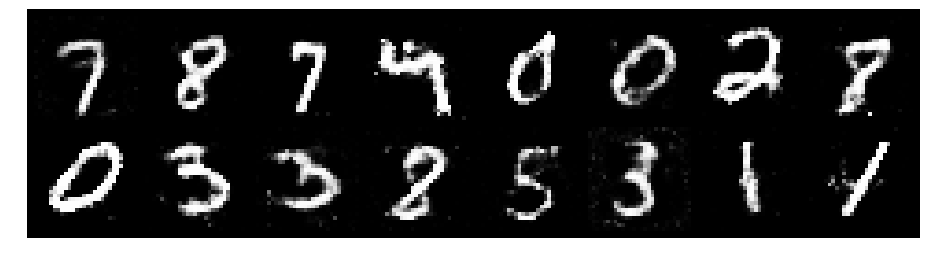

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.3559, Generator Loss: 0.9439
D(x): 0.4753, D(G(z)): 0.4214


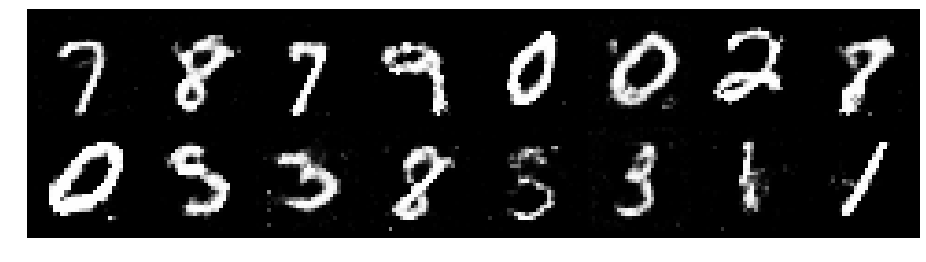

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.2743, Generator Loss: 0.8976
D(x): 0.5802, D(G(z)): 0.4669


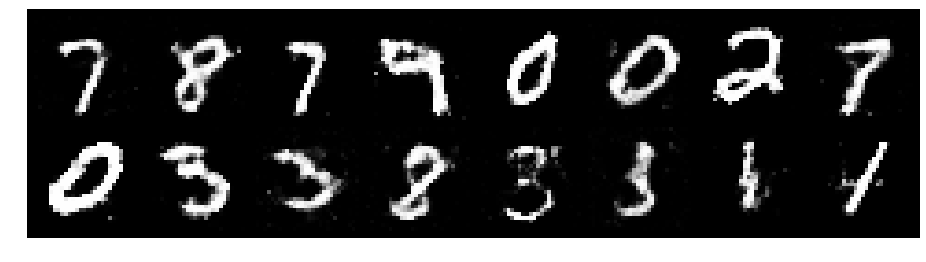

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.2423, Generator Loss: 0.9492
D(x): 0.5637, D(G(z)): 0.4516


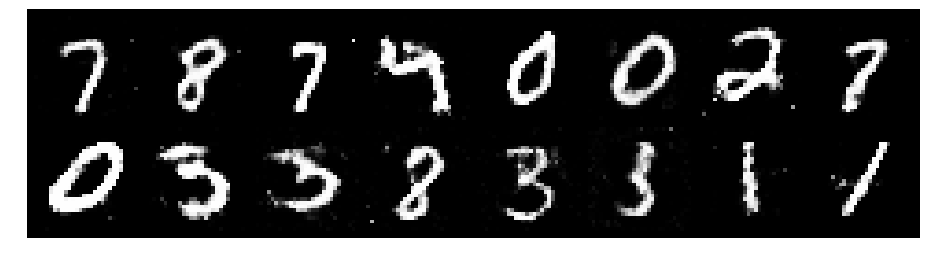

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.3058, Generator Loss: 0.8627
D(x): 0.5451, D(G(z)): 0.4563


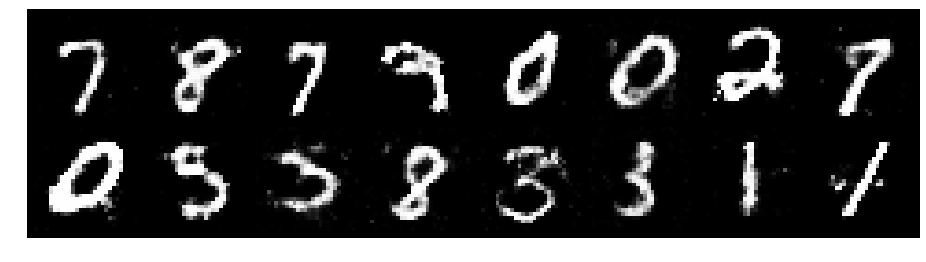

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.3136, Generator Loss: 0.9092
D(x): 0.5681, D(G(z)): 0.4669


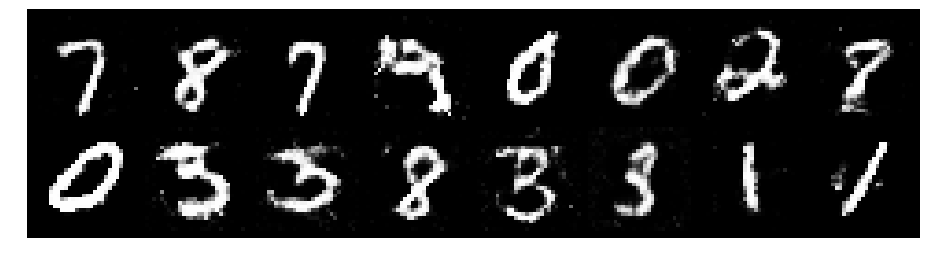

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.2532, Generator Loss: 0.9345
D(x): 0.5378, D(G(z)): 0.4292


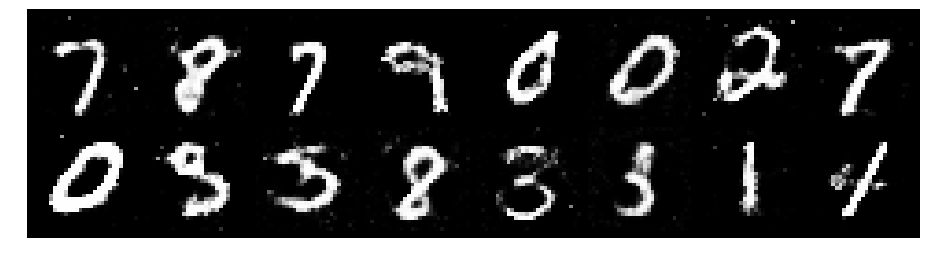

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.2875, Generator Loss: 0.7709
D(x): 0.5648, D(G(z)): 0.4610


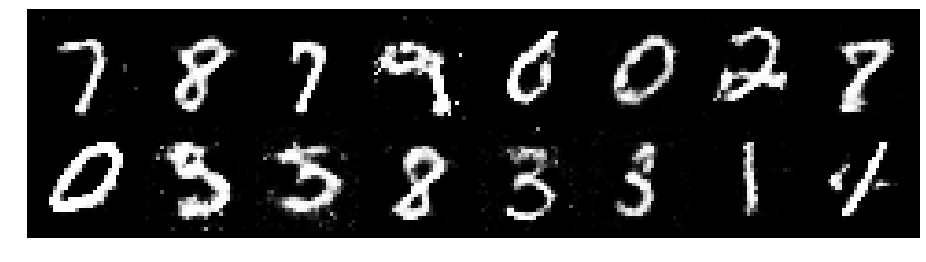

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.1849, Generator Loss: 0.9309
D(x): 0.5739, D(G(z)): 0.4344


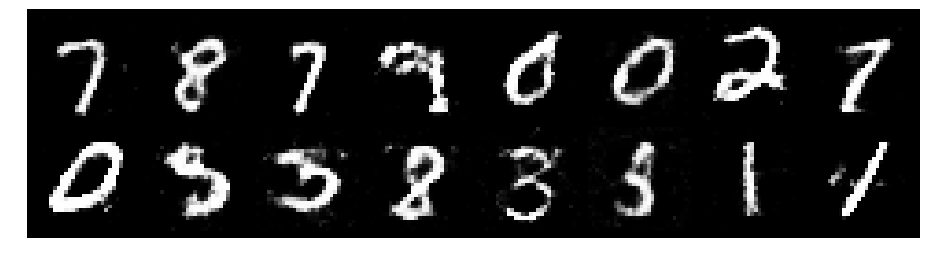

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.2940, Generator Loss: 0.8545
D(x): 0.5914, D(G(z)): 0.4932


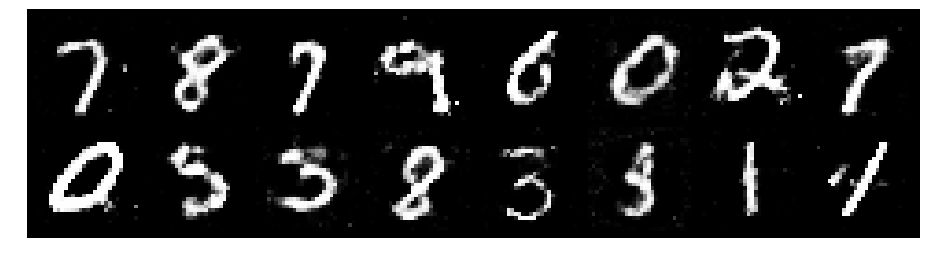

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.2540, Generator Loss: 0.8545
D(x): 0.5890, D(G(z)): 0.4665


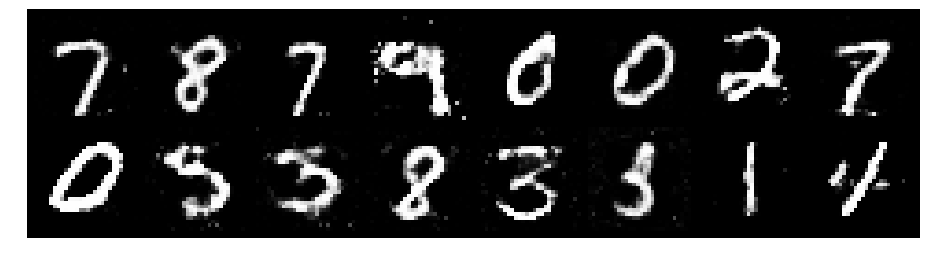

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.2581, Generator Loss: 0.8553
D(x): 0.5353, D(G(z)): 0.4259


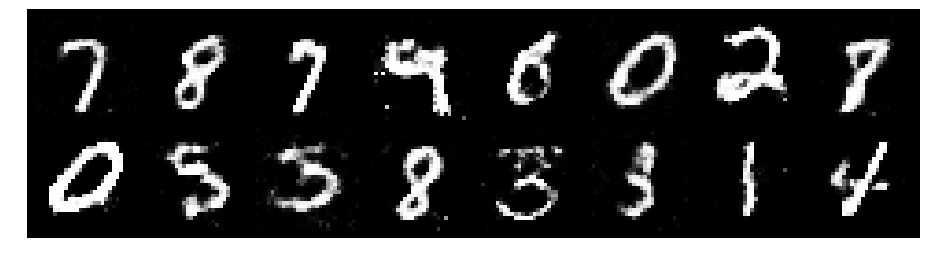

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.2462, Generator Loss: 0.8374
D(x): 0.5393, D(G(z)): 0.4261


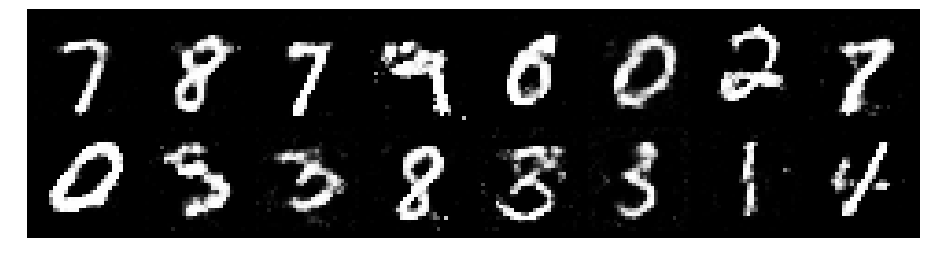

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.3416, Generator Loss: 0.8052
D(x): 0.5404, D(G(z)): 0.4738


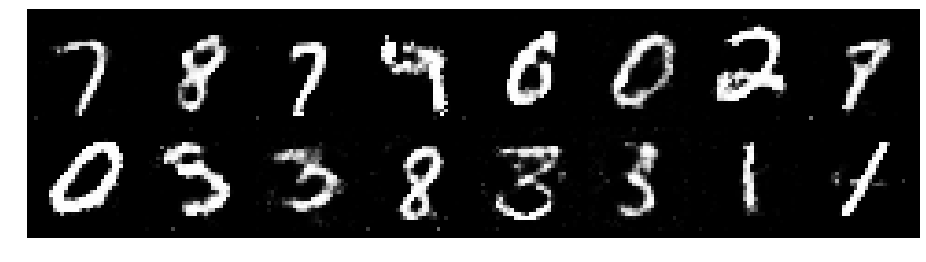

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.3463, Generator Loss: 0.8869
D(x): 0.4858, D(G(z)): 0.4096


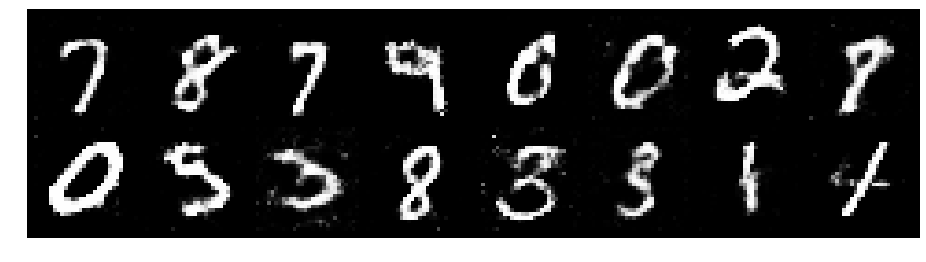

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.2706, Generator Loss: 0.9549
D(x): 0.5274, D(G(z)): 0.4323


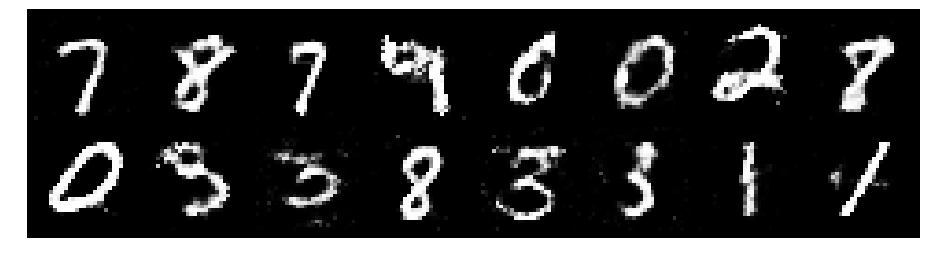

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.2980, Generator Loss: 0.7985
D(x): 0.5386, D(G(z)): 0.4629


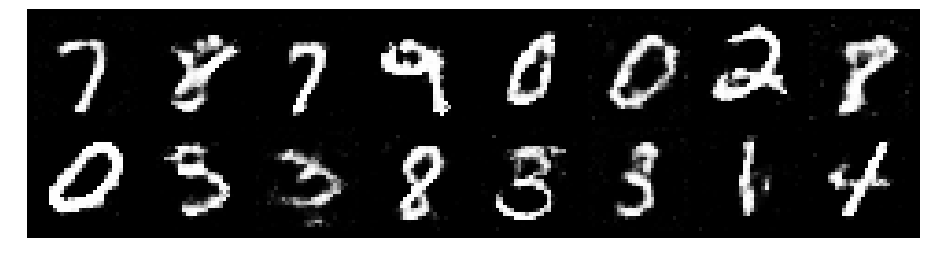

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.2095, Generator Loss: 0.8479
D(x): 0.5840, D(G(z)): 0.4472


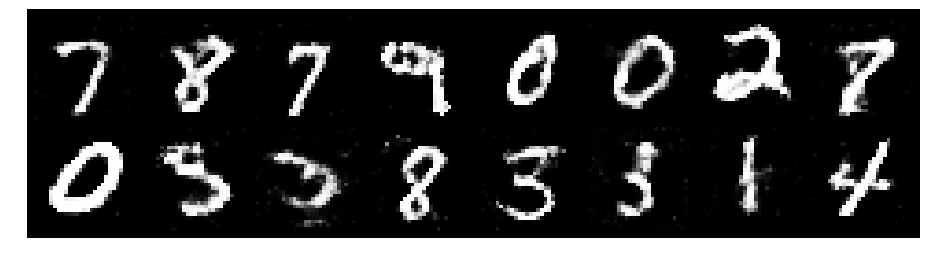

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.2739, Generator Loss: 0.9013
D(x): 0.5268, D(G(z)): 0.4265


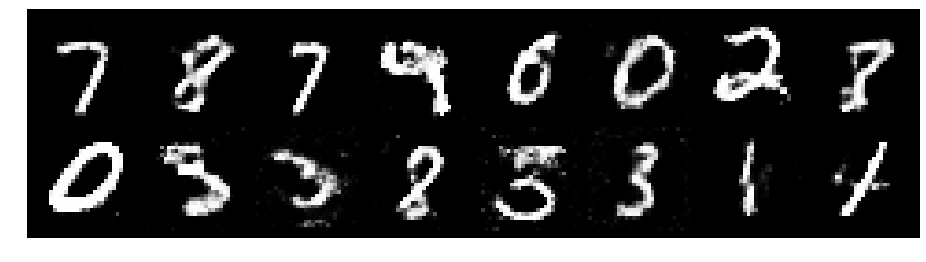

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.2206, Generator Loss: 0.8991
D(x): 0.5561, D(G(z)): 0.4317


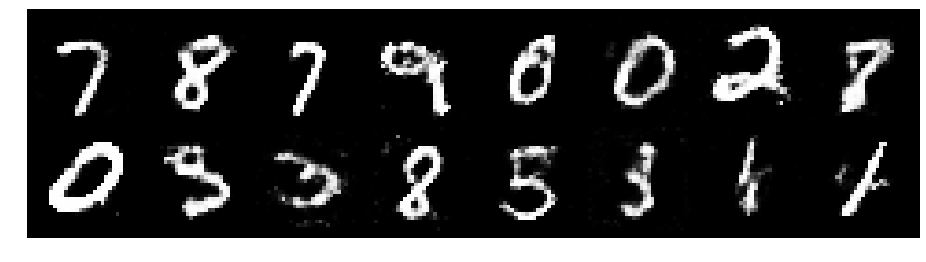

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.2564, Generator Loss: 0.8283
D(x): 0.5377, D(G(z)): 0.4330


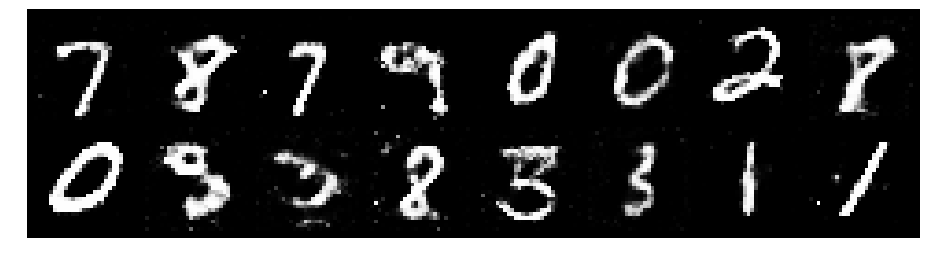

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.3198, Generator Loss: 0.9968
D(x): 0.5365, D(G(z)): 0.4331


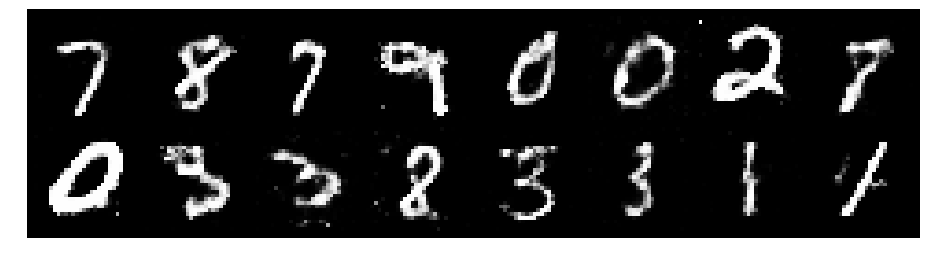

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.2609, Generator Loss: 0.9013
D(x): 0.5583, D(G(z)): 0.4484


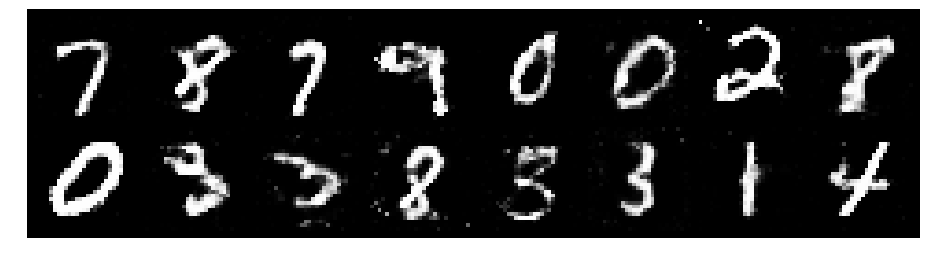

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.2998, Generator Loss: 0.8062
D(x): 0.5530, D(G(z)): 0.4423


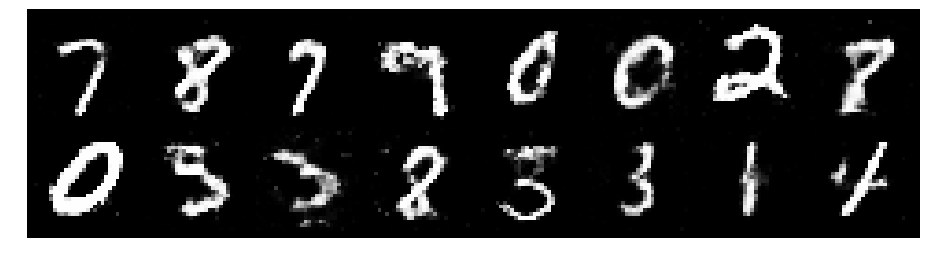

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.3840, Generator Loss: 0.7846
D(x): 0.5380, D(G(z)): 0.4884


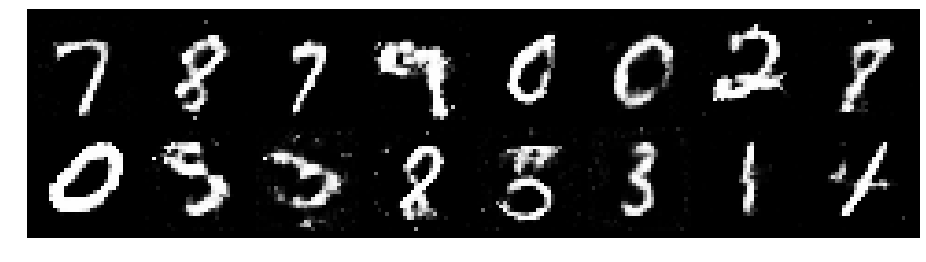

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.2893, Generator Loss: 0.7964
D(x): 0.6047, D(G(z)): 0.5058


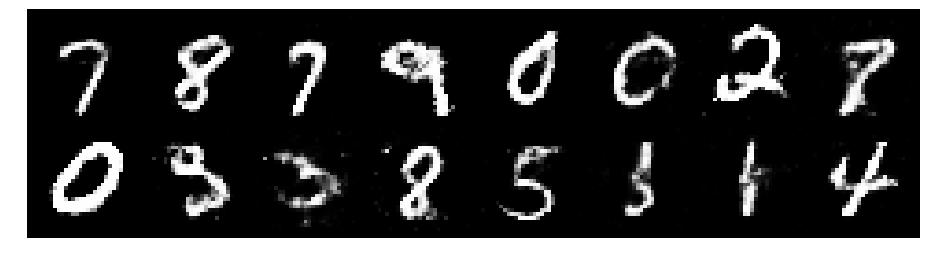

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.2972, Generator Loss: 0.8411
D(x): 0.5379, D(G(z)): 0.4456


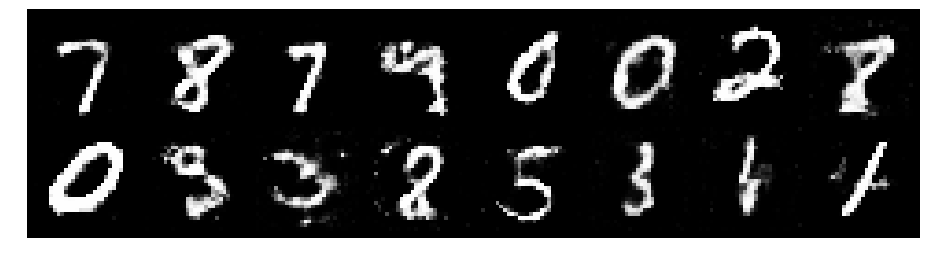

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.3862, Generator Loss: 0.8449
D(x): 0.5466, D(G(z)): 0.4959


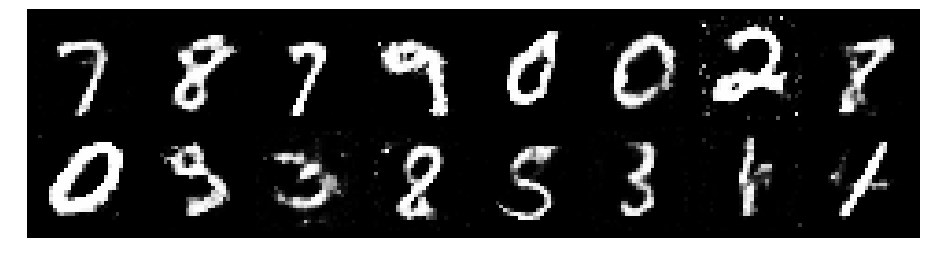

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.2587, Generator Loss: 0.9532
D(x): 0.5896, D(G(z)): 0.4682


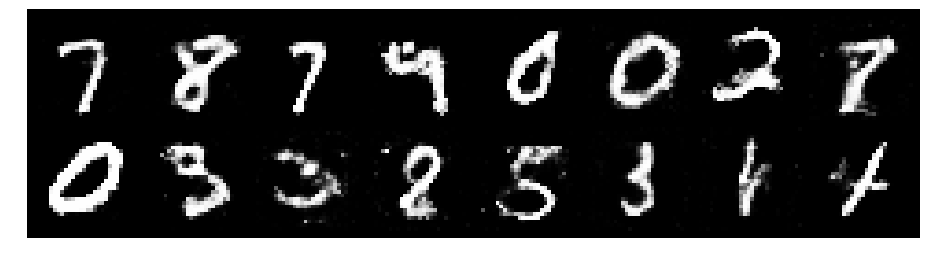

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.3451, Generator Loss: 0.8018
D(x): 0.5241, D(G(z)): 0.4681


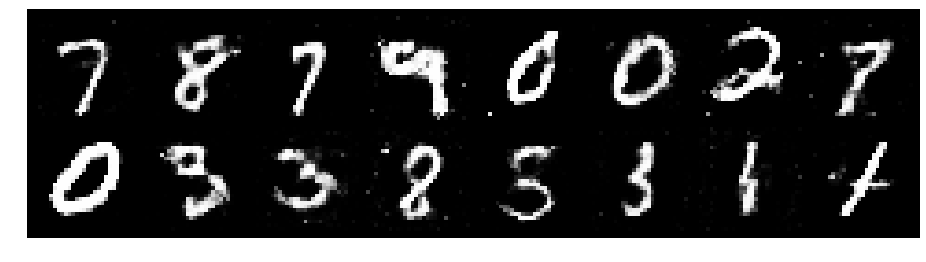

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.2649, Generator Loss: 0.8420
D(x): 0.5620, D(G(z)): 0.4647


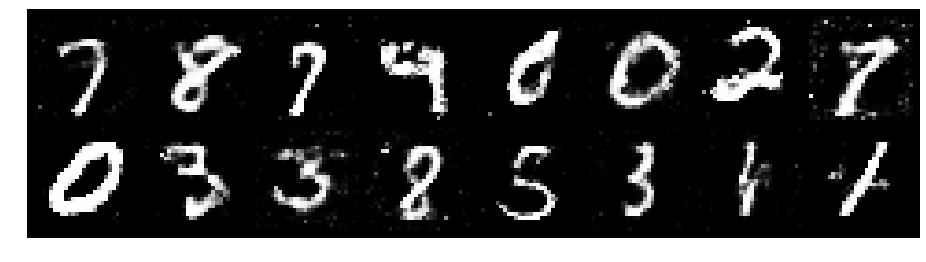

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.2402, Generator Loss: 0.9107
D(x): 0.5757, D(G(z)): 0.4571


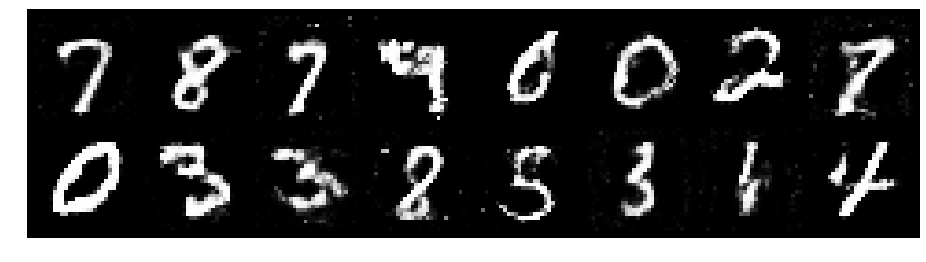

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.2611, Generator Loss: 0.9500
D(x): 0.5287, D(G(z)): 0.4328


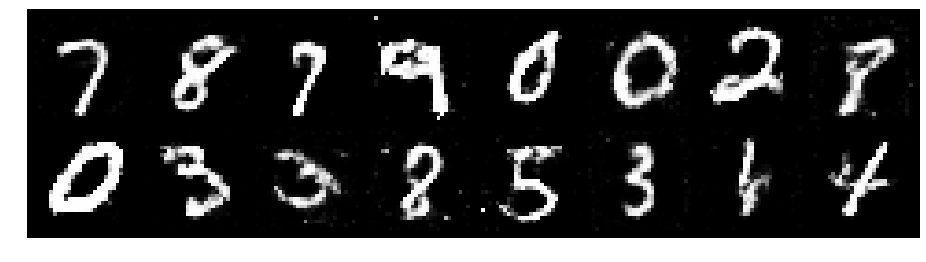

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.2258, Generator Loss: 0.8550
D(x): 0.5818, D(G(z)): 0.4478


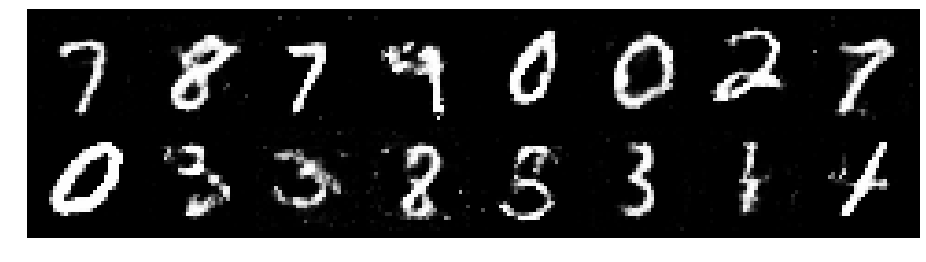

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.2934, Generator Loss: 0.8502
D(x): 0.5369, D(G(z)): 0.4551


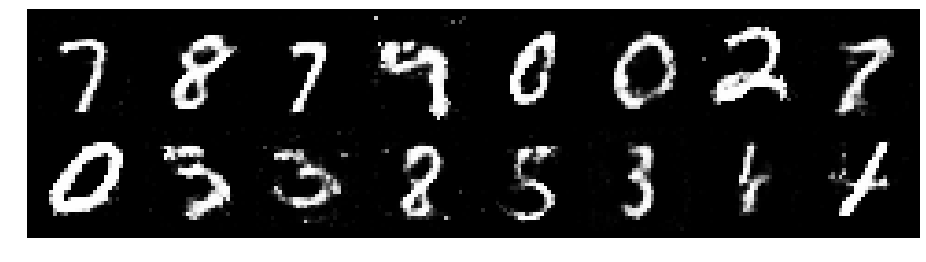

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.2264, Generator Loss: 0.9043
D(x): 0.5579, D(G(z)): 0.4161


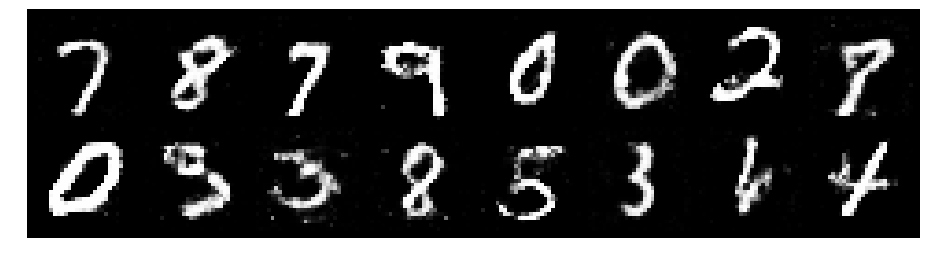

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.2938, Generator Loss: 0.8495
D(x): 0.5770, D(G(z)): 0.4780


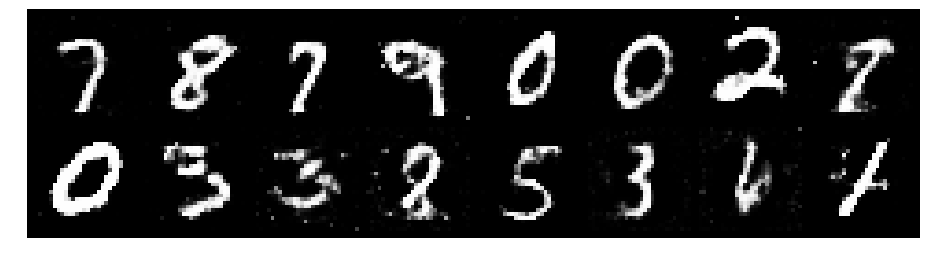

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.2302, Generator Loss: 0.9736
D(x): 0.5806, D(G(z)): 0.4473


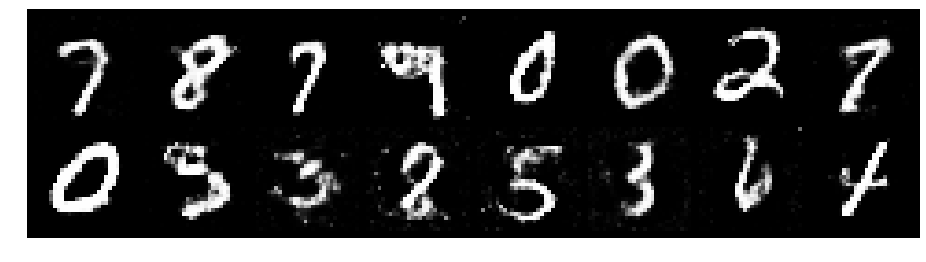

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.1383, Generator Loss: 1.0186
D(x): 0.6015, D(G(z)): 0.4076


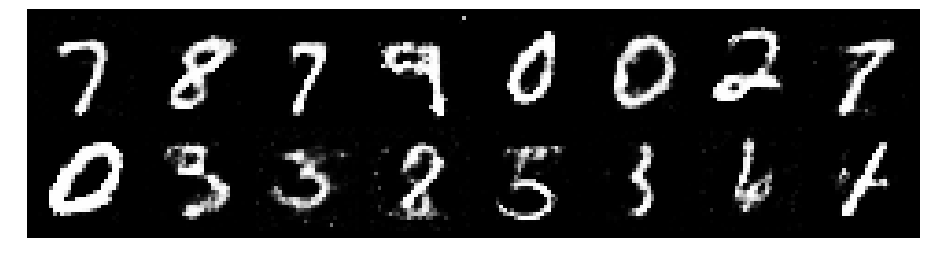

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.2389, Generator Loss: 0.8320
D(x): 0.5484, D(G(z)): 0.4414


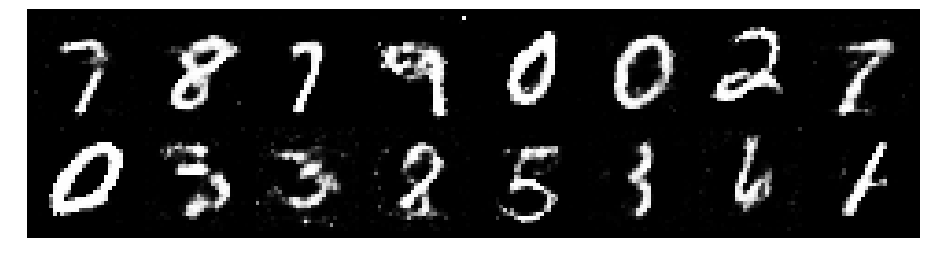

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.3835, Generator Loss: 0.7702
D(x): 0.5377, D(G(z)): 0.4749


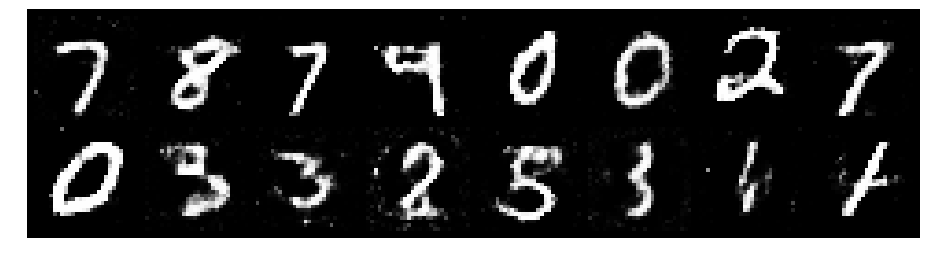

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.3371, Generator Loss: 0.8956
D(x): 0.5200, D(G(z)): 0.4334


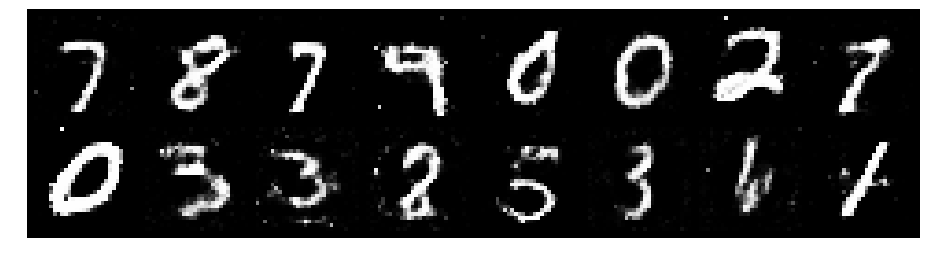

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.1641, Generator Loss: 0.9656
D(x): 0.5749, D(G(z)): 0.4025


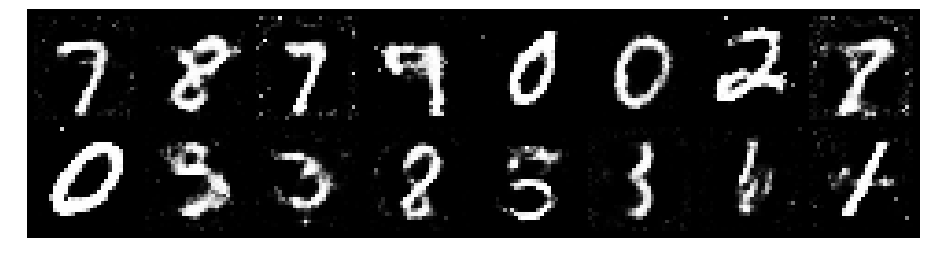

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.3405, Generator Loss: 0.9367
D(x): 0.5560, D(G(z)): 0.4630


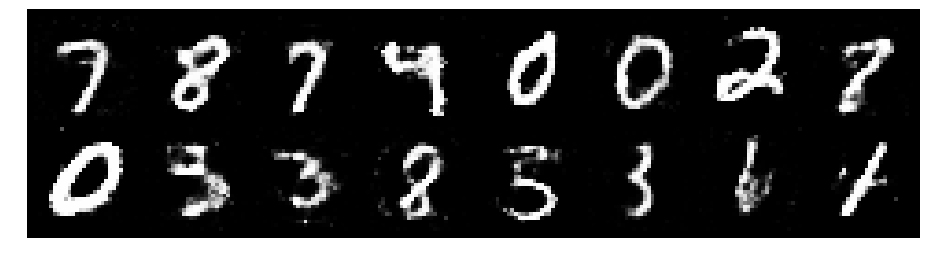

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.2505, Generator Loss: 0.8255
D(x): 0.5411, D(G(z)): 0.4343


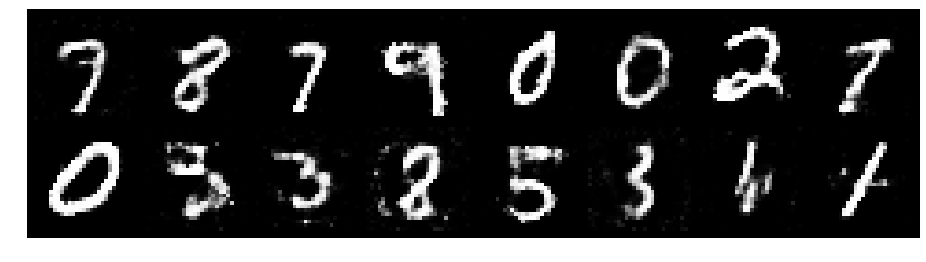

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.2212, Generator Loss: 0.9245
D(x): 0.5500, D(G(z)): 0.4221


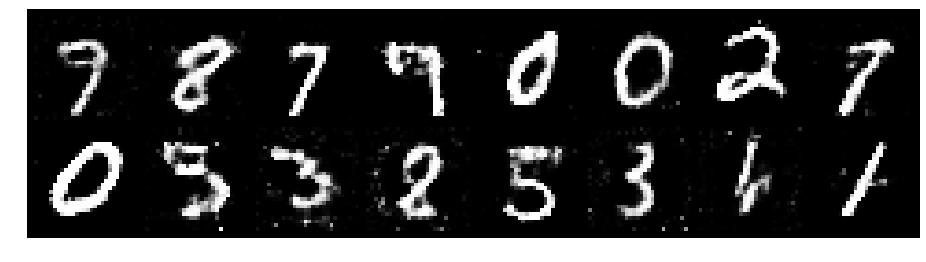

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.3970, Generator Loss: 0.8499
D(x): 0.5057, D(G(z)): 0.4673


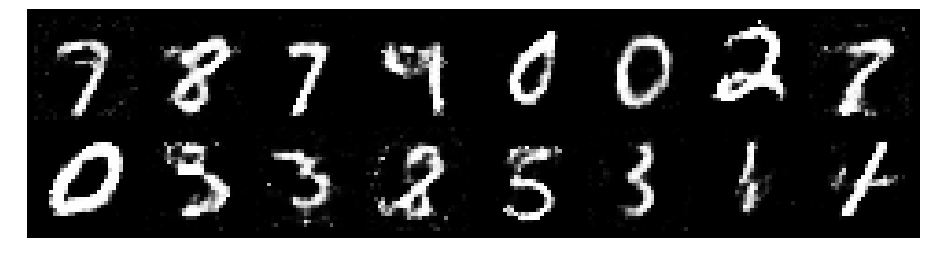

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.3221, Generator Loss: 0.8964
D(x): 0.5297, D(G(z)): 0.4534


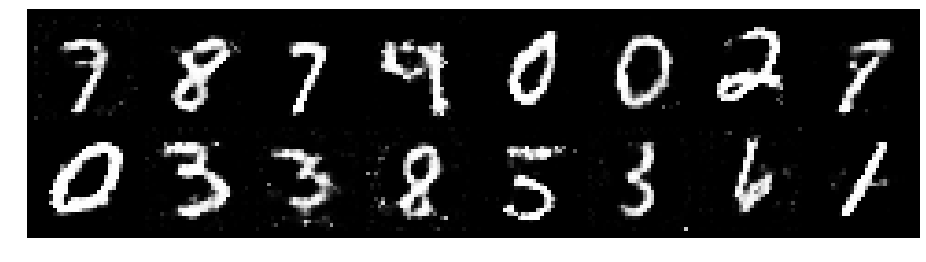

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.2177, Generator Loss: 0.8733
D(x): 0.5493, D(G(z)): 0.4227


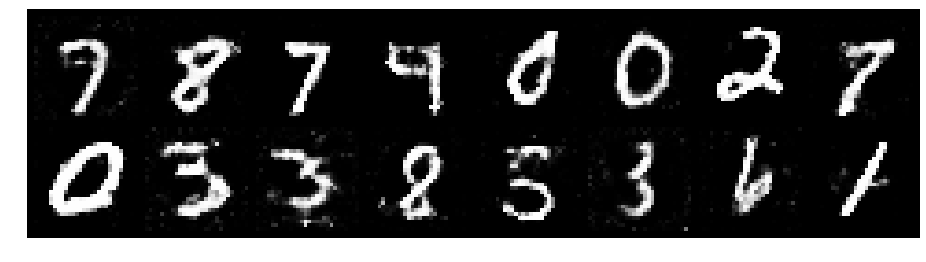

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.3683, Generator Loss: 0.8593
D(x): 0.5196, D(G(z)): 0.4554


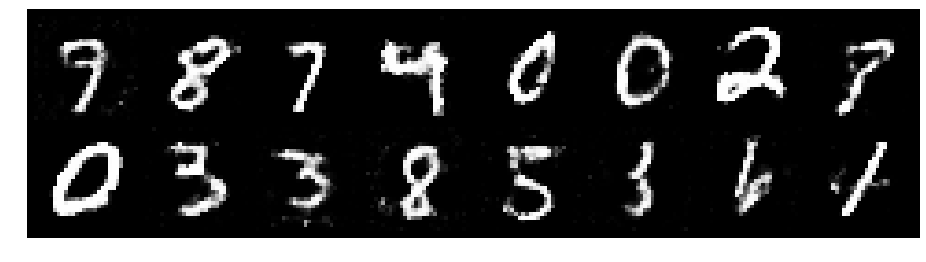

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.2664, Generator Loss: 0.8150
D(x): 0.5657, D(G(z)): 0.4601


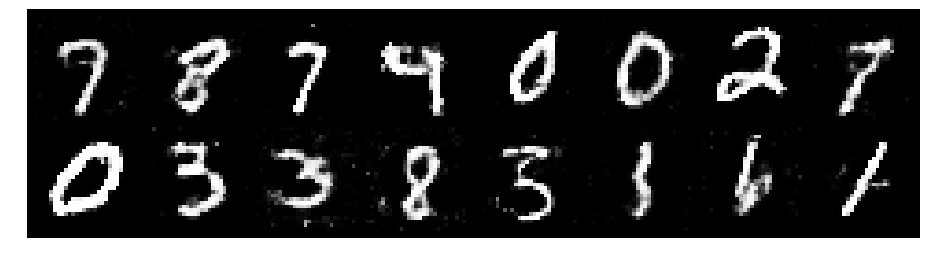

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.3368, Generator Loss: 0.8569
D(x): 0.5014, D(G(z)): 0.4363


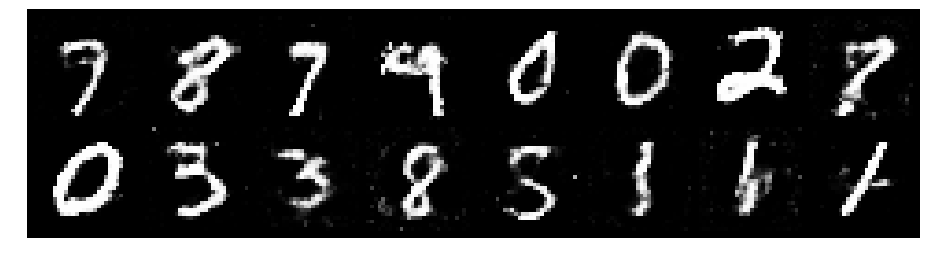

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.2208, Generator Loss: 0.8700
D(x): 0.5616, D(G(z)): 0.4412


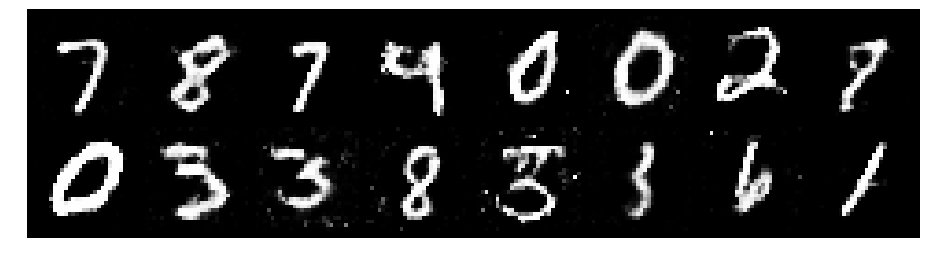

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.2640, Generator Loss: 0.8662
D(x): 0.5649, D(G(z)): 0.4429


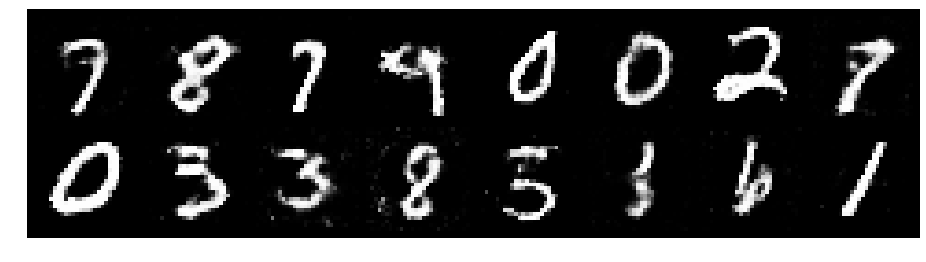

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.3435, Generator Loss: 0.9175
D(x): 0.5277, D(G(z)): 0.4640


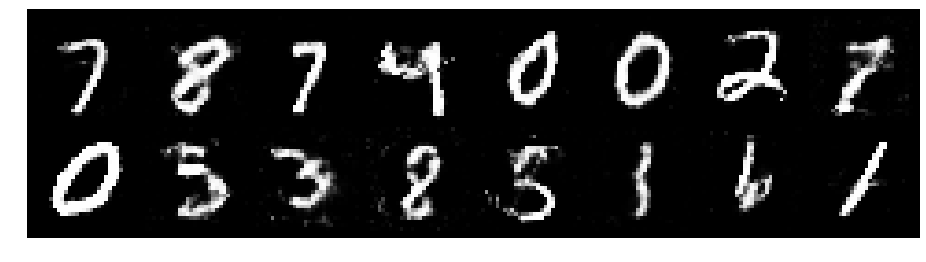

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.2140, Generator Loss: 0.8801
D(x): 0.5384, D(G(z)): 0.4066


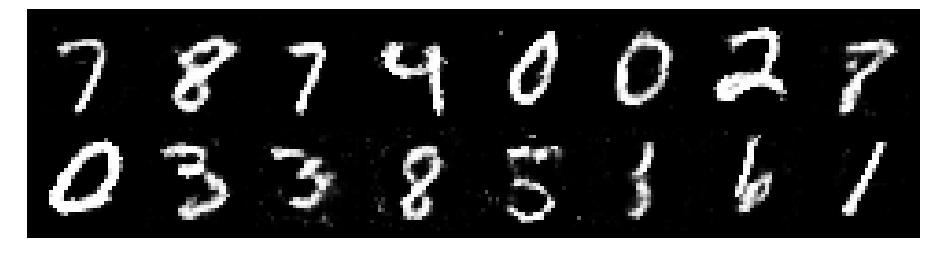

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.3205, Generator Loss: 0.8393
D(x): 0.5570, D(G(z)): 0.4646


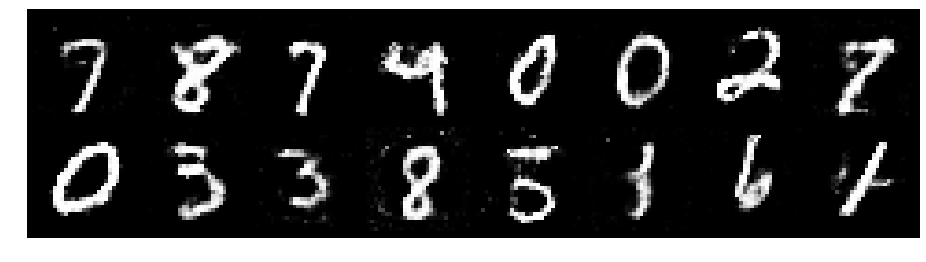

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.3028, Generator Loss: 0.7665
D(x): 0.5627, D(G(z)): 0.4785


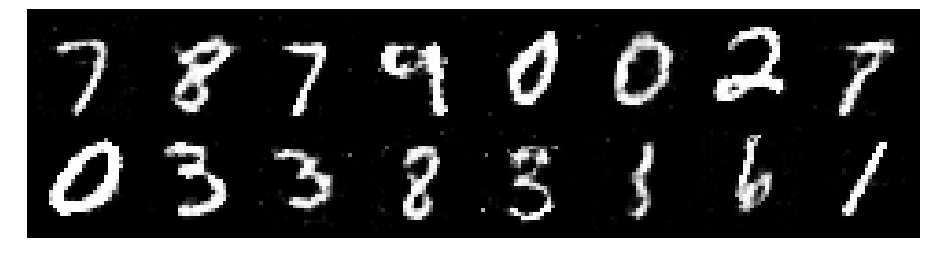

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.1891, Generator Loss: 0.9438
D(x): 0.5578, D(G(z)): 0.4211


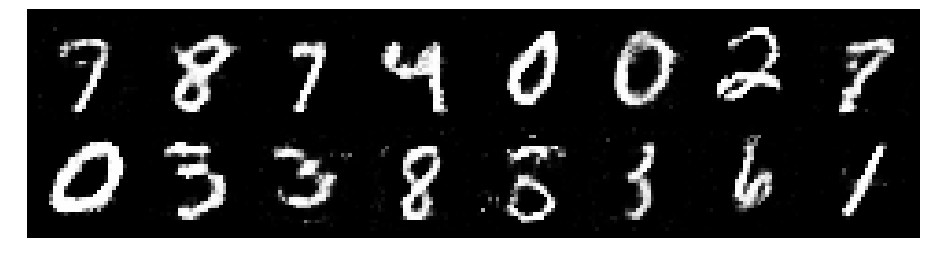

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.2496, Generator Loss: 0.9505
D(x): 0.5310, D(G(z)): 0.4304


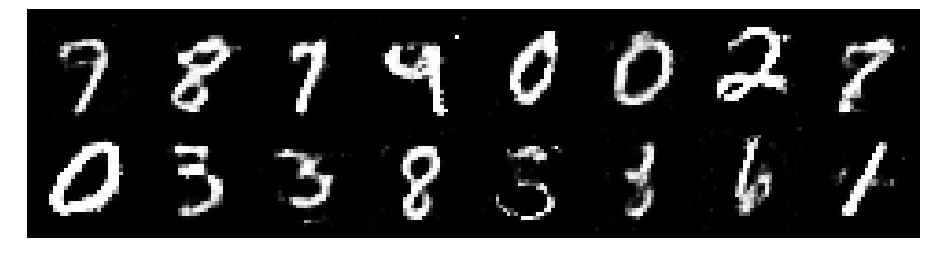

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.2385, Generator Loss: 0.8586
D(x): 0.5411, D(G(z)): 0.4319


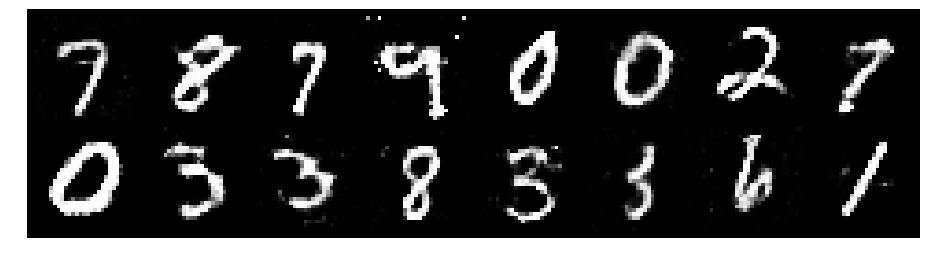

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.2746, Generator Loss: 0.8187
D(x): 0.5605, D(G(z)): 0.4524


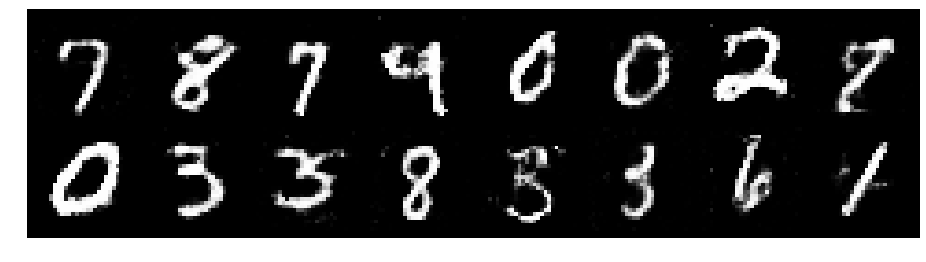

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.4264, Generator Loss: 0.8422
D(x): 0.5425, D(G(z)): 0.4964


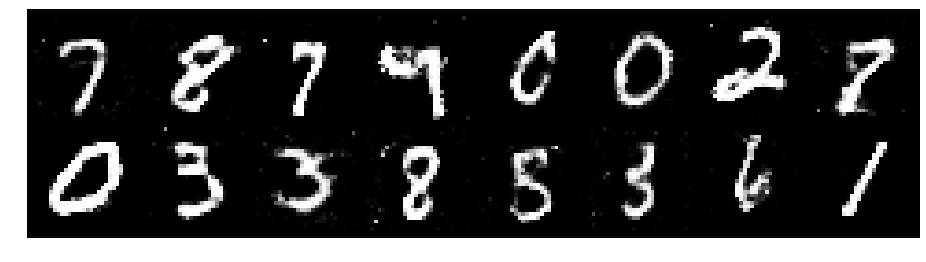

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.2800, Generator Loss: 0.8143
D(x): 0.5441, D(G(z)): 0.4459


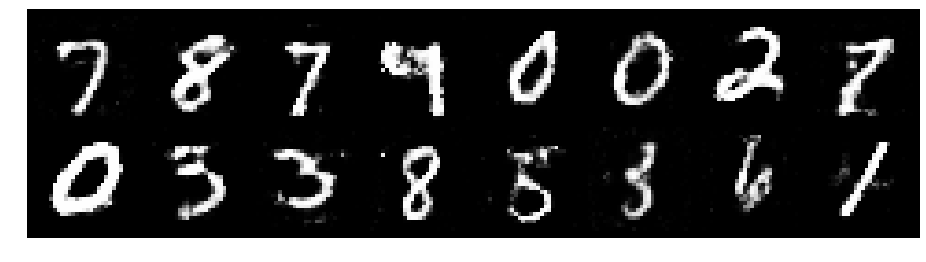

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.3002, Generator Loss: 0.8558
D(x): 0.5495, D(G(z)): 0.4578


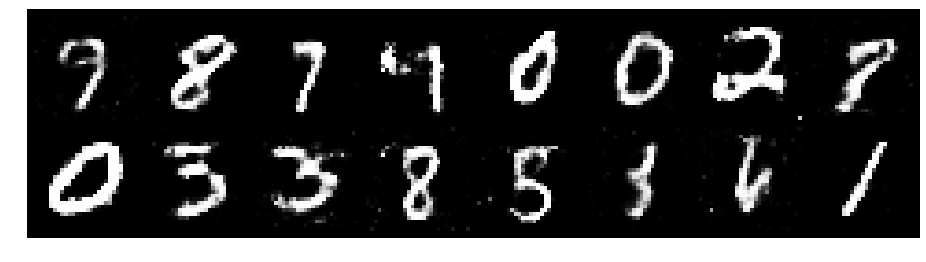

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.2240, Generator Loss: 0.8430
D(x): 0.5449, D(G(z)): 0.4130


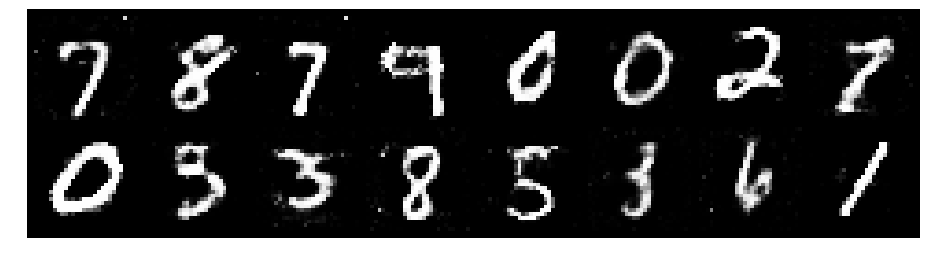

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.2609, Generator Loss: 0.8360
D(x): 0.5527, D(G(z)): 0.4265


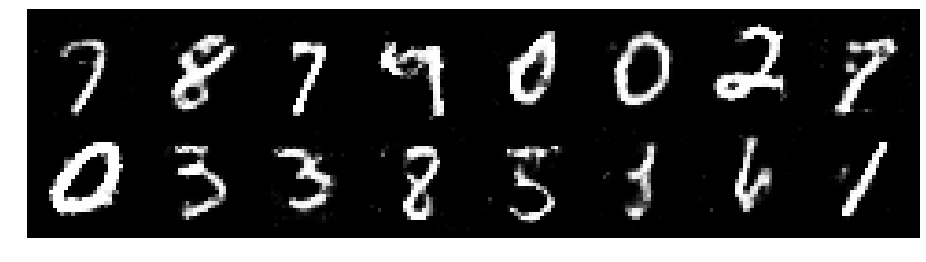

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.2190, Generator Loss: 1.1366
D(x): 0.5794, D(G(z)): 0.4182


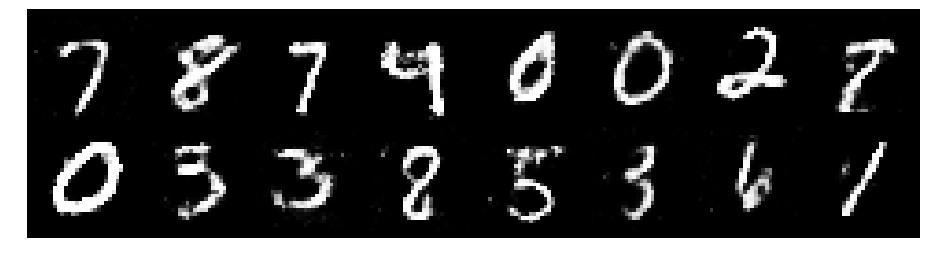

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 1.4516, Generator Loss: 0.8372
D(x): 0.5811, D(G(z)): 0.5205


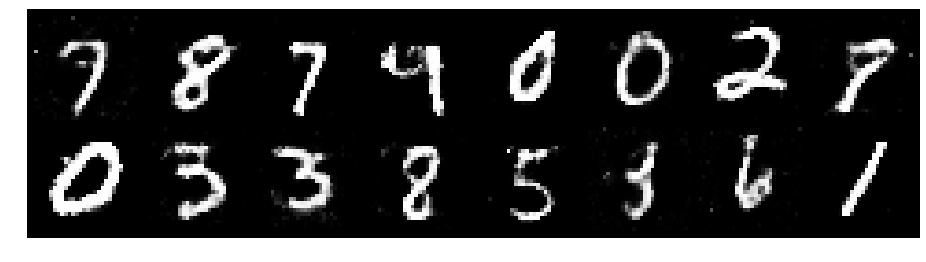

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.2995, Generator Loss: 0.8120
D(x): 0.5829, D(G(z)): 0.4867


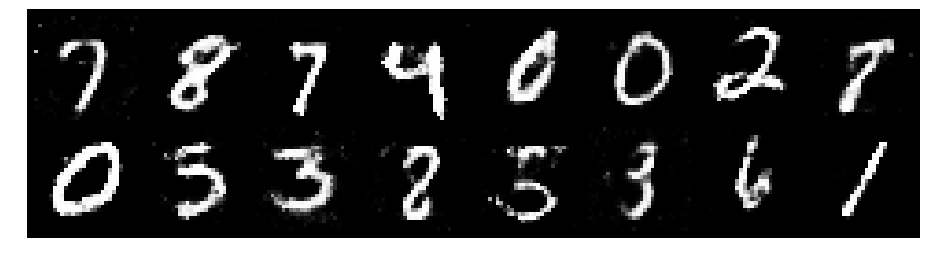

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.3839, Generator Loss: 0.8255
D(x): 0.5386, D(G(z)): 0.4914


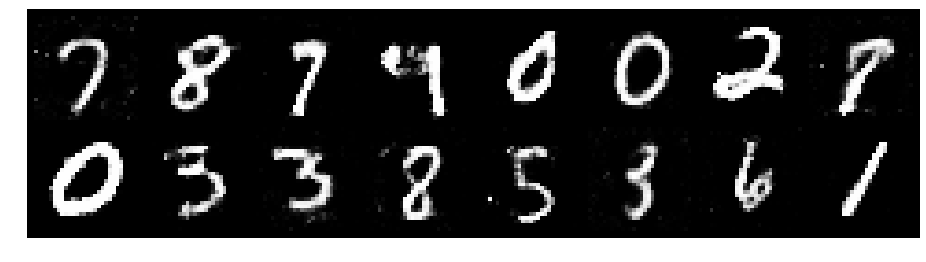

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.2713, Generator Loss: 1.0176
D(x): 0.5608, D(G(z)): 0.4425


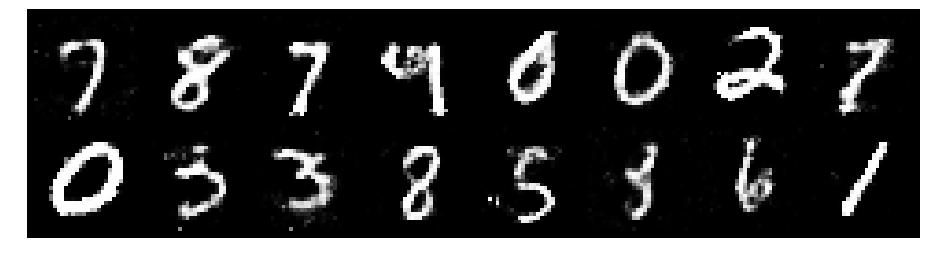

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.3158, Generator Loss: 0.7564
D(x): 0.5556, D(G(z)): 0.4789


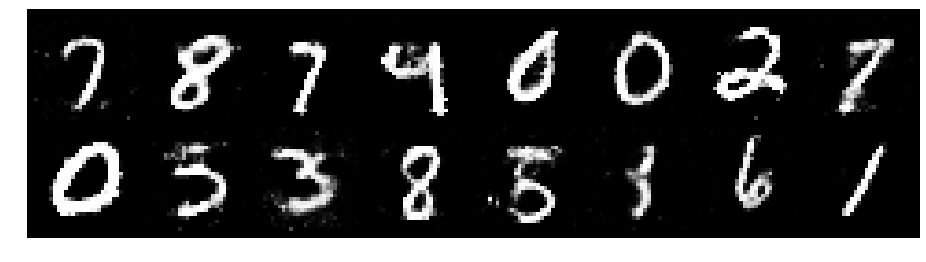

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.3178, Generator Loss: 0.9052
D(x): 0.5224, D(G(z)): 0.4440


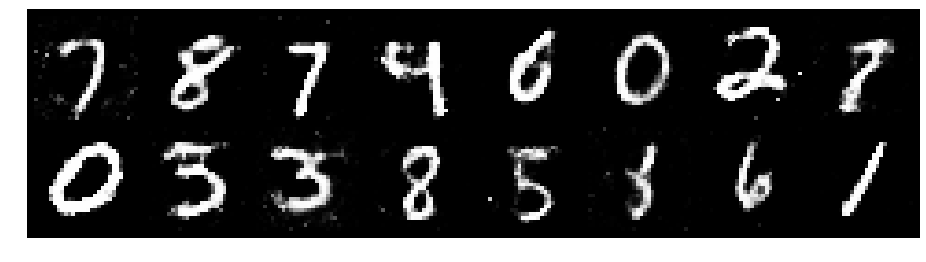

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.3054, Generator Loss: 0.8667
D(x): 0.5127, D(G(z)): 0.4320


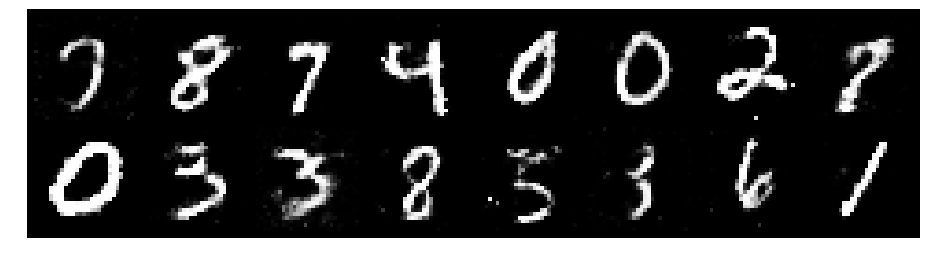

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.2390, Generator Loss: 0.8397
D(x): 0.5410, D(G(z)): 0.4288


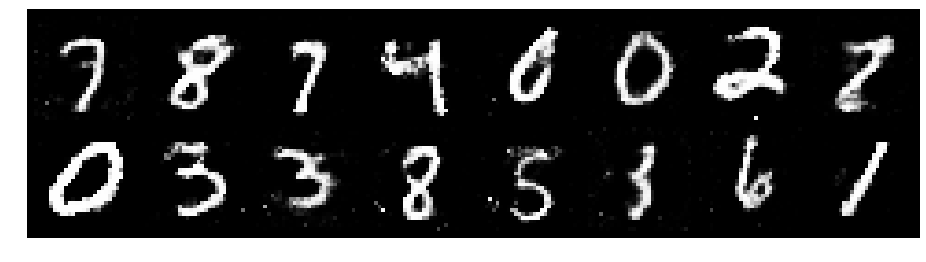

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.2710, Generator Loss: 0.8759
D(x): 0.5671, D(G(z)): 0.4540


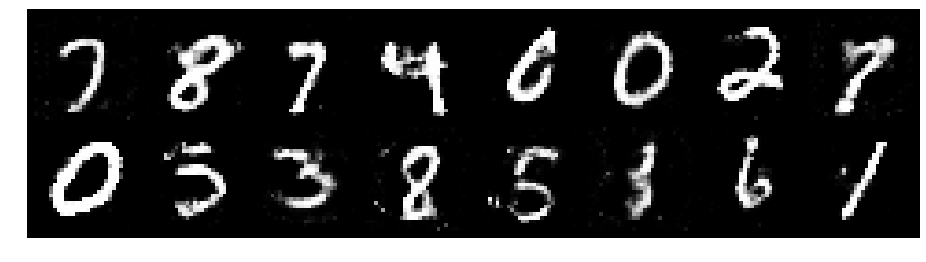

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.2775, Generator Loss: 0.7825
D(x): 0.5649, D(G(z)): 0.4722


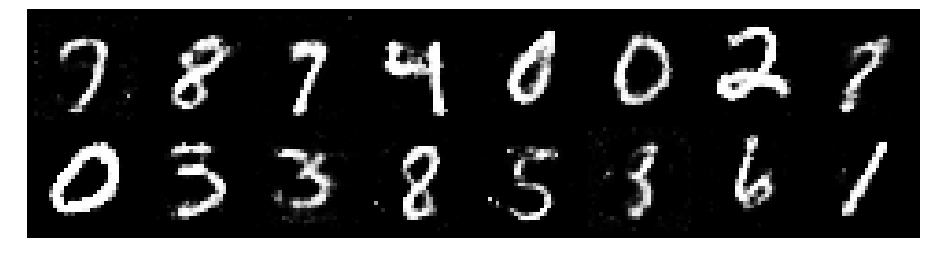

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.2332, Generator Loss: 0.9617
D(x): 0.5434, D(G(z)): 0.4184


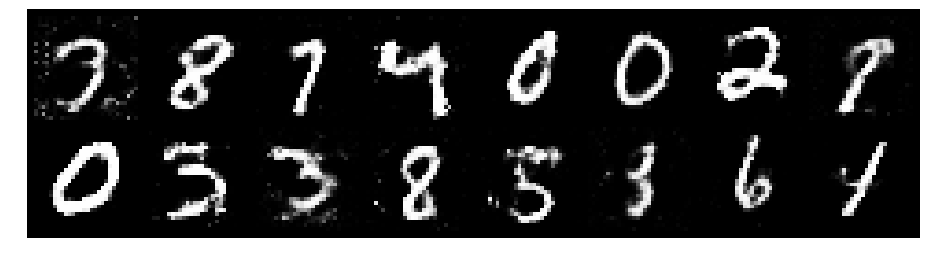

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.3585, Generator Loss: 0.9280
D(x): 0.5449, D(G(z)): 0.4454


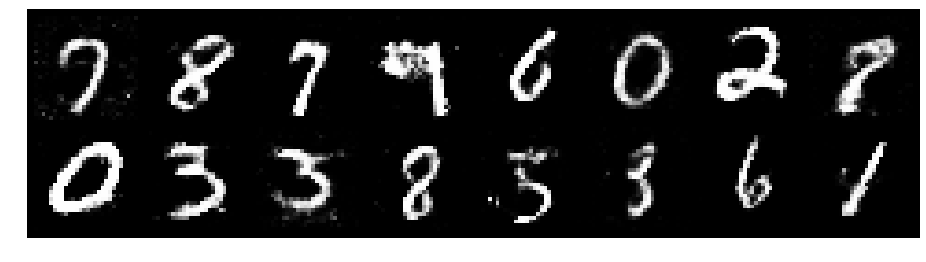

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.2735, Generator Loss: 0.8894
D(x): 0.5251, D(G(z)): 0.4260


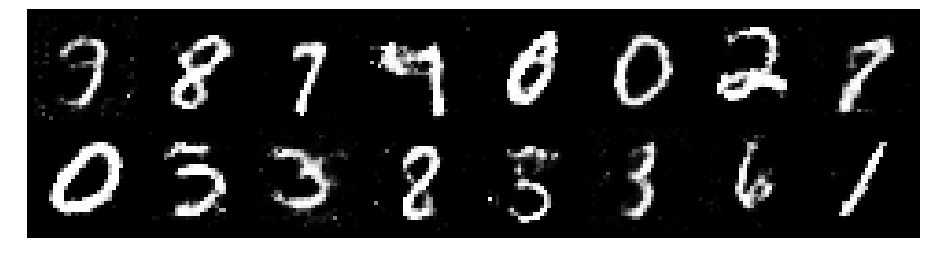

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.2248, Generator Loss: 0.9571
D(x): 0.5616, D(G(z)): 0.4248


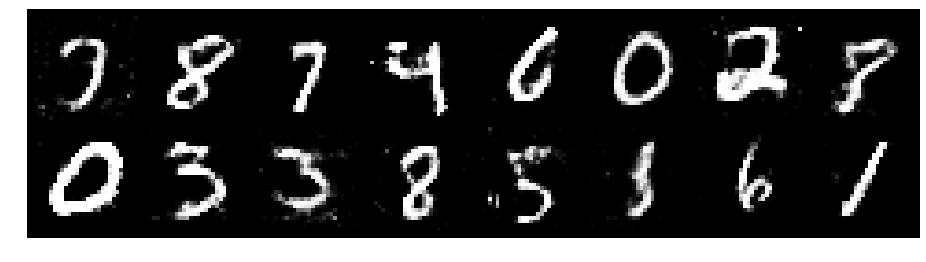

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.3269, Generator Loss: 0.8173
D(x): 0.5397, D(G(z)): 0.4476


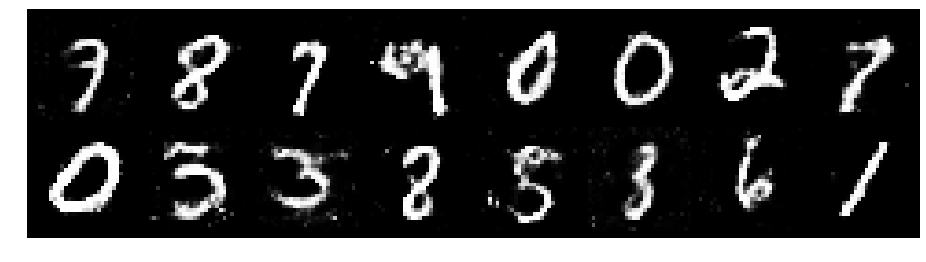

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.2719, Generator Loss: 1.0032
D(x): 0.5529, D(G(z)): 0.4384


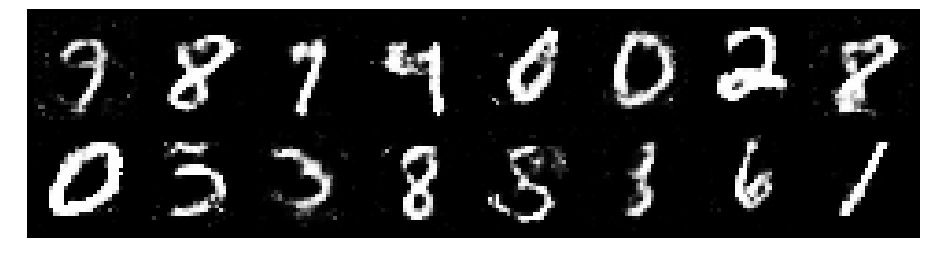

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.2418, Generator Loss: 0.7839
D(x): 0.5675, D(G(z)): 0.4578


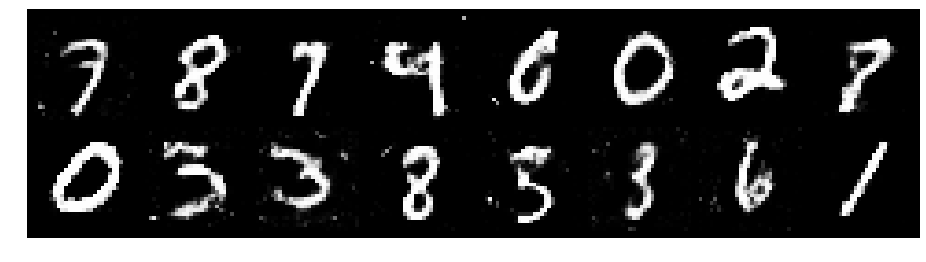

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.3374, Generator Loss: 0.8939
D(x): 0.5182, D(G(z)): 0.4500


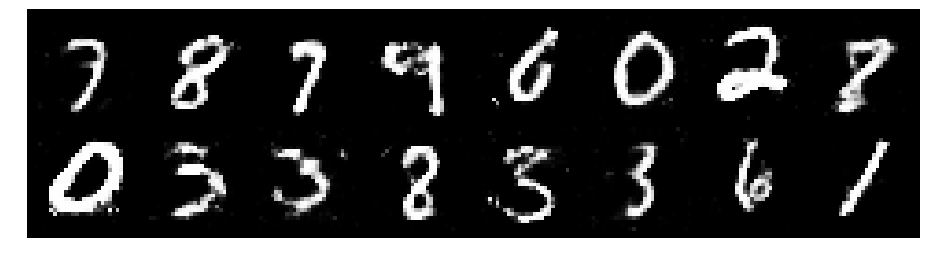

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.2160, Generator Loss: 0.8886
D(x): 0.5674, D(G(z)): 0.4433


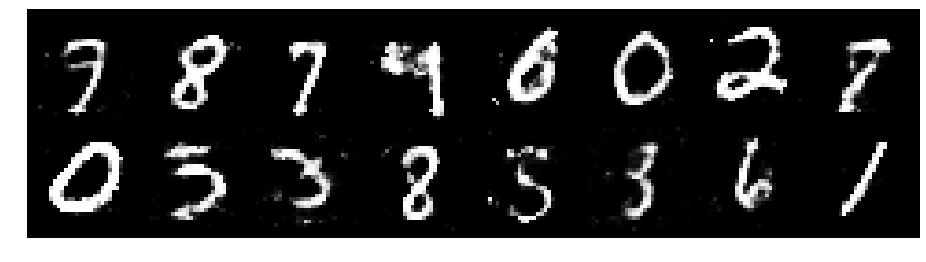

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.3401, Generator Loss: 0.9257
D(x): 0.5398, D(G(z)): 0.4616


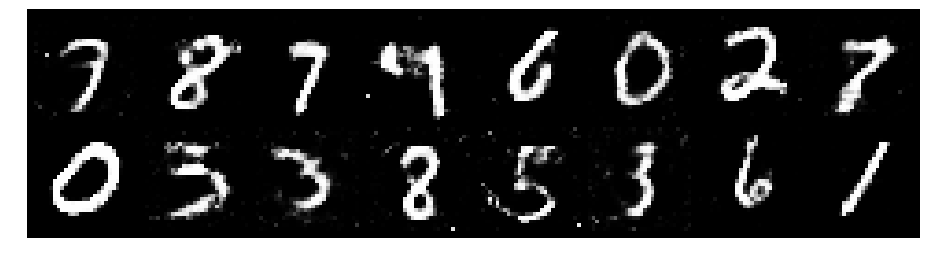

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.3286, Generator Loss: 0.7910
D(x): 0.5899, D(G(z)): 0.4947


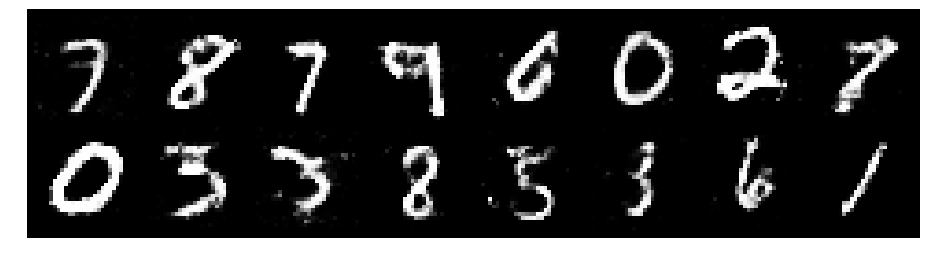

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.2859, Generator Loss: 0.9457
D(x): 0.5171, D(G(z)): 0.4188


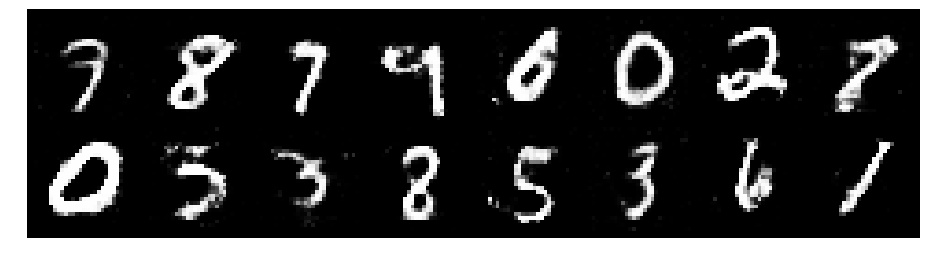

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.2350, Generator Loss: 0.8092
D(x): 0.5667, D(G(z)): 0.4598


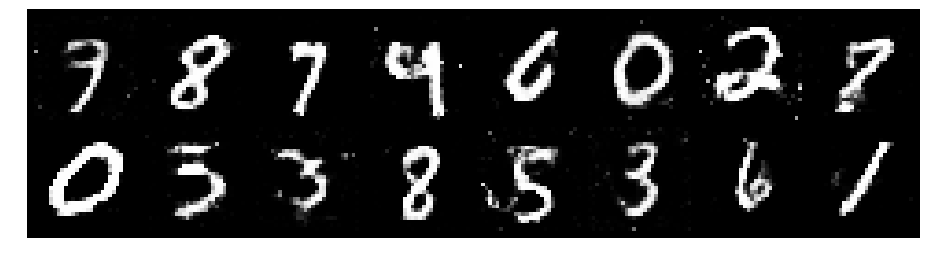

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.3560, Generator Loss: 1.1612
D(x): 0.5215, D(G(z)): 0.4320


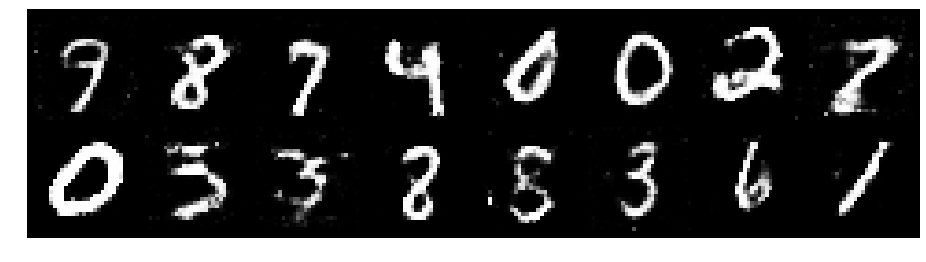

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.2712, Generator Loss: 0.8698
D(x): 0.5863, D(G(z)): 0.4377


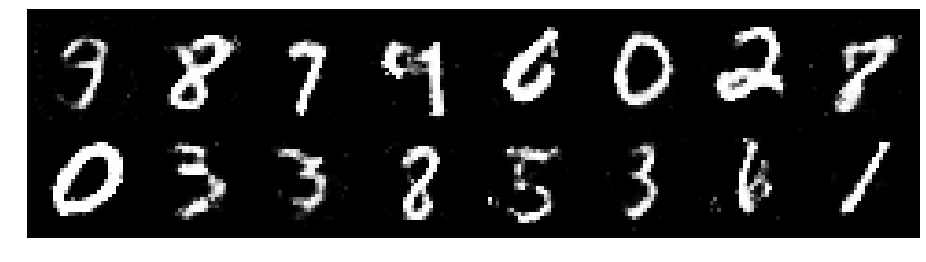

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.3147, Generator Loss: 0.7443
D(x): 0.5813, D(G(z)): 0.4921


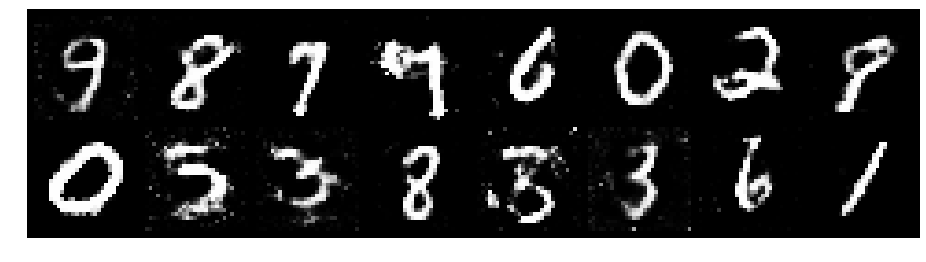

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.3114, Generator Loss: 0.8331
D(x): 0.5268, D(G(z)): 0.4538


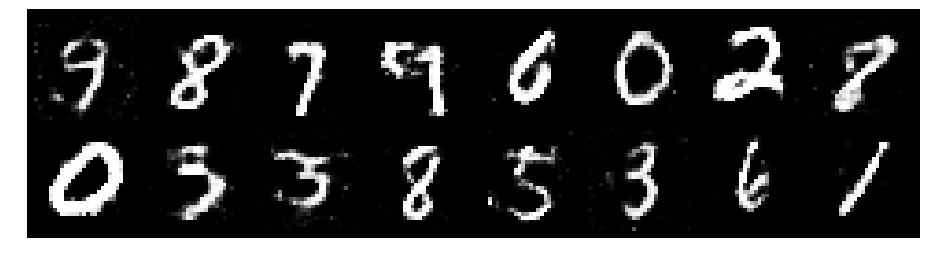

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.3137, Generator Loss: 0.8541
D(x): 0.5481, D(G(z)): 0.4731


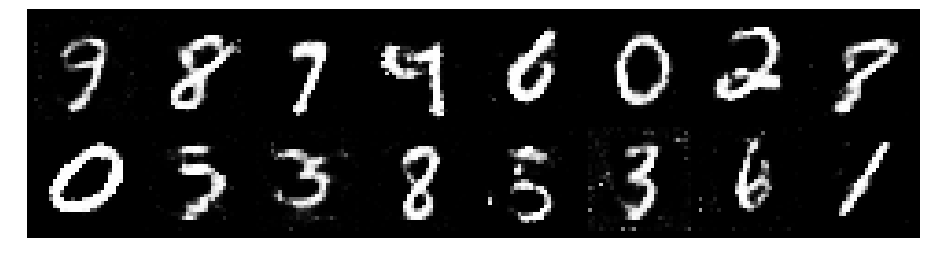

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.2793, Generator Loss: 0.8962
D(x): 0.4957, D(G(z)): 0.3937


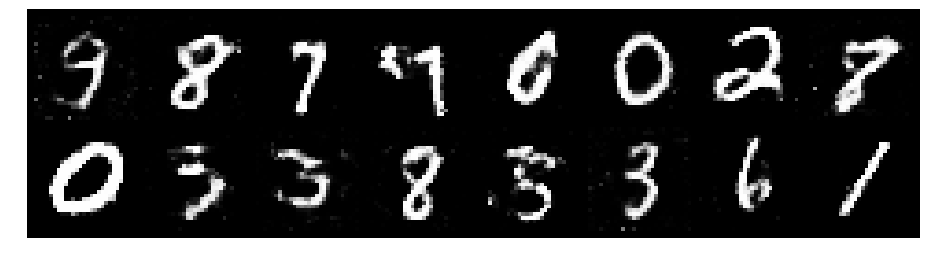

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.2480, Generator Loss: 0.9616
D(x): 0.5625, D(G(z)): 0.4328


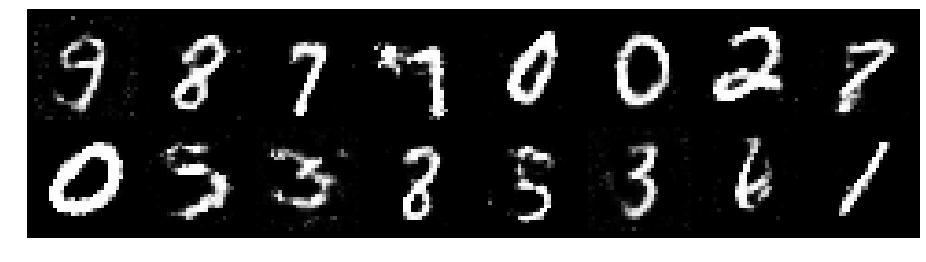

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.2865, Generator Loss: 0.9682
D(x): 0.5767, D(G(z)): 0.4377


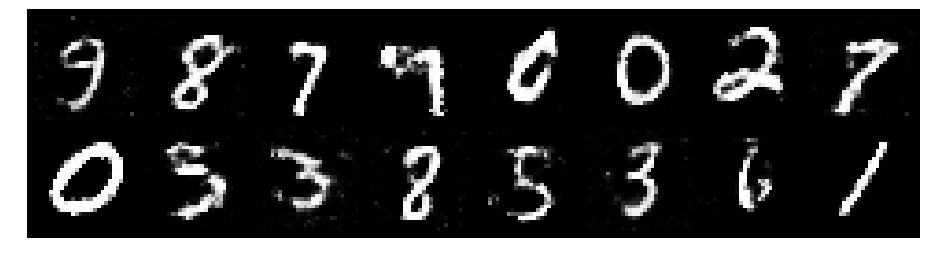

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.3975, Generator Loss: 0.9399
D(x): 0.5476, D(G(z)): 0.4733


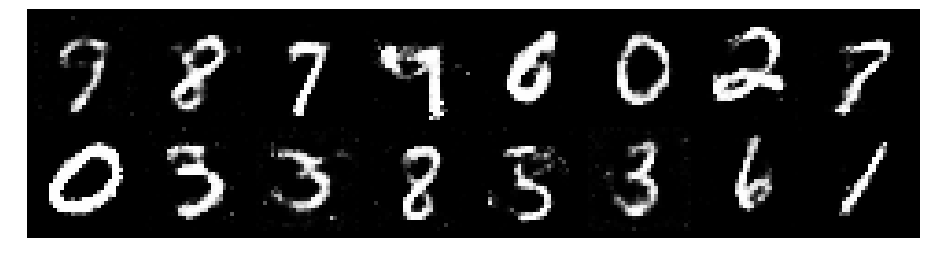

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.2136, Generator Loss: 1.0262
D(x): 0.5867, D(G(z)): 0.4369


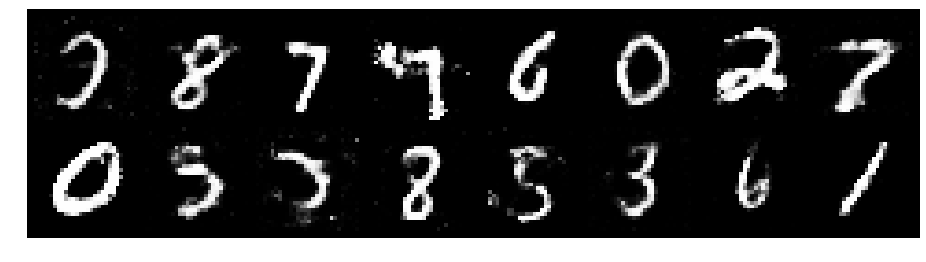

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.4045, Generator Loss: 0.7698
D(x): 0.5346, D(G(z)): 0.4950


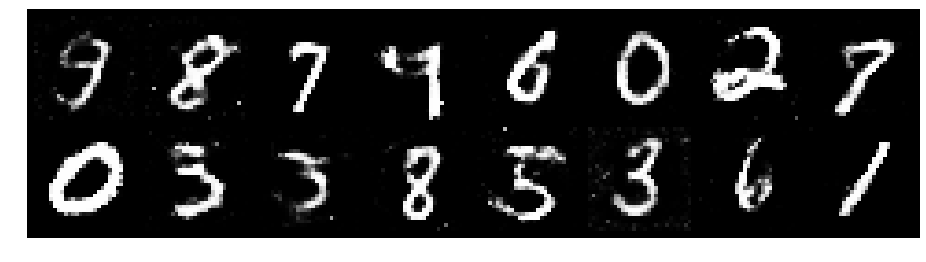

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.3153, Generator Loss: 0.7705
D(x): 0.5507, D(G(z)): 0.4783


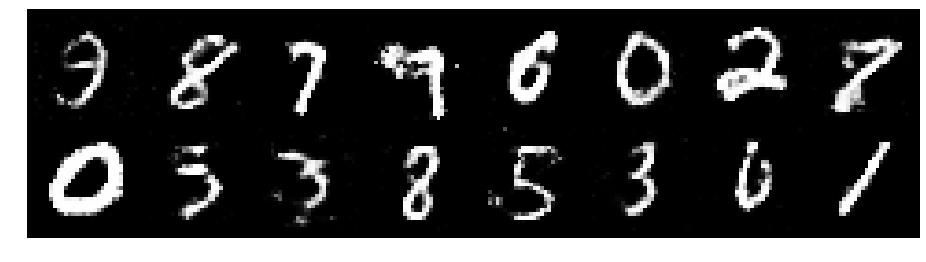

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.3800, Generator Loss: 0.8618
D(x): 0.5125, D(G(z)): 0.4642


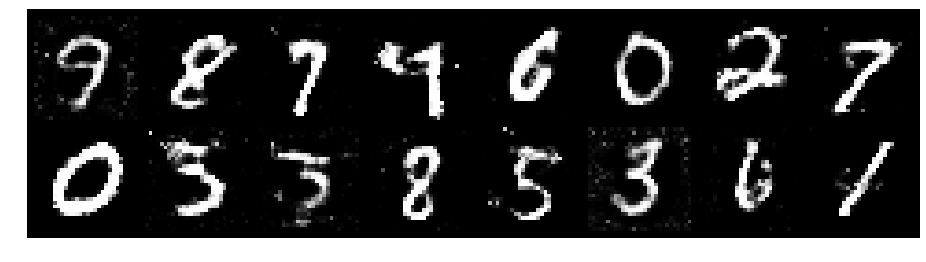

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.3314, Generator Loss: 0.9285
D(x): 0.5282, D(G(z)): 0.4396


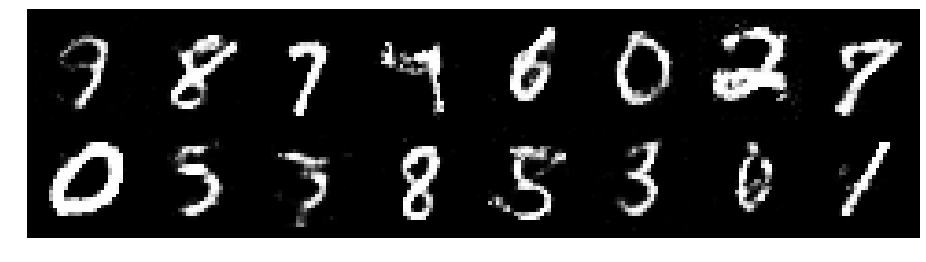

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.3244, Generator Loss: 0.8740
D(x): 0.5479, D(G(z)): 0.4799


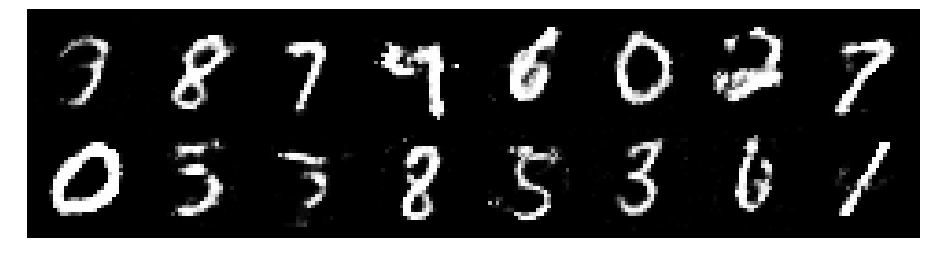

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.2282, Generator Loss: 0.7929
D(x): 0.5836, D(G(z)): 0.4637


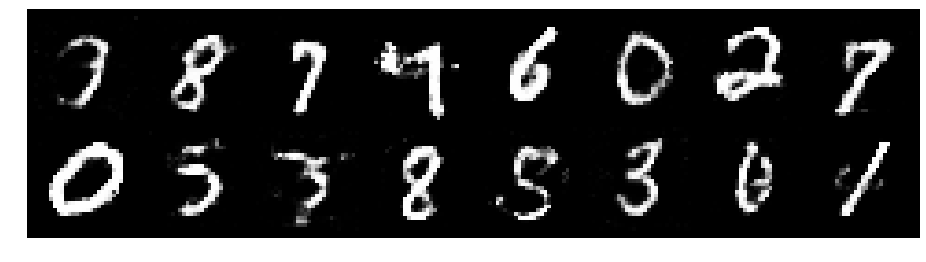

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.3797, Generator Loss: 0.8797
D(x): 0.4982, D(G(z)): 0.4463


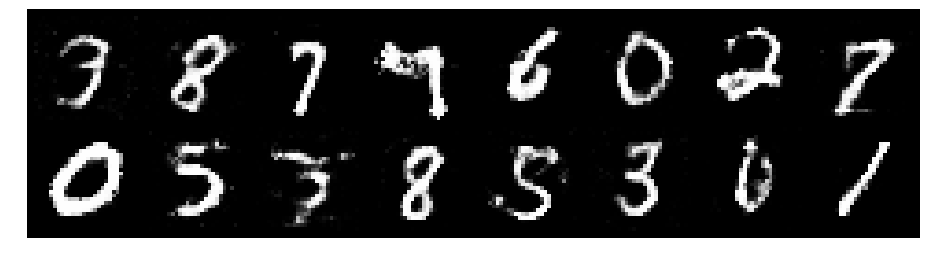

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.2654, Generator Loss: 0.9503
D(x): 0.5308, D(G(z)): 0.4345


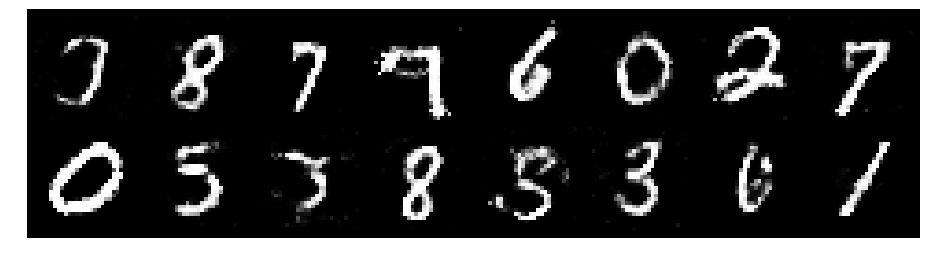

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.2557, Generator Loss: 0.8255
D(x): 0.5441, D(G(z)): 0.4514


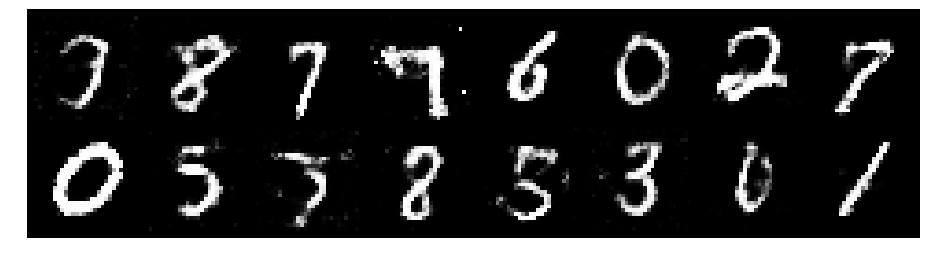

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.3030, Generator Loss: 0.9726
D(x): 0.5198, D(G(z)): 0.4357


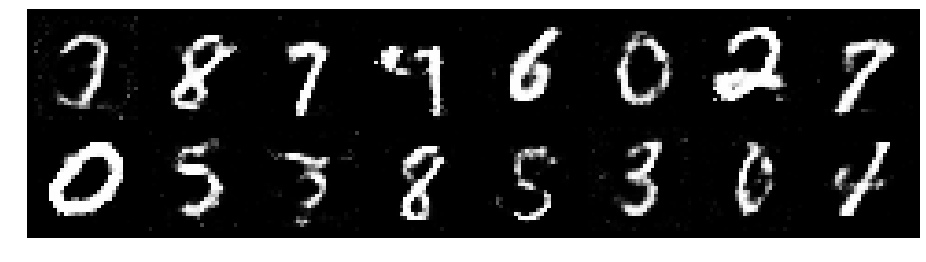

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.2824, Generator Loss: 0.7961
D(x): 0.5221, D(G(z)): 0.4319


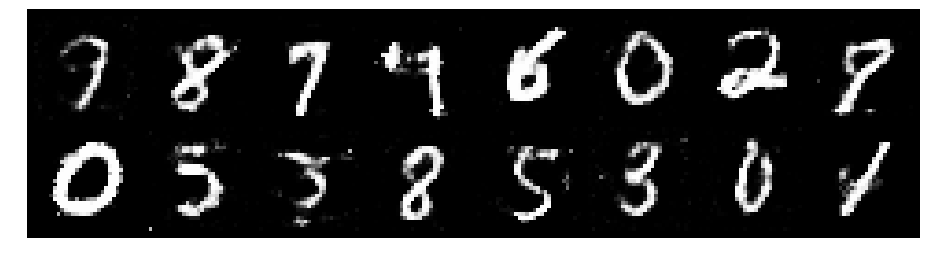

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.2123, Generator Loss: 0.9314
D(x): 0.5981, D(G(z)): 0.4564


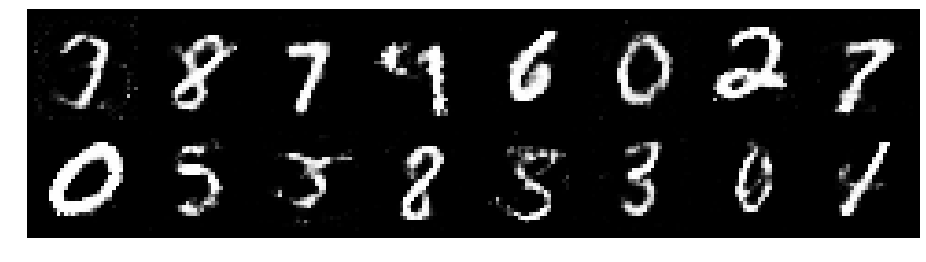

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.2668, Generator Loss: 0.9859
D(x): 0.5357, D(G(z)): 0.4378


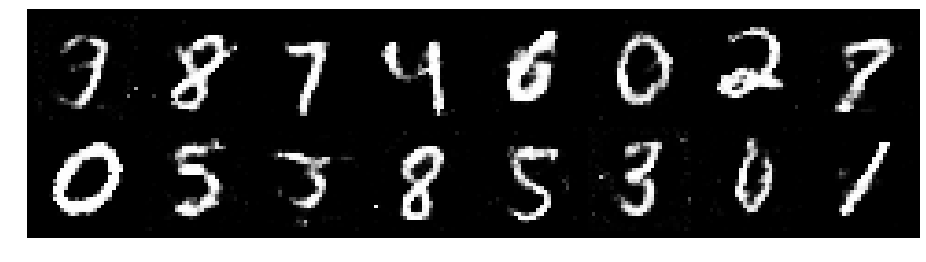

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.2637, Generator Loss: 0.8711
D(x): 0.5724, D(G(z)): 0.4636


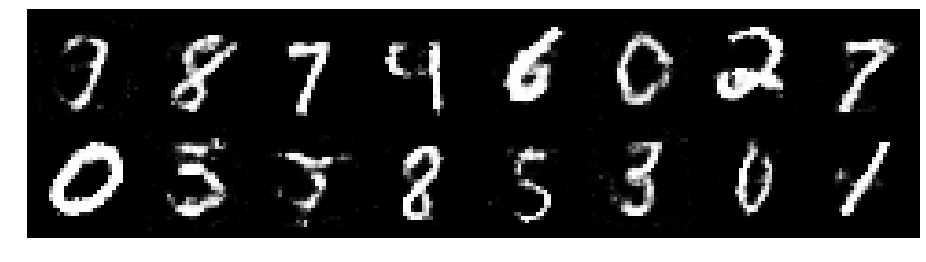

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.2470, Generator Loss: 0.9311
D(x): 0.5537, D(G(z)): 0.4438


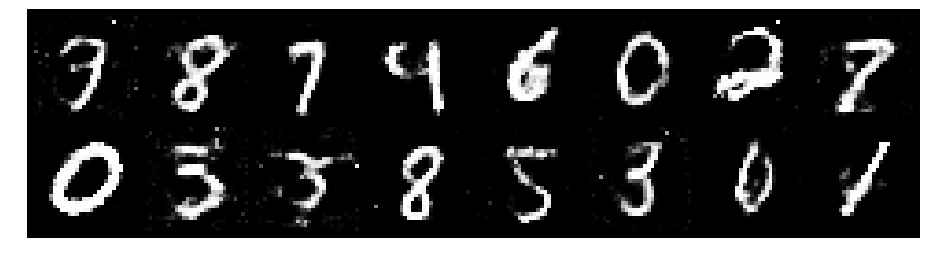

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.3240, Generator Loss: 0.8344
D(x): 0.5443, D(G(z)): 0.4739


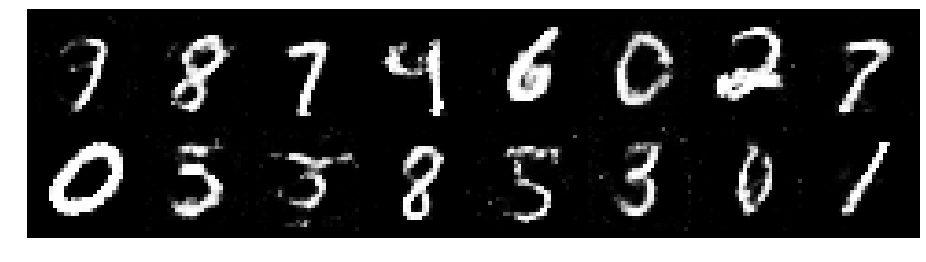

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.3142, Generator Loss: 0.8976
D(x): 0.5251, D(G(z)): 0.4422


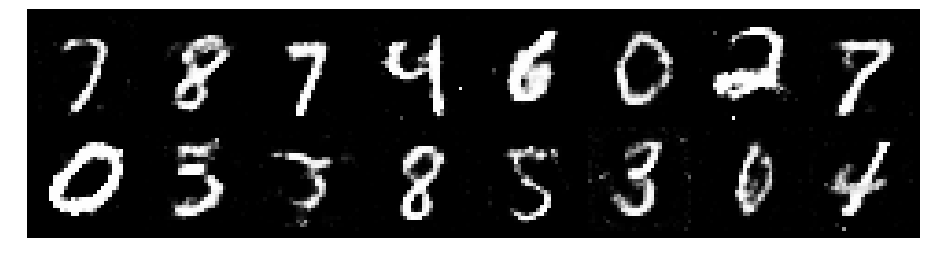

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.2923, Generator Loss: 0.9902
D(x): 0.5571, D(G(z)): 0.4364


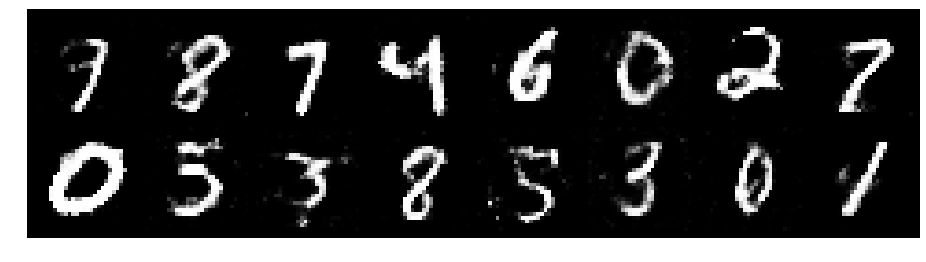

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.3434, Generator Loss: 0.7965
D(x): 0.5389, D(G(z)): 0.4885


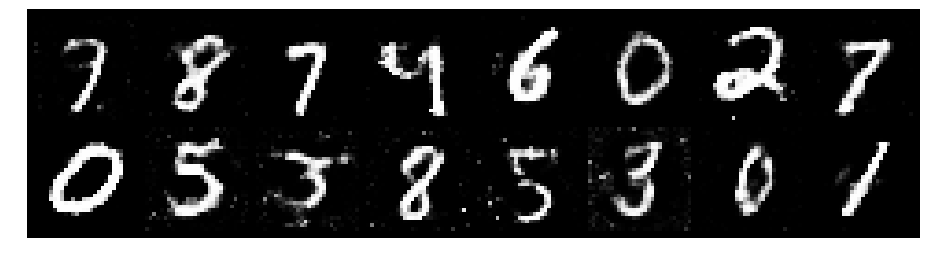

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.3103, Generator Loss: 0.8377
D(x): 0.5433, D(G(z)): 0.4382


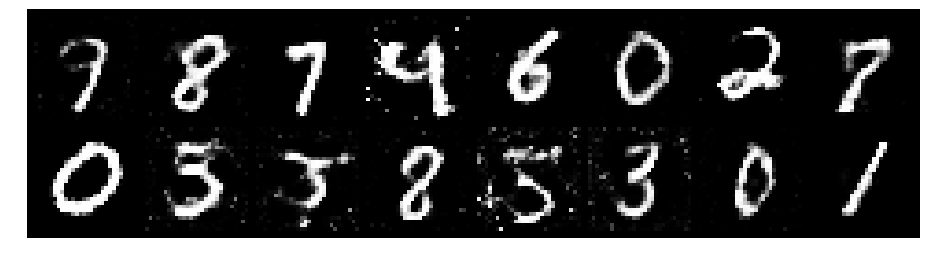

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.2983, Generator Loss: 0.8434
D(x): 0.5422, D(G(z)): 0.4580


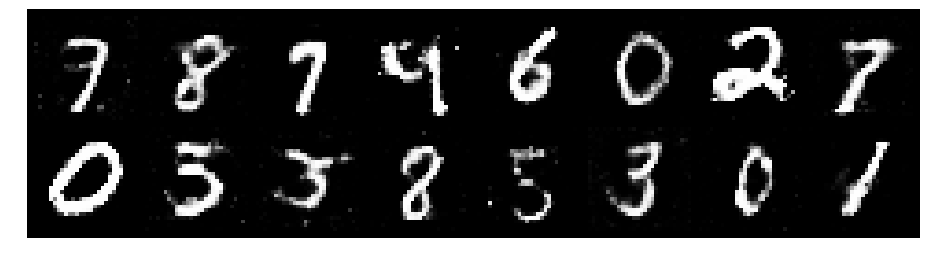

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.3350, Generator Loss: 0.8085
D(x): 0.5200, D(G(z)): 0.4532


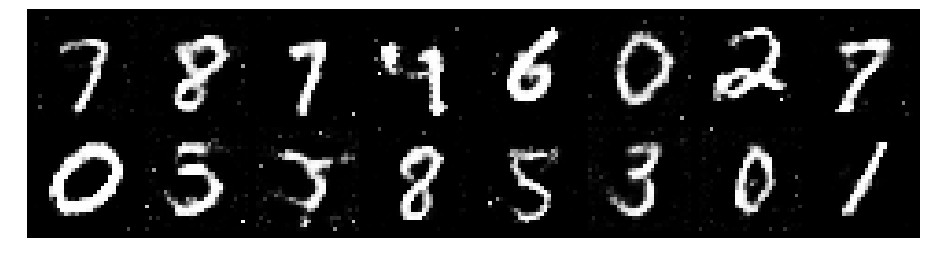

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.3306, Generator Loss: 0.9952
D(x): 0.5262, D(G(z)): 0.4347


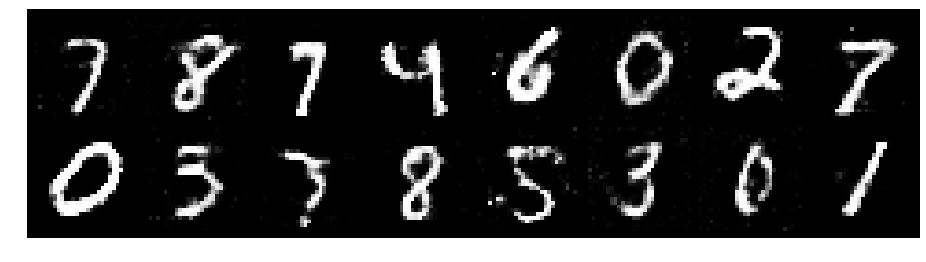

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.3624, Generator Loss: 0.8367
D(x): 0.5822, D(G(z)): 0.5108


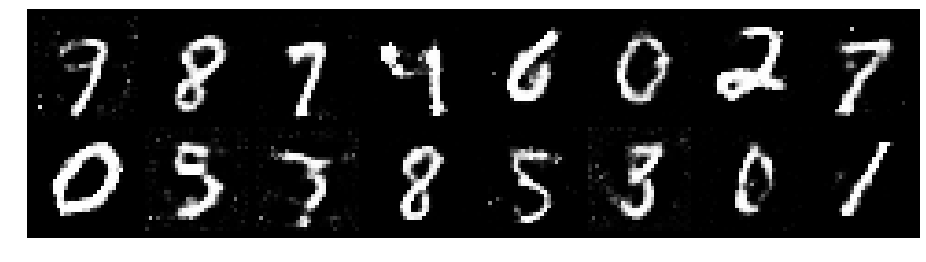

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.3543, Generator Loss: 0.9370
D(x): 0.5070, D(G(z)): 0.4439


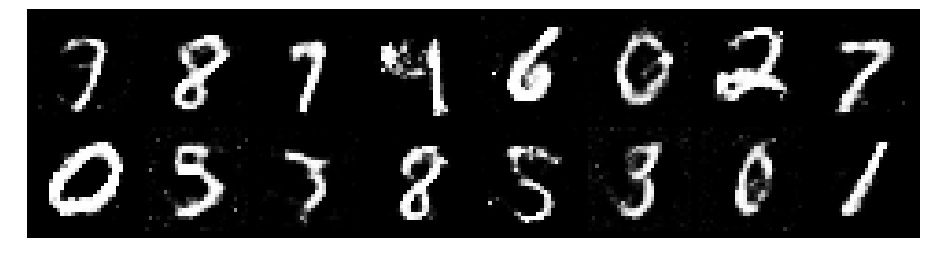

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.1656, Generator Loss: 0.9209
D(x): 0.5680, D(G(z)): 0.4142


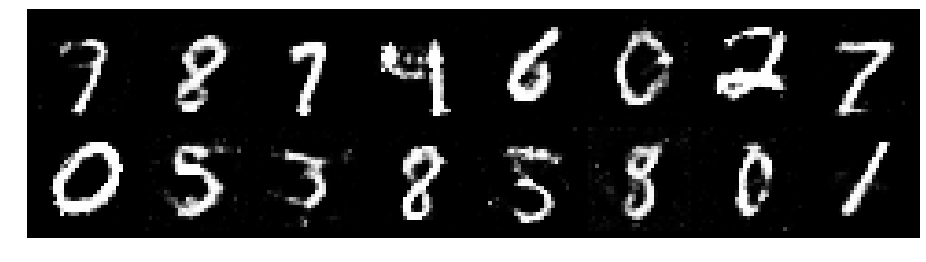

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.1401, Generator Loss: 0.9117
D(x): 0.5771, D(G(z)): 0.4041


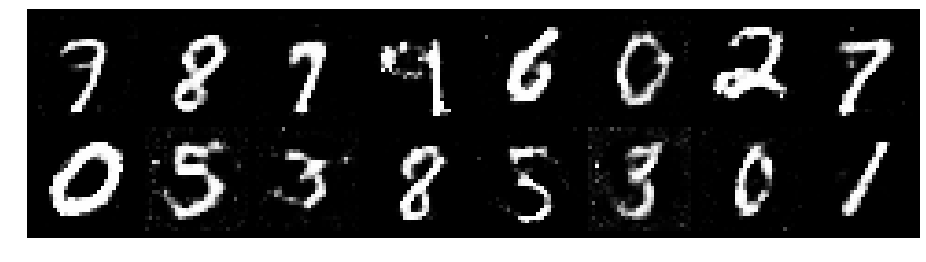

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.2215, Generator Loss: 0.8292
D(x): 0.6044, D(G(z)): 0.4494


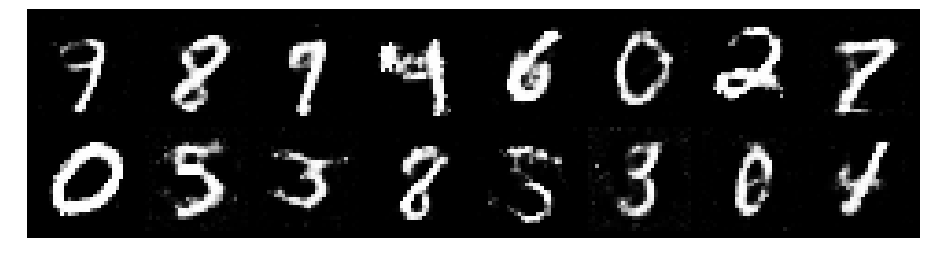

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.2625, Generator Loss: 0.8226
D(x): 0.5853, D(G(z)): 0.4634


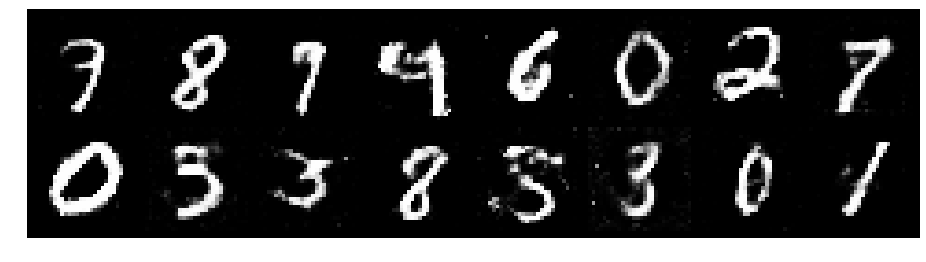

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.3513, Generator Loss: 0.8432
D(x): 0.5397, D(G(z)): 0.4790


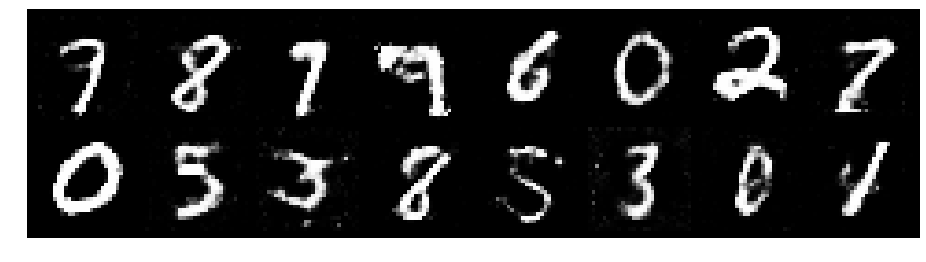

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.3093, Generator Loss: 0.7706
D(x): 0.5478, D(G(z)): 0.4627


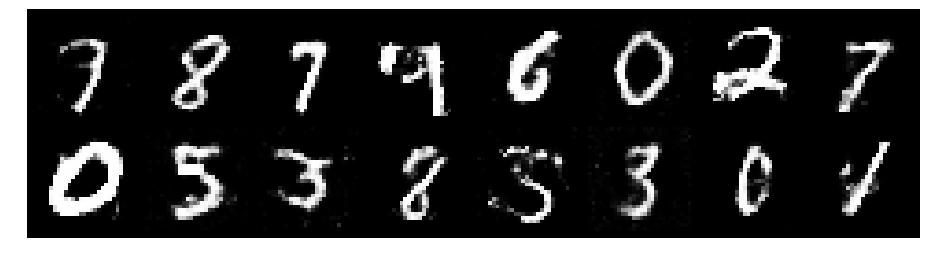

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.3335, Generator Loss: 0.8612
D(x): 0.5495, D(G(z)): 0.4790


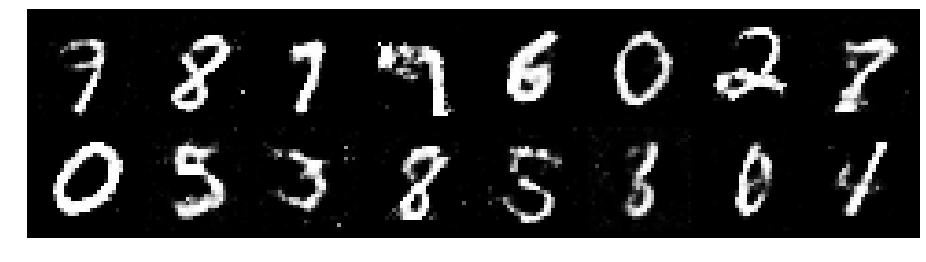

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.1899, Generator Loss: 0.9833
D(x): 0.5511, D(G(z)): 0.4050


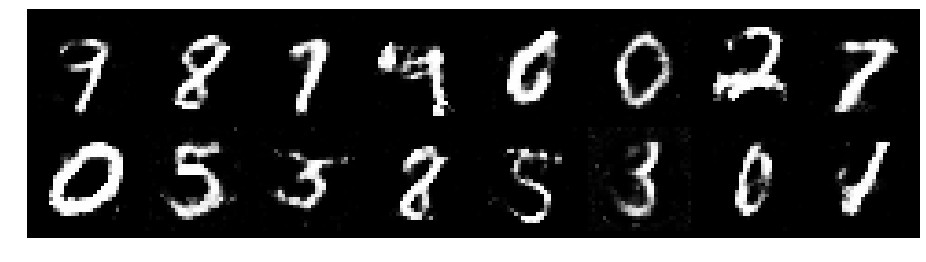

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.2621, Generator Loss: 0.8864
D(x): 0.5794, D(G(z)): 0.4613


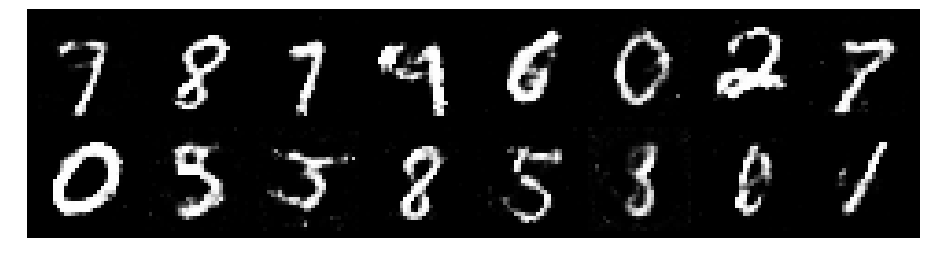

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.3220, Generator Loss: 0.9182
D(x): 0.4876, D(G(z)): 0.4166


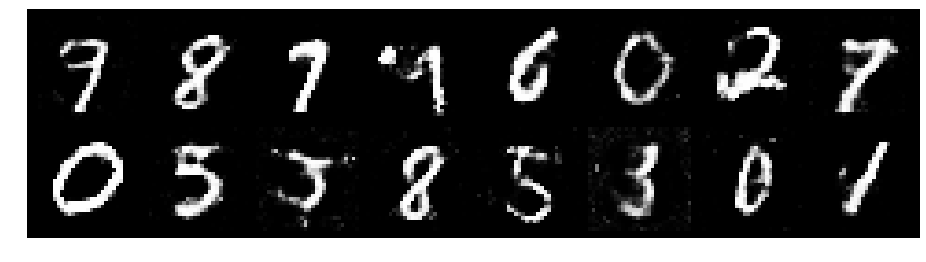

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.2237, Generator Loss: 0.8527
D(x): 0.5441, D(G(z)): 0.4237


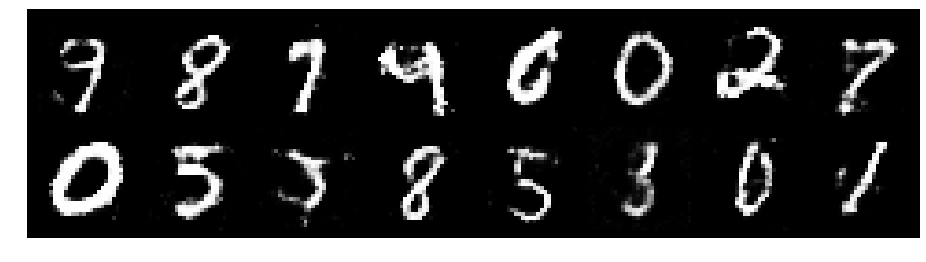

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.3170, Generator Loss: 0.8070
D(x): 0.5525, D(G(z)): 0.4846


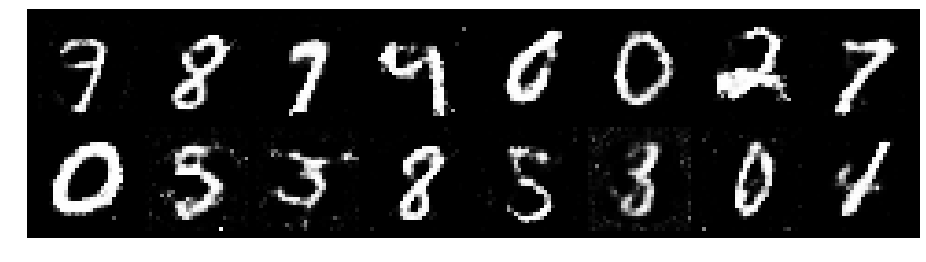

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.2204, Generator Loss: 0.8748
D(x): 0.5464, D(G(z)): 0.4151


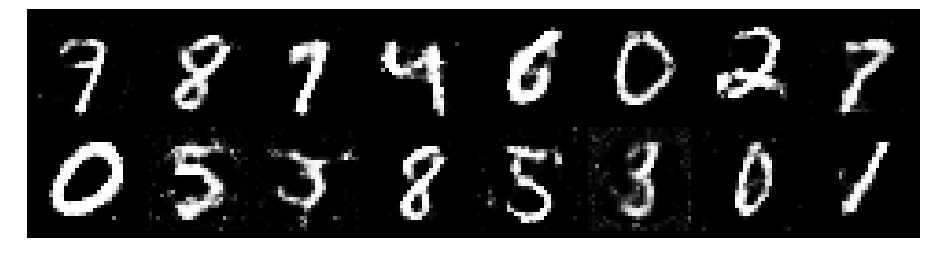

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.3407, Generator Loss: 0.9181
D(x): 0.5347, D(G(z)): 0.4478


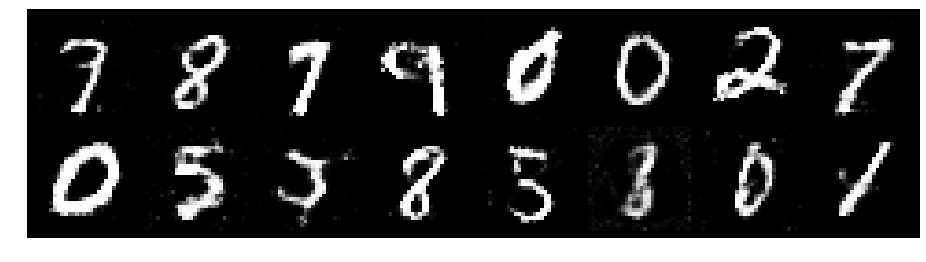

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.1662, Generator Loss: 0.8137
D(x): 0.5764, D(G(z)): 0.4124


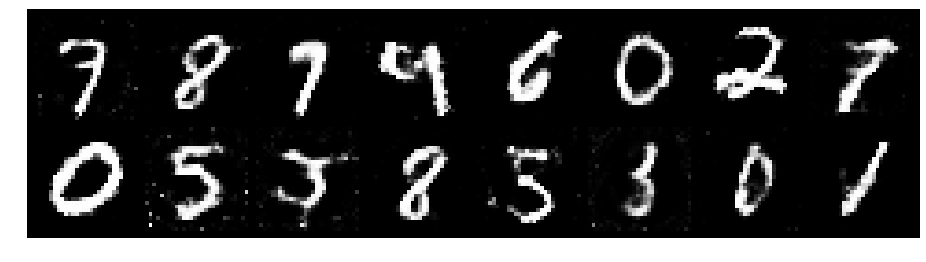

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.3310, Generator Loss: 0.8753
D(x): 0.5404, D(G(z)): 0.4556


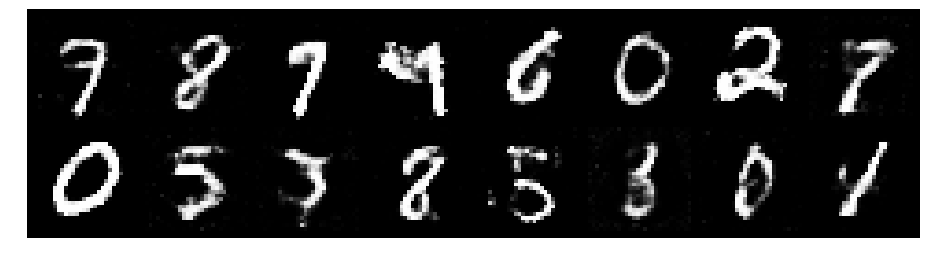

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.3145, Generator Loss: 0.8192
D(x): 0.5710, D(G(z)): 0.4809


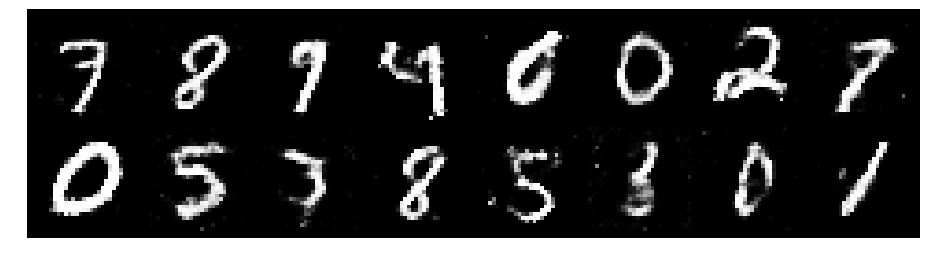

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.3207, Generator Loss: 0.8791
D(x): 0.5253, D(G(z)): 0.4550


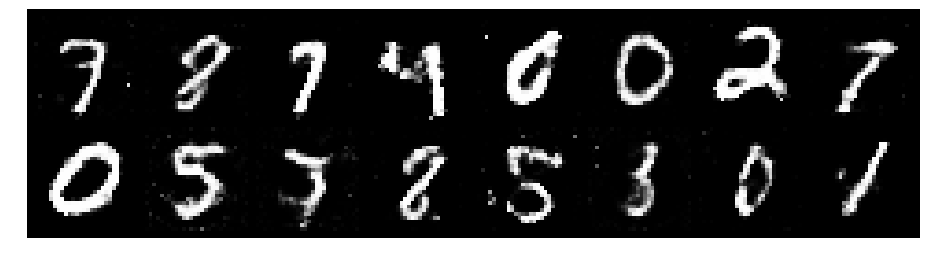

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.3166, Generator Loss: 0.9478
D(x): 0.5357, D(G(z)): 0.4469


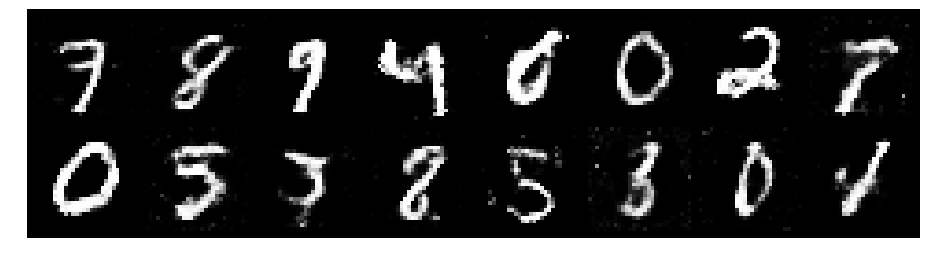

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.2465, Generator Loss: 0.9412
D(x): 0.5314, D(G(z)): 0.4038


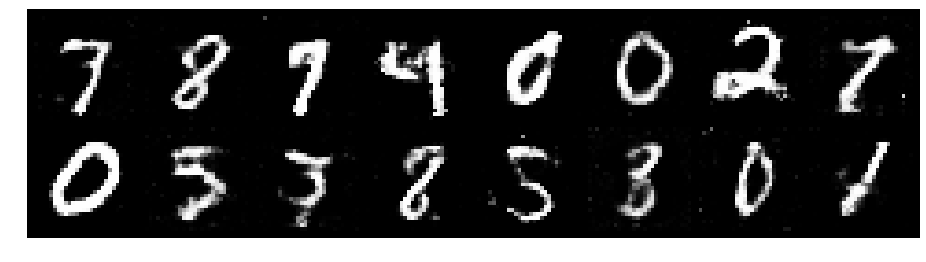

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.2384, Generator Loss: 0.9642
D(x): 0.5695, D(G(z)): 0.4288


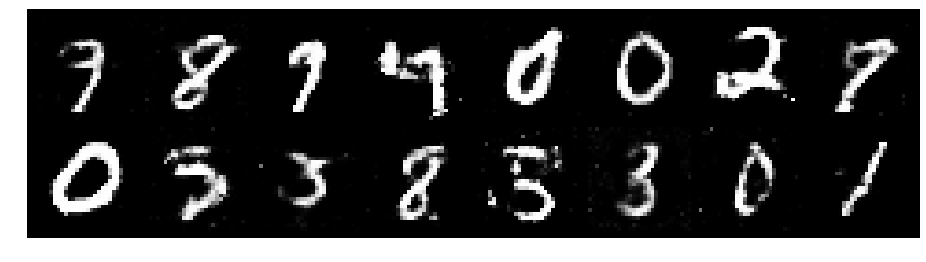

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.1206, Generator Loss: 0.9335
D(x): 0.6309, D(G(z)): 0.4264


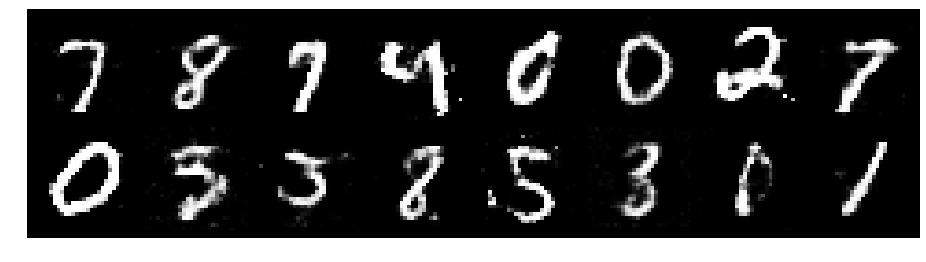

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.2143, Generator Loss: 0.9430
D(x): 0.5650, D(G(z)): 0.4427


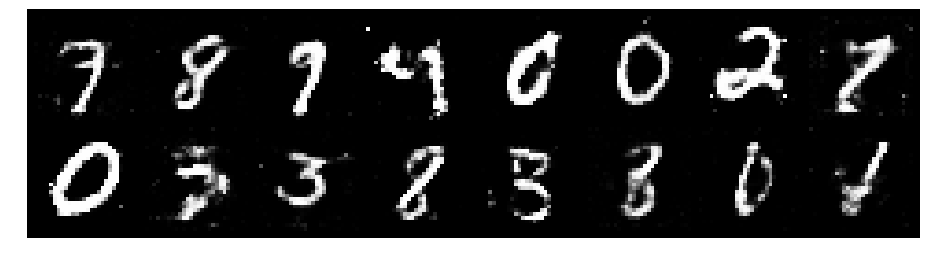

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.3505, Generator Loss: 0.7778
D(x): 0.5266, D(G(z)): 0.4793


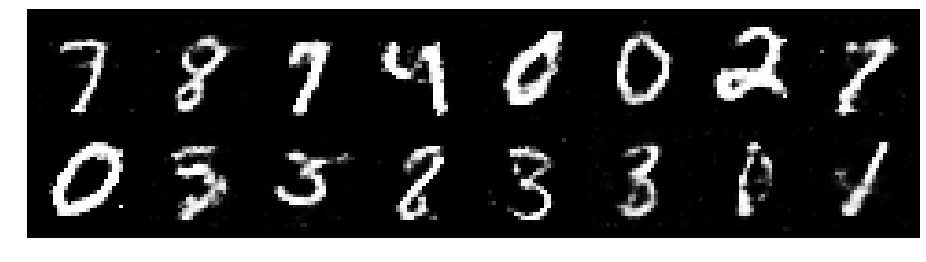

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.3036, Generator Loss: 0.7767
D(x): 0.5878, D(G(z)): 0.4936


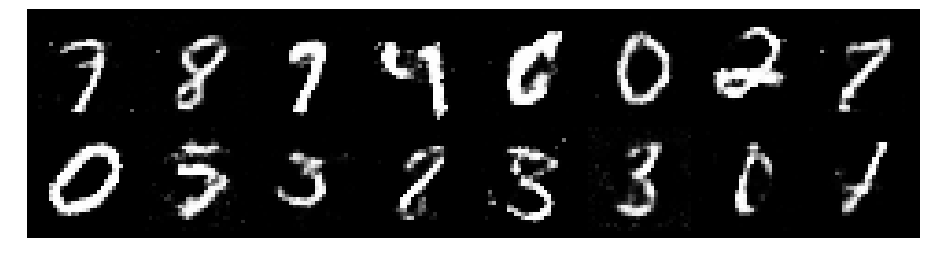

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.4208, Generator Loss: 0.8728
D(x): 0.5123, D(G(z)): 0.4601


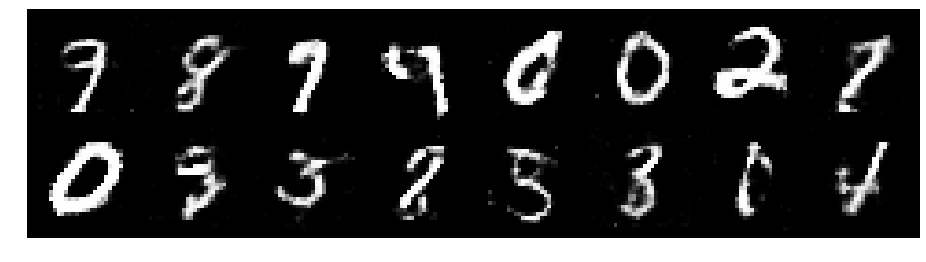

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.3612, Generator Loss: 0.7824
D(x): 0.5631, D(G(z)): 0.4968


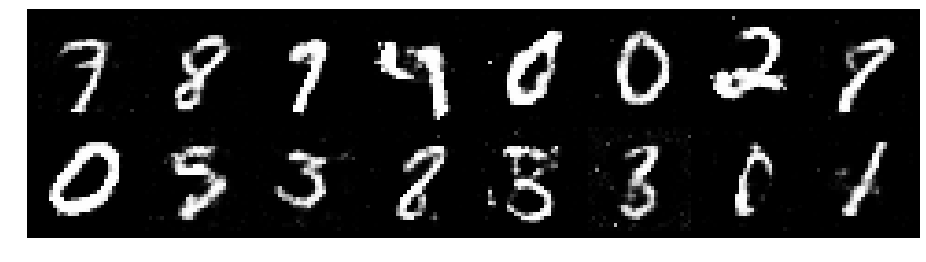

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.2596, Generator Loss: 0.7756
D(x): 0.5950, D(G(z)): 0.4887


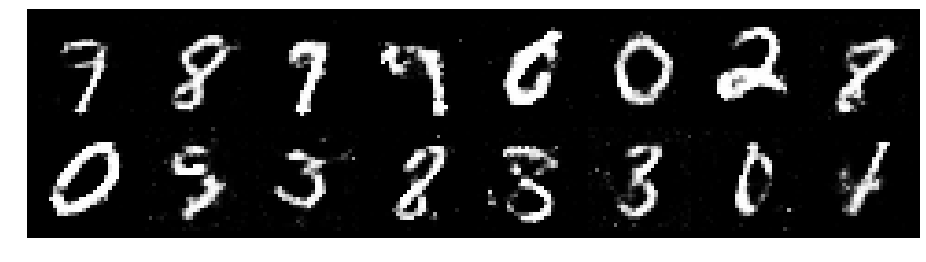

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.2332, Generator Loss: 0.8296
D(x): 0.5625, D(G(z)): 0.4399


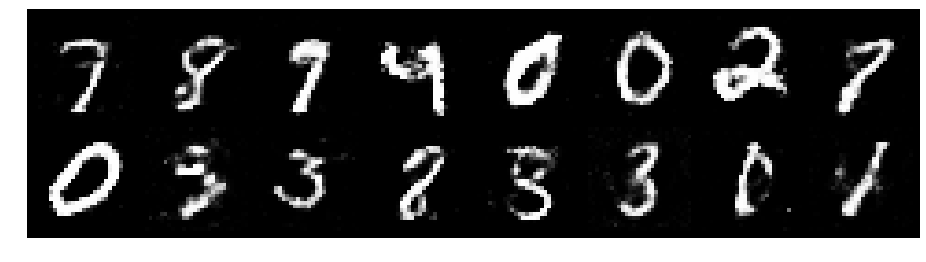

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.2230, Generator Loss: 0.9257
D(x): 0.5526, D(G(z)): 0.4181


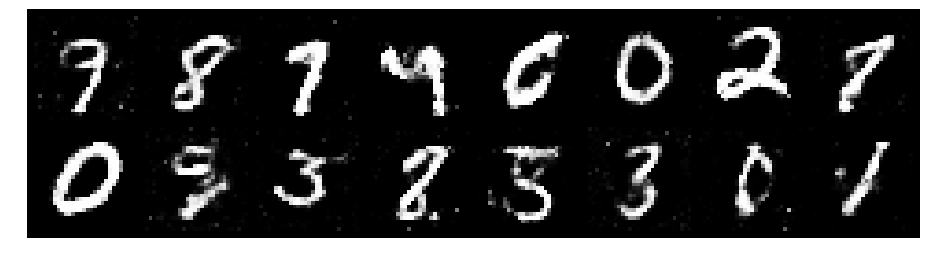

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.3299, Generator Loss: 0.8195
D(x): 0.5329, D(G(z)): 0.4735


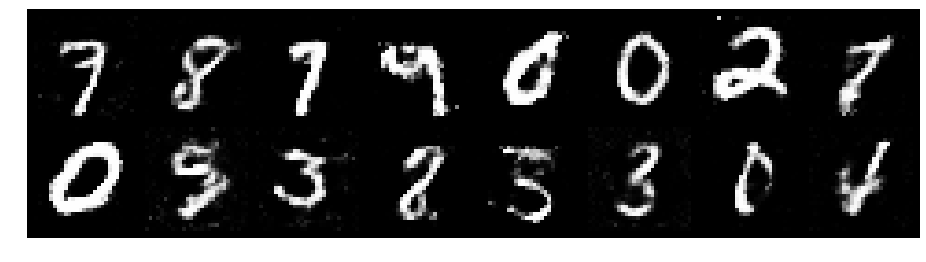

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.2458, Generator Loss: 0.9697
D(x): 0.5702, D(G(z)): 0.4505


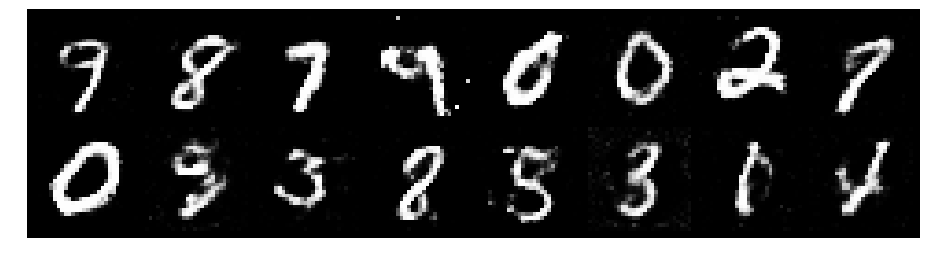

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.3676, Generator Loss: 0.7612
D(x): 0.5435, D(G(z)): 0.4917


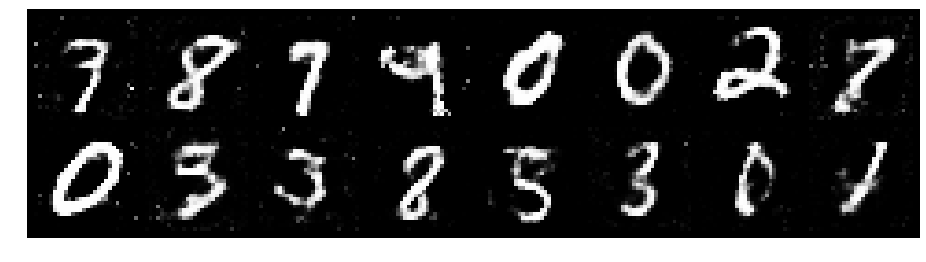

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.3442, Generator Loss: 0.8041
D(x): 0.5396, D(G(z)): 0.4785


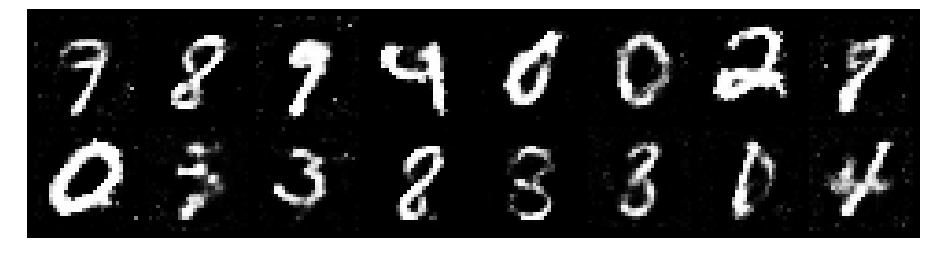

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 1.2814, Generator Loss: 0.8813
D(x): 0.5401, D(G(z)): 0.4529


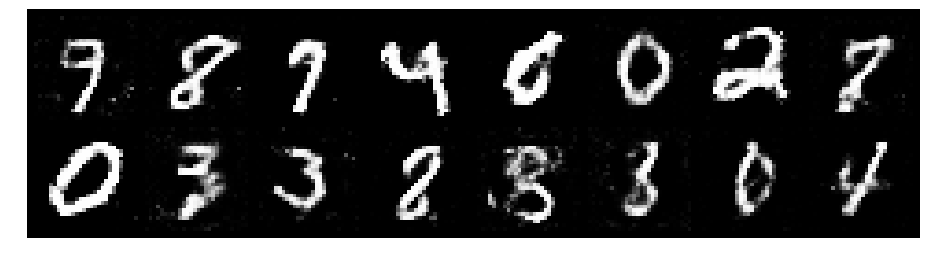

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.2793, Generator Loss: 0.7946
D(x): 0.5485, D(G(z)): 0.4622


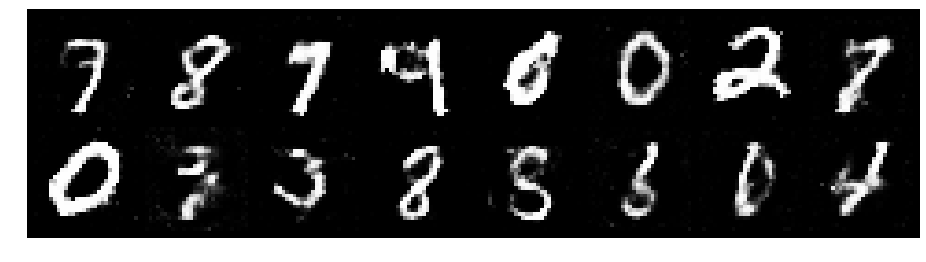

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.2145, Generator Loss: 0.7947
D(x): 0.5727, D(G(z)): 0.4416


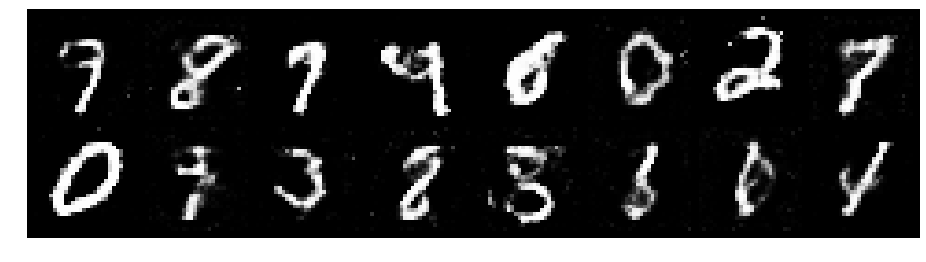

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.2945, Generator Loss: 0.8523
D(x): 0.5630, D(G(z)): 0.4730


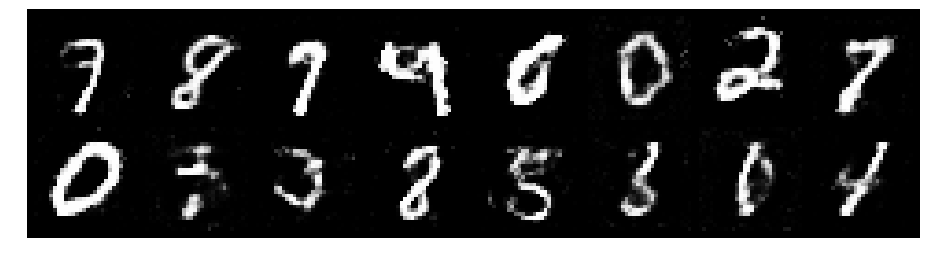

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.2579, Generator Loss: 0.7915
D(x): 0.5610, D(G(z)): 0.4557


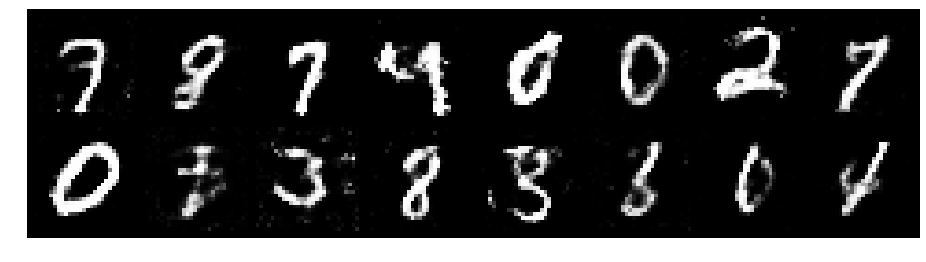

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.3391, Generator Loss: 0.7686
D(x): 0.5450, D(G(z)): 0.4835


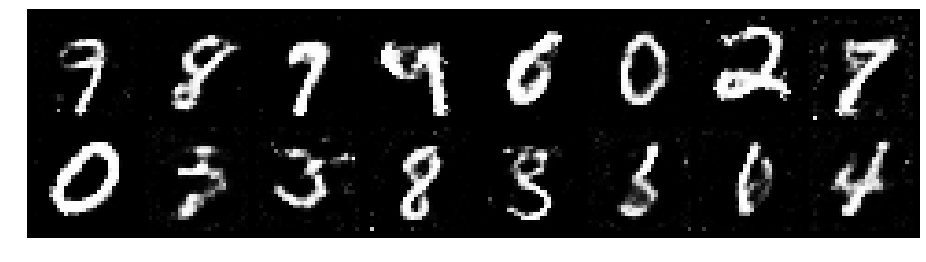

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.3113, Generator Loss: 0.7712
D(x): 0.5419, D(G(z)): 0.4733


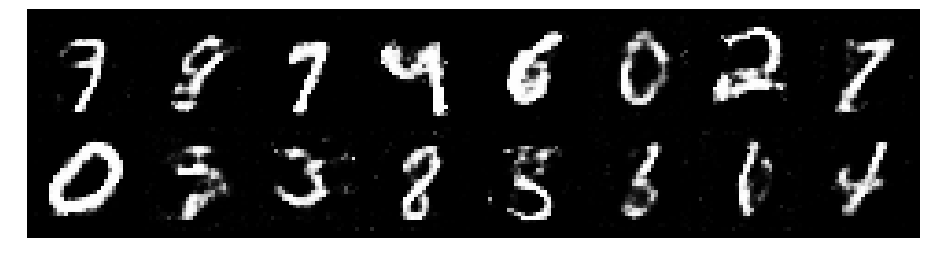

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.2423, Generator Loss: 0.8733
D(x): 0.5720, D(G(z)): 0.4511


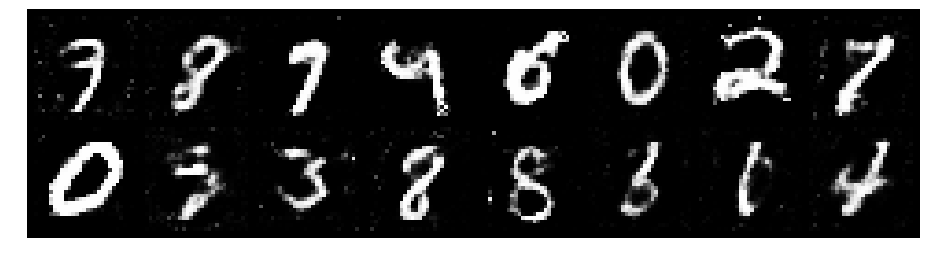

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.2415, Generator Loss: 0.8643
D(x): 0.5481, D(G(z)): 0.4415


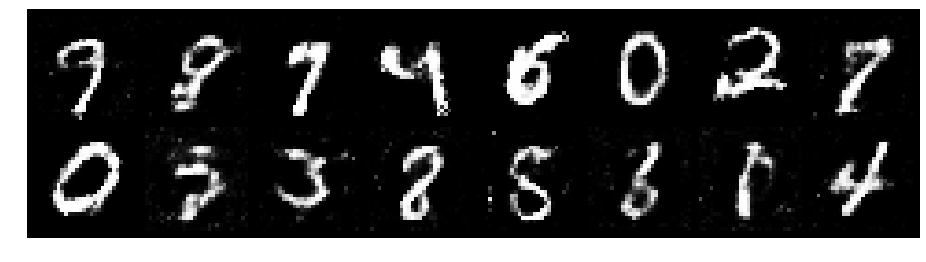

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.1918, Generator Loss: 0.9451
D(x): 0.5449, D(G(z)): 0.4009


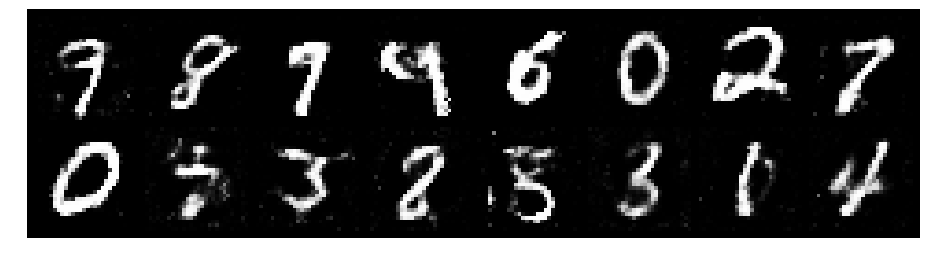

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.2092, Generator Loss: 1.0509
D(x): 0.5376, D(G(z)): 0.3784


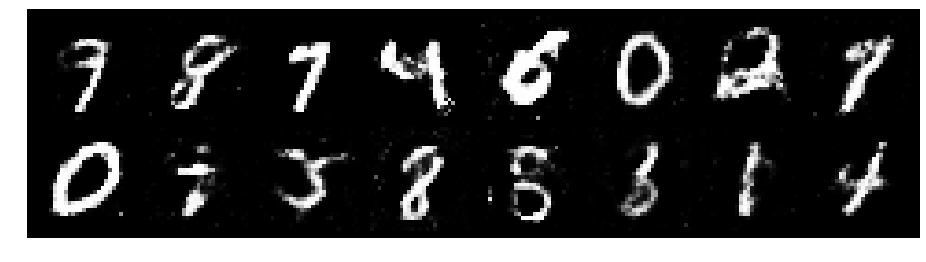

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.0914, Generator Loss: 0.9768
D(x): 0.5939, D(G(z)): 0.3903


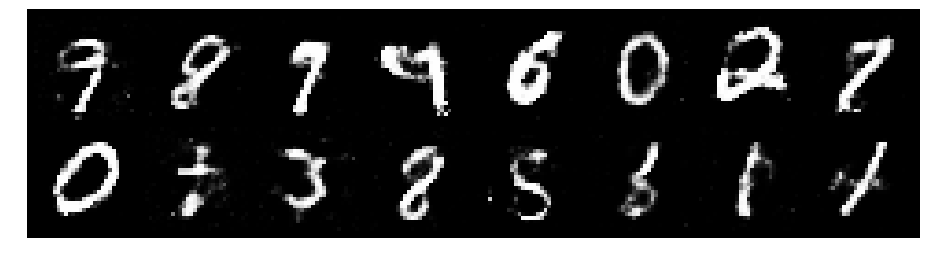

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.2158, Generator Loss: 0.8444
D(x): 0.5800, D(G(z)): 0.4575


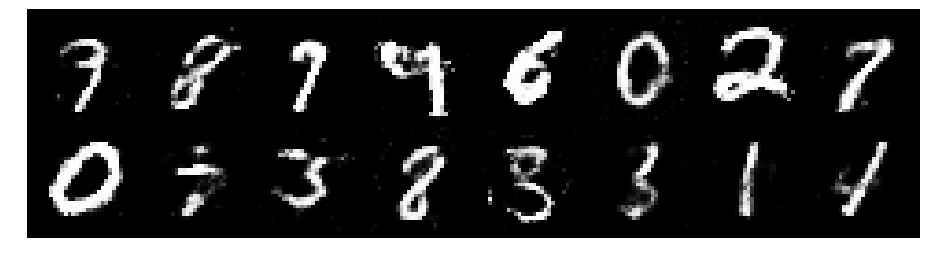

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.2725, Generator Loss: 0.9193
D(x): 0.5758, D(G(z)): 0.4583


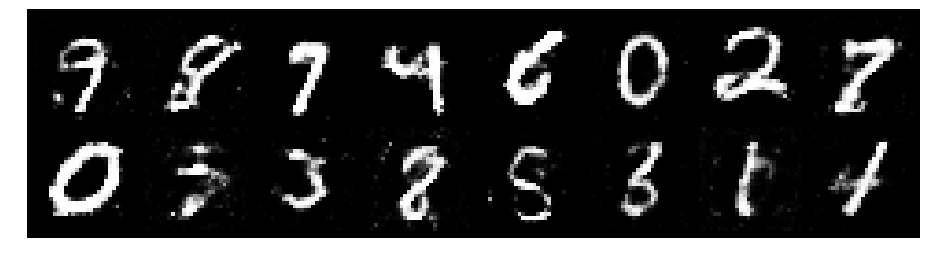

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.1606, Generator Loss: 0.8549
D(x): 0.5930, D(G(z)): 0.4329


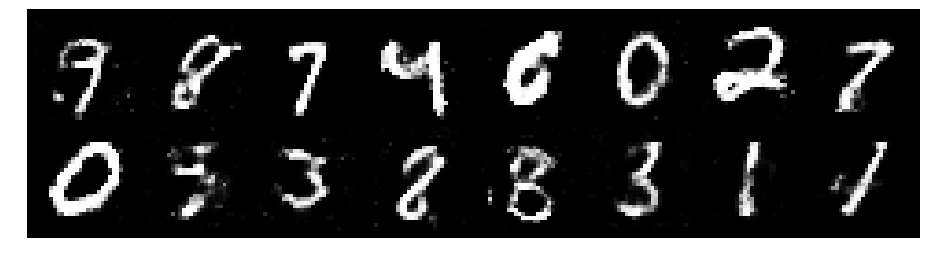

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.2107, Generator Loss: 0.9248
D(x): 0.5584, D(G(z)): 0.4155


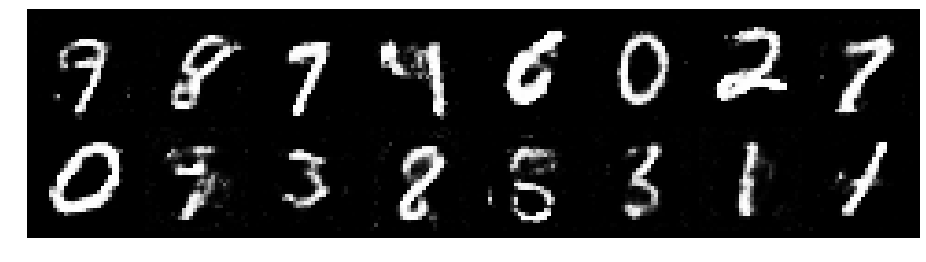

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.2663, Generator Loss: 0.9144
D(x): 0.5422, D(G(z)): 0.4414


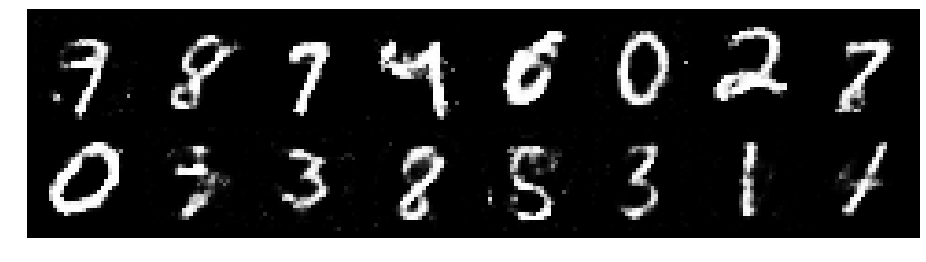

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 1.2853, Generator Loss: 0.8551
D(x): 0.5686, D(G(z)): 0.4618


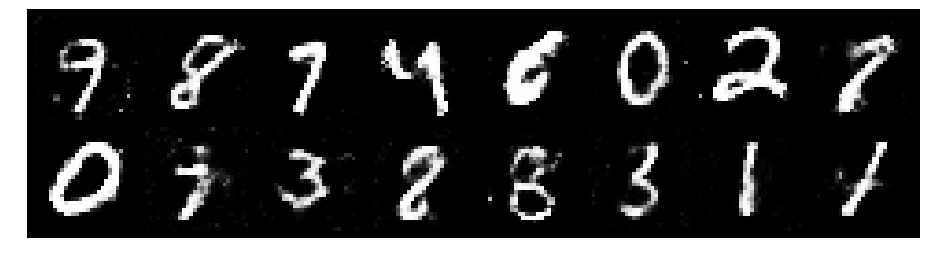

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.2182, Generator Loss: 0.8112
D(x): 0.5613, D(G(z)): 0.4200


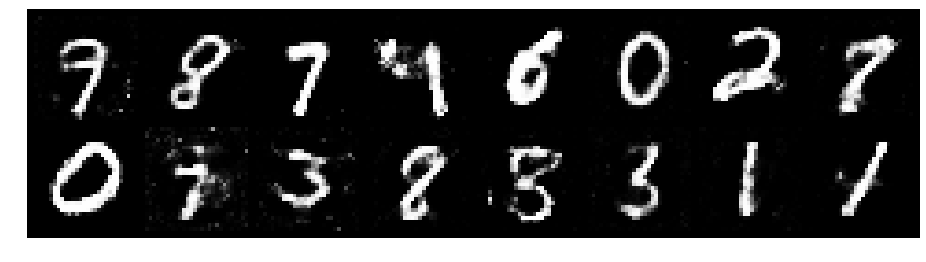

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 1.2209, Generator Loss: 0.9394
D(x): 0.5798, D(G(z)): 0.4303


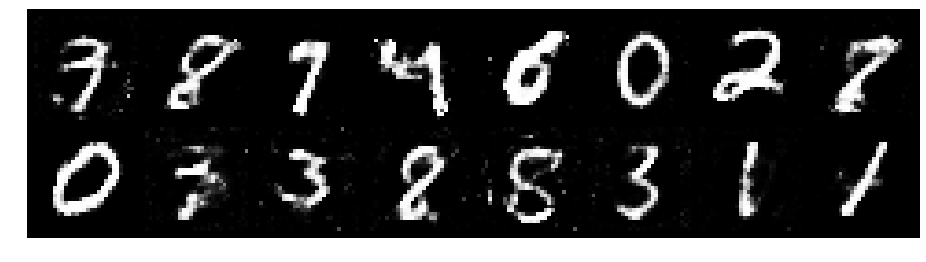

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.2836, Generator Loss: 0.9529
D(x): 0.5611, D(G(z)): 0.4161


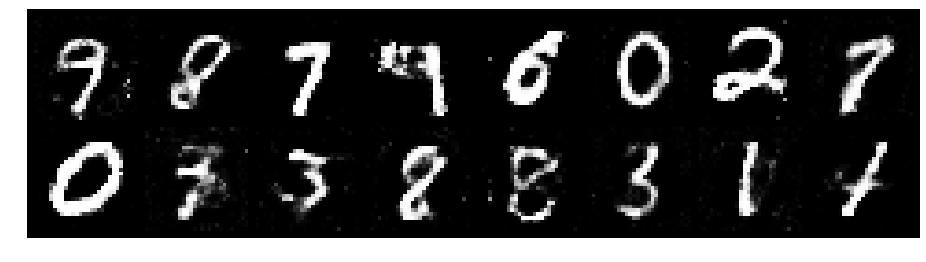

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.3303, Generator Loss: 0.9345
D(x): 0.5755, D(G(z)): 0.4849


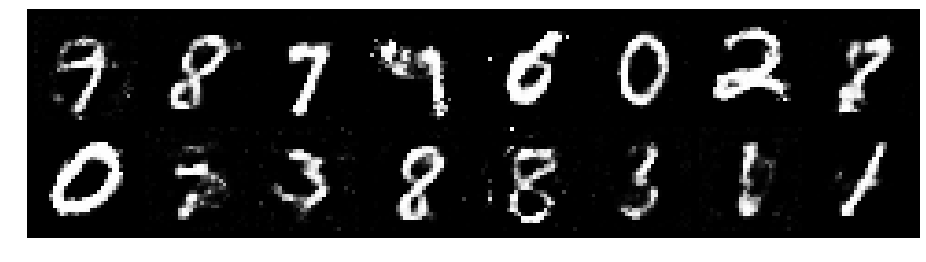

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.2481, Generator Loss: 0.9321
D(x): 0.5878, D(G(z)): 0.4689


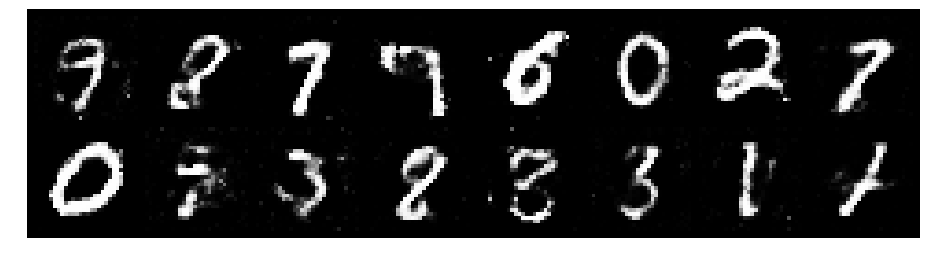

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.2546, Generator Loss: 0.9593
D(x): 0.5702, D(G(z)): 0.4499


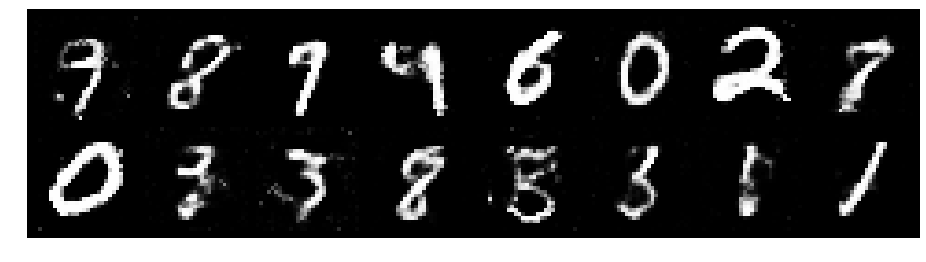

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.2724, Generator Loss: 0.7958
D(x): 0.5578, D(G(z)): 0.4549


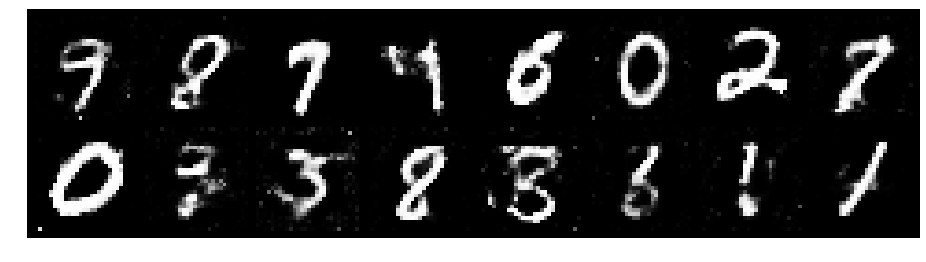

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.2867, Generator Loss: 0.8696
D(x): 0.5526, D(G(z)): 0.4585


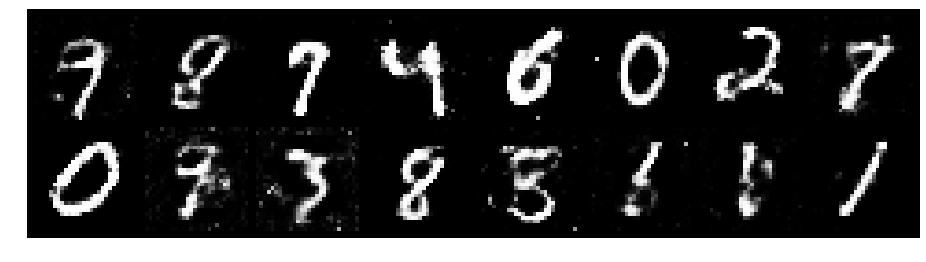

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.3434, Generator Loss: 0.7776
D(x): 0.5485, D(G(z)): 0.4774


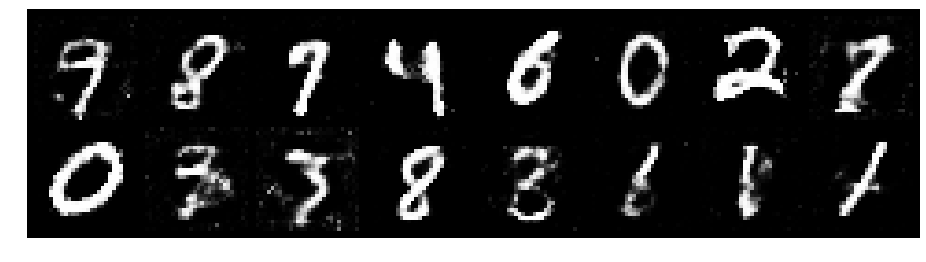

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.3523, Generator Loss: 0.7809
D(x): 0.5289, D(G(z)): 0.4635


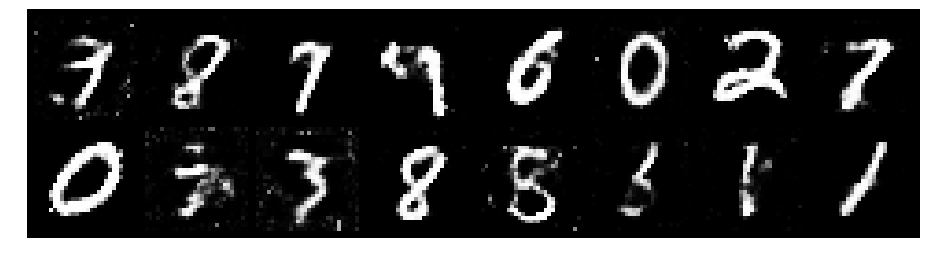

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.1857, Generator Loss: 0.7835
D(x): 0.5999, D(G(z)): 0.4555


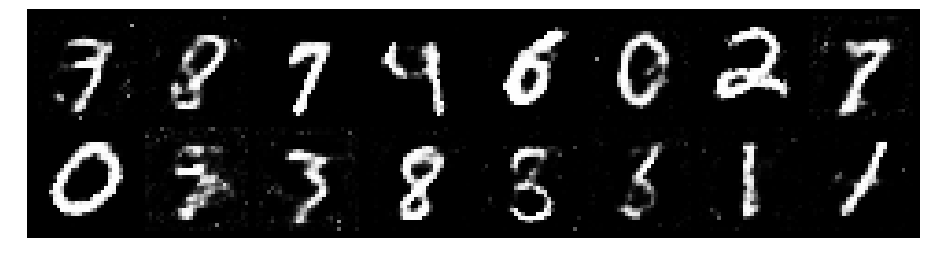

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.3127, Generator Loss: 0.7667
D(x): 0.5390, D(G(z)): 0.4729


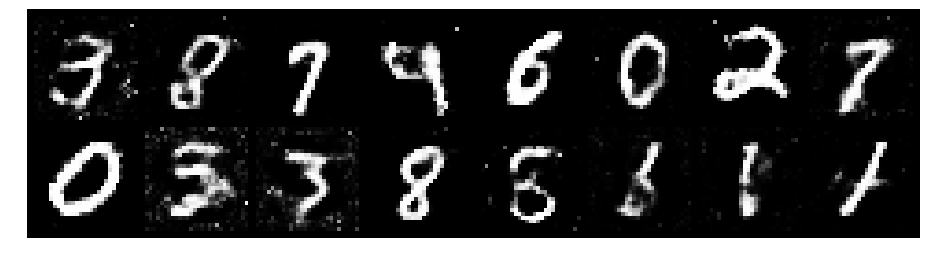

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.2590, Generator Loss: 0.8769
D(x): 0.5937, D(G(z)): 0.4731


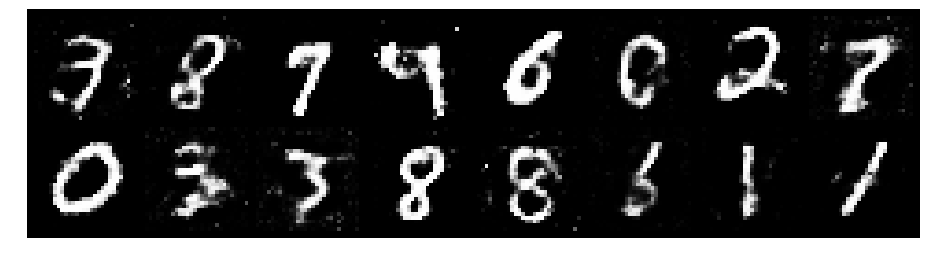

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 1.2879, Generator Loss: 0.9348
D(x): 0.5543, D(G(z)): 0.4553


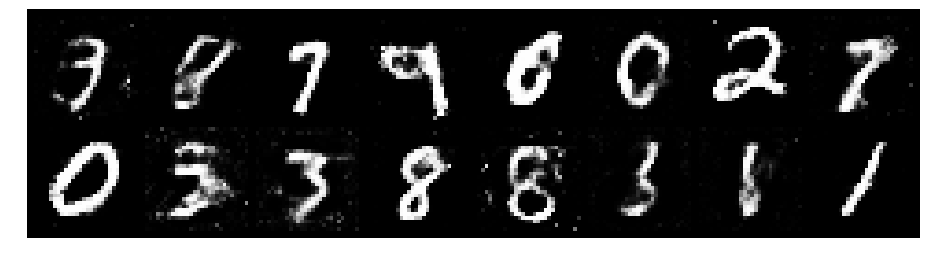

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.2940, Generator Loss: 0.9760
D(x): 0.5403, D(G(z)): 0.4193


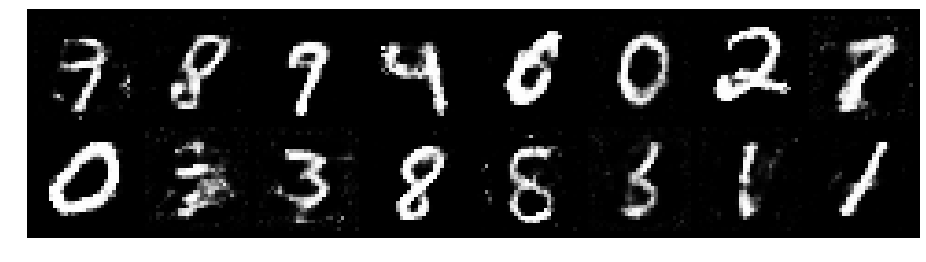

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.1672, Generator Loss: 0.9134
D(x): 0.5629, D(G(z)): 0.4159


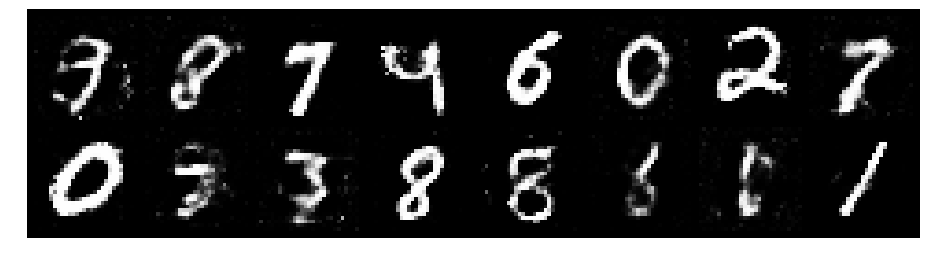

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.2961, Generator Loss: 0.9206
D(x): 0.5070, D(G(z)): 0.4091


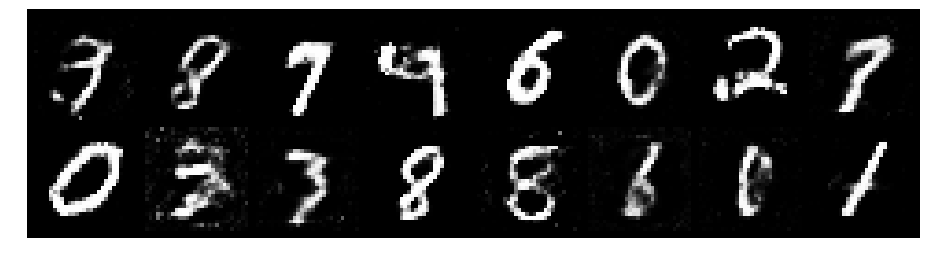

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.3136, Generator Loss: 0.9340
D(x): 0.5752, D(G(z)): 0.4636


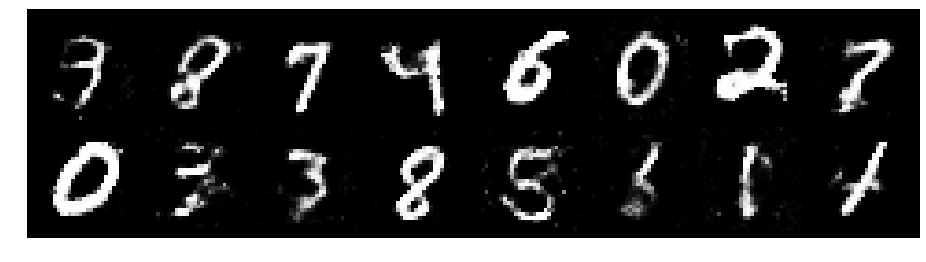

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.2972, Generator Loss: 0.8412
D(x): 0.5236, D(G(z)): 0.4141


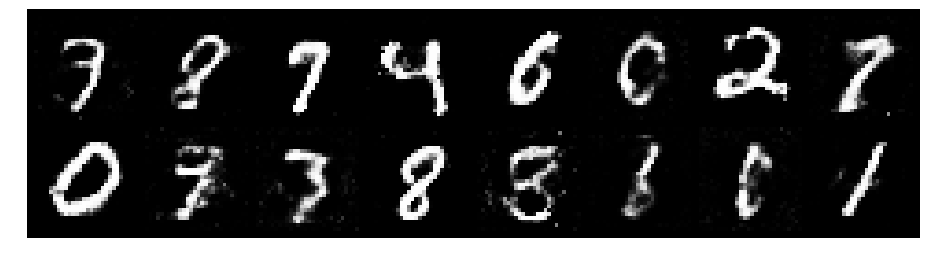

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.2805, Generator Loss: 0.8403
D(x): 0.5393, D(G(z)): 0.4527


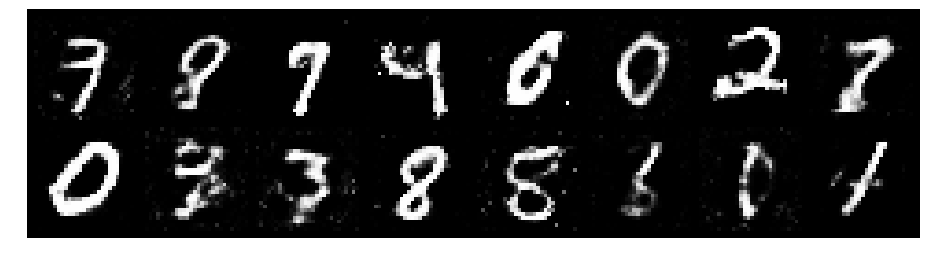

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.3425, Generator Loss: 0.9173
D(x): 0.4868, D(G(z)): 0.4095


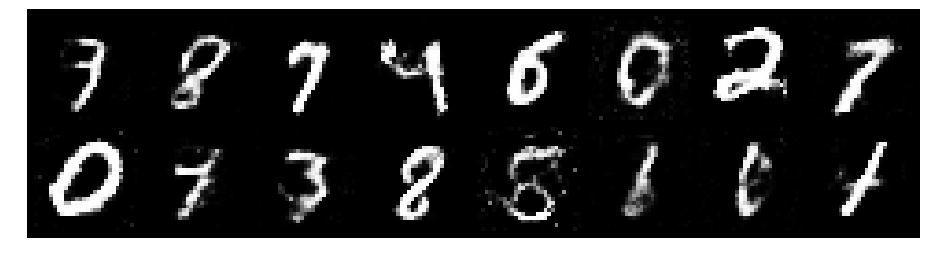

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.2568, Generator Loss: 1.0402
D(x): 0.5476, D(G(z)): 0.4170


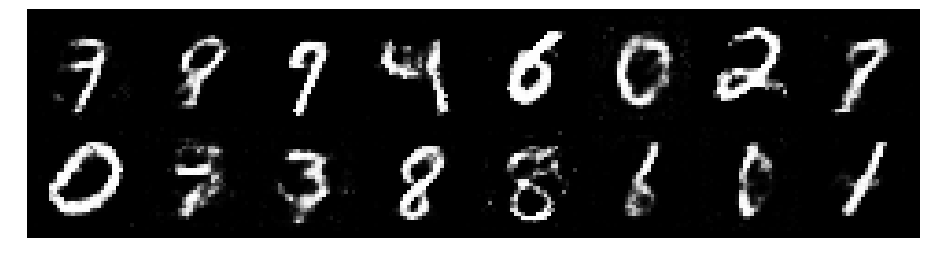

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.2101, Generator Loss: 0.7889
D(x): 0.5613, D(G(z)): 0.4292


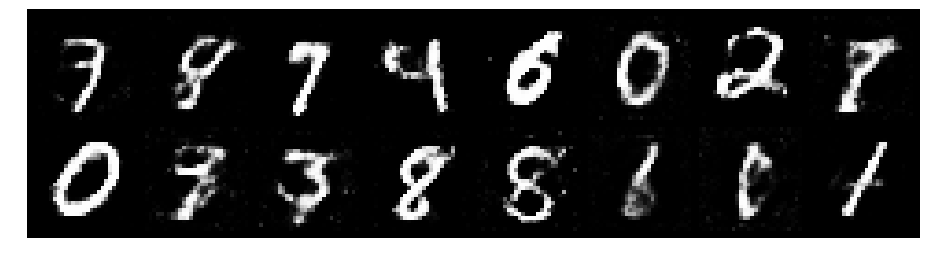

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.2738, Generator Loss: 0.9878
D(x): 0.5794, D(G(z)): 0.4481


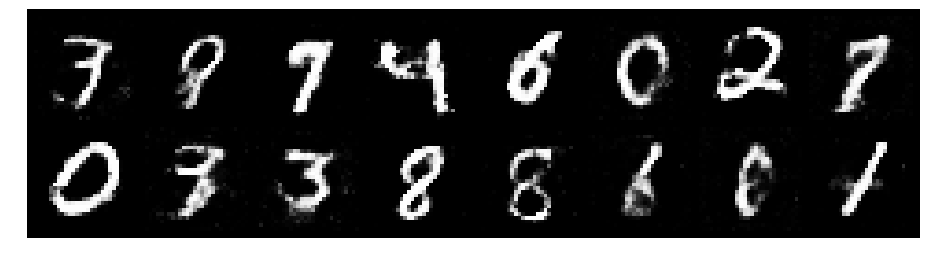

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.2981, Generator Loss: 0.8818
D(x): 0.5347, D(G(z)): 0.4384


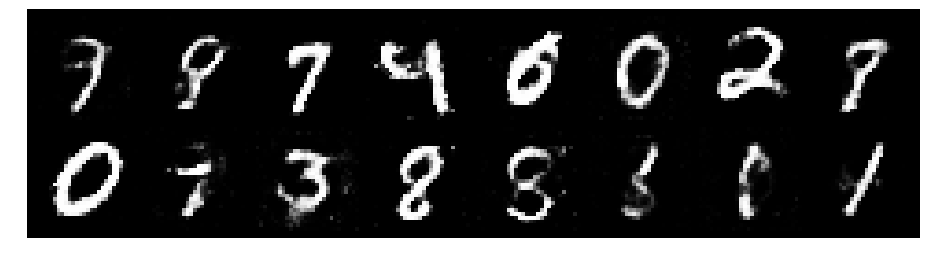

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.4542, Generator Loss: 0.9645
D(x): 0.4848, D(G(z)): 0.4538


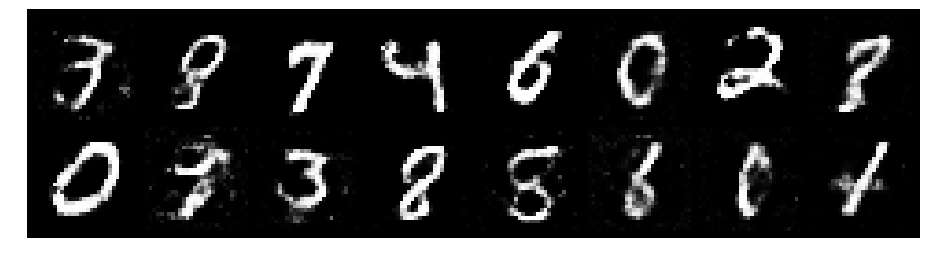

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.3730, Generator Loss: 0.7744
D(x): 0.5220, D(G(z)): 0.4717


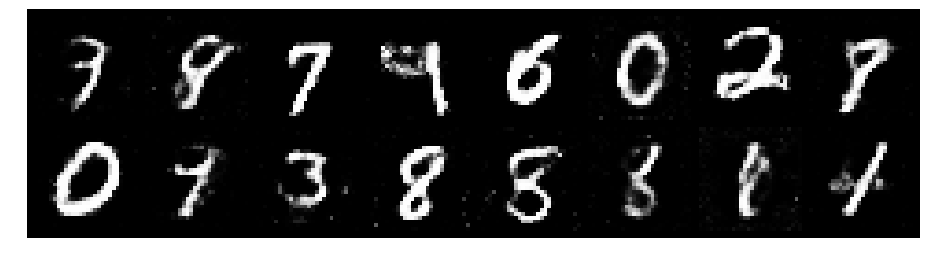

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.4037, Generator Loss: 0.9280
D(x): 0.4700, D(G(z)): 0.4218


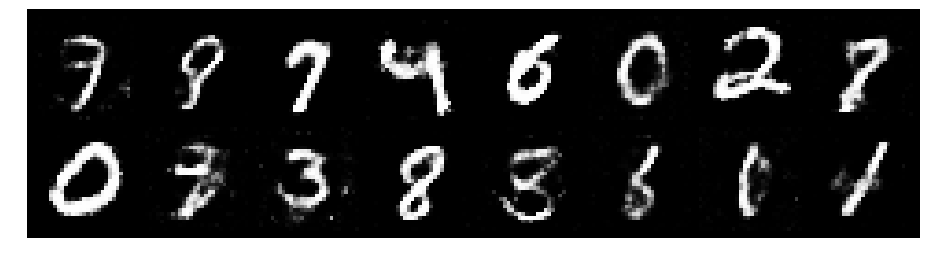

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.2998, Generator Loss: 0.8669
D(x): 0.5317, D(G(z)): 0.4394


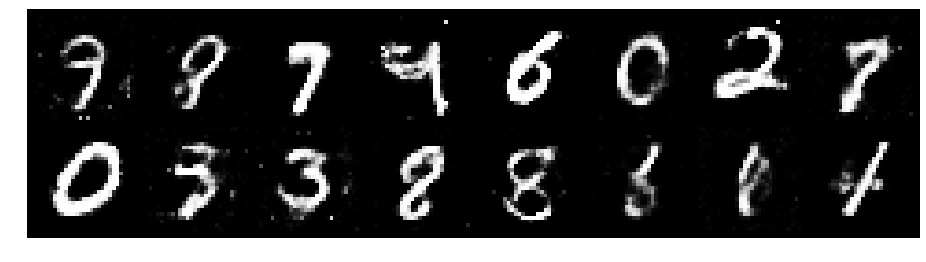

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.2031, Generator Loss: 0.9896
D(x): 0.5470, D(G(z)): 0.4018


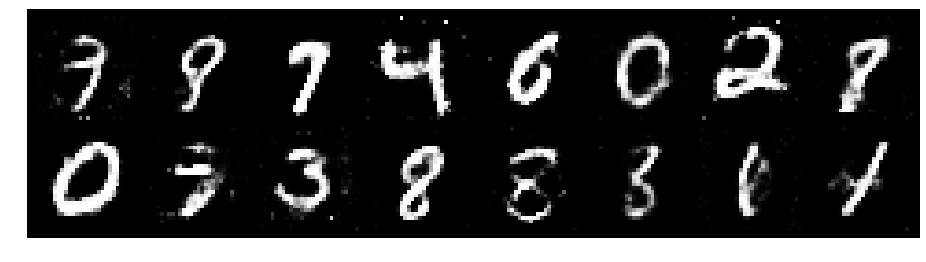

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.3400, Generator Loss: 0.9891
D(x): 0.4869, D(G(z)): 0.4011


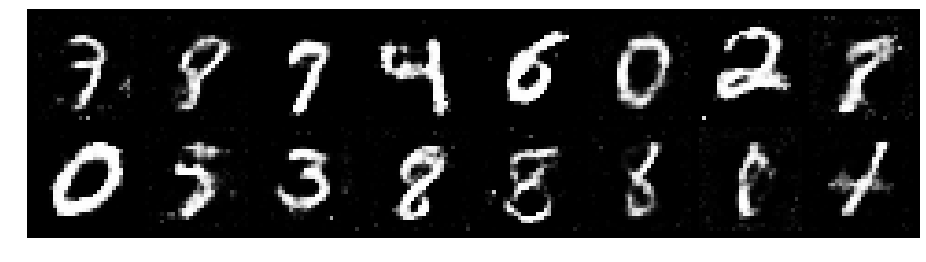

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.2535, Generator Loss: 0.9164
D(x): 0.5594, D(G(z)): 0.4220


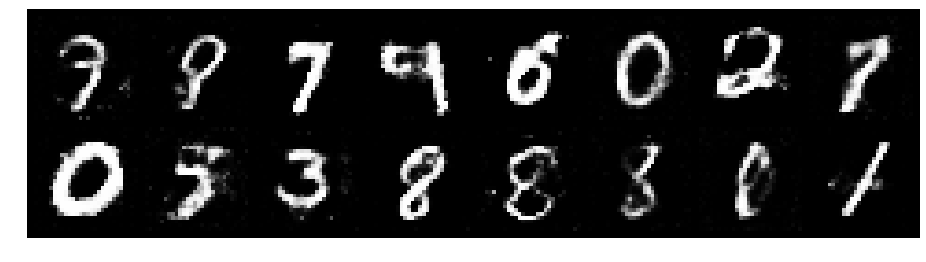

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.5372, Generator Loss: 0.8606
D(x): 0.5101, D(G(z)): 0.5214


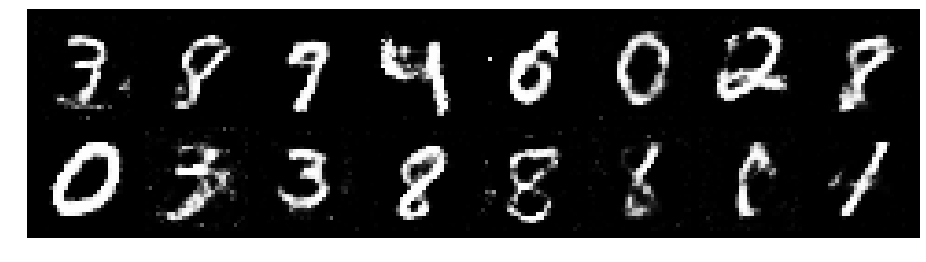

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.3540, Generator Loss: 0.9354
D(x): 0.4895, D(G(z)): 0.4085


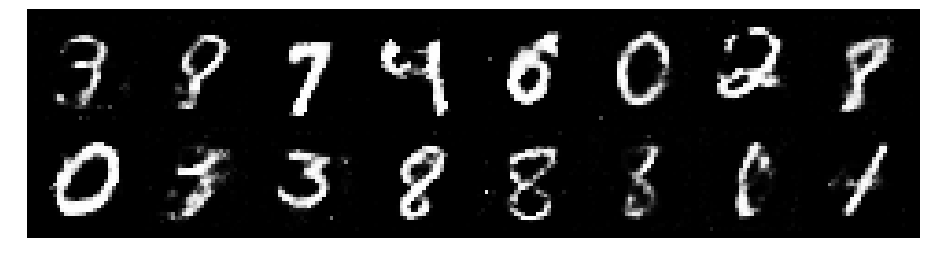

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.2273, Generator Loss: 0.9135
D(x): 0.5611, D(G(z)): 0.4156


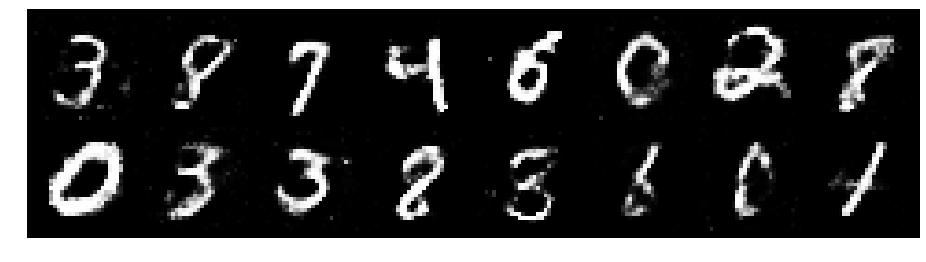

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.3799, Generator Loss: 0.7358
D(x): 0.5374, D(G(z)): 0.4957


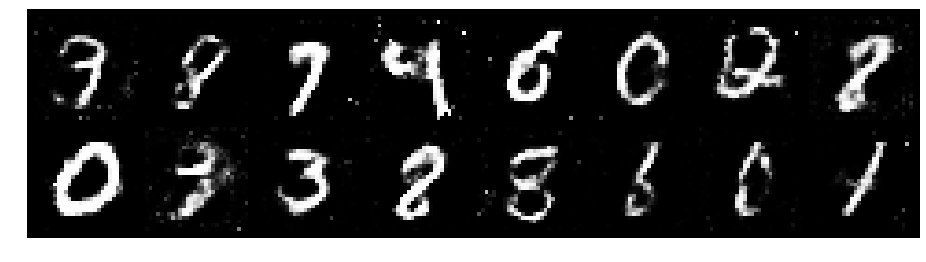

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.3925, Generator Loss: 0.8623
D(x): 0.5241, D(G(z)): 0.4716


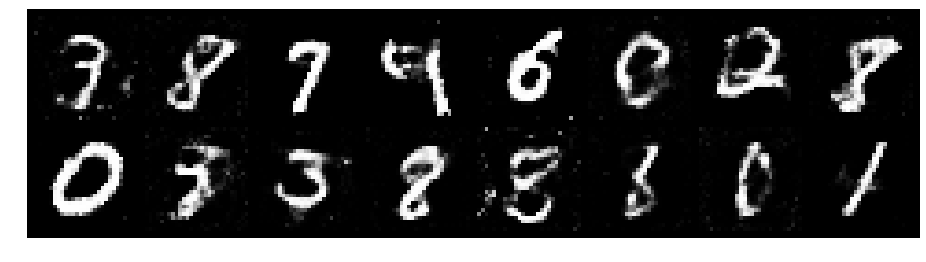

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.2917, Generator Loss: 0.8246
D(x): 0.5298, D(G(z)): 0.4429


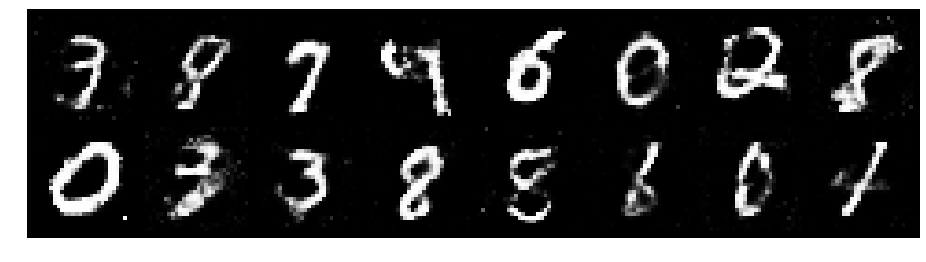

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.2613, Generator Loss: 0.8012
D(x): 0.5493, D(G(z)): 0.4486


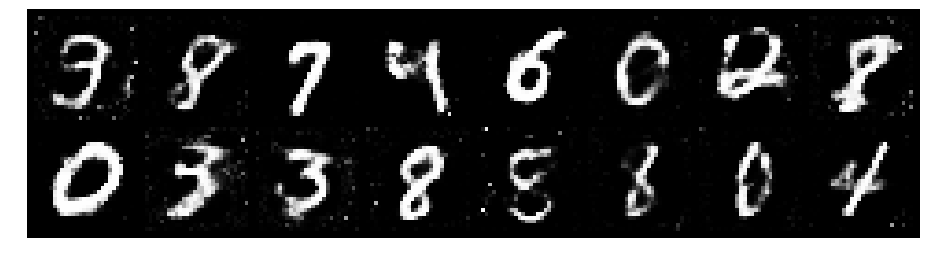

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.2939, Generator Loss: 0.8873
D(x): 0.5504, D(G(z)): 0.4566


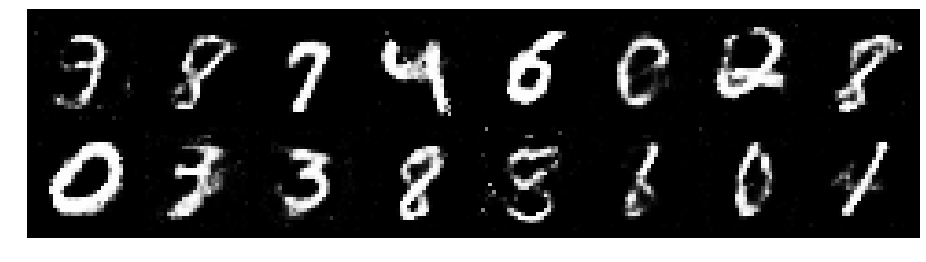

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.2760, Generator Loss: 0.8763
D(x): 0.5588, D(G(z)): 0.4479


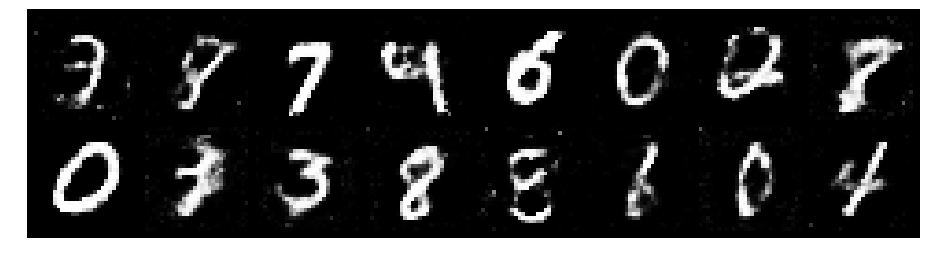

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.3293, Generator Loss: 0.8714
D(x): 0.5244, D(G(z)): 0.4497


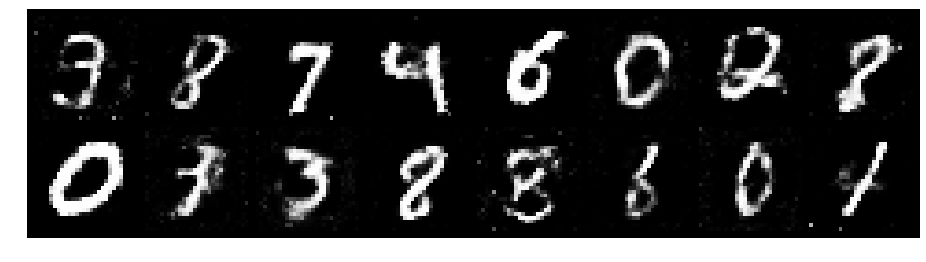

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.2659, Generator Loss: 0.9022
D(x): 0.5377, D(G(z)): 0.4385


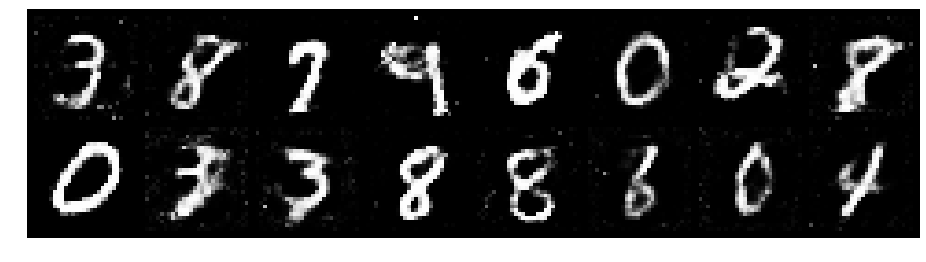

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.2334, Generator Loss: 0.8442
D(x): 0.5684, D(G(z)): 0.4426


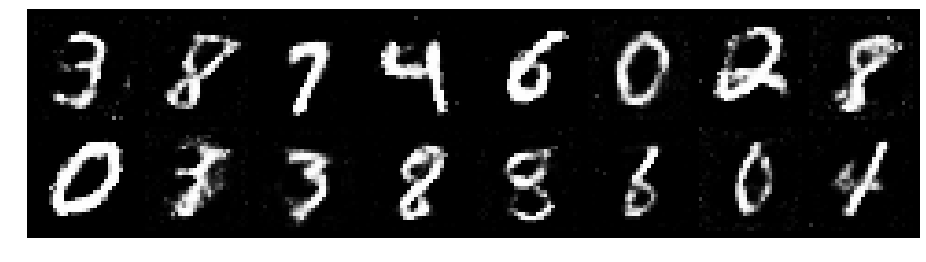

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.2444, Generator Loss: 0.8711
D(x): 0.5731, D(G(z)): 0.4368


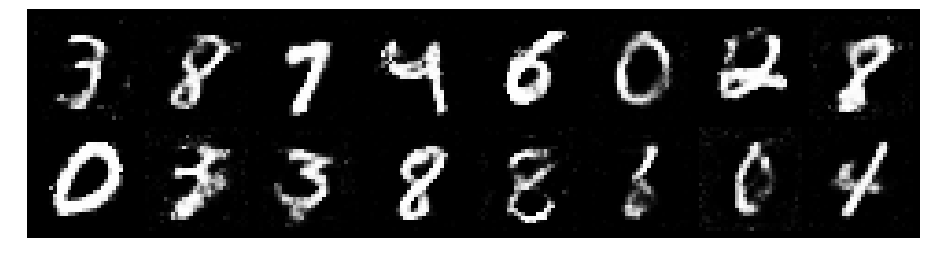

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.1493, Generator Loss: 0.8174
D(x): 0.6290, D(G(z)): 0.4647


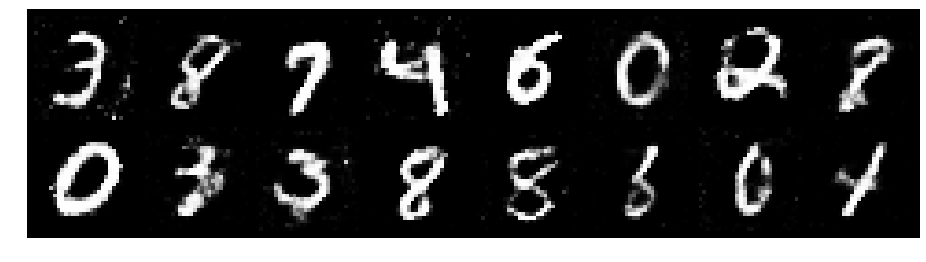

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.2731, Generator Loss: 0.8392
D(x): 0.5614, D(G(z)): 0.4307


In [44]:
# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')
# Total number of epochs to train
num_epochs = 200
for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)
        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch))
        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator(noise(N)).detach()
        # Train D
        d_error, d_pred_real, d_pred_fake = \
              train_discriminator(d_optimizer, real_data, fake_data)

        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(N))
        # Train G
        g_error = train_generator(g_optimizer, fake_data)
        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(generator(test_noise))
            test_images = test_images.data
            logger.log_images(
                test_images, num_test_samples, 
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )